# C3RO Analysis 

The following code is used for the manuscript titled: “E Pluribus Unum”: Prospective acceptability benchmarking from the Contouring Collaborative for Consensus in Radiation Oncology (C3RO) Crowdsourced Initiative for Multi-Observer Segmentation. 

Manuscript located here: https://www.medrxiv.org/content/10.1101/2022.09.23.22280295v1. Data Descriptor located here: https://www.medrxiv.org/content/10.1101/2022.10.05.22280672v1. Dataset doi: 10.6084/m9.figshare.21074182.

The notebook is broken up into seperate subsections for each tumor site (breast, sarcoma, H&N, GYN, GI). There are 4 main components to each subsection:
1. Generation of NIfTI files from original DICOM data (Image Processing). This includes STAPLE consensus segmentation generation. 
2. Interobsever variability analysis. 
3. Direct comparisons of non-expert vs. expert STAPLE segmentations.
4. Bootstrap experiments. 

At the moment, the code is fairly messy and redundant. Moreover, it makes references to local folders that new users will not have access to. Future version of this notebook will streamline the code, make things more readable, and reference the actual files avalible for public download on Figshare. 

Last updated: October 12, 2022 by kareem Wahid.

## Dependencies

In [4]:
from DicomRTTool.ReaderWriter import DicomReaderWriter # pip install DicomRTTool
import os, shutil
import SimpleITK as sitk
import numpy as np
import pandas as pd
import itertools
from surface_distance import compute_dice_coefficient, compute_surface_distances, compute_robust_hausdorff, compute_surface_dice_at_tolerance, compute_average_surface_distance
import random
import multiprocessing
import time
import nibabel as nb

from statannotations.Annotator import Annotator # pip install statannotations

import matplotlib.pyplot as plt
import seaborn as sns
sns.set(font_scale = 1.5)
sns.set_style("whitegrid", {'axes.grid' : False})

In [5]:
%config InlineBackend.figure_format = 'retina' # for high quality figure print outs

## Helper Functions

In [20]:
# adapted from Kiser et al. https://github.com/kkiser1/Autosegmentation-Spatial-Similarity-Metrics

def getEdgeOfMask(mask):
    '''
    Computes and returns edge of a segmentation mask
    '''
    # edge has the pixels which are at the edge of the mask
    edge = np.zeros_like(mask)
    
    # mask_pixels has the pixels which are inside the mask of the automated segmentation result
    mask_pixels = np.where(mask > 0)

    for idx in range(0,mask_pixels[0].size):

        x = mask_pixels[0][idx]
        y = mask_pixels[1][idx]
        z = mask_pixels[2][idx]

        # Count # pixels in 3x3 neighborhood that are in the mask
        # If sum < 27, then (x, y, z) is on the edge of the mask
        if mask[x-1:x+2, y-1:y+2, z-1:z+2].sum() < 27:
            edge[x,y,z] = 1
            
    return edge

def AddedPathLength(auto, gt):
    '''
    Returns the added path length, in pixels
    
    Steps:
    1. Find pixels at the edge of the mask for both auto and gt
    2. Count # pixels on the edge of gt that are not in the edge of auto
    '''
    
    # Check if auto and gt have same dimensions. If not, then raise a ValueError
    if auto.shape != gt.shape:
        raise ValueError('Shape of auto and gt must be identical!')

    # edge_auto has the pixels which are at the edge of the automated segmentation result
    edge_auto = getEdgeOfMask(auto)
    # edge_gt has the pixels which are at the edge of the ground truth segmentation
    edge_gt = getEdgeOfMask(gt)
    
    # Count # pixels on the edge of gt that are on not in the edge of auto
    apl = (edge_gt > edge_auto).astype(int).sum()
    
    return apl 

In [21]:
def pairwise_main(lst): # main function so you don't waste time 
    DSC_list = []
    HD95_list = []
    ASD_list = []
    APL_list = []
    ordered_list = itertools.combinations(lst,2)
    for i in ordered_list:
        file_1 = sitk.ReadImage(i[0])
        file_2 = sitk.ReadImage(i[1])
        
        spacing_mm = file_1.GetSpacing() # need spacing to calcualte distances
        
        mask_1 = sitk.GetArrayFromImage(file_1)
        mask_2 = sitk.GetArrayFromImage(file_2)
        
        DSC = compute_dice_coefficient(mask_1, mask_2)
        DSC_list.append(DSC)
        
        mask_1_bool = mask_1.astype(bool) # need to convert to bool format to work 
        mask_2_bool = mask_2.astype(bool)
        
        surface_distances = compute_surface_distances(mask_1_bool, mask_2_bool, spacing_mm) # need this for all calculations
        HD95 = compute_robust_hausdorff(surface_distances, 95)
        HD95_list.append(HD95)
        
        ASD_truth = compute_average_surface_distance(surface_distances)[0] #  A tuple with two float values: 1. the average distance (in mm) from the ground truth surface to thepredicted surface, 2. the average distance from the predicted surface to the ground truth surface.
        ASD_pred = compute_average_surface_distance(surface_distances)[1]
        ASD_mean = (ASD_truth + ASD_pred)/2
        ASD_list.append(ASD_mean)
        
        APL = AddedPathLength(mask_1, mask_2)
        APL_list.append(APL)
        
    return DSC_list, HD95_list, ASD_list, APL_list

def pairwise_SDSC(lst, tolerance): # do the same thing for SDSC
    SDSC_list = []
    ordered_list = itertools.combinations(lst,2)
    for i in ordered_list:
        file_1 = sitk.ReadImage(i[0])
        file_2 = sitk.ReadImage(i[1])
        
        spacing_mm = file_1.GetSpacing() # need spacing to calcualte distances
        
        mask_1 = sitk.GetArrayFromImage(file_1)
        mask_2 = sitk.GetArrayFromImage(file_2)
        
        mask_1_bool = mask_1.astype(bool) # need to convert to bool format to work 
        mask_2_bool = mask_2.astype(bool)
        
        surface_distances = compute_surface_distances(mask_1_bool, mask_2_bool, spacing_mm) # need this for all calculations
        
        SDSC = compute_surface_dice_at_tolerance(surface_distances, tolerance)
        
        SDSC_list.append(SDSC)
        
    return SDSC_list

In [22]:
# adapted from https://neurostars.org/t/calculate-volumes-counting-voxels-is-a-correct-approach/1433/2

def calculate_volume(INPUT): 
    # Load data
    nii = nb.load(INPUT)
    img = nii.get_fdata()

    # Get voxel dimensions
    voxel_dims = (nii.header["pixdim"])[1:4]

    # Compute volume
    nonzero_voxel_count = np.count_nonzero(img)
    voxel_volume = np.prod(voxel_dims)
    nonzero_voxel_volume = nonzero_voxel_count * voxel_volume
    nonzero_voxel_volume_cc = nonzero_voxel_volume/1000.0 # gives cubic centimeters 
    
    return nonzero_voxel_volume_cc

## Part 1: Breast

### Image Processing 

In [5]:
# first make folders based on structure files and populate with copies of CT image 

In [3]:
base_path = "Case 01 (Left Breast Post-Mastectomy)"

In [6]:
in_path = os.path.join(base_path, 'Structure Sets')
out_path = os.path.join(base_path, 'Combined_structure_CT_DICOM')

if not os.path.isdir(out_path): # make directory if it does not exist 
    os.mkdir(out_path)

In [6]:
structure_files = os.listdir(in_path)
for structure_file in structure_files:
    print(structure_file)
    
    structure_file_path = os.path.join(in_path, structure_file)
    
    output_folder = os.path.join(out_path, structure_file.split('.')[0])
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
        
    structure_file_path_out = os.path.join(output_folder, structure_file)
        
    shutil.copy(structure_file_path, structure_file_path_out)
    
    CT_path = "Case 01 (Left Breast Post-Mastectomy)\\CT Images"
    
    CT_files = os.listdir(CT_path)
    
    for CT_file in CT_files:
        CT_file_path = os.path.join(CT_path, CT_file)
        CT_file_path_out = os.path.join(output_folder, CT_file)
        
        shutil.copy(CT_file_path, CT_file_path_out)

structure_set_002_.dcm
structure_set_014_.dcm
structure_set_016_.dcm
structure_set_017_.dcm
structure_set_018_.dcm
structure_set_021_.dcm
structure_set_025_.dcm
structure_set_027_.dcm
structure_set_029_.dcm
structure_set_031_.dcm
structure_set_032_.dcm
structure_set_034_.dcm
structure_set_041_.dcm
structure_set_048_.dcm
structure_set_059_.dcm
structure_set_068_.dcm
structure_set_084_.dcm
structure_set_089_.dcm
structure_set_105_.dcm
structure_set_107_.dcm
structure_set_111_.dcm
structure_set_112_.dcm
structure_set_113_.dcm
structure_set_120_.dcm
structure_set_122_.dcm
structure_set_128_.dcm
structure_set_129_.dcm
structure_set_130_.dcm
structure_set_131_.dcm
structure_set_134_.dcm
structure_set_137_.dcm
structure_set_140_.dcm
structure_set_141_.dcm
structure_set_146_.dcm
structure_set_147_.dcm
structure_set_149_.dcm
structure_set_150_.dcm
structure_set_151_.dcm
structure_set_164_.dcm
structure_set_165_.dcm
structure_set_168_.dcm
structure_set_175_.dcm
structure_set_177_.dcm
structure_s

In [ ]:
# convert structures to nifti 

In [9]:
input_path = os.path.join(base_path, "Combined_structure_CT_DICOM")
output_path = os.path.join(base_path, "structures_nifti")

if not os.path.isdir(output_path): # make directory if it does not exist 
    os.mkdir(output_path)

In [18]:
%%time
for folder in os.listdir(input_path):
    print(folder)
    folder_path = os.path.join(input_path, folder)
    print(folder_path)
    Dicom_reader = DicomReaderWriter(description='Examples', series_instances_dictionary = {}) # instantiate
    Dicom_reader.walk_through_folders(folder_path)
    all_rois = Dicom_reader.return_rois(print_rois=False)
    print(all_rois)
    
    output_path_folder = os.path.join(output_path, folder)
    if not os.path.isdir(output_path_folder): 
        os.mkdir(output_path_folder)
        
    for roi in all_rois:
        print(roi)
        Contour_Names = [roi] 
        Dicom_reader.set_contour_names_and_associations(Contour_Names=Contour_Names)
        try:
            Dicom_reader.get_images_and_mask()
            mask = Dicom_reader.mask # mask array
            mask_sitk_handle = Dicom_reader.annotation_handle # SimpleITK mask handle
            sitk.WriteImage(mask_sitk_handle, os.path.join(output_path_folder, roi+'.nii.gz'))
        except: 
            print("PROBLEM WITH", folder, roi)



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_002_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_002_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_002_




Loading through DICOM files: 100%|█| 1/1 [00:00<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_002_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_002_



Loading through DICOM files: 100%|█| 1/1 [00:55<00:00,
Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_014_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_014_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_014_



Loading through DICOM files: 100%|█| 1/1 [00:00<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_014_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_014_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

PROBLEM WITH structure_set_014_ brachialplexus_l
ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_014_ lad
structure_set_016_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_016_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_016_



Loading through DICOM files: 100%|█| 1/1 [00:00<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_016_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_016_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_016_ lad
structure_set_017_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_017_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_017_



Loading through DICOM files: 100%|█| 1/1 [00:00<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_017_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv chestwall', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_017_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

PROBLEM WITH structure_set_017_ brachialplexus_l
ctv chestwall


ctv_axilla
ctv_chestwall
PROBLEM WITH structure_set_017_ ctv_chestwall
ctv_imn
ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_017_ lad
structure_set_018_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_018_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_018_



Loading through DICOM files: 100%|█| 1/1 [00:00<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_018_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_018_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_021_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_021_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_021_



Loading through DICOM files: 100%|█| 1/1 [00:00<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_021_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_021_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_025_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_025_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_025_



Loading through DICOM files: 100%|█| 1/1 [00:00<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_025_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_025_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_027_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_027_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_027_



Loading through DICOM files: 100%|█| 1/1 [00:00<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_027_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_027_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

PROBLEM WITH structure_set_027_ brachialplexus_l
ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_027_ lad
structure_set_029_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_029_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_029_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_029_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_029_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


PROBLEM WITH structure_set_029_ brachialplexus_l
ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_029_ lad
structure_set_031_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_031_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_031_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_031_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_031_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_032_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_032_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_032_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_032_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_032_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_034_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_034_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_034_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_034_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_034_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

PROBLEM WITH structure_set_034_ brachialplexus_l
ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_041_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_041_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_041_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_041_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_041_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_048_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_048_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_048_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_048_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_048_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_059_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_059_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_059_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_059_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_059_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_068_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_068_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_068_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_068_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_068_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


PROBLEM WITH structure_set_068_ brachialplexus_l
ctv_axilla
ctv_chestwall
ctv_imn
PROBLEM WITH structure_set_068_ ctv_imn
ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_068_ lad
structure_set_084_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_084_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_084_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_084_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'esophagus', 'heart', 'lad', 'lung l', 'medula', 'medula+0.5']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_084_



Loading through DICOM files: 100%|█| 1/1 [00:03<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
esophagus
heart
lad
PROBLEM WITH structure_set_084_ lad
lung l
medula
medula+0.5



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_089_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_089_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_089_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_089_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_089_

PROBLEM WITH structure_set_089_ brachialplexus_l
ctv_axilla


Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_chestwall
ctv_imn
ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_089_ lad
structure_set_105_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_105_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_105_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_105_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_105_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_107_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_107_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_107_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_107_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla1', 'ctv_axilla1+2', 'ctv_axilla2', 'ctv_axilla3', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'ctv_axilla', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_107_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

PROBLEM WITH structure_set_107_ brachialplexus_l
ctv_axilla1


ctv_axilla1+2
ctv_axilla2
ctv_axilla3
ctv_chestwall
ctv_imn
ctv_scv
ctv_axilla
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_107_ lad
structure_set_111_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_111_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_111_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_111_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_111_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

PROBLEM WITH structure_set_111_ brachialplexus_l
ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_111_ lad
structure_set_112_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_112_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_112_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_112_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_112_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_113_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_113_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_113_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_113_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_113_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

PROBLEM WITH structure_set_113_ brachialplexus_l
ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_113_ lad
structure_set_120_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_120_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_120_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_120_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_120_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_122_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_122_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_122_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_122_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_122_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


PROBLEM WITH structure_set_122_ brachialplexus_l
ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_122_ lad
structure_set_128_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_128_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_128_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_128_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_128_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

PROBLEM WITH structure_set_128_ brachialplexus_l
ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_128_ lad
structure_set_129_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_129_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_129_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_129_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_129_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_130_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_130_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_130_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_130_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_130_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,


PROBLEM WITH structure_set_130_ brachialplexus_l
ctv_axilla
PROBLEM WITH structure_set_130_ ctv_axilla
ctv_chestwall
PROBLEM WITH structure_set_130_ ctv_chestwall
ctv_imn
ctv_scv
PROBLEM WITH structure_set_130_ ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_130_ lad
structure_set_131_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_131_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_131_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_131_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_131_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_134_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_134_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_134_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_134_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_134_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_137_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_137_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_137_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_137_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_137_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_140_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_140_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_140_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_140_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['asm', 'brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
asm
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_140_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


PROBLEM WITH structure_set_140_ asm
brachialplexus_l
PROBLEM WITH structure_set_140_ brachialplexus_l
ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_141_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_141_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_141_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_141_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_141_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_146_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_146_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_146_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_146_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_146_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_147_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_147_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_147_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_147_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_147_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_149_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_149_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_149_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_149_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'breast crontralateral', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'esophagus', 'heart', 'lad', 'llung', 'rlung']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_149_



Loading through DICOM files: 100%|█| 1/1 [00:03<00:00,

breast crontralateral


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
esophagus
heart
lad
llung


rlung
PROBLEM WITH structure_set_149_ rlung
structure_set_150_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_150_


Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_150_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_150_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_150_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_151_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_151_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_151_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_151_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_151_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_164_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_164_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_164_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_164_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad', 'axilla 2', 'axilla 3']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_164_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad
axilla 2
axilla 3



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_165_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_165_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_165_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_165_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_165_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_168_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_168_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_168_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_168_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_168_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_175_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_175_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_175_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_175_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_175_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_177_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_177_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_177_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_177_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_177_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_179_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_179_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_179_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_179_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_179_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_184_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_184_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_184_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_184_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_184_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,


PROBLEM WITH structure_set_184_ brachialplexus_l
ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_186_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_186_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_186_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_186_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['axilla', 'berg i', 'berg ii', 'berg iii', 'brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
axilla
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_186_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


berg i
berg ii
berg iii
brachialplexus_l
ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_192_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_192_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_192_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_192_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_192_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


PROBLEM WITH structure_set_192_ brachialplexus_l
ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_192_ lad
structure_set_199_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_199_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_199_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_199_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_199_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_201_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_201_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_201_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_201_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_201_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_206_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_206_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_206_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_206_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_cw', 'ctv_imn', 'ctv_scv', 'ctv_axilla', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_206_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

ctv_cw


ctv_imn
ctv_scv
ctv_axilla
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_215_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_215_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_215_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_215_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_215_



Loading through DICOM files: 100%|█| 1/1 [00:03<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_232_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_232_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_232_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_232_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_232_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_235_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_235_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_235_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_235_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_235_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_239_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_239_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_239_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_239_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_239_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
PROBLEM WITH structure_set_239_ heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_241_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_241_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_241_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_241_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_241_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
PROBLEM WITH structure_set_241_ ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_245_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_245_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_245_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_245_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_245_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
PROBLEM WITH structure_set_245_ ctv_axilla
ctv_imn
PROBLEM WITH structure_set_245_ ctv_imn
ctv_scv
PROBLEM WITH structure_set_245_ ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_245_ lad
structure_set_247_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_247_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_247_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_247_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'external', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_247_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
external
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_249_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_249_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_249_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_249_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_249_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_250_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_250_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_250_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_250_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_250_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_255_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_255_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_255_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_255_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_255_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_263_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_263_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_263_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_263_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_263_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_264_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_264_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_264_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_264_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_264_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

PROBLEM WITH structure_set_264_ brachialplexus_l
ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_265_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_265_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_265_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_265_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_265_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_266_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_266_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_266_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_266_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_266_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_268_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_268_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_268_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_268_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_268_

PROBLEM WITH structure_set_268_ brachialplexus_l
ctv_axilla


Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

ctv_chestwall


ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_285_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_285_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_285_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_285_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_285_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_290_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_290_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_290_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_290_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_290_



Loading through DICOM files: 100%|█| 1/1 [00:03<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_290_ lad
structure_set_291_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_291_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_291_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_291_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_291_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_297_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_297_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_297_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_297_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_297_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_298_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_298_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_298_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_298_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_298_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,


PROBLEM WITH structure_set_298_ brachialplexus_l
ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_299_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_299_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_299_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_299_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_299_

ctv_axilla


Loading through DICOM files: 100%|█| 1/1 [00:03<00:00,

ctv_chestwall
PROBLEM WITH structure_set_299_ ctv_chestwall
ctv_imn


ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_300_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_300_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_300_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_300_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_300_

ctv_axilla


Loading through DICOM files: 100%|█| 1/1 [00:03<00:00,

ctv_chestwall


ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_304_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_304_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_304_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_304_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_304_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
PROBLEM WITH structure_set_304_ ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_310_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_310_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_310_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_310_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['anterior scalene', 'brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad', 'med scalene']
anterior scalene
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_310_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


brachialplexus_l
ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad
med scalene



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_314_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_314_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_314_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_314_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_314_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_329_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_329_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_329_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_329_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_329_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

PROBLEM WITH structure_set_329_ brachialplexus_l
ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_329_ lad
structure_set_330_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_330_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_330_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_330_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_axilla lvl 2', 'ctv_axilla lvl 3', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_330_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_axilla lvl 2
ctv_axilla lvl 3
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_335_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_335_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_335_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_335_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_335_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_343_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_343_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_343_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_343_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_343_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

PROBLEM WITH structure_set_343_ brachialplexus_l
ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_343_ lad
structure_set_347_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_347_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_347_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_347_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
ctv_chestwall
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_347_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_348_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_348_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_348_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_348_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_348_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

PROBLEM WITH structure_set_348_ brachialplexus_l
ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_349_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_349_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_349_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_349_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_349_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

PROBLEM WITH structure_set_349_ brachialplexus_l
ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_349_ lad
structure_set_361_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_361_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_361_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_361_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad', 'lung', 'ptr lt breast', 'ptv imn', 'ptv nodes', 'ring']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_361_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad
lung
ptr lt breast
ptv imn
ptv nodes
ring



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_362_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_362_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_362_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_362_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_362_

PROBLEM WITH structure_set_362_ brachialplexus_l
ctv_axilla


Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

ctv_chestwall


ctv_imn
ctv_scv



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

heart
PROBLEM WITH structure_set_362_ heart
lad
PROBLEM WITH structure_set_362_ lad
structure_set_372_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_372_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_372_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_372_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_372_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_383_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_383_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_383_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_383_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_383_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

PROBLEM WITH structure_set_383_ brachialplexus_l
ctv_axilla
PROBLEM WITH structure_set_383_ ctv_axilla
ctv_chestwall


ctv_imn
PROBLEM WITH structure_set_383_ ctv_imn
ctv_scv
PROBLEM WITH structure_set_383_ ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_383_ lad
structure_set_385_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_385_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_385_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_385_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'esophagus', 'heart', 'lad', 'lungs', 'spinal cord']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_385_



Loading through DICOM files: 100%|█| 1/1 [00:03<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
esophagus
heart
lad
lungs
spinal cord



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_386_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_386_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_386_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_386_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_386_



Loading through DICOM files: 100%|█| 1/1 [00:03<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_386_ lad
structure_set_387_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_387_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_387_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_387_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_387_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,


PROBLEM WITH structure_set_387_ brachialplexus_l
ctv_axilla
ctv_chestwall
ctv_imn
PROBLEM WITH structure_set_387_ ctv_imn
ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_387_ lad
structure_set_393_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_393_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_393_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_393_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_393_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_395_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_395_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_395_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_395_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_395_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_397_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_397_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_397_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_397_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_397_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_406_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_406_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_406_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_406_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_406_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_410_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_410_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_410_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_410_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_410_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
PROBLEM WITH structure_set_410_ ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_412_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_412_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_412_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_412_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_412_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

PROBLEM WITH structure_set_412_ brachialplexus_l
ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_415_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_415_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_415_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_415_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_415_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_416_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_416_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_416_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_416_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad', 'level 3', 'interpectoral', 'level 1', 'level 2', 'subclavian and axillary artery', 'subclavian and axillary vein']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_416_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart
lad
level 3
interpectoral
level 1
level 2
subclavian and axillary artery
subclavian and axillary vein



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_418_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_418_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_418_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_418_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_418_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_420_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_420_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_420_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_420_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_420_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_420_ lad
structure_set_421_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_421_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_421_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_421_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imc', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_421_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

PROBLEM WITH structure_set_421_ brachialplexus_l
ctv_axilla


ctv_chestwall
ctv_imc
ctv_imn
ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_421_ lad
structure_set_443_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_443_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_443_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_443_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_443_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_449_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_449_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_449_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_449_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_449_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


PROBLEM WITH structure_set_449_ brachialplexus_l
ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_449_ lad
structure_set_451_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_451_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_451_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_451_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_451_



Loading through DICOM files: 100%|█| 1/1 [00:03<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_462_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_462_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_462_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_462_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_462_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_465_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_465_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_465_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_465_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_465_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_467_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_467_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_467_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_467_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_467_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_471_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_471_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_471_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_471_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_471_



Loading through DICOM files: 100%|█| 1/1 [00:03<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_471_ lad
structure_set_472_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_472_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_472_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_472_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_472_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_475_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_475_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_475_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_475_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_475_

PROBLEM WITH structure_set_475_ brachialplexus_l
ctv_axilla


Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

ctv_chestwall


ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_476_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_476_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_476_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_476_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_476_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_485_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_485_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_485_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_485_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_485_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,


PROBLEM WITH structure_set_485_ brachialplexus_l
ctv_axilla
ctv_chestwall
PROBLEM WITH structure_set_485_ ctv_chestwall
ctv_imn
ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_485_ lad
structure_set_488_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_488_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_488_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_488_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_488_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_488_ lad
structure_set_496_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_496_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_496_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_496_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'brachialplexus_l', 'breast_r', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'ctv_scar', 'heart', 'lad', 'lung_l', 'lung_r', 'scar', 'spinal cord', 'thyroid']
body
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_496_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


brachialplexus_l
breast_r
ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
ctv_scar
heart
lad
lung_l
lung_r
scar
spinal cord
thyroid



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_499_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_499_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_499_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_499_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_499_



Loading through DICOM files: 100%|█| 1/1 [00:03<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_499_ lad
structure_set_502_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_502_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_502_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_502_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_502_

ctv_axilla


Loading through DICOM files: 100%|█| 1/1 [00:04<00:00,

ctv_chestwall


ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_510_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_510_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_510_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_510_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_510_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

PROBLEM WITH structure_set_510_ brachialplexus_l
ctv_axilla
PROBLEM WITH structure_set_510_ ctv_axilla
ctv_chestwall
PROBLEM WITH structure_set_510_ ctv_chestwall
ctv_imn
PROBLEM WITH structure_set_510_ ctv_imn
ctv_scv
PROBLEM WITH structure_set_510_ ctv_scv
heart




Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_510_ lad
structure_set_511_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_511_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_511_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_511_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv axilla lvl2', 'ctv_axillalvl1', 'ctv_axillalvl3', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_511_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

ctv axilla lvl2


ctv_axillalvl1
ctv_axillalvl3
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_512_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_512_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_512_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_512_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv axilla ln 3', 'ctv axilla ln2', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_512_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv axilla ln 3
ctv axilla ln2
ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_522_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_522_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_522_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_522_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla level 1', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad', 'ctv axilla level ii', 'ctv axilla level iii']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_522_

ctv_axilla level 1


Loading through DICOM files: 100%|█| 1/1 [00:03<00:00,

ctv_chestwall


ctv_imn
PROBLEM WITH structure_set_522_ ctv_imn
ctv_scv
heart
lad
PROBLEM WITH structure_set_522_ lad
ctv axilla level ii
ctv axilla level iii



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_530_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_530_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_530_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_530_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_530_



Loading through DICOM files: 100%|█| 1/1 [00:03<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_534_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_534_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_534_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_534_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_534_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

PROBLEM WITH structure_set_534_ brachialplexus_l
ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_534_ lad
structure_set_537_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_537_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_537_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_537_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_537_



Loading through DICOM files: 100%|█| 1/1 [00:03<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_539_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_539_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_539_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_539_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_539_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,


PROBLEM WITH structure_set_539_ brachialplexus_l
ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

lad
PROBLEM WITH structure_set_539_ lad
structure_set_543_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_543_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_543_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_543_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_543_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_551_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_551_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_551_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_551_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_551_



Loading through DICOM files: 100%|█| 1/1 [00:03<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_560_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_560_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_560_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_560_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_560_



Loading through DICOM files: 100%|█| 1/1 [00:03<00:00,

ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_567_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_567_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_567_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_567_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_567_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_570_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_570_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_570_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_570_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_570_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

PROBLEM WITH structure_set_570_ brachialplexus_l
ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

heart
PROBLEM WITH structure_set_570_ heart
lad
PROBLEM WITH structure_set_570_ lad
structure_set_858_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_858_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_858_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_858_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_858_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

PROBLEM WITH structure_set_858_ brachialplexus_l
ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

heart
PROBLEM WITH structure_set_858_ heart
lad
PROBLEM WITH structure_set_858_ lad
structure_set_859_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_859_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_859_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_859_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_859_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_860_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_860_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_860_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_860_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_860_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,


ctv_axilla
ctv_chestwall
ctv_imn
ctv_scv
heart
lad



Loading through DICOM files:   0%| | 0/1 [00:00<?, ?it

structure_set_861_
Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_861_
Loading from Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_861_



Loading through DICOM files: 100%|█| 1/1 [00:01<00:00,

Compiling dictionaries together...
Index 0, description CHEST 2.5 MM at Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_861_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
brachialplexus_l
Loading images for CHEST 2.5 MM at 
 Case 01 (Left Breast Post-Mastectomy)\Combined_structure_CT_DICOM\structure_set_861_



Loading through DICOM files: 100%|█| 1/1 [00:02<00:00,

PROBLEM WITH structure_set_861_ brachialplexus_l
ctv_axilla


ctv_chestwall
ctv_imn
ctv_scv
heart
lad
Wall time: 19min 54s


In [ ]:
# convert CT to nifti

In [11]:
input_path = os.path.join(base_path, "Combined_structure_CT_DICOM")
output_path = os.path.join(base_path, "CT_nifti")

if not os.path.isdir(output_path): # make directory if it does not exist 
    os.mkdir(output_path)

In [12]:
Dicom_reader = DicomReaderWriter(description='Examples', series_instances_dictionary = {}) # instantiate
Dicom_reader.walk_through_folders(folder_path)
Dicom_reader.get_images()
dicom_sitk_handle = Dicom_reader.dicom_handle # SimpleITK image handle
sitk.WriteImage(dicom_sitk_handle, os.path.join(output_path, 'Image.nii.gz'))

Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_908_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.43it/s]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_908_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_908_



In [ ]:
# now make folders based on excel stratifications 

In [6]:
# make 2 folders in structures_nifti_stratified named "Novice", "Expert"

stratified_path = os.path.join(base_path, "structures_nifti_stratified")
if not os.path.isdir(stratified_path): # make directory if it does not exist 
    os.mkdir(stratified_path)

observer_list = ["Novice", "Expert", "Specialist", "Non-Expert"]

for observer in observer_list:
    observer_path = os.path.join(stratified_path, observer)
    if not os.path.isdir(observer_path): # make directory if it does not exist 
        os.mkdir(observer_path)

In [7]:
in_path = os.path.join(base_path, "structures_nifti")
out_path = os.path.join(base_path, "structures_nifti_stratified")

In [8]:
excel_df = pd.read_excel("C3RO Case Contour Key for Fuller Lab.xlsx")

In [9]:
excel_df

,C3RO ID,Group,Profession,Profession Other,Residency Year,Years of Practice (post-residency),Tx Breast?,Breast pts/month,Please list area(s) and years of experience with that area
0,2.0,Novice,Radiation Oncologist/Clinical Oncologist,NaN,NaN,2021.0,1.0,10.0,Head and neck Gentiourinary Gynecological canc...
1,14.0,Novice,Radiation Oncologist/Clinical Oncologist,NaN,NaN,2012.0,0.0,NaN,"Prostate, lung and head and neck cancer"
2,16.0,Novice,Radiation Oncologist/Clinical Oncologist,NaN,NaN,2008.0,1.0,10.0,pediatric 11 years Gynecologic 11 years
3,17.0,Novice,Other,clinical oncologist trainee,NaN,2020.0,1.0,20.0,NaN
4,18.0,Novice,Radiation Oncologist/Clinical Oncologist,NaN,NaN,2004.0,1.0,10.0,NaN
...,...,...,...,...,...,...,...,...,...
127,570.0,Novice,Radiation Oncologist/Clinical Oncologist,NaN,NaN,2022.0,1.0,0.0,NaN
128,858.0,Recognized expert,Radiation Oncologist/Clinical Oncologist,NaN,NaN,N/A - Added entry,1.0,N/A - Added entry,N/A - Added entry
129,859.0,Recognized expert,Radiation Oncologist/Clinical Oncologist,NaN,NaN,N/A - Added entry,1.0,N/A - Added entry,N/A - Added entry
130,860.0,Recognized expert,Radiation Oncologist/Clinical Oncologist,NaN,NaN,N/A - Added entry,1.0,N/A - Added entry,N/A - Added entry


In [10]:
novice_list = excel_df[excel_df['Group'] == "Novice"]['C3RO ID'].tolist()
expert_list = excel_df[excel_df['Group'] == "Recognized expert"]['C3RO ID'].tolist()
specialist_list = excel_df[excel_df['Group'] == "Self-ID Specialist"]['C3RO ID'].tolist()

In [12]:
print(len(novice_list), len(expert_list), len(specialist_list)) # get counts of each type 

117 8 7


In [15]:
# Change labels to expert and non-expert 
IDs = os.listdir(in_path)
for ID in IDs:
    ID_path = os.path.join(in_path, ID)
    print(ID_path)
    ID_real = int(ID.split('_')[-2].lstrip('0'))
    print(ID_real)
    if ID_real in novice_list:
        folder_name = "Non-Expert"
    elif ID_real in expert_list:
        folder_name = "Expert"
    elif ID_real in specialist_list:
        folder_name = "Non-Expert"
    ID_path_out = os.path.join(out_path, folder_name, ID)
    print(ID_path_out)
    if not os.path.exists(ID_path_out):
        shutil.copytree(ID_path, ID_path_out)

Case 01 (Left Breast Post-Mastectomy)\structures_nifti\structure_set_002_
2
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified\Non-Expert\structure_set_002_
Case 01 (Left Breast Post-Mastectomy)\structures_nifti\structure_set_014_
14
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified\Non-Expert\structure_set_014_
Case 01 (Left Breast Post-Mastectomy)\structures_nifti\structure_set_016_
16
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified\Non-Expert\structure_set_016_
Case 01 (Left Breast Post-Mastectomy)\structures_nifti\structure_set_017_
17
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified\Non-Expert\structure_set_017_
Case 01 (Left Breast Post-Mastectomy)\structures_nifti\structure_set_018_
18
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified\Non-Expert\structure_set_018_
Case 01 (Left Breast Post-Mastectomy)\structures_nifti\structure_set_021_
21
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stra

Case 01 (Left Breast Post-Mastectomy)\structures_nifti\structure_set_201_
201
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified\Non-Expert\structure_set_201_
Case 01 (Left Breast Post-Mastectomy)\structures_nifti\structure_set_206_
206
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified\Non-Expert\structure_set_206_
Case 01 (Left Breast Post-Mastectomy)\structures_nifti\structure_set_215_
215
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified\Non-Expert\structure_set_215_
Case 01 (Left Breast Post-Mastectomy)\structures_nifti\structure_set_232_
232
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified\Expert\structure_set_232_
Case 01 (Left Breast Post-Mastectomy)\structures_nifti\structure_set_235_
235
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified\Non-Expert\structure_set_235_
Case 01 (Left Breast Post-Mastectomy)\structures_nifti\structure_set_239_
239
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_s

Case 01 (Left Breast Post-Mastectomy)\structures_nifti\structure_set_416_
416
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified\Non-Expert\structure_set_416_
Case 01 (Left Breast Post-Mastectomy)\structures_nifti\structure_set_418_
418
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified\Non-Expert\structure_set_418_
Case 01 (Left Breast Post-Mastectomy)\structures_nifti\structure_set_420_
420
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified\Non-Expert\structure_set_420_
Case 01 (Left Breast Post-Mastectomy)\structures_nifti\structure_set_421_
421
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified\Non-Expert\structure_set_421_
Case 01 (Left Breast Post-Mastectomy)\structures_nifti\structure_set_443_
443
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified\Non-Expert\structure_set_443_
Case 01 (Left Breast Post-Mastectomy)\structures_nifti\structure_set_449_
449
Case 01 (Left Breast Post-Mastectomy)\structures_nif

In [16]:
in_path = os.path.join(base_path, "structures_nifti_stratified")

out_path = os.path.join(base_path, "structures_nifti_stratified_STAPLE")
if not os.path.isdir(out_path): # make directory if it does not exist 
    os.mkdir(out_path)

observer_list = ["Novice", "Expert", "Specialist", "Non-Expert"]
for observer in observer_list:
    observer_path = os.path.join(out_path, observer)
    if not os.path.isdir(observer_path): # make directory if it does not exist 
        os.mkdir(observer_path)

In [18]:
%%time 

ROI_list = ['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad'] # need to get full list 

classes = ["Non-Expert"] # just for generating non-expert 

for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        file_list = []
        print(class_)
        class_path = os.path.join(in_path, class_)
        
        output_folder = os.path.join(out_path, class_) # make subfolder if it does not exist 
        print(output_folder)
            
        IDs = os.listdir(class_path)
        for ID in IDs:
            #print(ID)
            ID_path = os.path.join(class_path, ID)
            structures = os.listdir(ID_path)
            for structure in structures:
                structure_path = os.path.join(ID_path, structure)
                if structure.split('.')[0] == ROI:
                    file_list.append(structure_path)
                    
        print(file_list)
        
        segmentations = [sitk.ReadImage(file_name, sitk.sitkUInt8) for file_name in file_list]
        
        foregroundValue = 1
        threshold = 0.95
        reference_segmentation_STAPLE_probabilities = sitk.STAPLE(segmentations, foregroundValue) 
        reference_segmentation_STAPLE = reference_segmentation_STAPLE_probabilities > threshold
        print('test')
        
        output_file_path = os.path.join(output_folder, ROI+'STAPLE.nii.gz')
        print(output_file_path)
        
        sitk.WriteImage(reference_segmentation_STAPLE, output_file_path) # idk if this will work but worth a shot..
               

brachialplexus_l
Non-Expert
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified_STAPLE\Non-Expert
['Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_002_\\brachialplexus_l.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_016_\\brachialplexus_l.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_018_\\brachialplexus_l.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_021_\\brachialplexus_l.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_025_\\brachialplexus_l.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_031_\\brachialplexus_l.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_032_\\brachialplexus_l.nii.gz'

test
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified_STAPLE\Non-Expert\brachialplexus_lSTAPLE.nii.gz
ctv_axilla
Non-Expert
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified_STAPLE\Non-Expert
['Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_002_\\ctv_axilla.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_014_\\ctv_axilla.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_016_\\ctv_axilla.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_017_\\ctv_axilla.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_018_\\ctv_axilla.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_021_\\ctv_axilla.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structur

test
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified_STAPLE\Non-Expert\ctv_axillaSTAPLE.nii.gz
ctv_chestwall
Non-Expert
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified_STAPLE\Non-Expert
['Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_002_\\ctv_chestwall.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_014_\\ctv_chestwall.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_016_\\ctv_chestwall.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_018_\\ctv_chestwall.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_021_\\ctv_chestwall.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_025_\\ctv_chestwall.nii.gz', 'Case 01 (Left Breast Post-Mastec

test
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified_STAPLE\Non-Expert\ctv_chestwallSTAPLE.nii.gz
ctv_imn
Non-Expert
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified_STAPLE\Non-Expert
['Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_002_\\ctv_imn.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_014_\\ctv_imn.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_016_\\ctv_imn.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_017_\\ctv_imn.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_018_\\ctv_imn.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_021_\\ctv_imn.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non

test
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified_STAPLE\Non-Expert\ctv_imnSTAPLE.nii.gz
ctv_scv
Non-Expert
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified_STAPLE\Non-Expert
['Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_002_\\ctv_scv.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_014_\\ctv_scv.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_016_\\ctv_scv.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_017_\\ctv_scv.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_018_\\ctv_scv.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_021_\\ctv_scv.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Exper

test
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified_STAPLE\Non-Expert\ctv_scvSTAPLE.nii.gz
heart
Non-Expert
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified_STAPLE\Non-Expert
['Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_002_\\heart.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_014_\\heart.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_016_\\heart.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_017_\\heart.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_018_\\heart.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_021_\\heart.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_s

test
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified_STAPLE\Non-Expert\heartSTAPLE.nii.gz
lad
Non-Expert
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified_STAPLE\Non-Expert
['Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_002_\\lad.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_018_\\lad.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_021_\\lad.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_025_\\lad.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_031_\\lad.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_032_\\lad.nii.gz', 'Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert\\structure_set_034_\\lad.nii

test
Case 01 (Left Breast Post-Mastectomy)\structures_nifti_stratified_STAPLE\Non-Expert\ladSTAPLE.nii.gz
Wall time: 1h 11min 19s


In [19]:
# calculate interobserver DSC for each category, updating for all metrics except SDSC which requires median of pairwise 95% HD

In [20]:
in_path = os.path.join(base_path, "structures_nifti_stratified")

In [21]:
%%time 

ROI_list = ['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']

classes = ["Expert", "Non-Expert"] # for just getting Expert and Non-Expert 

df = pd.DataFrame(columns=['ROI', 'Class', 'DSC_list', 'HD95_list', 'ASD_list', 'APL_list'])
counter = -1  

for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        file_list = []
        print(class_)
        class_path = os.path.join(in_path, class_)
        
        IDs = os.listdir(class_path)
        for ID in IDs:
            #print(ID)
            ID_path = os.path.join(class_path, ID)
            structures = os.listdir(ID_path)
            for structure in structures:
                structure_path = os.path.join(ID_path, structure)
                if structure.split('.')[0] == ROI:
                    file_list.append(structure_path)
        
        DSC_list, HD95_list, ASD_list, APL_list = pairwise_main(file_list)
        print(DSC_list, len(DSC_list))
        print(HD95_list, len(HD95_list))
        print(ASD_list, len(ASD_list))
        print(APL_list, len(APL_list))
        
        counter +=1
        df.loc[counter] = [ROI, class_, DSC_list, HD95_list, ASD_list, APL_list]
        print(df)

brachialplexus_l
Expert
[0.15867418899858957, 0.28675627800354275, 0.014601674898003006, 0.19650205761316872, 0.19490175252257036, 0.3097032139012763, 0.0, 0.28534814181973517, 0.35286164939161785, 0.014941690962099125, 0.3487858719646799, 0.4108573478416836, 0.01527133896918462, 0.10517090271691498, 0.4524610210944665] 15
[18.397939552768918, 13.254292883477303, 130.52941760324748, 17.861483922845313, 18.97987012042824, 19.001265895683797, 93.76331645397136, 11.943816652301184, 9.91535417175724, 137.296551624119, 10.772327846590082, 17.01376970499712, 128.2876206953378, 95.85292174955369, 10.156248092651367] 15
[4.1869532665879685, 3.1747490941975873, 28.108938795946514, 5.076615213758736, 5.465862575285253, 3.20995613158618, 21.58867771529384, 2.8431324793351944, 2.1214081587037508, 25.200646698275616, 2.9721377674421836, 2.7729076210693613, 23.28907704410964, 15.506262252148733, 2.114768559097282] 15
[901, 3078, 233, 2331, 2187, 3289, 267, 2390, 2130, 226, 1996, 1743, 2844, 2645, 18

[0.6800210120819471, 0.7655379339905701, 0.6657341415217922, 0.6953618539491342, 0.6273607889761631, 0.6626702743049077, 0.7079783674281477, 0.7643532827573288, 0.6426655127650368, 0.7315474416966874, 0.6556844620020923, 0.6636095525823622, 0.7725328197815445, 0.6781558346636918, 0.7856114262203544, 0.7039942326507492, 0.6875, 0.7745625733061264, 0.6233101818122946, 0.5029246517355499, 0.5965500608677676, 0.7234415213039749, 0.6817079444403615, 0.6733892617449665, 0.8262167603971395, 0.5637586587691998, 0.6821922211507554, 0.7059589104768987] 28
[24.81424745176494, 7.402574257545557, 13.96484112739563, 11.943816652301184, 25.455472032251958, 11.69766854840516, 13.673267450268268, 20.393502933922885, 19.668132841435337, 19.042965173721313, 29.19921326637268, 28.245729619836666, 14.01936962684748, 10.196751466961443, 10.395121208857294, 16.35074482332365, 9.875571098499194, 10.235286234827607, 13.673267450268268, 27.22547190556946, 14.580321394557588, 12.567715821021762, 11.9438166523011

[0.6416403515737138, 0.5653069090023936, 0.44870377997903865, 0.47943440428380185, 0.48494951986459245, 0.6357916066762651, 0.6213834879484899, 0.7724688229658722, 0.643914450931024, 0.6709309434535694, 0.7181490147739122, 0.7630945322368591, 0.785006439514369, 0.7080885885653178, 0.7563597752510729, 0.7623822565782737, 0.681250164888799, 0.6591917605595223, 0.7529927592101255, 0.8371472550025654, 0.625020421351476, 0.5370303109729841, 0.7844138693875709, 0.6453055252270921, 0.5744675957867623, 0.6767379114916194, 0.6108158167116742, 0.7334822779212921] 28
[33.128357185201565, 43.996164562717304, 41.681368962271065, 45.86153324000261, 43.202234344373586, 19.87130349008091, 22.60335704335358, 11.35503056576052, 17.124405510737894, 22.060152828578136, 16.50390315055847, 14.859479517912852, 12.727736016125979, 17.7966099882932, 15.645540272752104, 15.851397027183454, 24.51871638226338, 25.006860816071555, 14.799750265665347, 7.349201440197773, 29.361616009400315, 29.63417897036322, 13.964

[0.5163240628778718, 0.42629289511841467, 0.4995083579154376, 0.5592948717948718, 0.39166531010906724, 0.4609181141439206, 0.5641110376734964, 0.41164000770861436, 0.46295081967213114, 0.5561147458480121, 0.304, 0.7035358114233907, 0.4286849423917362, 0.3388804841149773, 0.6556089044085552, 0.5558325024925225, 0.40822722820763957, 0.6143955628387747, 0.4444444444444444, 0.23789294817332202, 0.44908968307484826, 0.49568519157749397, 0.4552797767660449, 0.526478149100257, 0.6558499553438524, 0.3054949414798651, 0.47045367899351886, 0.42505050505050507] 28
[12.471905553632237, 17.5, 11.70449760118692, 10.920918698221042, 9.45877156795098, 12.300561330403793, 17.813192721907562, 19.207330473993192, 24.38285834595557, 11.104694878806157, 15.527945449854899, 3.8085930347442627, 18.72338686915706, 21.730870527535593, 8.019260872850735, 22.71006113152104, 15.069543884036314, 11.425779104232788, 22.171405949035314, 19.042965173721313, 24.121089220046997, 8.886717081069946, 17.009417222708695, 8

[0.6476951239806956, 0.5318635607321132, 0.6770969742918189, 0.7522218652960703, 0.5549661605999634, 0.5621894029537342, 0.6896878954027836, 0.5662536533157699, 0.4798807749627422, 0.7195605092176853, 0.5526600216164285, 0.6387895460797799, 0.6801935383174653, 0.42734055354993983, 0.6326170622193714, 0.5281687034014205, 0.41551111759840414, 0.5694697630181501, 0.6072795691948355, 0.5190316686967114, 0.48285247686445293, 0.538495828822518, 0.6485986709043629, 0.6348495819893358, 0.7359098228663447, 0.6427133343658046, 0.5636828644501278, 0.549447710096247] 28
[10.700718709708358, 33.631482611702104, 8.411621776108488, 4.72938578397549, 16.15849176988512, 9.574475256453908, 14.635487042048197, 20.66646757871893, 15.0, 7.565327473899521, 12.567715821021762, 13.6110529279922, 7.1265239654316135, 37.02187224999768, 32.211760294618145, 33.188305525755126, 44.960444355600536, 16.058438227259565, 8.469920937744426, 15.496600898767282, 13.185891509267107, 17.5, 11.70449760118692, 9.489935060214

[0.8491565333278092, 0.8880247186901404, 0.8186937019072973, 0.9187371266735325, 0.9216885045026354, 0.9128652818840488, 0.8853967171868027, 0.9222551352401301, 0.9023291235641302, 0.8939841928697333, 0.8965579471232934, 0.8402979806424047, 0.934354092031866, 0.9280504645360736, 0.9404425300882416, 0.8527058367325633, 0.8553563640191906, 0.8409689271544548, 0.9623041980467743, 0.9651320725428816, 0.9544154532720935] 21
[15.23437213897705, 7.722255668299062, 17.773434162139893, 6.3476550579071045, 6.3476550579071045, 6.3476550579071045, 7.617186069488525, 3.5632619827158067, 8.886717081069946, 8.886717081069946, 8.886717081069946, 10.156248092651367, 3.8085930347442627, 4.375348204993012, 3.5907759488633606, 11.425779104232788, 11.425779104232788, 11.425779104232788, 2.539062023162842, 2.539062023162842, 2.83875764144013] 21
[2.995797016379128, 2.3947307695707183, 3.557558581969719, 1.663880381586614, 1.5811541284006623, 1.767988452312967, 2.2070486574923827, 1.2507432857481644, 1.83309

[0.22357019064124783, 0.16, 0.29770565193060994, 0.0521415270018622, 0.3235463442717329, 0.1967556253270539, 0.37285223367697595, 0.34231678486997635, 0.43794579172610554, 0.3845036319612591, 0.28433734939759037, 0.4424181019925701, 0.3612099644128114, 0.3057368601855033, 0.4811849479583667, 0.16314496314496316, 0.4329132690882135, 0.44992682416893165, 0.31435768261964736, 0.28697788697788695, 0.4052398056201141] 21
[42.24139236066903, 40.92357532390145, 13.48800503562321, 53.53769669146847, 39.59234254426815, 48.84665483117881, 7.60668843777415, 32.29472237780026, 29.948865809033865, 7.617186069488525, 25.639431189171223, 30.7873068501703, 27.74450645454029, 7.60668843777415, 21.014477464037576, 43.984444968704395, 28.782698145846066, 39.18693122703441, 21.860700492255773, 40.70004610801867, 26.13818656417736] 21
[6.734614319461113, 7.017862474907982, 2.619328912454103, 17.587494856510983, 6.3762868108952375, 8.663013294106662, 1.703050021714431, 5.064365140420232, 5.064362143945807, 

In [22]:
df

,ROI,Class,DSC_list,HD95_list,ASD_list,APL_list
0,brachialplexus_l,Expert,"[0.15867418899858957, 0.28675627800354275, 0.0...","[18.397939552768918, 13.254292883477303, 130.5...","[4.1869532665879685, 3.1747490941975873, 28.10...","[901, 3078, 233, 2331, 2187, 3289, 267, 2390, ..."
1,brachialplexus_l,Non-Expert,"[0.19324430479183033, 0.17654639175257733, 0.1...","[31.437813131145752, 40.49626900664069, 21.508...","[6.79513568842089, 9.008762416254282, 5.032645...","[1249, 1208, 917, 3418, 203, 1335, 2733, 2773,..."
2,ctv_axilla,Expert,"[0.6800210120819471, 0.7655379339905701, 0.665...","[24.81424745176494, 7.402574257545557, 13.9648...","[4.041830623906621, 2.2441569457506856, 3.0545...","[10705, 6614, 7730, 9531, 8407, 5889, 9081, 56..."
3,ctv_axilla,Non-Expert,"[0.5739004731032066, 0.6654337447851705, 0.652...","[11.425779104232788, 10.156248092651367, 9.242...","[3.5934397108272313, 3.0531256492123897, 2.869...","[6759, 6012, 6694, 8032, 3568, 7495, 5124, 734..."
4,ctv_chestwall,Expert,"[0.6416403515737138, 0.5653069090023936, 0.448...","[33.128357185201565, 43.996164562717304, 41.68...","[4.415843720312154, 6.177863921106965, 8.61228...","[30247, 31891, 47900, 40547, 37371, 24241, 218..."
5,ctv_chestwall,Non-Expert,"[0.5104438701590084, 0.7211261705362527, 0.732...","[26.900879841108516, 22.13141925272097, 19.148...","[6.657956343275343, 4.268499847855533, 3.87215...","[30992, 27453, 29866, 19755, 25791, 26588, 253..."
6,ctv_imn,Expert,"[0.5163240628778718, 0.42629289511841467, 0.49...","[12.471905553632237, 17.5, 11.70449760118692, ...","[1.9431494876883884, 3.4933333606265466, 2.385...","[341, 2314, 958, 1395, 2079, 387, 1993, 2446, ..."
7,ctv_imn,Non-Expert,"[0.44516509433962265, 0.4790697674418605, 0.46...","[14.19378820720065, 20.494311106094795, 10.156...","[2.5566600201150247, 3.422642437826316, 1.8522...","[672, 1277, 937, 906, 396, 1293, 1543, 69, 161..."
8,ctv_scv,Expert,"[0.6476951239806956, 0.5318635607321132, 0.677...","[10.700718709708358, 33.631482611702104, 8.411...","[2.4650240246765045, 5.719252787776522, 2.1560...","[3489, 6122, 1925, 2702, 2970, 1853, 3269, 579..."
9,ctv_scv,Non-Expert,"[0.5939840958856748, 0.6181516678359589, 0.644...","[17.773434162139893, 14.614032699974798, 8.886...","[3.3290909099368227, 3.265827624461225, 2.4318...","[2080, 1885, 2837, 2747, 2106, 3185, 3571, 260..."


In [23]:
# add in SDSC 

In [24]:
np.median(df[df["ROI"] == "brachialplexus_l"]["HD95_list"].values[0]) # tolerance

18.397939552768918

In [25]:
np.percentile(df[df["ROI"] == "brachialplexus_l"]["ASD_list"].values[0], 95) # tolerance

26.07313432757688

In [26]:
np.median(df[df["ROI"] == "brachialplexus_l"]["ASD_list"].values[0]) # this seems more reasonable, will use this 

4.1869532665879685

In [28]:
%%time

ROI_list = ['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']

classes = os.listdir(in_path) # for everything 

classes = ["Expert", "Non-Expert"] # for just getting Expert and Non-Expert 

counter = -1  

SDSC_master_list = []
for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        file_list = []
        print(class_)
        class_path = os.path.join(in_path, class_)
        
        IDs = os.listdir(class_path)
        for ID in IDs:
            #print(ID)
            ID_path = os.path.join(class_path, ID)
            structures = os.listdir(ID_path)
            for structure in structures:
                structure_path = os.path.join(ID_path, structure)
                if structure.split('.')[0] == ROI:
                    file_list.append(structure_path)
        
        # trying extra metrics really quick
        tolerance = np.median(df[(df["ROI"] == ROI) & (df["Class"] == "Expert")]["ASD_list"].values[0]) # get tolerance
        SDSC_list = pairwise_SDSC(file_list, tolerance)
        print(SDSC_list, len(SDSC_list))
        SDSC_master_list.append(SDSC_list)
        

brachialplexus_l
Expert
[0.5704427521181218, 0.7572720447886867, 0.13928365409565296, 0.5413358138677302, 0.5052708132032115, 0.6897337028456851, 0.11152398275298923, 0.7383605931433024, 0.8170423219088375, 0.17917642738634035, 0.7232054349258735, 0.8051587643980095, 0.21011993624341258, 0.2533433975644275, 0.8594077496633674] 15
Non-Expert
[0.5298157346517447, 0.39674813563843897, 0.5181453696194128, 0.5532073981995124, 0.056756149875365834, 0.48330870995783404, 0.5380200384079683, 0.623788157439186, 0.5063386629343273, 0.5309557736475731, 0.5309580207169368, 0.401321372480966, 0.4940042489737808, 0.5612571620721513, 0.5913112647490547, 0.5960687324391344, 0.43947571299795823, 0.3972568627456881, 0.33090999424069995, 0.36888473878234135, 0.47272581267632235, 0.35132484832897964, 0.4523130066304637, 0.4782127969136118, 0.5603006275329026, 0.5231294581079977, 0.5942636348029663, 0.6018368510515357, 0.5331016391840954, 0.37331615655825695, 0.30327806394709145, 0.5878182939899282, 0.35944

[0.6577173033181142, 0.7426690311154159, 0.6702205811812543, 0.6178047512324949, 0.58655217484621, 0.6081046229600533, 0.6859544164813046, 0.7403523934789835, 0.607765537275447, 0.6743965752725921, 0.6038847823732333, 0.5956199486936996, 0.75976305829252, 0.6150810635608773, 0.7379397641625155, 0.6542571659438153, 0.6150620040148914, 0.7707995712269833, 0.5358188055291423, 0.4373493980594338, 0.5775588355571153, 0.7221349905511862, 0.5867068097455436, 0.5590251067944992, 0.8541658664460673, 0.4899195432016722, 0.6225128858939106, 0.6529615629240791] 28
Non-Expert
[0.5857281743924799, 0.6369167218920057, 0.6633245111773427, 0.7380362186349562, 0.4101650966682166, 0.8228686603178956, 0.6776088025290508, 0.5671720674736014, 0.5963739131381451, 0.7431763425900338, 0.5768880891027313, 0.7506326534618357, 0.6860028589785716, 0.68578074421175, 0.7046894760752478, 0.8527933121714688, 0.7635782030590319, 0.7937754292521709, 0.8084419987609363, 0.7934312477823393, 0.8764841288685115, 0.814649072

[0.6995589340214626, 0.6407910027919745, 0.45401027205777866, 0.5481812401444945, 0.5682092854473355, 0.7488222327070864, 0.7000116604687623, 0.7774398146225404, 0.5767127224584804, 0.6788762097848983, 0.6952547489352777, 0.8346363439015024, 0.833895661156018, 0.6398374064922315, 0.7013640703535581, 0.7419660423925794, 0.7261543008298541, 0.6743700156315513, 0.6849264175925545, 0.8363158676217176, 0.5469556662244933, 0.45061748459350254, 0.7007675230449044, 0.6768918050874322, 0.5479675801154837, 0.6946706444768405, 0.5283027535693642, 0.8164694775206894] 28
Non-Expert
[0.4494024499020559, 0.694538606824007, 0.6941202147106905, 0.5199337105572441, 0.7330066202305802, 0.8334117703847966, 0.5996595826575812, 0.47341674315277876, 0.6432075479435059, 0.6153775984516293, 0.60509921654833, 0.7750319376341221, 0.5595864369221346, 0.7919499850460812, 0.5124013875932766, 0.7938614367698041, 0.6148439453442748, 0.8125233284371367, 0.6422945481430393, 0.7596952207126639, 0.7142112486759666, 0.628

[0.7533775572162816, 0.6221526774162506, 0.7488576072672032, 0.7860431172339201, 0.6533920706785318, 0.7451614742544246, 0.7807978970037727, 0.5801496550299909, 0.6948547856393137, 0.7738025329484235, 0.5296756141171023, 0.94731069094661, 0.6522625809644046, 0.587107783187524, 0.8545010162777781, 0.7049408524877647, 0.6155098167111095, 0.8136124733976927, 0.7251185291197056, 0.49166618386826005, 0.7378424159645989, 0.7792646025246804, 0.6320285416361373, 0.8153177026281763, 0.8454793096930477, 0.5154034063822514, 0.6192267275196274, 0.6879324294608403] 28
Non-Expert
[0.7245217543940475, 0.6972507681001543, 0.7872577354672509, 0.9180169880986448, 0.660991035191741, 0.8658869680868622, 0.6137602554084327, 0.32270369765293766, 0.6046949004029956, 0.9248048662937111, 0.6709060007440636, 0.4527826062835983, 0.7827958995182822, 0.6013939818703963, 0.5443127215043811, 0.616943835904688, 0.5027937074262744, 0.8194654230798342, 0.6910410870719867, 0.861523526474363, 0.6013701263362672, 0.780991

[0.8011587372067325, 0.5741293015232568, 0.7675012152502619, 0.8686003633921426, 0.5706370322034512, 0.6292059381569031, 0.749737476987757, 0.6291947185887852, 0.6273240376936318, 0.8322500705431207, 0.6242319682735111, 0.6932724664159108, 0.8293529607139906, 0.43721710238636846, 0.6569168391080382, 0.5388840678072041, 0.4077706108326862, 0.637428190554108, 0.6946503836810315, 0.5735917035766428, 0.5939487778995057, 0.6533422237747188, 0.6744522528595883, 0.6832177562022552, 0.8076158004644959, 0.7174886346495817, 0.6251025555107121, 0.5378937691556529] 28
Non-Expert
[0.7415952025690552, 0.6801059414112983, 0.7518284947450994, 0.600772118689535, 0.7417671523919743, 0.7693355672200106, 0.7513538532592782, 0.5372351684637413, 0.7943718901007234, 0.5171115601044568, 0.7355351842790419, 0.79171451881365, 0.8150432848191436, 0.36116903811322837, 0.8430607372361572, 0.5582816987043443, 0.8360723160344413, 0.8425327853940761, 0.7907858529733491, 0.6044215141463456, 0.5900958781696269, 0.70959

[0.6735696495623529, 0.614948215035385, 0.6338788115138788, 0.7368807502881014, 0.7543801284814504, 0.6986773722302997, 0.6408846079411994, 0.722901717962295, 0.7620674236960824, 0.7537522791047019, 0.7507208151029345, 0.4789454278045069, 0.8118339348657873, 0.7544400443842187, 0.8392259356184877, 0.6209307049093634, 0.6526622453814103, 0.5466903748258245, 0.9215591443824293, 0.9330996902248411, 0.8771686480155249] 21
Non-Expert
[0.7687649331148553, 0.6512595640053562, 0.596282948792903, 0.7037894411982855, 0.6957764346516043, 0.7002905268565437, 0.676940725564351, 0.6595993073544636, 0.7908016480289116, 0.6622686856497728, 0.7925501969804126, 0.8235137712597288, 0.6860793401184833, 0.692683509050777, 0.8122288080228707, 0.6474366514329972, 0.7688468355300178, 0.7122946016727869, 0.8749537819042923, 0.9055360372233421, 0.7511234406162852, 0.6151352897316016, 0.5842276324851912, 0.6620595101743293, 0.5706637140563022, 0.6665836806061954, 0.683007256549541, 0.6179788582502495, 0.64482928

[0.6941767590976878, 0.5494356062272098, 0.7012173369088374, 0.2193830485960601, 0.6358457042984591, 0.39262600672749826, 0.8877427548287227, 0.724421826624297, 0.7378757406193999, 0.8278064602369414, 0.6505526769127403, 0.770383378360723, 0.713727154753579, 0.8192086795068181, 0.7838772905150447, 0.3915965315521243, 0.7396137245914239, 0.7097019863735722, 0.7356171404714542, 0.5701769909648754, 0.7469783723740772] 21
Non-Expert
[0.47061839440123504, 0.3825303220450592, 0.813592377563872, 0.31633597289257454, 0.6090653243020681, 0.5725814305753046, 0.39310234645530473, 0.6985780327390831, 0.5189493654035143, 0.42567716370546993, 0.4210734572054141, 0.3433977950548719, 0.7473432920940146, 0.626467514981165, 0.0, 0.7178397390089891, 0.41362307741715465, 0.3686083330794827, 0.035826409476230704, 0.6940217895835133, 0.13464934583593816, 0.11168496684425512, 0.4582782072232566, 0.46712383155097237, 0.6269437216917203, 0.04629573470118859, 0.5564061000699593, 0.4743736226796851, 0.5495293910

In [29]:
print(len(SDSC_master_list))

14


In [30]:
df['SDSC_list'] = SDSC_master_list

In [34]:
df

,ROI,Class,DSC_list,HD95_list,ASD_list,APL_list,SDSC_list
0,brachialplexus_l,Expert,"[0.15867418899858957, 0.28675627800354275, 0.0...","[18.397939552768918, 13.254292883477303, 130.5...","[4.1869532665879685, 3.1747490941975873, 28.10...","[901, 3078, 233, 2331, 2187, 3289, 267, 2390, ...","[0.5704427521181218, 0.7572720447886867, 0.139..."
1,brachialplexus_l,Non-Expert,"[0.19324430479183033, 0.17654639175257733, 0.1...","[31.437813131145752, 40.49626900664069, 21.508...","[6.79513568842089, 9.008762416254282, 5.032645...","[1249, 1208, 917, 3418, 203, 1335, 2733, 2773,...","[0.5298157346517447, 0.39674813563843897, 0.51..."
2,ctv_axilla,Expert,"[0.6800210120819471, 0.7655379339905701, 0.665...","[24.81424745176494, 7.402574257545557, 13.9648...","[4.041830623906621, 2.2441569457506856, 3.0545...","[10705, 6614, 7730, 9531, 8407, 5889, 9081, 56...","[0.6577173033181142, 0.7426690311154159, 0.670..."
3,ctv_axilla,Non-Expert,"[0.5739004731032066, 0.6654337447851705, 0.652...","[11.425779104232788, 10.156248092651367, 9.242...","[3.5934397108272313, 3.0531256492123897, 2.869...","[6759, 6012, 6694, 8032, 3568, 7495, 5124, 734...","[0.5857281743924799, 0.6369167218920057, 0.663..."
4,ctv_chestwall,Expert,"[0.6416403515737138, 0.5653069090023936, 0.448...","[33.128357185201565, 43.996164562717304, 41.68...","[4.415843720312154, 6.177863921106965, 8.61228...","[30247, 31891, 47900, 40547, 37371, 24241, 218...","[0.6995589340214626, 0.6407910027919745, 0.454..."
5,ctv_chestwall,Non-Expert,"[0.5104438701590084, 0.7211261705362527, 0.732...","[26.900879841108516, 22.13141925272097, 19.148...","[6.657956343275343, 4.268499847855533, 3.87215...","[30992, 27453, 29866, 19755, 25791, 26588, 253...","[0.4494024499020559, 0.694538606824007, 0.6941..."
6,ctv_imn,Expert,"[0.5163240628778718, 0.42629289511841467, 0.49...","[12.471905553632237, 17.5, 11.70449760118692, ...","[1.9431494876883884, 3.4933333606265466, 2.385...","[341, 2314, 958, 1395, 2079, 387, 1993, 2446, ...","[0.7533775572162816, 0.6221526774162506, 0.748..."
7,ctv_imn,Non-Expert,"[0.44516509433962265, 0.4790697674418605, 0.46...","[14.19378820720065, 20.494311106094795, 10.156...","[2.5566600201150247, 3.422642437826316, 1.8522...","[672, 1277, 937, 906, 396, 1293, 1543, 69, 161...","[0.7245217543940475, 0.6972507681001543, 0.787..."
8,ctv_scv,Expert,"[0.6476951239806956, 0.5318635607321132, 0.677...","[10.700718709708358, 33.631482611702104, 8.411...","[2.4650240246765045, 5.719252787776522, 2.1560...","[3489, 6122, 1925, 2702, 2970, 1853, 3269, 579...","[0.8011587372067325, 0.5741293015232568, 0.767..."
9,ctv_scv,Non-Expert,"[0.5939840958856748, 0.6181516678359589, 0.644...","[17.773434162139893, 14.614032699974798, 8.886...","[3.3290909099368227, 3.265827624461225, 2.4318...","[2080, 1885, 2837, 2747, 2106, 3185, 3571, 260...","[0.7415952025690552, 0.6801059414112983, 0.751..."


In [4]:
pickle_path = os.path.join(base_path, 'df_full_breast_allmetrics_expvsnonexp.pkl') # new
#df.to_pickle(pickle_path) # save if needed 

In [5]:
df_pickle = pd.read_pickle(pickle_path) # read 

In [6]:
df_pickle

,ROI,Class,DSC_list,HD95_list,ASD_list,APL_list,SDSC_list
0,brachialplexus_l,Expert,"[0.15867418899858957, 0.28675627800354275, 0.0...","[18.397939552768918, 13.254292883477303, 130.5...","[4.1869532665879685, 3.1747490941975873, 28.10...","[901, 3078, 233, 2331, 2187, 3289, 267, 2390, ...","[0.5704427521181218, 0.7572720447886867, 0.139..."
1,brachialplexus_l,Non-Expert,"[0.19324430479183033, 0.17654639175257733, 0.1...","[31.437813131145752, 40.49626900664069, 21.508...","[6.79513568842089, 9.008762416254282, 5.032645...","[1249, 1208, 917, 3418, 203, 1335, 2733, 2773,...","[0.5298157346517447, 0.39674813563843897, 0.51..."
2,ctv_axilla,Expert,"[0.6800210120819471, 0.7655379339905701, 0.665...","[24.81424745176494, 7.402574257545557, 13.9648...","[4.041830623906621, 2.2441569457506856, 3.0545...","[10705, 6614, 7730, 9531, 8407, 5889, 9081, 56...","[0.6577173033181142, 0.7426690311154159, 0.670..."
3,ctv_axilla,Non-Expert,"[0.5739004731032066, 0.6654337447851705, 0.652...","[11.425779104232788, 10.156248092651367, 9.242...","[3.5934397108272313, 3.0531256492123897, 2.869...","[6759, 6012, 6694, 8032, 3568, 7495, 5124, 734...","[0.5857281743924799, 0.6369167218920057, 0.663..."
4,ctv_chestwall,Expert,"[0.6416403515737138, 0.5653069090023936, 0.448...","[33.128357185201565, 43.996164562717304, 41.68...","[4.415843720312154, 6.177863921106965, 8.61228...","[30247, 31891, 47900, 40547, 37371, 24241, 218...","[0.6995589340214626, 0.6407910027919745, 0.454..."
5,ctv_chestwall,Non-Expert,"[0.5104438701590084, 0.7211261705362527, 0.732...","[26.900879841108516, 22.13141925272097, 19.148...","[6.657956343275343, 4.268499847855533, 3.87215...","[30992, 27453, 29866, 19755, 25791, 26588, 253...","[0.4494024499020559, 0.694538606824007, 0.6941..."
6,ctv_imn,Expert,"[0.5163240628778718, 0.42629289511841467, 0.49...","[12.471905553632237, 17.5, 11.70449760118692, ...","[1.9431494876883884, 3.4933333606265466, 2.385...","[341, 2314, 958, 1395, 2079, 387, 1993, 2446, ...","[0.7533775572162816, 0.6221526774162506, 0.748..."
7,ctv_imn,Non-Expert,"[0.44516509433962265, 0.4790697674418605, 0.46...","[14.19378820720065, 20.494311106094795, 10.156...","[2.5566600201150247, 3.422642437826316, 1.8522...","[672, 1277, 937, 906, 396, 1293, 1543, 69, 161...","[0.7245217543940475, 0.6972507681001543, 0.787..."
8,ctv_scv,Expert,"[0.6476951239806956, 0.5318635607321132, 0.677...","[10.700718709708358, 33.631482611702104, 8.411...","[2.4650240246765045, 5.719252787776522, 2.1560...","[3489, 6122, 1925, 2702, 2970, 1853, 3269, 579...","[0.8011587372067325, 0.5741293015232568, 0.767..."
9,ctv_scv,Non-Expert,"[0.5939840958856748, 0.6181516678359589, 0.644...","[17.773434162139893, 14.614032699974798, 8.886...","[3.3290909099368227, 3.265827624461225, 2.4318...","[2080, 1885, 2837, 2747, 2106, 3185, 3571, 260...","[0.7415952025690552, 0.6801059414112983, 0.751..."


### Interobserver Variability Analysis

In [8]:
# FIRST NEED TO GENERATE EXPLODED DATAFRAME

df_pickle_explode = df_pickle.explode(['DSC_list', 'HD95_list', 'ASD_list', 'APL_list', 'SDSC_list'])

In [9]:
df_pickle_explode

,ROI,Class,DSC_list,HD95_list,ASD_list,APL_list,SDSC_list
0,brachialplexus_l,Expert,0.158674,18.39794,4.186953,901,0.570443
0,brachialplexus_l,Expert,0.286756,13.254293,3.174749,3078,0.757272
0,brachialplexus_l,Expert,0.014602,130.529418,28.108939,233,0.139284
0,brachialplexus_l,Expert,0.196502,17.861484,5.076615,2331,0.541336
0,brachialplexus_l,Expert,0.194902,18.97987,5.465863,2187,0.505271
...,...,...,...,...,...,...,...
13,lad,Non-Expert,0.541534,5.0,0.889186,420,0.952789
13,lad,Non-Expert,0.529582,17.176053,1.72522,526,0.929089
13,lad,Non-Expert,0.65435,2.803874,0.576227,230,0.987115
13,lad,Non-Expert,0.586093,21.619919,2.128136,377,0.882928


In [10]:
df_pickle_explode['DSC_list']=df_pickle_explode['DSC_list'].astype('float64') # need this for violinplot for some reason
df_pickle_explode['HD95_list']=df_pickle_explode['HD95_list'].astype('float64')
df_pickle_explode['ASD_list']=df_pickle_explode['ASD_list'].astype('float64')
df_pickle_explode['APL_list']=df_pickle_explode['APL_list'].astype('float64')
df_pickle_explode['SDSC_list']=df_pickle_explode['SDSC_list'].astype('float64')

In [11]:
df_pickle_explode.groupby(['Class', 'ROI']).median()

DSC_list  HD95_list  ASD_list  APL_list  \
Class      ROI                                                         
Expert     brachialplexus_l  0.196502  18.397940  4.186953    2130.0   
           ctv_axilla        0.681950  13.819054  3.402104    7951.5   
           ctv_chestwall     0.665061  22.331755  4.438052   27460.5   
           ctv_imn           0.461934  15.088305  2.702611    1546.0   
           ctv_scv           0.567862  14.123270  3.642939    2871.0   
           heart             0.902329   7.617186  1.833096   13611.0   
           lad               0.323546  29.948866  4.584347     957.0   
Non-Expert brachialplexus_l  0.244769  42.819399  7.222746    1475.0   
           ctv_axilla        0.603611  17.976823  4.034449    6598.0   
           ctv_chestwall     0.679762  20.308562  4.362113   26969.5   
           ctv_imn           0.358158  22.347997  4.282719     828.0   
           ctv_scv           0.556922  16.503903  3.817596    2584.0   
           heart             0.921088   5.215574  1.488626   13758.0   
           lad               0.309604  33.696699  6.190357     467.5   

                             SDSC_list  
Class      ROI                          
Expert     brachialplexus_l   0.570443  
           ctv_axilla         0.620159  
           ctv_chestwall      0.689799  
           ctv_imn            0.715030  
           ctv_scv            0.645385  
           heart              0.736881  
           lad                0.713727  
Non-Expert brachialplexus_l   0.581609  
           ctv_axilla         0.594409  
           ctv_chestwall      0.673687  
           ctv_imn            0.585007  
           ctv_scv            0.622830  
           heart              0.747359  
           lad                0.617813

In [13]:
breast_palette_old = ['#FF5CCE', '#E1009E']
breast_palette = ['#ffccf0', '#ff00b3'] # new

DSC_list
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

ctv_axilla_Non-Expert vs. ctv_axilla_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:1.239e-05 U_stat=4.791e+04
brachialplexus_l_Non-Expert vs. brachialplexus_l_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:4.597e-01 U_stat=3.188e+04
ctv_chestwall_Non-Expert vs. ctv_chestwall_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:8.685e-01 U_stat=9.672e+04
ctv_imn_Non-Expert vs. ctv_imn_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:5.626e-05 U_stat=5.408e+04
ctv_scv_Non-Expert vs. ctv_scv_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:4.631e-02 U_stat=7.688e+04
heart_Non-Expert vs. heart_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:2.521e-01 U_stat=8.725e+04
lad_Non-Expert vs. lad_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:4.942e-01 U_stat=3.673e+04
SDSC_list
p-valu

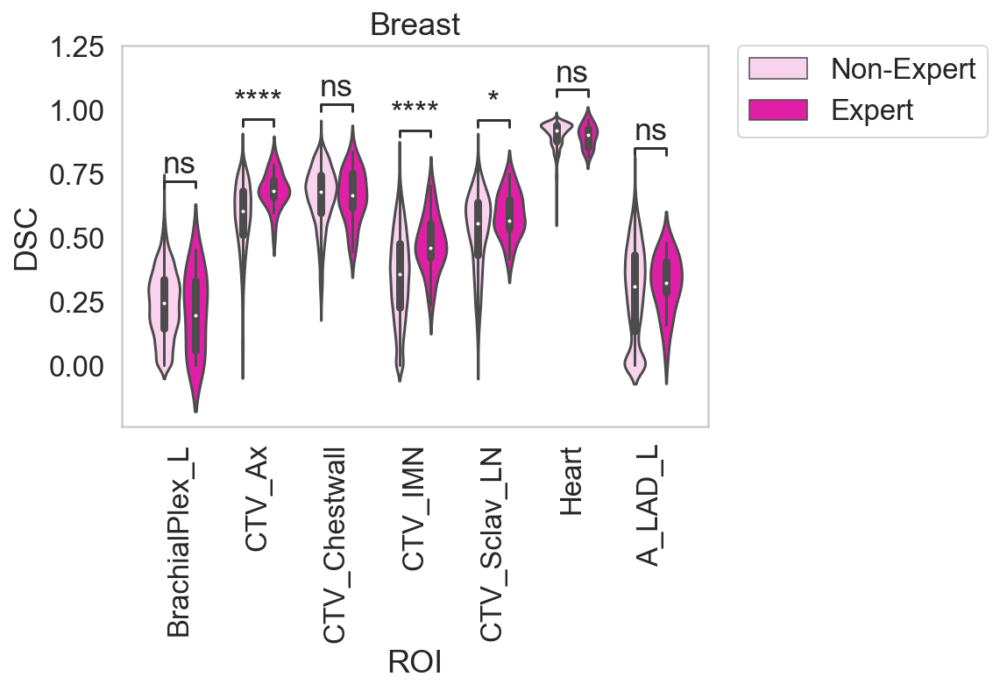

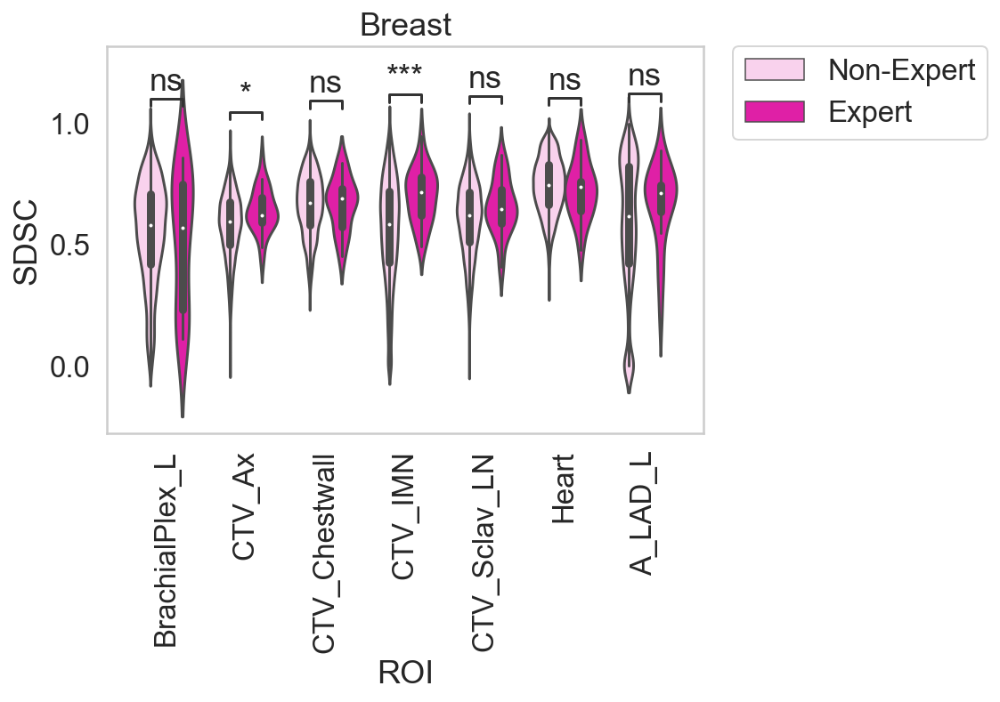

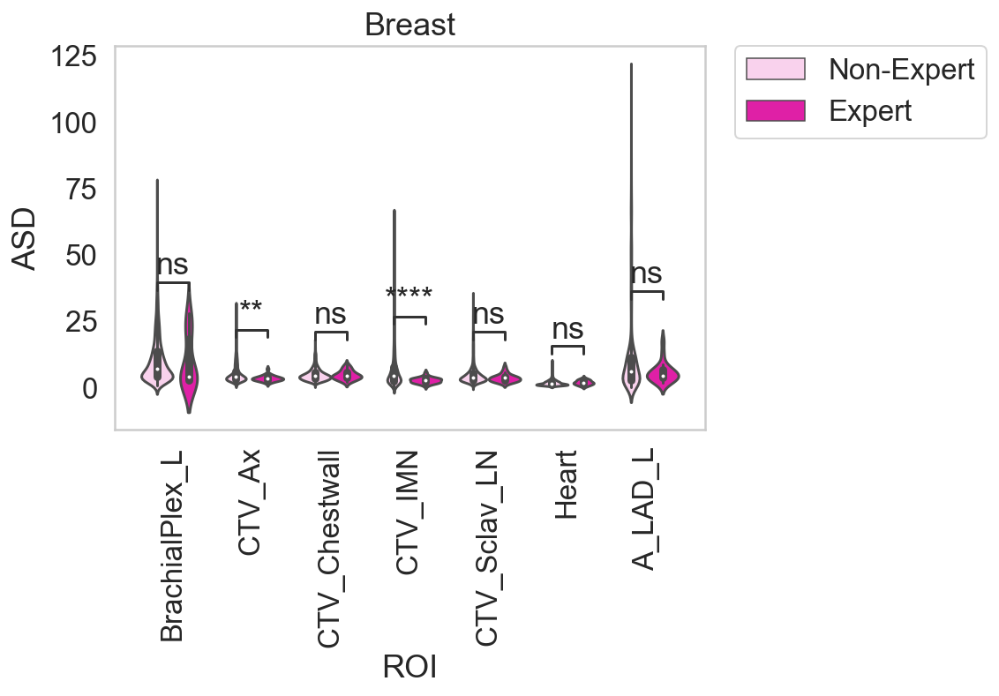

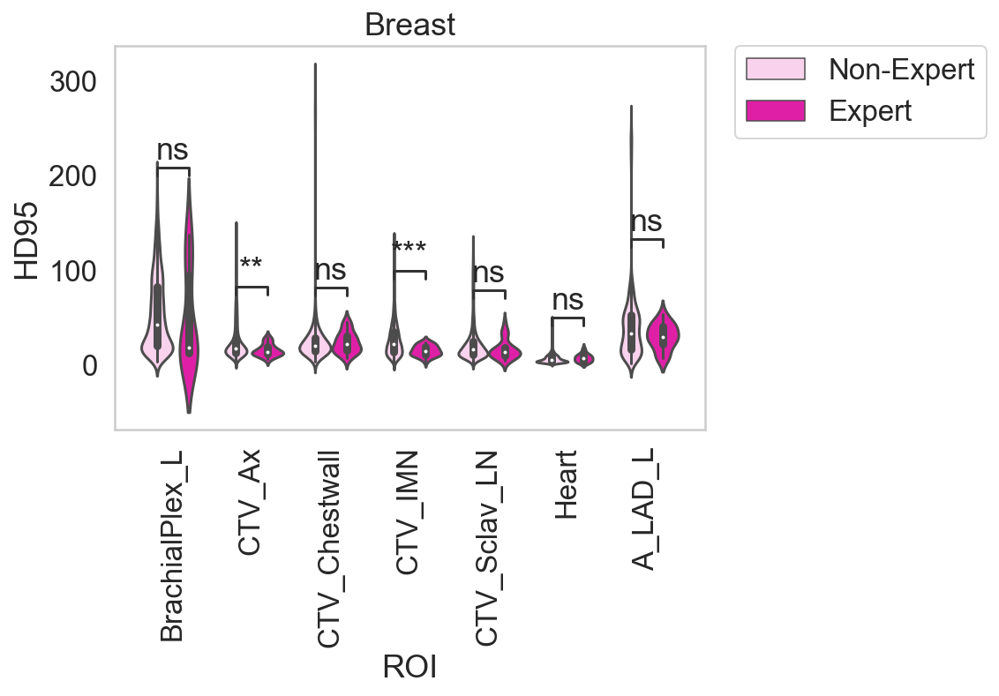

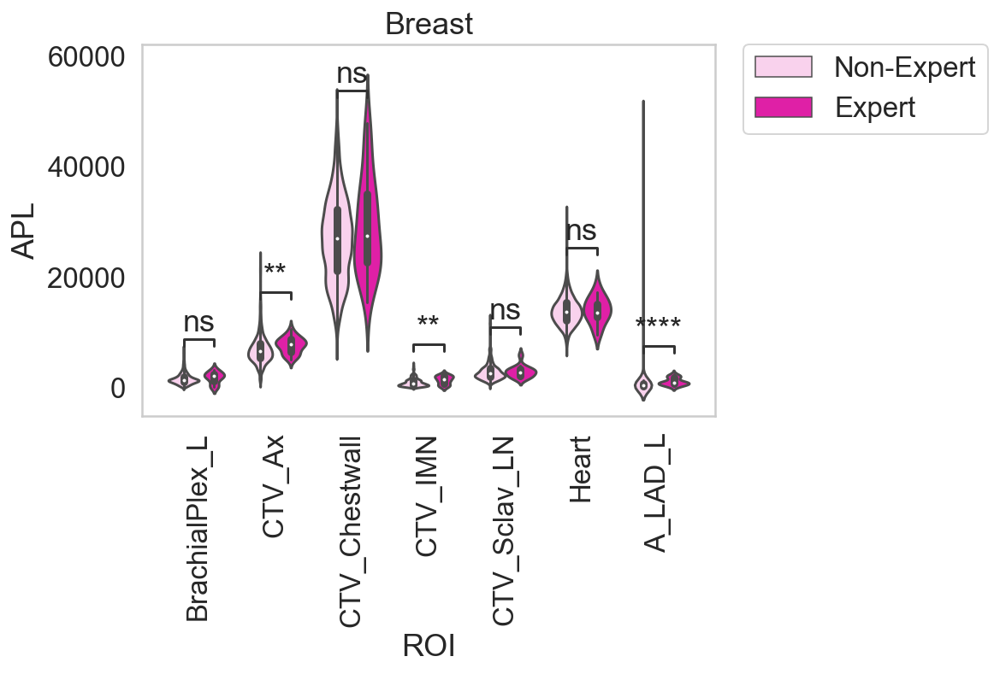

<Figure size 432x288 with 0 Axes>

In [17]:
x="ROI" 

y="SDSC_list"

hue="Class"
hue_order = ['Non-Expert', 'Expert']

y_list = ["DSC_list", "SDSC_list", "ASD_list", "HD95_list", "APL_list"] # iterate 

for y in y_list:
    print(y)

    ax = sns.violinplot(x=x, y=y, hue=hue,
                     data=df_pickle_explode,
                       hue_order = hue_order,
                        palette= breast_palette,
                       )

    ROI_list = ['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']
    class_list = ['Non-Expert', 'Expert']

    pairs = [tuple((ROI, classes) for classes in class_list) for ROI in ROI_list] # original

    # all combos, in theory reduces down to code above in 2-class example
    combination_list = list(itertools.combinations(class_list, 2))
    pairs = [tuple((ROI, classes) for classes in subclass_list) for subclass_list in combination_list for ROI in ROI_list]

    annot = Annotator(ax, pairs, data=df_pickle_explode, x=x, y=y, hue=hue, hue_order=hue_order)

    annot.new_plot(ax, pairs, data=df_pickle_explode, x=x, y=y, hue=hue, hue_order=hue_order)
    annot.configure(test='Mann-Whitney', verbose=2)
    annot.apply_test()
    annot.annotate()
    
     # TG-263 names 
    labels = ['BrachialPlex_L','CTV_Ax','CTV_Chestwall','CTV_IMN','CTV_Sclav_LN','Heart', 'A_LAD_L']
    ax.set_xticklabels(labels)

    plt.xticks(rotation=90)
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    plt.ylabel(y.split('_')[0])
    plt.title('Breast')
    
    plt.figure()

Volume measurements here.

In [24]:
%%time 

in_path = os.path.join(base_path, "structures_nifti_stratified")

ROI_list = ['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']

classes = ["Expert", "Non-Expert"] # for just getting Expert and Non-Expert 

df_vol = pd.DataFrame(columns=['ROI', 'Class', 'ID', 'Volume'])
counter = -1  

for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        print(class_)
        class_path = os.path.join(in_path, class_)
        
        IDs = os.listdir(class_path)
        for ID in IDs:
            #print(ID)
            ID_path = os.path.join(class_path, ID)
            structures = os.listdir(ID_path)
            for structure in structures:
                structure_path = os.path.join(ID_path, structure)
                if structure.split('.')[0] == ROI:
                    structure_volume = calculate_volume(structure_path)
                    
                    counter +=1
                    df_vol.loc[counter] = [ROI, class_, ID, structure_volume]
                    #print(df_vol)

brachialplexus_l
Expert
Non-Expert
ctv_axilla
Expert
Non-Expert
ctv_chestwall
Expert
Non-Expert
ctv_imn
Expert
Non-Expert
ctv_scv
Expert
Non-Expert
heart
Expert
Non-Expert
lad
Expert
Non-Expert
Wall time: 4min 4s


In [25]:
df_vol

,ROI,Class,ID,Volume
0,brachialplexus_l,Expert,structure_set_129_,17.660302
1,brachialplexus_l,Expert,structure_set_137_,5.193732
2,brachialplexus_l,Expert,structure_set_232_,21.008627
3,brachialplexus_l,Expert,structure_set_530_,1.104021
4,brachialplexus_l,Expert,structure_set_859_,13.671322
...,...,...,...,...
813,lad,Non-Expert,structure_set_537_,1.788997
814,lad,Non-Expert,structure_set_543_,1.966285
815,lad,Non-Expert,structure_set_551_,3.682755
816,lad,Non-Expert,structure_set_560_,3.078364


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

ctv_axilla_Non-Expert vs. ctv_axilla_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:5.891e-02 U_stat=2.760e+02
brachialplexus_l_Non-Expert vs. brachialplexus_l_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:5.110e-01 U_stat=2.210e+02
ctv_chestwall_Non-Expert vs. ctv_chestwall_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:5.353e-01 U_stat=4.050e+02
ctv_imn_Non-Expert vs. ctv_imn_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:3.790e-02 U_stat=2.640e+02
ctv_scv_Non-Expert vs. ctv_scv_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:4.315e-01 U_stat=3.950e+02
heart_Non-Expert vs. heart_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:8.536e-01 U_stat=4.420e+02
lad_Non-Expert vs. lad_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:1.038e-01 U_stat=1.930e+02


<Figure size 432x288 with 0 Axes>

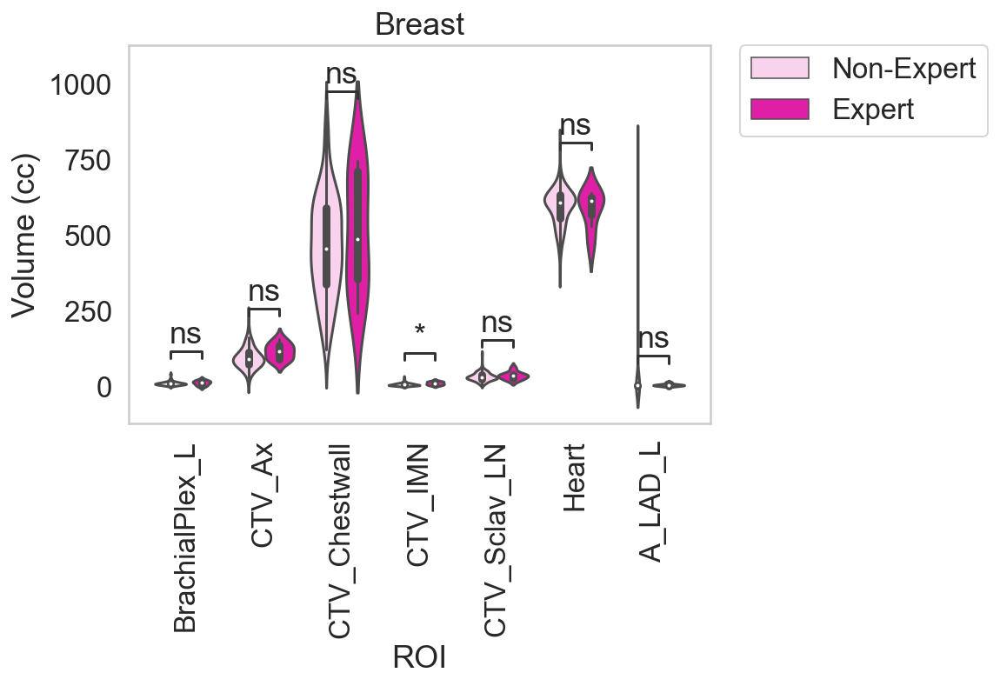

<Figure size 432x288 with 0 Axes>

In [26]:
x="ROI" 
y="Volume"
hue="Class"
hue_order = ['Non-Expert', 'Expert']
ROI_list = ['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']

ax = sns.violinplot(x=x, y=y, hue=hue,
                 data=df_vol,
                   hue_order = hue_order,
                   palette=breast_palette,
                   order = ROI_list) # Dont forget to set order in the calls below if you use it here 

class_list = ['Non-Expert', 'Expert']

pairs = [tuple((ROI, classes) for classes in class_list) for ROI in ROI_list]

# all combos, in theory reduces down to code above in 2-class example
combination_list = list(itertools.combinations(class_list, 2))
pairs = [tuple((ROI, classes) for classes in subclass_list) for subclass_list in combination_list for ROI in ROI_list]

annot = Annotator(ax, pairs, data=df_vol, x=x, y=y, hue=hue, hue_order=hue_order, order = ROI_list)

annot.new_plot(ax, pairs, data=df_vol, x=x, y=y, hue=hue, hue_order=hue_order, order = ROI_list)
annot.configure(test='Mann-Whitney', verbose=2)
annot.apply_test()
annot.annotate()

 # TG-263 names 
labels = ['BrachialPlex_L','CTV_Ax','CTV_Chestwall','CTV_IMN','CTV_Sclav_LN','Heart', 'A_LAD_L']
ax.set_xticklabels(labels)

plt.xticks(rotation=90)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.ylabel('Volume (cc)')
plt.title('Breast')

plt.figure()

### Direct comparisons of non-expert vs. expert STAPLE segmentations

In [27]:
df_pickle['DSC_median'] = df_pickle['DSC_list'].apply(lambda x: np.median(x))
df_pickle['HD95_median'] = df_pickle['HD95_list'].apply(lambda x: np.median(x))
df_pickle['APL_median'] = df_pickle['APL_list'].apply(lambda x: np.median(x))
df_pickle['SDSC_median'] = df_pickle['SDSC_list'].apply(lambda x: np.median(x))

In [29]:
in_path = os.path.join(base_path, "structures_nifti_stratified_STAPLE")

In [30]:
%%time 

ROI_list = ['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']

classes = ['Non-Expert', 'Expert']

df2 = pd.DataFrame(columns=['ROI', 'Class', 'DSC', 'HD95', 'APL', 'SDSC'])
counter = -1  

for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        file_list = []
        print(class_)
        class_path = os.path.join(in_path, class_)

        structures = os.listdir(class_path)
        for structure in structures:
            structure_path = os.path.join(class_path, structure)
            if structure.split('STAPLE.')[0] == ROI:

                file_1 = sitk.ReadImage(structure_path)
                file_2 = sitk.ReadImage(os.path.join(in_path, 'Expert', structure))

                mask_1 = sitk.GetArrayFromImage(file_1)
                mask_2 = sitk.GetArrayFromImage(file_2)

                DSC = compute_dice_coefficient(mask_1, mask_2)  
                
                # adding other metrics
                
                spacing_mm = file_1.GetSpacing() # need spacing to calcualte distances
                
                mask_1_bool = mask_1.astype(bool) # need to convert to bool format to work 
                mask_2_bool = mask_2.astype(bool)

                surface_distances = compute_surface_distances(mask_1_bool, mask_2_bool, spacing_mm) # need this for all calculations
                HD95 = compute_robust_hausdorff(surface_distances, 95)

                ASD_truth = compute_average_surface_distance(surface_distances)[0] #  A tuple with two float values: 1. the average distance (in mm) from the ground truth surface to thepredicted surface, 2. the average distance from the predicted surface to the ground truth surface.
                ASD_pred = compute_average_surface_distance(surface_distances)[1]
                ASD = (ASD_truth + ASD_pred)/2

                APL = AddedPathLength(mask_1, mask_2)
                
                tolerance = np.median(df_pickle[(df_pickle["ROI"] == ROI) & (df_pickle["Class"] == "Expert")]["ASD_list"].values[0]) # get tolerance
                SDSC = compute_surface_dice_at_tolerance(surface_distances, tolerance)
                
                
            
        counter +=1
        df2.loc[counter] = [ROI, class_, DSC, HD95, APL, SDSC]
        #print(df2)

brachialplexus_l
Non-Expert
Expert
ctv_axilla
Non-Expert
Expert
ctv_chestwall
Non-Expert
Expert
ctv_imn
Non-Expert
Expert
ctv_scv
Non-Expert
Expert
heart
Non-Expert
Expert
lad
Non-Expert
Expert
Wall time: 22.5 s


In [31]:
df2

,ROI,Class,DSC,HD95,APL,SDSC
0,brachialplexus_l,Non-Expert,0.423174,17.169244,2668,0.687453
1,brachialplexus_l,Expert,1.000000,0.000000,0,1.000000
2,ctv_axilla,Non-Expert,0.866627,6.347655,6450,0.885105
3,ctv_axilla,Expert,1.000000,0.000000,0,1.000000
4,ctv_chestwall,Non-Expert,0.904913,5.607748,25848,0.912802
5,ctv_chestwall,Expert,1.000000,0.000000,0,1.000000
6,ctv_imn,Non-Expert,0.651653,10.156248,1522,0.772803
7,ctv_imn,Expert,1.000000,0.000000,0,1.000000
8,ctv_scv,Non-Expert,0.766636,9.907292,3361,0.806630
9,ctv_scv,Expert,1.000000,0.000000,0,1.000000


In [32]:
# next step is combining the information from the previous dataframes to make bar plots of  novice and specialist DSC compared to exprt with dashed line of expodert mean IOV 

In [33]:
ROI_list = ['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']

In [34]:
#line_dict = {ROI:df_pickle[(df_pickle['Class'] == "Expert") & (df_pickle['ROI'] == ROI)]['DSC_median'].values[0] for ROI in ROI_list} # original
line_dict_DSC = {ROI:df_pickle[(df_pickle['Class'] == "Expert") & (df_pickle['ROI'] == ROI)]['DSC_median'].values[0] for ROI in ROI_list}
line_dict_HD95 = {ROI:df_pickle[(df_pickle['Class'] == "Expert") & (df_pickle['ROI'] == ROI)]['HD95_median'].values[0] for ROI in ROI_list}
line_dict_APL = {ROI:df_pickle[(df_pickle['Class'] == "Expert") & (df_pickle['ROI'] == ROI)]['APL_median'].values[0] for ROI in ROI_list}
line_dict_SDSC = {ROI:df_pickle[(df_pickle['Class'] == "Expert") & (df_pickle['ROI'] == ROI)]['SDSC_median'].values[0] for ROI in ROI_list}
line_dict_list = [line_dict_DSC, line_dict_HD95, line_dict_APL, line_dict_SDSC]

In [35]:
line_dict_list

[{'brachialplexus_l': 0.19650205761316872,
  'ctv_axilla': 0.6819500827955585,
  'ctv_chestwall': 0.6650613520065458,
  'ctv_imn': 0.46193446690802586,
  'ctv_scv': 0.56786170816696,
  'heart': 0.9023291235641302,
  'lad': 0.3235463442717329},
 {'brachialplexus_l': 18.397939552768918,
  'ctv_axilla': 13.81905428883195,
  'ctv_chestwall': 22.331754935965858,
  'ctv_imn': 15.088304525828427,
  'ctv_scv': 14.123269985020197,
  'heart': 7.617186069488525,
  'lad': 29.948865809033865},
 {'brachialplexus_l': 2130.0,
  'ctv_axilla': 7951.5,
  'ctv_chestwall': 27460.5,
  'ctv_imn': 1546.0,
  'ctv_scv': 2871.0,
  'heart': 13611.0,
  'lad': 957.0},
 {'brachialplexus_l': 0.5704427521181218,
  'ctv_axilla': 0.6201588185632028,
  'ctv_chestwall': 0.6897985310346975,
  'ctv_imn': 0.7150296908037352,
  'ctv_scv': 0.6453852071644135,
  'heart': 0.7368807502881014,
  'lad': 0.713727154753579}]

In [36]:
# make dataframe for counts of each ROI per class

In [37]:
in_path = os.path.join(base_path, "structures_nifti_stratified")

In [38]:
%%time 

ROI_list = ['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']

#classes = [class_ for class_ in os.listdir(in_path)]
classes = ['Non-Expert', 'Expert']

df3 = pd.DataFrame(columns=['ROI', 'Class', 'N'])
counter = -1  

for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        file_list = []
        print(class_)
        class_path = os.path.join(in_path, class_)
        
        IDs = os.listdir(class_path)
        for ID in IDs:
            ID_path = os.path.join(class_path, ID)

            structures = os.listdir(ID_path)
            for structure in structures:
                structure_path = os.path.join(class_path, structure)
                if structure.split('.')[0] == ROI:
                    file_list.append(structure_path)
        
        n = len(file_list)
        counter +=1
        df3.loc[counter] = [ROI, class_, n]
        #print(df2)

brachialplexus_l
Non-Expert
Expert
ctv_axilla
Non-Expert
Expert
ctv_chestwall
Non-Expert
Expert
ctv_imn
Non-Expert
Expert
ctv_scv
Non-Expert
Expert
heart
Non-Expert
Expert
lad
Non-Expert
Expert
Wall time: 143 ms


In [39]:
df3

,ROI,Class,N
0,brachialplexus_l,Non-Expert,88
1,brachialplexus_l,Expert,6
2,ctv_axilla,Non-Expert,115
3,ctv_axilla,Expert,8
4,ctv_chestwall,Non-Expert,117
5,ctv_chestwall,Expert,8
6,ctv_imn,Non-Expert,118
7,ctv_imn,Expert,8
8,ctv_scv,Non-Expert,119
9,ctv_scv,Expert,8


DSC
HD95
APL
SDSC


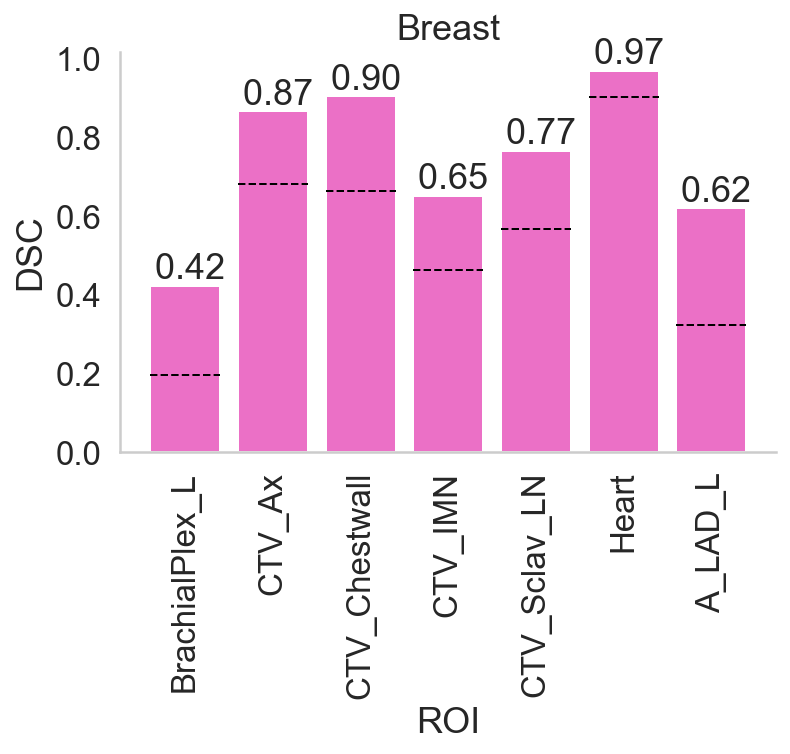

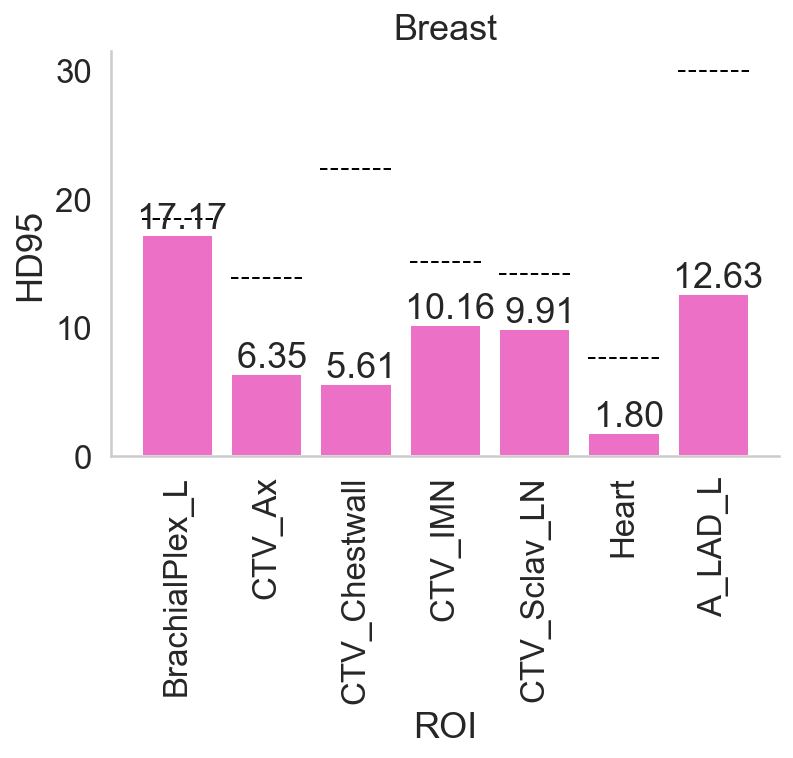

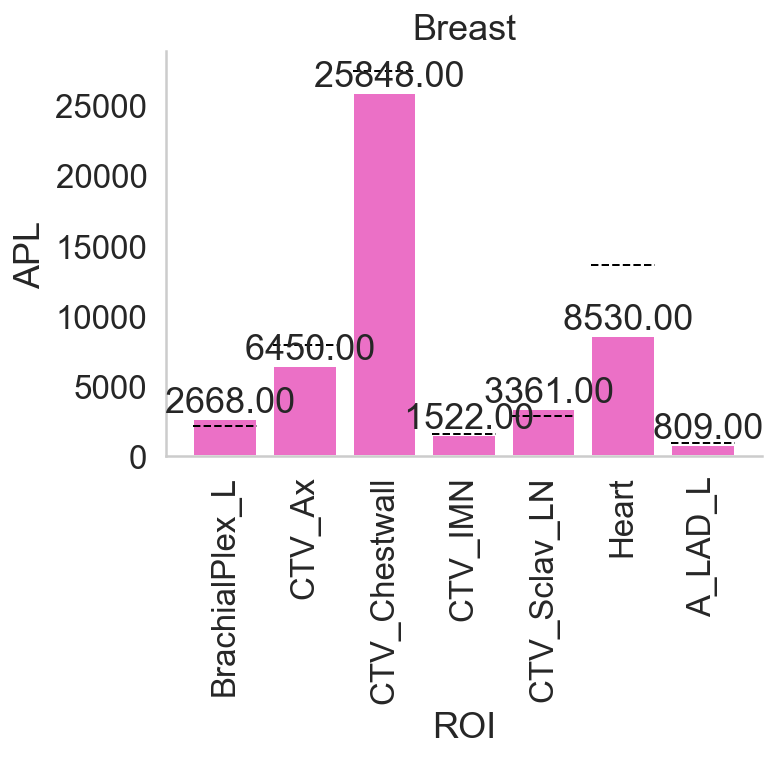

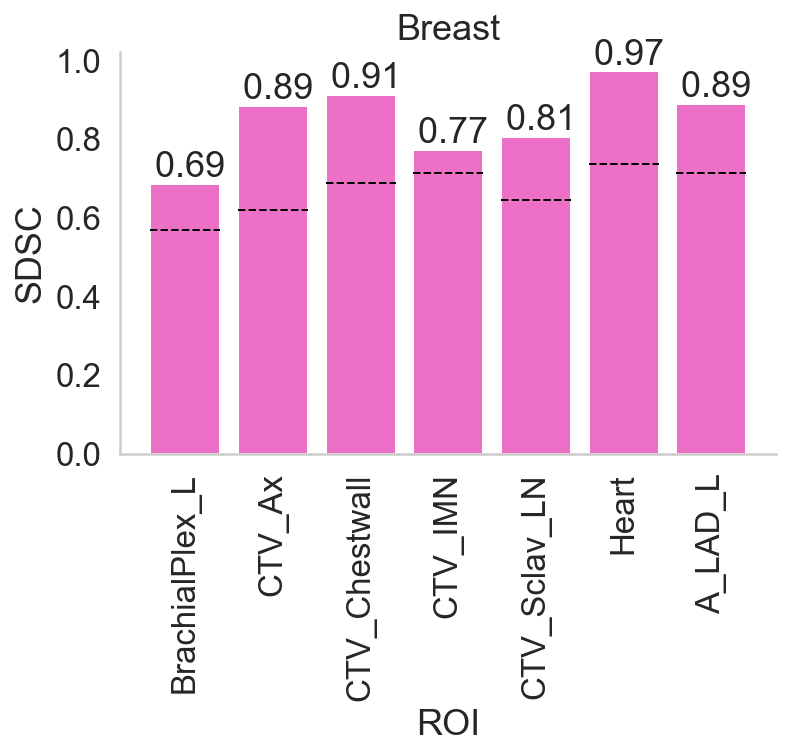

In [40]:
### Make box plots 

metric_list = ['DSC', 'HD95', 'APL', 'SDSC']

for metric, line_dict in zip(metric_list, line_dict_list): # line dict defined before 
    print(metric)
    
    if metric == "DSC" or metric == "SDSC":
        sharey=True
    else:
        sharey=False

    g = sns.catplot(x="ROI", y=metric, hue= "Class", hue_order = ["Non-Expert"], sharex = False,
                    sharey=sharey,
                    data=df2, kind="bar", 
                    height=4, aspect=1.5,
                    palette = breast_palette_old,
                    )
    
    for ax in g.axes.ravel(): # https://stackoverflow.com/questions/41127841/how-to-annotate-bars-in-a-seaborn-facetgrid-works-in-factorplot
        for a, ROI in zip(ax.patches, ROI_list):         

            value = float((line_dict[ROI]))

            x_start = a.get_x()
            width = a.get_width()

            ax.plot([x_start, x_start+width], [value, value], '--', c='black', linewidth=1)
    
    plt.xticks(rotation=90)
    plt.title('Breast')
    
    
    axes = g.axes.flatten()
    for ax in axes:
        for container in ax.containers:
            ax.bar_label(container, labels=[f'{x: .2f}' for x in container.datavalues]) # https://stackoverflow.com/questions/70515542/adding-comma-to-bar-labels-in-matplotlib
            
    g._legend.remove() # remove legend since just showing non-expert 
    
    # TG-263 names 
    labels = ['BrachialPlex_L','CTV_Ax','CTV_Chestwall','CTV_IMN','CTV_Sclav_LN','Heart', 'A_LAD_L']
    g.set_xticklabels(labels)    

### Bootstrap experiments

In [31]:
%%time

ROI_list = ['lad', 'brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart']

bootstrap = 100
#bootstrap = 2 # testing 

path = 'C:\\Users\\kawahid\\Desktop\\MSK_STAPLE_project\\Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified\\Non-Expert' # new 

expert_STAPLE_path = "C:\\Users\\kawahid\\Desktop\MSK_STAPLE_project\\Case 01 (Left Breast Post-Mastectomy)\\structures_nifti_stratified_STAPLE\\Expert"

df4 = pd.DataFrame(columns=['ROI', 'N', 'DSC_list', 'HD95_list', 'APL_list', 'SDSC_list', 'ID_list'])

counter = -1  # for df 

counter2 = -1 # for random seed 

n_list = [2, 3, 4, 5, 6, 7, 8, 9, 10, 15, 20, 25]

for ROI in ROI_list:
    #print(ROI)
    expert_file_path = os.path.join(expert_STAPLE_path, ROI+'STAPLE.nii.gz')
    cases = [case for case in os.listdir(path) if ROI+'.nii.gz' in os.listdir(os.path.join(path, case))]
    for n in n_list:
        #print(n)
        DSC_list = []
        HD95_list = []
        APL_list = []
        SDSC_list = []
        
        subcase_list = []
        for iteration in range(bootstrap):
            
            switch = True 
            
            counter2 +=1 
            
            while switch == True: # horrible practice but don't know what else to do
                
                print("ROI:", ROI, "; total staple:", n, "; boostrap iteration:", iteration, "; random counter:", counter2)
            
                random.seed(counter2)
                np.random.seed(counter2)

                #print(counter2)

                subcases = random.sample(cases, n)
                #print(subcases) # not sure if this is crashing notebook, probably note but just gonna check 
                subcase_list.append(subcases)

                file_list = []
                for case in subcases:
                    case_path = os.path.join(path, case)
                    file_path = os.path.join(case_path, ROI+'.nii.gz')
                    file_list.append(file_path)

                segmentations = [sitk.ReadImage(file_name, sitk.sitkUInt8) for file_name in file_list]

                foregroundValue = 1
                threshold = 0.95
                #threshold = 0.90

                if n <= 6: 
                    #print('test')
                    p = multiprocessing.Process(target=sitk.STAPLE, name="Foo", args=(segmentations, foregroundValue,))
                    p.start()
                    p.join(60) # set at 60 sec for now.. 

                    # If thread is active
                    if p.is_alive():
                        print("STAPLE function is taking too long, killing it and getting new random samples")

                        # Terminate function 
                        p.terminate()
                        p.join()
                        counter2 +=1 
                        continue

                #print('test2')
                reference_segmentation_STAPLE_probabilities = sitk.STAPLE(segmentations, foregroundValue) 

                file_1 = reference_segmentation_STAPLE_probabilities > threshold
                file_2 = sitk.ReadImage(expert_file_path)

                mask_1 = sitk.GetArrayFromImage(file_1)
                mask_2 = sitk.GetArrayFromImage(file_2)

                DSC = compute_dice_coefficient(mask_1, mask_2)   
                DSC_list.append(DSC)
                
                # adding other metrics
                
                spacing_mm = file_1.GetSpacing() # need spacing to calcualte distances
                
                mask_1_bool = mask_1.astype(bool) # need to convert to bool format to work 
                mask_2_bool = mask_2.astype(bool)

                surface_distances = compute_surface_distances(mask_1_bool, mask_2_bool, spacing_mm) # need this for all calculations
                HD95 = compute_robust_hausdorff(surface_distances, 95)
                HD95_list.append(HD95)

                APL = AddedPathLength(mask_1, mask_2)
                APL_list.append(APL)
                
                tolerance = np.median(df_pickle[(df_pickle["ROI"] == ROI) & (df_pickle["Class"] == "Expert")]["ASD_list"].values[0]) # get tolerance
                SDSC = compute_surface_dice_at_tolerance(surface_distances, tolerance)
                SDSC_list.append(SDSC)
                
                counter +=1
                df4.loc[counter] = [ROI, n, DSC, HD95, APL, SDSC, subcases]

                switch = False
                
        #counter +=1
        #df4.loc[counter] = [ROI, n, DSC_list, HD95_list, APL_list, SDSC_list, subcase_list]

        print(np.mean(DSC_list)) # FOR REFERENCE YOU'VE BEEN PRINTING OUT THE WRONG STUFF BUT THATS FINE 
        print(np.mean(HD95_list))
        print(np.mean(APL_list))
        print(np.mean(SDSC_list))

ROI: lad ; total staple: 2 ; boostrap iteration: 0 ; random counter: 0
STAPLE function is taking too long, killing it and getting new random samples
ROI: lad ; total staple: 2 ; boostrap iteration: 0 ; random counter: 1
STAPLE function is taking too long, killing it and getting new random samples
ROI: lad ; total staple: 2 ; boostrap iteration: 0 ; random counter: 2
ROI: lad ; total staple: 2 ; boostrap iteration: 1 ; random counter: 3
ROI: lad ; total staple: 2 ; boostrap iteration: 2 ; random counter: 4
ROI: lad ; total staple: 2 ; boostrap iteration: 3 ; random counter: 5
ROI: lad ; total staple: 2 ; boostrap iteration: 4 ; random counter: 6
ROI: lad ; total staple: 2 ; boostrap iteration: 5 ; random counter: 7
ROI: lad ; total staple: 2 ; boostrap iteration: 6 ; random counter: 8
ROI: lad ; total staple: 2 ; boostrap iteration: 7 ; random counter: 9
STAPLE function is taking too long, killing it and getting new random samples
ROI: lad ; total staple: 2 ; boostrap iteration: 7 ; ran

ROI: lad ; total staple: 2 ; boostrap iteration: 92 ; random counter: 102
ROI: lad ; total staple: 2 ; boostrap iteration: 93 ; random counter: 103
ROI: lad ; total staple: 2 ; boostrap iteration: 94 ; random counter: 104
ROI: lad ; total staple: 2 ; boostrap iteration: 95 ; random counter: 105
ROI: lad ; total staple: 2 ; boostrap iteration: 96 ; random counter: 106
ROI: lad ; total staple: 2 ; boostrap iteration: 97 ; random counter: 107
ROI: lad ; total staple: 2 ; boostrap iteration: 98 ; random counter: 108
ROI: lad ; total staple: 2 ; boostrap iteration: 99 ; random counter: 109
0.17721071499157304
inf
1830.68
0.4412245582650038
ROI: lad ; total staple: 3 ; boostrap iteration: 0 ; random counter: 110
ROI: lad ; total staple: 3 ; boostrap iteration: 1 ; random counter: 111
ROI: lad ; total staple: 3 ; boostrap iteration: 2 ; random counter: 112
STAPLE function is taking too long, killing it and getting new random samples
ROI: lad ; total staple: 3 ; boostrap iteration: 2 ; random 

ROI: lad ; total staple: 3 ; boostrap iteration: 68 ; random counter: 195
STAPLE function is taking too long, killing it and getting new random samples
ROI: lad ; total staple: 3 ; boostrap iteration: 68 ; random counter: 196
ROI: lad ; total staple: 3 ; boostrap iteration: 69 ; random counter: 197
ROI: lad ; total staple: 3 ; boostrap iteration: 70 ; random counter: 198
STAPLE function is taking too long, killing it and getting new random samples
ROI: lad ; total staple: 3 ; boostrap iteration: 70 ; random counter: 199
STAPLE function is taking too long, killing it and getting new random samples
ROI: lad ; total staple: 3 ; boostrap iteration: 70 ; random counter: 200
ROI: lad ; total staple: 3 ; boostrap iteration: 71 ; random counter: 201
STAPLE function is taking too long, killing it and getting new random samples
ROI: lad ; total staple: 3 ; boostrap iteration: 71 ; random counter: 202
STAPLE function is taking too long, killing it and getting new random samples
ROI: lad ; total s

ROI: lad ; total staple: 4 ; boostrap iteration: 44 ; random counter: 288
ROI: lad ; total staple: 4 ; boostrap iteration: 45 ; random counter: 289
ROI: lad ; total staple: 4 ; boostrap iteration: 46 ; random counter: 290
ROI: lad ; total staple: 4 ; boostrap iteration: 47 ; random counter: 291
ROI: lad ; total staple: 4 ; boostrap iteration: 48 ; random counter: 292
ROI: lad ; total staple: 4 ; boostrap iteration: 49 ; random counter: 293
ROI: lad ; total staple: 4 ; boostrap iteration: 50 ; random counter: 294
ROI: lad ; total staple: 4 ; boostrap iteration: 51 ; random counter: 295
ROI: lad ; total staple: 4 ; boostrap iteration: 52 ; random counter: 296
ROI: lad ; total staple: 4 ; boostrap iteration: 53 ; random counter: 297
ROI: lad ; total staple: 4 ; boostrap iteration: 54 ; random counter: 298
ROI: lad ; total staple: 4 ; boostrap iteration: 55 ; random counter: 299
ROI: lad ; total staple: 4 ; boostrap iteration: 56 ; random counter: 300
ROI: lad ; total staple: 4 ; boostrap 

ROI: lad ; total staple: 5 ; boostrap iteration: 36 ; random counter: 389
ROI: lad ; total staple: 5 ; boostrap iteration: 37 ; random counter: 390
ROI: lad ; total staple: 5 ; boostrap iteration: 38 ; random counter: 391
ROI: lad ; total staple: 5 ; boostrap iteration: 39 ; random counter: 392
ROI: lad ; total staple: 5 ; boostrap iteration: 40 ; random counter: 393
ROI: lad ; total staple: 5 ; boostrap iteration: 41 ; random counter: 394
ROI: lad ; total staple: 5 ; boostrap iteration: 42 ; random counter: 395
ROI: lad ; total staple: 5 ; boostrap iteration: 43 ; random counter: 396
ROI: lad ; total staple: 5 ; boostrap iteration: 44 ; random counter: 397
STAPLE function is taking too long, killing it and getting new random samples
ROI: lad ; total staple: 5 ; boostrap iteration: 44 ; random counter: 398
ROI: lad ; total staple: 5 ; boostrap iteration: 45 ; random counter: 399
ROI: lad ; total staple: 5 ; boostrap iteration: 46 ; random counter: 400
ROI: lad ; total staple: 5 ; boost

ROI: lad ; total staple: 6 ; boostrap iteration: 30 ; random counter: 491
STAPLE function is taking too long, killing it and getting new random samples
ROI: lad ; total staple: 6 ; boostrap iteration: 30 ; random counter: 492
ROI: lad ; total staple: 6 ; boostrap iteration: 31 ; random counter: 493
ROI: lad ; total staple: 6 ; boostrap iteration: 32 ; random counter: 494
ROI: lad ; total staple: 6 ; boostrap iteration: 33 ; random counter: 495
ROI: lad ; total staple: 6 ; boostrap iteration: 34 ; random counter: 496
ROI: lad ; total staple: 6 ; boostrap iteration: 35 ; random counter: 497
ROI: lad ; total staple: 6 ; boostrap iteration: 36 ; random counter: 498
ROI: lad ; total staple: 6 ; boostrap iteration: 37 ; random counter: 499
ROI: lad ; total staple: 6 ; boostrap iteration: 38 ; random counter: 500
ROI: lad ; total staple: 6 ; boostrap iteration: 39 ; random counter: 501
ROI: lad ; total staple: 6 ; boostrap iteration: 40 ; random counter: 502
ROI: lad ; total staple: 6 ; boost

ROI: lad ; total staple: 7 ; boostrap iteration: 28 ; random counter: 595
ROI: lad ; total staple: 7 ; boostrap iteration: 29 ; random counter: 596
ROI: lad ; total staple: 7 ; boostrap iteration: 30 ; random counter: 597
ROI: lad ; total staple: 7 ; boostrap iteration: 31 ; random counter: 598
ROI: lad ; total staple: 7 ; boostrap iteration: 32 ; random counter: 599
ROI: lad ; total staple: 7 ; boostrap iteration: 33 ; random counter: 600
ROI: lad ; total staple: 7 ; boostrap iteration: 34 ; random counter: 601
ROI: lad ; total staple: 7 ; boostrap iteration: 35 ; random counter: 602
ROI: lad ; total staple: 7 ; boostrap iteration: 36 ; random counter: 603
ROI: lad ; total staple: 7 ; boostrap iteration: 37 ; random counter: 604
ROI: lad ; total staple: 7 ; boostrap iteration: 38 ; random counter: 605
ROI: lad ; total staple: 7 ; boostrap iteration: 39 ; random counter: 606
ROI: lad ; total staple: 7 ; boostrap iteration: 40 ; random counter: 607
ROI: lad ; total staple: 7 ; boostrap 

ROI: lad ; total staple: 8 ; boostrap iteration: 38 ; random counter: 705
ROI: lad ; total staple: 8 ; boostrap iteration: 39 ; random counter: 706
ROI: lad ; total staple: 8 ; boostrap iteration: 40 ; random counter: 707
ROI: lad ; total staple: 8 ; boostrap iteration: 41 ; random counter: 708
ROI: lad ; total staple: 8 ; boostrap iteration: 42 ; random counter: 709
ROI: lad ; total staple: 8 ; boostrap iteration: 43 ; random counter: 710
ROI: lad ; total staple: 8 ; boostrap iteration: 44 ; random counter: 711
ROI: lad ; total staple: 8 ; boostrap iteration: 45 ; random counter: 712
ROI: lad ; total staple: 8 ; boostrap iteration: 46 ; random counter: 713
ROI: lad ; total staple: 8 ; boostrap iteration: 47 ; random counter: 714
ROI: lad ; total staple: 8 ; boostrap iteration: 48 ; random counter: 715
ROI: lad ; total staple: 8 ; boostrap iteration: 49 ; random counter: 716
ROI: lad ; total staple: 8 ; boostrap iteration: 50 ; random counter: 717
ROI: lad ; total staple: 8 ; boostrap 

ROI: lad ; total staple: 9 ; boostrap iteration: 49 ; random counter: 816
ROI: lad ; total staple: 9 ; boostrap iteration: 50 ; random counter: 817
ROI: lad ; total staple: 9 ; boostrap iteration: 51 ; random counter: 818
ROI: lad ; total staple: 9 ; boostrap iteration: 52 ; random counter: 819
ROI: lad ; total staple: 9 ; boostrap iteration: 53 ; random counter: 820
ROI: lad ; total staple: 9 ; boostrap iteration: 54 ; random counter: 821
ROI: lad ; total staple: 9 ; boostrap iteration: 55 ; random counter: 822
ROI: lad ; total staple: 9 ; boostrap iteration: 56 ; random counter: 823
ROI: lad ; total staple: 9 ; boostrap iteration: 57 ; random counter: 824
ROI: lad ; total staple: 9 ; boostrap iteration: 58 ; random counter: 825
ROI: lad ; total staple: 9 ; boostrap iteration: 59 ; random counter: 826
ROI: lad ; total staple: 9 ; boostrap iteration: 60 ; random counter: 827
ROI: lad ; total staple: 9 ; boostrap iteration: 61 ; random counter: 828
ROI: lad ; total staple: 9 ; boostrap 

ROI: lad ; total staple: 10 ; boostrap iteration: 59 ; random counter: 926
ROI: lad ; total staple: 10 ; boostrap iteration: 60 ; random counter: 927
ROI: lad ; total staple: 10 ; boostrap iteration: 61 ; random counter: 928
ROI: lad ; total staple: 10 ; boostrap iteration: 62 ; random counter: 929
ROI: lad ; total staple: 10 ; boostrap iteration: 63 ; random counter: 930
ROI: lad ; total staple: 10 ; boostrap iteration: 64 ; random counter: 931
ROI: lad ; total staple: 10 ; boostrap iteration: 65 ; random counter: 932
ROI: lad ; total staple: 10 ; boostrap iteration: 66 ; random counter: 933
ROI: lad ; total staple: 10 ; boostrap iteration: 67 ; random counter: 934
ROI: lad ; total staple: 10 ; boostrap iteration: 68 ; random counter: 935
ROI: lad ; total staple: 10 ; boostrap iteration: 69 ; random counter: 936
ROI: lad ; total staple: 10 ; boostrap iteration: 70 ; random counter: 937
ROI: lad ; total staple: 10 ; boostrap iteration: 71 ; random counter: 938
ROI: lad ; total staple: 

ROI: lad ; total staple: 15 ; boostrap iteration: 68 ; random counter: 1035
ROI: lad ; total staple: 15 ; boostrap iteration: 69 ; random counter: 1036
ROI: lad ; total staple: 15 ; boostrap iteration: 70 ; random counter: 1037
ROI: lad ; total staple: 15 ; boostrap iteration: 71 ; random counter: 1038
ROI: lad ; total staple: 15 ; boostrap iteration: 72 ; random counter: 1039
ROI: lad ; total staple: 15 ; boostrap iteration: 73 ; random counter: 1040
ROI: lad ; total staple: 15 ; boostrap iteration: 74 ; random counter: 1041
ROI: lad ; total staple: 15 ; boostrap iteration: 75 ; random counter: 1042
ROI: lad ; total staple: 15 ; boostrap iteration: 76 ; random counter: 1043
ROI: lad ; total staple: 15 ; boostrap iteration: 77 ; random counter: 1044
ROI: lad ; total staple: 15 ; boostrap iteration: 78 ; random counter: 1045
ROI: lad ; total staple: 15 ; boostrap iteration: 79 ; random counter: 1046
ROI: lad ; total staple: 15 ; boostrap iteration: 80 ; random counter: 1047
ROI: lad ; t

ROI: lad ; total staple: 20 ; boostrap iteration: 76 ; random counter: 1143
ROI: lad ; total staple: 20 ; boostrap iteration: 77 ; random counter: 1144
ROI: lad ; total staple: 20 ; boostrap iteration: 78 ; random counter: 1145
ROI: lad ; total staple: 20 ; boostrap iteration: 79 ; random counter: 1146
ROI: lad ; total staple: 20 ; boostrap iteration: 80 ; random counter: 1147
ROI: lad ; total staple: 20 ; boostrap iteration: 81 ; random counter: 1148
ROI: lad ; total staple: 20 ; boostrap iteration: 82 ; random counter: 1149
ROI: lad ; total staple: 20 ; boostrap iteration: 83 ; random counter: 1150
ROI: lad ; total staple: 20 ; boostrap iteration: 84 ; random counter: 1151
ROI: lad ; total staple: 20 ; boostrap iteration: 85 ; random counter: 1152
ROI: lad ; total staple: 20 ; boostrap iteration: 86 ; random counter: 1153
ROI: lad ; total staple: 20 ; boostrap iteration: 87 ; random counter: 1154
ROI: lad ; total staple: 20 ; boostrap iteration: 88 ; random counter: 1155
ROI: lad ; t

ROI: lad ; total staple: 25 ; boostrap iteration: 84 ; random counter: 1251
ROI: lad ; total staple: 25 ; boostrap iteration: 85 ; random counter: 1252
ROI: lad ; total staple: 25 ; boostrap iteration: 86 ; random counter: 1253
ROI: lad ; total staple: 25 ; boostrap iteration: 87 ; random counter: 1254
ROI: lad ; total staple: 25 ; boostrap iteration: 88 ; random counter: 1255
ROI: lad ; total staple: 25 ; boostrap iteration: 89 ; random counter: 1256
ROI: lad ; total staple: 25 ; boostrap iteration: 90 ; random counter: 1257
ROI: lad ; total staple: 25 ; boostrap iteration: 91 ; random counter: 1258
ROI: lad ; total staple: 25 ; boostrap iteration: 92 ; random counter: 1259
ROI: lad ; total staple: 25 ; boostrap iteration: 93 ; random counter: 1260
ROI: lad ; total staple: 25 ; boostrap iteration: 94 ; random counter: 1261
ROI: lad ; total staple: 25 ; boostrap iteration: 95 ; random counter: 1262
ROI: lad ; total staple: 25 ; boostrap iteration: 96 ; random counter: 1263
ROI: lad ; t

ROI: brachialplexus_l ; total staple: 2 ; boostrap iteration: 72 ; random counter: 1343
ROI: brachialplexus_l ; total staple: 2 ; boostrap iteration: 73 ; random counter: 1344
ROI: brachialplexus_l ; total staple: 2 ; boostrap iteration: 74 ; random counter: 1345
ROI: brachialplexus_l ; total staple: 2 ; boostrap iteration: 75 ; random counter: 1346
ROI: brachialplexus_l ; total staple: 2 ; boostrap iteration: 76 ; random counter: 1347
ROI: brachialplexus_l ; total staple: 2 ; boostrap iteration: 77 ; random counter: 1348
ROI: brachialplexus_l ; total staple: 2 ; boostrap iteration: 78 ; random counter: 1349
ROI: brachialplexus_l ; total staple: 2 ; boostrap iteration: 79 ; random counter: 1350
ROI: brachialplexus_l ; total staple: 2 ; boostrap iteration: 80 ; random counter: 1351
ROI: brachialplexus_l ; total staple: 2 ; boostrap iteration: 81 ; random counter: 1352
ROI: brachialplexus_l ; total staple: 2 ; boostrap iteration: 82 ; random counter: 1353
ROI: brachialplexus_l ; total st

ROI: brachialplexus_l ; total staple: 3 ; boostrap iteration: 46 ; random counter: 1427
ROI: brachialplexus_l ; total staple: 3 ; boostrap iteration: 47 ; random counter: 1428
ROI: brachialplexus_l ; total staple: 3 ; boostrap iteration: 48 ; random counter: 1429
ROI: brachialplexus_l ; total staple: 3 ; boostrap iteration: 49 ; random counter: 1430
ROI: brachialplexus_l ; total staple: 3 ; boostrap iteration: 50 ; random counter: 1431
ROI: brachialplexus_l ; total staple: 3 ; boostrap iteration: 51 ; random counter: 1432
STAPLE function is taking too long, killing it and getting new random samples
ROI: brachialplexus_l ; total staple: 3 ; boostrap iteration: 51 ; random counter: 1433
ROI: brachialplexus_l ; total staple: 3 ; boostrap iteration: 52 ; random counter: 1434
ROI: brachialplexus_l ; total staple: 3 ; boostrap iteration: 53 ; random counter: 1435
STAPLE function is taking too long, killing it and getting new random samples
ROI: brachialplexus_l ; total staple: 3 ; boostrap i

STAPLE function is taking too long, killing it and getting new random samples
ROI: brachialplexus_l ; total staple: 3 ; boostrap iteration: 93 ; random counter: 1499
ROI: brachialplexus_l ; total staple: 3 ; boostrap iteration: 94 ; random counter: 1500
ROI: brachialplexus_l ; total staple: 3 ; boostrap iteration: 95 ; random counter: 1501
ROI: brachialplexus_l ; total staple: 3 ; boostrap iteration: 96 ; random counter: 1502
ROI: brachialplexus_l ; total staple: 3 ; boostrap iteration: 97 ; random counter: 1503
ROI: brachialplexus_l ; total staple: 3 ; boostrap iteration: 98 ; random counter: 1504
STAPLE function is taking too long, killing it and getting new random samples
ROI: brachialplexus_l ; total staple: 3 ; boostrap iteration: 98 ; random counter: 1505
STAPLE function is taking too long, killing it and getting new random samples
ROI: brachialplexus_l ; total staple: 3 ; boostrap iteration: 98 ; random counter: 1506
ROI: brachialplexus_l ; total staple: 3 ; boostrap iteration: 

ROI: brachialplexus_l ; total staple: 4 ; boostrap iteration: 78 ; random counter: 1588
ROI: brachialplexus_l ; total staple: 4 ; boostrap iteration: 79 ; random counter: 1589
ROI: brachialplexus_l ; total staple: 4 ; boostrap iteration: 80 ; random counter: 1590
ROI: brachialplexus_l ; total staple: 4 ; boostrap iteration: 81 ; random counter: 1591
ROI: brachialplexus_l ; total staple: 4 ; boostrap iteration: 82 ; random counter: 1592
ROI: brachialplexus_l ; total staple: 4 ; boostrap iteration: 83 ; random counter: 1593
ROI: brachialplexus_l ; total staple: 4 ; boostrap iteration: 84 ; random counter: 1594
ROI: brachialplexus_l ; total staple: 4 ; boostrap iteration: 85 ; random counter: 1595
ROI: brachialplexus_l ; total staple: 4 ; boostrap iteration: 86 ; random counter: 1596
ROI: brachialplexus_l ; total staple: 4 ; boostrap iteration: 87 ; random counter: 1597
ROI: brachialplexus_l ; total staple: 4 ; boostrap iteration: 88 ; random counter: 1598
ROI: brachialplexus_l ; total st

ROI: brachialplexus_l ; total staple: 5 ; boostrap iteration: 71 ; random counter: 1681
ROI: brachialplexus_l ; total staple: 5 ; boostrap iteration: 72 ; random counter: 1682
ROI: brachialplexus_l ; total staple: 5 ; boostrap iteration: 73 ; random counter: 1683
ROI: brachialplexus_l ; total staple: 5 ; boostrap iteration: 74 ; random counter: 1684
ROI: brachialplexus_l ; total staple: 5 ; boostrap iteration: 75 ; random counter: 1685
ROI: brachialplexus_l ; total staple: 5 ; boostrap iteration: 76 ; random counter: 1686
ROI: brachialplexus_l ; total staple: 5 ; boostrap iteration: 77 ; random counter: 1687
ROI: brachialplexus_l ; total staple: 5 ; boostrap iteration: 78 ; random counter: 1688
ROI: brachialplexus_l ; total staple: 5 ; boostrap iteration: 79 ; random counter: 1689
ROI: brachialplexus_l ; total staple: 5 ; boostrap iteration: 80 ; random counter: 1690
ROI: brachialplexus_l ; total staple: 5 ; boostrap iteration: 81 ; random counter: 1691
ROI: brachialplexus_l ; total st

ROI: brachialplexus_l ; total staple: 6 ; boostrap iteration: 62 ; random counter: 1773
ROI: brachialplexus_l ; total staple: 6 ; boostrap iteration: 63 ; random counter: 1774
ROI: brachialplexus_l ; total staple: 6 ; boostrap iteration: 64 ; random counter: 1775
ROI: brachialplexus_l ; total staple: 6 ; boostrap iteration: 65 ; random counter: 1776
ROI: brachialplexus_l ; total staple: 6 ; boostrap iteration: 66 ; random counter: 1777
ROI: brachialplexus_l ; total staple: 6 ; boostrap iteration: 67 ; random counter: 1778
ROI: brachialplexus_l ; total staple: 6 ; boostrap iteration: 68 ; random counter: 1779
ROI: brachialplexus_l ; total staple: 6 ; boostrap iteration: 69 ; random counter: 1780
ROI: brachialplexus_l ; total staple: 6 ; boostrap iteration: 70 ; random counter: 1781
ROI: brachialplexus_l ; total staple: 6 ; boostrap iteration: 71 ; random counter: 1782
ROI: brachialplexus_l ; total staple: 6 ; boostrap iteration: 72 ; random counter: 1783
ROI: brachialplexus_l ; total st

ROI: brachialplexus_l ; total staple: 7 ; boostrap iteration: 55 ; random counter: 1866
ROI: brachialplexus_l ; total staple: 7 ; boostrap iteration: 56 ; random counter: 1867
ROI: brachialplexus_l ; total staple: 7 ; boostrap iteration: 57 ; random counter: 1868
ROI: brachialplexus_l ; total staple: 7 ; boostrap iteration: 58 ; random counter: 1869
ROI: brachialplexus_l ; total staple: 7 ; boostrap iteration: 59 ; random counter: 1870
ROI: brachialplexus_l ; total staple: 7 ; boostrap iteration: 60 ; random counter: 1871
ROI: brachialplexus_l ; total staple: 7 ; boostrap iteration: 61 ; random counter: 1872
ROI: brachialplexus_l ; total staple: 7 ; boostrap iteration: 62 ; random counter: 1873
ROI: brachialplexus_l ; total staple: 7 ; boostrap iteration: 63 ; random counter: 1874
ROI: brachialplexus_l ; total staple: 7 ; boostrap iteration: 64 ; random counter: 1875
ROI: brachialplexus_l ; total staple: 7 ; boostrap iteration: 65 ; random counter: 1876
ROI: brachialplexus_l ; total st

ROI: brachialplexus_l ; total staple: 8 ; boostrap iteration: 48 ; random counter: 1959
ROI: brachialplexus_l ; total staple: 8 ; boostrap iteration: 49 ; random counter: 1960
ROI: brachialplexus_l ; total staple: 8 ; boostrap iteration: 50 ; random counter: 1961
ROI: brachialplexus_l ; total staple: 8 ; boostrap iteration: 51 ; random counter: 1962
ROI: brachialplexus_l ; total staple: 8 ; boostrap iteration: 52 ; random counter: 1963
ROI: brachialplexus_l ; total staple: 8 ; boostrap iteration: 53 ; random counter: 1964
ROI: brachialplexus_l ; total staple: 8 ; boostrap iteration: 54 ; random counter: 1965
ROI: brachialplexus_l ; total staple: 8 ; boostrap iteration: 55 ; random counter: 1966
ROI: brachialplexus_l ; total staple: 8 ; boostrap iteration: 56 ; random counter: 1967
ROI: brachialplexus_l ; total staple: 8 ; boostrap iteration: 57 ; random counter: 1968
ROI: brachialplexus_l ; total staple: 8 ; boostrap iteration: 58 ; random counter: 1969
ROI: brachialplexus_l ; total st

ROI: brachialplexus_l ; total staple: 9 ; boostrap iteration: 41 ; random counter: 2052
ROI: brachialplexus_l ; total staple: 9 ; boostrap iteration: 42 ; random counter: 2053
ROI: brachialplexus_l ; total staple: 9 ; boostrap iteration: 43 ; random counter: 2054
ROI: brachialplexus_l ; total staple: 9 ; boostrap iteration: 44 ; random counter: 2055
ROI: brachialplexus_l ; total staple: 9 ; boostrap iteration: 45 ; random counter: 2056
ROI: brachialplexus_l ; total staple: 9 ; boostrap iteration: 46 ; random counter: 2057
ROI: brachialplexus_l ; total staple: 9 ; boostrap iteration: 47 ; random counter: 2058
ROI: brachialplexus_l ; total staple: 9 ; boostrap iteration: 48 ; random counter: 2059
ROI: brachialplexus_l ; total staple: 9 ; boostrap iteration: 49 ; random counter: 2060
ROI: brachialplexus_l ; total staple: 9 ; boostrap iteration: 50 ; random counter: 2061
ROI: brachialplexus_l ; total staple: 9 ; boostrap iteration: 51 ; random counter: 2062
ROI: brachialplexus_l ; total st

ROI: brachialplexus_l ; total staple: 10 ; boostrap iteration: 34 ; random counter: 2145
ROI: brachialplexus_l ; total staple: 10 ; boostrap iteration: 35 ; random counter: 2146
ROI: brachialplexus_l ; total staple: 10 ; boostrap iteration: 36 ; random counter: 2147
ROI: brachialplexus_l ; total staple: 10 ; boostrap iteration: 37 ; random counter: 2148
ROI: brachialplexus_l ; total staple: 10 ; boostrap iteration: 38 ; random counter: 2149
ROI: brachialplexus_l ; total staple: 10 ; boostrap iteration: 39 ; random counter: 2150
ROI: brachialplexus_l ; total staple: 10 ; boostrap iteration: 40 ; random counter: 2151
ROI: brachialplexus_l ; total staple: 10 ; boostrap iteration: 41 ; random counter: 2152
ROI: brachialplexus_l ; total staple: 10 ; boostrap iteration: 42 ; random counter: 2153
ROI: brachialplexus_l ; total staple: 10 ; boostrap iteration: 43 ; random counter: 2154
ROI: brachialplexus_l ; total staple: 10 ; boostrap iteration: 44 ; random counter: 2155
ROI: brachialplexus_l

ROI: brachialplexus_l ; total staple: 15 ; boostrap iteration: 26 ; random counter: 2237
ROI: brachialplexus_l ; total staple: 15 ; boostrap iteration: 27 ; random counter: 2238
ROI: brachialplexus_l ; total staple: 15 ; boostrap iteration: 28 ; random counter: 2239
ROI: brachialplexus_l ; total staple: 15 ; boostrap iteration: 29 ; random counter: 2240
ROI: brachialplexus_l ; total staple: 15 ; boostrap iteration: 30 ; random counter: 2241
ROI: brachialplexus_l ; total staple: 15 ; boostrap iteration: 31 ; random counter: 2242
ROI: brachialplexus_l ; total staple: 15 ; boostrap iteration: 32 ; random counter: 2243
ROI: brachialplexus_l ; total staple: 15 ; boostrap iteration: 33 ; random counter: 2244
ROI: brachialplexus_l ; total staple: 15 ; boostrap iteration: 34 ; random counter: 2245
ROI: brachialplexus_l ; total staple: 15 ; boostrap iteration: 35 ; random counter: 2246
ROI: brachialplexus_l ; total staple: 15 ; boostrap iteration: 36 ; random counter: 2247
ROI: brachialplexus_l

ROI: brachialplexus_l ; total staple: 20 ; boostrap iteration: 18 ; random counter: 2329
ROI: brachialplexus_l ; total staple: 20 ; boostrap iteration: 19 ; random counter: 2330
ROI: brachialplexus_l ; total staple: 20 ; boostrap iteration: 20 ; random counter: 2331
ROI: brachialplexus_l ; total staple: 20 ; boostrap iteration: 21 ; random counter: 2332
ROI: brachialplexus_l ; total staple: 20 ; boostrap iteration: 22 ; random counter: 2333
ROI: brachialplexus_l ; total staple: 20 ; boostrap iteration: 23 ; random counter: 2334
ROI: brachialplexus_l ; total staple: 20 ; boostrap iteration: 24 ; random counter: 2335
ROI: brachialplexus_l ; total staple: 20 ; boostrap iteration: 25 ; random counter: 2336
ROI: brachialplexus_l ; total staple: 20 ; boostrap iteration: 26 ; random counter: 2337
ROI: brachialplexus_l ; total staple: 20 ; boostrap iteration: 27 ; random counter: 2338
ROI: brachialplexus_l ; total staple: 20 ; boostrap iteration: 28 ; random counter: 2339
ROI: brachialplexus_l

ROI: brachialplexus_l ; total staple: 25 ; boostrap iteration: 10 ; random counter: 2421
ROI: brachialplexus_l ; total staple: 25 ; boostrap iteration: 11 ; random counter: 2422
ROI: brachialplexus_l ; total staple: 25 ; boostrap iteration: 12 ; random counter: 2423
ROI: brachialplexus_l ; total staple: 25 ; boostrap iteration: 13 ; random counter: 2424
ROI: brachialplexus_l ; total staple: 25 ; boostrap iteration: 14 ; random counter: 2425
ROI: brachialplexus_l ; total staple: 25 ; boostrap iteration: 15 ; random counter: 2426
ROI: brachialplexus_l ; total staple: 25 ; boostrap iteration: 16 ; random counter: 2427
ROI: brachialplexus_l ; total staple: 25 ; boostrap iteration: 17 ; random counter: 2428
ROI: brachialplexus_l ; total staple: 25 ; boostrap iteration: 18 ; random counter: 2429
ROI: brachialplexus_l ; total staple: 25 ; boostrap iteration: 19 ; random counter: 2430
ROI: brachialplexus_l ; total staple: 25 ; boostrap iteration: 20 ; random counter: 2431
ROI: brachialplexus_l

ROI: ctv_axilla ; total staple: 2 ; boostrap iteration: 2 ; random counter: 2513
ROI: ctv_axilla ; total staple: 2 ; boostrap iteration: 3 ; random counter: 2514
ROI: ctv_axilla ; total staple: 2 ; boostrap iteration: 4 ; random counter: 2515
ROI: ctv_axilla ; total staple: 2 ; boostrap iteration: 5 ; random counter: 2516
ROI: ctv_axilla ; total staple: 2 ; boostrap iteration: 6 ; random counter: 2517
ROI: ctv_axilla ; total staple: 2 ; boostrap iteration: 7 ; random counter: 2518
ROI: ctv_axilla ; total staple: 2 ; boostrap iteration: 8 ; random counter: 2519
ROI: ctv_axilla ; total staple: 2 ; boostrap iteration: 9 ; random counter: 2520
ROI: ctv_axilla ; total staple: 2 ; boostrap iteration: 10 ; random counter: 2521
ROI: ctv_axilla ; total staple: 2 ; boostrap iteration: 11 ; random counter: 2522
ROI: ctv_axilla ; total staple: 2 ; boostrap iteration: 12 ; random counter: 2523
ROI: ctv_axilla ; total staple: 2 ; boostrap iteration: 13 ; random counter: 2524
ROI: ctv_axilla ; total 

ROI: ctv_axilla ; total staple: 3 ; boostrap iteration: 2 ; random counter: 2613
ROI: ctv_axilla ; total staple: 3 ; boostrap iteration: 3 ; random counter: 2614
ROI: ctv_axilla ; total staple: 3 ; boostrap iteration: 4 ; random counter: 2615
ROI: ctv_axilla ; total staple: 3 ; boostrap iteration: 5 ; random counter: 2616
ROI: ctv_axilla ; total staple: 3 ; boostrap iteration: 6 ; random counter: 2617
ROI: ctv_axilla ; total staple: 3 ; boostrap iteration: 7 ; random counter: 2618
ROI: ctv_axilla ; total staple: 3 ; boostrap iteration: 8 ; random counter: 2619
ROI: ctv_axilla ; total staple: 3 ; boostrap iteration: 9 ; random counter: 2620
ROI: ctv_axilla ; total staple: 3 ; boostrap iteration: 10 ; random counter: 2621
ROI: ctv_axilla ; total staple: 3 ; boostrap iteration: 11 ; random counter: 2622
ROI: ctv_axilla ; total staple: 3 ; boostrap iteration: 12 ; random counter: 2623
ROI: ctv_axilla ; total staple: 3 ; boostrap iteration: 13 ; random counter: 2624
ROI: ctv_axilla ; total 

ROI: ctv_axilla ; total staple: 3 ; boostrap iteration: 99 ; random counter: 2712
0.6590324061118332
14.694386270243916
10709.84
0.5662420576462082
ROI: ctv_axilla ; total staple: 4 ; boostrap iteration: 0 ; random counter: 2713
ROI: ctv_axilla ; total staple: 4 ; boostrap iteration: 1 ; random counter: 2714
ROI: ctv_axilla ; total staple: 4 ; boostrap iteration: 2 ; random counter: 2715
ROI: ctv_axilla ; total staple: 4 ; boostrap iteration: 3 ; random counter: 2716
STAPLE function is taking too long, killing it and getting new random samples
ROI: ctv_axilla ; total staple: 4 ; boostrap iteration: 3 ; random counter: 2717
ROI: ctv_axilla ; total staple: 4 ; boostrap iteration: 4 ; random counter: 2718
ROI: ctv_axilla ; total staple: 4 ; boostrap iteration: 5 ; random counter: 2719
STAPLE function is taking too long, killing it and getting new random samples
ROI: ctv_axilla ; total staple: 4 ; boostrap iteration: 5 ; random counter: 2720
ROI: ctv_axilla ; total staple: 4 ; boostrap ite

ROI: ctv_axilla ; total staple: 4 ; boostrap iteration: 95 ; random counter: 2810
ROI: ctv_axilla ; total staple: 4 ; boostrap iteration: 96 ; random counter: 2811
ROI: ctv_axilla ; total staple: 4 ; boostrap iteration: 97 ; random counter: 2812
ROI: ctv_axilla ; total staple: 4 ; boostrap iteration: 98 ; random counter: 2813
ROI: ctv_axilla ; total staple: 4 ; boostrap iteration: 99 ; random counter: 2814
0.758550606018747
10.419771512888344
9574.58
0.7182043562203948
ROI: ctv_axilla ; total staple: 5 ; boostrap iteration: 0 ; random counter: 2815
ROI: ctv_axilla ; total staple: 5 ; boostrap iteration: 1 ; random counter: 2816
ROI: ctv_axilla ; total staple: 5 ; boostrap iteration: 2 ; random counter: 2817
ROI: ctv_axilla ; total staple: 5 ; boostrap iteration: 3 ; random counter: 2818
ROI: ctv_axilla ; total staple: 5 ; boostrap iteration: 4 ; random counter: 2819
ROI: ctv_axilla ; total staple: 5 ; boostrap iteration: 5 ; random counter: 2820
ROI: ctv_axilla ; total staple: 5 ; boos

ROI: ctv_axilla ; total staple: 5 ; boostrap iteration: 95 ; random counter: 2910
ROI: ctv_axilla ; total staple: 5 ; boostrap iteration: 96 ; random counter: 2911
ROI: ctv_axilla ; total staple: 5 ; boostrap iteration: 97 ; random counter: 2912
ROI: ctv_axilla ; total staple: 5 ; boostrap iteration: 98 ; random counter: 2913
ROI: ctv_axilla ; total staple: 5 ; boostrap iteration: 99 ; random counter: 2914
0.7985637687260791
8.91424463356883
8799.58
0.7835736964478096
ROI: ctv_axilla ; total staple: 6 ; boostrap iteration: 0 ; random counter: 2915
ROI: ctv_axilla ; total staple: 6 ; boostrap iteration: 1 ; random counter: 2916
ROI: ctv_axilla ; total staple: 6 ; boostrap iteration: 2 ; random counter: 2917
ROI: ctv_axilla ; total staple: 6 ; boostrap iteration: 3 ; random counter: 2918
ROI: ctv_axilla ; total staple: 6 ; boostrap iteration: 4 ; random counter: 2919
ROI: ctv_axilla ; total staple: 6 ; boostrap iteration: 5 ; random counter: 2920
ROI: ctv_axilla ; total staple: 6 ; boost

ROI: ctv_axilla ; total staple: 6 ; boostrap iteration: 95 ; random counter: 3010
ROI: ctv_axilla ; total staple: 6 ; boostrap iteration: 96 ; random counter: 3011
ROI: ctv_axilla ; total staple: 6 ; boostrap iteration: 97 ; random counter: 3012
ROI: ctv_axilla ; total staple: 6 ; boostrap iteration: 98 ; random counter: 3013
ROI: ctv_axilla ; total staple: 6 ; boostrap iteration: 99 ; random counter: 3014
0.82937589765697
7.440248418663187
8135.71
0.8345804423389055
ROI: ctv_axilla ; total staple: 7 ; boostrap iteration: 0 ; random counter: 3015
ROI: ctv_axilla ; total staple: 7 ; boostrap iteration: 1 ; random counter: 3016
ROI: ctv_axilla ; total staple: 7 ; boostrap iteration: 2 ; random counter: 3017
ROI: ctv_axilla ; total staple: 7 ; boostrap iteration: 3 ; random counter: 3018
ROI: ctv_axilla ; total staple: 7 ; boostrap iteration: 4 ; random counter: 3019
ROI: ctv_axilla ; total staple: 7 ; boostrap iteration: 5 ; random counter: 3020
ROI: ctv_axilla ; total staple: 7 ; boostr

ROI: ctv_axilla ; total staple: 7 ; boostrap iteration: 95 ; random counter: 3110
ROI: ctv_axilla ; total staple: 7 ; boostrap iteration: 96 ; random counter: 3111
ROI: ctv_axilla ; total staple: 7 ; boostrap iteration: 97 ; random counter: 3112
ROI: ctv_axilla ; total staple: 7 ; boostrap iteration: 98 ; random counter: 3113
ROI: ctv_axilla ; total staple: 7 ; boostrap iteration: 99 ; random counter: 3114
0.8451235958083074
6.730827873409255
7657.74
0.8615488723296899
ROI: ctv_axilla ; total staple: 8 ; boostrap iteration: 0 ; random counter: 3115
ROI: ctv_axilla ; total staple: 8 ; boostrap iteration: 1 ; random counter: 3116
ROI: ctv_axilla ; total staple: 8 ; boostrap iteration: 2 ; random counter: 3117
ROI: ctv_axilla ; total staple: 8 ; boostrap iteration: 3 ; random counter: 3118
ROI: ctv_axilla ; total staple: 8 ; boostrap iteration: 4 ; random counter: 3119
ROI: ctv_axilla ; total staple: 8 ; boostrap iteration: 5 ; random counter: 3120
ROI: ctv_axilla ; total staple: 8 ; boos

ROI: ctv_axilla ; total staple: 8 ; boostrap iteration: 95 ; random counter: 3210
ROI: ctv_axilla ; total staple: 8 ; boostrap iteration: 96 ; random counter: 3211
ROI: ctv_axilla ; total staple: 8 ; boostrap iteration: 97 ; random counter: 3212
ROI: ctv_axilla ; total staple: 8 ; boostrap iteration: 98 ; random counter: 3213
ROI: ctv_axilla ; total staple: 8 ; boostrap iteration: 99 ; random counter: 3214
0.8579196360031867
6.101023389484729
7181.4
0.8821290947944348
ROI: ctv_axilla ; total staple: 9 ; boostrap iteration: 0 ; random counter: 3215
ROI: ctv_axilla ; total staple: 9 ; boostrap iteration: 1 ; random counter: 3216
ROI: ctv_axilla ; total staple: 9 ; boostrap iteration: 2 ; random counter: 3217
ROI: ctv_axilla ; total staple: 9 ; boostrap iteration: 3 ; random counter: 3218
ROI: ctv_axilla ; total staple: 9 ; boostrap iteration: 4 ; random counter: 3219
ROI: ctv_axilla ; total staple: 9 ; boostrap iteration: 5 ; random counter: 3220
ROI: ctv_axilla ; total staple: 9 ; boost

ROI: ctv_axilla ; total staple: 9 ; boostrap iteration: 95 ; random counter: 3310
ROI: ctv_axilla ; total staple: 9 ; boostrap iteration: 96 ; random counter: 3311
ROI: ctv_axilla ; total staple: 9 ; boostrap iteration: 97 ; random counter: 3312
ROI: ctv_axilla ; total staple: 9 ; boostrap iteration: 98 ; random counter: 3313
ROI: ctv_axilla ; total staple: 9 ; boostrap iteration: 99 ; random counter: 3314
0.8620296661747514
6.173423944192626
6979.08
0.888007500892747
ROI: ctv_axilla ; total staple: 10 ; boostrap iteration: 0 ; random counter: 3315
ROI: ctv_axilla ; total staple: 10 ; boostrap iteration: 1 ; random counter: 3316
ROI: ctv_axilla ; total staple: 10 ; boostrap iteration: 2 ; random counter: 3317
ROI: ctv_axilla ; total staple: 10 ; boostrap iteration: 3 ; random counter: 3318
ROI: ctv_axilla ; total staple: 10 ; boostrap iteration: 4 ; random counter: 3319
ROI: ctv_axilla ; total staple: 10 ; boostrap iteration: 5 ; random counter: 3320
ROI: ctv_axilla ; total staple: 10 

ROI: ctv_axilla ; total staple: 10 ; boostrap iteration: 94 ; random counter: 3409
ROI: ctv_axilla ; total staple: 10 ; boostrap iteration: 95 ; random counter: 3410
ROI: ctv_axilla ; total staple: 10 ; boostrap iteration: 96 ; random counter: 3411
ROI: ctv_axilla ; total staple: 10 ; boostrap iteration: 97 ; random counter: 3412
ROI: ctv_axilla ; total staple: 10 ; boostrap iteration: 98 ; random counter: 3413
ROI: ctv_axilla ; total staple: 10 ; boostrap iteration: 99 ; random counter: 3414
0.8658616212775825
6.327756260653728
6784.94
0.8929897051450149
ROI: ctv_axilla ; total staple: 15 ; boostrap iteration: 0 ; random counter: 3415
ROI: ctv_axilla ; total staple: 15 ; boostrap iteration: 1 ; random counter: 3416
ROI: ctv_axilla ; total staple: 15 ; boostrap iteration: 2 ; random counter: 3417
ROI: ctv_axilla ; total staple: 15 ; boostrap iteration: 3 ; random counter: 3418
ROI: ctv_axilla ; total staple: 15 ; boostrap iteration: 4 ; random counter: 3419
ROI: ctv_axilla ; total stap

ROI: ctv_axilla ; total staple: 15 ; boostrap iteration: 93 ; random counter: 3508
ROI: ctv_axilla ; total staple: 15 ; boostrap iteration: 94 ; random counter: 3509
ROI: ctv_axilla ; total staple: 15 ; boostrap iteration: 95 ; random counter: 3510
ROI: ctv_axilla ; total staple: 15 ; boostrap iteration: 96 ; random counter: 3511
ROI: ctv_axilla ; total staple: 15 ; boostrap iteration: 97 ; random counter: 3512
ROI: ctv_axilla ; total staple: 15 ; boostrap iteration: 98 ; random counter: 3513
ROI: ctv_axilla ; total staple: 15 ; boostrap iteration: 99 ; random counter: 3514
0.8764855998753679
5.4846999123095905
6429.7
0.9100759539230814
ROI: ctv_axilla ; total staple: 20 ; boostrap iteration: 0 ; random counter: 3515
ROI: ctv_axilla ; total staple: 20 ; boostrap iteration: 1 ; random counter: 3516
ROI: ctv_axilla ; total staple: 20 ; boostrap iteration: 2 ; random counter: 3517
ROI: ctv_axilla ; total staple: 20 ; boostrap iteration: 3 ; random counter: 3518
ROI: ctv_axilla ; total sta

ROI: ctv_axilla ; total staple: 20 ; boostrap iteration: 92 ; random counter: 3607
ROI: ctv_axilla ; total staple: 20 ; boostrap iteration: 93 ; random counter: 3608
ROI: ctv_axilla ; total staple: 20 ; boostrap iteration: 94 ; random counter: 3609
ROI: ctv_axilla ; total staple: 20 ; boostrap iteration: 95 ; random counter: 3610
ROI: ctv_axilla ; total staple: 20 ; boostrap iteration: 96 ; random counter: 3611
ROI: ctv_axilla ; total staple: 20 ; boostrap iteration: 97 ; random counter: 3612
ROI: ctv_axilla ; total staple: 20 ; boostrap iteration: 98 ; random counter: 3613
ROI: ctv_axilla ; total staple: 20 ; boostrap iteration: 99 ; random counter: 3614
0.8823325134987736
5.258706822611547
6184.88
0.9171458293232057
ROI: ctv_axilla ; total staple: 25 ; boostrap iteration: 0 ; random counter: 3615
ROI: ctv_axilla ; total staple: 25 ; boostrap iteration: 1 ; random counter: 3616
ROI: ctv_axilla ; total staple: 25 ; boostrap iteration: 2 ; random counter: 3617
ROI: ctv_axilla ; total st

ROI: ctv_axilla ; total staple: 25 ; boostrap iteration: 91 ; random counter: 3706
ROI: ctv_axilla ; total staple: 25 ; boostrap iteration: 92 ; random counter: 3707
ROI: ctv_axilla ; total staple: 25 ; boostrap iteration: 93 ; random counter: 3708
ROI: ctv_axilla ; total staple: 25 ; boostrap iteration: 94 ; random counter: 3709
ROI: ctv_axilla ; total staple: 25 ; boostrap iteration: 95 ; random counter: 3710
ROI: ctv_axilla ; total staple: 25 ; boostrap iteration: 96 ; random counter: 3711
ROI: ctv_axilla ; total staple: 25 ; boostrap iteration: 97 ; random counter: 3712
ROI: ctv_axilla ; total staple: 25 ; boostrap iteration: 98 ; random counter: 3713
ROI: ctv_axilla ; total staple: 25 ; boostrap iteration: 99 ; random counter: 3714
0.8797186606188867
5.71788205894745
6110.73
0.9091713576299597
ROI: ctv_chestwall ; total staple: 2 ; boostrap iteration: 0 ; random counter: 3715
ROI: ctv_chestwall ; total staple: 2 ; boostrap iteration: 1 ; random counter: 3716
ROI: ctv_chestwall ; t

ROI: ctv_chestwall ; total staple: 2 ; boostrap iteration: 87 ; random counter: 3802
ROI: ctv_chestwall ; total staple: 2 ; boostrap iteration: 88 ; random counter: 3803
ROI: ctv_chestwall ; total staple: 2 ; boostrap iteration: 89 ; random counter: 3804
ROI: ctv_chestwall ; total staple: 2 ; boostrap iteration: 90 ; random counter: 3805
ROI: ctv_chestwall ; total staple: 2 ; boostrap iteration: 91 ; random counter: 3806
ROI: ctv_chestwall ; total staple: 2 ; boostrap iteration: 92 ; random counter: 3807
ROI: ctv_chestwall ; total staple: 2 ; boostrap iteration: 93 ; random counter: 3808
ROI: ctv_chestwall ; total staple: 2 ; boostrap iteration: 94 ; random counter: 3809
ROI: ctv_chestwall ; total staple: 2 ; boostrap iteration: 95 ; random counter: 3810
ROI: ctv_chestwall ; total staple: 2 ; boostrap iteration: 96 ; random counter: 3811
ROI: ctv_chestwall ; total staple: 2 ; boostrap iteration: 97 ; random counter: 3812
ROI: ctv_chestwall ; total staple: 2 ; boostrap iteration: 98 ; r

ROI: ctv_chestwall ; total staple: 3 ; boostrap iteration: 83 ; random counter: 3898
ROI: ctv_chestwall ; total staple: 3 ; boostrap iteration: 84 ; random counter: 3899
ROI: ctv_chestwall ; total staple: 3 ; boostrap iteration: 85 ; random counter: 3900
ROI: ctv_chestwall ; total staple: 3 ; boostrap iteration: 86 ; random counter: 3901
ROI: ctv_chestwall ; total staple: 3 ; boostrap iteration: 87 ; random counter: 3902
ROI: ctv_chestwall ; total staple: 3 ; boostrap iteration: 88 ; random counter: 3903
ROI: ctv_chestwall ; total staple: 3 ; boostrap iteration: 89 ; random counter: 3904
ROI: ctv_chestwall ; total staple: 3 ; boostrap iteration: 90 ; random counter: 3905
ROI: ctv_chestwall ; total staple: 3 ; boostrap iteration: 91 ; random counter: 3906
ROI: ctv_chestwall ; total staple: 3 ; boostrap iteration: 92 ; random counter: 3907
ROI: ctv_chestwall ; total staple: 3 ; boostrap iteration: 93 ; random counter: 3908
ROI: ctv_chestwall ; total staple: 3 ; boostrap iteration: 94 ; r

ROI: ctv_chestwall ; total staple: 4 ; boostrap iteration: 77 ; random counter: 3993
ROI: ctv_chestwall ; total staple: 4 ; boostrap iteration: 78 ; random counter: 3994
ROI: ctv_chestwall ; total staple: 4 ; boostrap iteration: 79 ; random counter: 3995
ROI: ctv_chestwall ; total staple: 4 ; boostrap iteration: 80 ; random counter: 3996
ROI: ctv_chestwall ; total staple: 4 ; boostrap iteration: 81 ; random counter: 3997
ROI: ctv_chestwall ; total staple: 4 ; boostrap iteration: 82 ; random counter: 3998
ROI: ctv_chestwall ; total staple: 4 ; boostrap iteration: 83 ; random counter: 3999
ROI: ctv_chestwall ; total staple: 4 ; boostrap iteration: 84 ; random counter: 4000
ROI: ctv_chestwall ; total staple: 4 ; boostrap iteration: 85 ; random counter: 4001
ROI: ctv_chestwall ; total staple: 4 ; boostrap iteration: 86 ; random counter: 4002
ROI: ctv_chestwall ; total staple: 4 ; boostrap iteration: 87 ; random counter: 4003
ROI: ctv_chestwall ; total staple: 4 ; boostrap iteration: 88 ; r

ROI: ctv_chestwall ; total staple: 5 ; boostrap iteration: 73 ; random counter: 4089
ROI: ctv_chestwall ; total staple: 5 ; boostrap iteration: 74 ; random counter: 4090
ROI: ctv_chestwall ; total staple: 5 ; boostrap iteration: 75 ; random counter: 4091
ROI: ctv_chestwall ; total staple: 5 ; boostrap iteration: 76 ; random counter: 4092
ROI: ctv_chestwall ; total staple: 5 ; boostrap iteration: 77 ; random counter: 4093
ROI: ctv_chestwall ; total staple: 5 ; boostrap iteration: 78 ; random counter: 4094
ROI: ctv_chestwall ; total staple: 5 ; boostrap iteration: 79 ; random counter: 4095
ROI: ctv_chestwall ; total staple: 5 ; boostrap iteration: 80 ; random counter: 4096
ROI: ctv_chestwall ; total staple: 5 ; boostrap iteration: 81 ; random counter: 4097
ROI: ctv_chestwall ; total staple: 5 ; boostrap iteration: 82 ; random counter: 4098
ROI: ctv_chestwall ; total staple: 5 ; boostrap iteration: 83 ; random counter: 4099
ROI: ctv_chestwall ; total staple: 5 ; boostrap iteration: 84 ; r

ROI: ctv_chestwall ; total staple: 6 ; boostrap iteration: 69 ; random counter: 4185
ROI: ctv_chestwall ; total staple: 6 ; boostrap iteration: 70 ; random counter: 4186
ROI: ctv_chestwall ; total staple: 6 ; boostrap iteration: 71 ; random counter: 4187
ROI: ctv_chestwall ; total staple: 6 ; boostrap iteration: 72 ; random counter: 4188
ROI: ctv_chestwall ; total staple: 6 ; boostrap iteration: 73 ; random counter: 4189
ROI: ctv_chestwall ; total staple: 6 ; boostrap iteration: 74 ; random counter: 4190
ROI: ctv_chestwall ; total staple: 6 ; boostrap iteration: 75 ; random counter: 4191
ROI: ctv_chestwall ; total staple: 6 ; boostrap iteration: 76 ; random counter: 4192
ROI: ctv_chestwall ; total staple: 6 ; boostrap iteration: 77 ; random counter: 4193
ROI: ctv_chestwall ; total staple: 6 ; boostrap iteration: 78 ; random counter: 4194
ROI: ctv_chestwall ; total staple: 6 ; boostrap iteration: 79 ; random counter: 4195
ROI: ctv_chestwall ; total staple: 6 ; boostrap iteration: 80 ; r

ROI: ctv_chestwall ; total staple: 7 ; boostrap iteration: 65 ; random counter: 4281
ROI: ctv_chestwall ; total staple: 7 ; boostrap iteration: 66 ; random counter: 4282
ROI: ctv_chestwall ; total staple: 7 ; boostrap iteration: 67 ; random counter: 4283
ROI: ctv_chestwall ; total staple: 7 ; boostrap iteration: 68 ; random counter: 4284
ROI: ctv_chestwall ; total staple: 7 ; boostrap iteration: 69 ; random counter: 4285
ROI: ctv_chestwall ; total staple: 7 ; boostrap iteration: 70 ; random counter: 4286
ROI: ctv_chestwall ; total staple: 7 ; boostrap iteration: 71 ; random counter: 4287
ROI: ctv_chestwall ; total staple: 7 ; boostrap iteration: 72 ; random counter: 4288
ROI: ctv_chestwall ; total staple: 7 ; boostrap iteration: 73 ; random counter: 4289
ROI: ctv_chestwall ; total staple: 7 ; boostrap iteration: 74 ; random counter: 4290
ROI: ctv_chestwall ; total staple: 7 ; boostrap iteration: 75 ; random counter: 4291
ROI: ctv_chestwall ; total staple: 7 ; boostrap iteration: 76 ; r

ROI: ctv_chestwall ; total staple: 8 ; boostrap iteration: 61 ; random counter: 4377
ROI: ctv_chestwall ; total staple: 8 ; boostrap iteration: 62 ; random counter: 4378
ROI: ctv_chestwall ; total staple: 8 ; boostrap iteration: 63 ; random counter: 4379
ROI: ctv_chestwall ; total staple: 8 ; boostrap iteration: 64 ; random counter: 4380
ROI: ctv_chestwall ; total staple: 8 ; boostrap iteration: 65 ; random counter: 4381
ROI: ctv_chestwall ; total staple: 8 ; boostrap iteration: 66 ; random counter: 4382
ROI: ctv_chestwall ; total staple: 8 ; boostrap iteration: 67 ; random counter: 4383
ROI: ctv_chestwall ; total staple: 8 ; boostrap iteration: 68 ; random counter: 4384
ROI: ctv_chestwall ; total staple: 8 ; boostrap iteration: 69 ; random counter: 4385
ROI: ctv_chestwall ; total staple: 8 ; boostrap iteration: 70 ; random counter: 4386
ROI: ctv_chestwall ; total staple: 8 ; boostrap iteration: 71 ; random counter: 4387
ROI: ctv_chestwall ; total staple: 8 ; boostrap iteration: 72 ; r

ROI: ctv_chestwall ; total staple: 9 ; boostrap iteration: 57 ; random counter: 4473
ROI: ctv_chestwall ; total staple: 9 ; boostrap iteration: 58 ; random counter: 4474
ROI: ctv_chestwall ; total staple: 9 ; boostrap iteration: 59 ; random counter: 4475
ROI: ctv_chestwall ; total staple: 9 ; boostrap iteration: 60 ; random counter: 4476
ROI: ctv_chestwall ; total staple: 9 ; boostrap iteration: 61 ; random counter: 4477
ROI: ctv_chestwall ; total staple: 9 ; boostrap iteration: 62 ; random counter: 4478
ROI: ctv_chestwall ; total staple: 9 ; boostrap iteration: 63 ; random counter: 4479
ROI: ctv_chestwall ; total staple: 9 ; boostrap iteration: 64 ; random counter: 4480
ROI: ctv_chestwall ; total staple: 9 ; boostrap iteration: 65 ; random counter: 4481
ROI: ctv_chestwall ; total staple: 9 ; boostrap iteration: 66 ; random counter: 4482
ROI: ctv_chestwall ; total staple: 9 ; boostrap iteration: 67 ; random counter: 4483
ROI: ctv_chestwall ; total staple: 9 ; boostrap iteration: 68 ; r

ROI: ctv_chestwall ; total staple: 10 ; boostrap iteration: 53 ; random counter: 4569
ROI: ctv_chestwall ; total staple: 10 ; boostrap iteration: 54 ; random counter: 4570
ROI: ctv_chestwall ; total staple: 10 ; boostrap iteration: 55 ; random counter: 4571
ROI: ctv_chestwall ; total staple: 10 ; boostrap iteration: 56 ; random counter: 4572
ROI: ctv_chestwall ; total staple: 10 ; boostrap iteration: 57 ; random counter: 4573
ROI: ctv_chestwall ; total staple: 10 ; boostrap iteration: 58 ; random counter: 4574
ROI: ctv_chestwall ; total staple: 10 ; boostrap iteration: 59 ; random counter: 4575
ROI: ctv_chestwall ; total staple: 10 ; boostrap iteration: 60 ; random counter: 4576
ROI: ctv_chestwall ; total staple: 10 ; boostrap iteration: 61 ; random counter: 4577
ROI: ctv_chestwall ; total staple: 10 ; boostrap iteration: 62 ; random counter: 4578
ROI: ctv_chestwall ; total staple: 10 ; boostrap iteration: 63 ; random counter: 4579
ROI: ctv_chestwall ; total staple: 10 ; boostrap itera

ROI: ctv_chestwall ; total staple: 15 ; boostrap iteration: 48 ; random counter: 4664
ROI: ctv_chestwall ; total staple: 15 ; boostrap iteration: 49 ; random counter: 4665
ROI: ctv_chestwall ; total staple: 15 ; boostrap iteration: 50 ; random counter: 4666
ROI: ctv_chestwall ; total staple: 15 ; boostrap iteration: 51 ; random counter: 4667
ROI: ctv_chestwall ; total staple: 15 ; boostrap iteration: 52 ; random counter: 4668
ROI: ctv_chestwall ; total staple: 15 ; boostrap iteration: 53 ; random counter: 4669
ROI: ctv_chestwall ; total staple: 15 ; boostrap iteration: 54 ; random counter: 4670
ROI: ctv_chestwall ; total staple: 15 ; boostrap iteration: 55 ; random counter: 4671
ROI: ctv_chestwall ; total staple: 15 ; boostrap iteration: 56 ; random counter: 4672
ROI: ctv_chestwall ; total staple: 15 ; boostrap iteration: 57 ; random counter: 4673
ROI: ctv_chestwall ; total staple: 15 ; boostrap iteration: 58 ; random counter: 4674
ROI: ctv_chestwall ; total staple: 15 ; boostrap itera

ROI: ctv_chestwall ; total staple: 20 ; boostrap iteration: 43 ; random counter: 4759
ROI: ctv_chestwall ; total staple: 20 ; boostrap iteration: 44 ; random counter: 4760
ROI: ctv_chestwall ; total staple: 20 ; boostrap iteration: 45 ; random counter: 4761
ROI: ctv_chestwall ; total staple: 20 ; boostrap iteration: 46 ; random counter: 4762
ROI: ctv_chestwall ; total staple: 20 ; boostrap iteration: 47 ; random counter: 4763
ROI: ctv_chestwall ; total staple: 20 ; boostrap iteration: 48 ; random counter: 4764
ROI: ctv_chestwall ; total staple: 20 ; boostrap iteration: 49 ; random counter: 4765
ROI: ctv_chestwall ; total staple: 20 ; boostrap iteration: 50 ; random counter: 4766
ROI: ctv_chestwall ; total staple: 20 ; boostrap iteration: 51 ; random counter: 4767
ROI: ctv_chestwall ; total staple: 20 ; boostrap iteration: 52 ; random counter: 4768
ROI: ctv_chestwall ; total staple: 20 ; boostrap iteration: 53 ; random counter: 4769
ROI: ctv_chestwall ; total staple: 20 ; boostrap itera

ROI: ctv_chestwall ; total staple: 25 ; boostrap iteration: 38 ; random counter: 4854
ROI: ctv_chestwall ; total staple: 25 ; boostrap iteration: 39 ; random counter: 4855
ROI: ctv_chestwall ; total staple: 25 ; boostrap iteration: 40 ; random counter: 4856
ROI: ctv_chestwall ; total staple: 25 ; boostrap iteration: 41 ; random counter: 4857
ROI: ctv_chestwall ; total staple: 25 ; boostrap iteration: 42 ; random counter: 4858
ROI: ctv_chestwall ; total staple: 25 ; boostrap iteration: 43 ; random counter: 4859
ROI: ctv_chestwall ; total staple: 25 ; boostrap iteration: 44 ; random counter: 4860
ROI: ctv_chestwall ; total staple: 25 ; boostrap iteration: 45 ; random counter: 4861
ROI: ctv_chestwall ; total staple: 25 ; boostrap iteration: 46 ; random counter: 4862
ROI: ctv_chestwall ; total staple: 25 ; boostrap iteration: 47 ; random counter: 4863
ROI: ctv_chestwall ; total staple: 25 ; boostrap iteration: 48 ; random counter: 4864
ROI: ctv_chestwall ; total staple: 25 ; boostrap itera

ROI: ctv_imn ; total staple: 2 ; boostrap iteration: 36 ; random counter: 4952
ROI: ctv_imn ; total staple: 2 ; boostrap iteration: 37 ; random counter: 4953
ROI: ctv_imn ; total staple: 2 ; boostrap iteration: 38 ; random counter: 4954
ROI: ctv_imn ; total staple: 2 ; boostrap iteration: 39 ; random counter: 4955
ROI: ctv_imn ; total staple: 2 ; boostrap iteration: 40 ; random counter: 4956
ROI: ctv_imn ; total staple: 2 ; boostrap iteration: 41 ; random counter: 4957
ROI: ctv_imn ; total staple: 2 ; boostrap iteration: 42 ; random counter: 4958
ROI: ctv_imn ; total staple: 2 ; boostrap iteration: 43 ; random counter: 4959
ROI: ctv_imn ; total staple: 2 ; boostrap iteration: 44 ; random counter: 4960
ROI: ctv_imn ; total staple: 2 ; boostrap iteration: 45 ; random counter: 4961
ROI: ctv_imn ; total staple: 2 ; boostrap iteration: 46 ; random counter: 4962
ROI: ctv_imn ; total staple: 2 ; boostrap iteration: 47 ; random counter: 4963
ROI: ctv_imn ; total staple: 2 ; boostrap iteration:

ROI: ctv_imn ; total staple: 3 ; boostrap iteration: 30 ; random counter: 5051
ROI: ctv_imn ; total staple: 3 ; boostrap iteration: 31 ; random counter: 5052
STAPLE function is taking too long, killing it and getting new random samples
ROI: ctv_imn ; total staple: 3 ; boostrap iteration: 31 ; random counter: 5053
ROI: ctv_imn ; total staple: 3 ; boostrap iteration: 32 ; random counter: 5054
ROI: ctv_imn ; total staple: 3 ; boostrap iteration: 33 ; random counter: 5055
ROI: ctv_imn ; total staple: 3 ; boostrap iteration: 34 ; random counter: 5056
ROI: ctv_imn ; total staple: 3 ; boostrap iteration: 35 ; random counter: 5057
ROI: ctv_imn ; total staple: 3 ; boostrap iteration: 36 ; random counter: 5058
ROI: ctv_imn ; total staple: 3 ; boostrap iteration: 37 ; random counter: 5059
ROI: ctv_imn ; total staple: 3 ; boostrap iteration: 38 ; random counter: 5060
ROI: ctv_imn ; total staple: 3 ; boostrap iteration: 39 ; random counter: 5061
ROI: ctv_imn ; total staple: 3 ; boostrap iteration: 

STAPLE function is taking too long, killing it and getting new random samples
ROI: ctv_imn ; total staple: 3 ; boostrap iteration: 99 ; random counter: 5138
0.3930174709597998
17.392652495445294
2727.18
0.5883699888309653
ROI: ctv_imn ; total staple: 4 ; boostrap iteration: 0 ; random counter: 5139
ROI: ctv_imn ; total staple: 4 ; boostrap iteration: 1 ; random counter: 5140
ROI: ctv_imn ; total staple: 4 ; boostrap iteration: 2 ; random counter: 5141
ROI: ctv_imn ; total staple: 4 ; boostrap iteration: 3 ; random counter: 5142
ROI: ctv_imn ; total staple: 4 ; boostrap iteration: 4 ; random counter: 5143
ROI: ctv_imn ; total staple: 4 ; boostrap iteration: 5 ; random counter: 5144
ROI: ctv_imn ; total staple: 4 ; boostrap iteration: 6 ; random counter: 5145
ROI: ctv_imn ; total staple: 4 ; boostrap iteration: 7 ; random counter: 5146
ROI: ctv_imn ; total staple: 4 ; boostrap iteration: 8 ; random counter: 5147
ROI: ctv_imn ; total staple: 4 ; boostrap iteration: 9 ; random counter: 514

ROI: ctv_imn ; total staple: 4 ; boostrap iteration: 84 ; random counter: 5232
ROI: ctv_imn ; total staple: 4 ; boostrap iteration: 85 ; random counter: 5233
STAPLE function is taking too long, killing it and getting new random samples
ROI: ctv_imn ; total staple: 4 ; boostrap iteration: 85 ; random counter: 5234
ROI: ctv_imn ; total staple: 4 ; boostrap iteration: 86 ; random counter: 5235
ROI: ctv_imn ; total staple: 4 ; boostrap iteration: 87 ; random counter: 5236
ROI: ctv_imn ; total staple: 4 ; boostrap iteration: 88 ; random counter: 5237
ROI: ctv_imn ; total staple: 4 ; boostrap iteration: 89 ; random counter: 5238
STAPLE function is taking too long, killing it and getting new random samples
ROI: ctv_imn ; total staple: 4 ; boostrap iteration: 89 ; random counter: 5239
ROI: ctv_imn ; total staple: 4 ; boostrap iteration: 90 ; random counter: 5240
ROI: ctv_imn ; total staple: 4 ; boostrap iteration: 91 ; random counter: 5241
ROI: ctv_imn ; total staple: 4 ; boostrap iteration: 9

ROI: ctv_imn ; total staple: 5 ; boostrap iteration: 80 ; random counter: 5332
ROI: ctv_imn ; total staple: 5 ; boostrap iteration: 81 ; random counter: 5333
ROI: ctv_imn ; total staple: 5 ; boostrap iteration: 82 ; random counter: 5334
ROI: ctv_imn ; total staple: 5 ; boostrap iteration: 83 ; random counter: 5335
ROI: ctv_imn ; total staple: 5 ; boostrap iteration: 84 ; random counter: 5336
ROI: ctv_imn ; total staple: 5 ; boostrap iteration: 85 ; random counter: 5337
ROI: ctv_imn ; total staple: 5 ; boostrap iteration: 86 ; random counter: 5338
STAPLE function is taking too long, killing it and getting new random samples
ROI: ctv_imn ; total staple: 5 ; boostrap iteration: 86 ; random counter: 5339
STAPLE function is taking too long, killing it and getting new random samples
ROI: ctv_imn ; total staple: 5 ; boostrap iteration: 86 ; random counter: 5340
ROI: ctv_imn ; total staple: 5 ; boostrap iteration: 87 ; random counter: 5341
ROI: ctv_imn ; total staple: 5 ; boostrap iteration: 8

ROI: ctv_imn ; total staple: 6 ; boostrap iteration: 78 ; random counter: 5433
ROI: ctv_imn ; total staple: 6 ; boostrap iteration: 79 ; random counter: 5434
ROI: ctv_imn ; total staple: 6 ; boostrap iteration: 80 ; random counter: 5435
ROI: ctv_imn ; total staple: 6 ; boostrap iteration: 81 ; random counter: 5436
ROI: ctv_imn ; total staple: 6 ; boostrap iteration: 82 ; random counter: 5437
ROI: ctv_imn ; total staple: 6 ; boostrap iteration: 83 ; random counter: 5438
STAPLE function is taking too long, killing it and getting new random samples
ROI: ctv_imn ; total staple: 6 ; boostrap iteration: 83 ; random counter: 5439
ROI: ctv_imn ; total staple: 6 ; boostrap iteration: 84 ; random counter: 5440
ROI: ctv_imn ; total staple: 6 ; boostrap iteration: 85 ; random counter: 5441
ROI: ctv_imn ; total staple: 6 ; boostrap iteration: 86 ; random counter: 5442
ROI: ctv_imn ; total staple: 6 ; boostrap iteration: 87 ; random counter: 5443
STAPLE function is taking too long, killing it and ge

ROI: ctv_imn ; total staple: 7 ; boostrap iteration: 74 ; random counter: 5533
ROI: ctv_imn ; total staple: 7 ; boostrap iteration: 75 ; random counter: 5534
ROI: ctv_imn ; total staple: 7 ; boostrap iteration: 76 ; random counter: 5535
ROI: ctv_imn ; total staple: 7 ; boostrap iteration: 77 ; random counter: 5536
ROI: ctv_imn ; total staple: 7 ; boostrap iteration: 78 ; random counter: 5537
ROI: ctv_imn ; total staple: 7 ; boostrap iteration: 79 ; random counter: 5538
ROI: ctv_imn ; total staple: 7 ; boostrap iteration: 80 ; random counter: 5539
ROI: ctv_imn ; total staple: 7 ; boostrap iteration: 81 ; random counter: 5540
ROI: ctv_imn ; total staple: 7 ; boostrap iteration: 82 ; random counter: 5541
ROI: ctv_imn ; total staple: 7 ; boostrap iteration: 83 ; random counter: 5542
ROI: ctv_imn ; total staple: 7 ; boostrap iteration: 84 ; random counter: 5543
ROI: ctv_imn ; total staple: 7 ; boostrap iteration: 85 ; random counter: 5544
ROI: ctv_imn ; total staple: 7 ; boostrap iteration:

ROI: ctv_imn ; total staple: 8 ; boostrap iteration: 78 ; random counter: 5637
ROI: ctv_imn ; total staple: 8 ; boostrap iteration: 79 ; random counter: 5638
ROI: ctv_imn ; total staple: 8 ; boostrap iteration: 80 ; random counter: 5639
ROI: ctv_imn ; total staple: 8 ; boostrap iteration: 81 ; random counter: 5640
ROI: ctv_imn ; total staple: 8 ; boostrap iteration: 82 ; random counter: 5641
ROI: ctv_imn ; total staple: 8 ; boostrap iteration: 83 ; random counter: 5642
ROI: ctv_imn ; total staple: 8 ; boostrap iteration: 84 ; random counter: 5643
ROI: ctv_imn ; total staple: 8 ; boostrap iteration: 85 ; random counter: 5644
ROI: ctv_imn ; total staple: 8 ; boostrap iteration: 86 ; random counter: 5645
ROI: ctv_imn ; total staple: 8 ; boostrap iteration: 87 ; random counter: 5646
ROI: ctv_imn ; total staple: 8 ; boostrap iteration: 88 ; random counter: 5647
ROI: ctv_imn ; total staple: 8 ; boostrap iteration: 89 ; random counter: 5648
ROI: ctv_imn ; total staple: 8 ; boostrap iteration:

ROI: ctv_imn ; total staple: 9 ; boostrap iteration: 82 ; random counter: 5741
ROI: ctv_imn ; total staple: 9 ; boostrap iteration: 83 ; random counter: 5742
ROI: ctv_imn ; total staple: 9 ; boostrap iteration: 84 ; random counter: 5743
ROI: ctv_imn ; total staple: 9 ; boostrap iteration: 85 ; random counter: 5744
ROI: ctv_imn ; total staple: 9 ; boostrap iteration: 86 ; random counter: 5745
ROI: ctv_imn ; total staple: 9 ; boostrap iteration: 87 ; random counter: 5746
ROI: ctv_imn ; total staple: 9 ; boostrap iteration: 88 ; random counter: 5747
ROI: ctv_imn ; total staple: 9 ; boostrap iteration: 89 ; random counter: 5748
ROI: ctv_imn ; total staple: 9 ; boostrap iteration: 90 ; random counter: 5749
ROI: ctv_imn ; total staple: 9 ; boostrap iteration: 91 ; random counter: 5750
ROI: ctv_imn ; total staple: 9 ; boostrap iteration: 92 ; random counter: 5751
ROI: ctv_imn ; total staple: 9 ; boostrap iteration: 93 ; random counter: 5752
ROI: ctv_imn ; total staple: 9 ; boostrap iteration:

ROI: ctv_imn ; total staple: 10 ; boostrap iteration: 84 ; random counter: 5843
ROI: ctv_imn ; total staple: 10 ; boostrap iteration: 85 ; random counter: 5844
ROI: ctv_imn ; total staple: 10 ; boostrap iteration: 86 ; random counter: 5845
ROI: ctv_imn ; total staple: 10 ; boostrap iteration: 87 ; random counter: 5846
ROI: ctv_imn ; total staple: 10 ; boostrap iteration: 88 ; random counter: 5847
ROI: ctv_imn ; total staple: 10 ; boostrap iteration: 89 ; random counter: 5848
ROI: ctv_imn ; total staple: 10 ; boostrap iteration: 90 ; random counter: 5849
ROI: ctv_imn ; total staple: 10 ; boostrap iteration: 91 ; random counter: 5850
ROI: ctv_imn ; total staple: 10 ; boostrap iteration: 92 ; random counter: 5851
ROI: ctv_imn ; total staple: 10 ; boostrap iteration: 93 ; random counter: 5852
ROI: ctv_imn ; total staple: 10 ; boostrap iteration: 94 ; random counter: 5853
ROI: ctv_imn ; total staple: 10 ; boostrap iteration: 95 ; random counter: 5854
ROI: ctv_imn ; total staple: 10 ; boostr

ROI: ctv_imn ; total staple: 15 ; boostrap iteration: 86 ; random counter: 5945
ROI: ctv_imn ; total staple: 15 ; boostrap iteration: 87 ; random counter: 5946
ROI: ctv_imn ; total staple: 15 ; boostrap iteration: 88 ; random counter: 5947
ROI: ctv_imn ; total staple: 15 ; boostrap iteration: 89 ; random counter: 5948
ROI: ctv_imn ; total staple: 15 ; boostrap iteration: 90 ; random counter: 5949
ROI: ctv_imn ; total staple: 15 ; boostrap iteration: 91 ; random counter: 5950
ROI: ctv_imn ; total staple: 15 ; boostrap iteration: 92 ; random counter: 5951
ROI: ctv_imn ; total staple: 15 ; boostrap iteration: 93 ; random counter: 5952
ROI: ctv_imn ; total staple: 15 ; boostrap iteration: 94 ; random counter: 5953
ROI: ctv_imn ; total staple: 15 ; boostrap iteration: 95 ; random counter: 5954
ROI: ctv_imn ; total staple: 15 ; boostrap iteration: 96 ; random counter: 5955
ROI: ctv_imn ; total staple: 15 ; boostrap iteration: 97 ; random counter: 5956
ROI: ctv_imn ; total staple: 15 ; boostr

ROI: ctv_imn ; total staple: 20 ; boostrap iteration: 88 ; random counter: 6047
ROI: ctv_imn ; total staple: 20 ; boostrap iteration: 89 ; random counter: 6048
ROI: ctv_imn ; total staple: 20 ; boostrap iteration: 90 ; random counter: 6049
ROI: ctv_imn ; total staple: 20 ; boostrap iteration: 91 ; random counter: 6050
ROI: ctv_imn ; total staple: 20 ; boostrap iteration: 92 ; random counter: 6051
ROI: ctv_imn ; total staple: 20 ; boostrap iteration: 93 ; random counter: 6052
ROI: ctv_imn ; total staple: 20 ; boostrap iteration: 94 ; random counter: 6053
ROI: ctv_imn ; total staple: 20 ; boostrap iteration: 95 ; random counter: 6054
ROI: ctv_imn ; total staple: 20 ; boostrap iteration: 96 ; random counter: 6055
ROI: ctv_imn ; total staple: 20 ; boostrap iteration: 97 ; random counter: 6056
ROI: ctv_imn ; total staple: 20 ; boostrap iteration: 98 ; random counter: 6057
ROI: ctv_imn ; total staple: 20 ; boostrap iteration: 99 ; random counter: 6058
0.7497438395150211
6.640040451663419
130

ROI: ctv_imn ; total staple: 25 ; boostrap iteration: 90 ; random counter: 6149
ROI: ctv_imn ; total staple: 25 ; boostrap iteration: 91 ; random counter: 6150
ROI: ctv_imn ; total staple: 25 ; boostrap iteration: 92 ; random counter: 6151
ROI: ctv_imn ; total staple: 25 ; boostrap iteration: 93 ; random counter: 6152
ROI: ctv_imn ; total staple: 25 ; boostrap iteration: 94 ; random counter: 6153
ROI: ctv_imn ; total staple: 25 ; boostrap iteration: 95 ; random counter: 6154
ROI: ctv_imn ; total staple: 25 ; boostrap iteration: 96 ; random counter: 6155
ROI: ctv_imn ; total staple: 25 ; boostrap iteration: 97 ; random counter: 6156
ROI: ctv_imn ; total staple: 25 ; boostrap iteration: 98 ; random counter: 6157
ROI: ctv_imn ; total staple: 25 ; boostrap iteration: 99 ; random counter: 6158
0.7386255852586103
7.969782862174139
1249.48
0.8693068687750309
ROI: ctv_scv ; total staple: 2 ; boostrap iteration: 0 ; random counter: 6159
ROI: ctv_scv ; total staple: 2 ; boostrap iteration: 1 ; r

ROI: ctv_scv ; total staple: 2 ; boostrap iteration: 93 ; random counter: 6252
ROI: ctv_scv ; total staple: 2 ; boostrap iteration: 94 ; random counter: 6253
ROI: ctv_scv ; total staple: 2 ; boostrap iteration: 95 ; random counter: 6254
ROI: ctv_scv ; total staple: 2 ; boostrap iteration: 96 ; random counter: 6255
ROI: ctv_scv ; total staple: 2 ; boostrap iteration: 97 ; random counter: 6256
ROI: ctv_scv ; total staple: 2 ; boostrap iteration: 98 ; random counter: 6257
ROI: ctv_scv ; total staple: 2 ; boostrap iteration: 99 ; random counter: 6258
0.46348618566961686
27.152411157789125
4830.4
0.4742000729552968
ROI: ctv_scv ; total staple: 3 ; boostrap iteration: 0 ; random counter: 6259
ROI: ctv_scv ; total staple: 3 ; boostrap iteration: 1 ; random counter: 6260
ROI: ctv_scv ; total staple: 3 ; boostrap iteration: 2 ; random counter: 6261
ROI: ctv_scv ; total staple: 3 ; boostrap iteration: 3 ; random counter: 6262
ROI: ctv_scv ; total staple: 3 ; boostrap iteration: 4 ; random counte

ROI: ctv_scv ; total staple: 3 ; boostrap iteration: 89 ; random counter: 6352
ROI: ctv_scv ; total staple: 3 ; boostrap iteration: 90 ; random counter: 6353
ROI: ctv_scv ; total staple: 3 ; boostrap iteration: 91 ; random counter: 6354
ROI: ctv_scv ; total staple: 3 ; boostrap iteration: 92 ; random counter: 6355
ROI: ctv_scv ; total staple: 3 ; boostrap iteration: 93 ; random counter: 6356
ROI: ctv_scv ; total staple: 3 ; boostrap iteration: 94 ; random counter: 6357
ROI: ctv_scv ; total staple: 3 ; boostrap iteration: 95 ; random counter: 6358
ROI: ctv_scv ; total staple: 3 ; boostrap iteration: 96 ; random counter: 6359
ROI: ctv_scv ; total staple: 3 ; boostrap iteration: 97 ; random counter: 6360
ROI: ctv_scv ; total staple: 3 ; boostrap iteration: 98 ; random counter: 6361
ROI: ctv_scv ; total staple: 3 ; boostrap iteration: 99 ; random counter: 6362
0.6335277778648374
18.084640361952893
4325.23
0.6827003351224625
ROI: ctv_scv ; total staple: 4 ; boostrap iteration: 0 ; random co

ROI: ctv_scv ; total staple: 4 ; boostrap iteration: 87 ; random counter: 6453
ROI: ctv_scv ; total staple: 4 ; boostrap iteration: 88 ; random counter: 6454
ROI: ctv_scv ; total staple: 4 ; boostrap iteration: 89 ; random counter: 6455
ROI: ctv_scv ; total staple: 4 ; boostrap iteration: 90 ; random counter: 6456
ROI: ctv_scv ; total staple: 4 ; boostrap iteration: 91 ; random counter: 6457
ROI: ctv_scv ; total staple: 4 ; boostrap iteration: 92 ; random counter: 6458
ROI: ctv_scv ; total staple: 4 ; boostrap iteration: 93 ; random counter: 6459
ROI: ctv_scv ; total staple: 4 ; boostrap iteration: 94 ; random counter: 6460
ROI: ctv_scv ; total staple: 4 ; boostrap iteration: 95 ; random counter: 6461
ROI: ctv_scv ; total staple: 4 ; boostrap iteration: 96 ; random counter: 6462
ROI: ctv_scv ; total staple: 4 ; boostrap iteration: 97 ; random counter: 6463
ROI: ctv_scv ; total staple: 4 ; boostrap iteration: 98 ; random counter: 6464
ROI: ctv_scv ; total staple: 4 ; boostrap iteration:

ROI: ctv_scv ; total staple: 5 ; boostrap iteration: 91 ; random counter: 6557
ROI: ctv_scv ; total staple: 5 ; boostrap iteration: 92 ; random counter: 6558
ROI: ctv_scv ; total staple: 5 ; boostrap iteration: 93 ; random counter: 6559
ROI: ctv_scv ; total staple: 5 ; boostrap iteration: 94 ; random counter: 6560
ROI: ctv_scv ; total staple: 5 ; boostrap iteration: 95 ; random counter: 6561
ROI: ctv_scv ; total staple: 5 ; boostrap iteration: 96 ; random counter: 6562
ROI: ctv_scv ; total staple: 5 ; boostrap iteration: 97 ; random counter: 6563
ROI: ctv_scv ; total staple: 5 ; boostrap iteration: 98 ; random counter: 6564
ROI: ctv_scv ; total staple: 5 ; boostrap iteration: 99 ; random counter: 6565
0.7596582825739293
10.80172558979825
3640.83
0.8304117548639219
ROI: ctv_scv ; total staple: 6 ; boostrap iteration: 0 ; random counter: 6566
ROI: ctv_scv ; total staple: 6 ; boostrap iteration: 1 ; random counter: 6567
ROI: ctv_scv ; total staple: 6 ; boostrap iteration: 2 ; random count

ROI: ctv_scv ; total staple: 6 ; boostrap iteration: 95 ; random counter: 6661
ROI: ctv_scv ; total staple: 6 ; boostrap iteration: 96 ; random counter: 6662
ROI: ctv_scv ; total staple: 6 ; boostrap iteration: 97 ; random counter: 6663
ROI: ctv_scv ; total staple: 6 ; boostrap iteration: 98 ; random counter: 6664
ROI: ctv_scv ; total staple: 6 ; boostrap iteration: 99 ; random counter: 6665
0.7866723810203616
9.472945597945769
3425.91
0.8604375521235548
ROI: ctv_scv ; total staple: 7 ; boostrap iteration: 0 ; random counter: 6666
ROI: ctv_scv ; total staple: 7 ; boostrap iteration: 1 ; random counter: 6667
ROI: ctv_scv ; total staple: 7 ; boostrap iteration: 2 ; random counter: 6668
ROI: ctv_scv ; total staple: 7 ; boostrap iteration: 3 ; random counter: 6669
ROI: ctv_scv ; total staple: 7 ; boostrap iteration: 4 ; random counter: 6670
ROI: ctv_scv ; total staple: 7 ; boostrap iteration: 5 ; random counter: 6671
ROI: ctv_scv ; total staple: 7 ; boostrap iteration: 6 ; random counter: 

ROI: ctv_scv ; total staple: 7 ; boostrap iteration: 99 ; random counter: 6765
0.8054913061036796
8.679307989295431
3241.74
0.880474621110281
ROI: ctv_scv ; total staple: 8 ; boostrap iteration: 0 ; random counter: 6766
ROI: ctv_scv ; total staple: 8 ; boostrap iteration: 1 ; random counter: 6767
ROI: ctv_scv ; total staple: 8 ; boostrap iteration: 2 ; random counter: 6768
ROI: ctv_scv ; total staple: 8 ; boostrap iteration: 3 ; random counter: 6769
ROI: ctv_scv ; total staple: 8 ; boostrap iteration: 4 ; random counter: 6770
ROI: ctv_scv ; total staple: 8 ; boostrap iteration: 5 ; random counter: 6771
ROI: ctv_scv ; total staple: 8 ; boostrap iteration: 6 ; random counter: 6772
ROI: ctv_scv ; total staple: 8 ; boostrap iteration: 7 ; random counter: 6773
ROI: ctv_scv ; total staple: 8 ; boostrap iteration: 8 ; random counter: 6774
ROI: ctv_scv ; total staple: 8 ; boostrap iteration: 9 ; random counter: 6775
ROI: ctv_scv ; total staple: 8 ; boostrap iteration: 10 ; random counter: 6776

ROI: ctv_scv ; total staple: 9 ; boostrap iteration: 2 ; random counter: 6868
ROI: ctv_scv ; total staple: 9 ; boostrap iteration: 3 ; random counter: 6869
ROI: ctv_scv ; total staple: 9 ; boostrap iteration: 4 ; random counter: 6870
ROI: ctv_scv ; total staple: 9 ; boostrap iteration: 5 ; random counter: 6871
ROI: ctv_scv ; total staple: 9 ; boostrap iteration: 6 ; random counter: 6872
ROI: ctv_scv ; total staple: 9 ; boostrap iteration: 7 ; random counter: 6873
ROI: ctv_scv ; total staple: 9 ; boostrap iteration: 8 ; random counter: 6874
ROI: ctv_scv ; total staple: 9 ; boostrap iteration: 9 ; random counter: 6875
ROI: ctv_scv ; total staple: 9 ; boostrap iteration: 10 ; random counter: 6876
ROI: ctv_scv ; total staple: 9 ; boostrap iteration: 11 ; random counter: 6877
ROI: ctv_scv ; total staple: 9 ; boostrap iteration: 12 ; random counter: 6878
ROI: ctv_scv ; total staple: 9 ; boostrap iteration: 13 ; random counter: 6879
ROI: ctv_scv ; total staple: 9 ; boostrap iteration: 14 ; ra

ROI: ctv_scv ; total staple: 10 ; boostrap iteration: 5 ; random counter: 6971
ROI: ctv_scv ; total staple: 10 ; boostrap iteration: 6 ; random counter: 6972
ROI: ctv_scv ; total staple: 10 ; boostrap iteration: 7 ; random counter: 6973
ROI: ctv_scv ; total staple: 10 ; boostrap iteration: 8 ; random counter: 6974
ROI: ctv_scv ; total staple: 10 ; boostrap iteration: 9 ; random counter: 6975
ROI: ctv_scv ; total staple: 10 ; boostrap iteration: 10 ; random counter: 6976
ROI: ctv_scv ; total staple: 10 ; boostrap iteration: 11 ; random counter: 6977
ROI: ctv_scv ; total staple: 10 ; boostrap iteration: 12 ; random counter: 6978
ROI: ctv_scv ; total staple: 10 ; boostrap iteration: 13 ; random counter: 6979
ROI: ctv_scv ; total staple: 10 ; boostrap iteration: 14 ; random counter: 6980
ROI: ctv_scv ; total staple: 10 ; boostrap iteration: 15 ; random counter: 6981
ROI: ctv_scv ; total staple: 10 ; boostrap iteration: 16 ; random counter: 6982
ROI: ctv_scv ; total staple: 10 ; boostrap it

ROI: ctv_scv ; total staple: 15 ; boostrap iteration: 7 ; random counter: 7073
ROI: ctv_scv ; total staple: 15 ; boostrap iteration: 8 ; random counter: 7074
ROI: ctv_scv ; total staple: 15 ; boostrap iteration: 9 ; random counter: 7075
ROI: ctv_scv ; total staple: 15 ; boostrap iteration: 10 ; random counter: 7076
ROI: ctv_scv ; total staple: 15 ; boostrap iteration: 11 ; random counter: 7077
ROI: ctv_scv ; total staple: 15 ; boostrap iteration: 12 ; random counter: 7078
ROI: ctv_scv ; total staple: 15 ; boostrap iteration: 13 ; random counter: 7079
ROI: ctv_scv ; total staple: 15 ; boostrap iteration: 14 ; random counter: 7080
ROI: ctv_scv ; total staple: 15 ; boostrap iteration: 15 ; random counter: 7081
ROI: ctv_scv ; total staple: 15 ; boostrap iteration: 16 ; random counter: 7082
ROI: ctv_scv ; total staple: 15 ; boostrap iteration: 17 ; random counter: 7083
ROI: ctv_scv ; total staple: 15 ; boostrap iteration: 18 ; random counter: 7084
ROI: ctv_scv ; total staple: 15 ; boostrap 

ROI: ctv_scv ; total staple: 20 ; boostrap iteration: 9 ; random counter: 7175
ROI: ctv_scv ; total staple: 20 ; boostrap iteration: 10 ; random counter: 7176
ROI: ctv_scv ; total staple: 20 ; boostrap iteration: 11 ; random counter: 7177
ROI: ctv_scv ; total staple: 20 ; boostrap iteration: 12 ; random counter: 7178
ROI: ctv_scv ; total staple: 20 ; boostrap iteration: 13 ; random counter: 7179
ROI: ctv_scv ; total staple: 20 ; boostrap iteration: 14 ; random counter: 7180
ROI: ctv_scv ; total staple: 20 ; boostrap iteration: 15 ; random counter: 7181
ROI: ctv_scv ; total staple: 20 ; boostrap iteration: 16 ; random counter: 7182
ROI: ctv_scv ; total staple: 20 ; boostrap iteration: 17 ; random counter: 7183
ROI: ctv_scv ; total staple: 20 ; boostrap iteration: 18 ; random counter: 7184
ROI: ctv_scv ; total staple: 20 ; boostrap iteration: 19 ; random counter: 7185
ROI: ctv_scv ; total staple: 20 ; boostrap iteration: 20 ; random counter: 7186
ROI: ctv_scv ; total staple: 20 ; boostra

ROI: ctv_scv ; total staple: 25 ; boostrap iteration: 11 ; random counter: 7277
ROI: ctv_scv ; total staple: 25 ; boostrap iteration: 12 ; random counter: 7278
ROI: ctv_scv ; total staple: 25 ; boostrap iteration: 13 ; random counter: 7279
ROI: ctv_scv ; total staple: 25 ; boostrap iteration: 14 ; random counter: 7280
ROI: ctv_scv ; total staple: 25 ; boostrap iteration: 15 ; random counter: 7281
ROI: ctv_scv ; total staple: 25 ; boostrap iteration: 16 ; random counter: 7282
ROI: ctv_scv ; total staple: 25 ; boostrap iteration: 17 ; random counter: 7283
ROI: ctv_scv ; total staple: 25 ; boostrap iteration: 18 ; random counter: 7284
ROI: ctv_scv ; total staple: 25 ; boostrap iteration: 19 ; random counter: 7285
ROI: ctv_scv ; total staple: 25 ; boostrap iteration: 20 ; random counter: 7286
ROI: ctv_scv ; total staple: 25 ; boostrap iteration: 21 ; random counter: 7287
ROI: ctv_scv ; total staple: 25 ; boostrap iteration: 22 ; random counter: 7288
ROI: ctv_scv ; total staple: 25 ; boostr

ROI: heart ; total staple: 2 ; boostrap iteration: 14 ; random counter: 7380
ROI: heart ; total staple: 2 ; boostrap iteration: 15 ; random counter: 7381
ROI: heart ; total staple: 2 ; boostrap iteration: 16 ; random counter: 7382
ROI: heart ; total staple: 2 ; boostrap iteration: 17 ; random counter: 7383
ROI: heart ; total staple: 2 ; boostrap iteration: 18 ; random counter: 7384
ROI: heart ; total staple: 2 ; boostrap iteration: 19 ; random counter: 7385
ROI: heart ; total staple: 2 ; boostrap iteration: 20 ; random counter: 7386
ROI: heart ; total staple: 2 ; boostrap iteration: 21 ; random counter: 7387
ROI: heart ; total staple: 2 ; boostrap iteration: 22 ; random counter: 7388
ROI: heart ; total staple: 2 ; boostrap iteration: 23 ; random counter: 7389
ROI: heart ; total staple: 2 ; boostrap iteration: 24 ; random counter: 7390
ROI: heart ; total staple: 2 ; boostrap iteration: 25 ; random counter: 7391
ROI: heart ; total staple: 2 ; boostrap iteration: 26 ; random counter: 7392

ROI: heart ; total staple: 3 ; boostrap iteration: 20 ; random counter: 7486
ROI: heart ; total staple: 3 ; boostrap iteration: 21 ; random counter: 7487
ROI: heart ; total staple: 3 ; boostrap iteration: 22 ; random counter: 7488
ROI: heart ; total staple: 3 ; boostrap iteration: 23 ; random counter: 7489
ROI: heart ; total staple: 3 ; boostrap iteration: 24 ; random counter: 7490
ROI: heart ; total staple: 3 ; boostrap iteration: 25 ; random counter: 7491
ROI: heart ; total staple: 3 ; boostrap iteration: 26 ; random counter: 7492
ROI: heart ; total staple: 3 ; boostrap iteration: 27 ; random counter: 7493
ROI: heart ; total staple: 3 ; boostrap iteration: 28 ; random counter: 7494
ROI: heart ; total staple: 3 ; boostrap iteration: 29 ; random counter: 7495
ROI: heart ; total staple: 3 ; boostrap iteration: 30 ; random counter: 7496
ROI: heart ; total staple: 3 ; boostrap iteration: 31 ; random counter: 7497
ROI: heart ; total staple: 3 ; boostrap iteration: 32 ; random counter: 7498

ROI: heart ; total staple: 4 ; boostrap iteration: 26 ; random counter: 7592
ROI: heart ; total staple: 4 ; boostrap iteration: 27 ; random counter: 7593
ROI: heart ; total staple: 4 ; boostrap iteration: 28 ; random counter: 7594
ROI: heart ; total staple: 4 ; boostrap iteration: 29 ; random counter: 7595
ROI: heart ; total staple: 4 ; boostrap iteration: 30 ; random counter: 7596
ROI: heart ; total staple: 4 ; boostrap iteration: 31 ; random counter: 7597
ROI: heart ; total staple: 4 ; boostrap iteration: 32 ; random counter: 7598
ROI: heart ; total staple: 4 ; boostrap iteration: 33 ; random counter: 7599
ROI: heart ; total staple: 4 ; boostrap iteration: 34 ; random counter: 7600
ROI: heart ; total staple: 4 ; boostrap iteration: 35 ; random counter: 7601
ROI: heart ; total staple: 4 ; boostrap iteration: 36 ; random counter: 7602
ROI: heart ; total staple: 4 ; boostrap iteration: 37 ; random counter: 7603
ROI: heart ; total staple: 4 ; boostrap iteration: 38 ; random counter: 7604

ROI: heart ; total staple: 5 ; boostrap iteration: 32 ; random counter: 7698
ROI: heart ; total staple: 5 ; boostrap iteration: 33 ; random counter: 7699
ROI: heart ; total staple: 5 ; boostrap iteration: 34 ; random counter: 7700
ROI: heart ; total staple: 5 ; boostrap iteration: 35 ; random counter: 7701
ROI: heart ; total staple: 5 ; boostrap iteration: 36 ; random counter: 7702
ROI: heart ; total staple: 5 ; boostrap iteration: 37 ; random counter: 7703
ROI: heart ; total staple: 5 ; boostrap iteration: 38 ; random counter: 7704
ROI: heart ; total staple: 5 ; boostrap iteration: 39 ; random counter: 7705
ROI: heart ; total staple: 5 ; boostrap iteration: 40 ; random counter: 7706
ROI: heart ; total staple: 5 ; boostrap iteration: 41 ; random counter: 7707
ROI: heart ; total staple: 5 ; boostrap iteration: 42 ; random counter: 7708
ROI: heart ; total staple: 5 ; boostrap iteration: 43 ; random counter: 7709
ROI: heart ; total staple: 5 ; boostrap iteration: 44 ; random counter: 7710

ROI: heart ; total staple: 6 ; boostrap iteration: 38 ; random counter: 7804
ROI: heart ; total staple: 6 ; boostrap iteration: 39 ; random counter: 7805
ROI: heart ; total staple: 6 ; boostrap iteration: 40 ; random counter: 7806
ROI: heart ; total staple: 6 ; boostrap iteration: 41 ; random counter: 7807
ROI: heart ; total staple: 6 ; boostrap iteration: 42 ; random counter: 7808
ROI: heart ; total staple: 6 ; boostrap iteration: 43 ; random counter: 7809
ROI: heart ; total staple: 6 ; boostrap iteration: 44 ; random counter: 7810
ROI: heart ; total staple: 6 ; boostrap iteration: 45 ; random counter: 7811
ROI: heart ; total staple: 6 ; boostrap iteration: 46 ; random counter: 7812
ROI: heart ; total staple: 6 ; boostrap iteration: 47 ; random counter: 7813
ROI: heart ; total staple: 6 ; boostrap iteration: 48 ; random counter: 7814
ROI: heart ; total staple: 6 ; boostrap iteration: 49 ; random counter: 7815
ROI: heart ; total staple: 6 ; boostrap iteration: 50 ; random counter: 7816

ROI: heart ; total staple: 7 ; boostrap iteration: 44 ; random counter: 7910
ROI: heart ; total staple: 7 ; boostrap iteration: 45 ; random counter: 7911
ROI: heart ; total staple: 7 ; boostrap iteration: 46 ; random counter: 7912
ROI: heart ; total staple: 7 ; boostrap iteration: 47 ; random counter: 7913
ROI: heart ; total staple: 7 ; boostrap iteration: 48 ; random counter: 7914
ROI: heart ; total staple: 7 ; boostrap iteration: 49 ; random counter: 7915
ROI: heart ; total staple: 7 ; boostrap iteration: 50 ; random counter: 7916
ROI: heart ; total staple: 7 ; boostrap iteration: 51 ; random counter: 7917
ROI: heart ; total staple: 7 ; boostrap iteration: 52 ; random counter: 7918
ROI: heart ; total staple: 7 ; boostrap iteration: 53 ; random counter: 7919
ROI: heart ; total staple: 7 ; boostrap iteration: 54 ; random counter: 7920
ROI: heart ; total staple: 7 ; boostrap iteration: 55 ; random counter: 7921
ROI: heart ; total staple: 7 ; boostrap iteration: 56 ; random counter: 7922

ROI: heart ; total staple: 8 ; boostrap iteration: 50 ; random counter: 8016
ROI: heart ; total staple: 8 ; boostrap iteration: 51 ; random counter: 8017
ROI: heart ; total staple: 8 ; boostrap iteration: 52 ; random counter: 8018
ROI: heart ; total staple: 8 ; boostrap iteration: 53 ; random counter: 8019
ROI: heart ; total staple: 8 ; boostrap iteration: 54 ; random counter: 8020
ROI: heart ; total staple: 8 ; boostrap iteration: 55 ; random counter: 8021
ROI: heart ; total staple: 8 ; boostrap iteration: 56 ; random counter: 8022
ROI: heart ; total staple: 8 ; boostrap iteration: 57 ; random counter: 8023
ROI: heart ; total staple: 8 ; boostrap iteration: 58 ; random counter: 8024
ROI: heart ; total staple: 8 ; boostrap iteration: 59 ; random counter: 8025
ROI: heart ; total staple: 8 ; boostrap iteration: 60 ; random counter: 8026
ROI: heart ; total staple: 8 ; boostrap iteration: 61 ; random counter: 8027
ROI: heart ; total staple: 8 ; boostrap iteration: 62 ; random counter: 8028

ROI: heart ; total staple: 9 ; boostrap iteration: 56 ; random counter: 8122
ROI: heart ; total staple: 9 ; boostrap iteration: 57 ; random counter: 8123
ROI: heart ; total staple: 9 ; boostrap iteration: 58 ; random counter: 8124
ROI: heart ; total staple: 9 ; boostrap iteration: 59 ; random counter: 8125
ROI: heart ; total staple: 9 ; boostrap iteration: 60 ; random counter: 8126
ROI: heart ; total staple: 9 ; boostrap iteration: 61 ; random counter: 8127
ROI: heart ; total staple: 9 ; boostrap iteration: 62 ; random counter: 8128
ROI: heart ; total staple: 9 ; boostrap iteration: 63 ; random counter: 8129
ROI: heart ; total staple: 9 ; boostrap iteration: 64 ; random counter: 8130
ROI: heart ; total staple: 9 ; boostrap iteration: 65 ; random counter: 8131
ROI: heart ; total staple: 9 ; boostrap iteration: 66 ; random counter: 8132
ROI: heart ; total staple: 9 ; boostrap iteration: 67 ; random counter: 8133
ROI: heart ; total staple: 9 ; boostrap iteration: 68 ; random counter: 8134

ROI: heart ; total staple: 10 ; boostrap iteration: 61 ; random counter: 8227
ROI: heart ; total staple: 10 ; boostrap iteration: 62 ; random counter: 8228
ROI: heart ; total staple: 10 ; boostrap iteration: 63 ; random counter: 8229
ROI: heart ; total staple: 10 ; boostrap iteration: 64 ; random counter: 8230
ROI: heart ; total staple: 10 ; boostrap iteration: 65 ; random counter: 8231
ROI: heart ; total staple: 10 ; boostrap iteration: 66 ; random counter: 8232
ROI: heart ; total staple: 10 ; boostrap iteration: 67 ; random counter: 8233
ROI: heart ; total staple: 10 ; boostrap iteration: 68 ; random counter: 8234
ROI: heart ; total staple: 10 ; boostrap iteration: 69 ; random counter: 8235
ROI: heart ; total staple: 10 ; boostrap iteration: 70 ; random counter: 8236
ROI: heart ; total staple: 10 ; boostrap iteration: 71 ; random counter: 8237
ROI: heart ; total staple: 10 ; boostrap iteration: 72 ; random counter: 8238
ROI: heart ; total staple: 10 ; boostrap iteration: 73 ; random 

ROI: heart ; total staple: 15 ; boostrap iteration: 66 ; random counter: 8332
ROI: heart ; total staple: 15 ; boostrap iteration: 67 ; random counter: 8333
ROI: heart ; total staple: 15 ; boostrap iteration: 68 ; random counter: 8334
ROI: heart ; total staple: 15 ; boostrap iteration: 69 ; random counter: 8335
ROI: heart ; total staple: 15 ; boostrap iteration: 70 ; random counter: 8336
ROI: heart ; total staple: 15 ; boostrap iteration: 71 ; random counter: 8337
ROI: heart ; total staple: 15 ; boostrap iteration: 72 ; random counter: 8338
ROI: heart ; total staple: 15 ; boostrap iteration: 73 ; random counter: 8339
ROI: heart ; total staple: 15 ; boostrap iteration: 74 ; random counter: 8340
ROI: heart ; total staple: 15 ; boostrap iteration: 75 ; random counter: 8341
ROI: heart ; total staple: 15 ; boostrap iteration: 76 ; random counter: 8342
ROI: heart ; total staple: 15 ; boostrap iteration: 77 ; random counter: 8343
ROI: heart ; total staple: 15 ; boostrap iteration: 78 ; random 

ROI: heart ; total staple: 20 ; boostrap iteration: 71 ; random counter: 8437
ROI: heart ; total staple: 20 ; boostrap iteration: 72 ; random counter: 8438
ROI: heart ; total staple: 20 ; boostrap iteration: 73 ; random counter: 8439
ROI: heart ; total staple: 20 ; boostrap iteration: 74 ; random counter: 8440
ROI: heart ; total staple: 20 ; boostrap iteration: 75 ; random counter: 8441
ROI: heart ; total staple: 20 ; boostrap iteration: 76 ; random counter: 8442
ROI: heart ; total staple: 20 ; boostrap iteration: 77 ; random counter: 8443
ROI: heart ; total staple: 20 ; boostrap iteration: 78 ; random counter: 8444
ROI: heart ; total staple: 20 ; boostrap iteration: 79 ; random counter: 8445
ROI: heart ; total staple: 20 ; boostrap iteration: 80 ; random counter: 8446
ROI: heart ; total staple: 20 ; boostrap iteration: 81 ; random counter: 8447
ROI: heart ; total staple: 20 ; boostrap iteration: 82 ; random counter: 8448
ROI: heart ; total staple: 20 ; boostrap iteration: 83 ; random 

ROI: heart ; total staple: 25 ; boostrap iteration: 76 ; random counter: 8542
ROI: heart ; total staple: 25 ; boostrap iteration: 77 ; random counter: 8543
ROI: heart ; total staple: 25 ; boostrap iteration: 78 ; random counter: 8544
ROI: heart ; total staple: 25 ; boostrap iteration: 79 ; random counter: 8545
ROI: heart ; total staple: 25 ; boostrap iteration: 80 ; random counter: 8546
ROI: heart ; total staple: 25 ; boostrap iteration: 81 ; random counter: 8547
ROI: heart ; total staple: 25 ; boostrap iteration: 82 ; random counter: 8548
ROI: heart ; total staple: 25 ; boostrap iteration: 83 ; random counter: 8549
ROI: heart ; total staple: 25 ; boostrap iteration: 84 ; random counter: 8550
ROI: heart ; total staple: 25 ; boostrap iteration: 85 ; random counter: 8551
ROI: heart ; total staple: 25 ; boostrap iteration: 86 ; random counter: 8552
ROI: heart ; total staple: 25 ; boostrap iteration: 87 ; random counter: 8553
ROI: heart ; total staple: 25 ; boostrap iteration: 88 ; random 

In [32]:
df4

,ROI,N,DSC_list,HD95_list,APL_list,SDSC_list,ID_list
0,lad,2,0.150470,18.266063,1854,0.523684,"[structure_set_041_, structure_set_112_]"
1,lad,2,0.369283,10.763188,1666,0.811634,"[structure_set_199_, structure_set_467_]"
2,lad,2,0.146646,51.276486,1834,0.364661,"[structure_set_199_, structure_set_249_]"
3,lad,2,0.160311,43.238961,1825,0.426256,"[structure_set_496_, structure_set_206_]"
4,lad,2,0.123260,15.266255,1912,0.572522,"[structure_set_462_, structure_set_105_]"
...,...,...,...,...,...,...,...
8395,heart,25,0.981223,1.269531,5293,0.988506,"[structure_set_134_, structure_set_168_, struc..."
8396,heart,25,0.972134,1.269531,7690,0.976857,"[structure_set_268_, structure_set_130_, struc..."
8397,heart,25,0.971031,1.269531,7916,0.977068,"[structure_set_264_, structure_set_179_, struc..."
8398,heart,25,0.969000,1.795388,8544,0.974287,"[structure_set_250_, structure_set_245_, struc..."


In [41]:
pickle_path = 'Case 01 (Left Breast Post-Mastectomy)\\bootstrap100_expvsnonexp.pkl' # final
#df4.to_pickle(pickle_path) # save

In [42]:
df4 = pd.read_pickle(pickle_path) # read

In [43]:
df4

,ROI,N,DSC_list,HD95_list,APL_list,SDSC_list,ID_list
0,lad,2,0.150470,18.266063,1854,0.523684,"[structure_set_041_, structure_set_112_]"
1,lad,2,0.369283,10.763188,1666,0.811634,"[structure_set_199_, structure_set_467_]"
2,lad,2,0.146646,51.276486,1834,0.364661,"[structure_set_199_, structure_set_249_]"
3,lad,2,0.160311,43.238961,1825,0.426256,"[structure_set_496_, structure_set_206_]"
4,lad,2,0.123260,15.266255,1912,0.572522,"[structure_set_462_, structure_set_105_]"
...,...,...,...,...,...,...,...
8395,heart,25,0.981223,1.269531,5293,0.988506,"[structure_set_134_, structure_set_168_, struc..."
8396,heart,25,0.972134,1.269531,7690,0.976857,"[structure_set_268_, structure_set_130_, struc..."
8397,heart,25,0.971031,1.269531,7916,0.977068,"[structure_set_264_, structure_set_179_, struc..."
8398,heart,25,0.969000,1.795388,8544,0.974287,"[structure_set_250_, structure_set_245_, struc..."


In [44]:
df4_new = df4.copy()

In [45]:
df4_new.replace([np.inf, -np.inf], np.nan, inplace=True)

In [47]:
df4_new

,ROI,N,DSC_list,HD95_list,APL_list,SDSC_list,ID_list
0,lad,2,0.150470,18.266063,1854,0.523684,"[structure_set_041_, structure_set_112_]"
1,lad,2,0.369283,10.763188,1666,0.811634,"[structure_set_199_, structure_set_467_]"
2,lad,2,0.146646,51.276486,1834,0.364661,"[structure_set_199_, structure_set_249_]"
3,lad,2,0.160311,43.238961,1825,0.426256,"[structure_set_496_, structure_set_206_]"
4,lad,2,0.123260,15.266255,1912,0.572522,"[structure_set_462_, structure_set_105_]"
...,...,...,...,...,...,...,...
8395,heart,25,0.981223,1.269531,5293,0.988506,"[structure_set_134_, structure_set_168_, struc..."
8396,heart,25,0.972134,1.269531,7690,0.976857,"[structure_set_268_, structure_set_130_, struc..."
8397,heart,25,0.971031,1.269531,7916,0.977068,"[structure_set_264_, structure_set_179_, struc..."
8398,heart,25,0.969000,1.795388,8544,0.974287,"[structure_set_250_, structure_set_245_, struc..."


In [48]:
df4_new['N'] = pd.to_numeric(df4_new['N'])
df4_new['DSC_list'] = pd.to_numeric(df4_new['DSC_list'])
df4_new['HD95_list'] = pd.to_numeric(df4_new['HD95_list'])
df4_new['APL_list'] = pd.to_numeric(df4_new['APL_list'])
df4_new['SDSC_list'] = pd.to_numeric(df4_new['SDSC_list'])

In [49]:
df4_new.dtypes

ROI           object
N              int64
DSC_list     float64
HD95_list    float64
APL_list       int32
SDSC_list    float64
ID_list       object
dtype: object

In [50]:
df4_new

,ROI,N,DSC_list,HD95_list,APL_list,SDSC_list,ID_list
0,lad,2,0.150470,18.266063,1854,0.523684,"[structure_set_041_, structure_set_112_]"
1,lad,2,0.369283,10.763188,1666,0.811634,"[structure_set_199_, structure_set_467_]"
2,lad,2,0.146646,51.276486,1834,0.364661,"[structure_set_199_, structure_set_249_]"
3,lad,2,0.160311,43.238961,1825,0.426256,"[structure_set_496_, structure_set_206_]"
4,lad,2,0.123260,15.266255,1912,0.572522,"[structure_set_462_, structure_set_105_]"
...,...,...,...,...,...,...,...
8395,heart,25,0.981223,1.269531,5293,0.988506,"[structure_set_134_, structure_set_168_, struc..."
8396,heart,25,0.972134,1.269531,7690,0.976857,"[structure_set_268_, structure_set_130_, struc..."
8397,heart,25,0.971031,1.269531,7916,0.977068,"[structure_set_264_, structure_set_179_, struc..."
8398,heart,25,0.969000,1.795388,8544,0.974287,"[structure_set_250_, structure_set_245_, struc..."


In [51]:
# get maximum DSC values for each ROI

df4_group = df4_new.groupby(['N', 'ROI']).median() # first get median DSC value across the Ns

idx = df4_group.groupby(['ROI'])['DSC_list'].transform(max) == df4_group['DSC_list'] # get the index with the max
df4_group[idx] # show the rows 

DSC_list  HD95_list  APL_list  SDSC_list
N  ROI                                                       
8  heart             0.972753   1.269531    7425.5   0.979268
9  ctv_scv           0.820290   6.379958    3003.0   0.893077
10 brachialplexus_l  0.630031   7.617186    1716.5   0.916198
20 ctv_axilla        0.882870   4.864693    6147.5   0.917987
   ctv_imn           0.754116   6.347655    1306.0   0.897094
   lad               0.686123   8.628200     750.5   0.934441
25 ctv_chestwall     0.898604   6.203562   26373.5   0.909017

In [61]:
line_dict_maxSTAPLE_DSC = {ROI:df2[(df2['Class'] == "Non-Expert") & (df2['ROI'] == ROI)]['DSC'].values[0] for ROI in ROI_list}
line_dict_maxSTAPLE_HD95 = {ROI:df2[(df2['Class'] == "Non-Expert") & (df2['ROI'] == ROI)]['HD95'].values[0] for ROI in ROI_list}
line_dict_maxSTAPLE_APL = {ROI:df2[(df2['Class'] == "Non-Expert") & (df2['ROI'] == ROI)]['APL'].values[0] for ROI in ROI_list}
line_dict_maxSTAPLE_SDSC = {ROI:df2[(df2['Class'] == "Non-Expert") & (df2['ROI'] == ROI)]['SDSC'].values[0] for ROI in ROI_list}
line_dict_maxSTAPLE_list = [line_dict_maxSTAPLE_DSC, line_dict_maxSTAPLE_HD95, line_dict_maxSTAPLE_APL, line_dict_maxSTAPLE_SDSC]

In [62]:
line_dict_maxSTAPLE_list

[{'brachialplexus_l': 0.4231740481740482,
  'ctv_axilla': 0.8666266879886283,
  'ctv_chestwall': 0.9049134041402495,
  'ctv_imn': 0.6516532349175266,
  'ctv_scv': 0.7666361461440766,
  'heart': 0.9691590275757889,
  'lad': 0.6201330879229789},
 {'brachialplexus_l': 17.169243734838993,
  'ctv_axilla': 6.3476550579071045,
  'ctv_chestwall': 5.607747850738992,
  'ctv_imn': 10.156248092651367,
  'ctv_scv': 9.907291947022687,
  'heart': 1.7953879744316803,
  'lad': 12.628278504164133},
 {'brachialplexus_l': 2668,
  'ctv_axilla': 6450,
  'ctv_chestwall': 25848,
  'ctv_imn': 1522,
  'ctv_scv': 3361,
  'heart': 8530,
  'lad': 809},
 {'brachialplexus_l': 0.6874532435889624,
  'ctv_axilla': 0.8851046802053609,
  'ctv_chestwall': 0.9128019073571848,
  'ctv_imn': 0.7728025314237829,
  'ctv_scv': 0.806629844207196,
  'heart': 0.9725867736588992,
  'lad': 0.8908534258125345}]

In [68]:
ROI_list = ['brachialplexus_l', 'ctv_axilla', 'ctv_chestwall', 'ctv_imn', 'ctv_scv', 'heart', 'lad']

In [69]:
sns.set_palette(breast_palette_old) #trying to get lineplots to be correct color, works, have to apply for each case I think 

DSC_list
HD95_list
APL_list
SDSC_list


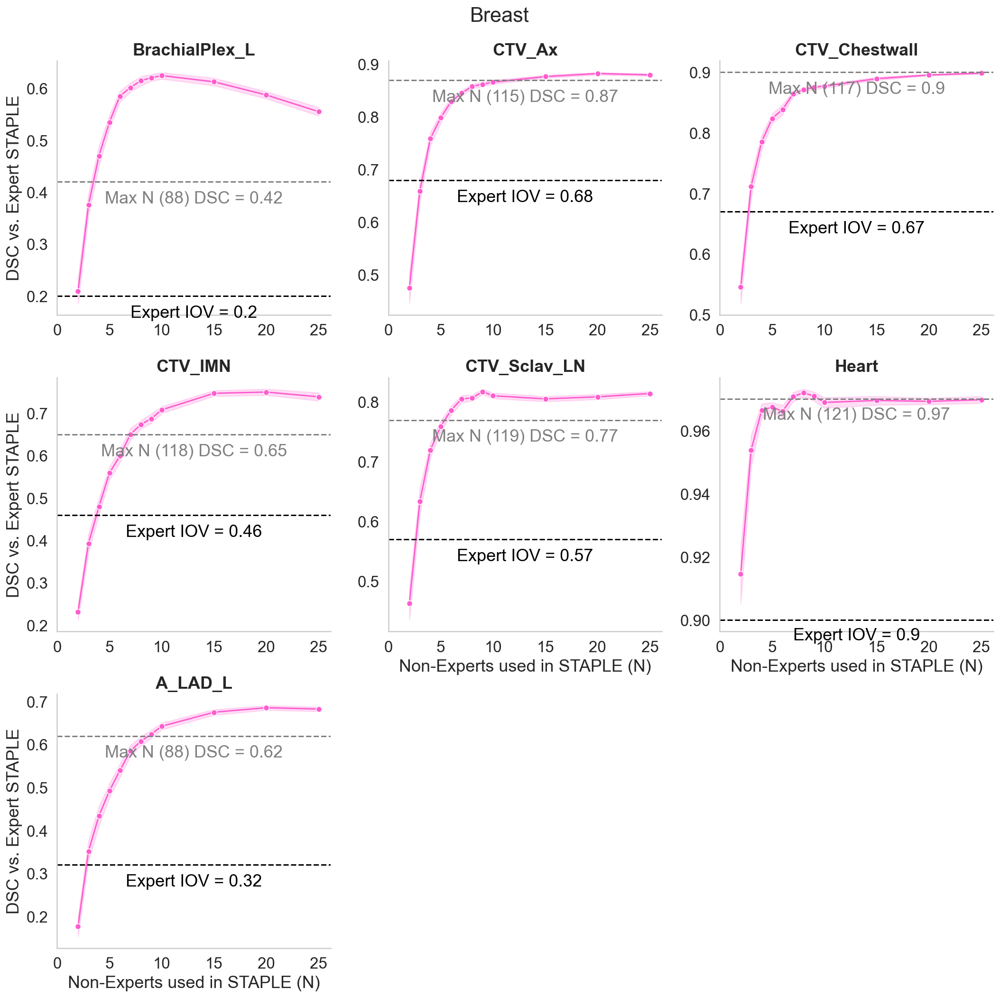

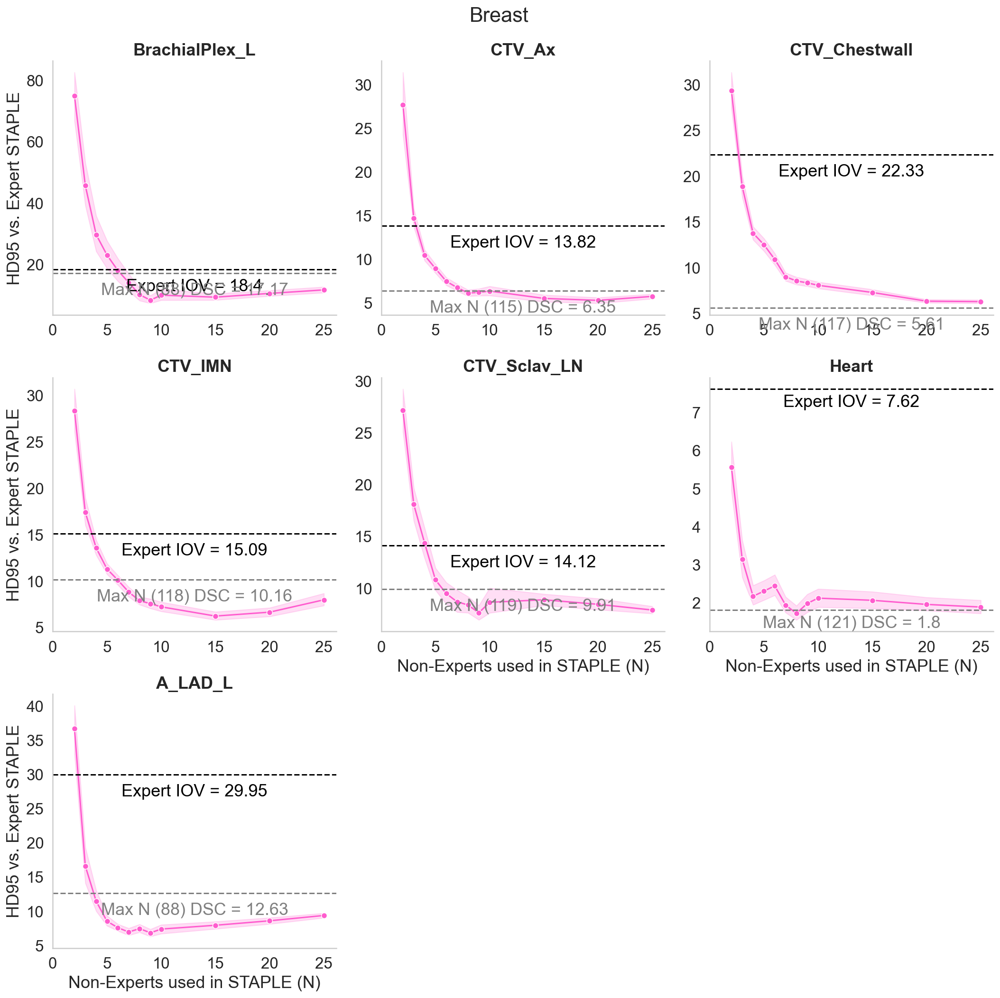

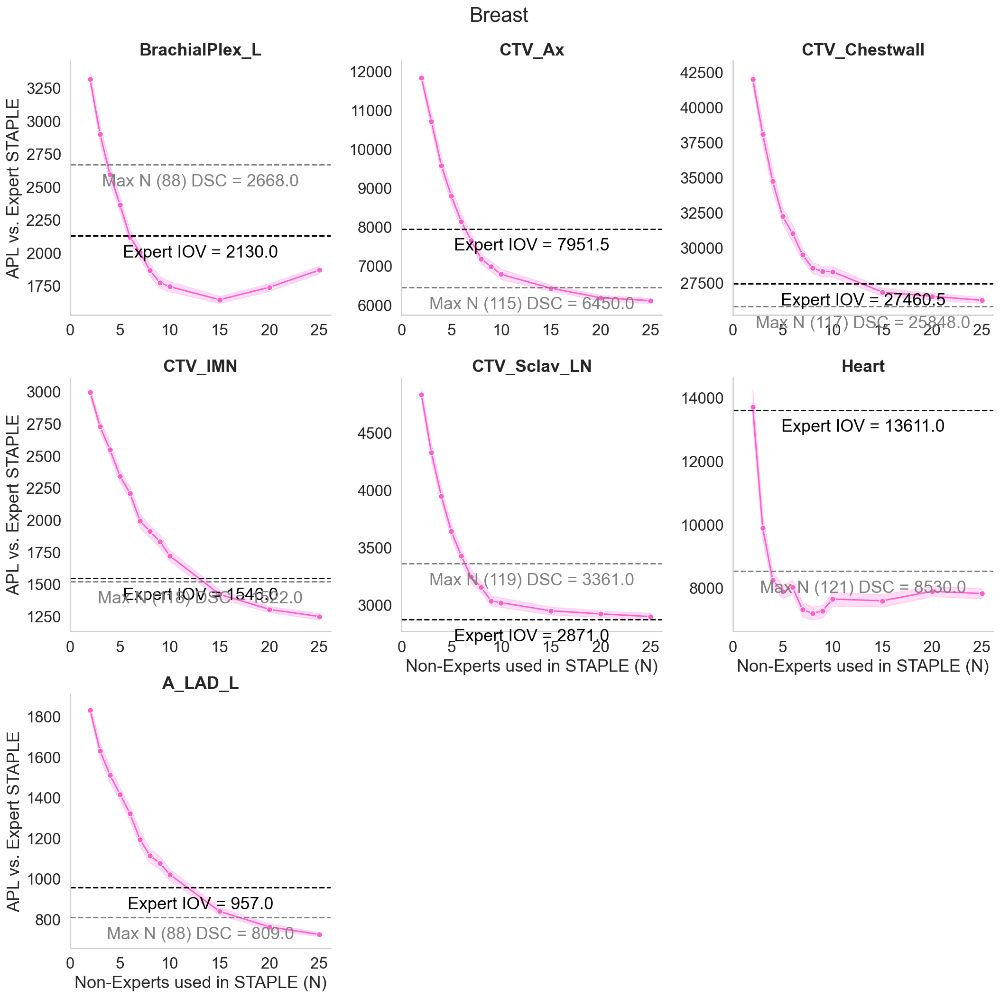

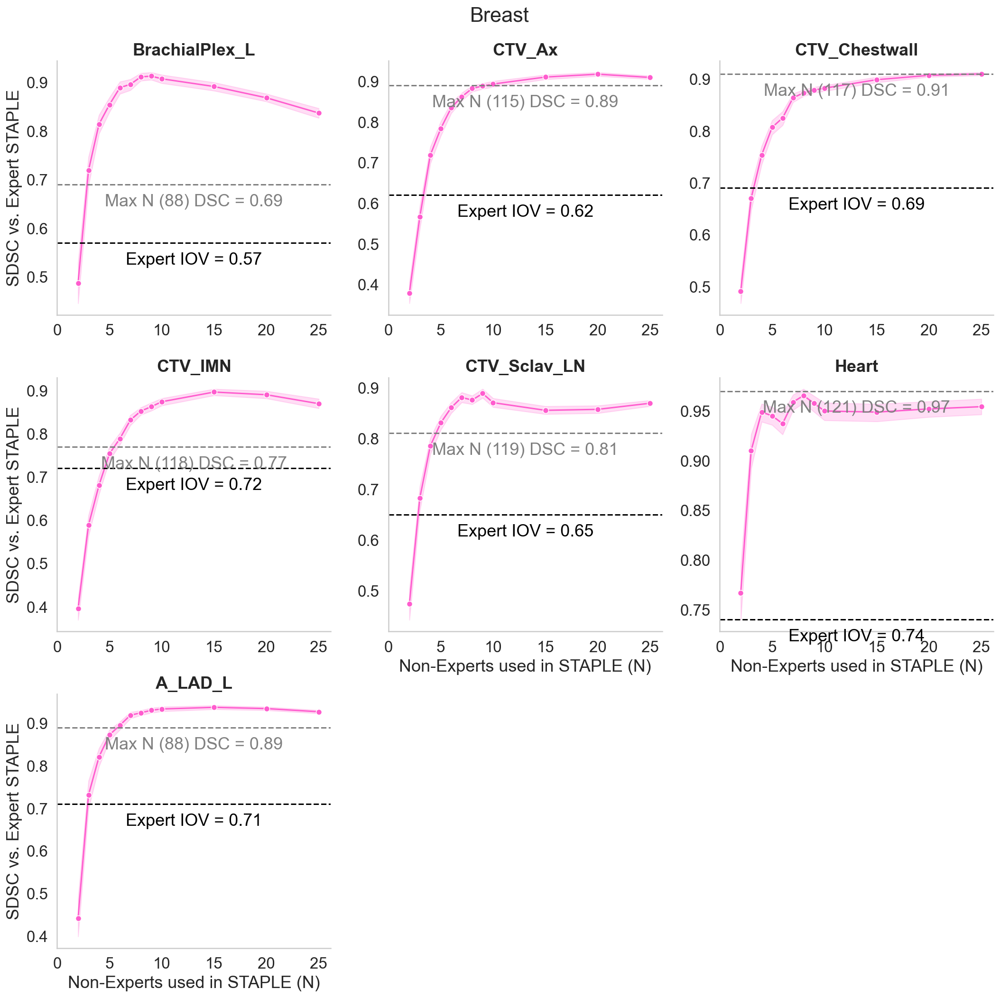

In [71]:
# TG-263 names 
ROI_dictionary = {ROI1: ROI2 for ROI1, ROI2 in zip(ROI_list, labels)}

metric_list = ["DSC_list", "HD95_list", "APL_list", "SDSC_list"]

for metric, line_dict, line_dict_maxSTAPLE in zip(metric_list, line_dict_list, line_dict_maxSTAPLE_list): # line dict defined before 
    print(metric)

    g = sns.relplot(
        data=df4_new, x="N", y=metric,
        col="ROI",
        kind="line",
        col_wrap = 3,
        facet_kws={'sharey': False, 'sharex': False},
        col_order = ROI_list, # only needed if in wrong order
        palette = breast_palette,
        **{'marker': 'o', "err_style": 'band',
          }
    )

    g.set_axis_labels("Non-Experts used in STAPLE (N)", metric.split('_')[0]+" vs. Expert STAPLE")
    
    g.fig.suptitle('Breast')

    # flatten axes into a 1-d array
    axes = g.axes.flatten()

    # iterate through the axes
    
    for ROI, ax in zip(ROI_list, axes):

        ax.set_title(ROI_dictionary[ROI], fontdict={'fontweight':'bold'}) # TG-263 names 

        ax.set_xticks([0, 5, 10, 15, 20, 25])

        ymin, ymax = ax.get_ylim()

        xmin, xmax = ax.get_xlim()

        x_middle = (xmax-xmin)/2

        y_nudge = (ymax-ymin)/15

        value = float("{:.2f}".format(line_dict[ROI]))
        ax.axhline(value, ls='--', c='black')    
        ax.text(x_middle, value-y_nudge, "Expert IOV = " + str(value), c='black', horizontalalignment='center', verticalalignment='center')

        novice_n = df3[(df3['Class'] == "Non-Expert") & (df3['ROI'] == ROI)]['N'].values[0]

        value_maxSTAPLE = float("{:.2f}".format(line_dict_maxSTAPLE[ROI]))
        ax.axhline(value_maxSTAPLE, ls='--', c='gray')
        ax.text(x_middle, value_maxSTAPLE-y_nudge, "Max N (" + str(novice_n) +") DSC = " + str(value_maxSTAPLE), c='gray', horizontalalignment='center', verticalalignment='center')
    


        g.tight_layout()
        
        #g.savefig('breast_'+ metric.split('list')[0] + 'bootstrap.pdf') # save high quality if needed  

Heatmap version here.

In [52]:
df4_reformated = df4_new.groupby(['ROI', 'N'], as_index=False).median()

In [53]:
df4_reformated 

,ROI,N,DSC_list,HD95_list,APL_list,SDSC_list
0,brachialplexus_l,2,0.197564,81.684630,3344.0,0.484815
1,brachialplexus_l,3,0.389448,42.392491,2903.0,0.731607
2,brachialplexus_l,4,0.469591,16.359834,2651.5,0.828107
3,brachialplexus_l,5,0.546453,11.649424,2359.0,0.861718
4,brachialplexus_l,6,0.589945,8.122907,2106.0,0.902007
...,...,...,...,...,...,...
79,lad,9,0.623144,5.869429,1092.5,0.932677
80,lad,10,0.648878,5.713586,1044.5,0.934559
81,lad,15,0.675678,7.606688,834.0,0.936139
82,lad,20,0.686123,8.628200,750.5,0.934441


In [54]:
for index, row in df4_reformated.iterrows():
    df4_reformated.loc[index, 'DSC_norm'] = row["DSC_list"]/ line_dict_list[0][row["ROI"]]
    df4_reformated.loc[index, 'SDSC_norm'] = row["SDSC_list"]/ line_dict_list[3][row["ROI"]]

In [55]:
df4_reformated

,ROI,N,DSC_list,HD95_list,APL_list,SDSC_list,DSC_norm,SDSC_norm
0,brachialplexus_l,2,0.197564,81.684630,3344.0,0.484815,1.005406,0.849893
1,brachialplexus_l,3,0.389448,42.392491,2903.0,0.731607,1.981901,1.282525
2,brachialplexus_l,4,0.469591,16.359834,2651.5,0.828107,2.389753,1.451692
3,brachialplexus_l,5,0.546453,11.649424,2359.0,0.861718,2.780903,1.510613
4,brachialplexus_l,6,0.589945,8.122907,2106.0,0.902007,3.002235,1.581240
...,...,...,...,...,...,...,...,...
79,lad,9,0.623144,5.869429,1092.5,0.932677,1.925980,1.306770
80,lad,10,0.648878,5.713586,1044.5,0.934559,2.005519,1.309407
81,lad,15,0.675678,7.606688,834.0,0.936139,2.088350,1.311620
82,lad,20,0.686123,8.628200,750.5,0.934441,2.120632,1.309242


In [56]:
# https://stackoverflow.com/questions/37790429/seaborn-heatmap-using-pandas-dataframe

# pivot the dataframe from long to wide form
result_DSC = df4_reformated.pivot(index='ROI', columns='N', values='DSC_norm')
result_SDSC = df4_reformated.pivot(index='ROI', columns='N', values='SDSC_norm')

In [57]:
result_DSC

N,2,3,4,5,6,7,8,9,10,15,20,25
ROI,,,,,,,,,,,,
brachialplexus_l,1.005406,1.981901,2.389753,2.780903,3.002235,3.109246,3.165660,3.184215,3.206229,3.150065,3.016086,2.851348
ctv_axilla,0.724066,0.989558,1.131052,1.182188,1.217195,1.244626,1.266617,1.269754,1.272185,1.289291,1.294625,1.291936
ctv_chestwall,0.835784,1.088374,1.209711,1.244868,1.279583,1.305508,1.316214,1.321252,1.323668,1.341019,1.346067,1.351159
ctv_imn,0.484081,0.825870,1.008863,1.242623,1.306880,1.426049,1.465762,1.496198,1.545730,1.617188,1.632516,1.612005
ctv_scv,0.833600,1.153119,1.292717,1.347540,1.401612,1.429545,1.425686,1.444525,1.433000,1.418267,1.415751,1.436126
heart,1.036397,1.067359,1.072803,1.074548,1.073382,1.077464,1.078047,1.077584,1.076005,1.075536,1.074957,1.075896
lad,0.516117,1.057360,1.412261,1.545606,1.657191,1.847543,1.875593,1.925980,2.005519,2.088350,2.120632,2.108834


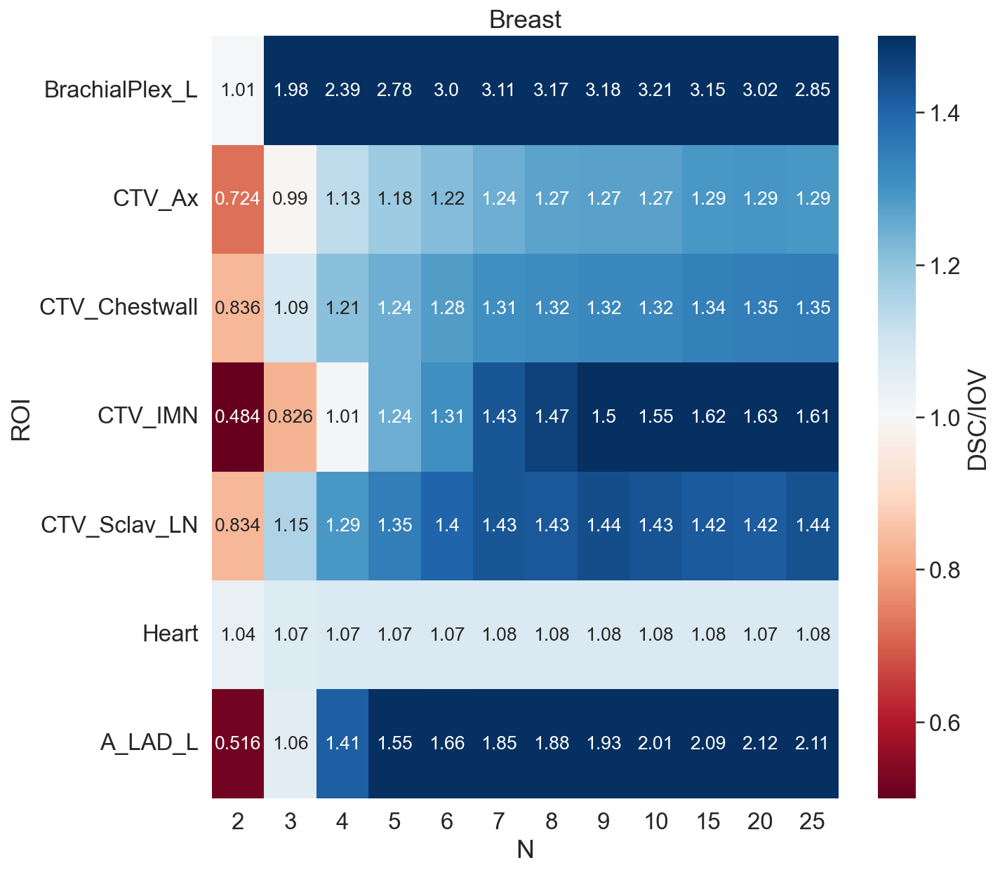

In [59]:
fig, ax = plt.subplots(figsize=(10,10))
ax = sns.heatmap(result_DSC, annot=True, fmt=".3", center=1, cmap="RdBu", 
                 vmin=0.5, vmax=1.5, 
                 cbar_kws={'label': 'DSC/IOV'},
                 annot_kws={"size": 35 / np.sqrt(len(result_DSC))})
plt.title('Breast')

# TG-263 names 
labels = ['BrachialPlex_L','CTV_Ax','CTV_Chestwall','CTV_IMN','CTV_Sclav_LN','Heart', 'A_LAD_L']
ax.set_yticklabels(labels)  

plt.show()

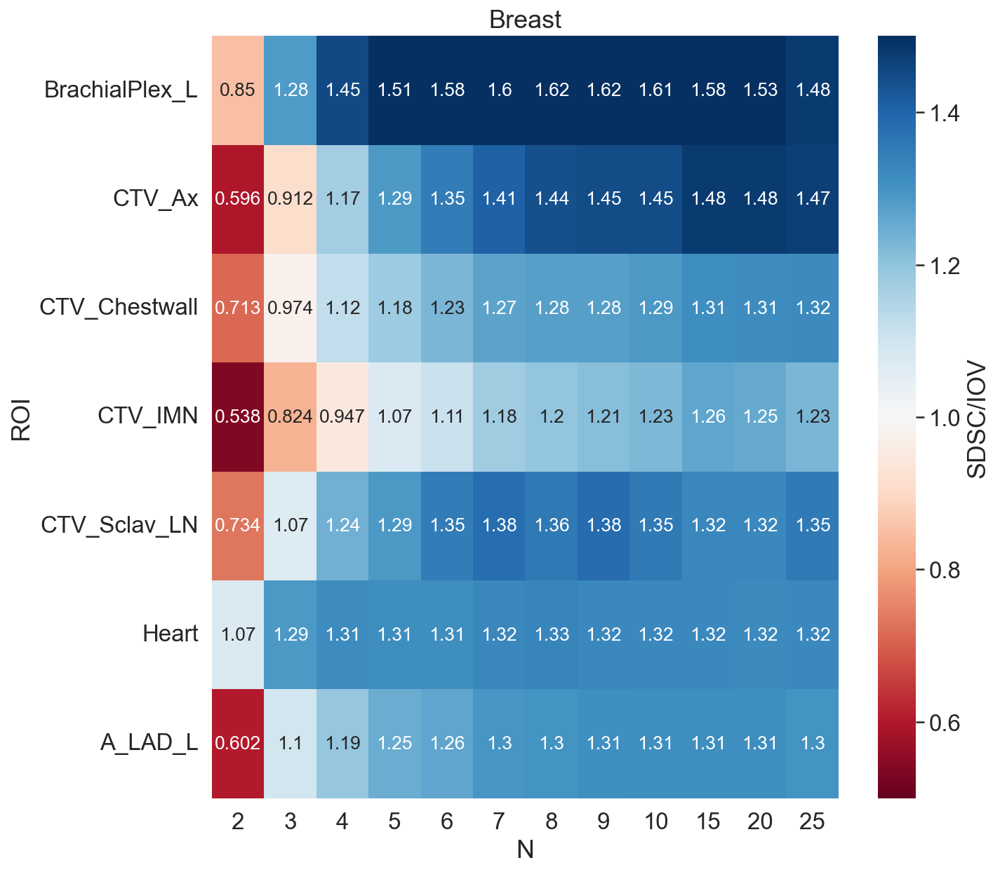

In [60]:
fig, ax = plt.subplots(figsize=(10,10))
ax = sns.heatmap(result_SDSC, annot=True, fmt=".3", center=1, cmap="RdBu", 
                 vmin=0.5, vmax=1.5, 
                 cbar_kws={'label': 'SDSC/IOV'},
                 annot_kws={"size": 35 / np.sqrt(len(result_SDSC))})
plt.title('Breast')

# TG-263 names 
labels = ['BrachialPlex_L','CTV_Ax','CTV_Chestwall','CTV_IMN','CTV_Sclav_LN','Heart', 'A_LAD_L']
ax.set_yticklabels(labels)  

plt.show()

## Part 2: Sarcoma

### Image Processing

In [124]:
# first make folders based on structure files and populate with copies of CT image 

In [72]:
base_path = "Case 02 (Left Thigh Sarcoma)"

In [88]:
in_path = os.path.join(base_path, 'Structure Sets')
out_path = os.path.join(base_path, 'Combined_structure_CT_DICOM')

if not os.path.isdir(out_path): # make directory if it does not exist 
    os.mkdir(out_path)

In [89]:
structure_files = os.listdir(in_path)
for structure_file in structure_files:
    print(structure_file)
    
    structure_file_path = os.path.join(in_path, structure_file)
    
    output_folder = os.path.join(out_path, structure_file.split('.')[0])
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
        
    structure_file_path_out = os.path.join(output_folder, structure_file)
        
    shutil.copy(structure_file_path, structure_file_path_out)
    
    CT_path = os.path.join(base_path, "CT Images")
    
    CT_files = os.listdir(CT_path)
    
    for CT_file in CT_files:
        CT_file_path = os.path.join(CT_path, CT_file)
        CT_file_path_out = os.path.join(output_folder, CT_file)
        
        shutil.copy(CT_file_path, CT_file_path_out)

structure_set_002_.dcm
structure_set_011_.dcm
structure_set_021_.dcm
structure_set_027_.dcm
structure_set_031_.dcm
structure_set_033_.dcm
structure_set_034_.dcm
structure_set_048_.dcm
structure_set_059_.dcm
structure_set_099_.dcm
structure_set_1069_.dcm
structure_set_107_.dcm
structure_set_120_.dcm
structure_set_128_.dcm
structure_set_129_.dcm
structure_set_140_.dcm
structure_set_146_.dcm
structure_set_170_.dcm
structure_set_182_.dcm
structure_set_186_.dcm
structure_set_217_.dcm
structure_set_235_.dcm
structure_set_241_.dcm
structure_set_245_.dcm
structure_set_247_.dcm
structure_set_250_.dcm
structure_set_297_.dcm
structure_set_298_.dcm
structure_set_304_.dcm
structure_set_310_.dcm
structure_set_362_.dcm
structure_set_371_.dcm
structure_set_384_.dcm
structure_set_386_.dcm
structure_set_393_.dcm
structure_set_395_.dcm
structure_set_397_.dcm
structure_set_398_.dcm
structure_set_418_.dcm
structure_set_421_.dcm
structure_set_443_.dcm
structure_set_451_.dcm
structure_set_472_.dcm
structure_

In [90]:
# convert structures to nifti 

In [91]:
input_path = os.path.join(base_path, "Combined_structure_CT_DICOM")
output_path = os.path.join(base_path, "structures_nifti")

if not os.path.isdir(output_path): # make directory if it does not exist 
    os.mkdir(output_path)

In [92]:
%%time
for folder in os.listdir(input_path):
    print(folder)
    folder_path = os.path.join(input_path, folder)
    print(folder_path)
    Dicom_reader = DicomReaderWriter(description='Examples', series_instances_dictionary = {}) # instantiate
    Dicom_reader.walk_through_folders(folder_path)
    all_rois = Dicom_reader.return_rois(print_rois=False)
    print(all_rois)
    
    output_path_folder = os.path.join(output_path, folder)
    if not os.path.isdir(output_path_folder): 
        os.mkdir(output_path_folder)
        
    for roi in all_rois:
        print(roi)
        Contour_Names = [roi] 
        Dicom_reader.set_contour_names_and_associations(Contour_Names=Contour_Names)
        try:
            Dicom_reader.get_images_and_mask()
            mask = Dicom_reader.mask # mask array
            mask_sitk_handle = Dicom_reader.annotation_handle # SimpleITK mask handle
            sitk.WriteImage(mask_sitk_handle, os.path.join(output_path_folder, roi+'.nii.gz'))
        except: 
            print("PROBLEM WITH", folder, roi)

Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

structure_set_002_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_002_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_002_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.62s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_002_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_002_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.25s/it]


ctv
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_002_ skinstrip
structure_set_011_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_011_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_011_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.48s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_011_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_011_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.81s/it]


ctv
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_011_ skinstrip
structure_set_021_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_021_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_021_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.37s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_021_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_021_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.93s/it]


ctv
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_021_ skinstrip
structure_set_027_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_027_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_027_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.38s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_027_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_027_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.83s/it]


ctv
PROBLEM WITH structure_set_027_ ctv
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_027_ skinstrip
structure_set_031_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_031_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_031_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.54s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_031_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_031_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.30s/it]


ctv
femur_l
gtv
genitalia
skinstrip
PROBLEM WITH structure_set_031_ skinstrip
structure_set_033_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_033_


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_033_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.32s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_033_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_033_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.96s/it]


ctv
femur_l
gtv


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

structure_set_034_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_034_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_034_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.31s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_034_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_034_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.63s/it]


ctv
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_034_ skinstrip
structure_set_048_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_048_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_048_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.41s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_048_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_048_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.97s/it]


ctv
femur_l
gtv
genitalia
skinstrip


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

structure_set_059_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_059_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_059_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.38s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_059_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_059_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.08s/it]


ctv
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_059_ skinstrip
structure_set_099_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_099_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_099_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.40s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_099_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_099_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.98s/it]


ctv
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_099_ skinstrip
structure_set_1069_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_1069_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_1069_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.36s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_1069_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_1069_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.97s/it]


ctv
femur_l
gtv
genitalia
skinstrip


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

structure_set_107_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_107_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_107_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.37s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_107_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'ctv_1.5+3cm', 'ctv_1.5cm', 'ctv_3cm', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_107_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.99s/it]


ctv
ctv_1.5+3cm
ctv_1.5cm
ctv_3cm
femur_l
gtv
genitalia
skinstrip
PROBLEM WITH structure_set_107_ skinstrip
structure_set_120_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_120_


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_120_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.47s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_120_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_120_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.22s/it]


ctv
femur_l
gtv
genitalia
skinstrip


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

structure_set_128_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_128_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_128_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.29s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_128_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_128_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.87s/it]


ctv
femur_l
gtv
genitalia
skinstrip


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

structure_set_129_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_129_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_129_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.34s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_129_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_129_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.81s/it]


ctv
femur_l
gtv
genitalia
PROBLEM WITH structure_set_129_ genitalia
skinstrip


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

PROBLEM WITH structure_set_129_ skinstrip
structure_set_140_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_140_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_140_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.25s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_140_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_140_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.77s/it]


ctv
femur_l
gtv
genitalia
skinstrip


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

PROBLEM WITH structure_set_140_ skinstrip
structure_set_146_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_146_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_146_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.42s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_146_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_146_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.00s/it]


ctv
femur_l
gtv
genitalia
skinstrip


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

structure_set_170_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_170_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_170_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.53s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_170_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'ctv15mm', 'ctv3cm', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_170_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.41s/it]


ctv
PROBLEM WITH structure_set_170_ ctv
ctv15mm
ctv3cm
femur_l
gtv
genitalia
PROBLEM WITH structure_set_170_ genitalia
skinstrip


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

PROBLEM WITH structure_set_170_ skinstrip
structure_set_182_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_182_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_182_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.26s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_182_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip', 'skin strip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_182_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.86s/it]


ctv
femur_l
gtv
genitalia
skinstrip
PROBLEM WITH structure_set_182_ skinstrip
skin strip


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

structure_set_186_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_186_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_186_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.50s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_186_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_186_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.23s/it]


ctv
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_186_ skinstrip
structure_set_217_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_217_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_217_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.31s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_217_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_217_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.69s/it]


ctv
PROBLEM WITH structure_set_217_ ctv
femur_l
gtv
genitalia
PROBLEM WITH structure_set_217_ genitalia
skinstrip


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

PROBLEM WITH structure_set_217_ skinstrip
structure_set_235_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_235_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_235_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.25s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_235_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_235_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.90s/it]


ctv
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_235_ skinstrip
structure_set_241_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_241_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_241_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.31s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_241_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_241_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.88s/it]


ctv
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_241_ skinstrip
structure_set_245_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_245_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_245_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.24s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_245_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_245_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.66s/it]


ctv
femur_l
gtv
genitalia
skinstrip
PROBLEM WITH structure_set_245_ skinstrip
structure_set_247_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_247_


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_247_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.31s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_247_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'ctvlong', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_247_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.85s/it]


ctv
ctvlong
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_247_ skinstrip
structure_set_250_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_250_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_250_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.29s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_250_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_250_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.94s/it]


ctv
femur_l
gtv
genitalia
skinstrip


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

structure_set_297_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_297_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_297_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.24s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_297_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'clinical target volume', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_297_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.80s/it]


clinical target volume
femur_l
gtv
genitalia
skinstrip
PROBLEM WITH structure_set_297_ skinstrip
structure_set_298_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_298_


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_298_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.45s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_298_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_298_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.23s/it]


ctv
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_298_ skinstrip
structure_set_304_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_304_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_304_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.41s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_304_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_304_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.86s/it]


ctv
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_304_ skinstrip
structure_set_310_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_310_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_310_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.38s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_310_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_310_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.81s/it]


ctv
femur_l
gtv
genitalia
skinstrip


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

structure_set_362_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_362_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_362_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.22s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_362_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', "ctv'", 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_362_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.68s/it]


ctv'
femur_l
gtv
genitalia
skinstrip
PROBLEM WITH structure_set_362_ skinstrip
structure_set_371_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_371_


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_371_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.23s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_371_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'ptv', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_371_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.81s/it]


ctv
femur_l
gtv
genitalia
ptv
skinstrip
PROBLEM WITH structure_set_371_ skinstrip
structure_set_384_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_384_


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_384_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.25s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_384_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_384_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.96s/it]


ctv
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_384_ skinstrip
structure_set_386_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_386_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_386_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.21s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_386_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_386_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.62s/it]


ctv
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_386_ skinstrip
structure_set_393_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_393_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_393_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.23s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_393_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_393_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.74s/it]


ctv
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_393_ skinstrip
structure_set_395_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_395_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_395_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.42s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_395_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_395_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.07s/it]


ctv
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

structure_set_397_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_397_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_397_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.32s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_397_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_397_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.95s/it]


ctv
femur_l
gtv
genitalia
skinstrip


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

structure_set_398_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_398_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_398_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.30s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_398_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_398_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.75s/it]


ctv
femur_l
gtv
genitalia
PROBLEM WITH structure_set_398_ genitalia
skinstrip


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

PROBLEM WITH structure_set_398_ skinstrip
structure_set_418_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_418_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_418_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.32s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_418_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_418_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.85s/it]


ctv
femur_l
gtv
genitalia
skinstrip


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

structure_set_421_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_421_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_421_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.33s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_421_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_421_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.98s/it]


ctv
femur_l
gtv
genitalia
PROBLEM WITH structure_set_421_ genitalia
skinstrip


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

PROBLEM WITH structure_set_421_ skinstrip
structure_set_443_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_443_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_443_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.19s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_443_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_443_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.75s/it]


ctv
femur_l
gtv
genitalia
skinstrip
PROBLEM WITH structure_set_443_ skinstrip
structure_set_451_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_451_


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_451_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.32s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_451_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_451_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  3.00s/it]


ctv
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_451_ skinstrip
structure_set_472_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_472_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_472_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.21s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_472_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_472_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.80s/it]


ctv
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_472_ skinstrip
structure_set_488_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_488_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_488_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.28s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_488_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv 50 gy', 'ctv 70 gy', 'femur_l', 'gtv', 'genitalia left', 'genitalia right']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_488_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.90s/it]


ctv 50 gy
ctv 70 gy
femur_l
gtv
genitalia left
genitalia right


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

structure_set_502_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_502_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_502_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.34s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_502_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_502_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.76s/it]


ctv
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_502_ skinstrip
structure_set_519_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_519_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_519_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.22s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_519_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_519_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.55s/it]


ctv
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_519_ skinstrip
structure_set_572_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_572_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_572_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.32s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_572_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv with margins', 'femur_l', 'gtv', 'genitalia', 'ptv', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_572_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.79s/it]


ctv with margins
femur_l
gtv
genitalia
ptv


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_572_ skinstrip
structure_set_603_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_603_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_603_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.35s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_603_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_603_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.95s/it]


ctv
femur_l
gtv
genitalia
skinstrip
PROBLEM WITH structure_set_603_ skinstrip
structure_set_630_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_630_


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_630_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.22s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_630_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_630_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.57s/it]


ctv
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_630_ skinstrip
structure_set_631_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_631_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_631_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.21s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_631_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv1', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_631_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.71s/it]


ctv1
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_631_ skinstrip
structure_set_641_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_641_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_641_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.34s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_641_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'ptv', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_641_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.80s/it]


ctv
femur_l
gtv
genitalia
PROBLEM WITH structure_set_641_ genitalia
ptv


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_641_ skinstrip
structure_set_688_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_688_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_688_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.37s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_688_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_688_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.87s/it]


ctv
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_688_ skinstrip
structure_set_702_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_702_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_702_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.23s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_702_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'ctv15mm', 'ctv40mm', 'ctv_final', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_702_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.64s/it]


ctv
PROBLEM WITH structure_set_702_ ctv
ctv15mm
ctv40mm
ctv_final
femur_l
gtv
genitalia
skinstrip


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

structure_set_710_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_710_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_710_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.35s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_710_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'gtv_mri', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_710_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.83s/it]


ctv
PROBLEM WITH structure_set_710_ ctv
femur_l
gtv
gtv_mri
genitalia
PROBLEM WITH structure_set_710_ genitalia
skinstrip


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

PROBLEM WITH structure_set_710_ skinstrip
structure_set_767_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_767_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_767_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.30s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_767_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_767_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.69s/it]


ctv
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_767_ skinstrip
structure_set_799_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_799_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_799_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.30s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_799_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_799_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.82s/it]


ctv
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_799_ skinstrip
structure_set_804_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_804_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_804_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.29s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_804_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_804_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.72s/it]


ctv
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_804_ skinstrip
structure_set_838_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_838_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_838_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.32s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_838_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_838_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.77s/it]


ctv
femur_l
gtv
genitalia
skinstrip


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

structure_set_839_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_839_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_839_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.20s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_839_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_839_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.78s/it]


ctv
femur_l
gtv
genitalia
skinstrip


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

structure_set_845_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_845_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_845_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.30s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_845_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_845_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.92s/it]


ctv
femur_l
gtv
PROBLEM WITH structure_set_845_ gtv
genitalia
skinstrip
PROBLEM WITH structure_set_845_ skinstrip
structure_set_871_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_871_


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_871_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.30s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_871_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'ctv-40', 'ctv15', 'ctv50', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_871_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.94s/it]


ctv
PROBLEM WITH structure_set_871_ ctv
ctv-40
ctv15
ctv50
femur_l
gtv
genitalia


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

skinstrip
PROBLEM WITH structure_set_871_ skinstrip
structure_set_873_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_873_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_873_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.34s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_873_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'ctv_t', 'ctv_rad', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_873_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.88s/it]


ctv
PROBLEM WITH structure_set_873_ ctv
ctv_t
ctv_rad
femur_l
gtv
genitalia
skinstrip
PROBLEM WITH structure_set_873_ skinstrip
structure_set_883_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_883_


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_883_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.34s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_883_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'mri t1c', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_883_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.99s/it]


ctv
femur_l
gtv
genitalia
mri t1c
skinstrip


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

structure_set_885_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_885_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_885_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.36s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_885_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_885_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.02s/it]


ctv
femur_l
gtv
genitalia
skinstrip


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

structure_set_898_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_898_
Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_898_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.30s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_898_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'gtv+1.5', 'gtv+4', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_898_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.72s/it]


ctv
femur_l
gtv
gtv+1.5
gtv+4
genitalia
PROBLEM WITH structure_set_898_ genitalia
skinstrip
PROBLEM WITH structure_set_898_ skinstrip
structure_set_908_
Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_908_


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_908_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.35s/it]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_908_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['body', 'ctv', 'femur_l', 'gtv', 'genitalia', 'skinstrip']
body
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_908_



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.10s/it]


ctv
PROBLEM WITH structure_set_908_ ctv
femur_l
gtv
genitalia
PROBLEM WITH structure_set_908_ genitalia
skinstrip
PROBLEM WITH structure_set_908_ skinstrip
Wall time: 13min 22s


In [93]:
# convert CT to nifti

In [94]:
input_path = os.path.join(base_path, "Combined_structure_CT_DICOM")
output_path = os.path.join(base_path, "CT_nifti")

if not os.path.isdir(output_path): # make directory if it does not exist 
    os.mkdir(output_path)

In [95]:
Dicom_reader = DicomReaderWriter(description='Examples', series_instances_dictionary = {}) # instantiate
Dicom_reader.walk_through_folders(folder_path)
Dicom_reader.get_images()
dicom_sitk_handle = Dicom_reader.dicom_handle # SimpleITK image handle
sitk.WriteImage(dicom_sitk_handle, os.path.join(output_path, 'Image.nii.gz'))

Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

Loading from Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_908_


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.10it/s]

Compiling dictionaries together...
Index 0, description None at Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_908_
1 unique series IDs were found. Default is index 0, to change use set_index(index)
Loading images for None at 
 Case 02 (Left Thigh Sarcoma)\Combined_structure_CT_DICOM\structure_set_908_



In [96]:
# now make folders based on excel stratifications 

In [97]:
# make 2 folders in structures_nifti_stratified named "Novice", "Expert"

stratified_path = os.path.join(base_path, "structures_nifti_stratified")
if not os.path.isdir(stratified_path): # make directory if it does not exist 
    os.mkdir(stratified_path)

observer_list = ["Non-Expert", "Expert"]

for observer in observer_list:
    observer_path = os.path.join(stratified_path, observer)
    if not os.path.isdir(observer_path): # make directory if it does not exist 
        os.mkdir(observer_path)

In [98]:
in_path = os.path.join(base_path, "structures_nifti")
out_path = os.path.join(base_path, "structures_nifti_stratified")

In [99]:
excel_df = pd.read_excel("C3RO Case Contour Key for Fuller Lab.xlsx", sheet_name=1)

In [100]:
excel_df

,C3RO ID,Group,Group (specific),Notes
0,2,Non-expert,Generalist,NaN
1,11,Non-expert,Generalist,NaN
2,21,Non-expert,Generalist,NaN
3,27,Non-expert,Generalist,NaN
4,31,Non-expert,Generalist,NaN
...,...,...,...,...
61,883,Expert,Expert,NaN
62,885,Non-expert,Generalist,NaN
63,898,Expert,Expert,NaN
64,908,Non-expert,Generalist,NaN


In [101]:
nonexpert_list = excel_df[excel_df['Group'] == "Non-expert"]['C3RO ID'].tolist()
expert_list = excel_df[excel_df['Group'] == "Expert"]['C3RO ID'].tolist()
# note: no specialist category for sarcoma

In [102]:
print(len(nonexpert_list), len(expert_list))

61 5


In [103]:
IDs = os.listdir(in_path)
for ID in IDs:
    ID_path = os.path.join(in_path, ID)
    print(ID_path)
    ID_real = int(ID.split('_')[-2].lstrip('0'))
    print(ID_real)
    if ID_real in nonexpert_list:
        folder_name = "Non-Expert"
    elif ID_real in expert_list:
        folder_name = "Expert"
    ID_path_out = os.path.join(out_path, folder_name, ID)
    print(ID_path_out)
    shutil.copytree(ID_path, ID_path_out)

Case 02 (Left Thigh Sarcoma)\structures_nifti\structure_set_002_
2
Case 02 (Left Thigh Sarcoma)\structures_nifti_stratified\Non-Expert\structure_set_002_
Case 02 (Left Thigh Sarcoma)\structures_nifti\structure_set_011_
11
Case 02 (Left Thigh Sarcoma)\structures_nifti_stratified\Non-Expert\structure_set_011_
Case 02 (Left Thigh Sarcoma)\structures_nifti\structure_set_021_
21
Case 02 (Left Thigh Sarcoma)\structures_nifti_stratified\Non-Expert\structure_set_021_
Case 02 (Left Thigh Sarcoma)\structures_nifti\structure_set_027_
27
Case 02 (Left Thigh Sarcoma)\structures_nifti_stratified\Non-Expert\structure_set_027_
Case 02 (Left Thigh Sarcoma)\structures_nifti\structure_set_031_
31
Case 02 (Left Thigh Sarcoma)\structures_nifti_stratified\Non-Expert\structure_set_031_
Case 02 (Left Thigh Sarcoma)\structures_nifti\structure_set_033_
33
Case 02 (Left Thigh Sarcoma)\structures_nifti_stratified\Non-Expert\structure_set_033_
Case 02 (Left Thigh Sarcoma)\structures_nifti\structure_set_034_
34
Cas

Case 02 (Left Thigh Sarcoma)\structures_nifti\structure_set_710_
710
Case 02 (Left Thigh Sarcoma)\structures_nifti_stratified\Non-Expert\structure_set_710_
Case 02 (Left Thigh Sarcoma)\structures_nifti\structure_set_767_
767
Case 02 (Left Thigh Sarcoma)\structures_nifti_stratified\Non-Expert\structure_set_767_
Case 02 (Left Thigh Sarcoma)\structures_nifti\structure_set_799_
799
Case 02 (Left Thigh Sarcoma)\structures_nifti_stratified\Non-Expert\structure_set_799_
Case 02 (Left Thigh Sarcoma)\structures_nifti\structure_set_804_
804
Case 02 (Left Thigh Sarcoma)\structures_nifti_stratified\Non-Expert\structure_set_804_
Case 02 (Left Thigh Sarcoma)\structures_nifti\structure_set_838_
838
Case 02 (Left Thigh Sarcoma)\structures_nifti_stratified\Expert\structure_set_838_
Case 02 (Left Thigh Sarcoma)\structures_nifti\structure_set_839_
839
Case 02 (Left Thigh Sarcoma)\structures_nifti_stratified\Expert\structure_set_839_
Case 02 (Left Thigh Sarcoma)\structures_nifti\structure_set_845_
845
Cas

In [106]:
in_path = os.path.join(base_path, "structures_nifti_stratified")

out_path = os.path.join(base_path, "structures_nifti_stratified_STAPLE")
if not os.path.isdir(out_path): # make directory if it does not exist 
    os.mkdir(out_path)

observer_list = ["Non-Expert", "Expert"]
for observer in observer_list:
    observer_path = os.path.join(out_path, observer)
    if not os.path.isdir(observer_path): # make directory if it does not exist 
        os.mkdir(observer_path)

In [107]:
%%time 

ROI_list = ['gtv', 'genitalia', 'ctv'] 

classes = os.listdir(in_path)

for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        file_list = []
        print(class_)
        class_path = os.path.join(in_path, class_)
        
        output_folder = os.path.join(out_path, class_) # make subfolder if it does not exist 
        print(output_folder)
            
        IDs = os.listdir(class_path)
        for ID in IDs:
            #print(ID)
            ID_path = os.path.join(class_path, ID)
            structures = os.listdir(ID_path)
            for structure in structures:
                structure_path = os.path.join(ID_path, structure)
                if structure.split('.')[0] == ROI:
                    file_list.append(structure_path)
                    
        print(file_list)
        
        segmentations = [sitk.ReadImage(file_name, sitk.sitkUInt8) for file_name in file_list]
        
        foregroundValue = 1
        threshold = 0.95
        reference_segmentation_STAPLE_probabilities = sitk.STAPLE(segmentations, foregroundValue) 
        reference_segmentation_STAPLE = reference_segmentation_STAPLE_probabilities > threshold
        #print('test')
        
        output_file_path = os.path.join(output_folder, ROI+'STAPLE.nii.gz')
        print(output_file_path)
        
        sitk.WriteImage(reference_segmentation_STAPLE, output_file_path) # idk if this will work but worth a shot..           

gtv
Expert
Case 02 (Left Thigh Sarcoma)\structures_nifti_stratified_STAPLE\Expert
['Case 02 (Left Thigh Sarcoma)\\structures_nifti_stratified\\Expert\\structure_set_1069_\\gtv.nii.gz', 'Case 02 (Left Thigh Sarcoma)\\structures_nifti_stratified\\Expert\\structure_set_838_\\gtv.nii.gz', 'Case 02 (Left Thigh Sarcoma)\\structures_nifti_stratified\\Expert\\structure_set_839_\\gtv.nii.gz', 'Case 02 (Left Thigh Sarcoma)\\structures_nifti_stratified\\Expert\\structure_set_883_\\gtv.nii.gz', 'Case 02 (Left Thigh Sarcoma)\\structures_nifti_stratified\\Expert\\structure_set_898_\\gtv.nii.gz']
Case 02 (Left Thigh Sarcoma)\structures_nifti_stratified_STAPLE\Expert\gtvSTAPLE.nii.gz
Non-Expert
Case 02 (Left Thigh Sarcoma)\structures_nifti_stratified_STAPLE\Non-Expert
['Case 02 (Left Thigh Sarcoma)\\structures_nifti_stratified\\Non-Expert\\structure_set_002_\\gtv.nii.gz', 'Case 02 (Left Thigh Sarcoma)\\structures_nifti_stratified\\Non-Expert\\structure_set_011_\\gtv.nii.gz', 'Case 02 (Left Thigh Sarco

Case 02 (Left Thigh Sarcoma)\structures_nifti_stratified_STAPLE\Non-Expert\genitaliaSTAPLE.nii.gz
ctv
Expert
Case 02 (Left Thigh Sarcoma)\structures_nifti_stratified_STAPLE\Expert
['Case 02 (Left Thigh Sarcoma)\\structures_nifti_stratified\\Expert\\structure_set_1069_\\ctv.nii.gz', 'Case 02 (Left Thigh Sarcoma)\\structures_nifti_stratified\\Expert\\structure_set_838_\\ctv.nii.gz', 'Case 02 (Left Thigh Sarcoma)\\structures_nifti_stratified\\Expert\\structure_set_839_\\ctv.nii.gz', 'Case 02 (Left Thigh Sarcoma)\\structures_nifti_stratified\\Expert\\structure_set_883_\\ctv.nii.gz', 'Case 02 (Left Thigh Sarcoma)\\structures_nifti_stratified\\Expert\\structure_set_898_\\ctv.nii.gz']
Case 02 (Left Thigh Sarcoma)\structures_nifti_stratified_STAPLE\Expert\ctvSTAPLE.nii.gz
Non-Expert
Case 02 (Left Thigh Sarcoma)\structures_nifti_stratified_STAPLE\Non-Expert
['Case 02 (Left Thigh Sarcoma)\\structures_nifti_stratified\\Non-Expert\\structure_set_002_\\ctv.nii.gz', 'Case 02 (Left Thigh Sarcoma)\\st

In [108]:
# calculate interobserver DSC for each category, updating for all metrics except SDSC which requires median of pairwise 95% HD

In [109]:
in_path = os.path.join(base_path, "structures_nifti_stratified")

In [110]:
%%time 

ROI_list = ['gtv', 'genitalia', 'ctv']

classes = os.listdir(in_path) # for everything 

df = pd.DataFrame(columns=['ROI', 'Class', 'DSC_list', 'HD95_list', 'ASD_list', 'APL_list'])
counter = -1  

for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        file_list = []
        print(class_)
        class_path = os.path.join(in_path, class_)
        
        IDs = os.listdir(class_path)
        for ID in IDs:
            #print(ID)
            ID_path = os.path.join(class_path, ID)
            structures = os.listdir(ID_path)
            for structure in structures:
                structure_path = os.path.join(ID_path, structure)
                if structure.split('.')[0] == ROI:
                    file_list.append(structure_path)
        
        # trying extra metrics really quick
        
        DSC_list, HD95_list, ASD_list, APL_list = pairwise_main(file_list)
        print(DSC_list, len(DSC_list))
        print(HD95_list, len(HD95_list))
        print(ASD_list, len(ASD_list))
        print(APL_list, len(APL_list))
        
        counter +=1
        df.loc[counter] = [ROI, class_, DSC_list, HD95_list, ASD_list, APL_list]
        print(df)

gtv
Expert
[0.9261019170899557, 0.9521662910092662, 0.952659163158347, 0.9310430669653971, 0.9402196014640097, 0.9316603931409452, 0.9211611546858576, 0.9524215552523875, 0.9461285008237232, 0.9328813559322033] 10
[2.5390625, 1.26953125, 1.26953125, 3.80859375, 1.26953125, 1.7953883116064684, 5.0116959152831315, 1.26953125, 3.0, 4.13019950772754] 10
[0.4484747322524637, 0.19338141154732696, 0.18478487945062133, 0.48254647778837245, 0.36272173393675144, 0.4039552715863628, 0.6541383840483159, 0.1839062250741495, 0.33599071004567604, 0.47201133430156034] 10
[781, 477, 417, 711, 552, 593, 771, 440, 589, 722] 10
   ROI   Class                                           DSC_list  \
0  gtv  Expert  [0.9261019170899557, 0.9521662910092662, 0.952...   

                                           HD95_list  \
0  [2.5390625, 1.26953125, 1.26953125, 3.80859375...   

                                            ASD_list  \
0  [0.4484747322524637, 0.19338141154732696, 0.18...   

                   

[0.7051544632189793, 0.681562736409813, 0.698351055632609, 0.5541801329349351, 0.6596294853175587, 0.7667137082306791] 6
[18.788580912487195, 18.17692127173756, 21.038339040778066, 25.058479576415657, 16.76291488828115, 10.92092074917521] 6
[3.669194908628854, 3.1809474152106945, 3.193388744844033, 4.330984259022682, 2.90552254309066, 1.8524866911839015] 6
[2571, 6350, 5971, 6624, 6220, 4324] 6
         ROI       Class                                           DSC_list  \
0        gtv      Expert  [0.9261019170899557, 0.9521662910092662, 0.952...   
1        gtv  Non-Expert  [0.9339087754929339, 0.9040417926862799, 0.753...   
2  genitalia      Expert  [0.7051544632189793, 0.681562736409813, 0.6983...   

                                           HD95_list  \
0  [2.5390625, 1.26953125, 1.26953125, 3.80859375...   
1  [1.26953125, 1.26953125, 5.0116959152831315, 7...   
2  [18.788580912487195, 18.17692127173756, 21.038...   

                                            ASD_list  \
0  [

[0.7065805409769883, 0.8069453719780953, 0.8616812292859295, 0.6275134964458717, 0.6501966676978831, 0.7206149290661474, 0.7517510155546544, 0.8532989261185705, 0.5220280844677886, 0.5902521216243373] 10
[25.17978445916796, 10.846879754797648, 5.89808049416291, 45.76462025319281, 30.769133530976628, 30.184817113974727, 14.339754898764506, 8.186668761477787, 52.00143665383198, 50.94820346828245] 10
[5.261597577538802, 2.7342341115485027, 1.9571533034490292, 8.18619450631023, 6.400327199144142, 5.457625595328018, 4.124224324072763, 2.0347822268865023, 10.539792965018181, 9.486544701585661] 10
[11005, 5831, 6585, 15774, 6616, 7194, 17147, 5834, 16688, 16858] 10
         ROI       Class                                           DSC_list  \
0        gtv      Expert  [0.9261019170899557, 0.9521662910092662, 0.952...   
1        gtv  Non-Expert  [0.9339087754929339, 0.9040417926862799, 0.753...   
2  genitalia      Expert  [0.7051544632189793, 0.681562736409813, 0.6983...   
3  genitalia  Non

Loading through DICOM files: 100%|███████████████████████████████████████████████████| 1/1 [2:05:16<00:00, 7516.25s/it]


[0.45022704054612733, 0.3246348485248673, 0.2547166559822432, 0.1991727829943547, 0.3883091859970473, 0.22711665689640734, 0.45485331423646935, 0.1718119836946719, 0.3983853829371192, 0.3747410949446391, 0.38174146919733337, 0.47574581191200643, 0.285179933832962, 0.33707499169364874, 0.6263459964417172, 0.3730184075725253, 0.4452218410714488, 0.4135326670931598, 0.5252973637163685, 0.366558458156536, 0.44102995091411795, 0.4103183796136869, 0.7161448024701133, 0.20793317645063494, 0.1588068740128251, 0.5155500649740395, 0.6243035859848153, 0.3125119792733786, 0.31835818925696185, 0.3968468014316681, 0.8548156140856155, 0.5011525725184587, 0.4670275325049005, 0.34012136506429225, 0.3404022366757472, 0.6132670924499312, 0.38628722229975765, 0.505408295345827, 0.5022970724046598, 0.3954283338123513, 0.36163699086749124, 0.42939956583431366, 0.0, 0.32132570579100356, 0.39612398722221176, 0.35480211338368284, 0.4299501945139629, 0.21413589836129027, 0.16137305615375458, 0.144406094975973, 

In [111]:
df

,ROI,Class,DSC_list,HD95_list,ASD_list,APL_list
0,gtv,Expert,"[0.9261019170899557, 0.9521662910092662, 0.952...","[2.5390625, 1.26953125, 1.26953125, 3.80859375...","[0.4484747322524637, 0.19338141154732696, 0.18...","[781, 477, 417, 711, 552, 593, 771, 440, 589, ..."
1,gtv,Non-Expert,"[0.9339087754929339, 0.9040417926862799, 0.753...","[1.26953125, 1.26953125, 5.0116959152831315, 7...","[0.3077610936535794, 0.44079431557367615, 1.63...","[714, 801, 1080, 1205, 1107, 650, 623, 594, 68..."
2,genitalia,Expert,"[0.7051544632189793, 0.681562736409813, 0.6983...","[18.788580912487195, 18.17692127173756, 21.038...","[3.669194908628854, 3.1809474152106945, 3.1933...","[2571, 6350, 5971, 6624, 6220, 4324]"
3,genitalia,Non-Expert,"[0.7390595611285267, 0.1352230324192941, 0.640...","[7.402575647752823, 30.46875, 26.8224188680041...","[1.9135663462766357, 13.632219612828518, 4.011...","[5258, 6148, 7305, 4745, 10708, 2905, 3362, 14..."
4,ctv,Expert,"[0.7065805409769883, 0.8069453719780953, 0.861...","[25.17978445916796, 10.846879754797648, 5.8980...","[5.261597577538802, 2.7342341115485027, 1.9571...","[11005, 5831, 6585, 15774, 6616, 7194, 17147, ..."
5,ctv,Non-Expert,"[0.45022704054612733, 0.3246348485248673, 0.25...","[63.4765625, 69.10503155597672, 79.12024760023...","[16.956727548649052, 16.95612843819004, 21.479...","[24747, 6022, 4803, 4043, 6886, 4729, 7640, 41..."


In [112]:
# add in SDSC 

In [113]:
ROI_list = ['gtv', 'genitalia', 'ctv']

classes = os.listdir(in_path) # for everything 

counter = -1  

SDSC_master_list = []
for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        file_list = []
        print(class_)
        class_path = os.path.join(in_path, class_)
        
        IDs = os.listdir(class_path)
        for ID in IDs:
            #print(ID)
            ID_path = os.path.join(class_path, ID)
            structures = os.listdir(ID_path)
            for structure in structures:
                structure_path = os.path.join(ID_path, structure)
                if structure.split('.')[0] == ROI:
                    file_list.append(structure_path)
        
        # trying extra metrics really quick
        tolerance = np.median(df[(df["ROI"] == ROI) & (df["Class"] == "Expert")]["ASD_list"].values[0]) # get tolerance
        SDSC_list = pairwise_SDSC(file_list, tolerance)
        print(SDSC_list, len(SDSC_list))
        SDSC_master_list.append(SDSC_list)
        

gtv
Expert
[0.7492831400007083, 0.8587687508733797, 0.8605933981310552, 0.7686146893807446, 0.7971245215638535, 0.7600615577636552, 0.7325346737764341, 0.86342646797141, 0.8262941773235833, 0.7900929108868344] 10
Non-Expert
[0.7747605973546214, 0.6796411025990615, 0.2746870568910661, 0.061093389576605865, 0.1903451913050475, 0.7496389367101476, 0.7364480844642097, 0.7962348150315853, 0.7446133883317305, 0.8306488394246709, 0.8016583201756686, 0.7883089121153251, 0.6343766048887507, 0.6950823285376091, 0.7978062738138091, 0.8462551616368592, 0.3692385217040939, 0.35700964525145756, 0.8133607824229281, 0.8209603884476508, 0.2512774855288153, 0.7117467690358459, 0.7918359553322449, 0.8457956219655126, 0.5928025527822395, 0.7256030350721725, 0.7758929301359321, 0.7976360159785439, 0.7663310061381297, 0.7444220327547258, 0.7489745634602057, 0.6588373960491306, 0.2113945304158946, 0.270996103529657, 0.7286315215371785, 0.7883992062183885, 0.7368961374694747, 0.7340641967693231, 0.46194979862

[0.6828846910011697, 0.7170267115007944, 0.7505503425076216, 0.6049272191390581, 0.730903054689545, 0.8073422392772642] 6
Non-Expert
[0.8328158039067973, 0.14491129235496816, 0.6447873622887775, 0.6931456707415092, 0.47822952087633247, 0.5924714456185164, 0.8564986131196658, 0.2682964831831796, 0.4682818755017687, 0.7097646676007036, 0.7140439040739232, 0.5558801144491765, 0.8179810746553842, 0.6923621177161386, 0.8540601866413963, 0.6778641982244233, 0.566803089550667, 0.8679660825216444, 0.49013585014547795, 0.7694894320420828, 0.7720725119540783, 0.40911025259340017, 0.6579810390980277, 0.38203458346261954, 0.46598316518719657, 0.5471293964127931, 0.5351947315844049, 0.844421534981516, 0.7610927520829118, 0.5368887008653019, 0.8214636029226559, 0.6068357931588984, 0.6829763157182481, 0.6604623121206725, 0.6846311640020376, 0.6331299013586308, 0.28249039962995925, 0.13084466369224496, 0.5702489227485057, 0.5858949239823464, 0.869240787890329, 0.7913442518043393, 0.8735407895167041, 0

[0.7031499553801648, 0.831903667678693, 0.9428550590109221, 0.6031060548857031, 0.6071684602931848, 0.7175518472296286, 0.8132275450290956, 0.9000268993488009, 0.4408779371476491, 0.556474064949445] 10
Non-Expert
[0.34091589056582317, 0.149503566137151, 0.14061652163000843, 0.08053083346580625, 0.26872990248519096, 0.12039362578895323, 0.2726696484884117, 0.09405326341737216, 0.19752493356417666, 0.1605115898325917, 0.22376965178335412, 0.3754083622015819, 0.15002574038400984, 0.21375224971077691, 0.5618151763497495, 0.21771579888611853, 0.2790004516658493, 0.2617887135172221, 0.40050934958479634, 0.15740251220998377, 0.2804243719682894, 0.29256844512081936, 0.519421290070654, 0.1007113163684768, 0.04626042665258555, 0.37242927479956367, 0.5856598649937234, 0.17930553014101588, 0.12035024550629635, 0.2509228847980276, 0.8851693556275497, 0.3183110441627931, 0.28471297724237826, 0.1393730182146106, 0.24338152125327675, 0.38975426931504814, 0.25461091277976483, 0.35778607808832735, 0.242

In [114]:
print(len(SDSC_master_list))

6


In [115]:
df['SDSC_list'] = SDSC_master_list

In [73]:
pickle_path = os.path.join(base_path, 'df_full_sarcoma_final.pkl') # newest
#df.to_pickle(pickle_path) # save if needed 

In [74]:
df_pickle = pd.read_pickle(pickle_path)

In [75]:
df_pickle['Class'] = df_pickle['Class'].str.replace('Novice','Non-Expert')

In [76]:
df_pickle = df_pickle[df_pickle['ROI'] != "skinstrip"] # remove skinstrip

In [77]:
df_pickle

,ROI,Class,DSC_list,HD95_list,ASD_list,APL_list,SDSC_list
0,gtv,Expert,"[0.9261019170899557, 0.9521662910092662, 0.952...","[2.5390625, 1.26953125, 1.26953125, 3.80859375...","[0.4484747322524637, 0.19338141154732696, 0.18...","[781, 477, 417, 711, 552, 593, 771, 440, 589, ...","[0.7492831400007083, 0.8587687508733797, 0.860..."
1,gtv,Non-Expert,"[0.9339087754929339, 0.9040417926862799, 0.753...","[1.26953125, 1.26953125, 5.0116959152831315, 7...","[0.3077610936535794, 0.44079431557367615, 1.63...","[714, 801, 1080, 1205, 1107, 650, 623, 594, 68...","[0.7747605973546214, 0.6796411025990615, 0.274..."
2,genitalia,Expert,"[0.7051544632189793, 0.681562736409813, 0.6983...","[18.788580912487195, 18.17692127173756, 21.038...","[3.669194908628854, 3.1809474152106945, 3.1933...","[2571, 6350, 5971, 6624, 6220, 4324]","[0.6828846910011697, 0.7170267115007944, 0.750..."
3,genitalia,Non-Expert,"[0.7390595611285267, 0.1352230324192941, 0.640...","[7.402575647752823, 30.46875, 26.8224188680041...","[1.9135663462766357, 13.632219612828518, 4.011...","[5258, 6148, 7305, 4745, 10708, 2905, 3362, 14...","[0.8328158039067973, 0.14491129235496816, 0.64..."
4,ctv,Expert,"[0.7065805409769883, 0.8069453719780953, 0.861...","[25.17978445916796, 10.846879754797648, 5.8980...","[5.261597577538802, 2.7342341115485027, 1.9571...","[11005, 5831, 6585, 15774, 6616, 7194, 17147, ...","[0.7031499553801648, 0.831903667678693, 0.9428..."
5,ctv,Non-Expert,"[0.45022704054612733, 0.3246348485248673, 0.25...","[63.4765625, 69.10503155597672, 79.12024760023...","[16.956727548649052, 16.95612843819004, 21.479...","[24747, 6022, 4803, 4043, 6886, 4729, 7640, 41...","[0.34091589056582317, 0.149503566137151, 0.140..."


### Interobserver Variability Analysis¶

In [79]:
# FIRST NEED TO GENERATE EXPLODED DATAFRAME

df_pickle_explode = df_pickle.explode(['DSC_list', 'HD95_list', 'ASD_list', 'APL_list', 'SDSC_list'])

In [80]:
df_pickle_explode

,ROI,Class,DSC_list,HD95_list,ASD_list,APL_list,SDSC_list
0,gtv,Expert,0.926102,2.539062,0.448475,781,0.749283
0,gtv,Expert,0.952166,1.269531,0.193381,477,0.858769
0,gtv,Expert,0.952659,1.269531,0.184785,417,0.860593
0,gtv,Expert,0.931043,3.808594,0.482546,711,0.768615
0,gtv,Expert,0.94022,1.269531,0.362722,552,0.797125
...,...,...,...,...,...,...,...
5,ctv,Non-Expert,0.46376,38.194014,8.423249,7829,0.486975
5,ctv,Non-Expert,0.44114,24.825244,9.428168,7507,0.297614
5,ctv,Non-Expert,0.794026,10.722582,2.733275,6421,0.868187
5,ctv,Non-Expert,0.817797,7.181553,2.556432,6347,0.890279


In [81]:
df_pickle_explode['DSC_list']=df_pickle_explode['DSC_list'].astype('float64') # need this for violinplot for some reason
df_pickle_explode['HD95_list']=df_pickle_explode['HD95_list'].astype('float64')
df_pickle_explode['ASD_list']=df_pickle_explode['ASD_list'].astype('float64')
df_pickle_explode['APL_list']=df_pickle_explode['APL_list'].astype('float64')
df_pickle_explode['SDSC_list']=df_pickle_explode['SDSC_list'].astype('float64')

In [82]:
df_pickle_explode.groupby(['Class', 'ROI']).median() # tolerance values 

DSC_list  HD95_list  ASD_list  APL_list  SDSC_list
Class      ROI                                                          
Expert     ctv        0.713598  27.682301  5.359612    9099.5   0.710351
           genitalia  0.689957  18.482751  3.187168    6095.5   0.723965
           gtv        0.936550   2.167225  0.383339     591.0   0.793609
Non-Expert ctv        0.663314  14.283447  4.723592    7384.0   0.630426
           genitalia  0.578005  22.374835  4.264480    4221.0   0.606253
           gtv        0.912493   1.795388  0.462463     791.5   0.687692

In [84]:
sarcoma_palette_old = ['#FF524F', '#D00300']
sarcoma_palette = ['#ffb4b3', '#b30300'] # new

DSC_list
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

genitalia_Non-Expert vs. genitalia_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:6.012e-02 U_stat=2.125e+03
gtv_Non-Expert vs. gtv_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:3.973e-04 U_stat=3.109e+03
ctv_Non-Expert vs. ctv_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:1.550e-01 U_stat=4.168e+03
SDSC_list
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

genitalia_Non-Expert vs. genitalia_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:8.423e-02 U_stat=2.263e+03
gtv_Non-Expert vs. gtv_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:4.193e-04 U_stat=3.132e+03
ctv_Non-Expert vs. ctv_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:1.750e-01 

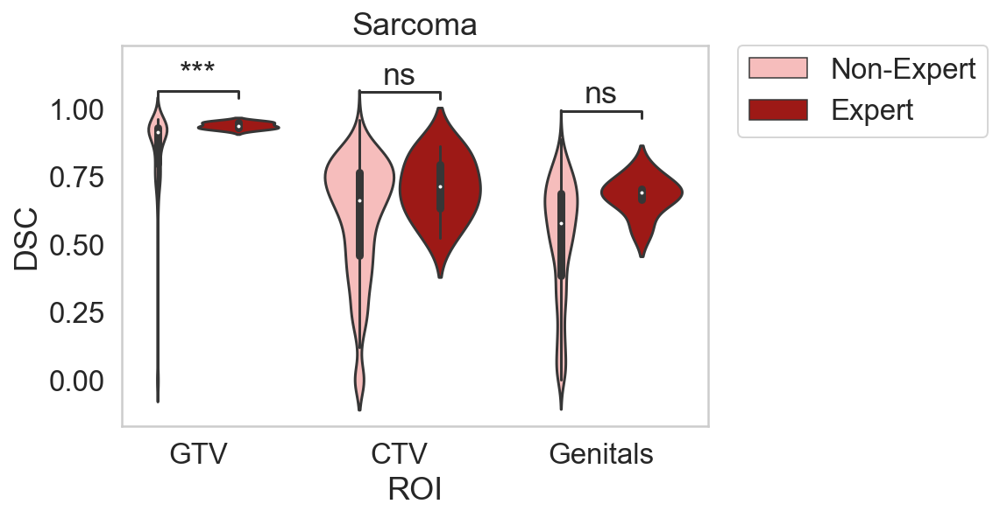

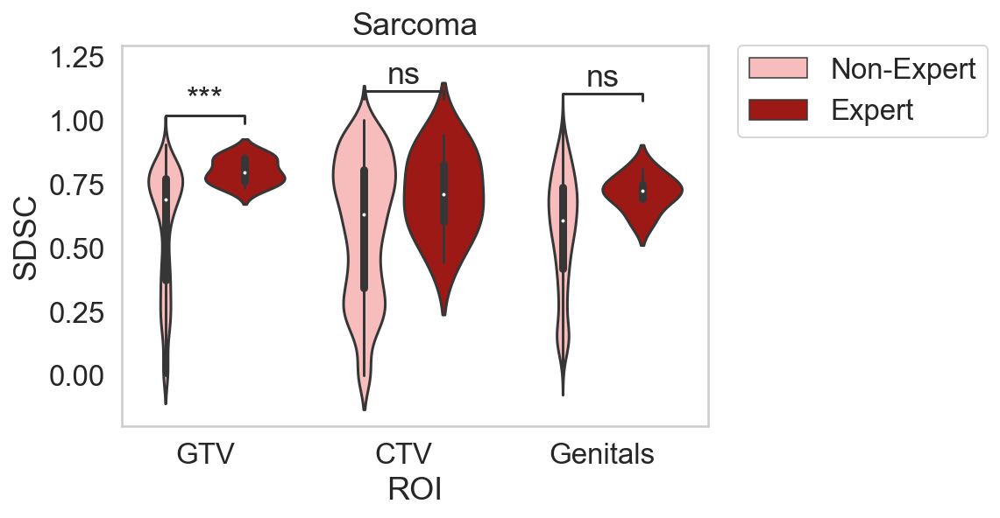

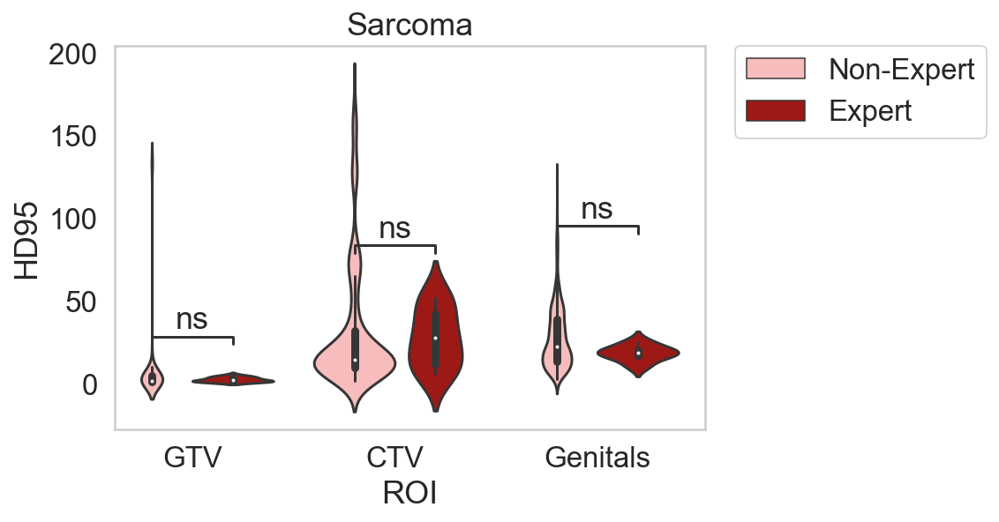

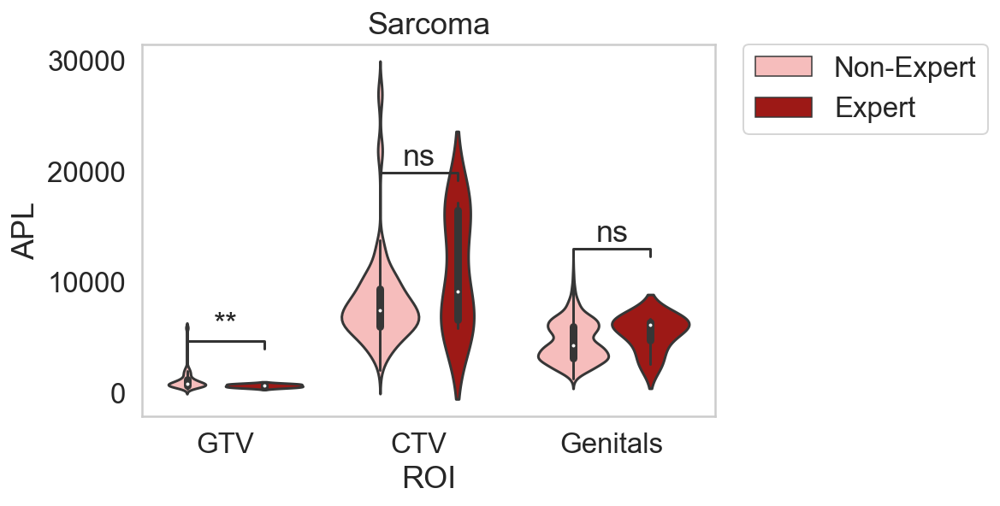

<Figure size 432x288 with 0 Axes>

In [85]:
x="ROI" 

y_list = ["DSC_list", "SDSC_list", "HD95_list", "APL_list"]

for y in y_list:
    print(y)

    hue="Class"
    hue_order = ['Non-Expert', 'Expert']

    ax = sns.violinplot(x=x, y=y, hue=hue, 
                        order = ['gtv', 'ctv', 'genitalia'], # added this
                     data=df_pickle_explode,
                       hue_order = hue_order,
                       palette=sarcoma_palette)

    ROI_list = ['gtv', 'ctv', 'genitalia']

    class_list = ["Non-Expert", "Expert"]

    pairs = [tuple((ROI, classes) for classes in class_list) for ROI in ROI_list]


    annot = Annotator(ax, pairs, data=df_pickle_explode, x=x, y=y, hue=hue, hue_order=hue_order)

    annot.new_plot(ax, pairs, data=df_pickle_explode, x=x, y=y, hue=hue, hue_order=hue_order)
    annot.configure(test='Mann-Whitney', verbose=2)
    annot.apply_test()
    annot.annotate()
    
     # TG-263 names 
    labels = ['GTV', 'CTV', 'Genitals']
    ax.set_xticklabels(labels)

    #plt.xticks(rotation=90)
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    plt.ylabel(y.split('_')[0])
    plt.title('Sarcoma')
    
    plt.figure()

Volume measurements here.

In [87]:
%%time 

in_path = os.path.join(base_path, "structures_nifti_stratified")

ROI_list = ['gtv', 'ctv', 'genitalia']

classes = ["Expert", "Non-Expert"] # for just getting Expert and Non-Expert 

df_vol = pd.DataFrame(columns=['ROI', 'Class', 'ID', 'Volume'])
counter = -1  

for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        print(class_)
        class_path = os.path.join(in_path, class_)
        
        IDs = os.listdir(class_path)
        for ID in IDs:
            #print(ID)
            ID_path = os.path.join(class_path, ID)
            structures = os.listdir(ID_path)
            for structure in structures:
                structure_path = os.path.join(ID_path, structure)
                if structure.split('.')[0] == ROI:
                    structure_volume = calculate_volume(structure_path)
                    
                    counter +=1
                    df_vol.loc[counter] = [ROI, class_, ID, structure_volume]
                    #print(df_vol)

gtv
Expert
Non-Expert
ctv
Expert
Non-Expert
genitalia
Expert
Non-Expert
Wall time: 1min 22s


In [88]:
df_vol

,ROI,Class,ID,Volume
0,gtv,Expert,structure_set_1069_,28.744841
1,gtv,Expert,structure_set_838_,30.272741
2,gtv,Expert,structure_set_839_,29.175167
3,gtv,Expert,structure_set_883_,27.531223
4,gtv,Expert,structure_set_898_,29.523296
...,...,...,...,...
168,genitalia,Non-Expert,structure_set_804_,35.286770
169,genitalia,Non-Expert,structure_set_845_,60.526142
170,genitalia,Non-Expert,structure_set_871_,54.448385
171,genitalia,Non-Expert,structure_set_873_,17.604704


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

ctv_Non-Expert vs. ctv_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:9.828e-02 U_stat=6.500e+01
gtv_Non-Expert vs. gtv_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:1.122e-02 U_stat=4.650e+01
genitalia_Non-Expert vs. genitalia_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:3.699e-01 U_stat=7.300e+01


<Figure size 432x288 with 0 Axes>

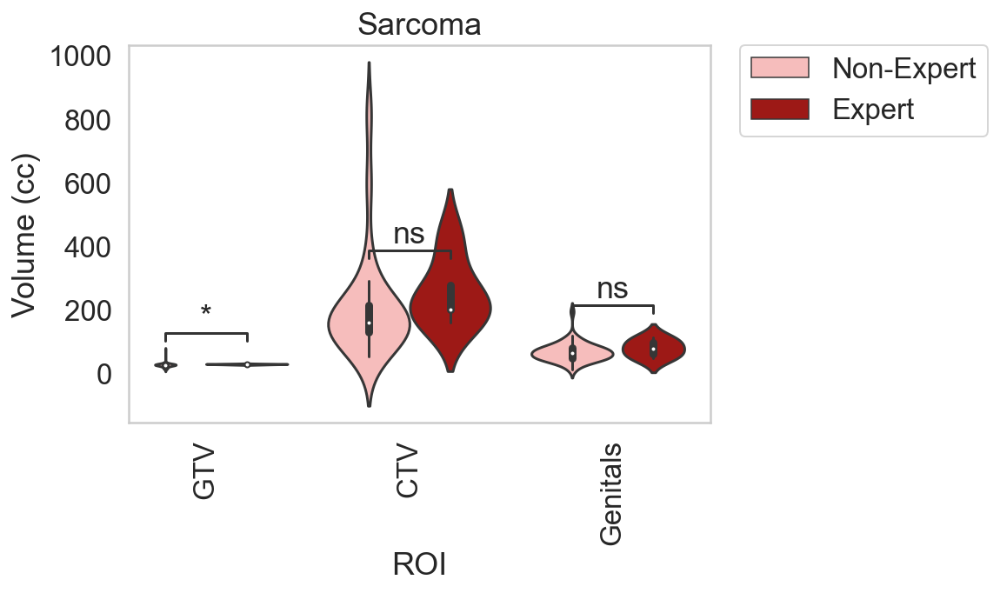

<Figure size 432x288 with 0 Axes>

In [89]:
x="ROI" 
y="Volume"
hue="Class"
hue_order = ['Non-Expert', 'Expert']
ROI_list = ['gtv', 'ctv', 'genitalia']

ax = sns.violinplot(x=x, y=y, hue=hue,
                 data=df_vol,
                   hue_order = hue_order,
                   palette=sarcoma_palette,
                   order = ROI_list) # Dont forget to set order in the calls below if you use it here 

class_list = ['Non-Expert', 'Expert']

pairs = [tuple((ROI, classes) for classes in class_list) for ROI in ROI_list]

# all combos, in theory reduces down to code above in 2-class example
combination_list = list(itertools.combinations(class_list, 2))
pairs = [tuple((ROI, classes) for classes in subclass_list) for subclass_list in combination_list for ROI in ROI_list]

annot = Annotator(ax, pairs, data=df_vol, x=x, y=y, hue=hue, hue_order=hue_order, order = ROI_list)

annot.new_plot(ax, pairs, data=df_vol, x=x, y=y, hue=hue, hue_order=hue_order, order = ROI_list)
annot.configure(test='Mann-Whitney', verbose=2)
annot.apply_test()
annot.annotate()

 # TG-263 names 
labels = ['GTV', 'CTV', 'Genitals']
ax.set_xticklabels(labels)

plt.xticks(rotation=90)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.ylabel('Volume (cc)')
plt.title('Sarcoma')

plt.figure()

### Direct comparisons of non-expert vs. expert STAPLE segmentations

In [90]:
df_pickle['DSC_median'] = df_pickle['DSC_list'].apply(lambda x: np.median(x))
df_pickle['HD95_median'] = df_pickle['HD95_list'].apply(lambda x: np.median(x))
df_pickle['APL_median'] = df_pickle['APL_list'].apply(lambda x: np.median(x))
df_pickle['SDSC_median'] = df_pickle['SDSC_list'].apply(lambda x: np.median(x))

In [91]:
df_pickle[df_pickle['Class'] == "Expert"] # just show expert answers which is what we care about

,ROI,Class,DSC_list,HD95_list,ASD_list,APL_list,SDSC_list,DSC_median,HD95_median,APL_median,SDSC_median
0,gtv,Expert,"[0.9261019170899557, 0.9521662910092662, 0.952...","[2.5390625, 1.26953125, 1.26953125, 3.80859375...","[0.4484747322524637, 0.19338141154732696, 0.18...","[781, 477, 417, 711, 552, 593, 771, 440, 589, ...","[0.7492831400007083, 0.8587687508733797, 0.860...",0.936550,2.167225,591.0,0.793609
2,genitalia,Expert,"[0.7051544632189793, 0.681562736409813, 0.6983...","[18.788580912487195, 18.17692127173756, 21.038...","[3.669194908628854, 3.1809474152106945, 3.1933...","[2571, 6350, 5971, 6624, 6220, 4324]","[0.6828846910011697, 0.7170267115007944, 0.750...",0.689957,18.482751,6095.5,0.723965
4,ctv,Expert,"[0.7065805409769883, 0.8069453719780953, 0.861...","[25.17978445916796, 10.846879754797648, 5.8980...","[5.261597577538802, 2.7342341115485027, 1.9571...","[11005, 5831, 6585, 15774, 6616, 7194, 17147, ...","[0.7031499553801648, 0.831903667678693, 0.9428...",0.713598,27.682301,9099.5,0.710351


In [93]:
in_path = os.path.join(base_path, "structures_nifti_stratified_STAPLE")

In [94]:
%%time 

ROI_list = ['gtv', 'ctv', 'genitalia']

classes = [class_ for class_ in os.listdir(in_path) if class_ != "Expert"]

df2 = pd.DataFrame(columns=['ROI', 'Class', 'DSC', 'HD95', 'APL', 'SDSC'])
counter = -1  

for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        file_list = []
        print(class_)
        class_path = os.path.join(in_path, class_)

        structures = os.listdir(class_path)
        for structure in structures:
            structure_path = os.path.join(class_path, structure)
            if structure.split('STAPLE.')[0] == ROI:

                file_1 = sitk.ReadImage(structure_path)
                file_2 = sitk.ReadImage(os.path.join(in_path, 'Expert', structure))

                mask_1 = sitk.GetArrayFromImage(file_1)
                mask_2 = sitk.GetArrayFromImage(file_2)

                DSC = compute_dice_coefficient(mask_1, mask_2)  
                
                # adding other metrics
                
                spacing_mm = file_1.GetSpacing() # need spacing to calcualte distances
                
                mask_1_bool = mask_1.astype(bool) # need to convert to bool format to work 
                mask_2_bool = mask_2.astype(bool)

                surface_distances = compute_surface_distances(mask_1_bool, mask_2_bool, spacing_mm) # need this for all calculations
                HD95 = compute_robust_hausdorff(surface_distances, 95)

                ASD_truth = compute_average_surface_distance(surface_distances)[0] #  A tuple with two float values: 1. the average distance (in mm) from the ground truth surface to thepredicted surface, 2. the average distance from the predicted surface to the ground truth surface.
                ASD_pred = compute_average_surface_distance(surface_distances)[1]
                ASD = (ASD_truth + ASD_pred)/2

                APL = AddedPathLength(mask_1, mask_2)
                
                tolerance = np.median(df_pickle[(df_pickle["ROI"] == ROI) & (df_pickle['Class'] == "Expert")]["ASD_list"].values[0]) # get tolerance
                SDSC = compute_surface_dice_at_tolerance(surface_distances, tolerance)
                     
        counter +=1
        df2.loc[counter] = [ROI, class_, DSC, HD95, APL, SDSC]
        #print(df2)

gtv
Non-Expert
ctv
Non-Expert
genitalia
Non-Expert
Wall time: 5.12 s


In [95]:
df2['Class'] = df2['Class'].str.replace('Novice','Non-Expert')

In [96]:
df2

,ROI,Class,DSC,HD95,APL,SDSC
0,gtv,Non-Expert,0.971578,1.269531,295,0.923424
1,ctv,Non-Expert,0.782411,18.758867,9675,0.753984
2,genitalia,Non-Expert,0.651375,20.312500,4546,0.604683


In [98]:
ROI_list = ['gtv', 'ctv', 'genitalia']

In [99]:
line_dict_DSC = {ROI:df_pickle[(df_pickle['Class'] == "Expert") & (df_pickle['ROI'] == ROI)]['DSC_median'].values[0] for ROI in ROI_list}
line_dict_HD95 = {ROI:df_pickle[(df_pickle['Class'] == "Expert") & (df_pickle['ROI'] == ROI)]['HD95_median'].values[0] for ROI in ROI_list}
line_dict_APL = {ROI:df_pickle[(df_pickle['Class'] == "Expert") & (df_pickle['ROI'] == ROI)]['APL_median'].values[0] for ROI in ROI_list}
line_dict_SDSC = {ROI:df_pickle[(df_pickle['Class'] == "Expert") & (df_pickle['ROI'] == ROI)]['SDSC_median'].values[0] for ROI in ROI_list}
line_dict_list = [line_dict_DSC, line_dict_HD95, line_dict_APL, line_dict_SDSC]

In [100]:
line_dict_list

[{'gtv': 0.9365504786981065,
  'ctv': 0.7135977350215679,
  'genitalia': 0.689956896021211},
 {'gtv': 2.1672254058032343,
  'ctv': 27.682300786571343,
  'genitalia': 18.482751092112377},
 {'gtv': 591.0, 'ctv': 9099.5, 'genitalia': 6095.5},
 {'gtv': 0.793608716225344,
  'ctv': 0.7103509013048968,
  'genitalia': 0.7239648830951697}]

In [101]:
# make dataframe for counts of each ROI per class

In [102]:
in_path = os.path.join(base_path, "structures_nifti_stratified")

In [103]:
%%time 

ROI_list = ['gtv', 'ctv', 'genitalia']

classes = [class_ for class_ in os.listdir(in_path)]

df3 = pd.DataFrame(columns=['ROI', 'Class', 'N'])
counter = -1  

for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        file_list = []
        print(class_)
        class_path = os.path.join(in_path, class_)
        
        IDs = os.listdir(class_path)
        for ID in IDs:
            ID_path = os.path.join(class_path, ID)

            structures = os.listdir(ID_path)
            for structure in structures:
                structure_path = os.path.join(class_path, structure)
                if structure.split('.')[0] == ROI:
                    file_list.append(structure_path)
        
        n = len(file_list)
        counter +=1
        df3.loc[counter] = [ROI, class_, n]

gtv
Expert
Non-Expert
ctv
Expert
Non-Expert
genitalia
Expert
Non-Expert
Wall time: 35 ms


In [104]:
df3['Class'] = df3['Class'].str.replace('Novice','Non-Expert')

In [105]:
df3

,ROI,Class,N
0,gtv,Expert,5
1,gtv,Non-Expert,60
2,ctv,Expert,5
3,ctv,Non-Expert,48
4,genitalia,Expert,4
5,genitalia,Non-Expert,51


DSC
HD95
APL
SDSC


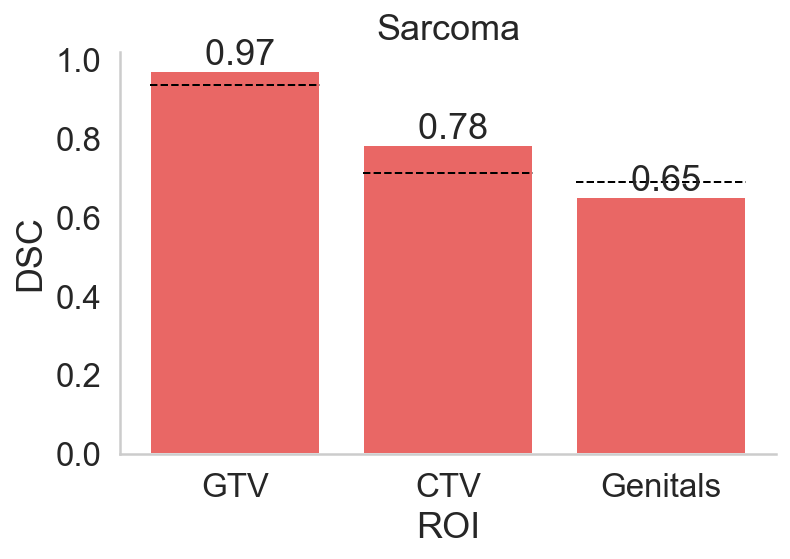

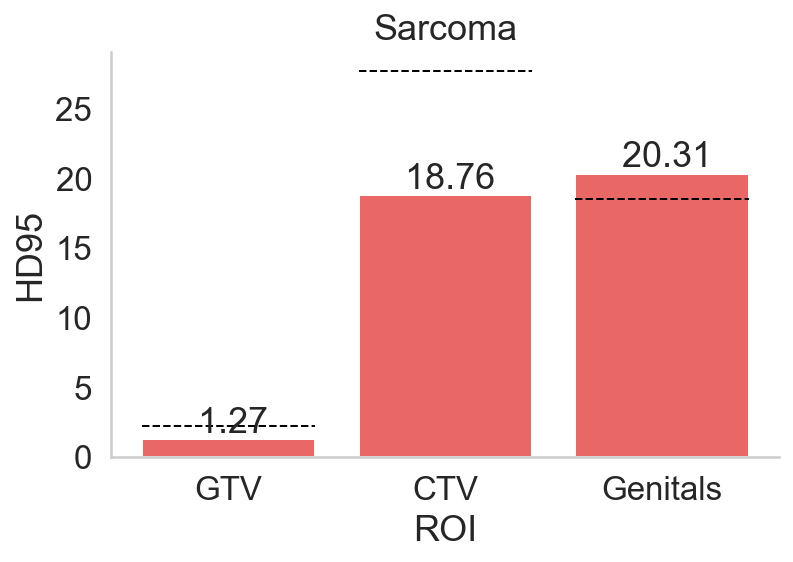

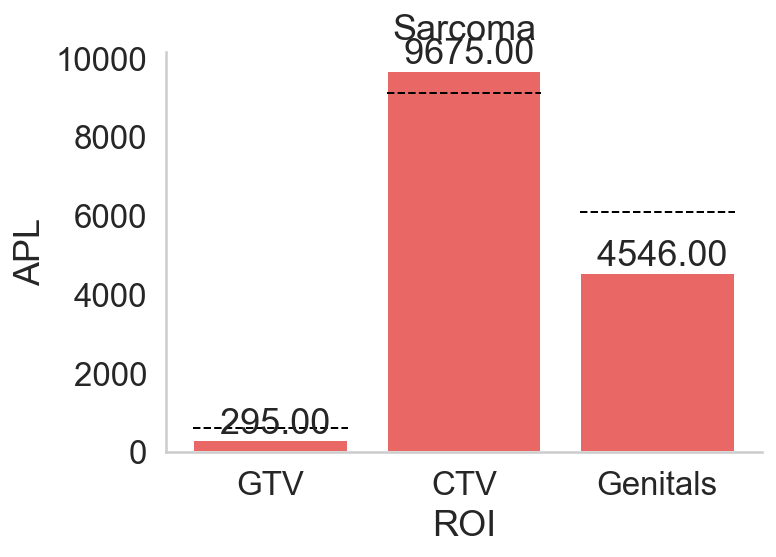

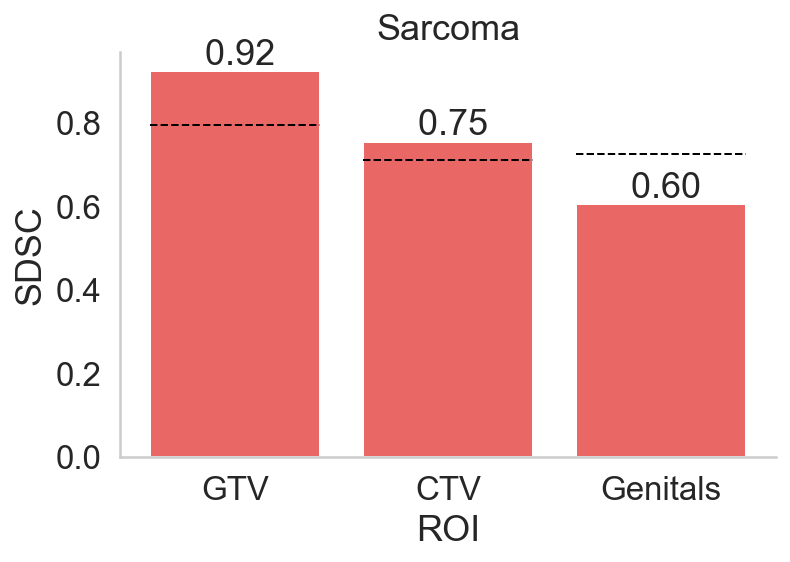

In [106]:
### Make box plots 

metric_list = ['DSC', 'HD95', 'APL', 'SDSC']

for metric, line_dict in zip(metric_list, line_dict_list): # line dict defined before 
    print(metric)
    
    if metric == "DSC" or metric == "SDSC":
        sharey=True
    else:
        sharey=False

    g = sns.catplot(x="ROI", y=metric, hue= "Class", sharex = False,
                    sharey=sharey,
                    data=df2, kind="bar", 
                    height=4, aspect=1.5,
                    palette= sarcoma_palette_old,
                    )
    
    for ax in g.axes.ravel(): # https://stackoverflow.com/questions/41127841/how-to-annotate-bars-in-a-seaborn-facetgrid-works-in-factorplot
        for a, ROI in zip(ax.patches, ROI_list):         

            value = float((line_dict[ROI]))

            x_start = a.get_x()
            width = a.get_width()

            ax.plot([x_start, x_start+width], [value, value], '--', c='black', linewidth=1)
    
    plt.title('Sarcoma')
    g._legend.remove() # remove legend since just showing non-expert
    
    
    axes = g.axes.flatten()
    for ax in axes:
        for container in ax.containers:
            ax.bar_label(container, labels=[f'{x: .2f}' for x in container.datavalues]) # https://stackoverflow.com/questions/70515542/adding-comma-to-bar-labels-in-matplotlib
      
    # TG-263 names 
    labels = ['GTV', 'CTV', 'Genitals']
    g.set_xticklabels(labels)

### Bootstrap experiments

In [605]:
%%time

ROI_list = ['gtv', 'genitalia', 'ctv']

bootstrap = 100
#bootstrap = 2 # testing 

path = os.path.join(base_path, "structures_nifti_stratified", "Non-Expert")

expert_STAPLE_path = os.path.join(base_path, "structures_nifti_stratified_STAPLE", "Expert")

df4 = pd.DataFrame(columns=['ROI', 'N', 'DSC_list', 'HD95_list', 'APL_list', 'SDSC_list', 'ID_list'])

counter = -1  # for df 

counter2 = -1 # for random seed 

n_list = [2, 3, 4, 5, 6, 7, 8, 9, 10, 15, 20, 25]

for ROI in ROI_list:
    #print(ROI)
    expert_file_path = os.path.join(expert_STAPLE_path, ROI+'STAPLE.nii.gz')
    cases = [case for case in os.listdir(path) if ROI+'.nii.gz' in os.listdir(os.path.join(path, case))]
    for n in n_list:
        #print(n)
        DSC_list = []
        subcase_list = []
        for iteration in range(bootstrap):
            
            switch = True 
            
            counter2 +=1 
            
            while switch == True: # horrible practice but don't know what else to do
                
                print("ROI:", ROI, "; total staple:", n, "; boostrap iteration:", iteration, "; random counter:", counter2)
            
                random.seed(counter2)
                np.random.seed(counter2)

                #print(counter2)

                subcases = random.sample(cases, n)
                print(subcases)
                subcase_list.append(subcases)

                file_list = []
                for case in subcases:
                    case_path = os.path.join(path, case)
                    file_path = os.path.join(case_path, ROI+'.nii.gz')
                    file_list.append(file_path)

                segmentations = [sitk.ReadImage(file_name, sitk.sitkUInt8) for file_name in file_list]

                foregroundValue = 1
                threshold = 0.95
                #threshold = 0.90

                if n <= 4: 
                    #print('test')
                    p = multiprocessing.Process(target=sitk.STAPLE, name="Foo", args=(segmentations, foregroundValue,))
                    p.start()
                    p.join(60) # set at 60 sec for now.. 

                    # If thread is active
                    if p.is_alive():
                        print("STAPLE function is taking too long, killing it and getting new random samples")

                        # Terminate function 
                        p.terminate()
                        p.join()
                        counter2 +=1 
                        continue



                #print('test2')
                reference_segmentation_STAPLE_probabilities = sitk.STAPLE(segmentations, foregroundValue) 

                file_1 = reference_segmentation_STAPLE_probabilities > threshold
                file_2 = sitk.ReadImage(expert_file_path)

                mask_1 = sitk.GetArrayFromImage(file_1)
                mask_2 = sitk.GetArrayFromImage(file_2)

                DSC = compute_dice_coefficient(mask_1, mask_2)   
                DSC_list.append(DSC)
                
                # adding other metrics
                
                spacing_mm = file_1.GetSpacing() # need spacing to calcualte distances
                
                mask_1_bool = mask_1.astype(bool) # need to convert to bool format to work 
                mask_2_bool = mask_2.astype(bool)

                surface_distances = compute_surface_distances(mask_1_bool, mask_2_bool, spacing_mm) # need this for all calculations
                HD95 = compute_robust_hausdorff(surface_distances, 95)
                HD95_list.append(HD95)

                APL = AddedPathLength(mask_1, mask_2)
                APL_list.append(APL)
                
                tolerance = np.median(df_pickle[(df_pickle["ROI"] == ROI) & (df_pickle["ROI"] == ROI)]["ASD_list"].values[0]) # get tolerance
                SDSC = compute_surface_dice_at_tolerance(surface_distances, tolerance)
                SDSC_list.append(SDSC)
                
                counter +=1
                df4.loc[counter] = [ROI, n, DSC, HD95, APL, SDSC, subcases]

                switch = False

        print(np.mean(DSC_list))
        print(np.mean(HD95_list))
        print(np.mean(APL_list))
        print(np.mean(SDSC_list))

ROI: gtv ; total staple: 2 ; boostrap iteration: 0 ; random counter: 0
['structure_set_799_', 'structure_set_250_']
ROI: gtv ; total staple: 2 ; boostrap iteration: 1 ; random counter: 1
['structure_set_059_', 'structure_set_398_']
ROI: gtv ; total staple: 2 ; boostrap iteration: 2 ; random counter: 2
['structure_set_804_', 'structure_set_799_']
ROI: gtv ; total staple: 2 ; boostrap iteration: 3 ; random counter: 3
['structure_set_146_', 'structure_set_418_']
ROI: gtv ; total staple: 2 ; boostrap iteration: 4 ; random counter: 4
['structure_set_146_', 'structure_set_217_']
ROI: gtv ; total staple: 2 ; boostrap iteration: 5 ; random counter: 5
['structure_set_443_', 'structure_set_170_']
ROI: gtv ; total staple: 2 ; boostrap iteration: 6 ; random counter: 6
['structure_set_688_', 'structure_set_398_']
ROI: gtv ; total staple: 2 ; boostrap iteration: 7 ; random counter: 7
['structure_set_235_', 'structure_set_099_']
ROI: gtv ; total staple: 2 ; boostrap iteration: 8 ; random counter: 8
[

ROI: gtv ; total staple: 2 ; boostrap iteration: 68 ; random counter: 69
['structure_set_502_', 'structure_set_021_']
ROI: gtv ; total staple: 2 ; boostrap iteration: 69 ; random counter: 70
['structure_set_885_', 'structure_set_048_']
ROI: gtv ; total staple: 2 ; boostrap iteration: 70 ; random counter: 71
['structure_set_235_', 'structure_set_386_']
ROI: gtv ; total staple: 2 ; boostrap iteration: 71 ; random counter: 72
['structure_set_031_', 'structure_set_688_']
ROI: gtv ; total staple: 2 ; boostrap iteration: 72 ; random counter: 73
['structure_set_182_', 'structure_set_048_']
ROI: gtv ; total staple: 2 ; boostrap iteration: 73 ; random counter: 74
['structure_set_804_', 'structure_set_443_']
ROI: gtv ; total staple: 2 ; boostrap iteration: 74 ; random counter: 75
['structure_set_310_', 'structure_set_418_']
ROI: gtv ; total staple: 2 ; boostrap iteration: 75 ; random counter: 76
['structure_set_247_', 'structure_set_362_']
ROI: gtv ; total staple: 2 ; boostrap iteration: 76 ; ra

ROI: gtv ; total staple: 3 ; boostrap iteration: 30 ; random counter: 132
['structure_set_298_', 'structure_set_099_', 'structure_set_027_']
ROI: gtv ; total staple: 3 ; boostrap iteration: 31 ; random counter: 133
['structure_set_384_', 'structure_set_245_', 'structure_set_371_']
ROI: gtv ; total staple: 3 ; boostrap iteration: 32 ; random counter: 134
['structure_set_371_', 'structure_set_393_', 'structure_set_128_']
ROI: gtv ; total staple: 3 ; boostrap iteration: 33 ; random counter: 135
['structure_set_488_', 'structure_set_247_', 'structure_set_451_']
ROI: gtv ; total staple: 3 ; boostrap iteration: 34 ; random counter: 136
['structure_set_398_', 'structure_set_304_', 'structure_set_393_']
ROI: gtv ; total staple: 3 ; boostrap iteration: 35 ; random counter: 137
['structure_set_031_', 'structure_set_120_', 'structure_set_298_']
ROI: gtv ; total staple: 3 ; boostrap iteration: 36 ; random counter: 138
['structure_set_128_', 'structure_set_250_', 'structure_set_310_']
ROI: gtv ; to

ROI: gtv ; total staple: 3 ; boostrap iteration: 89 ; random counter: 191
['structure_set_631_', 'structure_set_393_', 'structure_set_688_']
ROI: gtv ; total staple: 3 ; boostrap iteration: 90 ; random counter: 192
['structure_set_247_', 'structure_set_767_', 'structure_set_217_']
ROI: gtv ; total staple: 3 ; boostrap iteration: 91 ; random counter: 193
['structure_set_397_', 'structure_set_362_', 'structure_set_871_']
ROI: gtv ; total staple: 3 ; boostrap iteration: 92 ; random counter: 194
['structure_set_710_', 'structure_set_421_', 'structure_set_031_']
ROI: gtv ; total staple: 3 ; boostrap iteration: 93 ; random counter: 195
['structure_set_421_', 'structure_set_297_', 'structure_set_021_']
ROI: gtv ; total staple: 3 ; boostrap iteration: 94 ; random counter: 196
['structure_set_472_', 'structure_set_386_', 'structure_set_572_']
ROI: gtv ; total staple: 3 ; boostrap iteration: 95 ; random counter: 197
['structure_set_395_', 'structure_set_002_', 'structure_set_059_']
ROI: gtv ; to

ROI: gtv ; total staple: 4 ; boostrap iteration: 41 ; random counter: 243
['structure_set_873_', 'structure_set_393_', 'structure_set_235_', 'structure_set_304_']
ROI: gtv ; total staple: 4 ; boostrap iteration: 42 ; random counter: 244
['structure_set_631_', 'structure_set_688_', 'structure_set_502_', 'structure_set_298_']
ROI: gtv ; total staple: 4 ; boostrap iteration: 43 ; random counter: 245
['structure_set_059_', 'structure_set_186_', 'structure_set_371_', 'structure_set_031_']
ROI: gtv ; total staple: 4 ; boostrap iteration: 44 ; random counter: 246
['structure_set_908_', 'structure_set_027_', 'structure_set_393_', 'structure_set_250_']
ROI: gtv ; total staple: 4 ; boostrap iteration: 45 ; random counter: 247
['structure_set_362_', 'structure_set_241_', 'structure_set_011_', 'structure_set_245_']
ROI: gtv ; total staple: 4 ; boostrap iteration: 46 ; random counter: 248
['structure_set_767_', 'structure_set_298_', 'structure_set_603_', 'structure_set_908_']
ROI: gtv ; total stapl

ROI: gtv ; total staple: 4 ; boostrap iteration: 92 ; random counter: 294
['structure_set_120_', 'structure_set_021_', 'structure_set_371_', 'structure_set_908_']
ROI: gtv ; total staple: 4 ; boostrap iteration: 93 ; random counter: 295
['structure_set_804_', 'structure_set_767_', 'structure_set_186_', 'structure_set_702_']
ROI: gtv ; total staple: 4 ; boostrap iteration: 94 ; random counter: 296
['structure_set_031_', 'structure_set_908_', 'structure_set_170_', 'structure_set_247_']
ROI: gtv ; total staple: 4 ; boostrap iteration: 95 ; random counter: 297
['structure_set_393_', 'structure_set_247_', 'structure_set_630_', 'structure_set_297_']
ROI: gtv ; total staple: 4 ; boostrap iteration: 96 ; random counter: 298
['structure_set_129_', 'structure_set_397_', 'structure_set_472_', 'structure_set_393_']
ROI: gtv ; total staple: 4 ; boostrap iteration: 97 ; random counter: 299
['structure_set_247_', 'structure_set_418_', 'structure_set_603_', 'structure_set_128_']
ROI: gtv ; total stapl

ROI: gtv ; total staple: 5 ; boostrap iteration: 37 ; random counter: 339
['structure_set_099_', 'structure_set_767_', 'structure_set_710_', 'structure_set_451_', 'structure_set_059_']
ROI: gtv ; total staple: 5 ; boostrap iteration: 38 ; random counter: 340
['structure_set_297_', 'structure_set_398_', 'structure_set_034_', 'structure_set_393_', 'structure_set_799_']
ROI: gtv ; total staple: 5 ; boostrap iteration: 39 ; random counter: 341
['structure_set_418_', 'structure_set_217_', 'structure_set_398_', 'structure_set_099_', 'structure_set_871_']
ROI: gtv ; total staple: 5 ; boostrap iteration: 40 ; random counter: 342
['structure_set_048_', 'structure_set_129_', 'structure_set_418_', 'structure_set_031_', 'structure_set_371_']
ROI: gtv ; total staple: 5 ; boostrap iteration: 41 ; random counter: 343
['structure_set_128_', 'structure_set_384_', 'structure_set_631_', 'structure_set_908_', 'structure_set_107_']
ROI: gtv ; total staple: 5 ; boostrap iteration: 42 ; random counter: 344
[

ROI: gtv ; total staple: 5 ; boostrap iteration: 82 ; random counter: 384
['structure_set_472_', 'structure_set_767_', 'structure_set_250_', 'structure_set_027_', 'structure_set_688_']
ROI: gtv ; total staple: 5 ; boostrap iteration: 83 ; random counter: 385
['structure_set_908_', 'structure_set_031_', 'structure_set_710_', 'structure_set_384_', 'structure_set_297_']
ROI: gtv ; total staple: 5 ; boostrap iteration: 84 ; random counter: 386
['structure_set_443_', 'structure_set_217_', 'structure_set_519_', 'structure_set_297_', 'structure_set_395_']
ROI: gtv ; total staple: 5 ; boostrap iteration: 85 ; random counter: 387
['structure_set_310_', 'structure_set_129_', 'structure_set_021_', 'structure_set_908_', 'structure_set_688_']
ROI: gtv ; total staple: 5 ; boostrap iteration: 86 ; random counter: 388
['structure_set_702_', 'structure_set_908_', 'structure_set_247_', 'structure_set_245_', 'structure_set_502_']
ROI: gtv ; total staple: 5 ; boostrap iteration: 87 ; random counter: 389
[

ROI: gtv ; total staple: 6 ; boostrap iteration: 24 ; random counter: 426
['structure_set_107_', 'structure_set_241_', 'structure_set_603_', 'structure_set_630_', 'structure_set_245_', 'structure_set_031_']
ROI: gtv ; total staple: 6 ; boostrap iteration: 25 ; random counter: 427
['structure_set_107_', 'structure_set_443_', 'structure_set_710_', 'structure_set_384_', 'structure_set_702_', 'structure_set_247_']
ROI: gtv ; total staple: 6 ; boostrap iteration: 26 ; random counter: 428
['structure_set_170_', 'structure_set_799_', 'structure_set_027_', 'structure_set_393_', 'structure_set_310_', 'structure_set_034_']
ROI: gtv ; total staple: 6 ; boostrap iteration: 27 ; random counter: 429
['structure_set_421_', 'structure_set_871_', 'structure_set_048_', 'structure_set_011_', 'structure_set_241_', 'structure_set_885_']
ROI: gtv ; total staple: 6 ; boostrap iteration: 28 ; random counter: 430
['structure_set_182_', 'structure_set_488_', 'structure_set_059_', 'structure_set_011_', 'structur

ROI: gtv ; total staple: 6 ; boostrap iteration: 64 ; random counter: 466
['structure_set_873_', 'structure_set_027_', 'structure_set_048_', 'structure_set_186_', 'structure_set_128_', 'structure_set_702_']
ROI: gtv ; total staple: 6 ; boostrap iteration: 65 ; random counter: 467
['structure_set_170_', 'structure_set_371_', 'structure_set_297_', 'structure_set_031_', 'structure_set_011_', 'structure_set_304_']
ROI: gtv ; total staple: 6 ; boostrap iteration: 66 ; random counter: 468
['structure_set_129_', 'structure_set_250_', 'structure_set_027_', 'structure_set_418_', 'structure_set_033_', 'structure_set_120_']
ROI: gtv ; total staple: 6 ; boostrap iteration: 67 ; random counter: 469
['structure_set_170_', 'structure_set_688_', 'structure_set_217_', 'structure_set_488_', 'structure_set_908_', 'structure_set_298_']
ROI: gtv ; total staple: 6 ; boostrap iteration: 68 ; random counter: 470
['structure_set_021_', 'structure_set_603_', 'structure_set_245_', 'structure_set_120_', 'structur

ROI: gtv ; total staple: 7 ; boostrap iteration: 3 ; random counter: 505
['structure_set_099_', 'structure_set_170_', 'structure_set_799_', 'structure_set_217_', 'structure_set_182_', 'structure_set_241_', 'structure_set_519_']
ROI: gtv ; total staple: 7 ; boostrap iteration: 4 ; random counter: 506
['structure_set_631_', 'structure_set_688_', 'structure_set_384_', 'structure_set_182_', 'structure_set_250_', 'structure_set_398_', 'structure_set_298_']
ROI: gtv ; total staple: 7 ; boostrap iteration: 5 ; random counter: 507
['structure_set_371_', 'structure_set_871_', 'structure_set_443_', 'structure_set_398_', 'structure_set_099_', 'structure_set_384_', 'structure_set_472_']
ROI: gtv ; total staple: 7 ; boostrap iteration: 6 ; random counter: 508
['structure_set_395_', 'structure_set_688_', 'structure_set_488_', 'structure_set_298_', 'structure_set_384_', 'structure_set_031_', 'structure_set_034_']
ROI: gtv ; total staple: 7 ; boostrap iteration: 7 ; random counter: 509
['structure_set

ROI: gtv ; total staple: 7 ; boostrap iteration: 39 ; random counter: 541
['structure_set_245_', 'structure_set_002_', 'structure_set_362_', 'structure_set_250_', 'structure_set_099_', 'structure_set_120_', 'structure_set_395_']
ROI: gtv ; total staple: 7 ; boostrap iteration: 40 ; random counter: 542
['structure_set_371_', 'structure_set_048_', 'structure_set_107_', 'structure_set_298_', 'structure_set_128_', 'structure_set_873_', 'structure_set_310_']
ROI: gtv ; total staple: 7 ; boostrap iteration: 41 ; random counter: 543
['structure_set_767_', 'structure_set_472_', 'structure_set_059_', 'structure_set_033_', 'structure_set_362_', 'structure_set_641_', 'structure_set_502_']
ROI: gtv ; total staple: 7 ; boostrap iteration: 42 ; random counter: 544
['structure_set_488_', 'structure_set_631_', 'structure_set_182_', 'structure_set_034_', 'structure_set_217_', 'structure_set_443_', 'structure_set_397_']
ROI: gtv ; total staple: 7 ; boostrap iteration: 43 ; random counter: 545
['structur

ROI: gtv ; total staple: 7 ; boostrap iteration: 75 ; random counter: 577
['structure_set_297_', 'structure_set_245_', 'structure_set_519_', 'structure_set_033_', 'structure_set_241_', 'structure_set_362_', 'structure_set_298_']
ROI: gtv ; total staple: 7 ; boostrap iteration: 76 ; random counter: 578
['structure_set_631_', 'structure_set_186_', 'structure_set_107_', 'structure_set_488_', 'structure_set_398_', 'structure_set_630_', 'structure_set_641_']
ROI: gtv ; total staple: 7 ; boostrap iteration: 77 ; random counter: 579
['structure_set_235_', 'structure_set_297_', 'structure_set_710_', 'structure_set_384_', 'structure_set_603_', 'structure_set_099_', 'structure_set_472_']
ROI: gtv ; total staple: 7 ; boostrap iteration: 78 ; random counter: 580
['structure_set_393_', 'structure_set_908_', 'structure_set_186_', 'structure_set_767_', 'structure_set_033_', 'structure_set_502_', 'structure_set_472_']
ROI: gtv ; total staple: 7 ; boostrap iteration: 79 ; random counter: 581
['structur

ROI: gtv ; total staple: 8 ; boostrap iteration: 10 ; random counter: 612
['structure_set_710_', 'structure_set_799_', 'structure_set_140_', 'structure_set_129_', 'structure_set_641_', 'structure_set_397_', 'structure_set_421_', 'structure_set_418_']
ROI: gtv ; total staple: 8 ; boostrap iteration: 11 ; random counter: 613
['structure_set_182_', 'structure_set_059_', 'structure_set_688_', 'structure_set_048_', 'structure_set_641_', 'structure_set_393_', 'structure_set_362_', 'structure_set_767_']
ROI: gtv ; total staple: 8 ; boostrap iteration: 12 ; random counter: 614
['structure_set_170_', 'structure_set_140_', 'structure_set_421_', 'structure_set_502_', 'structure_set_128_', 'structure_set_033_', 'structure_set_418_', 'structure_set_048_']
ROI: gtv ; total staple: 8 ; boostrap iteration: 13 ; random counter: 615
['structure_set_140_', 'structure_set_250_', 'structure_set_031_', 'structure_set_488_', 'structure_set_871_', 'structure_set_120_', 'structure_set_099_', 'structure_set_702

ROI: gtv ; total staple: 8 ; boostrap iteration: 43 ; random counter: 645
['structure_set_128_', 'structure_set_443_', 'structure_set_099_', 'structure_set_298_', 'structure_set_641_', 'structure_set_034_', 'structure_set_186_', 'structure_set_011_']
ROI: gtv ; total staple: 8 ; boostrap iteration: 44 ; random counter: 646
['structure_set_398_', 'structure_set_885_', 'structure_set_418_', 'structure_set_688_', 'structure_set_235_', 'structure_set_603_', 'structure_set_393_', 'structure_set_443_']
ROI: gtv ; total staple: 8 ; boostrap iteration: 45 ; random counter: 647
['structure_set_873_', 'structure_set_488_', 'structure_set_395_', 'structure_set_245_', 'structure_set_472_', 'structure_set_031_', 'structure_set_250_', 'structure_set_304_']
ROI: gtv ; total staple: 8 ; boostrap iteration: 46 ; random counter: 648
['structure_set_472_', 'structure_set_120_', 'structure_set_398_', 'structure_set_235_', 'structure_set_397_', 'structure_set_641_', 'structure_set_140_', 'structure_set_048

ROI: gtv ; total staple: 8 ; boostrap iteration: 76 ; random counter: 678
['structure_set_048_', 'structure_set_871_', 'structure_set_235_', 'structure_set_002_', 'structure_set_241_', 'structure_set_710_', 'structure_set_885_', 'structure_set_107_']
ROI: gtv ; total staple: 8 ; boostrap iteration: 77 ; random counter: 679
['structure_set_885_', 'structure_set_472_', 'structure_set_421_', 'structure_set_395_', 'structure_set_250_', 'structure_set_710_', 'structure_set_245_', 'structure_set_033_']
ROI: gtv ; total staple: 8 ; boostrap iteration: 78 ; random counter: 680
['structure_set_443_', 'structure_set_384_', 'structure_set_799_', 'structure_set_418_', 'structure_set_059_', 'structure_set_702_', 'structure_set_873_', 'structure_set_386_']
ROI: gtv ; total staple: 8 ; boostrap iteration: 79 ; random counter: 681
['structure_set_298_', 'structure_set_519_', 'structure_set_235_', 'structure_set_048_', 'structure_set_362_', 'structure_set_641_', 'structure_set_250_', 'structure_set_027

ROI: gtv ; total staple: 9 ; boostrap iteration: 8 ; random counter: 710
['structure_set_250_', 'structure_set_502_', 'structure_set_397_', 'structure_set_310_', 'structure_set_519_', 'structure_set_129_', 'structure_set_871_', 'structure_set_186_', 'structure_set_395_']
ROI: gtv ; total staple: 9 ; boostrap iteration: 9 ; random counter: 711
['structure_set_443_', 'structure_set_384_', 'structure_set_297_', 'structure_set_519_', 'structure_set_304_', 'structure_set_245_', 'structure_set_140_', 'structure_set_804_', 'structure_set_146_']
ROI: gtv ; total staple: 9 ; boostrap iteration: 10 ; random counter: 712
['structure_set_186_', 'structure_set_443_', 'structure_set_384_', 'structure_set_873_', 'structure_set_033_', 'structure_set_519_', 'structure_set_304_', 'structure_set_128_', 'structure_set_027_']
ROI: gtv ; total staple: 9 ; boostrap iteration: 11 ; random counter: 713
['structure_set_250_', 'structure_set_451_', 'structure_set_186_', 'structure_set_247_', 'structure_set_371_'

ROI: gtv ; total staple: 9 ; boostrap iteration: 39 ; random counter: 741
['structure_set_140_', 'structure_set_767_', 'structure_set_393_', 'structure_set_603_', 'structure_set_011_', 'structure_set_298_', 'structure_set_362_', 'structure_set_245_', 'structure_set_033_']
ROI: gtv ; total staple: 9 ; boostrap iteration: 40 ; random counter: 742
['structure_set_298_', 'structure_set_217_', 'structure_set_059_', 'structure_set_418_', 'structure_set_048_', 'structure_set_603_', 'structure_set_421_', 'structure_set_451_', 'structure_set_027_']
ROI: gtv ; total staple: 9 ; boostrap iteration: 41 ; random counter: 743
['structure_set_519_', 'structure_set_885_', 'structure_set_186_', 'structure_set_418_', 'structure_set_021_', 'structure_set_011_', 'structure_set_297_', 'structure_set_304_', 'structure_set_603_']
ROI: gtv ; total staple: 9 ; boostrap iteration: 42 ; random counter: 744
['structure_set_217_', 'structure_set_688_', 'structure_set_395_', 'structure_set_710_', 'structure_set_241

ROI: gtv ; total staple: 9 ; boostrap iteration: 70 ; random counter: 772
['structure_set_034_', 'structure_set_871_', 'structure_set_710_', 'structure_set_397_', 'structure_set_241_', 'structure_set_502_', 'structure_set_027_', 'structure_set_128_', 'structure_set_099_']
ROI: gtv ; total staple: 9 ; boostrap iteration: 71 ; random counter: 773
['structure_set_120_', 'structure_set_384_', 'structure_set_502_', 'structure_set_247_', 'structure_set_572_', 'structure_set_235_', 'structure_set_397_', 'structure_set_885_', 'structure_set_804_']
ROI: gtv ; total staple: 9 ; boostrap iteration: 72 ; random counter: 774
['structure_set_217_', 'structure_set_002_', 'structure_set_048_', 'structure_set_710_', 'structure_set_398_', 'structure_set_384_', 'structure_set_310_', 'structure_set_572_', 'structure_set_871_']
ROI: gtv ; total staple: 9 ; boostrap iteration: 73 ; random counter: 775
['structure_set_384_', 'structure_set_871_', 'structure_set_011_', 'structure_set_885_', 'structure_set_107

ROI: gtv ; total staple: 10 ; boostrap iteration: 1 ; random counter: 803
['structure_set_034_', 'structure_set_120_', 'structure_set_384_', 'structure_set_393_', 'structure_set_298_', 'structure_set_048_', 'structure_set_146_', 'structure_set_630_', 'structure_set_099_', 'structure_set_767_']
ROI: gtv ; total staple: 10 ; boostrap iteration: 2 ; random counter: 804
['structure_set_371_', 'structure_set_502_', 'structure_set_362_', 'structure_set_033_', 'structure_set_241_', 'structure_set_767_', 'structure_set_011_', 'structure_set_031_', 'structure_set_146_', 'structure_set_641_']
ROI: gtv ; total staple: 10 ; boostrap iteration: 3 ; random counter: 805
['structure_set_384_', 'structure_set_140_', 'structure_set_799_', 'structure_set_873_', 'structure_set_031_', 'structure_set_572_', 'structure_set_182_', 'structure_set_027_', 'structure_set_362_', 'structure_set_702_']
ROI: gtv ; total staple: 10 ; boostrap iteration: 4 ; random counter: 806
['structure_set_908_', 'structure_set_362

ROI: gtv ; total staple: 10 ; boostrap iteration: 29 ; random counter: 831
['structure_set_107_', 'structure_set_245_', 'structure_set_297_', 'structure_set_451_', 'structure_set_099_', 'structure_set_011_', 'structure_set_804_', 'structure_set_140_', 'structure_set_386_', 'structure_set_603_']
ROI: gtv ; total staple: 10 ; boostrap iteration: 30 ; random counter: 832
['structure_set_603_', 'structure_set_472_', 'structure_set_395_', 'structure_set_241_', 'structure_set_386_', 'structure_set_398_', 'structure_set_140_', 'structure_set_250_', 'structure_set_421_', 'structure_set_710_']
ROI: gtv ; total staple: 10 ; boostrap iteration: 31 ; random counter: 833
['structure_set_398_', 'structure_set_443_', 'structure_set_186_', 'structure_set_245_', 'structure_set_908_', 'structure_set_107_', 'structure_set_034_', 'structure_set_603_', 'structure_set_384_', 'structure_set_702_']
ROI: gtv ; total staple: 10 ; boostrap iteration: 32 ; random counter: 834
['structure_set_186_', 'structure_set

ROI: gtv ; total staple: 10 ; boostrap iteration: 57 ; random counter: 859
['structure_set_398_', 'structure_set_710_', 'structure_set_140_', 'structure_set_048_', 'structure_set_033_', 'structure_set_451_', 'structure_set_443_', 'structure_set_027_', 'structure_set_371_', 'structure_set_059_']
ROI: gtv ; total staple: 10 ; boostrap iteration: 58 ; random counter: 860
['structure_set_059_', 'structure_set_908_', 'structure_set_488_', 'structure_set_033_', 'structure_set_871_', 'structure_set_395_', 'structure_set_245_', 'structure_set_393_', 'structure_set_443_', 'structure_set_603_']
ROI: gtv ; total staple: 10 ; boostrap iteration: 59 ; random counter: 861
['structure_set_799_', 'structure_set_310_', 'structure_set_885_', 'structure_set_502_', 'structure_set_027_', 'structure_set_710_', 'structure_set_011_', 'structure_set_059_', 'structure_set_641_', 'structure_set_099_']
ROI: gtv ; total staple: 10 ; boostrap iteration: 60 ; random counter: 862
['structure_set_398_', 'structure_set

ROI: gtv ; total staple: 10 ; boostrap iteration: 85 ; random counter: 887
['structure_set_384_', 'structure_set_250_', 'structure_set_908_', 'structure_set_710_', 'structure_set_128_', 'structure_set_804_', 'structure_set_688_', 'structure_set_702_', 'structure_set_245_', 'structure_set_443_']
ROI: gtv ; total staple: 10 ; boostrap iteration: 86 ; random counter: 888
['structure_set_033_', 'structure_set_304_', 'structure_set_418_', 'structure_set_310_', 'structure_set_384_', 'structure_set_250_', 'structure_set_451_', 'structure_set_247_', 'structure_set_395_', 'structure_set_298_']
ROI: gtv ; total staple: 10 ; boostrap iteration: 87 ; random counter: 889
['structure_set_451_', 'structure_set_421_', 'structure_set_702_', 'structure_set_630_', 'structure_set_140_', 'structure_set_443_', 'structure_set_033_', 'structure_set_120_', 'structure_set_488_', 'structure_set_641_']
ROI: gtv ; total staple: 10 ; boostrap iteration: 88 ; random counter: 890
['structure_set_027_', 'structure_set

ROI: gtv ; total staple: 15 ; boostrap iteration: 10 ; random counter: 912
['structure_set_393_', 'structure_set_630_', 'structure_set_871_', 'structure_set_217_', 'structure_set_128_', 'structure_set_397_', 'structure_set_298_', 'structure_set_451_', 'structure_set_107_', 'structure_set_395_', 'structure_set_245_', 'structure_set_011_', 'structure_set_021_', 'structure_set_027_', 'structure_set_710_']
ROI: gtv ; total staple: 15 ; boostrap iteration: 11 ; random counter: 913
['structure_set_034_', 'structure_set_011_', 'structure_set_371_', 'structure_set_804_', 'structure_set_630_', 'structure_set_418_', 'structure_set_502_', 'structure_set_241_', 'structure_set_710_', 'structure_set_250_', 'structure_set_688_', 'structure_set_129_', 'structure_set_767_', 'structure_set_217_', 'structure_set_120_']
ROI: gtv ; total staple: 15 ; boostrap iteration: 12 ; random counter: 914
['structure_set_027_', 'structure_set_217_', 'structure_set_702_', 'structure_set_688_', 'structure_set_630_', 's

ROI: gtv ; total staple: 15 ; boostrap iteration: 31 ; random counter: 933
['structure_set_393_', 'structure_set_398_', 'structure_set_120_', 'structure_set_397_', 'structure_set_386_', 'structure_set_011_', 'structure_set_488_', 'structure_set_031_', 'structure_set_421_', 'structure_set_128_', 'structure_set_059_', 'structure_set_241_', 'structure_set_245_', 'structure_set_033_', 'structure_set_767_']
ROI: gtv ; total staple: 15 ; boostrap iteration: 32 ; random counter: 934
['structure_set_362_', 'structure_set_146_', 'structure_set_002_', 'structure_set_011_', 'structure_set_031_', 'structure_set_170_', 'structure_set_099_', 'structure_set_241_', 'structure_set_519_', 'structure_set_397_', 'structure_set_702_', 'structure_set_245_', 'structure_set_107_', 'structure_set_421_', 'structure_set_767_']
ROI: gtv ; total staple: 15 ; boostrap iteration: 33 ; random counter: 935
['structure_set_710_', 'structure_set_502_', 'structure_set_603_', 'structure_set_362_', 'structure_set_250_', 's

ROI: gtv ; total staple: 15 ; boostrap iteration: 52 ; random counter: 954
['structure_set_120_', 'structure_set_398_', 'structure_set_027_', 'structure_set_603_', 'structure_set_799_', 'structure_set_502_', 'structure_set_519_', 'structure_set_107_', 'structure_set_395_', 'structure_set_572_', 'structure_set_767_', 'structure_set_186_', 'structure_set_631_', 'structure_set_421_', 'structure_set_885_']
ROI: gtv ; total staple: 15 ; boostrap iteration: 53 ; random counter: 955
['structure_set_488_', 'structure_set_298_', 'structure_set_362_', 'structure_set_182_', 'structure_set_443_', 'structure_set_297_', 'structure_set_099_', 'structure_set_395_', 'structure_set_384_', 'structure_set_235_', 'structure_set_002_', 'structure_set_386_', 'structure_set_702_', 'structure_set_451_', 'structure_set_033_']
ROI: gtv ; total staple: 15 ; boostrap iteration: 54 ; random counter: 956
['structure_set_502_', 'structure_set_297_', 'structure_set_099_', 'structure_set_304_', 'structure_set_630_', 's

ROI: gtv ; total staple: 15 ; boostrap iteration: 73 ; random counter: 975
['structure_set_384_', 'structure_set_519_', 'structure_set_885_', 'structure_set_027_', 'structure_set_472_', 'structure_set_418_', 'structure_set_397_', 'structure_set_688_', 'structure_set_502_', 'structure_set_871_', 'structure_set_217_', 'structure_set_031_', 'structure_set_170_', 'structure_set_804_', 'structure_set_767_']
ROI: gtv ; total staple: 15 ; boostrap iteration: 74 ; random counter: 976
['structure_set_710_', 'structure_set_241_', 'structure_set_630_', 'structure_set_502_', 'structure_set_128_', 'structure_set_799_', 'structure_set_572_', 'structure_set_027_', 'structure_set_186_', 'structure_set_397_', 'structure_set_418_', 'structure_set_371_', 'structure_set_885_', 'structure_set_146_', 'structure_set_421_']
ROI: gtv ; total staple: 15 ; boostrap iteration: 75 ; random counter: 977
['structure_set_451_', 'structure_set_641_', 'structure_set_027_', 'structure_set_472_', 'structure_set_395_', 's

ROI: gtv ; total staple: 15 ; boostrap iteration: 94 ; random counter: 996
['structure_set_885_', 'structure_set_310_', 'structure_set_371_', 'structure_set_140_', 'structure_set_034_', 'structure_set_804_', 'structure_set_247_', 'structure_set_393_', 'structure_set_011_', 'structure_set_873_', 'structure_set_245_', 'structure_set_443_', 'structure_set_472_', 'structure_set_631_', 'structure_set_871_']
ROI: gtv ; total staple: 15 ; boostrap iteration: 95 ; random counter: 997
['structure_set_362_', 'structure_set_310_', 'structure_set_217_', 'structure_set_182_', 'structure_set_120_', 'structure_set_247_', 'structure_set_128_', 'structure_set_245_', 'structure_set_767_', 'structure_set_572_', 'structure_set_031_', 'structure_set_034_', 'structure_set_393_', 'structure_set_371_', 'structure_set_304_']
ROI: gtv ; total staple: 15 ; boostrap iteration: 96 ; random counter: 998
['structure_set_107_', 'structure_set_371_', 'structure_set_421_', 'structure_set_395_', 'structure_set_885_', 's

ROI: gtv ; total staple: 20 ; boostrap iteration: 12 ; random counter: 1014
['structure_set_386_', 'structure_set_002_', 'structure_set_146_', 'structure_set_170_', 'structure_set_021_', 'structure_set_304_', 'structure_set_799_', 'structure_set_502_', 'structure_set_443_', 'structure_set_702_', 'structure_set_120_', 'structure_set_362_', 'structure_set_908_', 'structure_set_384_', 'structure_set_871_', 'structure_set_519_', 'structure_set_298_', 'structure_set_418_', 'structure_set_371_', 'structure_set_034_']
ROI: gtv ; total staple: 20 ; boostrap iteration: 13 ; random counter: 1015
['structure_set_034_', 'structure_set_631_', 'structure_set_217_', 'structure_set_871_', 'structure_set_384_', 'structure_set_393_', 'structure_set_572_', 'structure_set_702_', 'structure_set_885_', 'structure_set_502_', 'structure_set_297_', 'structure_set_182_', 'structure_set_304_', 'structure_set_418_', 'structure_set_488_', 'structure_set_873_', 'structure_set_371_', 'structure_set_443_', 'structure

ROI: gtv ; total staple: 20 ; boostrap iteration: 28 ; random counter: 1030
['structure_set_027_', 'structure_set_304_', 'structure_set_641_', 'structure_set_421_', 'structure_set_107_', 'structure_set_472_', 'structure_set_767_', 'structure_set_128_', 'structure_set_310_', 'structure_set_386_', 'structure_set_297_', 'structure_set_631_', 'structure_set_031_', 'structure_set_702_', 'structure_set_488_', 'structure_set_099_', 'structure_set_710_', 'structure_set_002_', 'structure_set_418_', 'structure_set_519_']
ROI: gtv ; total staple: 20 ; boostrap iteration: 29 ; random counter: 1031
['structure_set_519_', 'structure_set_398_', 'structure_set_397_', 'structure_set_021_', 'structure_set_871_', 'structure_set_799_', 'structure_set_235_', 'structure_set_767_', 'structure_set_804_', 'structure_set_247_', 'structure_set_451_', 'structure_set_182_', 'structure_set_362_', 'structure_set_297_', 'structure_set_630_', 'structure_set_710_', 'structure_set_027_', 'structure_set_371_', 'structure

ROI: gtv ; total staple: 20 ; boostrap iteration: 44 ; random counter: 1046
['structure_set_362_', 'structure_set_421_', 'structure_set_702_', 'structure_set_384_', 'structure_set_033_', 'structure_set_247_', 'structure_set_799_', 'structure_set_128_', 'structure_set_099_', 'structure_set_021_', 'structure_set_472_', 'structure_set_120_', 'structure_set_031_', 'structure_set_170_', 'structure_set_603_', 'structure_set_710_', 'structure_set_304_', 'structure_set_395_', 'structure_set_235_', 'structure_set_418_']
ROI: gtv ; total staple: 20 ; boostrap iteration: 45 ; random counter: 1047
['structure_set_033_', 'structure_set_170_', 'structure_set_250_', 'structure_set_885_', 'structure_set_362_', 'structure_set_297_', 'structure_set_371_', 'structure_set_120_', 'structure_set_247_', 'structure_set_395_', 'structure_set_146_', 'structure_set_099_', 'structure_set_048_', 'structure_set_031_', 'structure_set_630_', 'structure_set_688_', 'structure_set_603_', 'structure_set_443_', 'structure

ROI: gtv ; total staple: 20 ; boostrap iteration: 60 ; random counter: 1062
['structure_set_048_', 'structure_set_140_', 'structure_set_245_', 'structure_set_386_', 'structure_set_572_', 'structure_set_031_', 'structure_set_710_', 'structure_set_451_', 'structure_set_021_', 'structure_set_397_', 'structure_set_362_', 'structure_set_799_', 'structure_set_027_', 'structure_set_871_', 'structure_set_908_', 'structure_set_631_', 'structure_set_297_', 'structure_set_873_', 'structure_set_603_', 'structure_set_247_']
ROI: gtv ; total staple: 20 ; boostrap iteration: 61 ; random counter: 1063
['structure_set_128_', 'structure_set_099_', 'structure_set_603_', 'structure_set_395_', 'structure_set_804_', 'structure_set_297_', 'structure_set_631_', 'structure_set_871_', 'structure_set_443_', 'structure_set_398_', 'structure_set_572_', 'structure_set_630_', 'structure_set_146_', 'structure_set_421_', 'structure_set_247_', 'structure_set_799_', 'structure_set_235_', 'structure_set_451_', 'structure

ROI: gtv ; total staple: 20 ; boostrap iteration: 76 ; random counter: 1078
['structure_set_034_', 'structure_set_059_', 'structure_set_310_', 'structure_set_250_', 'structure_set_630_', 'structure_set_182_', 'structure_set_027_', 'structure_set_170_', 'structure_set_384_', 'structure_set_502_', 'structure_set_031_', 'structure_set_298_', 'structure_set_488_', 'structure_set_804_', 'structure_set_519_', 'structure_set_217_', 'structure_set_140_', 'structure_set_129_', 'structure_set_297_', 'structure_set_572_']
ROI: gtv ; total staple: 20 ; boostrap iteration: 77 ; random counter: 1079
['structure_set_395_', 'structure_set_630_', 'structure_set_371_', 'structure_set_027_', 'structure_set_519_', 'structure_set_107_', 'structure_set_421_', 'structure_set_443_', 'structure_set_799_', 'structure_set_384_', 'structure_set_418_', 'structure_set_304_', 'structure_set_241_', 'structure_set_710_', 'structure_set_310_', 'structure_set_362_', 'structure_set_631_', 'structure_set_398_', 'structure

ROI: gtv ; total staple: 20 ; boostrap iteration: 92 ; random counter: 1094
['structure_set_395_', 'structure_set_799_', 'structure_set_472_', 'structure_set_908_', 'structure_set_247_', 'structure_set_488_', 'structure_set_371_', 'structure_set_027_', 'structure_set_384_', 'structure_set_235_', 'structure_set_386_', 'structure_set_297_', 'structure_set_011_', 'structure_set_241_', 'structure_set_702_', 'structure_set_519_', 'structure_set_186_', 'structure_set_393_', 'structure_set_451_', 'structure_set_767_']
ROI: gtv ; total staple: 20 ; boostrap iteration: 93 ; random counter: 1095
['structure_set_129_', 'structure_set_908_', 'structure_set_804_', 'structure_set_048_', 'structure_set_146_', 'structure_set_443_', 'structure_set_298_', 'structure_set_398_', 'structure_set_120_', 'structure_set_386_', 'structure_set_603_', 'structure_set_297_', 'structure_set_799_', 'structure_set_421_', 'structure_set_310_', 'structure_set_170_', 'structure_set_371_', 'structure_set_099_', 'structure

ROI: gtv ; total staple: 25 ; boostrap iteration: 7 ; random counter: 1109
['structure_set_250_', 'structure_set_033_', 'structure_set_371_', 'structure_set_451_', 'structure_set_031_', 'structure_set_421_', 'structure_set_395_', 'structure_set_710_', 'structure_set_011_', 'structure_set_398_', 'structure_set_519_', 'structure_set_488_', 'structure_set_502_', 'structure_set_885_', 'structure_set_128_', 'structure_set_247_', 'structure_set_129_', 'structure_set_804_', 'structure_set_021_', 'structure_set_298_', 'structure_set_310_', 'structure_set_572_', 'structure_set_304_', 'structure_set_630_', 'structure_set_245_']
ROI: gtv ; total staple: 25 ; boostrap iteration: 8 ; random counter: 1110
['structure_set_371_', 'structure_set_129_', 'structure_set_451_', 'structure_set_443_', 'structure_set_033_', 'structure_set_002_', 'structure_set_630_', 'structure_set_297_', 'structure_set_186_', 'structure_set_688_', 'structure_set_421_', 'structure_set_304_', 'structure_set_804_', 'structure_s

ROI: gtv ; total staple: 25 ; boostrap iteration: 21 ; random counter: 1123
['structure_set_182_', 'structure_set_217_', 'structure_set_397_', 'structure_set_386_', 'structure_set_002_', 'structure_set_641_', 'structure_set_871_', 'structure_set_021_', 'structure_set_362_', 'structure_set_688_', 'structure_set_186_', 'structure_set_710_', 'structure_set_031_', 'structure_set_107_', 'structure_set_384_', 'structure_set_804_', 'structure_set_519_', 'structure_set_129_', 'structure_set_418_', 'structure_set_235_', 'structure_set_702_', 'structure_set_443_', 'structure_set_398_', 'structure_set_245_', 'structure_set_304_']
ROI: gtv ; total staple: 25 ; boostrap iteration: 22 ; random counter: 1124
['structure_set_885_', 'structure_set_021_', 'structure_set_245_', 'structure_set_393_', 'structure_set_710_', 'structure_set_804_', 'structure_set_250_', 'structure_set_120_', 'structure_set_519_', 'structure_set_031_', 'structure_set_033_', 'structure_set_146_', 'structure_set_688_', 'structure

ROI: gtv ; total staple: 25 ; boostrap iteration: 35 ; random counter: 1137
['structure_set_297_', 'structure_set_398_', 'structure_set_129_', 'structure_set_170_', 'structure_set_502_', 'structure_set_362_', 'structure_set_128_', 'structure_set_572_', 'structure_set_702_', 'structure_set_250_', 'structure_set_002_', 'structure_set_395_', 'structure_set_885_', 'structure_set_031_', 'structure_set_021_', 'structure_set_140_', 'structure_set_386_', 'structure_set_472_', 'structure_set_059_', 'structure_set_443_', 'structure_set_241_', 'structure_set_630_', 'structure_set_107_', 'structure_set_488_', 'structure_set_603_']
ROI: gtv ; total staple: 25 ; boostrap iteration: 36 ; random counter: 1138
['structure_set_186_', 'structure_set_641_', 'structure_set_395_', 'structure_set_397_', 'structure_set_217_', 'structure_set_298_', 'structure_set_059_', 'structure_set_310_', 'structure_set_488_', 'structure_set_710_', 'structure_set_688_', 'structure_set_146_', 'structure_set_908_', 'structure

ROI: gtv ; total staple: 25 ; boostrap iteration: 49 ; random counter: 1151
['structure_set_059_', 'structure_set_421_', 'structure_set_572_', 'structure_set_128_', 'structure_set_182_', 'structure_set_304_', 'structure_set_710_', 'structure_set_386_', 'structure_set_120_', 'structure_set_002_', 'structure_set_170_', 'structure_set_641_', 'structure_set_488_', 'structure_set_298_', 'structure_set_472_', 'structure_set_297_', 'structure_set_502_', 'structure_set_519_', 'structure_set_603_', 'structure_set_235_', 'structure_set_631_', 'structure_set_027_', 'structure_set_688_', 'structure_set_217_', 'structure_set_186_']
ROI: gtv ; total staple: 25 ; boostrap iteration: 50 ; random counter: 1152
['structure_set_398_', 'structure_set_908_', 'structure_set_443_', 'structure_set_033_', 'structure_set_241_', 'structure_set_384_', 'structure_set_027_', 'structure_set_572_', 'structure_set_631_', 'structure_set_885_', 'structure_set_799_', 'structure_set_310_', 'structure_set_702_', 'structure

ROI: gtv ; total staple: 25 ; boostrap iteration: 63 ; random counter: 1165
['structure_set_710_', 'structure_set_099_', 'structure_set_397_', 'structure_set_688_', 'structure_set_170_', 'structure_set_885_', 'structure_set_488_', 'structure_set_241_', 'structure_set_140_', 'structure_set_871_', 'structure_set_002_', 'structure_set_146_', 'structure_set_873_', 'structure_set_451_', 'structure_set_908_', 'structure_set_011_', 'structure_set_059_', 'structure_set_120_', 'structure_set_641_', 'structure_set_297_', 'structure_set_804_', 'structure_set_519_', 'structure_set_630_', 'structure_set_631_', 'structure_set_217_']
ROI: gtv ; total staple: 25 ; boostrap iteration: 64 ; random counter: 1166
['structure_set_472_', 'structure_set_027_', 'structure_set_397_', 'structure_set_182_', 'structure_set_011_', 'structure_set_371_', 'structure_set_241_', 'structure_set_146_', 'structure_set_247_', 'structure_set_033_', 'structure_set_799_', 'structure_set_217_', 'structure_set_297_', 'structure

ROI: gtv ; total staple: 25 ; boostrap iteration: 77 ; random counter: 1179
['structure_set_398_', 'structure_set_021_', 'structure_set_048_', 'structure_set_519_', 'structure_set_908_', 'structure_set_472_', 'structure_set_140_', 'structure_set_443_', 'structure_set_371_', 'structure_set_059_', 'structure_set_310_', 'structure_set_421_', 'structure_set_146_', 'structure_set_170_', 'structure_set_799_', 'structure_set_245_', 'structure_set_033_', 'structure_set_362_', 'structure_set_502_', 'structure_set_107_', 'structure_set_641_', 'structure_set_304_', 'structure_set_603_', 'structure_set_572_', 'structure_set_241_']
ROI: gtv ; total staple: 25 ; boostrap iteration: 78 ; random counter: 1180
['structure_set_250_', 'structure_set_502_', 'structure_set_297_', 'structure_set_873_', 'structure_set_182_', 'structure_set_245_', 'structure_set_310_', 'structure_set_386_', 'structure_set_488_', 'structure_set_048_', 'structure_set_398_', 'structure_set_393_', 'structure_set_129_', 'structure

ROI: gtv ; total staple: 25 ; boostrap iteration: 91 ; random counter: 1193
['structure_set_217_', 'structure_set_443_', 'structure_set_885_', 'structure_set_297_', 'structure_set_871_', 'structure_set_386_', 'structure_set_393_', 'structure_set_488_', 'structure_set_421_', 'structure_set_245_', 'structure_set_146_', 'structure_set_304_', 'structure_set_502_', 'structure_set_371_', 'structure_set_140_', 'structure_set_027_', 'structure_set_384_', 'structure_set_702_', 'structure_set_247_', 'structure_set_641_', 'structure_set_059_', 'structure_set_873_', 'structure_set_630_', 'structure_set_799_', 'structure_set_451_']
ROI: gtv ; total staple: 25 ; boostrap iteration: 92 ; random counter: 1194
['structure_set_451_', 'structure_set_235_', 'structure_set_395_', 'structure_set_048_', 'structure_set_021_', 'structure_set_146_', 'structure_set_011_', 'structure_set_059_', 'structure_set_099_', 'structure_set_182_', 'structure_set_027_', 'structure_set_120_', 'structure_set_688_', 'structure

ROI: genitalia ; total staple: 2 ; boostrap iteration: 20 ; random counter: 1222
['structure_set_502_', 'structure_set_397_']
ROI: genitalia ; total staple: 2 ; boostrap iteration: 21 ; random counter: 1223
['structure_set_845_', 'structure_set_631_']
ROI: genitalia ; total staple: 2 ; boostrap iteration: 22 ; random counter: 1224
['structure_set_048_', 'structure_set_099_']
ROI: genitalia ; total staple: 2 ; boostrap iteration: 23 ; random counter: 1225
['structure_set_310_', 'structure_set_631_']
ROI: genitalia ; total staple: 2 ; boostrap iteration: 24 ; random counter: 1226
['structure_set_393_', 'structure_set_871_']
ROI: genitalia ; total staple: 2 ; boostrap iteration: 25 ; random counter: 1227
['structure_set_603_', 'structure_set_011_']
ROI: genitalia ; total staple: 2 ; boostrap iteration: 26 ; random counter: 1228
['structure_set_059_', 'structure_set_250_']
ROI: genitalia ; total staple: 2 ; boostrap iteration: 27 ; random counter: 1229
['structure_set_099_', 'structure_set

ROI: genitalia ; total staple: 2 ; boostrap iteration: 86 ; random counter: 1288
['structure_set_702_', 'structure_set_630_']
ROI: genitalia ; total staple: 2 ; boostrap iteration: 87 ; random counter: 1289
['structure_set_502_', 'structure_set_395_']
ROI: genitalia ; total staple: 2 ; boostrap iteration: 88 ; random counter: 1290
['structure_set_298_', 'structure_set_245_']
ROI: genitalia ; total staple: 2 ; boostrap iteration: 89 ; random counter: 1291
['structure_set_502_', 'structure_set_310_']
ROI: genitalia ; total staple: 2 ; boostrap iteration: 90 ; random counter: 1292
['structure_set_371_', 'structure_set_804_']
ROI: genitalia ; total staple: 2 ; boostrap iteration: 91 ; random counter: 1293
['structure_set_247_', 'structure_set_845_']
ROI: genitalia ; total staple: 2 ; boostrap iteration: 92 ; random counter: 1294
['structure_set_304_', 'structure_set_519_']
ROI: genitalia ; total staple: 2 ; boostrap iteration: 93 ; random counter: 1295
['structure_set_048_', 'structure_set

ROI: genitalia ; total staple: 3 ; boostrap iteration: 39 ; random counter: 1344
['structure_set_371_', 'structure_set_397_', 'structure_set_310_']
ROI: genitalia ; total staple: 3 ; boostrap iteration: 40 ; random counter: 1345
['structure_set_048_', 'structure_set_630_', 'structure_set_386_']
ROI: genitalia ; total staple: 3 ; boostrap iteration: 41 ; random counter: 1346
['structure_set_247_', 'structure_set_767_', 'structure_set_702_']
STAPLE function is taking too long, killing it and getting new random samples
ROI: genitalia ; total staple: 3 ; boostrap iteration: 41 ; random counter: 1347
['structure_set_397_', 'structure_set_804_', 'structure_set_472_']
STAPLE function is taking too long, killing it and getting new random samples
ROI: genitalia ; total staple: 3 ; boostrap iteration: 41 ; random counter: 1348
['structure_set_310_', 'structure_set_107_', 'structure_set_146_']
ROI: genitalia ; total staple: 3 ; boostrap iteration: 42 ; random counter: 1349
['structure_set_002_', 

STAPLE function is taking too long, killing it and getting new random samples
ROI: genitalia ; total staple: 3 ; boostrap iteration: 80 ; random counter: 1395
['structure_set_688_', 'structure_set_048_', 'structure_set_235_']
ROI: genitalia ; total staple: 3 ; boostrap iteration: 81 ; random counter: 1396
['structure_set_031_', 'structure_set_397_', 'structure_set_845_']
ROI: genitalia ; total staple: 3 ; boostrap iteration: 82 ; random counter: 1397
['structure_set_031_', 'structure_set_250_', 'structure_set_146_']
ROI: genitalia ; total staple: 3 ; boostrap iteration: 83 ; random counter: 1398
['structure_set_297_', 'structure_set_250_', 'structure_set_871_']
ROI: genitalia ; total staple: 3 ; boostrap iteration: 84 ; random counter: 1399
['structure_set_443_', 'structure_set_186_', 'structure_set_885_']
ROI: genitalia ; total staple: 3 ; boostrap iteration: 85 ; random counter: 1400
['structure_set_120_', 'structure_set_702_', 'structure_set_472_']
ROI: genitalia ; total staple: 3 ;

ROI: genitalia ; total staple: 4 ; boostrap iteration: 26 ; random counter: 1444
['structure_set_702_', 'structure_set_099_', 'structure_set_362_', 'structure_set_397_']
ROI: genitalia ; total staple: 4 ; boostrap iteration: 27 ; random counter: 1445
['structure_set_186_', 'structure_set_128_', 'structure_set_799_', 'structure_set_011_']
ROI: genitalia ; total staple: 4 ; boostrap iteration: 28 ; random counter: 1446
['structure_set_297_', 'structure_set_059_', 'structure_set_451_', 'structure_set_804_']
ROI: genitalia ; total staple: 4 ; boostrap iteration: 29 ; random counter: 1447
['structure_set_034_', 'structure_set_871_', 'structure_set_384_', 'structure_set_630_']
ROI: genitalia ; total staple: 4 ; boostrap iteration: 30 ; random counter: 1448
['structure_set_384_', 'structure_set_845_', 'structure_set_140_', 'structure_set_871_']
ROI: genitalia ; total staple: 4 ; boostrap iteration: 31 ; random counter: 1449
['structure_set_048_', 'structure_set_702_', 'structure_set_871_', 's

ROI: genitalia ; total staple: 4 ; boostrap iteration: 70 ; random counter: 1491
['structure_set_182_', 'structure_set_002_', 'structure_set_443_', 'structure_set_247_']
ROI: genitalia ; total staple: 4 ; boostrap iteration: 71 ; random counter: 1492
['structure_set_603_', 'structure_set_099_', 'structure_set_362_', 'structure_set_472_']
ROI: genitalia ; total staple: 4 ; boostrap iteration: 72 ; random counter: 1493
['structure_set_146_', 'structure_set_182_', 'structure_set_362_', 'structure_set_128_']
ROI: genitalia ; total staple: 4 ; boostrap iteration: 73 ; random counter: 1494
['structure_set_128_', 'structure_set_021_', 'structure_set_247_', 'structure_set_140_']
ROI: genitalia ; total staple: 4 ; boostrap iteration: 74 ; random counter: 1495
['structure_set_384_', 'structure_set_688_', 'structure_set_702_', 'structure_set_443_']
ROI: genitalia ; total staple: 4 ; boostrap iteration: 75 ; random counter: 1496
['structure_set_031_', 'structure_set_002_', 'structure_set_393_', 's

ROI: genitalia ; total staple: 5 ; boostrap iteration: 16 ; random counter: 1537
['structure_set_298_', 'structure_set_418_', 'structure_set_393_', 'structure_set_362_', 'structure_set_011_']
ROI: genitalia ; total staple: 5 ; boostrap iteration: 17 ; random counter: 1538
['structure_set_241_', 'structure_set_873_', 'structure_set_630_', 'structure_set_059_', 'structure_set_472_']
ROI: genitalia ; total staple: 5 ; boostrap iteration: 18 ; random counter: 1539
['structure_set_011_', 'structure_set_298_', 'structure_set_688_', 'structure_set_443_', 'structure_set_845_']
ROI: genitalia ; total staple: 5 ; boostrap iteration: 19 ; random counter: 1540
['structure_set_021_', 'structure_set_304_', 'structure_set_418_', 'structure_set_603_', 'structure_set_031_']
ROI: genitalia ; total staple: 5 ; boostrap iteration: 20 ; random counter: 1541
['structure_set_250_', 'structure_set_519_', 'structure_set_304_', 'structure_set_235_', 'structure_set_767_']
ROI: genitalia ; total staple: 5 ; boost

ROI: genitalia ; total staple: 5 ; boostrap iteration: 59 ; random counter: 1580
['structure_set_099_', 'structure_set_002_', 'structure_set_310_', 'structure_set_298_', 'structure_set_011_']
ROI: genitalia ; total staple: 5 ; boostrap iteration: 60 ; random counter: 1581
['structure_set_688_', 'structure_set_298_', 'structure_set_418_', 'structure_set_397_', 'structure_set_804_']
ROI: genitalia ; total staple: 5 ; boostrap iteration: 61 ; random counter: 1582
['structure_set_146_', 'structure_set_186_', 'structure_set_371_', 'structure_set_767_', 'structure_set_362_']
ROI: genitalia ; total staple: 5 ; boostrap iteration: 62 ; random counter: 1583
['structure_set_384_', 'structure_set_140_', 'structure_set_059_', 'structure_set_397_', 'structure_set_120_']
ROI: genitalia ; total staple: 5 ; boostrap iteration: 63 ; random counter: 1584
['structure_set_297_', 'structure_set_245_', 'structure_set_799_', 'structure_set_572_', 'structure_set_048_']
ROI: genitalia ; total staple: 5 ; boost

ROI: genitalia ; total staple: 6 ; boostrap iteration: 2 ; random counter: 1623
['structure_set_767_', 'structure_set_099_', 'structure_set_871_', 'structure_set_310_', 'structure_set_688_', 'structure_set_885_']
ROI: genitalia ; total staple: 6 ; boostrap iteration: 3 ; random counter: 1624
['structure_set_186_', 'structure_set_002_', 'structure_set_395_', 'structure_set_247_', 'structure_set_140_', 'structure_set_451_']
ROI: genitalia ; total staple: 6 ; boostrap iteration: 4 ; random counter: 1625
['structure_set_250_', 'structure_set_235_', 'structure_set_472_', 'structure_set_885_', 'structure_set_688_', 'structure_set_247_']
ROI: genitalia ; total staple: 6 ; boostrap iteration: 5 ; random counter: 1626
['structure_set_250_', 'structure_set_120_', 'structure_set_099_', 'structure_set_871_', 'structure_set_688_', 'structure_set_418_']
ROI: genitalia ; total staple: 6 ; boostrap iteration: 6 ; random counter: 1627
['structure_set_298_', 'structure_set_362_', 'structure_set_572_', '

ROI: genitalia ; total staple: 6 ; boostrap iteration: 41 ; random counter: 1662
['structure_set_767_', 'structure_set_245_', 'structure_set_502_', 'structure_set_235_', 'structure_set_297_', 'structure_set_384_']
ROI: genitalia ; total staple: 6 ; boostrap iteration: 42 ; random counter: 1663
['structure_set_631_', 'structure_set_059_', 'structure_set_031_', 'structure_set_250_', 'structure_set_304_', 'structure_set_297_']
ROI: genitalia ; total staple: 6 ; boostrap iteration: 43 ; random counter: 1664
['structure_set_845_', 'structure_set_362_', 'structure_set_885_', 'structure_set_245_', 'structure_set_002_', 'structure_set_799_']
ROI: genitalia ; total staple: 6 ; boostrap iteration: 44 ; random counter: 1665
['structure_set_451_', 'structure_set_386_', 'structure_set_027_', 'structure_set_767_', 'structure_set_034_', 'structure_set_241_']
ROI: genitalia ; total staple: 6 ; boostrap iteration: 45 ; random counter: 1666
['structure_set_472_', 'structure_set_871_', 'structure_set_702

ROI: genitalia ; total staple: 6 ; boostrap iteration: 80 ; random counter: 1701
['structure_set_397_', 'structure_set_310_', 'structure_set_393_', 'structure_set_395_', 'structure_set_519_', 'structure_set_048_']
ROI: genitalia ; total staple: 6 ; boostrap iteration: 81 ; random counter: 1702
['structure_set_371_', 'structure_set_140_', 'structure_set_245_', 'structure_set_128_', 'structure_set_099_', 'structure_set_027_']
ROI: genitalia ; total staple: 6 ; boostrap iteration: 82 ; random counter: 1703
['structure_set_443_', 'structure_set_362_', 'structure_set_310_', 'structure_set_845_', 'structure_set_140_', 'structure_set_182_']
ROI: genitalia ; total staple: 6 ; boostrap iteration: 83 ; random counter: 1704
['structure_set_443_', 'structure_set_688_', 'structure_set_182_', 'structure_set_572_', 'structure_set_048_', 'structure_set_603_']
ROI: genitalia ; total staple: 6 ; boostrap iteration: 84 ; random counter: 1705
['structure_set_845_', 'structure_set_572_', 'structure_set_048

ROI: genitalia ; total staple: 7 ; boostrap iteration: 17 ; random counter: 1738
['structure_set_443_', 'structure_set_059_', 'structure_set_371_', 'structure_set_845_', 'structure_set_182_', 'structure_set_472_', 'structure_set_250_']
ROI: genitalia ; total staple: 7 ; boostrap iteration: 18 ; random counter: 1739
['structure_set_186_', 'structure_set_241_', 'structure_set_393_', 'structure_set_107_', 'structure_set_140_', 'structure_set_572_', 'structure_set_688_']
ROI: genitalia ; total staple: 7 ; boostrap iteration: 19 ; random counter: 1740
['structure_set_804_', 'structure_set_186_', 'structure_set_630_', 'structure_set_799_', 'structure_set_128_', 'structure_set_027_', 'structure_set_519_']
ROI: genitalia ; total staple: 7 ; boostrap iteration: 20 ; random counter: 1741
['structure_set_799_', 'structure_set_871_', 'structure_set_128_', 'structure_set_502_', 'structure_set_107_', 'structure_set_472_', 'structure_set_241_']
ROI: genitalia ; total staple: 7 ; boostrap iteration: 2

ROI: genitalia ; total staple: 7 ; boostrap iteration: 52 ; random counter: 1773
['structure_set_371_', 'structure_set_146_', 'structure_set_871_', 'structure_set_247_', 'structure_set_386_', 'structure_set_027_', 'structure_set_059_']
ROI: genitalia ; total staple: 7 ; boostrap iteration: 53 ; random counter: 1774
['structure_set_297_', 'structure_set_472_', 'structure_set_631_', 'structure_set_371_', 'structure_set_099_', 'structure_set_443_', 'structure_set_845_']
ROI: genitalia ; total staple: 7 ; boostrap iteration: 54 ; random counter: 1775
['structure_set_310_', 'structure_set_048_', 'structure_set_027_', 'structure_set_885_', 'structure_set_386_', 'structure_set_298_', 'structure_set_572_']
ROI: genitalia ; total staple: 7 ; boostrap iteration: 55 ; random counter: 1776
['structure_set_603_', 'structure_set_519_', 'structure_set_048_', 'structure_set_298_', 'structure_set_120_', 'structure_set_371_', 'structure_set_393_']
ROI: genitalia ; total staple: 7 ; boostrap iteration: 5

ROI: genitalia ; total staple: 7 ; boostrap iteration: 87 ; random counter: 1808
['structure_set_002_', 'structure_set_027_', 'structure_set_845_', 'structure_set_099_', 'structure_set_250_', 'structure_set_519_', 'structure_set_304_']
ROI: genitalia ; total staple: 7 ; boostrap iteration: 88 ; random counter: 1809
['structure_set_871_', 'structure_set_885_', 'structure_set_245_', 'structure_set_472_', 'structure_set_519_', 'structure_set_059_', 'structure_set_128_']
ROI: genitalia ; total staple: 7 ; boostrap iteration: 89 ; random counter: 1810
['structure_set_031_', 'structure_set_799_', 'structure_set_631_', 'structure_set_002_', 'structure_set_107_', 'structure_set_804_', 'structure_set_186_']
ROI: genitalia ; total staple: 7 ; boostrap iteration: 90 ; random counter: 1811
['structure_set_472_', 'structure_set_250_', 'structure_set_799_', 'structure_set_443_', 'structure_set_845_', 'structure_set_031_', 'structure_set_128_']
ROI: genitalia ; total staple: 7 ; boostrap iteration: 9

ROI: genitalia ; total staple: 8 ; boostrap iteration: 20 ; random counter: 1841
['structure_set_631_', 'structure_set_120_', 'structure_set_182_', 'structure_set_186_', 'structure_set_871_', 'structure_set_873_', 'structure_set_767_', 'structure_set_241_']
ROI: genitalia ; total staple: 8 ; boostrap iteration: 21 ; random counter: 1842
['structure_set_120_', 'structure_set_099_', 'structure_set_418_', 'structure_set_873_', 'structure_set_397_', 'structure_set_384_', 'structure_set_027_', 'structure_set_297_']
ROI: genitalia ; total staple: 8 ; boostrap iteration: 22 ; random counter: 1843
['structure_set_362_', 'structure_set_182_', 'structure_set_688_', 'structure_set_140_', 'structure_set_603_', 'structure_set_451_', 'structure_set_702_', 'structure_set_871_']
ROI: genitalia ; total staple: 8 ; boostrap iteration: 23 ; random counter: 1844
['structure_set_443_', 'structure_set_059_', 'structure_set_871_', 'structure_set_310_', 'structure_set_702_', 'structure_set_362_', 'structure_s

ROI: genitalia ; total staple: 8 ; boostrap iteration: 52 ; random counter: 1873
['structure_set_885_', 'structure_set_799_', 'structure_set_572_', 'structure_set_702_', 'structure_set_002_', 'structure_set_630_', 'structure_set_027_', 'structure_set_804_']
ROI: genitalia ; total staple: 8 ; boostrap iteration: 53 ; random counter: 1874
['structure_set_603_', 'structure_set_873_', 'structure_set_304_', 'structure_set_031_', 'structure_set_298_', 'structure_set_099_', 'structure_set_146_', 'structure_set_799_']
ROI: genitalia ; total staple: 8 ; boostrap iteration: 54 ; random counter: 1875
['structure_set_186_', 'structure_set_245_', 'structure_set_247_', 'structure_set_298_', 'structure_set_631_', 'structure_set_182_', 'structure_set_048_', 'structure_set_451_']
ROI: genitalia ; total staple: 8 ; boostrap iteration: 55 ; random counter: 1876
['structure_set_310_', 'structure_set_451_', 'structure_set_034_', 'structure_set_247_', 'structure_set_799_', 'structure_set_146_', 'structure_s

ROI: genitalia ; total staple: 8 ; boostrap iteration: 84 ; random counter: 1905
['structure_set_048_', 'structure_set_702_', 'structure_set_873_', 'structure_set_002_', 'structure_set_845_', 'structure_set_146_', 'structure_set_021_', 'structure_set_386_']
ROI: genitalia ; total staple: 8 ; boostrap iteration: 85 ; random counter: 1906
['structure_set_146_', 'structure_set_371_', 'structure_set_140_', 'structure_set_250_', 'structure_set_059_', 'structure_set_245_', 'structure_set_799_', 'structure_set_502_']
ROI: genitalia ; total staple: 8 ; boostrap iteration: 86 ; random counter: 1907
['structure_set_186_', 'structure_set_128_', 'structure_set_502_', 'structure_set_393_', 'structure_set_804_', 'structure_set_418_', 'structure_set_767_', 'structure_set_371_']
ROI: genitalia ; total staple: 8 ; boostrap iteration: 87 ; random counter: 1908
['structure_set_146_', 'structure_set_631_', 'structure_set_395_', 'structure_set_472_', 'structure_set_120_', 'structure_set_688_', 'structure_s

ROI: genitalia ; total staple: 9 ; boostrap iteration: 15 ; random counter: 1936
['structure_set_304_', 'structure_set_443_', 'structure_set_472_', 'structure_set_871_', 'structure_set_182_', 'structure_set_298_', 'structure_set_002_', 'structure_set_630_', 'structure_set_034_']
ROI: genitalia ; total staple: 9 ; boostrap iteration: 16 ; random counter: 1937
['structure_set_519_', 'structure_set_107_', 'structure_set_630_', 'structure_set_371_', 'structure_set_451_', 'structure_set_767_', 'structure_set_310_', 'structure_set_048_', 'structure_set_021_']
ROI: genitalia ; total staple: 9 ; boostrap iteration: 17 ; random counter: 1938
['structure_set_443_', 'structure_set_631_', 'structure_set_630_', 'structure_set_245_', 'structure_set_502_', 'structure_set_031_', 'structure_set_241_', 'structure_set_371_', 'structure_set_397_']
ROI: genitalia ; total staple: 9 ; boostrap iteration: 18 ; random counter: 1939
['structure_set_502_', 'structure_set_186_', 'structure_set_799_', 'structure_s

ROI: genitalia ; total staple: 9 ; boostrap iteration: 45 ; random counter: 1966
['structure_set_873_', 'structure_set_021_', 'structure_set_845_', 'structure_set_395_', 'structure_set_502_', 'structure_set_885_', 'structure_set_146_', 'structure_set_011_', 'structure_set_603_']
ROI: genitalia ; total staple: 9 ; boostrap iteration: 46 ; random counter: 1967
['structure_set_502_', 'structure_set_250_', 'structure_set_002_', 'structure_set_107_', 'structure_set_298_', 'structure_set_186_', 'structure_set_048_', 'structure_set_362_', 'structure_set_031_']
ROI: genitalia ; total staple: 9 ; boostrap iteration: 47 ; random counter: 1968
['structure_set_688_', 'structure_set_107_', 'structure_set_027_', 'structure_set_418_', 'structure_set_631_', 'structure_set_371_', 'structure_set_059_', 'structure_set_146_', 'structure_set_873_']
ROI: genitalia ; total staple: 9 ; boostrap iteration: 48 ; random counter: 1969
['structure_set_362_', 'structure_set_767_', 'structure_set_120_', 'structure_s

ROI: genitalia ; total staple: 9 ; boostrap iteration: 75 ; random counter: 1996
['structure_set_502_', 'structure_set_472_', 'structure_set_393_', 'structure_set_371_', 'structure_set_873_', 'structure_set_247_', 'structure_set_182_', 'structure_set_451_', 'structure_set_310_']
ROI: genitalia ; total staple: 9 ; boostrap iteration: 76 ; random counter: 1997
['structure_set_873_', 'structure_set_186_', 'structure_set_031_', 'structure_set_182_', 'structure_set_099_', 'structure_set_688_', 'structure_set_845_', 'structure_set_310_', 'structure_set_297_']
ROI: genitalia ; total staple: 9 ; boostrap iteration: 77 ; random counter: 1998
['structure_set_519_', 'structure_set_140_', 'structure_set_099_', 'structure_set_304_', 'structure_set_120_', 'structure_set_048_', 'structure_set_245_', 'structure_set_247_', 'structure_set_182_']
ROI: genitalia ; total staple: 9 ; boostrap iteration: 78 ; random counter: 1999
['structure_set_059_', 'structure_set_298_', 'structure_set_107_', 'structure_s

ROI: genitalia ; total staple: 10 ; boostrap iteration: 4 ; random counter: 2025
['structure_set_472_', 'structure_set_034_', 'structure_set_631_', 'structure_set_395_', 'structure_set_128_', 'structure_set_443_', 'structure_set_002_', 'structure_set_304_', 'structure_set_310_', 'structure_set_502_']
ROI: genitalia ; total staple: 10 ; boostrap iteration: 5 ; random counter: 2026
['structure_set_059_', 'structure_set_250_', 'structure_set_418_', 'structure_set_871_', 'structure_set_631_', 'structure_set_048_', 'structure_set_182_', 'structure_set_572_', 'structure_set_603_', 'structure_set_472_']
ROI: genitalia ; total staple: 10 ; boostrap iteration: 6 ; random counter: 2027
['structure_set_048_', 'structure_set_393_', 'structure_set_034_', 'structure_set_002_', 'structure_set_631_', 'structure_set_250_', 'structure_set_362_', 'structure_set_630_', 'structure_set_128_', 'structure_set_767_']
ROI: genitalia ; total staple: 10 ; boostrap iteration: 7 ; random counter: 2028
['structure_s

ROI: genitalia ; total staple: 10 ; boostrap iteration: 32 ; random counter: 2053
['structure_set_245_', 'structure_set_502_', 'structure_set_235_', 'structure_set_021_', 'structure_set_099_', 'structure_set_140_', 'structure_set_397_', 'structure_set_702_', 'structure_set_451_', 'structure_set_059_']
ROI: genitalia ; total staple: 10 ; boostrap iteration: 33 ; random counter: 2054
['structure_set_146_', 'structure_set_451_', 'structure_set_059_', 'structure_set_298_', 'structure_set_799_', 'structure_set_247_', 'structure_set_472_', 'structure_set_182_', 'structure_set_885_', 'structure_set_304_']
ROI: genitalia ; total staple: 10 ; boostrap iteration: 34 ; random counter: 2055
['structure_set_120_', 'structure_set_241_', 'structure_set_128_', 'structure_set_386_', 'structure_set_048_', 'structure_set_031_', 'structure_set_519_', 'structure_set_885_', 'structure_set_099_', 'structure_set_297_']
ROI: genitalia ; total staple: 10 ; boostrap iteration: 35 ; random counter: 2056
['structu

ROI: genitalia ; total staple: 10 ; boostrap iteration: 60 ; random counter: 2081
['structure_set_395_', 'structure_set_140_', 'structure_set_767_', 'structure_set_027_', 'structure_set_386_', 'structure_set_031_', 'structure_set_451_', 'structure_set_502_', 'structure_set_384_', 'structure_set_128_']
ROI: genitalia ; total staple: 10 ; boostrap iteration: 61 ; random counter: 2082
['structure_set_845_', 'structure_set_059_', 'structure_set_031_', 'structure_set_371_', 'structure_set_011_', 'structure_set_120_', 'structure_set_630_', 'structure_set_297_', 'structure_set_241_', 'structure_set_146_']
ROI: genitalia ; total staple: 10 ; boostrap iteration: 62 ; random counter: 2083
['structure_set_011_', 'structure_set_702_', 'structure_set_603_', 'structure_set_845_', 'structure_set_059_', 'structure_set_002_', 'structure_set_241_', 'structure_set_767_', 'structure_set_630_', 'structure_set_235_']
ROI: genitalia ; total staple: 10 ; boostrap iteration: 63 ; random counter: 2084
['structu

ROI: genitalia ; total staple: 10 ; boostrap iteration: 88 ; random counter: 2109
['structure_set_362_', 'structure_set_451_', 'structure_set_384_', 'structure_set_250_', 'structure_set_702_', 'structure_set_021_', 'structure_set_845_', 'structure_set_395_', 'structure_set_048_', 'structure_set_140_']
ROI: genitalia ; total staple: 10 ; boostrap iteration: 89 ; random counter: 2110
['structure_set_059_', 'structure_set_182_', 'structure_set_397_', 'structure_set_572_', 'structure_set_871_', 'structure_set_120_', 'structure_set_384_', 'structure_set_799_', 'structure_set_002_', 'structure_set_603_']
ROI: genitalia ; total staple: 10 ; boostrap iteration: 90 ; random counter: 2111
['structure_set_298_', 'structure_set_397_', 'structure_set_304_', 'structure_set_393_', 'structure_set_603_', 'structure_set_059_', 'structure_set_845_', 'structure_set_182_', 'structure_set_767_', 'structure_set_002_']
ROI: genitalia ; total staple: 10 ; boostrap iteration: 91 ; random counter: 2112
['structu

ROI: genitalia ; total staple: 15 ; boostrap iteration: 11 ; random counter: 2132
['structure_set_386_', 'structure_set_059_', 'structure_set_107_', 'structure_set_804_', 'structure_set_688_', 'structure_set_885_', 'structure_set_451_', 'structure_set_034_', 'structure_set_235_', 'structure_set_631_', 'structure_set_871_', 'structure_set_603_', 'structure_set_630_', 'structure_set_021_', 'structure_set_297_']
ROI: genitalia ; total staple: 15 ; boostrap iteration: 12 ; random counter: 2133
['structure_set_021_', 'structure_set_250_', 'structure_set_298_', 'structure_set_443_', 'structure_set_702_', 'structure_set_182_', 'structure_set_034_', 'structure_set_393_', 'structure_set_048_', 'structure_set_027_', 'structure_set_688_', 'structure_set_384_', 'structure_set_451_', 'structure_set_767_', 'structure_set_386_']
ROI: genitalia ; total staple: 15 ; boostrap iteration: 13 ; random counter: 2134
['structure_set_393_', 'structure_set_250_', 'structure_set_451_', 'structure_set_767_', 'st

ROI: genitalia ; total staple: 15 ; boostrap iteration: 31 ; random counter: 2152
['structure_set_397_', 'structure_set_182_', 'structure_set_247_', 'structure_set_128_', 'structure_set_631_', 'structure_set_245_', 'structure_set_443_', 'structure_set_384_', 'structure_set_395_', 'structure_set_002_', 'structure_set_393_', 'structure_set_235_', 'structure_set_418_', 'structure_set_519_', 'structure_set_885_']
ROI: genitalia ; total staple: 15 ; boostrap iteration: 32 ; random counter: 2153
['structure_set_048_', 'structure_set_002_', 'structure_set_804_', 'structure_set_146_', 'structure_set_182_', 'structure_set_688_', 'structure_set_241_', 'structure_set_767_', 'structure_set_397_', 'structure_set_140_', 'structure_set_235_', 'structure_set_871_', 'structure_set_519_', 'structure_set_107_', 'structure_set_027_']
ROI: genitalia ; total staple: 15 ; boostrap iteration: 33 ; random counter: 2154
['structure_set_799_', 'structure_set_393_', 'structure_set_395_', 'structure_set_099_', 'st

ROI: genitalia ; total staple: 15 ; boostrap iteration: 51 ; random counter: 2172
['structure_set_443_', 'structure_set_120_', 'structure_set_241_', 'structure_set_011_', 'structure_set_310_', 'structure_set_362_', 'structure_set_021_', 'structure_set_235_', 'structure_set_397_', 'structure_set_250_', 'structure_set_393_', 'structure_set_767_', 'structure_set_845_', 'structure_set_871_', 'structure_set_304_']
ROI: genitalia ; total staple: 15 ; boostrap iteration: 52 ; random counter: 2173
['structure_set_702_', 'structure_set_182_', 'structure_set_384_', 'structure_set_767_', 'structure_set_397_', 'structure_set_395_', 'structure_set_871_', 'structure_set_021_', 'structure_set_034_', 'structure_set_059_', 'structure_set_519_', 'structure_set_011_', 'structure_set_502_', 'structure_set_393_', 'structure_set_140_']
ROI: genitalia ; total staple: 15 ; boostrap iteration: 53 ; random counter: 2174
['structure_set_027_', 'structure_set_011_', 'structure_set_186_', 'structure_set_397_', 'st

ROI: genitalia ; total staple: 15 ; boostrap iteration: 71 ; random counter: 2192
['structure_set_871_', 'structure_set_304_', 'structure_set_140_', 'structure_set_011_', 'structure_set_386_', 'structure_set_247_', 'structure_set_631_', 'structure_set_384_', 'structure_set_397_', 'structure_set_603_', 'structure_set_245_', 'structure_set_031_', 'structure_set_418_', 'structure_set_885_', 'structure_set_804_']
ROI: genitalia ; total staple: 15 ; boostrap iteration: 72 ; random counter: 2193
['structure_set_443_', 'structure_set_031_', 'structure_set_362_', 'structure_set_804_', 'structure_set_241_', 'structure_set_128_', 'structure_set_603_', 'structure_set_011_', 'structure_set_873_', 'structure_set_250_', 'structure_set_799_', 'structure_set_034_', 'structure_set_120_', 'structure_set_395_', 'structure_set_146_']
ROI: genitalia ; total staple: 15 ; boostrap iteration: 73 ; random counter: 2194
['structure_set_310_', 'structure_set_099_', 'structure_set_241_', 'structure_set_572_', 'st

ROI: genitalia ; total staple: 15 ; boostrap iteration: 91 ; random counter: 2212
['structure_set_418_', 'structure_set_140_', 'structure_set_873_', 'structure_set_384_', 'structure_set_298_', 'structure_set_031_', 'structure_set_630_', 'structure_set_845_', 'structure_set_767_', 'structure_set_241_', 'structure_set_702_', 'structure_set_443_', 'structure_set_021_', 'structure_set_034_', 'structure_set_502_']
ROI: genitalia ; total staple: 15 ; boostrap iteration: 92 ; random counter: 2213
['structure_set_247_', 'structure_set_443_', 'structure_set_362_', 'structure_set_128_', 'structure_set_799_', 'structure_set_873_', 'structure_set_384_', 'structure_set_630_', 'structure_set_099_', 'structure_set_386_', 'structure_set_304_', 'structure_set_235_', 'structure_set_048_', 'structure_set_393_', 'structure_set_472_']
ROI: genitalia ; total staple: 15 ; boostrap iteration: 93 ; random counter: 2214
['structure_set_241_', 'structure_set_767_', 'structure_set_393_', 'structure_set_048_', 'st

ROI: genitalia ; total staple: 20 ; boostrap iteration: 9 ; random counter: 2230
['structure_set_120_', 'structure_set_304_', 'structure_set_804_', 'structure_set_128_', 'structure_set_395_', 'structure_set_140_', 'structure_set_702_', 'structure_set_845_', 'structure_set_298_', 'structure_set_297_', 'structure_set_572_', 'structure_set_250_', 'structure_set_631_', 'structure_set_247_', 'structure_set_451_', 'structure_set_502_', 'structure_set_386_', 'structure_set_031_', 'structure_set_021_', 'structure_set_519_']
ROI: genitalia ; total staple: 20 ; boostrap iteration: 10 ; random counter: 2231
['structure_set_885_', 'structure_set_011_', 'structure_set_182_', 'structure_set_804_', 'structure_set_845_', 'structure_set_767_', 'structure_set_128_', 'structure_set_031_', 'structure_set_250_', 'structure_set_310_', 'structure_set_371_', 'structure_set_702_', 'structure_set_140_', 'structure_set_451_', 'structure_set_386_', 'structure_set_871_', 'structure_set_298_', 'structure_set_799_',

ROI: genitalia ; total staple: 20 ; boostrap iteration: 25 ; random counter: 2246
['structure_set_688_', 'structure_set_631_', 'structure_set_021_', 'structure_set_804_', 'structure_set_235_', 'structure_set_885_', 'structure_set_397_', 'structure_set_395_', 'structure_set_034_', 'structure_set_799_', 'structure_set_146_', 'structure_set_011_', 'structure_set_031_', 'structure_set_472_', 'structure_set_099_', 'structure_set_140_', 'structure_set_241_', 'structure_set_027_', 'structure_set_247_', 'structure_set_048_']
ROI: genitalia ; total staple: 20 ; boostrap iteration: 26 ; random counter: 2247
['structure_set_572_', 'structure_set_002_', 'structure_set_767_', 'structure_set_140_', 'structure_set_799_', 'structure_set_502_', 'structure_set_688_', 'structure_set_250_', 'structure_set_297_', 'structure_set_304_', 'structure_set_603_', 'structure_set_120_', 'structure_set_245_', 'structure_set_235_', 'structure_set_011_', 'structure_set_397_', 'structure_set_241_', 'structure_set_845_'

ROI: genitalia ; total staple: 20 ; boostrap iteration: 41 ; random counter: 2262
['structure_set_146_', 'structure_set_235_', 'structure_set_362_', 'structure_set_519_', 'structure_set_873_', 'structure_set_767_', 'structure_set_386_', 'structure_set_885_', 'structure_set_804_', 'structure_set_502_', 'structure_set_371_', 'structure_set_250_', 'structure_set_011_', 'structure_set_182_', 'structure_set_395_', 'structure_set_572_', 'structure_set_603_', 'structure_set_688_', 'structure_set_630_', 'structure_set_397_']
ROI: genitalia ; total staple: 20 ; boostrap iteration: 42 ; random counter: 2263
['structure_set_027_', 'structure_set_393_', 'structure_set_235_', 'structure_set_021_', 'structure_set_845_', 'structure_set_011_', 'structure_set_120_', 'structure_set_304_', 'structure_set_871_', 'structure_set_873_', 'structure_set_572_', 'structure_set_397_', 'structure_set_128_', 'structure_set_767_', 'structure_set_702_', 'structure_set_146_', 'structure_set_182_', 'structure_set_245_'

ROI: genitalia ; total staple: 20 ; boostrap iteration: 57 ; random counter: 2278
['structure_set_107_', 'structure_set_011_', 'structure_set_099_', 'structure_set_027_', 'structure_set_182_', 'structure_set_235_', 'structure_set_885_', 'structure_set_799_', 'structure_set_397_', 'structure_set_519_', 'structure_set_297_', 'structure_set_502_', 'structure_set_034_', 'structure_set_384_', 'structure_set_386_', 'structure_set_048_', 'structure_set_310_', 'structure_set_418_', 'structure_set_631_', 'structure_set_395_']
ROI: genitalia ; total staple: 20 ; boostrap iteration: 58 ; random counter: 2279
['structure_set_386_', 'structure_set_502_', 'structure_set_418_', 'structure_set_310_', 'structure_set_767_', 'structure_set_362_', 'structure_set_186_', 'structure_set_603_', 'structure_set_371_', 'structure_set_304_', 'structure_set_034_', 'structure_set_247_', 'structure_set_384_', 'structure_set_393_', 'structure_set_107_', 'structure_set_472_', 'structure_set_873_', 'structure_set_631_'

ROI: genitalia ; total staple: 20 ; boostrap iteration: 73 ; random counter: 2294
['structure_set_186_', 'structure_set_395_', 'structure_set_362_', 'structure_set_120_', 'structure_set_631_', 'structure_set_247_', 'structure_set_572_', 'structure_set_804_', 'structure_set_767_', 'structure_set_393_', 'structure_set_140_', 'structure_set_873_', 'structure_set_059_', 'structure_set_021_', 'structure_set_371_', 'structure_set_128_', 'structure_set_304_', 'structure_set_845_', 'structure_set_384_', 'structure_set_034_']
ROI: genitalia ; total staple: 20 ; boostrap iteration: 74 ; random counter: 2295
['structure_set_241_', 'structure_set_472_', 'structure_set_310_', 'structure_set_502_', 'structure_set_031_', 'structure_set_845_', 'structure_set_107_', 'structure_set_059_', 'structure_set_099_', 'structure_set_702_', 'structure_set_146_', 'structure_set_799_', 'structure_set_386_', 'structure_set_362_', 'structure_set_395_', 'structure_set_572_', 'structure_set_443_', 'structure_set_304_'

ROI: genitalia ; total staple: 20 ; boostrap iteration: 89 ; random counter: 2310
['structure_set_247_', 'structure_set_572_', 'structure_set_418_', 'structure_set_603_', 'structure_set_873_', 'structure_set_472_', 'structure_set_371_', 'structure_set_310_', 'structure_set_099_', 'structure_set_011_', 'structure_set_443_', 'structure_set_502_', 'structure_set_631_', 'structure_set_297_', 'structure_set_186_', 'structure_set_362_', 'structure_set_519_', 'structure_set_702_', 'structure_set_395_', 'structure_set_021_']
ROI: genitalia ; total staple: 20 ; boostrap iteration: 90 ; random counter: 2311
['structure_set_107_', 'structure_set_362_', 'structure_set_245_', 'structure_set_451_', 'structure_set_250_', 'structure_set_002_', 'structure_set_120_', 'structure_set_767_', 'structure_set_297_', 'structure_set_034_', 'structure_set_631_', 'structure_set_804_', 'structure_set_186_', 'structure_set_027_', 'structure_set_140_', 'structure_set_304_', 'structure_set_702_', 'structure_set_472_'

ROI: genitalia ; total staple: 25 ; boostrap iteration: 4 ; random counter: 2325
['structure_set_443_', 'structure_set_393_', 'structure_set_362_', 'structure_set_146_', 'structure_set_472_', 'structure_set_804_', 'structure_set_235_', 'structure_set_702_', 'structure_set_384_', 'structure_set_120_', 'structure_set_031_', 'structure_set_873_', 'structure_set_631_', 'structure_set_241_', 'structure_set_603_', 'structure_set_140_', 'structure_set_688_', 'structure_set_059_', 'structure_set_021_', 'structure_set_304_', 'structure_set_107_', 'structure_set_186_', 'structure_set_451_', 'structure_set_250_', 'structure_set_572_']
ROI: genitalia ; total staple: 25 ; boostrap iteration: 5 ; random counter: 2326
['structure_set_371_', 'structure_set_804_', 'structure_set_418_', 'structure_set_384_', 'structure_set_631_', 'structure_set_021_', 'structure_set_443_', 'structure_set_310_', 'structure_set_140_', 'structure_set_031_', 'structure_set_186_', 'structure_set_247_', 'structure_set_393_', 

ROI: genitalia ; total staple: 25 ; boostrap iteration: 17 ; random counter: 2338
['structure_set_443_', 'structure_set_472_', 'structure_set_362_', 'structure_set_873_', 'structure_set_572_', 'structure_set_250_', 'structure_set_107_', 'structure_set_031_', 'structure_set_235_', 'structure_set_502_', 'structure_set_140_', 'structure_set_845_', 'structure_set_146_', 'structure_set_120_', 'structure_set_128_', 'structure_set_027_', 'structure_set_702_', 'structure_set_384_', 'structure_set_799_', 'structure_set_393_', 'structure_set_002_', 'structure_set_688_', 'structure_set_034_', 'structure_set_630_', 'structure_set_451_']
ROI: genitalia ; total staple: 25 ; boostrap iteration: 18 ; random counter: 2339
['structure_set_804_', 'structure_set_034_', 'structure_set_451_', 'structure_set_235_', 'structure_set_688_', 'structure_set_048_', 'structure_set_027_', 'structure_set_362_', 'structure_set_298_', 'structure_set_630_', 'structure_set_250_', 'structure_set_371_', 'structure_set_304_'

ROI: genitalia ; total staple: 25 ; boostrap iteration: 30 ; random counter: 2351
['structure_set_395_', 'structure_set_182_', 'structure_set_393_', 'structure_set_140_', 'structure_set_371_', 'structure_set_031_', 'structure_set_099_', 'structure_set_048_', 'structure_set_034_', 'structure_set_572_', 'structure_set_443_', 'structure_set_027_', 'structure_set_059_', 'structure_set_011_', 'structure_set_250_', 'structure_set_845_', 'structure_set_804_', 'structure_set_120_', 'structure_set_767_', 'structure_set_002_', 'structure_set_384_', 'structure_set_688_', 'structure_set_362_', 'structure_set_241_', 'structure_set_799_']
ROI: genitalia ; total staple: 25 ; boostrap iteration: 31 ; random counter: 2352
['structure_set_371_', 'structure_set_767_', 'structure_set_472_', 'structure_set_451_', 'structure_set_245_', 'structure_set_395_', 'structure_set_397_', 'structure_set_021_', 'structure_set_393_', 'structure_set_048_', 'structure_set_182_', 'structure_set_241_', 'structure_set_099_'

ROI: genitalia ; total staple: 25 ; boostrap iteration: 43 ; random counter: 2364
['structure_set_245_', 'structure_set_304_', 'structure_set_235_', 'structure_set_384_', 'structure_set_002_', 'structure_set_472_', 'structure_set_182_', 'structure_set_572_', 'structure_set_873_', 'structure_set_804_', 'structure_set_393_', 'structure_set_799_', 'structure_set_034_', 'structure_set_702_', 'structure_set_140_', 'structure_set_247_', 'structure_set_298_', 'structure_set_885_', 'structure_set_386_', 'structure_set_451_', 'structure_set_871_', 'structure_set_371_', 'structure_set_186_', 'structure_set_519_', 'structure_set_011_']
ROI: genitalia ; total staple: 25 ; boostrap iteration: 44 ; random counter: 2365
['structure_set_502_', 'structure_set_702_', 'structure_set_034_', 'structure_set_027_', 'structure_set_371_', 'structure_set_250_', 'structure_set_099_', 'structure_set_304_', 'structure_set_393_', 'structure_set_397_', 'structure_set_630_', 'structure_set_182_', 'structure_set_572_'

ROI: genitalia ; total staple: 25 ; boostrap iteration: 56 ; random counter: 2377
['structure_set_393_', 'structure_set_297_', 'structure_set_250_', 'structure_set_034_', 'structure_set_443_', 'structure_set_804_', 'structure_set_502_', 'structure_set_099_', 'structure_set_845_', 'structure_set_873_', 'structure_set_418_', 'structure_set_146_', 'structure_set_107_', 'structure_set_767_', 'structure_set_021_', 'structure_set_386_', 'structure_set_059_', 'structure_set_048_', 'structure_set_011_', 'structure_set_245_', 'structure_set_702_', 'structure_set_630_', 'structure_set_310_', 'structure_set_241_', 'structure_set_451_']
ROI: genitalia ; total staple: 25 ; boostrap iteration: 57 ; random counter: 2378
['structure_set_059_', 'structure_set_250_', 'structure_set_310_', 'structure_set_048_', 'structure_set_395_', 'structure_set_804_', 'structure_set_120_', 'structure_set_418_', 'structure_set_393_', 'structure_set_572_', 'structure_set_397_', 'structure_set_107_', 'structure_set_472_'

ROI: genitalia ; total staple: 25 ; boostrap iteration: 69 ; random counter: 2390
['structure_set_397_', 'structure_set_304_', 'structure_set_031_', 'structure_set_502_', 'structure_set_603_', 'structure_set_182_', 'structure_set_519_', 'structure_set_871_', 'structure_set_250_', 'structure_set_048_', 'structure_set_107_', 'structure_set_140_', 'structure_set_034_', 'structure_set_393_', 'structure_set_310_', 'structure_set_027_', 'structure_set_451_', 'structure_set_059_', 'structure_set_099_', 'structure_set_885_', 'structure_set_845_', 'structure_set_146_', 'structure_set_443_', 'structure_set_241_', 'structure_set_631_']
ROI: genitalia ; total staple: 25 ; boostrap iteration: 70 ; random counter: 2391
['structure_set_182_', 'structure_set_059_', 'structure_set_245_', 'structure_set_310_', 'structure_set_845_', 'structure_set_362_', 'structure_set_519_', 'structure_set_386_', 'structure_set_418_', 'structure_set_443_', 'structure_set_631_', 'structure_set_397_', 'structure_set_140_'

ROI: genitalia ; total staple: 25 ; boostrap iteration: 82 ; random counter: 2403
['structure_set_034_', 'structure_set_799_', 'structure_set_397_', 'structure_set_048_', 'structure_set_873_', 'structure_set_107_', 'structure_set_845_', 'structure_set_146_', 'structure_set_182_', 'structure_set_128_', 'structure_set_885_', 'structure_set_235_', 'structure_set_140_', 'structure_set_395_', 'structure_set_247_', 'structure_set_371_', 'structure_set_393_', 'structure_set_031_', 'structure_set_099_', 'structure_set_059_', 'structure_set_603_', 'structure_set_630_', 'structure_set_298_', 'structure_set_472_', 'structure_set_702_']
ROI: genitalia ; total staple: 25 ; boostrap iteration: 83 ; random counter: 2404
['structure_set_384_', 'structure_set_631_', 'structure_set_871_', 'structure_set_034_', 'structure_set_603_', 'structure_set_472_', 'structure_set_002_', 'structure_set_572_', 'structure_set_767_', 'structure_set_027_', 'structure_set_250_', 'structure_set_297_', 'structure_set_443_'

ROI: genitalia ; total staple: 25 ; boostrap iteration: 95 ; random counter: 2416
['structure_set_630_', 'structure_set_250_', 'structure_set_393_', 'structure_set_146_', 'structure_set_245_', 'structure_set_845_', 'structure_set_031_', 'structure_set_871_', 'structure_set_241_', 'structure_set_418_', 'structure_set_099_', 'structure_set_451_', 'structure_set_873_', 'structure_set_472_', 'structure_set_804_', 'structure_set_235_', 'structure_set_702_', 'structure_set_247_', 'structure_set_688_', 'structure_set_384_', 'structure_set_767_', 'structure_set_310_', 'structure_set_362_', 'structure_set_502_', 'structure_set_885_']
ROI: genitalia ; total staple: 25 ; boostrap iteration: 96 ; random counter: 2417
['structure_set_418_', 'structure_set_011_', 'structure_set_245_', 'structure_set_397_', 'structure_set_140_', 'structure_set_384_', 'structure_set_631_', 'structure_set_767_', 'structure_set_146_', 'structure_set_702_', 'structure_set_386_', 'structure_set_371_', 'structure_set_502_'

ROI: ctv ; total staple: 2 ; boostrap iteration: 35 ; random counter: 2460
['structure_set_033_', 'structure_set_371_']
ROI: ctv ; total staple: 2 ; boostrap iteration: 36 ; random counter: 2461
['structure_set_021_', 'structure_set_247_']
ROI: ctv ; total staple: 2 ; boostrap iteration: 37 ; random counter: 2462
['structure_set_099_', 'structure_set_031_']
ROI: ctv ; total staple: 2 ; boostrap iteration: 38 ; random counter: 2463
['structure_set_059_', 'structure_set_247_']
ROI: ctv ; total staple: 2 ; boostrap iteration: 39 ; random counter: 2464
['structure_set_472_', 'structure_set_398_']
ROI: ctv ; total staple: 2 ; boostrap iteration: 40 ; random counter: 2465
['structure_set_421_', 'structure_set_395_']
ROI: ctv ; total staple: 2 ; boostrap iteration: 41 ; random counter: 2466
['structure_set_250_', 'structure_set_298_']
ROI: ctv ; total staple: 2 ; boostrap iteration: 42 ; random counter: 2467
['structure_set_129_', 'structure_set_034_']
ROI: ctv ; total staple: 2 ; boostrap it

STAPLE function is taking too long, killing it and getting new random samples
ROI: ctv ; total staple: 3 ; boostrap iteration: 0 ; random counter: 2527
['structure_set_630_', 'structure_set_641_', 'structure_set_099_']
ROI: ctv ; total staple: 3 ; boostrap iteration: 1 ; random counter: 2528
['structure_set_235_', 'structure_set_247_', 'structure_set_128_']
ROI: ctv ; total staple: 3 ; boostrap iteration: 2 ; random counter: 2529
['structure_set_235_', 'structure_set_128_', 'structure_set_519_']
ROI: ctv ; total staple: 3 ; boostrap iteration: 3 ; random counter: 2530
['structure_set_418_', 'structure_set_120_', 'structure_set_603_']
ROI: ctv ; total staple: 3 ; boostrap iteration: 4 ; random counter: 2531
['structure_set_845_', 'structure_set_393_', 'structure_set_002_']
ROI: ctv ; total staple: 3 ; boostrap iteration: 5 ; random counter: 2532
['structure_set_182_', 'structure_set_393_', 'structure_set_011_']
STAPLE function is taking too long, killing it and getting new random sample

ROI: ctv ; total staple: 3 ; boostrap iteration: 45 ; random counter: 2580
['structure_set_048_', 'structure_set_129_', 'structure_set_304_']
ROI: ctv ; total staple: 3 ; boostrap iteration: 46 ; random counter: 2581
['structure_set_099_', 'structure_set_298_', 'structure_set_182_']
ROI: ctv ; total staple: 3 ; boostrap iteration: 47 ; random counter: 2582
['structure_set_845_', 'structure_set_099_', 'structure_set_384_']
ROI: ctv ; total staple: 3 ; boostrap iteration: 48 ; random counter: 2583
['structure_set_250_', 'structure_set_393_', 'structure_set_304_']
ROI: ctv ; total staple: 3 ; boostrap iteration: 49 ; random counter: 2584
['structure_set_245_', 'structure_set_386_', 'structure_set_804_']
STAPLE function is taking too long, killing it and getting new random samples
ROI: ctv ; total staple: 3 ; boostrap iteration: 49 ; random counter: 2585
['structure_set_048_', 'structure_set_128_', 'structure_set_247_']
ROI: ctv ; total staple: 3 ; boostrap iteration: 50 ; random counter: 

ROI: ctv ; total staple: 3 ; boostrap iteration: 91 ; random counter: 2634
['structure_set_603_', 'structure_set_371_', 'structure_set_688_']
ROI: ctv ; total staple: 3 ; boostrap iteration: 92 ; random counter: 2635
['structure_set_804_', 'structure_set_140_', 'structure_set_384_']
ROI: ctv ; total staple: 3 ; boostrap iteration: 93 ; random counter: 2636
['structure_set_519_', 'structure_set_386_', 'structure_set_128_']
STAPLE function is taking too long, killing it and getting new random samples
ROI: ctv ; total staple: 3 ; boostrap iteration: 93 ; random counter: 2637
['structure_set_186_', 'structure_set_519_', 'structure_set_393_']
STAPLE function is taking too long, killing it and getting new random samples
ROI: ctv ; total staple: 3 ; boostrap iteration: 93 ; random counter: 2638
['structure_set_418_', 'structure_set_767_', 'structure_set_241_']
STAPLE function is taking too long, killing it and getting new random samples
ROI: ctv ; total staple: 3 ; boostrap iteration: 93 ; ra

ROI: ctv ; total staple: 4 ; boostrap iteration: 35 ; random counter: 2683
['structure_set_885_', 'structure_set_472_', 'structure_set_603_', 'structure_set_393_']
ROI: ctv ; total staple: 4 ; boostrap iteration: 36 ; random counter: 2684
['structure_set_247_', 'structure_set_418_', 'structure_set_603_', 'structure_set_128_']
ROI: ctv ; total staple: 4 ; boostrap iteration: 37 ; random counter: 2685
['structure_set_146_', 'structure_set_395_', 'structure_set_182_', 'structure_set_048_']
ROI: ctv ; total staple: 4 ; boostrap iteration: 38 ; random counter: 2686
['structure_set_146_', 'structure_set_421_', 'structure_set_250_', 'structure_set_451_']
ROI: ctv ; total staple: 4 ; boostrap iteration: 39 ; random counter: 2687
['structure_set_395_', 'structure_set_304_', 'structure_set_298_', 'structure_set_799_']
ROI: ctv ; total staple: 4 ; boostrap iteration: 40 ; random counter: 2688
['structure_set_630_', 'structure_set_099_', 'structure_set_182_', 'structure_set_451_']
ROI: ctv ; total

ROI: ctv ; total staple: 4 ; boostrap iteration: 84 ; random counter: 2733
['structure_set_845_', 'structure_set_034_', 'structure_set_298_', 'structure_set_182_']
ROI: ctv ; total staple: 4 ; boostrap iteration: 85 ; random counter: 2734
['structure_set_002_', 'structure_set_128_', 'structure_set_395_', 'structure_set_298_']
ROI: ctv ; total staple: 4 ; boostrap iteration: 86 ; random counter: 2735
['structure_set_186_', 'structure_set_031_', 'structure_set_099_', 'structure_set_519_']
ROI: ctv ; total staple: 4 ; boostrap iteration: 87 ; random counter: 2736
['structure_set_031_', 'structure_set_386_', 'structure_set_885_', 'structure_set_250_']
ROI: ctv ; total staple: 4 ; boostrap iteration: 88 ; random counter: 2737
['structure_set_298_', 'structure_set_472_', 'structure_set_519_', 'structure_set_034_']
ROI: ctv ; total staple: 4 ; boostrap iteration: 89 ; random counter: 2738
['structure_set_371_', 'structure_set_386_', 'structure_set_310_', 'structure_set_011_']
STAPLE function 

ROI: ctv ; total staple: 5 ; boostrap iteration: 29 ; random counter: 2779
['structure_set_804_', 'structure_set_885_', 'structure_set_140_', 'structure_set_398_', 'structure_set_384_']
ROI: ctv ; total staple: 5 ; boostrap iteration: 30 ; random counter: 2780
['structure_set_472_', 'structure_set_799_', 'structure_set_245_', 'structure_set_502_', 'structure_set_099_']
ROI: ctv ; total staple: 5 ; boostrap iteration: 31 ; random counter: 2781
['structure_set_235_', 'structure_set_767_', 'structure_set_241_', 'structure_set_371_', 'structure_set_502_']
ROI: ctv ; total staple: 5 ; boostrap iteration: 32 ; random counter: 2782
['structure_set_250_', 'structure_set_472_', 'structure_set_033_', 'structure_set_451_', 'structure_set_393_']
ROI: ctv ; total staple: 5 ; boostrap iteration: 33 ; random counter: 2783
['structure_set_603_', 'structure_set_298_', 'structure_set_451_', 'structure_set_630_', 'structure_set_002_']
ROI: ctv ; total staple: 5 ; boostrap iteration: 34 ; random counter: 

ROI: ctv ; total staple: 5 ; boostrap iteration: 74 ; random counter: 2824
['structure_set_129_', 'structure_set_519_', 'structure_set_393_', 'structure_set_140_', 'structure_set_011_']
ROI: ctv ; total staple: 5 ; boostrap iteration: 75 ; random counter: 2825
['structure_set_128_', 'structure_set_107_', 'structure_set_304_', 'structure_set_186_', 'structure_set_371_']
ROI: ctv ; total staple: 5 ; boostrap iteration: 76 ; random counter: 2826
['structure_set_128_', 'structure_set_804_', 'structure_set_398_', 'structure_set_386_', 'structure_set_384_']
ROI: ctv ; total staple: 5 ; boostrap iteration: 77 ; random counter: 2827
['structure_set_059_', 'structure_set_641_', 'structure_set_310_', 'structure_set_099_', 'structure_set_182_']
ROI: ctv ; total staple: 5 ; boostrap iteration: 78 ; random counter: 2828
['structure_set_386_', 'structure_set_397_', 'structure_set_002_', 'structure_set_250_', 'structure_set_804_']
ROI: ctv ; total staple: 5 ; boostrap iteration: 79 ; random counter: 

ROI: ctv ; total staple: 6 ; boostrap iteration: 16 ; random counter: 2866
['structure_set_397_', 'structure_set_688_', 'structure_set_304_', 'structure_set_245_', 'structure_set_641_', 'structure_set_310_']
ROI: ctv ; total staple: 6 ; boostrap iteration: 17 ; random counter: 2867
['structure_set_021_', 'structure_set_845_', 'structure_set_129_', 'structure_set_140_', 'structure_set_247_', 'structure_set_502_']
ROI: ctv ; total staple: 6 ; boostrap iteration: 18 ; random counter: 2868
['structure_set_397_', 'structure_set_688_', 'structure_set_034_', 'structure_set_099_', 'structure_set_250_', 'structure_set_120_']
ROI: ctv ; total staple: 6 ; boostrap iteration: 19 ; random counter: 2869
['structure_set_398_', 'structure_set_120_', 'structure_set_472_', 'structure_set_443_', 'structure_set_182_', 'structure_set_033_']
ROI: ctv ; total staple: 6 ; boostrap iteration: 20 ; random counter: 2870
['structure_set_384_', 'structure_set_688_', 'structure_set_641_', 'structure_set_451_', 'str

ROI: ctv ; total staple: 6 ; boostrap iteration: 56 ; random counter: 2906
['structure_set_059_', 'structure_set_241_', 'structure_set_502_', 'structure_set_304_', 'structure_set_799_', 'structure_set_688_']
ROI: ctv ; total staple: 6 ; boostrap iteration: 57 ; random counter: 2907
['structure_set_443_', 'structure_set_182_', 'structure_set_031_', 'structure_set_129_', 'structure_set_107_', 'structure_set_641_']
ROI: ctv ; total staple: 6 ; boostrap iteration: 58 ; random counter: 2908
['structure_set_804_', 'structure_set_310_', 'structure_set_304_', 'structure_set_021_', 'structure_set_443_', 'structure_set_002_']
ROI: ctv ; total staple: 6 ; boostrap iteration: 59 ; random counter: 2909
['structure_set_845_', 'structure_set_146_', 'structure_set_603_', 'structure_set_384_', 'structure_set_502_', 'structure_set_182_']
ROI: ctv ; total staple: 6 ; boostrap iteration: 60 ; random counter: 2910
['structure_set_011_', 'structure_set_241_', 'structure_set_767_', 'structure_set_182_', 'str

ROI: ctv ; total staple: 6 ; boostrap iteration: 96 ; random counter: 2946
['structure_set_298_', 'structure_set_519_', 'structure_set_186_', 'structure_set_845_', 'structure_set_048_', 'structure_set_304_']
ROI: ctv ; total staple: 6 ; boostrap iteration: 97 ; random counter: 2947
['structure_set_182_', 'structure_set_502_', 'structure_set_395_', 'structure_set_247_', 'structure_set_804_', 'structure_set_519_']
ROI: ctv ; total staple: 6 ; boostrap iteration: 98 ; random counter: 2948
['structure_set_235_', 'structure_set_885_', 'structure_set_451_', 'structure_set_298_', 'structure_set_799_', 'structure_set_398_']
ROI: ctv ; total staple: 6 ; boostrap iteration: 99 ; random counter: 2949
['structure_set_393_', 'structure_set_304_', 'structure_set_395_', 'structure_set_472_', 'structure_set_397_', 'structure_set_451_']
0.7196182824001387
inf
23864.60732689965
0.688502719377141
ROI: ctv ; total staple: 7 ; boostrap iteration: 0 ; random counter: 2950
['structure_set_247_', 'structure_s

ROI: ctv ; total staple: 7 ; boostrap iteration: 32 ; random counter: 2982
['structure_set_845_', 'structure_set_418_', 'structure_set_247_', 'structure_set_120_', 'structure_set_767_', 'structure_set_034_', 'structure_set_371_']
ROI: ctv ; total staple: 7 ; boostrap iteration: 33 ; random counter: 2983
['structure_set_298_', 'structure_set_443_', 'structure_set_304_', 'structure_set_603_', 'structure_set_241_', 'structure_set_310_', 'structure_set_393_']
ROI: ctv ; total staple: 7 ; boostrap iteration: 34 ; random counter: 2984
['structure_set_048_', 'structure_set_421_', 'structure_set_059_', 'structure_set_767_', 'structure_set_140_', 'structure_set_298_', 'structure_set_885_']
ROI: ctv ; total staple: 7 ; boostrap iteration: 35 ; random counter: 2985
['structure_set_472_', 'structure_set_298_', 'structure_set_397_', 'structure_set_146_', 'structure_set_235_', 'structure_set_630_', 'structure_set_021_']
ROI: ctv ; total staple: 7 ; boostrap iteration: 36 ; random counter: 2986
['str

ROI: ctv ; total staple: 7 ; boostrap iteration: 68 ; random counter: 3018
['structure_set_386_', 'structure_set_128_', 'structure_set_235_', 'structure_set_002_', 'structure_set_099_', 'structure_set_107_', 'structure_set_034_']
ROI: ctv ; total staple: 7 ; boostrap iteration: 69 ; random counter: 3019
['structure_set_298_', 'structure_set_310_', 'structure_set_099_', 'structure_set_630_', 'structure_set_421_', 'structure_set_033_', 'structure_set_393_']
ROI: ctv ; total staple: 7 ; boostrap iteration: 70 ; random counter: 3020
['structure_set_386_', 'structure_set_395_', 'structure_set_235_', 'structure_set_140_', 'structure_set_384_', 'structure_set_641_', 'structure_set_182_']
ROI: ctv ; total staple: 7 ; boostrap iteration: 71 ; random counter: 3021
['structure_set_519_', 'structure_set_059_', 'structure_set_011_', 'structure_set_002_', 'structure_set_186_', 'structure_set_641_', 'structure_set_767_']
ROI: ctv ; total staple: 7 ; boostrap iteration: 72 ; random counter: 3022
['str

ROI: ctv ; total staple: 8 ; boostrap iteration: 4 ; random counter: 3054
['structure_set_059_', 'structure_set_767_', 'structure_set_245_', 'structure_set_250_', 'structure_set_120_', 'structure_set_011_', 'structure_set_386_', 'structure_set_241_']
ROI: ctv ; total staple: 8 ; boostrap iteration: 5 ; random counter: 3055
['structure_set_502_', 'structure_set_120_', 'structure_set_767_', 'structure_set_140_', 'structure_set_397_', 'structure_set_011_', 'structure_set_241_', 'structure_set_002_']
ROI: ctv ; total staple: 8 ; boostrap iteration: 6 ; random counter: 3056
['structure_set_250_', 'structure_set_033_', 'structure_set_845_', 'structure_set_386_', 'structure_set_451_', 'structure_set_799_', 'structure_set_241_', 'structure_set_031_']
ROI: ctv ; total staple: 8 ; boostrap iteration: 7 ; random counter: 3057
['structure_set_519_', 'structure_set_443_', 'structure_set_395_', 'structure_set_384_', 'structure_set_107_', 'structure_set_235_', 'structure_set_146_', 'structure_set_099

ROI: ctv ; total staple: 8 ; boostrap iteration: 37 ; random counter: 3087
['structure_set_502_', 'structure_set_021_', 'structure_set_099_', 'structure_set_146_', 'structure_set_310_', 'structure_set_421_', 'structure_set_034_', 'structure_set_799_']
ROI: ctv ; total staple: 8 ; boostrap iteration: 38 ; random counter: 3088
['structure_set_398_', 'structure_set_235_', 'structure_set_688_', 'structure_set_034_', 'structure_set_443_', 'structure_set_371_', 'structure_set_502_', 'structure_set_120_']
ROI: ctv ; total staple: 8 ; boostrap iteration: 39 ; random counter: 3089
['structure_set_120_', 'structure_set_397_', 'structure_set_885_', 'structure_set_059_', 'structure_set_031_', 'structure_set_182_', 'structure_set_519_', 'structure_set_393_']
ROI: ctv ; total staple: 8 ; boostrap iteration: 40 ; random counter: 3090
['structure_set_384_', 'structure_set_107_', 'structure_set_371_', 'structure_set_472_', 'structure_set_443_', 'structure_set_099_', 'structure_set_310_', 'structure_set

ROI: ctv ; total staple: 8 ; boostrap iteration: 70 ; random counter: 3120
['structure_set_421_', 'structure_set_250_', 'structure_set_386_', 'structure_set_247_', 'structure_set_519_', 'structure_set_804_', 'structure_set_451_', 'structure_set_472_']
ROI: ctv ; total staple: 8 ; boostrap iteration: 71 ; random counter: 3121
['structure_set_630_', 'structure_set_298_', 'structure_set_443_', 'structure_set_304_', 'structure_set_128_', 'structure_set_371_', 'structure_set_386_', 'structure_set_688_']
ROI: ctv ; total staple: 8 ; boostrap iteration: 72 ; random counter: 3122
['structure_set_443_', 'structure_set_804_', 'structure_set_398_', 'structure_set_120_', 'structure_set_129_', 'structure_set_002_', 'structure_set_384_', 'structure_set_395_']
ROI: ctv ; total staple: 8 ; boostrap iteration: 73 ; random counter: 3123
['structure_set_804_', 'structure_set_393_', 'structure_set_397_', 'structure_set_128_', 'structure_set_235_', 'structure_set_048_', 'structure_set_395_', 'structure_set

ROI: ctv ; total staple: 9 ; boostrap iteration: 3 ; random counter: 3153
['structure_set_021_', 'structure_set_128_', 'structure_set_603_', 'structure_set_443_', 'structure_set_304_', 'structure_set_107_', 'structure_set_298_', 'structure_set_120_', 'structure_set_395_']
ROI: ctv ; total staple: 9 ; boostrap iteration: 4 ; random counter: 3154
['structure_set_140_', 'structure_set_048_', 'structure_set_146_', 'structure_set_182_', 'structure_set_034_', 'structure_set_298_', 'structure_set_386_', 'structure_set_398_', 'structure_set_799_']
ROI: ctv ; total staple: 9 ; boostrap iteration: 5 ; random counter: 3155
['structure_set_885_', 'structure_set_011_', 'structure_set_059_', 'structure_set_310_', 'structure_set_397_', 'structure_set_386_', 'structure_set_245_', 'structure_set_129_', 'structure_set_031_']
ROI: ctv ; total staple: 9 ; boostrap iteration: 6 ; random counter: 3156
['structure_set_799_', 'structure_set_120_', 'structure_set_245_', 'structure_set_146_', 'structure_set_804

ROI: ctv ; total staple: 9 ; boostrap iteration: 33 ; random counter: 3183
['structure_set_767_', 'structure_set_107_', 'structure_set_182_', 'structure_set_002_', 'structure_set_384_', 'structure_set_418_', 'structure_set_386_', 'structure_set_304_', 'structure_set_398_']
ROI: ctv ; total staple: 9 ; boostrap iteration: 34 ; random counter: 3184
['structure_set_393_', 'structure_set_186_', 'structure_set_799_', 'structure_set_451_', 'structure_set_011_', 'structure_set_033_', 'structure_set_641_', 'structure_set_688_', 'structure_set_034_']
ROI: ctv ; total staple: 9 ; boostrap iteration: 35 ; random counter: 3185
['structure_set_034_', 'structure_set_398_', 'structure_set_443_', 'structure_set_386_', 'structure_set_002_', 'structure_set_472_', 'structure_set_421_', 'structure_set_688_', 'structure_set_120_']
ROI: ctv ; total staple: 9 ; boostrap iteration: 36 ; random counter: 3186
['structure_set_393_', 'structure_set_641_', 'structure_set_107_', 'structure_set_502_', 'structure_set

ROI: ctv ; total staple: 9 ; boostrap iteration: 63 ; random counter: 3213
['structure_set_502_', 'structure_set_451_', 'structure_set_630_', 'structure_set_386_', 'structure_set_033_', 'structure_set_688_', 'structure_set_021_', 'structure_set_140_', 'structure_set_304_']
ROI: ctv ; total staple: 9 ; boostrap iteration: 64 ; random counter: 3214
['structure_set_245_', 'structure_set_397_', 'structure_set_182_', 'structure_set_630_', 'structure_set_002_', 'structure_set_099_', 'structure_set_031_', 'structure_set_241_', 'structure_set_371_']
ROI: ctv ; total staple: 9 ; boostrap iteration: 65 ; random counter: 3215
['structure_set_885_', 'structure_set_002_', 'structure_set_059_', 'structure_set_502_', 'structure_set_129_', 'structure_set_397_', 'structure_set_140_', 'structure_set_031_', 'structure_set_182_']
ROI: ctv ; total staple: 9 ; boostrap iteration: 66 ; random counter: 3216
['structure_set_519_', 'structure_set_630_', 'structure_set_107_', 'structure_set_120_', 'structure_set

ROI: ctv ; total staple: 9 ; boostrap iteration: 93 ; random counter: 3243
['structure_set_245_', 'structure_set_120_', 'structure_set_845_', 'structure_set_885_', 'structure_set_002_', 'structure_set_451_', 'structure_set_310_', 'structure_set_804_', 'structure_set_033_']
ROI: ctv ; total staple: 9 ; boostrap iteration: 94 ; random counter: 3244
['structure_set_120_', 'structure_set_146_', 'structure_set_128_', 'structure_set_603_', 'structure_set_140_', 'structure_set_885_', 'structure_set_250_', 'structure_set_033_', 'structure_set_304_']
ROI: ctv ; total staple: 9 ; boostrap iteration: 95 ; random counter: 3245
['structure_set_393_', 'structure_set_059_', 'structure_set_048_', 'structure_set_011_', 'structure_set_140_', 'structure_set_799_', 'structure_set_630_', 'structure_set_250_', 'structure_set_241_']
ROI: ctv ; total staple: 9 ; boostrap iteration: 96 ; random counter: 3246
['structure_set_603_', 'structure_set_799_', 'structure_set_502_', 'structure_set_630_', 'structure_set

ROI: ctv ; total staple: 10 ; boostrap iteration: 21 ; random counter: 3271
['structure_set_397_', 'structure_set_235_', 'structure_set_641_', 'structure_set_120_', 'structure_set_386_', 'structure_set_146_', 'structure_set_804_', 'structure_set_472_', 'structure_set_451_', 'structure_set_384_']
ROI: ctv ; total staple: 10 ; boostrap iteration: 22 ; random counter: 3272
['structure_set_371_', 'structure_set_421_', 'structure_set_799_', 'structure_set_128_', 'structure_set_129_', 'structure_set_398_', 'structure_set_250_', 'structure_set_245_', 'structure_set_099_', 'structure_set_011_']
ROI: ctv ; total staple: 10 ; boostrap iteration: 23 ; random counter: 3273
['structure_set_398_', 'structure_set_688_', 'structure_set_250_', 'structure_set_120_', 'structure_set_395_', 'structure_set_443_', 'structure_set_186_', 'structure_set_767_', 'structure_set_034_', 'structure_set_421_']
ROI: ctv ; total staple: 10 ; boostrap iteration: 24 ; random counter: 3274
['structure_set_186_', 'structure

ROI: ctv ; total staple: 10 ; boostrap iteration: 49 ; random counter: 3299
['structure_set_519_', 'structure_set_031_', 'structure_set_011_', 'structure_set_186_', 'structure_set_128_', 'structure_set_241_', 'structure_set_304_', 'structure_set_146_', 'structure_set_688_', 'structure_set_245_']
ROI: ctv ; total staple: 10 ; boostrap iteration: 50 ; random counter: 3300
['structure_set_397_', 'structure_set_845_', 'structure_set_129_', 'structure_set_128_', 'structure_set_241_', 'structure_set_247_', 'structure_set_107_', 'structure_set_688_', 'structure_set_630_', 'structure_set_140_']
ROI: ctv ; total staple: 10 ; boostrap iteration: 51 ; random counter: 3301
['structure_set_140_', 'structure_set_129_', 'structure_set_885_', 'structure_set_128_', 'structure_set_395_', 'structure_set_034_', 'structure_set_386_', 'structure_set_397_', 'structure_set_384_', 'structure_set_502_']
ROI: ctv ; total staple: 10 ; boostrap iteration: 52 ; random counter: 3302
['structure_set_033_', 'structure

ROI: ctv ; total staple: 10 ; boostrap iteration: 77 ; random counter: 3327
['structure_set_182_', 'structure_set_107_', 'structure_set_298_', 'structure_set_804_', 'structure_set_421_', 'structure_set_304_', 'structure_set_845_', 'structure_set_443_', 'structure_set_519_', 'structure_set_397_']
ROI: ctv ; total staple: 10 ; boostrap iteration: 78 ; random counter: 3328
['structure_set_885_', 'structure_set_146_', 'structure_set_059_', 'structure_set_398_', 'structure_set_241_', 'structure_set_129_', 'structure_set_641_', 'structure_set_443_', 'structure_set_182_', 'structure_set_310_']
ROI: ctv ; total staple: 10 ; boostrap iteration: 79 ; random counter: 3329
['structure_set_247_', 'structure_set_799_', 'structure_set_767_', 'structure_set_146_', 'structure_set_182_', 'structure_set_250_', 'structure_set_241_', 'structure_set_398_', 'structure_set_033_', 'structure_set_245_']
ROI: ctv ; total staple: 10 ; boostrap iteration: 80 ; random counter: 3330
['structure_set_021_', 'structure

ROI: ctv ; total staple: 15 ; boostrap iteration: 4 ; random counter: 3354
['structure_set_059_', 'structure_set_885_', 'structure_set_107_', 'structure_set_031_', 'structure_set_129_', 'structure_set_519_', 'structure_set_310_', 'structure_set_250_', 'structure_set_386_', 'structure_set_241_', 'structure_set_182_', 'structure_set_371_', 'structure_set_128_', 'structure_set_502_', 'structure_set_398_']
ROI: ctv ; total staple: 15 ; boostrap iteration: 5 ; random counter: 3355
['structure_set_421_', 'structure_set_641_', 'structure_set_247_', 'structure_set_129_', 'structure_set_146_', 'structure_set_033_', 'structure_set_186_', 'structure_set_630_', 'structure_set_128_', 'structure_set_140_', 'structure_set_688_', 'structure_set_603_', 'structure_set_107_', 'structure_set_804_', 'structure_set_304_']
ROI: ctv ; total staple: 15 ; boostrap iteration: 6 ; random counter: 3356
['structure_set_603_', 'structure_set_395_', 'structure_set_298_', 'structure_set_033_', 'structure_set_129_', 's

ROI: ctv ; total staple: 15 ; boostrap iteration: 25 ; random counter: 3375
['structure_set_186_', 'structure_set_247_', 'structure_set_398_', 'structure_set_418_', 'structure_set_048_', 'structure_set_002_', 'structure_set_241_', 'structure_set_031_', 'structure_set_630_', 'structure_set_250_', 'structure_set_386_', 'structure_set_011_', 'structure_set_245_', 'structure_set_502_', 'structure_set_472_']
ROI: ctv ; total staple: 15 ; boostrap iteration: 26 ; random counter: 3376
['structure_set_630_', 'structure_set_298_', 'structure_set_603_', 'structure_set_247_', 'structure_set_386_', 'structure_set_421_', 'structure_set_129_', 'structure_set_059_', 'structure_set_472_', 'structure_set_804_', 'structure_set_395_', 'structure_set_304_', 'structure_set_845_', 'structure_set_235_', 'structure_set_384_']
ROI: ctv ; total staple: 15 ; boostrap iteration: 27 ; random counter: 3377
['structure_set_630_', 'structure_set_245_', 'structure_set_395_', 'structure_set_804_', 'structure_set_371_',

ROI: ctv ; total staple: 15 ; boostrap iteration: 46 ; random counter: 3396
['structure_set_519_', 'structure_set_397_', 'structure_set_395_', 'structure_set_048_', 'structure_set_128_', 'structure_set_804_', 'structure_set_107_', 'structure_set_120_', 'structure_set_059_', 'structure_set_129_', 'structure_set_310_', 'structure_set_799_', 'structure_set_630_', 'structure_set_146_', 'structure_set_472_']
ROI: ctv ; total staple: 15 ; boostrap iteration: 47 ; random counter: 3397
['structure_set_845_', 'structure_set_767_', 'structure_set_398_', 'structure_set_804_', 'structure_set_128_', 'structure_set_048_', 'structure_set_603_', 'structure_set_371_', 'structure_set_245_', 'structure_set_247_', 'structure_set_250_', 'structure_set_395_', 'structure_set_182_', 'structure_set_799_', 'structure_set_186_']
ROI: ctv ; total staple: 15 ; boostrap iteration: 48 ; random counter: 3398
['structure_set_235_', 'structure_set_129_', 'structure_set_421_', 'structure_set_767_', 'structure_set_182_',

ROI: ctv ; total staple: 15 ; boostrap iteration: 67 ; random counter: 3417
['structure_set_304_', 'structure_set_371_', 'structure_set_519_', 'structure_set_048_', 'structure_set_885_', 'structure_set_129_', 'structure_set_688_', 'structure_set_120_', 'structure_set_107_', 'structure_set_603_', 'structure_set_140_', 'structure_set_421_', 'structure_set_059_', 'structure_set_033_', 'structure_set_418_']
ROI: ctv ; total staple: 15 ; boostrap iteration: 68 ; random counter: 3418
['structure_set_107_', 'structure_set_099_', 'structure_set_034_', 'structure_set_059_', 'structure_set_421_', 'structure_set_304_', 'structure_set_885_', 'structure_set_048_', 'structure_set_247_', 'structure_set_182_', 'structure_set_799_', 'structure_set_245_', 'structure_set_443_', 'structure_set_120_', 'structure_set_845_']
ROI: ctv ; total staple: 15 ; boostrap iteration: 69 ; random counter: 3419
['structure_set_146_', 'structure_set_186_', 'structure_set_393_', 'structure_set_120_', 'structure_set_033_',

ROI: ctv ; total staple: 15 ; boostrap iteration: 88 ; random counter: 3438
['structure_set_128_', 'structure_set_799_', 'structure_set_021_', 'structure_set_048_', 'structure_set_182_', 'structure_set_245_', 'structure_set_250_', 'structure_set_235_', 'structure_set_033_', 'structure_set_418_', 'structure_set_099_', 'structure_set_885_', 'structure_set_107_', 'structure_set_146_', 'structure_set_630_']
ROI: ctv ; total staple: 15 ; boostrap iteration: 89 ; random counter: 3439
['structure_set_804_', 'structure_set_235_', 'structure_set_451_', 'structure_set_128_', 'structure_set_519_', 'structure_set_502_', 'structure_set_386_', 'structure_set_059_', 'structure_set_767_', 'structure_set_245_', 'structure_set_304_', 'structure_set_241_', 'structure_set_398_', 'structure_set_688_', 'structure_set_799_']
ROI: ctv ; total staple: 15 ; boostrap iteration: 90 ; random counter: 3440
['structure_set_107_', 'structure_set_034_', 'structure_set_002_', 'structure_set_298_', 'structure_set_421_',

ROI: ctv ; total staple: 20 ; boostrap iteration: 7 ; random counter: 3457
['structure_set_241_', 'structure_set_767_', 'structure_set_630_', 'structure_set_250_', 'structure_set_451_', 'structure_set_641_', 'structure_set_804_', 'structure_set_421_', 'structure_set_186_', 'structure_set_472_', 'structure_set_885_', 'structure_set_120_', 'structure_set_386_', 'structure_set_048_', 'structure_set_845_', 'structure_set_502_', 'structure_set_418_', 'structure_set_146_', 'structure_set_393_', 'structure_set_182_']
ROI: ctv ; total staple: 20 ; boostrap iteration: 8 ; random counter: 3458
['structure_set_519_', 'structure_set_310_', 'structure_set_386_', 'structure_set_641_', 'structure_set_099_', 'structure_set_059_', 'structure_set_451_', 'structure_set_002_', 'structure_set_630_', 'structure_set_031_', 'structure_set_688_', 'structure_set_048_', 'structure_set_011_', 'structure_set_146_', 'structure_set_241_', 'structure_set_186_', 'structure_set_418_', 'structure_set_472_', 'structure_s

ROI: ctv ; total staple: 20 ; boostrap iteration: 23 ; random counter: 3473
['structure_set_603_', 'structure_set_298_', 'structure_set_182_', 'structure_set_421_', 'structure_set_247_', 'structure_set_241_', 'structure_set_146_', 'structure_set_630_', 'structure_set_885_', 'structure_set_804_', 'structure_set_502_', 'structure_set_519_', 'structure_set_397_', 'structure_set_393_', 'structure_set_021_', 'structure_set_031_', 'structure_set_641_', 'structure_set_845_', 'structure_set_034_', 'structure_set_304_']
ROI: ctv ; total staple: 20 ; boostrap iteration: 24 ; random counter: 3474
['structure_set_519_', 'structure_set_247_', 'structure_set_799_', 'structure_set_146_', 'structure_set_021_', 'structure_set_241_', 'structure_set_472_', 'structure_set_245_', 'structure_set_502_', 'structure_set_845_', 'structure_set_140_', 'structure_set_397_', 'structure_set_393_', 'structure_set_128_', 'structure_set_182_', 'structure_set_443_', 'structure_set_304_', 'structure_set_002_', 'structure

ROI: ctv ; total staple: 20 ; boostrap iteration: 39 ; random counter: 3489
['structure_set_002_', 'structure_set_845_', 'structure_set_186_', 'structure_set_688_', 'structure_set_310_', 'structure_set_245_', 'structure_set_099_', 'structure_set_021_', 'structure_set_033_', 'structure_set_235_', 'structure_set_421_', 'structure_set_386_', 'structure_set_519_', 'structure_set_885_', 'structure_set_034_', 'structure_set_398_', 'structure_set_502_', 'structure_set_120_', 'structure_set_397_', 'structure_set_418_']
ROI: ctv ; total staple: 20 ; boostrap iteration: 40 ; random counter: 3490
['structure_set_418_', 'structure_set_099_', 'structure_set_502_', 'structure_set_128_', 'structure_set_002_', 'structure_set_804_', 'structure_set_140_', 'structure_set_519_', 'structure_set_371_', 'structure_set_186_', 'structure_set_298_', 'structure_set_107_', 'structure_set_688_', 'structure_set_021_', 'structure_set_443_', 'structure_set_767_', 'structure_set_799_', 'structure_set_630_', 'structure

ROI: ctv ; total staple: 20 ; boostrap iteration: 55 ; random counter: 3505
['structure_set_472_', 'structure_set_384_', 'structure_set_310_', 'structure_set_371_', 'structure_set_767_', 'structure_set_034_', 'structure_set_603_', 'structure_set_241_', 'structure_set_021_', 'structure_set_186_', 'structure_set_011_', 'structure_set_641_', 'structure_set_395_', 'structure_set_398_', 'structure_set_630_', 'structure_set_107_', 'structure_set_421_', 'structure_set_128_', 'structure_set_418_', 'structure_set_304_']
ROI: ctv ; total staple: 20 ; boostrap iteration: 56 ; random counter: 3506
['structure_set_398_', 'structure_set_099_', 'structure_set_034_', 'structure_set_241_', 'structure_set_140_', 'structure_set_146_', 'structure_set_011_', 'structure_set_031_', 'structure_set_393_', 'structure_set_250_', 'structure_set_107_', 'structure_set_799_', 'structure_set_048_', 'structure_set_688_', 'structure_set_641_', 'structure_set_128_', 'structure_set_186_', 'structure_set_845_', 'structure

ROI: ctv ; total staple: 20 ; boostrap iteration: 71 ; random counter: 3521
['structure_set_395_', 'structure_set_767_', 'structure_set_443_', 'structure_set_031_', 'structure_set_247_', 'structure_set_120_', 'structure_set_804_', 'structure_set_519_', 'structure_set_129_', 'structure_set_310_', 'structure_set_250_', 'structure_set_384_', 'structure_set_021_', 'structure_set_688_', 'structure_set_386_', 'structure_set_146_', 'structure_set_603_', 'structure_set_641_', 'structure_set_304_', 'structure_set_186_']
ROI: ctv ; total staple: 20 ; boostrap iteration: 72 ; random counter: 3522
['structure_set_397_', 'structure_set_241_', 'structure_set_034_', 'structure_set_146_', 'structure_set_182_', 'structure_set_033_', 'structure_set_804_', 'structure_set_519_', 'structure_set_021_', 'structure_set_298_', 'structure_set_059_', 'structure_set_688_', 'structure_set_128_', 'structure_set_630_', 'structure_set_384_', 'structure_set_099_', 'structure_set_799_', 'structure_set_031_', 'structure

ROI: ctv ; total staple: 20 ; boostrap iteration: 87 ; random counter: 3537
['structure_set_688_', 'structure_set_502_', 'structure_set_011_', 'structure_set_395_', 'structure_set_235_', 'structure_set_421_', 'structure_set_031_', 'structure_set_386_', 'structure_set_241_', 'structure_set_451_', 'structure_set_059_', 'structure_set_129_', 'structure_set_641_', 'structure_set_250_', 'structure_set_397_', 'structure_set_767_', 'structure_set_393_', 'structure_set_128_', 'structure_set_048_', 'structure_set_630_']
ROI: ctv ; total staple: 20 ; boostrap iteration: 88 ; random counter: 3538
['structure_set_688_', 'structure_set_630_', 'structure_set_034_', 'structure_set_120_', 'structure_set_059_', 'structure_set_386_', 'structure_set_033_', 'structure_set_451_', 'structure_set_146_', 'structure_set_011_', 'structure_set_384_', 'structure_set_845_', 'structure_set_140_', 'structure_set_472_', 'structure_set_099_', 'structure_set_129_', 'structure_set_767_', 'structure_set_398_', 'structure

ROI: ctv ; total staple: 25 ; boostrap iteration: 3 ; random counter: 3553
['structure_set_186_', 'structure_set_310_', 'structure_set_885_', 'structure_set_107_', 'structure_set_250_', 'structure_set_146_', 'structure_set_443_', 'structure_set_304_', 'structure_set_002_', 'structure_set_398_', 'structure_set_247_', 'structure_set_384_', 'structure_set_021_', 'structure_set_099_', 'structure_set_031_', 'structure_set_128_', 'structure_set_140_', 'structure_set_245_', 'structure_set_799_', 'structure_set_048_', 'structure_set_034_', 'structure_set_472_', 'structure_set_421_', 'structure_set_011_', 'structure_set_120_']
ROI: ctv ; total staple: 25 ; boostrap iteration: 4 ; random counter: 3554
['structure_set_247_', 'structure_set_059_', 'structure_set_235_', 'structure_set_011_', 'structure_set_146_', 'structure_set_885_', 'structure_set_002_', 'structure_set_421_', 'structure_set_804_', 'structure_set_107_', 'structure_set_371_', 'structure_set_099_', 'structure_set_418_', 'structure_s

ROI: ctv ; total staple: 25 ; boostrap iteration: 17 ; random counter: 3567
['structure_set_630_', 'structure_set_128_', 'structure_set_804_', 'structure_set_034_', 'structure_set_099_', 'structure_set_418_', 'structure_set_443_', 'structure_set_386_', 'structure_set_011_', 'structure_set_472_', 'structure_set_182_', 'structure_set_021_', 'structure_set_235_', 'structure_set_031_', 'structure_set_885_', 'structure_set_767_', 'structure_set_304_', 'structure_set_393_', 'structure_set_140_', 'structure_set_519_', 'structure_set_241_', 'structure_set_397_', 'structure_set_059_', 'structure_set_247_', 'structure_set_395_']
ROI: ctv ; total staple: 25 ; boostrap iteration: 18 ; random counter: 3568
['structure_set_034_', 'structure_set_630_', 'structure_set_245_', 'structure_set_140_', 'structure_set_395_', 'structure_set_384_', 'structure_set_099_', 'structure_set_845_', 'structure_set_298_', 'structure_set_250_', 'structure_set_397_', 'structure_set_182_', 'structure_set_421_', 'structure

ROI: ctv ; total staple: 25 ; boostrap iteration: 31 ; random counter: 3581
['structure_set_129_', 'structure_set_031_', 'structure_set_371_', 'structure_set_002_', 'structure_set_310_', 'structure_set_140_', 'structure_set_688_', 'structure_set_418_', 'structure_set_845_', 'structure_set_398_', 'structure_set_421_', 'structure_set_451_', 'structure_set_298_', 'structure_set_059_', 'structure_set_393_', 'structure_set_630_', 'structure_set_799_', 'structure_set_397_', 'structure_set_021_', 'structure_set_034_', 'structure_set_502_', 'structure_set_804_', 'structure_set_395_', 'structure_set_186_', 'structure_set_011_']
ROI: ctv ; total staple: 25 ; boostrap iteration: 32 ; random counter: 3582
['structure_set_011_', 'structure_set_630_', 'structure_set_502_', 'structure_set_146_', 'structure_set_021_', 'structure_set_398_', 'structure_set_472_', 'structure_set_107_', 'structure_set_799_', 'structure_set_129_', 'structure_set_384_', 'structure_set_048_', 'structure_set_235_', 'structure

ROI: ctv ; total staple: 25 ; boostrap iteration: 45 ; random counter: 3595
['structure_set_298_', 'structure_set_304_', 'structure_set_398_', 'structure_set_519_', 'structure_set_011_', 'structure_set_421_', 'structure_set_140_', 'structure_set_099_', 'structure_set_048_', 'structure_set_129_', 'structure_set_395_', 'structure_set_384_', 'structure_set_034_', 'structure_set_472_', 'structure_set_603_', 'structure_set_386_', 'structure_set_235_', 'structure_set_443_', 'structure_set_182_', 'structure_set_799_', 'structure_set_393_', 'structure_set_002_', 'structure_set_451_', 'structure_set_247_', 'structure_set_418_']
ROI: ctv ; total staple: 25 ; boostrap iteration: 46 ; random counter: 3596
['structure_set_384_', 'structure_set_603_', 'structure_set_371_', 'structure_set_885_', 'structure_set_182_', 'structure_set_767_', 'structure_set_107_', 'structure_set_120_', 'structure_set_804_', 'structure_set_011_', 'structure_set_395_', 'structure_set_021_', 'structure_set_418_', 'structure

ROI: ctv ; total staple: 25 ; boostrap iteration: 59 ; random counter: 3609
['structure_set_002_', 'structure_set_128_', 'structure_set_603_', 'structure_set_371_', 'structure_set_120_', 'structure_set_235_', 'structure_set_033_', 'structure_set_395_', 'structure_set_021_', 'structure_set_247_', 'structure_set_885_', 'structure_set_641_', 'structure_set_799_', 'structure_set_250_', 'structure_set_241_', 'structure_set_845_', 'structure_set_451_', 'structure_set_298_', 'structure_set_418_', 'structure_set_804_', 'structure_set_384_', 'structure_set_398_', 'structure_set_048_', 'structure_set_186_', 'structure_set_310_']
ROI: ctv ; total staple: 25 ; boostrap iteration: 60 ; random counter: 3610
['structure_set_140_', 'structure_set_146_', 'structure_set_804_', 'structure_set_421_', 'structure_set_120_', 'structure_set_398_', 'structure_set_451_', 'structure_set_099_', 'structure_set_603_', 'structure_set_397_', 'structure_set_107_', 'structure_set_250_', 'structure_set_799_', 'structure

ROI: ctv ; total staple: 25 ; boostrap iteration: 73 ; random counter: 3623
['structure_set_107_', 'structure_set_033_', 'structure_set_845_', 'structure_set_245_', 'structure_set_034_', 'structure_set_641_', 'structure_set_031_', 'structure_set_182_', 'structure_set_885_', 'structure_set_021_', 'structure_set_767_', 'structure_set_304_', 'structure_set_398_', 'structure_set_128_', 'structure_set_421_', 'structure_set_799_', 'structure_set_384_', 'structure_set_146_', 'structure_set_393_', 'structure_set_140_', 'structure_set_298_', 'structure_set_688_', 'structure_set_472_', 'structure_set_397_', 'structure_set_002_']
ROI: ctv ; total staple: 25 ; boostrap iteration: 74 ; random counter: 3624
['structure_set_247_', 'structure_set_034_', 'structure_set_767_', 'structure_set_443_', 'structure_set_031_', 'structure_set_630_', 'structure_set_304_', 'structure_set_120_', 'structure_set_519_', 'structure_set_002_', 'structure_set_641_', 'structure_set_140_', 'structure_set_804_', 'structure

ROI: ctv ; total staple: 25 ; boostrap iteration: 87 ; random counter: 3637
['structure_set_767_', 'structure_set_059_', 'structure_set_182_', 'structure_set_472_', 'structure_set_630_', 'structure_set_304_', 'structure_set_421_', 'structure_set_393_', 'structure_set_099_', 'structure_set_247_', 'structure_set_395_', 'structure_set_146_', 'structure_set_397_', 'structure_set_384_', 'structure_set_033_', 'structure_set_418_', 'structure_set_502_', 'structure_set_129_', 'structure_set_519_', 'structure_set_298_', 'structure_set_443_', 'structure_set_250_', 'structure_set_451_', 'structure_set_031_', 'structure_set_048_']
ROI: ctv ; total staple: 25 ; boostrap iteration: 88 ; random counter: 3638
['structure_set_767_', 'structure_set_519_', 'structure_set_804_', 'structure_set_146_', 'structure_set_034_', 'structure_set_641_', 'structure_set_235_', 'structure_set_397_', 'structure_set_799_', 'structure_set_120_', 'structure_set_031_', 'structure_set_502_', 'structure_set_128_', 'structure

In [606]:
df4

,ROI,N,DSC_list,HD95_list,APL_list,SDSC_list,ID_list
0,gtv,2,0.915410,1.269531,976,0.654364,"[structure_set_799_, structure_set_250_]"
1,gtv,2,0.917466,1.269531,948,0.679947,"[structure_set_059_, structure_set_398_]"
2,gtv,2,0.883193,1.795388,1297,0.509052,"[structure_set_804_, structure_set_799_]"
3,gtv,2,0.913576,1.269531,989,0.656292,"[structure_set_146_, structure_set_418_]"
4,gtv,2,0.930990,1.269531,800,0.744671,"[structure_set_146_, structure_set_217_]"
...,...,...,...,...,...,...,...
3595,ctv,25,0.780344,21.938385,10075,0.716382,"[structure_set_384_, structure_set_688_, struc..."
3596,ctv,25,0.778920,19.709601,10127,0.697404,"[structure_set_804_, structure_set_519_, struc..."
3597,ctv,25,0.789437,18.280215,9100,0.742247,"[structure_set_393_, structure_set_371_, struc..."
3598,ctv,25,0.778641,14.544706,10019,0.696318,"[structure_set_298_, structure_set_393_, struc..."


In [107]:
pickle_path = os.path.join(base_path, "bootstrap100_sarcoma.pkl") # new working saved from other notebook
#df4.to_pickle(pickle_path) # save if needed 

In [108]:
df4 = pd.read_pickle(pickle_path)

In [109]:
df4_new = df4.copy()

In [110]:
df4_new.replace([np.inf, -np.inf], np.nan, inplace=True)

In [111]:
df4_new

,ROI,N,DSC_list,HD95_list,APL_list,SDSC_list,ID_list
0,gtv,2,0.915410,1.269531,976,0.654364,"[structure_set_799_, structure_set_250_]"
1,gtv,2,0.917466,1.269531,948,0.679947,"[structure_set_059_, structure_set_398_]"
2,gtv,2,0.883193,1.795388,1297,0.509052,"[structure_set_804_, structure_set_799_]"
3,gtv,2,0.913576,1.269531,989,0.656292,"[structure_set_146_, structure_set_418_]"
4,gtv,2,0.930990,1.269531,800,0.744671,"[structure_set_146_, structure_set_217_]"
...,...,...,...,...,...,...,...
3595,ctv,25,0.780344,21.938385,10075,0.716382,"[structure_set_384_, structure_set_688_, struc..."
3596,ctv,25,0.778920,19.709601,10127,0.697404,"[structure_set_804_, structure_set_519_, struc..."
3597,ctv,25,0.789437,18.280215,9100,0.742247,"[structure_set_393_, structure_set_371_, struc..."
3598,ctv,25,0.778641,14.544706,10019,0.696318,"[structure_set_298_, structure_set_393_, struc..."


In [112]:
df4_new['N'] = pd.to_numeric(df4_new['N'])
df4_new['DSC_list'] = pd.to_numeric(df4_new['DSC_list'])
df4_new['HD95_list'] = pd.to_numeric(df4_new['HD95_list'])
df4_new['APL_list'] = pd.to_numeric(df4_new['APL_list'])
df4_new['SDSC_list'] = pd.to_numeric(df4_new['SDSC_list'])

In [113]:
df4_new.dtypes

ROI           object
N              int64
DSC_list     float64
HD95_list    float64
APL_list       int32
SDSC_list    float64
ID_list       object
dtype: object

In [114]:
df4_new

,ROI,N,DSC_list,HD95_list,APL_list,SDSC_list,ID_list
0,gtv,2,0.915410,1.269531,976,0.654364,"[structure_set_799_, structure_set_250_]"
1,gtv,2,0.917466,1.269531,948,0.679947,"[structure_set_059_, structure_set_398_]"
2,gtv,2,0.883193,1.795388,1297,0.509052,"[structure_set_804_, structure_set_799_]"
3,gtv,2,0.913576,1.269531,989,0.656292,"[structure_set_146_, structure_set_418_]"
4,gtv,2,0.930990,1.269531,800,0.744671,"[structure_set_146_, structure_set_217_]"
...,...,...,...,...,...,...,...
3595,ctv,25,0.780344,21.938385,10075,0.716382,"[structure_set_384_, structure_set_688_, struc..."
3596,ctv,25,0.778920,19.709601,10127,0.697404,"[structure_set_804_, structure_set_519_, struc..."
3597,ctv,25,0.789437,18.280215,9100,0.742247,"[structure_set_393_, structure_set_371_, struc..."
3598,ctv,25,0.778641,14.544706,10019,0.696318,"[structure_set_298_, structure_set_393_, struc..."


In [115]:
# get maximum DSC values for each ROI

df4_group = df4_new.groupby(['N', 'ROI']).median() # first get median DSC value across the Ns

idx = df4_group.groupby(['ROI'])['DSC_list'].transform(max) == df4_group['DSC_list'] # get the index with the max
df4_group[idx] # show the rows 

DSC_list  HD95_list  APL_list  SDSC_list
N  ROI                                                
7  genitalia  0.828347   5.898080    4020.0   0.890621
20 ctv        0.772042  18.360578   10033.5   0.710320
   gtv        0.970488   1.269531     316.5   0.921240

In [116]:
line_dict_maxSTAPLE_DSC = {ROI:df2[(df2['Class'] == "Non-Expert") & (df2['ROI'] == ROI)]['DSC'].values[0] for ROI in ROI_list}
line_dict_maxSTAPLE_HD95 = {ROI:df2[(df2['Class'] == "Non-Expert") & (df2['ROI'] == ROI)]['HD95'].values[0] for ROI in ROI_list}
line_dict_maxSTAPLE_APL = {ROI:df2[(df2['Class'] == "Non-Expert") & (df2['ROI'] == ROI)]['APL'].values[0] for ROI in ROI_list}
line_dict_maxSTAPLE_SDSC = {ROI:df2[(df2['Class'] == "Non-Expert") & (df2['ROI'] == ROI)]['SDSC'].values[0] for ROI in ROI_list}
line_dict_maxSTAPLE_list = [line_dict_maxSTAPLE_DSC, line_dict_maxSTAPLE_HD95, line_dict_maxSTAPLE_APL, line_dict_maxSTAPLE_SDSC]

In [117]:
line_dict_maxSTAPLE_list

[{'gtv': 0.9715778639854327,
  'ctv': 0.7824110096957313,
  'genitalia': 0.6513754988169651},
 {'gtv': 1.26953125, 'ctv': 18.758866718605532, 'genitalia': 20.3125},
 {'gtv': 295, 'ctv': 9675, 'genitalia': 4546},
 {'gtv': 0.9234240930294513,
  'ctv': 0.7539835795725885,
  'genitalia': 0.604683127158141}]

In [118]:
ROI_list = ['gtv', 'ctv', 'genitalia',] # do not use skinstrip

In [119]:
sns.set_palette(sarcoma_palette_old) #trying to get lineplots to be correct color, works, have to apply for each case I think 

DSC_list
HD95_list
APL_list
SDSC_list


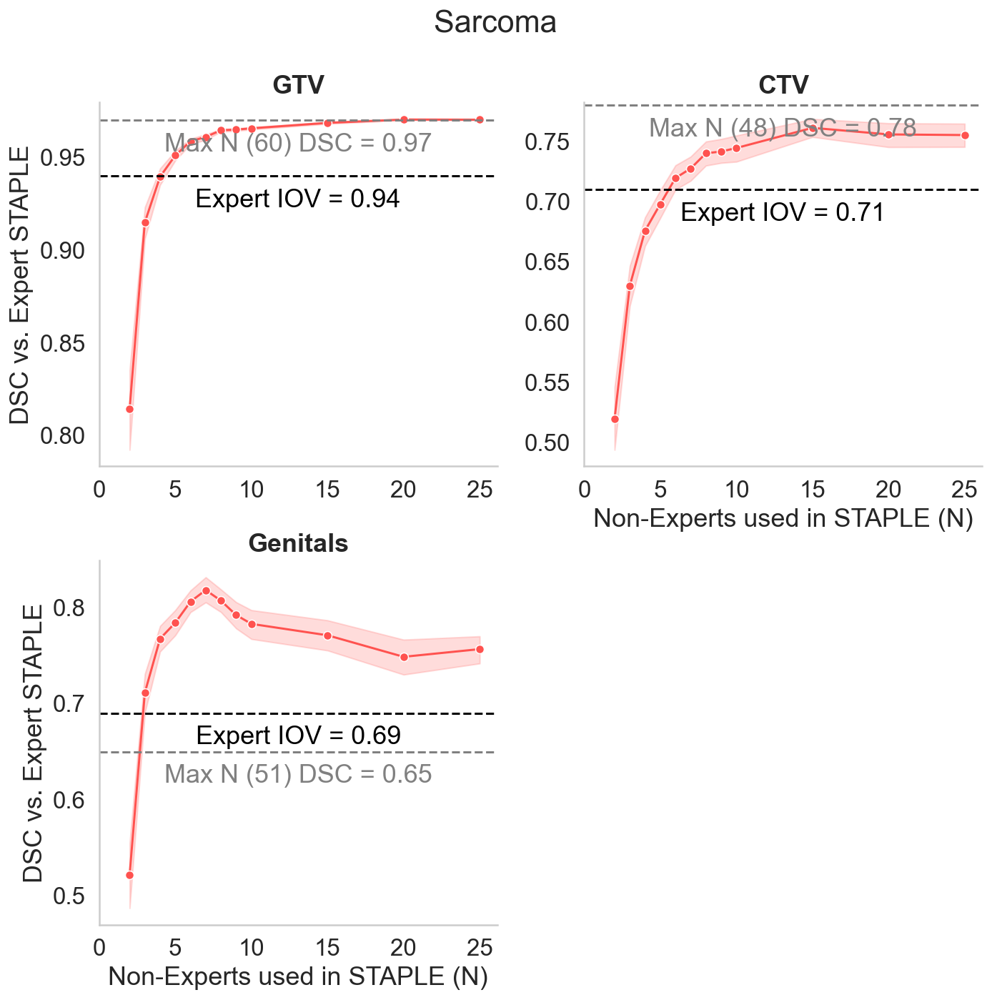

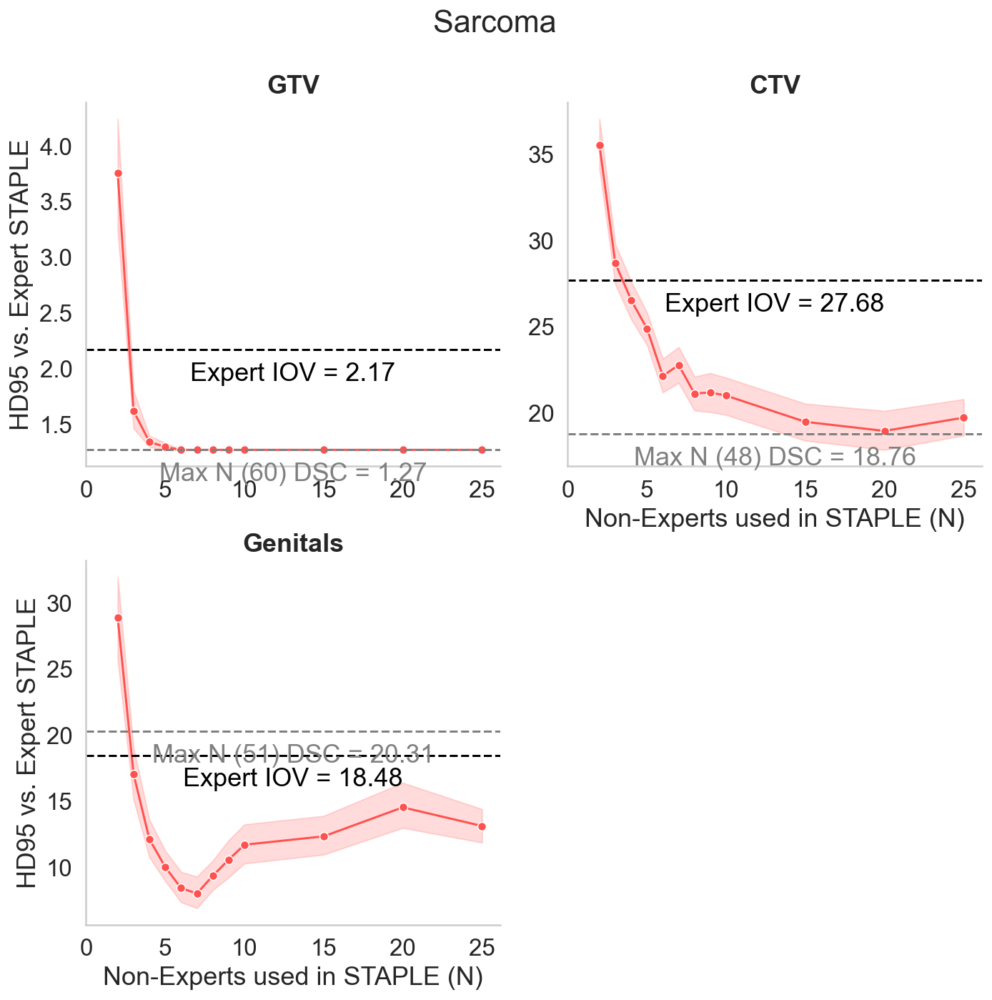

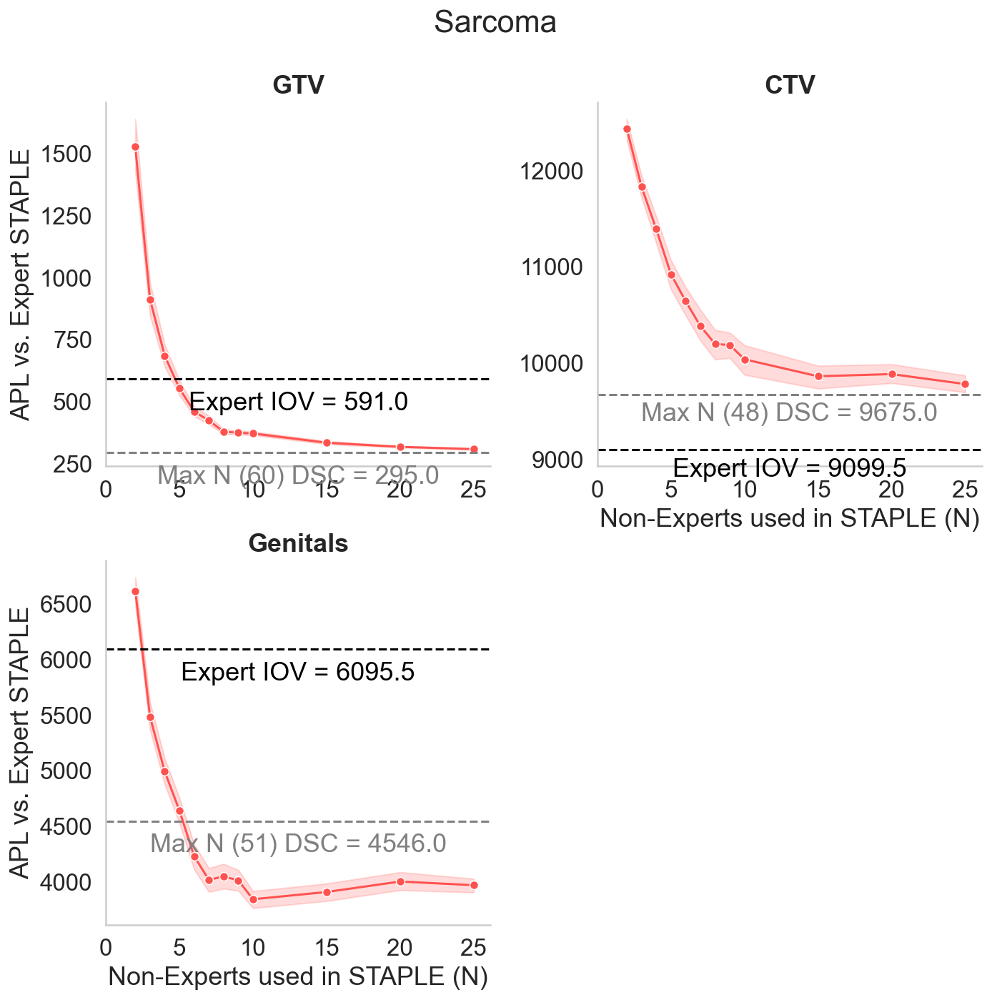

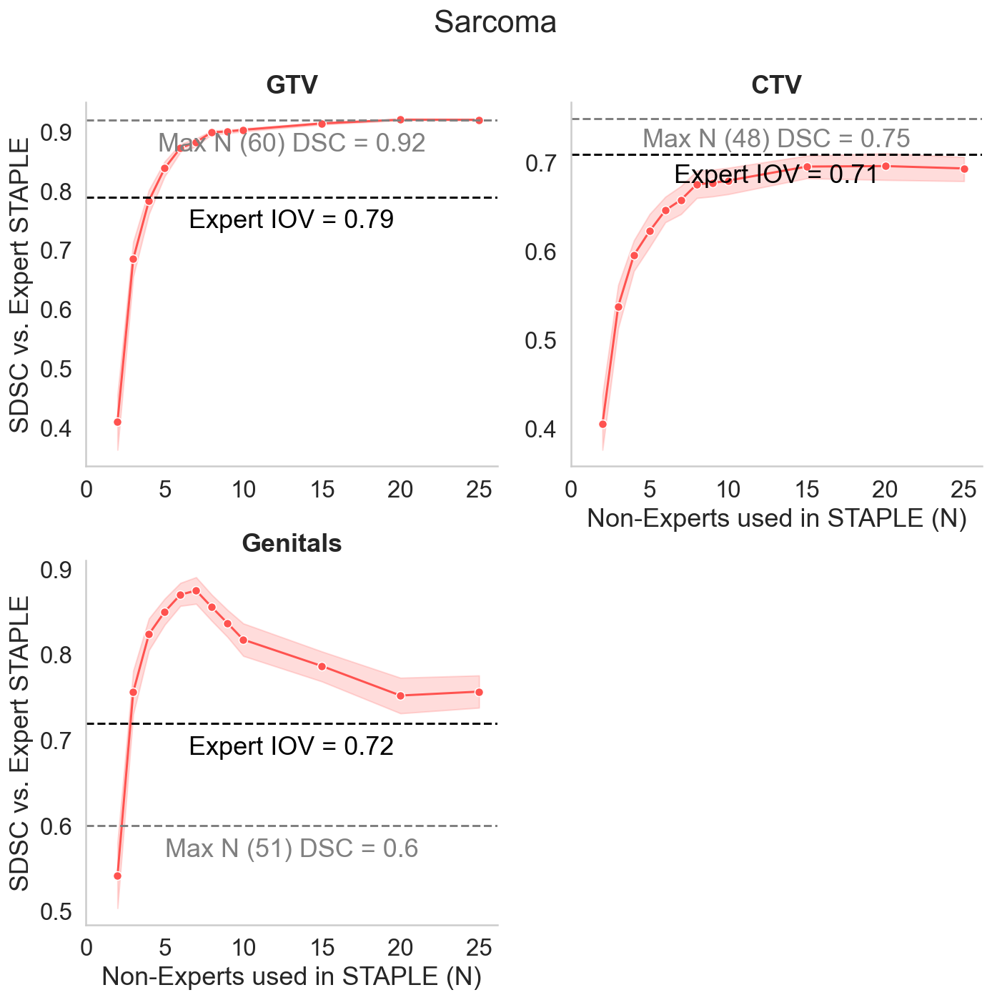

In [121]:
# TG-263 names 
ROI_dictionary = {ROI1: ROI2 for ROI1, ROI2 in zip(ROI_list, labels)}

metric_list = ["DSC_list", "HD95_list", "APL_list", "SDSC_list"]

for metric, line_dict, line_dict_maxSTAPLE in zip(metric_list, line_dict_list, line_dict_maxSTAPLE_list): # line dict defined before 
    print(metric)

    g = sns.relplot(
        data=df4_new, x="N", y=metric,
        col="ROI",
        kind="line",
        col_wrap = 2,
        facet_kws={'sharey': False, 'sharex': False},
        col_order = ROI_list, # only needed if in wrong order
        **{'marker': 'o', "err_style": 'band'}
    )

    g.set_axis_labels("Non-Experts used in STAPLE (N)", metric.split('_')[0]+" vs. Expert STAPLE")
    
    g.fig.suptitle('Sarcoma')


    # flatten axes into a 1-d array
    axes = g.axes.flatten()

    # iterate through the axes
    
    for ROI, ax in zip(ROI_list, axes):

        ax.set_title(ROI_dictionary[ROI], fontdict={'fontweight':'bold'}) # TG-263 names 

        ax.set_xticks([0, 5, 10, 15, 20, 25])

        ymin, ymax = ax.get_ylim()

        xmin, xmax = ax.get_xlim()

        x_middle = (xmax-xmin)/2

        y_nudge = (ymax-ymin)/15

        value = float("{:.2f}".format(line_dict[ROI]))
        ax.axhline(value, ls='--', c='black')    
        ax.text(x_middle, value-y_nudge, "Expert IOV = " + str(value), c='black', horizontalalignment='center', verticalalignment='center')

        novice_n = df3[(df3['Class'] == "Non-Expert") & (df3['ROI'] == ROI)]['N'].values[0]

        value_maxSTAPLE = float("{:.2f}".format(line_dict_maxSTAPLE[ROI]))
        ax.axhline(value_maxSTAPLE, ls='--', c='gray')
        ax.text(x_middle, value_maxSTAPLE-y_nudge, "Max N (" + str(novice_n) +") DSC = " + str(value_maxSTAPLE), c='gray', horizontalalignment='center', verticalalignment='center')
    
        g.tight_layout()
        g.savefig('sarcoma_'+ metric.split('list')[0] + 'bootstrap.pdf')
        
    

Heatmap version here.

In [122]:
df4_reformated = df4_new.groupby(['ROI', 'N'], as_index=False).median()

In [123]:
df4_reformated = df4_reformated[df4_reformated['ROI'] != "skinstrip"] # remove skinstrip

In [124]:
df4_reformated 

,ROI,N,DSC_list,HD95_list,APL_list,SDSC_list
0,ctv,2,0.538565,36.055903,12640.0,0.387622
1,ctv,3,0.645750,27.852102,11925.5,0.564852
2,ctv,4,0.676966,27.150892,11503.0,0.595020
3,ctv,5,0.703836,26.212010,10898.5,0.628111
4,ctv,6,0.723874,22.570862,10713.0,0.640910
5,ctv,7,0.734184,24.217126,10567.0,0.672935
6,ctv,8,0.743566,21.379935,10372.0,0.686919
7,ctv,9,0.750230,21.342177,10283.0,0.690454
8,ctv,10,0.751536,21.642529,10244.0,0.686378
9,ctv,15,0.765644,18.822287,9984.5,0.700427


In [125]:
for index, row in df4_reformated.iterrows():
    df4_reformated.loc[index, 'DSC_norm'] = row["DSC_list"]/ line_dict_list[0][row["ROI"]]
    df4_reformated.loc[index, 'SDSC_norm'] = row["SDSC_list"]/ line_dict_list[3][row["ROI"]]

In [126]:
df4_reformated

,ROI,N,DSC_list,HD95_list,APL_list,SDSC_list,DSC_norm,SDSC_norm
0,ctv,2,0.538565,36.055903,12640.0,0.387622,0.754717,0.545677
1,ctv,3,0.645750,27.852102,11925.5,0.564852,0.904922,0.795173
2,ctv,4,0.676966,27.150892,11503.0,0.595020,0.948667,0.837642
3,ctv,5,0.703836,26.212010,10898.5,0.628111,0.986320,0.884226
4,ctv,6,0.723874,22.570862,10713.0,0.640910,1.014401,0.902244
5,ctv,7,0.734184,24.217126,10567.0,0.672935,1.028849,0.947328
6,ctv,8,0.743566,21.379935,10372.0,0.686919,1.041996,0.967013
7,ctv,9,0.750230,21.342177,10283.0,0.690454,1.051335,0.971990
8,ctv,10,0.751536,21.642529,10244.0,0.686378,1.053165,0.966252
9,ctv,15,0.765644,18.822287,9984.5,0.700427,1.072935,0.986029


In [127]:
# https://stackoverflow.com/questions/37790429/seaborn-heatmap-using-pandas-dataframe

# pivot the dataframe from long to wide form
result_DSC = df4_reformated.pivot(index='ROI', columns='N', values='DSC_norm')
result_SDSC = df4_reformated.pivot(index='ROI', columns='N', values='SDSC_norm')

In [128]:
result_DSC = result_DSC.reindex(index = ['gtv', 'ctv', 'genitalia'])
result_SDSC = result_SDSC.reindex(index = ['gtv', 'ctv', 'genitalia'])

In [129]:
result_DSC

N,2,3,4,5,6,7,8,9,10,15,20,25
ROI,,,,,,,,,,,,
gtv,0.943296,0.988857,1.010816,1.017932,1.026298,1.027789,1.030544,1.030775,1.031515,1.034638,1.036237,1.036035
ctv,0.754717,0.904922,0.948667,0.986320,1.014401,1.028849,1.041996,1.051335,1.053165,1.072935,1.081901,1.080847
genitalia,0.860594,1.034591,1.125361,1.150726,1.182809,1.200579,1.185069,1.173152,1.163344,1.143919,1.131000,1.104808


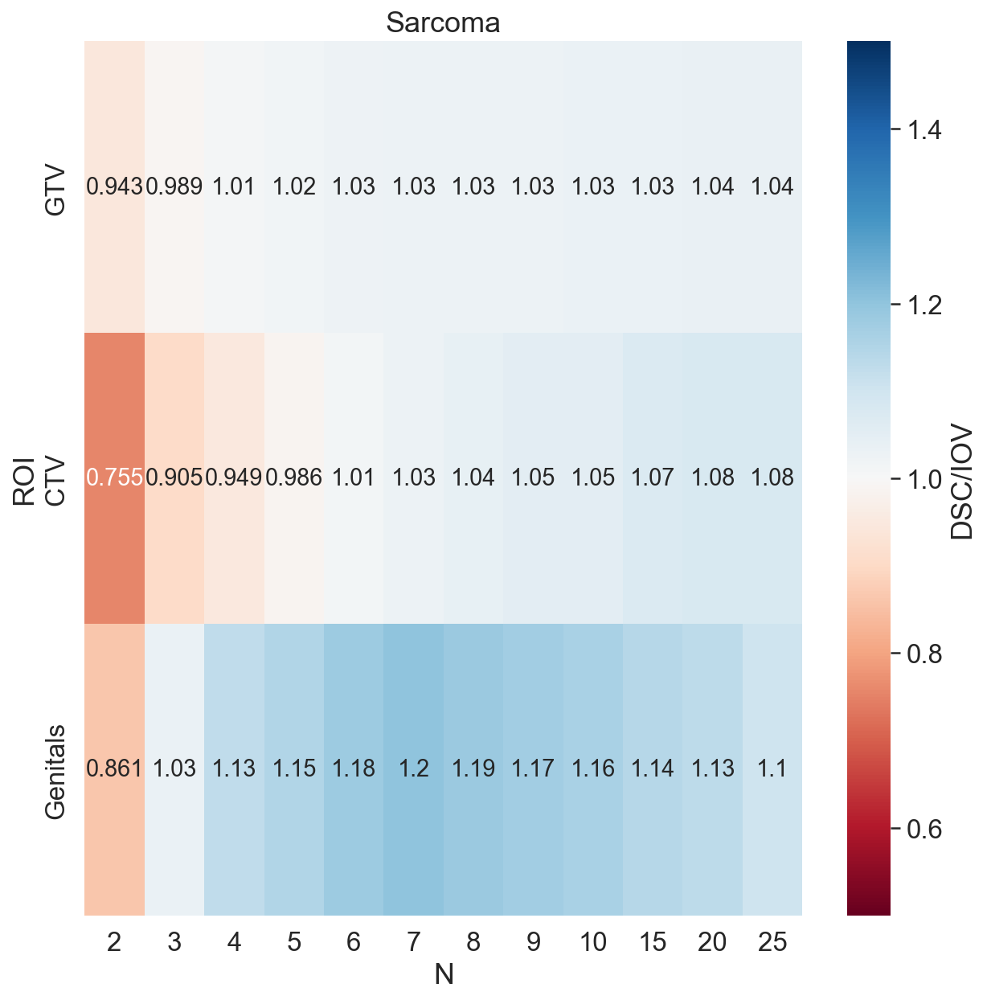

In [130]:
fig, ax = plt.subplots(figsize=(10,10))
ax = sns.heatmap(result_DSC, annot=True, fmt=".3", center=1, cmap="RdBu", 
                 vmin=0.5, vmax=1.5, 
                 cbar_kws={'label': 'DSC/IOV'},
                 annot_kws={"size": 25 / np.sqrt(len(result_DSC))})
plt.title('Sarcoma')

# TG-263 names 
labels = ['GTV', 'CTV', 'Genitals']
ax.set_yticklabels(labels)
    
plt.show()

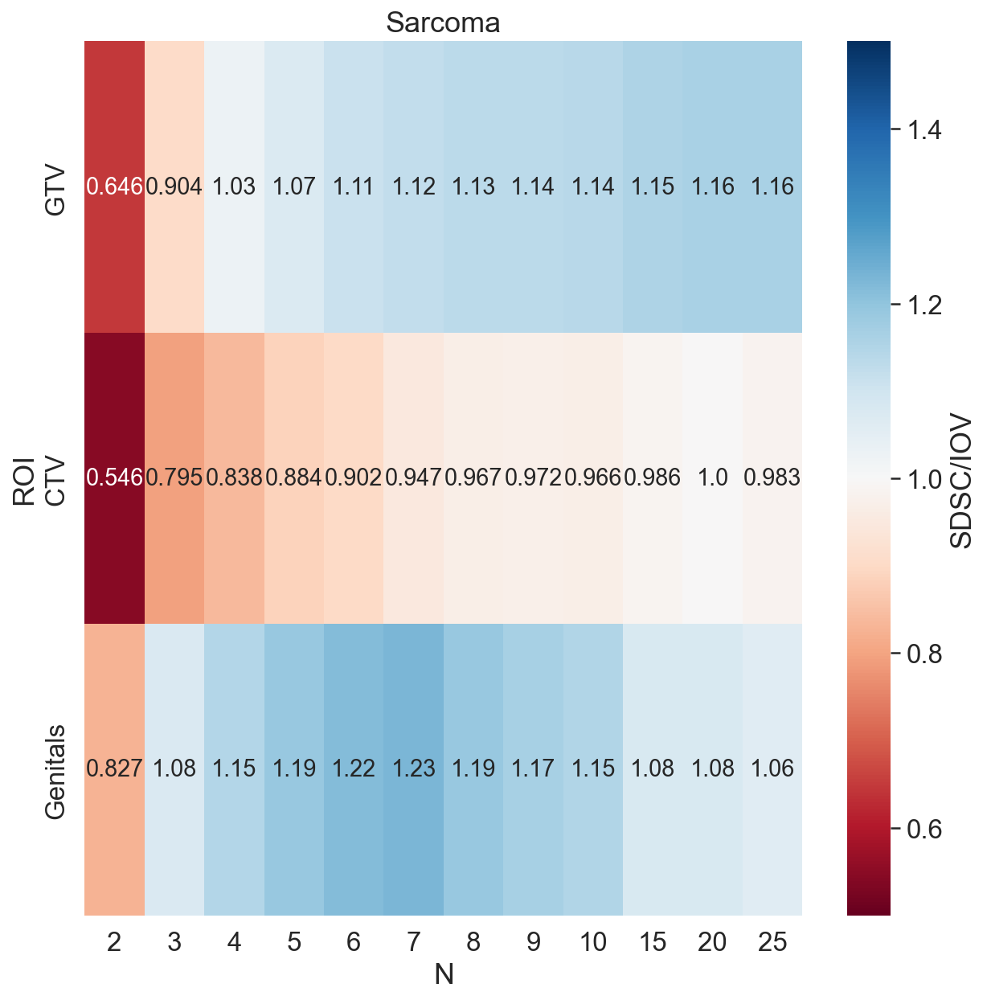

In [131]:
fig, ax = plt.subplots(figsize=(10,10))
ax = sns.heatmap(result_SDSC, annot=True, fmt=".3", center=1, cmap="RdBu", 
                 vmin=0.5, vmax=1.5, 
                 cbar_kws={'label': 'SDSC/IOV'},
                 annot_kws={"size": 25 / np.sqrt(len(result_SDSC))})
plt.title('Sarcoma')

# TG-263 names 
labels = ['GTV', 'CTV', 'Genitals']
ax.set_yticklabels(labels)

plt.show()

## Part 3: Head and Neck

### Image Processing

In [132]:
# first make folders based on structure files and populate with copies of CT image 

In [6]:
base_path = "Case 03 (H&N)"

In [179]:
in_path = os.path.join(base_path, "Structure Sets")
out_path = os.path.join(base_path, "Combined_structure_CT_DICOM")

if not os.path.isdir(out_path): # make directory if it does not exist 
    os.mkdir(out_path)

In [180]:
%%time 

structure_files = os.listdir(in_path)
for structure_file in structure_files:
    print(structure_file)
    
    structure_file_path = os.path.join(in_path, structure_file)
    
    output_folder = os.path.join(out_path, structure_file.split('.')[0])
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
        
    structure_file_path_out = os.path.join(output_folder, structure_file)
        
    shutil.copy(structure_file_path, structure_file_path_out)
    
    CT_path = os.path.join(base_path, "CT Images")
    
    CT_files = os.listdir(CT_path)
    
    for CT_file in CT_files:
        CT_file_path = os.path.join(CT_path, CT_file)
        CT_file_path_out = os.path.join(output_folder, CT_file)
        
        shutil.copy(CT_file_path, CT_file_path_out)

RTSS_002__row0002.dcm
RTSS_011__row0011.dcm
RTSS_017__row0017.dcm
RTSS_018__row0018.dcm
RTSS_027__row0027.dcm
RTSS_031__row0031.dcm
RTSS_032__row0032.dcm
RTSS_034__row0034.dcm
RTSS_046__row0046.dcm
RTSS_048__row0048.dcm
RTSS_059__row0059.dcm
RTSS_099__row0099.dcm
RTSS_1000_row1000.dcm
RTSS_128__row0128.dcm
RTSS_146__row0146.dcm
RTSS_148__row0148.dcm
RTSS_161__row0161.dcm
RTSS_165__row0165.dcm
RTSS_177__row0177.dcm
RTSS_182__row0182.dcm
RTSS_186__row0186.dcm
RTSS_199__row0199.dcm
RTSS_247__row0247.dcm
RTSS_292__row0292.dcm
RTSS_297__row0297.dcm
RTSS_299__row0299.dcm
RTSS_304__row0304.dcm
RTSS_344__row0344.dcm
RTSS_362__row0362.dcm
RTSS_384__row0384.dcm
RTSS_386__row0386.dcm
RTSS_412__row0412.dcm
RTSS_418__row0418.dcm
RTSS_420__row0420.dcm
RTSS_451__row0451.dcm
RTSS_472__row0472.dcm
RTSS_519__row0519.dcm
RTSS_539__row0539.dcm
RTSS_592__row0592.dcm
RTSS_597__row0597.dcm
RTSS_603__row0603.dcm
RTSS_630__row0630.dcm
RTSS_631__row0631.dcm
RTSS_641__row0641.dcm
RTSS_645__row0645.dcm
RTSS_716__

In [181]:
# convert structures to nifti 

In [182]:
input_path =  os.path.join(base_path, "Combined_structure_CT_DICOM")
output_path = os.path.join(base_path, "structures_nifti")

if not os.path.isdir(output_path): # make directory if it does not exist 
    os.mkdir(output_path)

In [183]:
%%time
for folder in os.listdir(input_path):
    print(folder)
    folder_path = os.path.join(input_path, folder)
    print(folder_path)
    Dicom_reader = DicomReaderWriter(description='Examples', series_instances_dictionary = {}) # instantiate
    Dicom_reader.walk_through_folders(folder_path)
    all_rois = Dicom_reader.return_rois(print_rois=False)
    print(all_rois)
    
    output_path_folder = os.path.join(output_path, folder)
    if not os.path.isdir(output_path_folder): 
        os.mkdir(output_path_folder)
        
    for roi in all_rois:
        print(roi)
        Contour_Names = [roi] 
        Dicom_reader.set_contour_names_and_associations(Contour_Names=Contour_Names)
        try:
            Dicom_reader.get_images_and_mask()
            mask = Dicom_reader.mask # mask array
            mask_sitk_handle = Dicom_reader.annotation_handle # SimpleITK mask handle
            sitk.WriteImage(mask_sitk_handle, os.path.join(output_path_folder, roi+'.nii.gz'))
        except: 
            print("PROBLEM WITH", folder, roi)

Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_002__row0002
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_002__row0002
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_002__row0002


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.01it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_002__row0002
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_002__row0002



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.76s/it]

ctv1


ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_011__row0011
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_011__row0011
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_011__row0011


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.29it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_011__row0011
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_011__row0011



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.69s/it]


ctv1
PROBLEM WITH RTSS_011__row0011 ctv1
ctv2
PROBLEM WITH RTSS_011__row0011 ctv2
gtvn
gtvp
PROBLEM WITH RTSS_011__row0011 gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
PROBLEM WITH RTSS_011__row0011 musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_017__row0017
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_017__row0017
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_017__row0017


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.30it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_017__row0017
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp +n', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_017__row0017



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.66s/it]


ctv1
PROBLEM WITH RTSS_017__row0017 ctv1
ctv2
gtvn
gtvp +n
gtvp
glnd_submand_l
glnd_submand_r
PROBLEM WITH RTSS_017__row0017 glnd_submand_r
larynx
musc_constrict_all
PROBLEM WITH RTSS_017__row0017 musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_018__row0018
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_018__row0018
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_018__row0018


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.33it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_018__row0018
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_018__row0018



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.43s/it]

ctv1


ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
PROBLEM WITH RTSS_018__row0018 glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_027__row0027
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_027__row0027
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_027__row0027


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.34it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_027__row0027
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_027__row0027



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.43s/it]

ctv1
PROBLEM WITH RTSS_027__row0027 ctv1
ctv2
PROBLEM WITH RTSS_027__row0027 ctv2
gtvn


gtvp
glnd_submand_l
PROBLEM WITH RTSS_027__row0027 glnd_submand_l
glnd_submand_r
PROBLEM WITH RTSS_027__row0027 glnd_submand_r
larynx
musc_constrict_all
PROBLEM WITH RTSS_027__row0027 musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_031__row0031
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_031__row0031
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_031__row0031


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.30it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_031__row0031
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_031__row0031



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.67s/it]


ctv1
ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_032__row0032
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_032__row0032
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_032__row0032


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.29it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_032__row0032
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_032__row0032

ctv1


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.58s/it]


ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_034__row0034
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_034__row0034
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_034__row0034


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.34it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_034__row0034
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_034__row0034



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.49s/it]

ctv1


ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
PROBLEM WITH RTSS_034__row0034 larynx
musc_constrict_all
PROBLEM WITH RTSS_034__row0034 musc_constrict_all
parotid_l
PROBLEM WITH RTSS_034__row0034 parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

PROBLEM WITH RTSS_034__row0034 parotid_r
RTSS_046__row0046
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_046__row0046
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_046__row0046


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.34it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_046__row0046
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_046__row0046



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.74s/it]

PROBLEM WITH RTSS_046__row0046 brainstem
ctv1


ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_048__row0048
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_048__row0048
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_048__row0048


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.31it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_048__row0048
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_048__row0048



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.56s/it]

ctv1


ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_059__row0059
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_059__row0059
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_059__row0059


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.20it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_059__row0059
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv help', 'ctv1', 'ctv2', 'ctv2 dx', 'ctv2 sin', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_059__row0059



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.76s/it]


ctv help
ctv1
ctv2
ctv2 dx
ctv2 sin
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_099__row0099
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_099__row0099
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_099__row0099


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.28it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_099__row0099
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_099__row0099



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.71s/it]


ctv1
ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_1000_row1000
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_1000_row1000
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_1000_row1000


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.38it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_1000_row1000
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_1000_row1000



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.50s/it]


ctv1
PROBLEM WITH RTSS_1000_row1000 ctv1
ctv2
PROBLEM WITH RTSS_1000_row1000 ctv2
gtvn
PROBLEM WITH RTSS_1000_row1000 gtvn
gtvp
PROBLEM WITH RTSS_1000_row1000 gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_128__row0128
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_128__row0128
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_128__row0128


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.28it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_128__row0128
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_128__row0128



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.56s/it]

ctv1


ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_146__row0146
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_146__row0146
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_146__row0146


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.38it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_146__row0146
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_146__row0146



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.51s/it]


ctv1
PROBLEM WITH RTSS_146__row0146 ctv1
ctv2
PROBLEM WITH RTSS_146__row0146 ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

parotid_l
PROBLEM WITH RTSS_146__row0146 parotid_l
parotid_r
PROBLEM WITH RTSS_146__row0146 parotid_r
RTSS_148__row0148
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_148__row0148
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_148__row0148


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.30it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_148__row0148
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'ctvn', 'ctvp', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r', 'xctv2_l', 'xctv2_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_148__row0148



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.69s/it]

PROBLEM WITH RTSS_148__row0148 brainstem
ctv1


ctv2
ctvn
ctvp
gtvn
gtvp
glnd_submand_l
PROBLEM WITH RTSS_148__row0148 glnd_submand_l
glnd_submand_r
PROBLEM WITH RTSS_148__row0148 glnd_submand_r
larynx
PROBLEM WITH RTSS_148__row0148 larynx
musc_constrict_all
PROBLEM WITH RTSS_148__row0148 musc_constrict_all
parotid_l
PROBLEM WITH RTSS_148__row0148 parotid_l
parotid_r
PROBLEM WITH RTSS_148__row0148 parotid_r
xctv2_l
xctv2_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_161__row0161
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_161__row0161
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_161__row0161


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.33it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_161__row0161
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_161__row0161

ctv1


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.63s/it]


ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_165__row0165
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_165__row0165
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_165__row0165


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.33it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_165__row0165
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv primary', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_165__row0165



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.65s/it]


ctv primary
ctv1
PROBLEM WITH RTSS_165__row0165 ctv1
ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_177__row0177
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_177__row0177
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_177__row0177


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.34it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_177__row0177
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_177__row0177



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.43s/it]

ctv1


ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
PROBLEM WITH RTSS_177__row0177 larynx
musc_constrict_all
PROBLEM WITH RTSS_177__row0177 musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_182__row0182
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_182__row0182
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_182__row0182


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.36it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_182__row0182
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_182__row0182

ctv1


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.52s/it]


ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_186__row0186
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_186__row0186
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_186__row0186


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.35it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_186__row0186
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_186__row0186

PROBLEM WITH RTSS_186__row0186 brainstem
ctv1


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.77s/it]


ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
PROBLEM WITH RTSS_186__row0186 musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_199__row0199
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_199__row0199
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_199__row0199


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.20it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_199__row0199
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_199__row0199



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.67s/it]

ctv1


ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_247__row0247
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_247__row0247
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_247__row0247


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.32it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_247__row0247
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r', 'cttvn']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_247__row0247



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.60s/it]

ctv1


ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r
cttvn


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_292__row0292
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_292__row0292
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_292__row0292


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.38it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_292__row0292
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_292__row0292



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.55s/it]

ctv1


ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_297__row0297
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_297__row0297
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_297__row0297


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.36it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_297__row0297
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv1n', 'ctv2', 'ctv2p', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_297__row0297



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.52s/it]


ctv1
PROBLEM WITH RTSS_297__row0297 ctv1
ctv1n
ctv2
PROBLEM WITH RTSS_297__row0297 ctv2
ctv2p
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_299__row0299
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_299__row0299
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_299__row0299


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.38it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_299__row0299
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_299__row0299



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.44s/it]

ctv1


ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
PROBLEM WITH RTSS_299__row0299 musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_304__row0304
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_304__row0304
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_304__row0304


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.40it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_304__row0304
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_304__row0304



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.36s/it]

ctv1
PROBLEM WITH RTSS_304__row0304 ctv1
ctv2
PROBLEM WITH RTSS_304__row0304 ctv2
gtvn


gtvp
glnd_submand_l
glnd_submand_r
larynx
PROBLEM WITH RTSS_304__row0304 larynx
musc_constrict_all
PROBLEM WITH RTSS_304__row0304 musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_344__row0344
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_344__row0344
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_344__row0344


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.29it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_344__row0344
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_344__row0344



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.72s/it]


ctv1
ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_362__row0362
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_362__row0362
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_362__row0362


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.31it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_362__row0362
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'ctvn', 'ctvp', 'gtvn', 'gtvp', "glnd_submand_l'", "glnd_submand_r'", 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_362__row0362



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.53s/it]

ctv1


ctv2
ctvn
ctvp
gtvn
gtvp
glnd_submand_l'
glnd_submand_r'
larynx
musc_constrict_all
PROBLEM WITH RTSS_362__row0362 musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_384__row0384
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_384__row0384
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_384__row0384


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.37it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_384__row0384
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_384__row0384



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.63s/it]


ctv1
ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_386__row0386
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_386__row0386
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_386__row0386


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.33it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_386__row0386
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_386__row0386



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.69s/it]


ctv1
ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
PROBLEM WITH RTSS_386__row0386 glnd_submand_r
larynx
musc_constrict_all
PROBLEM WITH RTSS_386__row0386 musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_412__row0412
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_412__row0412
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_412__row0412


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.37it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_412__row0412
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2 hr', 'ctv2 lr', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_412__row0412



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.57s/it]

ctv1


ctv2 hr
ctv2 lr
gtvn
PROBLEM WITH RTSS_412__row0412 gtvn
gtvp
PROBLEM WITH RTSS_412__row0412 gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_418__row0418
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_418__row0418
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_418__row0418


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.33it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_418__row0418
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_418__row0418



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.78s/it]


ctv1
ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_420__row0420
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_420__row0420
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_420__row0420


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.43it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_420__row0420
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_420__row0420

ctv1
PROBLEM WITH RTSS_420__row0420 ctv1
ctv2
PROBLEM WITH RTSS_420__row0420 ctv2
gtvn
PROBLEM WITH RTSS_420__row0420 gtvn
gtvp
PROBLEM WITH RTSS_420__row0420 gtvp
glnd_submand_l
glnd_submand_r


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:04<00:00,  4.08s/it]

larynx


musc_constrict_all
PROBLEM WITH RTSS_420__row0420 musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_451__row0451
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_451__row0451
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_451__row0451


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.35it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_451__row0451
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_451__row0451

PROBLEM WITH RTSS_451__row0451 brainstem
ctv1


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.79s/it]


ctv2
gtvn
gtvp
glnd_submand_l
PROBLEM WITH RTSS_451__row0451 glnd_submand_l
glnd_submand_r
larynx
PROBLEM WITH RTSS_451__row0451 larynx
musc_constrict_all
PROBLEM WITH RTSS_451__row0451 musc_constrict_all
parotid_l
PROBLEM WITH RTSS_451__row0451 parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

PROBLEM WITH RTSS_451__row0451 parotid_r
RTSS_472__row0472
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_472__row0472
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_472__row0472


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.23it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_472__row0472
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv hr', 'ctv ir', 'ctv lr', 'ctv1', 'ctv2', 'ctvilr', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_472__row0472



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.55s/it]

ctv hr


ctv ir
ctv lr
ctv1
ctv2
ctvilr
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_519__row0519
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_519__row0519
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_519__row0519


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.28it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_519__row0519
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv interl', 'ctv1', 'ctv2', 'ctvinterr', 'ctvn_70', 'ctvn_inter', 'ctvp_70', 'ctvp_inter', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_519__row0519



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.81s/it]


ctv interl
ctv1
ctv2
ctvinterr
ctvn_70
ctvn_inter
ctvp_70
ctvp_inter
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
PROBLEM WITH RTSS_519__row0519 musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_539__row0539
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_539__row0539
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_539__row0539


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.30it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_539__row0539
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'ctvn', 'ctvp', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_539__row0539



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.71s/it]


ctv1
PROBLEM WITH RTSS_539__row0539 ctv1
ctv2
PROBLEM WITH RTSS_539__row0539 ctv2
ctvn
ctvp
gtvn
gtvp
glnd_submand_l
PROBLEM WITH RTSS_539__row0539 glnd_submand_l
glnd_submand_r
PROBLEM WITH RTSS_539__row0539 glnd_submand_r
larynx
musc_constrict_all
PROBLEM WITH RTSS_539__row0539 musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_592__row0592
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_592__row0592
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_592__row0592


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.30it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_592__row0592
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv2', 'ctv3', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_592__row0592



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.64s/it]


ctv2
ctv3
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_597__row0597
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_597__row0597
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_597__row0597


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.32it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_597__row0597
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctvn 54', 'ctvn 60', 'ctvp60', 'gtvn 70', 'gtvp 70', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_597__row0597



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.51s/it]

ctvn 54


ctvn 60
ctvp60
gtvn 70
gtvp 70
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
PROBLEM WITH RTSS_597__row0597 musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_603__row0603
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_603__row0603
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_603__row0603


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.31it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_603__row0603
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_603__row0603



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.66s/it]


ctv1
ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_630__row0630
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_630__row0630
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_630__row0630


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.24it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_630__row0630
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'ctvnhighrisk', 'ctvp', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_630__row0630



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.79s/it]


ctv1
ctv2
ctvnhighrisk
ctvp
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_631__row0631
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_631__row0631
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_631__row0631


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.16it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_631__row0631
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv 1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_631__row0631



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.72s/it]

ctv 1


ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_641__row0641
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_641__row0641
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_641__row0641


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.37it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_641__row0641
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_641__row0641



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.52s/it]


ctv1
ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_645__row0645
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_645__row0645
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_645__row0645


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.30it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_645__row0645
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv1n ok', 'ctv1p ok', 'ctv2', 'ctv2 cl', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r', 'spinal cord']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_645__row0645



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.47s/it]

ctv1


ctv1n ok
ctv1p ok
ctv2
ctv2 cl
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
PROBLEM WITH RTSS_645__row0645 musc_constrict_all
parotid_l
parotid_r
spinal cord


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_716__row0716
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_716__row0716
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_716__row0716


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.26it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_716__row0716
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv 56', 'ctv 63', 'ctv 70', 'ctv1', 'ctv2', 'ctvn', 'ctvp', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'medula', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_716__row0716



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.60s/it]

ctv 56


ctv 63
ctv 70
ctv1
PROBLEM WITH RTSS_716__row0716 ctv1
ctv2
PROBLEM WITH RTSS_716__row0716 ctv2
ctvn
ctvp
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
medula
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_727__row0727
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_727__row0727
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_727__row0727


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.25it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_727__row0727
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r', 'placeholder_gtvn+0.5cm', 'placeholder_gtvn+1.0cm', 'placeholder_gtvp_0.5cm', 'placeholder_gtvp_1.0cm']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_727__row0727



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.81s/it]


ctv1
ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r
placeholder_gtvn+0.5cm
placeholder_gtvn+1.0cm
placeholder_gtvp_0.5cm
placeholder_gtvp_1.0cm


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_728__row0728
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_728__row0728
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_728__row0728


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.42it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_728__row0728
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_728__row0728



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.46s/it]


ctv1
PROBLEM WITH RTSS_728__row0728 ctv1
ctv2
PROBLEM WITH RTSS_728__row0728 ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
PROBLEM WITH RTSS_728__row0728 glnd_submand_r
larynx
musc_constrict_all
PROBLEM WITH RTSS_728__row0728 musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_770__row0770
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_770__row0770
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_770__row0770


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.43it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_770__row0770
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_770__row0770



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.47s/it]


ctv1
PROBLEM WITH RTSS_770__row0770 ctv1
ctv2
PROBLEM WITH RTSS_770__row0770 ctv2
gtvn
PROBLEM WITH RTSS_770__row0770 gtvn
gtvp
PROBLEM WITH RTSS_770__row0770 gtvp
glnd_submand_l
glnd_submand_r
larynx
PROBLEM WITH RTSS_770__row0770 larynx
musc_constrict_all
PROBLEM WITH RTSS_770__row0770 musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_791__row0791
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_791__row0791
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_791__row0791


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.29it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_791__row0791
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'ctv_n1', 'ctv_n2', 'ctv_p1', 'ctv_p2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_791__row0791



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.76s/it]


ctv1
ctv2
ctv_n1
ctv_n2
ctv_p1
ctv_p2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_792__row0792
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_792__row0792
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_792__row0792


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.34it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_792__row0792
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv 1', 'ctv2', 'ctvn', 'ctvp', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_792__row0792



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.74s/it]

ctv 1


ctv2
ctvn
ctvp
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_794__row0794
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_794__row0794
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_794__row0794


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.15it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_794__row0794
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'ctvn', 'ctvp', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_794__row0794



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.87s/it]


ctv1
ctv2
ctvn
ctvp
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_797__row0797
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_797__row0797
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_797__row0797


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.46it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_797__row0797
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_797__row0797



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.49s/it]

PROBLEM WITH RTSS_797__row0797 brainstem
ctv1
PROBLEM WITH RTSS_797__row0797 ctv1
ctv2
PROBLEM WITH RTSS_797__row0797 ctv2
gtvn



Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

gtvp
PROBLEM WITH RTSS_797__row0797 gtvp
glnd_submand_l
PROBLEM WITH RTSS_797__row0797 glnd_submand_l
glnd_submand_r
PROBLEM WITH RTSS_797__row0797 glnd_submand_r
larynx
PROBLEM WITH RTSS_797__row0797 larynx
musc_constrict_all
PROBLEM WITH RTSS_797__row0797 musc_constrict_all
parotid_l
PROBLEM WITH RTSS_797__row0797 parotid_l
parotid_r
PROBLEM WITH RTSS_797__row0797 parotid_r
RTSS_799__row0799
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_799__row0799
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_799__row0799


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.40it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_799__row0799
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_799__row0799



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.73s/it]

PROBLEM WITH RTSS_799__row0799 brainstem
ctv1


ctv2
gtvn
gtvp
glnd_submand_l
PROBLEM WITH RTSS_799__row0799 glnd_submand_l
glnd_submand_r
PROBLEM WITH RTSS_799__row0799 glnd_submand_r
larynx
PROBLEM WITH RTSS_799__row0799 larynx
musc_constrict_all
PROBLEM WITH RTSS_799__row0799 musc_constrict_all
parotid_l
PROBLEM WITH RTSS_799__row0799 parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

PROBLEM WITH RTSS_799__row0799 parotid_r
RTSS_809__row0809
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_809__row0809
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_809__row0809


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.43it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_809__row0809
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_809__row0809



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.58s/it]


ctv1
PROBLEM WITH RTSS_809__row0809 ctv1
ctv2
PROBLEM WITH RTSS_809__row0809 ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_866__row0866
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_866__row0866
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_866__row0866


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.24it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_866__row0866
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'ctvn', 'ctvn+', 'ctvp', 'ctvp2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_866__row0866

PROBLEM WITH RTSS_866__row0866 brainstem
ctv1


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.94s/it]


ctv2
ctvn
ctvn+
ctvp
ctvp2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_871__row0871
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_871__row0871
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_871__row0871


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.29it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_871__row0871
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'gland_submand_l', 'gland_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_871__row0871



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.50s/it]

ctv1


ctv2
gtvn
gtvp
gland_submand_l
gland_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_885__row0885
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_885__row0885
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_885__row0885


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.03it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_885__row0885
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvn+p', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_885__row0885

ctv1


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.14s/it]


ctv2
gtvn
gtvn+p
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_886__row0886
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_886__row0886
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_886__row0886


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.27it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_886__row0886
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'ctvn', 'ctvp', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_886__row0886

ctv1


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.68s/it]


ctv2
ctvn
ctvp
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
PROBLEM WITH RTSS_886__row0886 musc_constrict_all
parotid_l


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

parotid_r
PROBLEM WITH RTSS_886__row0886 parotid_r
RTSS_897__row0897
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_897__row0897
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_897__row0897


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.39it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_897__row0897
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_897__row0897



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.50s/it]


ctv1
PROBLEM WITH RTSS_897__row0897 ctv1
ctv2
PROBLEM WITH RTSS_897__row0897 ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_910__row0910
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_910__row0910
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_910__row0910


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.14it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_910__row0910
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_910__row0910



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.57s/it]

ctv1


ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_916__row0916
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_916__row0916
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_916__row0916


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.29it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_916__row0916
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_916__row0916



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.56s/it]

ctv1


ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
PROBLEM WITH RTSS_916__row0916 glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_919__row0919
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_919__row0919
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_919__row0919


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.26it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_919__row0919
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_919__row0919



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.71s/it]


ctv1
ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
PROBLEM WITH RTSS_919__row0919 glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_932__row0932
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_932__row0932
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_932__row0932


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.22it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_932__row0932
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2_contra_sp', 'ctv2_ipsi', 'ctv_contra_bot', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_932__row0932



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.62s/it]

ctv1


ctv2_contra_sp
ctv2_ipsi
ctv_contra_bot
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
PROBLEM WITH RTSS_932__row0932 larynx
musc_constrict_all
PROBLEM WITH RTSS_932__row0932 musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_935__row0935
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_935__row0935
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_935__row0935


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.19s/it]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_935__row0935
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['atm derecha', 'anillo 56', 'anillo 70', 'body', 'brainstem', 'ctv2', 'ctvn_high', 'ctvp_high', 'couchinterior', 'couchsurface', 'esophagus', 'gtvn', 'gtvp', 'glnd_submand_l', 'larynx', 'musc_constrict_all', 'ns_artifact', 'ns_ring', 'pintar aux', 'ptv_56', 'ptv_56 real', 'ptv_56exp', 'ptv_70', 'ptv_70exp', 'parotid_l', 'parotid_r', 'pintar artef', 'r cochlea', 'thyroid', 'c', 'c2', 'c3', 'mandible', 'oral cavity', 'prv medula', 'spinal cord']
atm derecha
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_935__row0935



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.27s/it]


anillo 56
anillo 70
body
brainstem
ctv2
ctvn_high
ctvp_high
couchinterior
couchsurface
esophagus
gtvn
gtvp
glnd_submand_l
larynx
musc_constrict_all
ns_artifact
ns_ring
pintar aux
ptv_56
ptv_56 real
ptv_56exp
ptv_70
ptv_70exp
parotid_l
parotid_r
pintar artef
r cochlea
thyroid
c
c2
c3
mandible
oral cavity
prv medula
spinal cord


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_936__row0936
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_936__row0936
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_936__row0936


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.23it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_936__row0936
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvn_05', 'gtvp', 'gtvp_05', 'gtvp_10', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_936__row0936



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.76s/it]


ctv1
ctv2
gtvn
gtvn_05
gtvp
gtvp_05
gtvp_10
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_938__row0938
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_938__row0938
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_938__row0938


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.25it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_938__row0938
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv_5600_l_ib', 'ctv_5600_l_rp', 'ctv_5600_l_va', 'ctv_5600_r_ib', 'ctv_5600_r_rp', 'ctv_5600_r_va', 'ctv_5950_left', 'ctv_5950_right', 'ctvn_7000=gtvn_l+5mm', 'ctvn_7000=gtvn_r+5mm', 'ctvp_7000=gtvp+5mm', 'gtvn_l', 'gtvn_r', 'gtvp', 'gtvp+10mm', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_938__row0938



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.59s/it]

ctv1
PROBLEM WITH RTSS_938__row0938 ctv1
ctv_5600_l_ib


ctv_5600_l_rp
ctv_5600_l_va
ctv_5600_r_ib
ctv_5600_r_rp
ctv_5600_r_va
ctv_5950_left
ctv_5950_right
ctvn_7000=gtvn_l+5mm
ctvn_7000=gtvn_r+5mm
ctvp_7000=gtvp+5mm
gtvn_l
gtvn_r
gtvp
gtvp+10mm
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_942__row0942
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_942__row0942
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_942__row0942


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.38it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_942__row0942
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_942__row0942



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.55s/it]


PROBLEM WITH RTSS_942__row0942 brainstem
ctv1
ctv2
gtvn
gtvp
glnd_submand_l
PROBLEM WITH RTSS_942__row0942 glnd_submand_l
glnd_submand_r
PROBLEM WITH RTSS_942__row0942 glnd_submand_r
larynx
PROBLEM WITH RTSS_942__row0942 larynx
musc_constrict_all
PROBLEM WITH RTSS_942__row0942 musc_constrict_all
parotid_l
PROBLEM WITH RTSS_942__row0942 parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

PROBLEM WITH RTSS_942__row0942 parotid_r
RTSS_944__row0944
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_944__row0944
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_944__row0944


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.33it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_944__row0944
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv1n', 'ctv1p', 'ctv2', 'ctv2n', 'ctv2p', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_944__row0944



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.50s/it]

ctv1
PROBLEM WITH RTSS_944__row0944 ctv1
ctv1n


ctv1p
ctv2
PROBLEM WITH RTSS_944__row0944 ctv2
ctv2n
ctv2p
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_945__row0945
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_945__row0945
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_945__row0945


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.28it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_945__row0945
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r', 'combined gtv']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_945__row0945



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.54s/it]

ctv1


ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r
combined gtv


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_947__row0947
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_947__row0947
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_947__row0947


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.36it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_947__row0947
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_947__row0947



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.71s/it]


ctv1
ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_948__row0948
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_948__row0948
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_948__row0948


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.23it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_948__row0948
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1_n1', 'ctv1_n2', 'ctv1_n3', 'ctv1_p', 'ctv2_n_l', 'ctv2_n_r', 'ctv2_p', 'gtvn1', 'gtvn2', 'gtvn3', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_948__row0948



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.61s/it]

ctv1_n1


ctv1_n2
ctv1_n3
ctv1_p
ctv2_n_l
ctv2_n_r
ctv2_p
gtvn1
gtvn2
gtvn3
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_949__row0949
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_949__row0949
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_949__row0949


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.22it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_949__row0949
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtv total', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_949__row0949

PROBLEM WITH RTSS_949__row0949 brainstem
ctv1


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.93s/it]


ctv2
gtv total
gtvn
gtvp
glnd_submand_l
PROBLEM WITH RTSS_949__row0949 glnd_submand_l
glnd_submand_r
PROBLEM WITH RTSS_949__row0949 glnd_submand_r
larynx


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

PROBLEM WITH RTSS_949__row0949 larynx
musc_constrict_all
PROBLEM WITH RTSS_949__row0949 musc_constrict_all
parotid_l
PROBLEM WITH RTSS_949__row0949 parotid_l
parotid_r
PROBLEM WITH RTSS_949__row0949 parotid_r
RTSS_953__row0953
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_953__row0953
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_953__row0953


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.25it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_953__row0953
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r', 'refctv1n-auto', 'refctv1p-auto', 'refctv2-part1', 'refctv2n-auto', 'refctv2p-auto', 'refctv_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_953__row0953



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.81s/it]


ctv1
ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r
refctv1n-auto
refctv1p-auto
refctv2-part1
refctv2n-auto
refctv2p-auto
refctv_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_955__row0955
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_955__row0955
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_955__row0955


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.29it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_955__row0955
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_955__row0955



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.69s/it]


ctv1
ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
PROBLEM WITH RTSS_955__row0955 musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_959__row0959
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_959__row0959
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_959__row0959


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.29it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_959__row0959
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'ctvp', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r', 'ctvn']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_959__row0959



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.49s/it]

ctv1


ctv2
ctvp
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r
ctvn


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_960__row0960
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_960__row0960
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_960__row0960


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.30it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_960__row0960
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'ctv_n_hr', 'ctv_n_lr', 'ctv_p1', 'ctv_p2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_960__row0960



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.72s/it]


ctv1
PROBLEM WITH RTSS_960__row0960 ctv1
ctv2
PROBLEM WITH RTSS_960__row0960 ctv2
ctv_n_hr
ctv_n_lr
ctv_p1
ctv_p2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_962__row0962
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_962__row0962
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_962__row0962


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.31it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_962__row0962
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_962__row0962



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.72s/it]

PROBLEM WITH RTSS_962__row0962 brainstem
ctv1


ctv2
gtvn
gtvp
glnd_submand_l
PROBLEM WITH RTSS_962__row0962 glnd_submand_l
glnd_submand_r
PROBLEM WITH RTSS_962__row0962 glnd_submand_r
larynx
PROBLEM WITH RTSS_962__row0962 larynx
musc_constrict_all
PROBLEM WITH RTSS_962__row0962 musc_constrict_all
parotid_l


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

PROBLEM WITH RTSS_962__row0962 parotid_l
parotid_r
PROBLEM WITH RTSS_962__row0962 parotid_r
RTSS_964__row0964
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_964__row0964
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_964__row0964


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.31it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_964__row0964
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_964__row0964



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.69s/it]


ctv1
ctv2
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_973__row0973
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_973__row0973
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_973__row0973


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.37it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_973__row0973
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv2', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_973__row0973



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.50s/it]

ctv1
PROBLEM WITH RTSS_973__row0973 ctv1
ctv2
PROBLEM WITH RTSS_973__row0973 ctv2
gtvn


PROBLEM WITH RTSS_973__row0973 gtvn
gtvp
PROBLEM WITH RTSS_973__row0973 gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RTSS_994__row0994
Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_994__row0994
Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_994__row0994


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.27it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_994__row0994
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['brainstem', 'ctv1', 'ctv_4140', 'ctv_6600', 'ctvpn', 'gtvn', 'gtvp', 'glnd_submand_l', 'glnd_submand_r', 'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']
brainstem
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_994__row0994



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.76s/it]


ctv1
PROBLEM WITH RTSS_994__row0994 ctv1
ctv_4140
ctv_6600
ctvpn
gtvn
gtvp
glnd_submand_l
glnd_submand_r
larynx
musc_constrict_all
parotid_l
parotid_r
Wall time: 17min 3s


In [184]:
# convert CT to nifti

In [185]:
input_path = os.path.join(base_path, "Combined_structure_CT_DICOM")
output_path = os.path.join(base_path, "CT_nifti")

if not os.path.isdir(output_path): # make directory if it does not exist 
    os.mkdir(output_path)

In [186]:
Dicom_reader = DicomReaderWriter(description='Examples', series_instances_dictionary = {}) # instantiate
Dicom_reader.walk_through_folders(folder_path)
Dicom_reader.get_images()
dicom_sitk_handle = Dicom_reader.dicom_handle # SimpleITK image handle
sitk.WriteImage(dicom_sitk_handle, os.path.join(output_path, 'Image.nii.gz'))

Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

Loading from Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_994__row0994


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.66it/s]

Compiling dictionaries together...
Index 0, description Thorax  3.0  I30s  at Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_994__row0994
1 unique series IDs were found. Default is index 0, to change use set_index(index)
Loading images for Thorax  3.0  I30s  at 
 Case 03 (H&N)\Combined_structure_CT_DICOM\RTSS_994__row0994



In [187]:
# now make folders based on excel stratifications 

In [188]:
# make 3 folders in structures_nifti_stratified named "Novice", "Expert"

stratified_path = os.path.join(base_path, "structures_nifti_stratified")
if not os.path.isdir(stratified_path): # make directory if it does not exist 
    os.mkdir(stratified_path)

observer_list = ["Expert", "Non-Expert"]

for observer in observer_list:
    observer_path = os.path.join(stratified_path, observer)
    if not os.path.isdir(observer_path): # make directory if it does not exist 
        os.mkdir(observer_path)

In [189]:
in_path = os.path.join(base_path, "structures_nifti")
out_path = os.path.join(base_path, "structures_nifti_stratified")

In [190]:
excel_df = pd.read_excel("C3RO Case Contour Key for Fuller Lab.xlsx", sheet_name=2)

In [191]:
excel_df

,C3RO ID,Group,Group (specific),Notes
0,2,Non-expert,Self-ID Specialist,NaN
1,11,Non-expert,Generalist,NaN
2,17,Non-expert,Generalist,NaN
3,18,Non-expert,Generalist,NaN
4,27,Non-expert,Generalist,NaN
...,...,...,...,...
76,962,Expert,Expert,NaN
77,964,Non-expert,Generalist,NaN
78,973,Non-expert,Generalist,NaN
79,994,Expert,Expert,NaN


In [192]:
nonexpert_list = excel_df[excel_df['Group'] == "Non-expert"]['C3RO ID'].tolist()
expert_list = excel_df[excel_df['Group'] == "Expert"]['C3RO ID'].tolist()
# note: different namign category compared to breast

In [193]:
print(len(nonexpert_list), len(expert_list))

66 15


In [194]:
IDs = os.listdir(in_path)
for ID in IDs:
    ID_path = os.path.join(in_path, ID)
    print(ID_path)
    ID_real = int(ID.split('_')[1].lstrip('0')) # this changed for H&N
    print(ID_real)
    if ID_real in nonexpert_list:
        folder_name = "Non-Expert"
    elif ID_real in expert_list:
        folder_name = "Expert"
    ID_path_out = os.path.join(out_path, folder_name, ID)
    print(ID_path_out)
    
    if not os.path.exists(ID_path_out):
        shutil.copytree(ID_path, ID_path_out)

Case 03 (H&N)\structures_nifti\RTSS_002__row0002
2
Case 03 (H&N)\structures_nifti_stratified\Non-Expert\RTSS_002__row0002
Case 03 (H&N)\structures_nifti\RTSS_011__row0011
11
Case 03 (H&N)\structures_nifti_stratified\Non-Expert\RTSS_011__row0011
Case 03 (H&N)\structures_nifti\RTSS_017__row0017
17
Case 03 (H&N)\structures_nifti_stratified\Non-Expert\RTSS_017__row0017
Case 03 (H&N)\structures_nifti\RTSS_018__row0018
18
Case 03 (H&N)\structures_nifti_stratified\Non-Expert\RTSS_018__row0018
Case 03 (H&N)\structures_nifti\RTSS_027__row0027
27
Case 03 (H&N)\structures_nifti_stratified\Non-Expert\RTSS_027__row0027
Case 03 (H&N)\structures_nifti\RTSS_031__row0031
31
Case 03 (H&N)\structures_nifti_stratified\Non-Expert\RTSS_031__row0031
Case 03 (H&N)\structures_nifti\RTSS_032__row0032
32
Case 03 (H&N)\structures_nifti_stratified\Non-Expert\RTSS_032__row0032
Case 03 (H&N)\structures_nifti\RTSS_034__row0034
34
Case 03 (H&N)\structures_nifti_stratified\Non-Expert\RTSS_034__row0034
Case 03 (H&N)\str

Case 03 (H&N)\structures_nifti\RTSS_942__row0942
942
Case 03 (H&N)\structures_nifti_stratified\Expert\RTSS_942__row0942
Case 03 (H&N)\structures_nifti\RTSS_944__row0944
944
Case 03 (H&N)\structures_nifti_stratified\Expert\RTSS_944__row0944
Case 03 (H&N)\structures_nifti\RTSS_945__row0945
945
Case 03 (H&N)\structures_nifti_stratified\Expert\RTSS_945__row0945
Case 03 (H&N)\structures_nifti\RTSS_947__row0947
947
Case 03 (H&N)\structures_nifti_stratified\Expert\RTSS_947__row0947
Case 03 (H&N)\structures_nifti\RTSS_948__row0948
948
Case 03 (H&N)\structures_nifti_stratified\Non-Expert\RTSS_948__row0948
Case 03 (H&N)\structures_nifti\RTSS_949__row0949
949
Case 03 (H&N)\structures_nifti_stratified\Non-Expert\RTSS_949__row0949
Case 03 (H&N)\structures_nifti\RTSS_953__row0953
953
Case 03 (H&N)\structures_nifti_stratified\Expert\RTSS_953__row0953
Case 03 (H&N)\structures_nifti\RTSS_955__row0955
955
Case 03 (H&N)\structures_nifti_stratified\Expert\RTSS_955__row0955
Case 03 (H&N)\structures_nifti\R

In [197]:
in_path = os.path.join(base_path, "structures_nifti_stratified")

out_path = os.path.join(base_path, "structures_nifti_stratified_STAPLE")
if not os.path.isdir(out_path): # make directory if it does not exist 
    os.mkdir(out_path)

observer_list = ["Expert", "Non-Expert"]
for observer in observer_list:
    observer_path = os.path.join(out_path, observer)
    if not os.path.isdir(observer_path): # make directory if it does not exist 
        os.mkdir(observer_path)

In [198]:
%%time 

ROI_list = ['brainstem', 'ctv1', 'ctv2', 'glnd_submand_l',
           'glnd_submand_r', 'gtvn', 'gtvp', 'larynx', 'musc_constrict_all',
           'parotid_l', 'parotid_r'] 

classes = os.listdir(in_path)

for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        file_list = []
        print(class_)
        class_path = os.path.join(in_path, class_)
        
        output_folder = os.path.join(out_path, class_) # make subfolder if it does not exist 
        print(output_folder)
            
        IDs = os.listdir(class_path)
        for ID in IDs:
            #print(ID)
            ID_path = os.path.join(class_path, ID)
            structures = os.listdir(ID_path)
            for structure in structures:
                structure_path = os.path.join(ID_path, structure)
                if structure.split('.')[0] == ROI:
                    file_list.append(structure_path)
                    
        print(file_list)
        
        segmentations = [sitk.ReadImage(file_name, sitk.sitkUInt8) for file_name in file_list]
        
        foregroundValue = 1
        threshold = 0.95
        reference_segmentation_STAPLE_probabilities = sitk.STAPLE(segmentations, foregroundValue) 
        reference_segmentation_STAPLE = reference_segmentation_STAPLE_probabilities > threshold
        #print('test')
        
        output_file_path = os.path.join(output_folder, ROI+'STAPLE.nii.gz')
        print(output_file_path)
        
        sitk.WriteImage(reference_segmentation_STAPLE, output_file_path) # idk if this will work but worth a shot..           

brainstem
Expert
Case 03 (H&N)\structures_nifti_stratified_STAPLE\Expert
['Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_1000_row1000\\brainstem.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_932__row0932\\brainstem.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_935__row0935\\brainstem.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_936__row0936\\brainstem.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_938__row0938\\brainstem.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_944__row0944\\brainstem.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_945__row0945\\brainstem.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_947__row0947\\brainstem.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_953__row0953\\brainstem.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_955__row0955\\brainstem.nii.gz', 'Case 03 (H&N)\\

Case 03 (H&N)\structures_nifti_stratified_STAPLE\Non-Expert\ctv1STAPLE.nii.gz
ctv2
Expert
Case 03 (H&N)\structures_nifti_stratified_STAPLE\Expert
['Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_935__row0935\\ctv2.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_936__row0936\\ctv2.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_942__row0942\\ctv2.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_945__row0945\\ctv2.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_947__row0947\\ctv2.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_953__row0953\\ctv2.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_955__row0955\\ctv2.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_959__row0959\\ctv2.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_962__row0962\\ctv2.nii.gz']
Case 03 (H&N)\structures_nifti_stratified_STAPLE\Expert\ctv2STAPLE.nii.gz
Non-E

Case 03 (H&N)\structures_nifti_stratified_STAPLE\Non-Expert\glnd_submand_lSTAPLE.nii.gz
glnd_submand_r
Expert
Case 03 (H&N)\structures_nifti_stratified_STAPLE\Expert
['Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_1000_row1000\\glnd_submand_r.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_932__row0932\\glnd_submand_r.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_936__row0936\\glnd_submand_r.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_938__row0938\\glnd_submand_r.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_944__row0944\\glnd_submand_r.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_945__row0945\\glnd_submand_r.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_947__row0947\\glnd_submand_r.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_953__row0953\\glnd_submand_r.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_955__ro

Case 03 (H&N)\structures_nifti_stratified_STAPLE\Non-Expert\gtvnSTAPLE.nii.gz
gtvp
Expert
Case 03 (H&N)\structures_nifti_stratified_STAPLE\Expert
['Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_932__row0932\\gtvp.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_935__row0935\\gtvp.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_936__row0936\\gtvp.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_938__row0938\\gtvp.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_942__row0942\\gtvp.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_944__row0944\\gtvp.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_945__row0945\\gtvp.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_947__row0947\\gtvp.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_953__row0953\\gtvp.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_955__row0955\\gtvp.ni

Case 03 (H&N)\structures_nifti_stratified_STAPLE\Non-Expert\larynxSTAPLE.nii.gz
musc_constrict_all
Expert
Case 03 (H&N)\structures_nifti_stratified_STAPLE\Expert
['Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_1000_row1000\\musc_constrict_all.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_935__row0935\\musc_constrict_all.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_936__row0936\\musc_constrict_all.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_938__row0938\\musc_constrict_all.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_944__row0944\\musc_constrict_all.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_945__row0945\\musc_constrict_all.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_947__row0947\\musc_constrict_all.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_953__row0953\\musc_constrict_all.nii.gz', 'Case 03 (H&N)\\structures_nifti_stra

Case 03 (H&N)\structures_nifti_stratified_STAPLE\Non-Expert\parotid_lSTAPLE.nii.gz
parotid_r
Expert
Case 03 (H&N)\structures_nifti_stratified_STAPLE\Expert
['Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_1000_row1000\\parotid_r.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_932__row0932\\parotid_r.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_935__row0935\\parotid_r.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_936__row0936\\parotid_r.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_938__row0938\\parotid_r.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_944__row0944\\parotid_r.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_945__row0945\\parotid_r.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_947__row0947\\parotid_r.nii.gz', 'Case 03 (H&N)\\structures_nifti_stratified\\Expert\\RTSS_953__row0953\\parotid_r.nii.gz', 'Case 03 (H&N)\\structur

In [199]:
# calculate interobserver DSC for each category, updating for all metrics except SDSC which requires median of pairwise 95% HD

In [200]:
in_path = os.path.join(base_path, "structures_nifti_stratified")

In [201]:
%%time 

ROI_list = ['brainstem', 'ctv1', 'ctv2', 'glnd_submand_l',
           'glnd_submand_r', 'gtvn', 'gtvp', 'larynx', 'musc_constrict_all',
           'parotid_l', 'parotid_r']  

classes = ["Expert", "Non-Expert"] # for just getting Expert and Non-Expert 

df = pd.DataFrame(columns=['ROI', 'Class', 'DSC_list', 'HD95_list', 'ASD_list', 'APL_list'])
counter = -1  

for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        file_list = []
        print(class_)
        class_path = os.path.join(in_path, class_)
        
        IDs = os.listdir(class_path)
        for ID in IDs:
            #print(ID)
            ID_path = os.path.join(class_path, ID)
            structures = os.listdir(ID_path)
            for structure in structures:
                structure_path = os.path.join(ID_path, structure)
                if structure.split('.')[0] == ROI:
                    file_list.append(structure_path)
        
        # trying extra metrics really quick
        
        DSC_list, HD95_list, ASD_list, APL_list = pairwise_main(file_list)
        print(DSC_list, len(DSC_list))
        print(HD95_list, len(HD95_list))
        print(ASD_list, len(ASD_list))
        print(APL_list, len(APL_list))
        
        counter +=1
        df.loc[counter] = [ROI, class_, DSC_list, HD95_list, ASD_list, APL_list]
        print(df)

brainstem
Expert
[0.8264629900033696, 0.8222373961534084, 0.8051962595890028, 0.7652453740949317, 0.8704351562020499, 0.5753949992330112, 0.7870691958322201, 0.7269720844275849, 0.8127976390099939, 0.39146600566572237, 0.7926737565796541, 0.8546487294469357, 0.8618951612903226, 0.8285217391304348, 0.8244464635837597, 0.8544641413869282, 0.6002352326189232, 0.8650683952147181, 0.7773786577886805, 0.7902183406113538, 0.35953399203657277, 0.8503160314116069, 0.8683060397030172, 0.8545719599859247, 0.8733497751341941, 0.8538222294974628, 0.6180997876857749, 0.8766687551207287, 0.8205877146397592, 0.8090656908457771, 0.41260315078769694, 0.8679062560526826, 0.9129484514099899, 0.8580423583285632, 0.8156028368794326, 0.6173080679820278, 0.8380716934487021, 0.831257375114724, 0.7986997910378454, 0.3842820418655894, 0.8306825237617614, 0.8660995589161941, 0.8155479946386225, 0.5829151954407483, 0.8714023831347387, 0.8266362445599358, 0.7539691351171312, 0.36719672244982987, 0.8459236753671224,

[0.8300641883702057, 0.739841435357598, 0.8485450412630803, 0.7763899793019771, 0.8091323244488663, 0.8169967099137129, 0.8399204426852563, 0.8661801879143416, 0.702182320189433, 0.8771966454396771, 0.8252637897993581, 0.8546471498274426, 0.8668646345614385, 0.8554052404363701, 0.8473763118440779, 0.7258576421082662, 0.6692011831691523, 0.7046287288497731, 0.7024901939616395, 0.7029742211193825, 0.7145478770205385, 0.8454888101016653, 0.9033506490514749, 0.8569350365958994, 0.8835041336548398, 0.8686167060071333, 0.8503725782414308, 0.8503037364676072, 0.8505042494132273, 0.8327189894388072, 0.8650809374526554, 0.8707270021495894, 0.8563646422947611, 0.8754081232858822, 0.85937976186723, 0.8912207065407485] 36
[5.940197783494355, 16.870443901729622, 4.8828125, 7.7357519292022445, 6.07895338988598, 7.716523749042133, 4.979511243742954, 4.143203796014927, 18.058081274498857, 2.9296875, 6.309888847327265, 3.088161777508183, 3.90625, 4.077915463965628, 4.8828125, 19.304067801668285, 19.652

[0.7259246837868916, 0.2810317433487712, 0.7846464161980908, 0.5836570285606936, 0.7035104089003577, 0.7484114988683105, 0.7671673211610865, 0.810898656712628, 0.2726851878311263, 0.7710409670920081, 0.47665694139361403, 0.6762448368298832, 0.771021021021021, 0.7452239524803339, 0.7538123879826241, 0.28856571486431754, 0.0, 0.12723403682204473, 0.2974679889332794, 0.26736708314627705, 0.280596792148912, 0.5180487090123186, 0.678499115770049, 0.8153720774399189, 0.7934474430326578, 0.767574280531013, 0.640811560999251, 0.48604618914917314, 0.5762506415112784, 0.5903409999432613, 0.7073868858485859, 0.7321720657665699, 0.7018182278716137, 0.791053434903621, 0.7589488707676199, 0.785777497325874] 36
[16.801273043400798, 56.249818793110904, 14.132758516342449, 105.04143585780952, 124.98457570852118, 21.594951237391403, 8.920308257793701, 6.905339660024878, 54.69051833188415, 14.824372631777077, 120.09158136621843, 139.89198408741674, 7.8125, 12.31378879676154, 12.29217121360304, 53.7014338

Loading through DICOM files: 100%|███████████████████████████████████████████████████| 1/1 [2:02:34<00:00, 7354.32s/it]


[0.1325486264935569, 0.33533771249854377, 0.5070731250090127, 0.6595871418301325, 0.4640028960586452, 0.4569188840416414, 0.476118213892788, 0.5740628152621979, 0.4491464968152866, 0.6563230863590103, 0.5289506980922282, 0.4146086783571452, 0.6623495299182849, 0.0, 0.4453360080240722, 0.464323883794586, 0.4892837067180421, 0.0005280796181578145, 0.06303201951066006, 0.0, 0.5228779101353631, 0.45478408242296325, 0.008370336344612872, 0.18432247184899092, 0.5612509709234762, 0.0081019215709897, 0.40174370111577984, 0.535585353274884, 0.5281371561766796, 0.5068209520058337, 0.014529661435198895, 0.13025111236127448, 0.6730584243295525, 0.6377689416634893, 0.633387358184765, 0.5007012694775671, 0.06284084498213502, 0.2516547884590973, 0.16410376575573846, 0.5096153846153846, 0.0, 0.6013028138368738, 0.6184485361532576, 0.6586408747376892, 0.5608643021425977, 0.536524408151983, 0.5918123275068997, 0.46768877169226386, 0.1348077240468724, 0.0, 0.10888318464904898, 0.061885629239195016, 0.061

[0.8071307822345166, 0.8231716147719044, 0.8566610455311973, 0.8870659010117583, 0.8527918781725888, 0.8482934897007969, 0.8733270244693795, 0.8571428571428571, 0.8677006068779501, 0.8680607792989319, 0.8736210026532607, 0.872865275142315, 0.7707241910631741, 0.7729640800658075, 0.8120017393825192, 0.8425911188922489, 0.8431686978832585, 0.7837295903752507, 0.8157661647475642, 0.8091428571428572, 0.8318356867779204, 0.8132226504595316, 0.8002297860117765, 0.8218928757150286, 0.8367822392764149, 0.810357730878611, 0.7714802532408803, 0.8308943089430895, 0.8257110987172337, 0.8402270884022709, 0.8096530920060332, 0.8460246360582306, 0.8610243173481864, 0.8865572151586224, 0.8363393453573814, 0.8225329389620866, 0.8922287390029325, 0.8731193580742227, 0.8917337234820776, 0.8253968253968254, 0.8973326623049824, 0.9009185548071035, 0.8609308885754584, 0.8547493965639642, 0.900757478495314, 0.8824693312227938, 0.9025233764570257, 0.8677368944452337, 0.8883887197140209, 0.9122265122265122, 0.

[0.6168062373664452, 0.7867909331492349, 0.8319540229885057, 0.8476603729330362, 0.7137038496912363, 0.7707047051309346, 0.7855178735105408, 0.8162403191739028, 0.8428446005267779, 0.8134655291676274, 0.8351101634683724, 0.6416532317162539, 0.6794496487119438, 0.6472443309806277, 0.7396830924603865, 0.5806537337230933, 0.6317784256559766, 0.6447249774571686, 0.5869685256764219, 0.6406112253893623, 0.6565257073319136, 0.8063277887635222, 0.834045584045584, 0.7701118806606286, 0.714670110859972, 0.8542608695652174, 0.812210476303599, 0.7714507714507715, 0.8582429121456073, 0.8732461925890395, 0.8884145618403889, 0.7590794199813755, 0.775483870967742, 0.8417882788973824, 0.8571428571428571, 0.8381015746285208, 0.8421911421911422, 0.8586487781504551, 0.7230392156862745, 0.7649830174208393, 0.8575818461174802, 0.8714718352513628, 0.843640474844545, 0.8378732009040085, 0.866788990825688, 0.6678845451223968, 0.7284294234592446, 0.710178498433029, 0.6787741203178207, 0.7793352022426913, 0.7783

[0.86882096069869, 0.8927323991078567, 0.8767900803353126, 0.8871837593721226, 0.8938983050847458, 0.8871050824175825, 0.8790972132489124, 0.9016407674277281, 0.8821049829169809, 0.8904390995463494, 0.8873731355549164, 0.8725967927704439, 0.8752775238343999, 0.9081946454413893, 0.9109243697478991, 0.8841634514205542, 0.9024173480270175, 0.8927536231884058, 0.8896880338038299, 0.88958381237066, 0.8942145831487552, 0.8999787640688044, 0.9011110090900744, 0.8907072905331882, 0.9006031995803829, 0.9155506738202864, 0.8936534428895451, 0.9032978357952594, 0.9103812367475875, 0.90189313517339, 0.9147928489141102, 0.904785316289741, 0.8961801722234489, 0.9242926563422499, 0.909784324039979, 0.9068775546472365, 0.9066833117838513, 0.9091235955056179, 0.8990758195779116, 0.903977323057844, 0.9148583803983183, 0.9134306435325439, 0.9104996698217037, 0.9219579670697425, 0.9194877306107827, 0.9240283483049699, 0.9128948826898208, 0.9059205551354477, 0.9164250383762579, 0.9262759924385633, 0.893121

[0.790467446409325, 0.785635602555629, 0.6818107176090645, 0.8155217517682395, 0.7768808858532547, 0.8247705553978617, 0.73920751706409, 0.7690064360418343, 0.7262412940912154, 0.7875652773672283, 0.7662888857795812, 0.7858452219654101, 0.7194536335503148, 0.7903064751517014, 0.6501943364797335, 0.769897852824682, 0.7207199258899819, 0.7762754789428536, 0.7745222929936306, 0.7467607937669494, 0.6486972147349506, 0.7772936847003088, 0.7558908973531311, 0.8453775011428772, 0.6845370160742585, 0.718321562110511, 0.83388043830043, 0.7905282331511839, 0.8167231638418079, 0.7652978895069854, 0.773748502994012, 0.7273694853919429, 0.8095842142353771, 0.8235241662207954, 0.7841723860281431, 0.731511987429672, 0.7834679997674824, 0.8340152325800969, 0.76094694615515, 0.7189248548867856, 0.758830324031856, 0.8473372781065088, 0.7868794115902485, 0.7563604043995111, 0.6613715077349342, 0.7395935437495916, 0.8430449069003286, 0.8724591470705461, 0.8050800148864905, 0.8335989799171183, 0.8063089974

[0.6775908479138627, 0.6779249179929535, 0.7708683073186413, 0.5940822111977321, 0.6876211146422758, 0.7009636426459861, 0.6572606214331008, 0.667263735835832, 0.7030093337624719, 0.6663418595209094, 0.7033019241428459, 0.6365251314918666, 0.6015072643928211, 0.5853206964954816, 0.7139526885007834, 0.7564980967917346, 0.7154115849090528, 0.662813725093966, 0.6487027374740905, 0.6829710802278748, 0.2879532791037216, 0.7096845518867925, 0.6513480392156863, 0.7478528551639219, 0.7904318664020259, 0.7849686847599165, 0.6479061976549414, 0.7101949083581974, 0.5757737459978656, 0.6734360410831, 0.6633469678107772, 0.720066453067521, 0.768566371681416, 0.7507417408407507, 0.7994116685732963, 0.6407432897453544, 0.7237890864500307, 0.7016263331325515, 0.6689098795962217, 0.7042566937046874, 0.7044677590475068, 0.6371415452686062, 0.7492873531252173, 0.7488391726466863, 0.7273427570003467, 0.648687276681684, 0.6960443622920518, 0.6611916396337207, 0.7446800497156416, 0.6883475339013561, 0.57839

[0.4122214379348593, 0.560980450530912, 0.49083895853423337, 0.6084546084546084, 0.3515981735159817, 0.34191413073457755, 0.32891433604932835, 0.4088699662941281, 0.5002640549234241, 0.7550449256149654, 0.7742940052374548, 0.3555340861059115, 0.29668936370039917, 0.35065326028057076, 0.3152699536367715, 0.31991630416827266, 0.3034742570113018, 0.25715679895901106, 0.3611046646553725, 0.5257886830245369, 0.49506454062262717, 0.7126094126601548, 0.8784921403561052, 0.5828492210192765, 0.6753996760335235, 0.7024430133905755, 0.7060208446983836, 0.8106868561860736, 0.5405004450598359, 0.6810763972464257, 0.7071564281190627, 0.7344561804167856, 0.756127007123023, 0.7258750696828331, 0.8152566792204838, 0.792125935355668, 0.48653630389485497, 0.5702748265182107, 0.5632085420511469, 0.6646980243267946, 0.6819063169711195, 0.7186971356481349, 0.7835471094800335, 0.582930439072521, 0.6717256615916622, 0.7743290694757964, 0.7420464578195878, 0.7192840556265818, 0.6865777662975041, 0.348313659359

[0.7376018520620078, 0.4901747001698826, 0.5207615707396506, 0.5044610291229449, 0.4965012814236761, 0.6315015414203694, 0.5922905194225331, 0.5653980473629203, 0.6589094476387716, 0.5011379299291598, 0.7207671088926836, 0.7349551293330987, 0.5881092024174581, 0.53029307810203, 0.20987180471328779, 0.6271948342232708, 0.7049777418049372, 0.2460513511490381, 0.3770687595973383, 0.5063203354033351, 0.19417325873046498, 0.5877379703192924, 0.7922391504091968, 0.5667096231228467, 0.5012911468101878, 0.7716521492812124, 0.5162368371271833, 0.1559201423206167, 0.5553889925658518, 0.7885241052942916, 0.542215634606939, 0.47360253365003957, 0.7661838043220138, 0.47636005040267354, 0.6751806697192034, 0.6823187992102572, 0.4425061588654371, 0.6962642369020501, 0.6015346181299072, 0.635050831792976, 0.5633854533215018, 0.6940100173770827, 0.5349764570707639, 0.8282479635510148, 0.6200316169828365, 0.512047620555362, 0.673444169849472, 0.7154679931359559, 0.32271626051018953, 0.6839980358993945, 

[0.49141697877652935, 0.5233042443474811, 0.578322540857231, 0.491343940758531, 0.5652173913043478, 0.45349387810322667, 0.3896685929944569, 0.4612242208605126, 0.4886580086580087, 0.49528047464940667, 0.5450932147250875, 0.647151671688908, 0.572737686139748, 0.6885916016350799, 0.5872118864689821, 0.28888640928364206, 0.5737471349811064, 0.578938958133589, 0.6988226357766806, 0.5967120713950211, 0.6542538157150932, 0.6313728827985361, 0.5945197177611359, 0.49786358601044467, 0.5219834007235582, 0.5130863700422791, 0.6375809935205183, 0.6064051544438128, 0.6822475769844191, 0.6230745048726816, 0.3106194690265487, 0.6267869194429107, 0.6822916666666666, 0.655133508837909, 0.6836507119574541, 0.593743182512326, 0.458356579261975, 0.5259726332947282, 0.46865792949304075, 0.6226053639846744, 0.608734058411086, 0.40536277602523657, 0.5667044901929, 0.5793010752688172, 0.66402378592666, 0.3380423307023277, 0.5219215902816123, 0.5707381067458399, 0.6810019701660569, 0.3414345575548435, 0.2743

[0.37813535257927117, 0.3097066081710995, 0.4729847494553377, 0.3410018922418086, 0.4620599169035644, 0.05115618137191577, 0.2561431819848896, 0.2973850901413026, 0.3668059545573257, 0.4558847336894933, 0.3737753222836096, 0.3520583190394511, 0.5009458948164964, 0.4542997127893225, 0.34060884549109705, 0.31440908363985287, 0.3374070807609928, 0.3769608990868649, 0.0, 0.442923490589098, 0.3157894736842105, 0.3984655566438133, 0.38235575543010236, 0.3985563654376902, 0.36337129840546695, 0.14221048660882685, 0.3252181901699587, 0.409896448676072, 0.3731451321027868, 0.4484880450070324, 0.4259059921062074, 0.0431924882629108, 0.41323079773927546, 0.4943069942641897, 0.4513627060217602, 0.4286158148205686, 0.38926174496644295, 0.3742535866614967, 0.4708657290119682, 0.4020250643206905, 0.458749024030537, 0.46220710506424795, 0.46845206213176216, 0.5242044940431307, 0.5107979890958012, 0.2815240399153311, 0.3623445825932504, 0.3170194750211685, 0.40705050012198096, 0.22053819981441386, 0.55

[0.8235447891251307, 0.8383301707779887, 0.7769244257408382, 0.8224068253255501, 0.8595788150243596, 0.8263344891057746, 0.8188897261994473, 0.8491445095991645, 0.8489946327004726, 0.8370226322975712, 0.8277128297362111, 0.8192466228625066, 0.8184159690920798, 0.7615592492503609, 0.8174609467924827, 0.8595407098121085, 0.8638089574088477, 0.7968139578987293, 0.8643357838946828, 0.8692465052846915, 0.8591344244937574, 0.81362661796236, 0.8443980696491457, 0.8395646312189669, 0.8812718378756115, 0.8842328506654966, 0.8361246387140199, 0.8673184826798374, 0.8613868776591774, 0.8793835157471521, 0.8540187991559562, 0.8755247691015953, 0.8520019697715823, 0.8449569595582264, 0.8340053535730018, 0.7792283567938152, 0.8531069907291405, 0.8220587727476778, 0.8193750645950322, 0.8108395324123273, 0.8651338254902599, 0.811160901834477, 0.885361806507467, 0.8364870664429792, 0.879516872946876, 0.8696260306242638, 0.882875605815832, 0.8554786489655434, 0.8850749361143725, 0.8664699510701079, 0.861

[0.8342649947121922, 0.6651415194722281, 0.8223872514891313, 0.8317132722163357, 0.7421332243563548, 0.8369523320056533, 0.761533650839467, 0.8202744245332534, 0.8146816838405624, 0.7929102046135801, 0.8172972972972973, 0.8234512539445275, 0.8150048989875426, 0.8128356254092993, 0.74940479205714, 0.4682910359574588, 0.8255656941773395, 0.725740031975195, 0.7826005261180008, 0.8215550019666973, 0.45811103945594184, 0.794310535729495, 0.7808385470165281, 0.816920764440627, 0.7180079321251067, 0.809273598820059, 0.869255019080803, 0.824118316268487, 0.776824430297998, 0.82874928259238, 0.8006969575123978, 0.8066345096048066, 0.7938586588394672, 0.6585135418853664, 0.8168181648150227, 0.8106826224962603, 0.7627396746519151, 0.43720691205755763, 0.7991605782683041, 0.834979995100841, 0.798160632171079, 0.8556675479180437, 0.8320513347867221, 0.8121516674280493, 0.809680411501813, 0.8268735777968441, 0.8338446912406551, 0.8134591638736991, 0.8332737740718682, 0.8248789969129922, 0.8178845075

[0.8580585743230797, 0.8657009753967099, 0.7905166775670373, 0.8428526014623291, 0.8572505559953258, 0.8741116361261573, 0.8453085376162299, 0.8716971259857234, 0.8662173788356754, 0.8519661682767466, 0.8653640447835699, 0.850925925925926, 0.8715566829826004, 0.810085871418004, 0.8828753816264224, 0.8809999260409733, 0.8791440626883665, 0.864625497318803, 0.8835350201686836, 0.8811292196135028, 0.8586802827965436, 0.8729297244301271, 0.8693678356599704, 0.8315300407331976, 0.8736065854913394, 0.8756804150074892, 0.8753116279069767, 0.8786427691886715, 0.8810550342378899, 0.8951983298538622, 0.8568105152960335, 0.8937348563516788, 0.8665371394410402, 0.829659939861744, 0.811694064376415, 0.8091664164915441, 0.8372294372294372, 0.8151766813222602, 0.8216932546162542, 0.7720366845474995, 0.8434706507470151, 0.8056113566358645, 0.8669171866137266, 0.8634428004330567, 0.8708057597020386, 0.8665072443381628, 0.8802704987320372, 0.8448884548937129, 0.8778469301934398, 0.8551759121707309, 0.89

[0.8666802915729954, 0.6845294779672756, 0.8915929203539823, 0.8030696484632378, 0.6822222222222222, 0.8327559294932806, 0.7680349769249454, 0.8698795180722891, 0.8969476144644576, 0.7930528200537154, 0.8848630434057319, 0.811234586695083, 0.7628832487309645, 0.8166838704744428, 0.7049451506181438, 0.8606542562804989, 0.8697844536770711, 0.8147507706187505, 0.5199244758024446, 0.7314173998044966, 0.5027322404371585, 0.8684898229599912, 0.7988088147706969, 0.8057265673381662, 0.7337053110146724, 0.8665170460617719, 0.8611812216052499, 0.8905281385281385, 0.7837933059307105, 0.81999152901313, 0.7827279495317582, 0.7460004029820673, 0.7621836564840788, 0.6951811890125951, 0.8795108259823576, 0.8539836726258138, 0.8078323897443295, 0.5605343995319129, 0.8547521001482458, 0.8626184167543828, 0.8750630448879603, 0.8758018719108214, 0.8645887221934816, 0.7925842783604907, 0.798867710888847, 0.8760330578512396, 0.8215254172554711, 0.8536046637940399, 0.8832729155877783, 0.8755857007110325, 0.8

In [202]:
df

,ROI,Class,DSC_list,HD95_list,ASD_list,APL_list
0,brainstem,Expert,"[0.8264629900033696, 0.8222373961534084, 0.805...","[6.0, 4.367320268554277, 4.8828125, 5.02120138...","[0.9786663890331492, 1.0693616322215465, 1.051...","[2452, 1946, 2770, 2705, 1675, 1775, 2863, 377..."
1,brainstem,Non-Expert,"[0.6398515526933363, 0.49312395465526854, 0.53...","[10.7421875, 15.625, 10.7421875, 12.6953125, 9...","[1.8154372452819798, 3.22908007103424, 2.96907...","[3074, 4940, 2641, 3302, 2813, 1589, 2539, 331..."
2,ctv1,Expert,"[0.8300641883702057, 0.739841435357598, 0.8485...","[5.940197783494355, 16.870443901729622, 4.8828...","[1.5428489353736585, 2.916550787803317, 1.3649...","[7817, 14795, 7964, 10326, 8986, 7800, 8612, 8..."
3,ctv1,Non-Expert,"[0.3737358831239854, 0.3498913348653904, 0.416...","[55.76607209911131, 43.92021922461546, 35.3283...","[11.962177702285906, 9.67655463904991, 8.58602...","[12275, 9849, 11146, 14225, 9172, 20706, 10986..."
4,ctv2,Expert,"[0.7259246837868916, 0.2810317433487712, 0.784...","[16.801273043400798, 56.249818793110904, 14.13...","[2.795205054368956, 10.251558464068353, 2.4738...","[37308, 11402, 29244, 14570, 26778, 35579, 267..."
5,ctv2,Non-Expert,"[0.1325486264935569, 0.33533771249854377, 0.50...","[71.37878301051721, 125.54415274934465, 116.13...","[13.66469374250541, 19.67687412768899, 16.2020...","[2471, 23057, 32076, 22145, 44036, 46321, 5168..."
6,glnd_submand_l,Expert,"[0.8071307822345166, 0.8231716147719044, 0.856...","[3.521046167445302, 2.9296875, 3.0, 2.18366013...","[0.6868462078110399, 0.610685428176905, 0.5379...","[703, 850, 969, 607, 636, 614, 771, 806, 728, ..."
7,glnd_submand_l,Non-Expert,"[0.8404172099087354, 0.00022972662531587412, 0...","[3.90625, 17.316774136769997, 3.08816177750818...","[0.7020650741667074, 9.044951055302914, 0.4705...","[646, 2531, 537, 850, 652, 792, 854, 614, 621,..."
8,glnd_submand_r,Expert,"[0.6168062373664452, 0.7867909331492349, 0.831...","[8.843149548962321, 7.716523749042133, 2.92968...","[1.8201410534272222, 5.455246678123761, 0.6547...","[928, 1162, 885, 767, 855, 1566, 1153, 888, 96..."
9,glnd_submand_r,Non-Expert,"[0.7628205128205128, 0.5062713797035348, 0.806...","[3.90625, 7.225819218531989, 3.521046167445302...","[0.9826566734216124, 1.6891874817090715, 0.748...","[897, 847, 887, 979, 809, 1241, 1044, 922, 112..."


In [203]:
# add in SDSC 

In [204]:
%%time
ROI_list = ['brainstem', 'ctv1', 'ctv2', 'glnd_submand_l',
           'glnd_submand_r', 'gtvn', 'gtvp', 'larynx', 'musc_constrict_all',
           'parotid_l', 'parotid_r']  

classes = ["Expert", "Non-Expert"] # for just getting Expert and Non-Expert 

counter = -1  

SDSC_master_list = []
for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        file_list = []
        print(class_)
        class_path = os.path.join(in_path, class_)
        
        IDs = os.listdir(class_path)
        for ID in IDs:
            #print(ID)
            ID_path = os.path.join(class_path, ID)
            structures = os.listdir(ID_path)
            for structure in structures:
                structure_path = os.path.join(ID_path, structure)
                if structure.split('.')[0] == ROI:
                    file_list.append(structure_path)
        
        # trying extra metrics really quick
        tolerance = np.median(df[(df["ROI"] == ROI) & (df["Class"] == "Expert")]["ASD_list"].values[0]) # get tolerance
        SDSC_list = pairwise_SDSC(file_list, tolerance)
        print(SDSC_list, len(SDSC_list))
        SDSC_master_list.append(SDSC_list)
        

brainstem
Expert
[0.7684939036936593, 0.7178858621993329, 0.7525476079443484, 0.6297218774702065, 0.8856933100584413, 0.42608375761051315, 0.6602927239907956, 0.5923125026360239, 0.8274798854558068, 0.4356347006046416, 0.7240714682527867, 0.7837112650301459, 0.8325207601436947, 0.8628143624643878, 0.7414095104615037, 0.8354799434918752, 0.5006619169464027, 0.8550813562521824, 0.7377540999917618, 0.7501346521503083, 0.4575149632396265, 0.8296471472203577, 0.858111216229625, 0.8673487891374241, 0.8494204070984595, 0.7795115260366539, 0.4575717700607522, 0.8131635419940383, 0.7347574396933116, 0.7453118170754219, 0.4627382431844763, 0.8247424820247812, 0.9052783045495157, 0.8092772741049615, 0.8221656711330688, 0.5302656367630473, 0.8165049482113309, 0.750796667091533, 0.657499889400828, 0.4451662698640174, 0.8430585854399636, 0.8971767665276676, 0.7309450815797014, 0.4713319551581668, 0.8306501525124322, 0.7035669162332786, 0.5261694913480534, 0.38547863223635, 0.7913727270685622, 0.8261

[0.6232945248990385, 0.5037119588188921, 0.6631492231116897, 0.5221832484184441, 0.5639125117328967, 0.5272828149430403, 0.5807349819353566, 0.6847709568544674, 0.4404104678158355, 0.7176746554552812, 0.6476767991179356, 0.6508864714495018, 0.6782090962994957, 0.6398121762034609, 0.6281278613768222, 0.4860623279756647, 0.38010452085849933, 0.46731684498390086, 0.43598099930529133, 0.4038600180679439, 0.4162909848128054, 0.6845595279055838, 0.829442248708265, 0.6378058164755419, 0.734742674607419, 0.6879453329139682, 0.7106732798202469, 0.6833790280354344, 0.6528782342814679, 0.6328656605661576, 0.6979575736055593, 0.7045798850642089, 0.6539863547261711, 0.6880738371763797, 0.6709982762685405, 0.7599680027068983] 36
Non-Expert
[0.19532438612801453, 0.17622952728437338, 0.21786939157126342, 0.25239282848904565, 0.1862609415026183, 0.28281064651509524, 0.21010335266923214, 0.109617908335124, 0.20337547920099572, 0.25682424317636915, 0.1120835882913356, 0.24736188957204894, 0.3797680929384

[0.9377204942527175, 0.6054311886609233, 0.937652776196733, 0.6605440953779497, 0.8280474573876887, 0.9236714515939816, 0.9682340895531074, 0.9782163034428588, 0.5343742700373145, 0.959264193048036, 0.5531008103342965, 0.8129048412276206, 0.9842686473317177, 0.9540975468851379, 0.9588694860304843, 0.5720931953469316, 0.09802976078149324, 0.3657331101114187, 0.5803816454095314, 0.6285378875137353, 0.5911471631855441, 0.5709658863538105, 0.751511949147393, 0.9671318099794514, 0.9669426371049991, 0.9565292317743738, 0.7180058216598415, 0.5480871466092259, 0.6422579145106125, 0.6288504141114033, 0.8179920607836708, 0.829974052842941, 0.8249159270514532, 0.9604789186843863, 0.9741456063146184, 0.9781292278197943] 36
Non-Expert
[0.39837662254371803, 0.6788756251502492, 0.6428258637879392, 0.8842537317022381, 0.6149371407686869, 0.6309971019006956, 0.5964611177304424, 0.7132383147556666, 0.6928313541135256, 0.9030109445891172, 0.7061282001729436, 0.7079957437152362, 0.8910305851222616, 0.0, 0

[0.5811332870035283, 0.5726723985056301, 0.6255897457830951, 0.6821921674518432, 0.6450275352017227, 0.6603786079129899, 0.6753774476859996, 0.6430250582462387, 0.6397020618543959, 0.6829391073626992, 0.6715852744918269, 0.6701448860443853, 0.5358637417345979, 0.4931064747341536, 0.5646876813013664, 0.6295546189652177, 0.6289774351601132, 0.5288889296919014, 0.5643335144009041, 0.5864468383518661, 0.5871075873311074, 0.5748090742720535, 0.5655002770602663, 0.5646536817651812, 0.5412500621781662, 0.5856108906963511, 0.49281627958613666, 0.5613156946147875, 0.558831966401883, 0.5899638881126662, 0.5264648402073993, 0.6265603329912546, 0.6399423365194646, 0.6723027883781507, 0.604209033317603, 0.595375323524918, 0.7202470475619882, 0.6661467623909159, 0.7043827595558881, 0.5360241703037072, 0.7530374713275934, 0.7431823397777416, 0.6724229626227134, 0.6671684609112207, 0.711174150085827, 0.6798385631218336, 0.6975349048526311, 0.6230322325007482, 0.6930842134692783, 0.7403204068626429, 0.

[0.6237352605147666, 0.7665840347927116, 0.8480977813615777, 0.870256118060178, 0.7193112996750831, 0.7694913631246548, 0.80407067103004, 0.7976390248231655, 0.8484532413929514, 0.8357946378647249, 0.8498635832447273, 0.6165151026908836, 0.6569532952221226, 0.6104685245958458, 0.7610993655589082, 0.5882617218669351, 0.583781365856451, 0.6064416549678125, 0.5958382774905893, 0.6656605100512479, 0.6599220510086956, 0.8072128171131779, 0.849621740038891, 0.7141021402847081, 0.6859160061610616, 0.8898551453474703, 0.7964184256753126, 0.6914892771500405, 0.883038999934943, 0.8939888511261213, 0.8978652228121528, 0.7504615280204718, 0.7396835523842725, 0.8534704402954058, 0.8366934619642059, 0.8290909938344986, 0.880019451237669, 0.8866384166526594, 0.6950955468739299, 0.7047352292873503, 0.8823652830926156, 0.8846340124946539, 0.8402484632488043, 0.8432590854212505, 0.8917627967662594, 0.6585233057957716, 0.7127619153119324, 0.6702373991589284, 0.6733829587199751, 0.7744615264705234, 0.7606

[0.5766731381762416, 0.6404415930466523, 0.5872564037598245, 0.6110828059062227, 0.6340528953845969, 0.639993851593943, 0.5949671273303441, 0.6532937548261856, 0.5937165778363561, 0.6501502289592715, 0.5910701345852242, 0.5876720658483952, 0.5432879623959365, 0.6566985490882379, 0.6360536595237241, 0.5877711323125008, 0.6325448237205231, 0.5978898194172553, 0.575481739017694, 0.5729997912421948, 0.6459551698670098, 0.6026949604224762, 0.5972534315209351, 0.5876497391637296, 0.6272810208299271, 0.6919982906685959, 0.5883574994052353, 0.6197123312910802, 0.6213779891291557, 0.6076846399095618, 0.6677863233826683, 0.5874898105766052, 0.6246268012088368, 0.6959779688336342, 0.6800209152957509, 0.6336439949381525, 0.6301154277422543, 0.6297934252989278, 0.5793503280839473, 0.6455478663446631, 0.6502298083277666, 0.6627642675581452, 0.6928643802107547, 0.6831851027632414, 0.6671222330830312, 0.6784114246494517, 0.6317672677747446, 0.6448412460049644, 0.6347777593263961, 0.7141128501042066, 0

[0.6660612432266829, 0.7026567638596756, 0.5288921466010512, 0.7456119857431246, 0.6488626459208683, 0.7625540640334316, 0.5827050587163393, 0.6603471091042029, 0.5811625448156372, 0.6799258403265319, 0.6811113302587984, 0.666287989752096, 0.5474702944409681, 0.729838077904649, 0.41843053895849686, 0.66171507920602, 0.5196056407574796, 0.6541920423778774, 0.6584604477973837, 0.5922697540353736, 0.38630654313266083, 0.6141546726325308, 0.661989974772468, 0.8170605066832773, 0.4753275328286151, 0.5755758615251068, 0.7982147092621561, 0.7212222365263535, 0.7635856992408305, 0.6301536388323303, 0.6702216013486497, 0.5614866297496903, 0.6972308042086424, 0.8324327721322241, 0.6522918116463202, 0.5437561082335525, 0.713705460179998, 0.8104463224341026, 0.6372615205389474, 0.5757586473807627, 0.6646189037991603, 0.8425859812228381, 0.6438702433775378, 0.635223181729696, 0.42084566027604453, 0.629744815749869, 0.8464494985153648, 0.8884810768666184, 0.7411821472622415, 0.8233055522170942, 0.71

[0.5952938041845837, 0.707783168444674, 0.4511791128011946, 0.7443835592993253, 0.2525337966937365, 0.3384543293915992, 0.34137308693650786, 0.3600745279415483, 0.5552987708494723, 0.8806301293178693, 0.9508437250957177, 0.4425810585858821, 0.12309173289784661, 0.41516570885939885, 0.3101418315164572, 0.29412932522668167, 0.29536513954748617, 0.08174731963539875, 0.3496116486218487, 0.6746635310163419, 0.6592712263452792, 0.7185956076230929, 0.976843280331109, 0.4406195829096483, 0.662184815886063, 0.6840614334336772, 0.6644410231365728, 0.8897722100610376, 0.7108630578942983, 0.771296394993741, 0.7159701691372394, 0.6518183264212186, 0.7056854331633622, 0.599115016949626, 0.690841635112871, 0.7773900089107365, 0.5137172499354836, 0.46112356743805794, 0.3533522578681977, 0.6229859409244416, 0.6406989616294585, 0.663228950993039, 0.826549801034266, 0.7509423605550221, 0.7538786895309356, 0.8326458668766997, 0.7193437943224197, 0.46001488560506326, 0.6533722146941972, 0.3621153672680586,

[0.7066794612718491, 0.741800949272657, 0.7857410938166891, 0.7148842815368855, 0.7833016986235369, 0.7586262189454587, 0.6334343986247775, 0.6669550213997888, 0.7512451104512434, 0.7542790712098624, 0.6913311062016574, 0.8593842009563648, 0.75113838433223, 0.8672257435656333, 0.7606122044997567, 0.48655955099303255, 0.7296453484808657, 0.7998548340096173, 0.8362136893086453, 0.7226606076493398, 0.7753155771841171, 0.7610460299061111, 0.7831387252485842, 0.6796027759354965, 0.6293373725067852, 0.7367751223495314, 0.7810871670088086, 0.7458254692156748, 0.8480280320417326, 0.7537188985890758, 0.4405871441266655, 0.7870775077844687, 0.8980534119511139, 0.8072910619908735, 0.8235324589164276, 0.8166890581956265, 0.6651935204709352, 0.6432537338457925, 0.6859896759068825, 0.7847473727871961, 0.809755952575044, 0.5815969211005041, 0.7209751940483605, 0.8212741020586237, 0.8205374908244998, 0.6428310913637325, 0.6589146630374845, 0.748552176666353, 0.9289688717858079, 0.4643135337790448, 0.4

[0.42288741202718855, 0.5050222799532981, 0.40168919754049454, 0.46502591933386306, 0.536856617427043, 0.43511767742519586, 0.5072155593546804, 0.5523273132036722, 0.49470307073862835, 0.44033627788473095, 0.4899855066203618, 0.48835849260574915, 0.4070231117856934, 0.3349668734969459, 0.3821192840663606, 0.5054797536675226, 0.5408218535388145, 0.3742517748278844, 0.5364737180694249, 0.5136195692474823, 0.49986848522840266, 0.43771313104213755, 0.5208939384310242, 0.5057282046420772, 0.5693071345373818, 0.532475912160835, 0.40151983624646465, 0.5325560764497679, 0.526045090497127, 0.5345186052433692, 0.4576857011942654, 0.5733975873033931, 0.4913563175083583, 0.4684670416223647, 0.44285985236001957, 0.3555001894975502, 0.5277601184032298, 0.46062458732494166, 0.414300553560193, 0.3924182176391327, 0.5723789394065457, 0.4545133426755896, 0.5195367914586598, 0.3745181316561694, 0.5330582249115161, 0.5158359966546306, 0.5332590007765988, 0.48256686653036507, 0.5540575540484316, 0.50827312

[0.491730326536888, 0.5303488911885723, 0.408816148651986, 0.44238932911367346, 0.47925343960594036, 0.546483913139927, 0.49193315683623706, 0.5848241485469888, 0.4824182941060395, 0.45121073297611286, 0.5462437042676164, 0.5380977853174114, 0.5066342134090197, 0.38929945067473243, 0.5216630960051014, 0.5417800566839134, 0.571324939467652, 0.5088036112213463, 0.5739995753650752, 0.49516036164350746, 0.5086857410956735, 0.5374119928195652, 0.5227342929587989, 0.45528776065695314, 0.5045458093277959, 0.5014817794940128, 0.5364357976434091, 0.5571043082676576, 0.5899424562232755, 0.580204474492476, 0.48228530505269224, 0.6202133817352897, 0.5345134877626161, 0.41647053017058067, 0.39642330814375426, 0.41637399913306916, 0.4881289185544056, 0.4451736571959474, 0.4045923506066331, 0.3089680608325506, 0.5015645581719053, 0.4405016422272899, 0.4572108582195017, 0.46770857702035606, 0.5210684930426634, 0.4930553037710147, 0.49325260651985164, 0.44890203898573877, 0.5589756564843918, 0.47772713

In [205]:
print(len(SDSC_master_list))

22


In [206]:
df['SDSC_list'] = SDSC_master_list

In [207]:
df

,ROI,Class,DSC_list,HD95_list,ASD_list,APL_list,SDSC_list
0,brainstem,Expert,"[0.8264629900033696, 0.8222373961534084, 0.805...","[6.0, 4.367320268554277, 4.8828125, 5.02120138...","[0.9786663890331492, 1.0693616322215465, 1.051...","[2452, 1946, 2770, 2705, 1675, 1775, 2863, 377...","[0.7684939036936593, 0.7178858621993329, 0.752..."
1,brainstem,Non-Expert,"[0.6398515526933363, 0.49312395465526854, 0.53...","[10.7421875, 15.625, 10.7421875, 12.6953125, 9...","[1.8154372452819798, 3.22908007103424, 2.96907...","[3074, 4940, 2641, 3302, 2813, 1589, 2539, 331...","[0.6898079941972197, 0.5007343753622121, 0.470..."
2,ctv1,Expert,"[0.8300641883702057, 0.739841435357598, 0.8485...","[5.940197783494355, 16.870443901729622, 4.8828...","[1.5428489353736585, 2.916550787803317, 1.3649...","[7817, 14795, 7964, 10326, 8986, 7800, 8612, 8...","[0.6232945248990385, 0.5037119588188921, 0.663..."
3,ctv1,Non-Expert,"[0.3737358831239854, 0.3498913348653904, 0.416...","[55.76607209911131, 43.92021922461546, 35.3283...","[11.962177702285906, 9.67655463904991, 8.58602...","[12275, 9849, 11146, 14225, 9172, 20706, 10986...","[0.19532438612801453, 0.17622952728437338, 0.2..."
4,ctv2,Expert,"[0.7259246837868916, 0.2810317433487712, 0.784...","[16.801273043400798, 56.249818793110904, 14.13...","[2.795205054368956, 10.251558464068353, 2.4738...","[37308, 11402, 29244, 14570, 26778, 35579, 267...","[0.9377204942527175, 0.6054311886609233, 0.937..."
5,ctv2,Non-Expert,"[0.1325486264935569, 0.33533771249854377, 0.50...","[71.37878301051721, 125.54415274934465, 116.13...","[13.66469374250541, 19.67687412768899, 16.2020...","[2471, 23057, 32076, 22145, 44036, 46321, 5168...","[0.39837662254371803, 0.6788756251502492, 0.64..."
6,glnd_submand_l,Expert,"[0.8071307822345166, 0.8231716147719044, 0.856...","[3.521046167445302, 2.9296875, 3.0, 2.18366013...","[0.6868462078110399, 0.610685428176905, 0.5379...","[703, 850, 969, 607, 636, 614, 771, 806, 728, ...","[0.5811332870035283, 0.5726723985056301, 0.625..."
7,glnd_submand_l,Non-Expert,"[0.8404172099087354, 0.00022972662531587412, 0...","[3.90625, 17.316774136769997, 3.08816177750818...","[0.7020650741667074, 9.044951055302914, 0.4705...","[646, 2531, 537, 850, 652, 792, 854, 614, 621,...","[0.5939679755026014, 0.022058774598691794, 0.6..."
8,glnd_submand_r,Expert,"[0.6168062373664452, 0.7867909331492349, 0.831...","[8.843149548962321, 7.716523749042133, 2.92968...","[1.8201410534272222, 5.455246678123761, 0.6547...","[928, 1162, 885, 767, 855, 1566, 1153, 888, 96...","[0.6237352605147666, 0.7665840347927116, 0.848..."
9,glnd_submand_r,Non-Expert,"[0.7628205128205128, 0.5062713797035348, 0.806...","[3.90625, 7.225819218531989, 3.521046167445302...","[0.9826566734216124, 1.6891874817090715, 0.748...","[897, 847, 887, 979, 809, 1241, 1044, 922, 112...","[0.7641147832955464, 0.5733033300494879, 0.787..."


In [7]:
pickle_path = os.path.join(base_path, 'df_full_H&N_allmetrics_final.pkl') # newest
#df.to_pickle(pickle_path)

In [8]:
df_pickle = pd.read_pickle(pickle_path)

In [9]:
df_pickle

,ROI,Class,DSC_list,HD95_list,ASD_list,APL_list,SDSC_list
0,brainstem,Expert,"[0.8264629900033696, 0.8222373961534084, 0.805...","[6.0, 4.367320268554277, 4.8828125, 5.02120138...","[0.9786663890331492, 1.0693616322215465, 1.051...","[2452, 1946, 2770, 2705, 1675, 1775, 2863, 377...","[0.7684939036936593, 0.7178858621993329, 0.752..."
1,brainstem,Non-Expert,"[0.6398515526933363, 0.49312395465526854, 0.53...","[10.7421875, 15.625, 10.7421875, 12.6953125, 9...","[1.8154372452819798, 3.22908007103424, 2.96907...","[3074, 4940, 2641, 3302, 2813, 1589, 2539, 331...","[0.6898079941972197, 0.5007343753622121, 0.470..."
2,ctv1,Expert,"[0.8300641883702057, 0.739841435357598, 0.8485...","[5.940197783494355, 16.870443901729622, 4.8828...","[1.5428489353736585, 2.916550787803317, 1.3649...","[7817, 14795, 7964, 10326, 8986, 7800, 8612, 8...","[0.6232945248990385, 0.5037119588188921, 0.663..."
3,ctv1,Non-Expert,"[0.3737358831239854, 0.3498913348653904, 0.416...","[55.76607209911131, 43.92021922461546, 35.3283...","[11.962177702285906, 9.67655463904991, 8.58602...","[12275, 9849, 11146, 14225, 9172, 20706, 10986...","[0.19532438612801453, 0.17622952728437338, 0.2..."
4,ctv2,Expert,"[0.7259246837868916, 0.2810317433487712, 0.784...","[16.801273043400798, 56.249818793110904, 14.13...","[2.795205054368956, 10.251558464068353, 2.4738...","[37308, 11402, 29244, 14570, 26778, 35579, 267...","[0.9377204942527175, 0.6054311886609233, 0.937..."
5,ctv2,Non-Expert,"[0.1325486264935569, 0.33533771249854377, 0.50...","[71.37878301051721, 125.54415274934465, 116.13...","[13.66469374250541, 19.67687412768899, 16.2020...","[2471, 23057, 32076, 22145, 44036, 46321, 5168...","[0.39837662254371803, 0.6788756251502492, 0.64..."
6,glnd_submand_l,Expert,"[0.8071307822345166, 0.8231716147719044, 0.856...","[3.521046167445302, 2.9296875, 3.0, 2.18366013...","[0.6868462078110399, 0.610685428176905, 0.5379...","[703, 850, 969, 607, 636, 614, 771, 806, 728, ...","[0.5811332870035283, 0.5726723985056301, 0.625..."
7,glnd_submand_l,Non-Expert,"[0.8404172099087354, 0.00022972662531587412, 0...","[3.90625, 17.316774136769997, 3.08816177750818...","[0.7020650741667074, 9.044951055302914, 0.4705...","[646, 2531, 537, 850, 652, 792, 854, 614, 621,...","[0.5939679755026014, 0.022058774598691794, 0.6..."
8,glnd_submand_r,Expert,"[0.6168062373664452, 0.7867909331492349, 0.831...","[8.843149548962321, 7.716523749042133, 2.92968...","[1.8201410534272222, 5.455246678123761, 0.6547...","[928, 1162, 885, 767, 855, 1566, 1153, 888, 96...","[0.6237352605147666, 0.7665840347927116, 0.848..."
9,glnd_submand_r,Non-Expert,"[0.7628205128205128, 0.5062713797035348, 0.806...","[3.90625, 7.225819218531989, 3.521046167445302...","[0.9826566734216124, 1.6891874817090715, 0.748...","[897, 847, 887, 979, 809, 1241, 1044, 922, 112...","[0.7641147832955464, 0.5733033300494879, 0.787..."


### Interobserver Variability Analysis

In [11]:
# FIRST NEED TO GENERATE EXPLODED DATAFRAME

df_pickle_explode = df_pickle.explode(['DSC_list', 'HD95_list', 'ASD_list', 'APL_list', 'SDSC_list'])

In [12]:
df_pickle_explode

,ROI,Class,DSC_list,HD95_list,ASD_list,APL_list,SDSC_list
0,brainstem,Expert,0.826463,6.0,0.978666,2452,0.768494
0,brainstem,Expert,0.822237,4.36732,1.069362,1946,0.717886
0,brainstem,Expert,0.805196,4.882812,1.051353,2770,0.752548
0,brainstem,Expert,0.765245,5.021201,1.504665,2705,0.629722
0,brainstem,Expert,0.870435,2.762136,0.545076,1675,0.885693
...,...,...,...,...,...,...,...
21,parotid_r,Non-Expert,0.880533,3.90625,0.733212,2095,0.541609
21,parotid_r,Non-Expert,0.860195,3.710576,0.854911,2646,0.493893
21,parotid_r,Non-Expert,0.869574,2.929688,0.756077,2510,0.476558
21,parotid_r,Non-Expert,0.856377,2.929688,0.863324,3005,0.435035


In [13]:
df_pickle_explode['DSC_list']=df_pickle_explode['DSC_list'].astype('float64') # need this for violinplot for some reason
df_pickle_explode['HD95_list']=df_pickle_explode['HD95_list'].astype('float64')
df_pickle_explode['ASD_list']=df_pickle_explode['ASD_list'].astype('float64')
df_pickle_explode['APL_list']=df_pickle_explode['APL_list'].astype('float64')
df_pickle_explode['SDSC_list']=df_pickle_explode['SDSC_list'].astype('float64')

In [14]:
df_pickle_explode.groupby(['Class', 'ROI']).median() # tolerance values 

DSC_list   HD95_list   ASD_list  APL_list  \
Class      ROI                                                             
Expert     brainstem           0.814159    4.973261   1.071334    1987.0   
           ctv1                0.849424    4.979511   1.310603    8524.0   
           ctv2                0.702664   53.992827  10.346585   29335.0   
           glnd_submand_l      0.854225    3.000000   0.537391     728.0   
           glnd_submand_r      0.796559    4.394531   1.024198    1018.5   
           gtvn                0.904381    2.183660   0.510077    1624.0   
           gtvp                0.783744    6.385011   1.398445    2189.0   
           larynx              0.595693    9.285090   2.165836    4130.0   
           musc_constrict_all  0.570738   12.695312   2.110514    3932.0   
           parotid_l           0.854749    4.193217   0.894113    2453.0   
           parotid_r           0.866522    3.088162   0.789184    2567.5   
Non-Expert brainstem           0.749542    6.654769   1.587749    2757.0   
           ctv1                0.613751   45.541840   6.746318   10424.0   
           ctv2                0.399075  140.106040  18.970384   24568.0   
           glnd_submand_l      0.837347    3.154944   0.640826     840.0   
           glnd_submand_r      0.709601    5.859375   1.269732    1161.5   
           gtvn                0.867189    4.026470   0.836991    2017.0   
           gtvp                0.737111   15.126622   2.341630    2812.0   
           larynx              0.598975    9.439576   2.729450    4063.5   
           musc_constrict_all  0.447154   15.708661   2.833794    3595.0   
           parotid_l           0.795836    8.386434   1.480260    2784.0   
           parotid_r           0.810955    6.286301   1.300141    2966.0   

                               SDSC_list  
Class      ROI                            
Expert     brainstem            0.739582  
           ctv1                 0.649282  
           ctv2                 0.821454  
           glnd_submand_l       0.641484  
           glnd_submand_r       0.777912  
           gtvn                 0.632874  
           gtvp                 0.677014  
           larynx               0.641882  
           musc_constrict_all   0.751138  
           parotid_l            0.505591  
           parotid_r            0.506362  
Non-Expert brainstem            0.606218  
           ctv1                 0.345250  
           ctv2                 0.632176  
           glnd_submand_l       0.583506  
           glnd_submand_r       0.675732  
           gtvn                 0.521682  
           gtvp                 0.614352  
           larynx               0.531781  
           musc_constrict_all   0.646196  
           parotid_l            0.391542  
           parotid_r            0.421574

In [16]:
hn_palette_old = ["#4147FF", "#0007D0"]
hn_palette = ["#e6e6ff", "#0006b3"] # new

DSC_list
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

parotid_l_Non-Expert vs. parotid_l_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:1.847e-27 U_stat=1.829e+04
parotid_r_Non-Expert vs. parotid_r_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:6.885e-22 U_stat=2.299e+04
musc_constrict_all_Non-Expert vs. musc_constrict_all_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:3.363e-08 U_stat=1.383e+04
gtvn_Non-Expert vs. gtvn_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:1.414e-25 U_stat=2.082e+04
gtvp_Non-Expert vs. gtvp_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:4.923e-10 U_stat=4.776e+04
ctv1_Non-Expert vs. ctv1_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:1.382e-13 U_stat=4.899e+03
ctv2_Non-Expert vs. ctv2_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:1.272e-07 U_stat=1.024e+04
brainstem_Non-Expert vs. brainstem

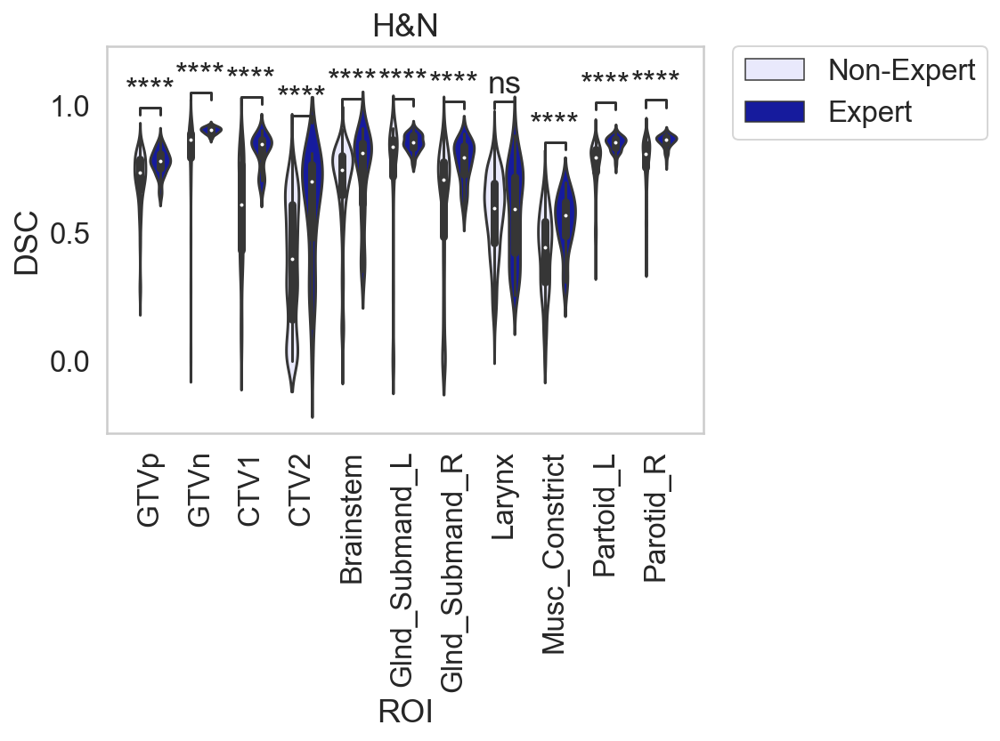

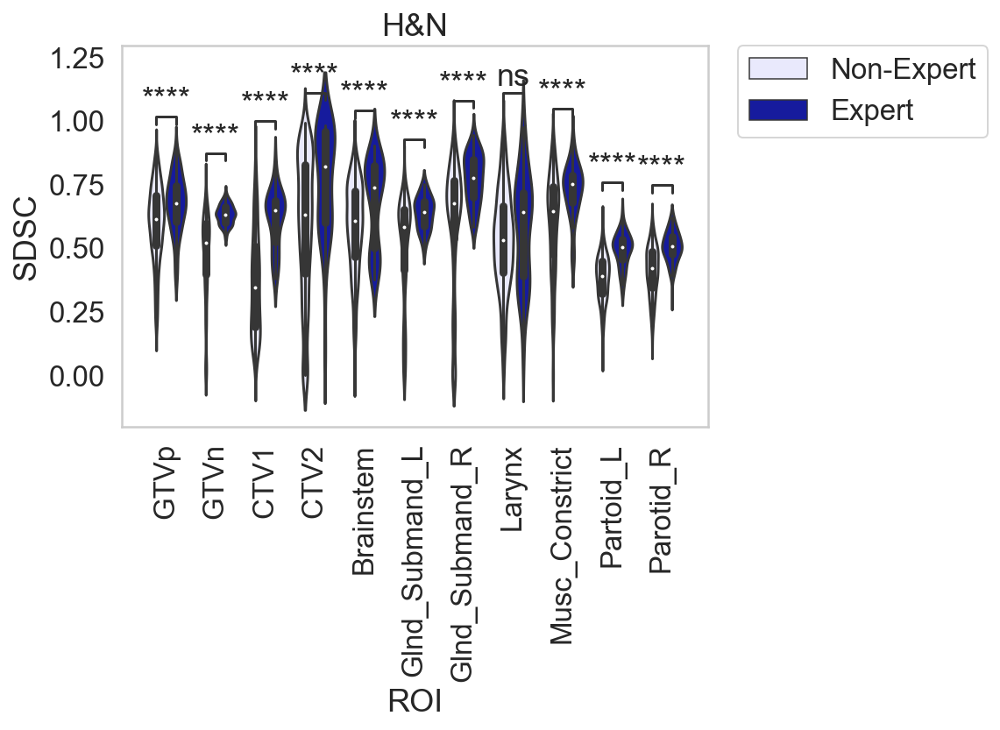

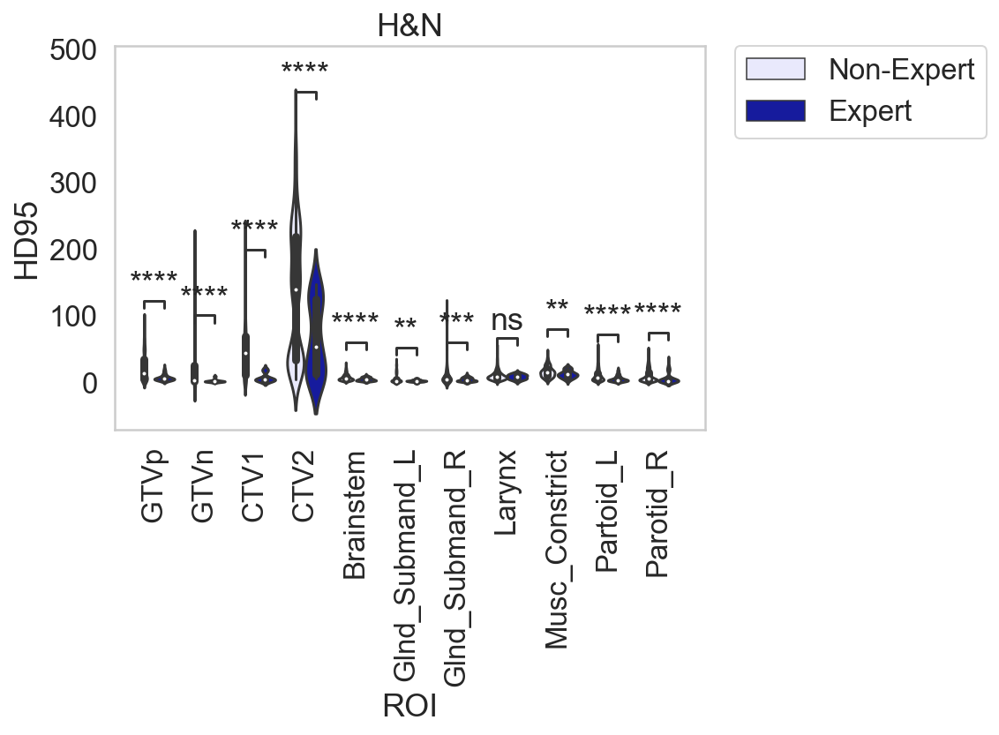

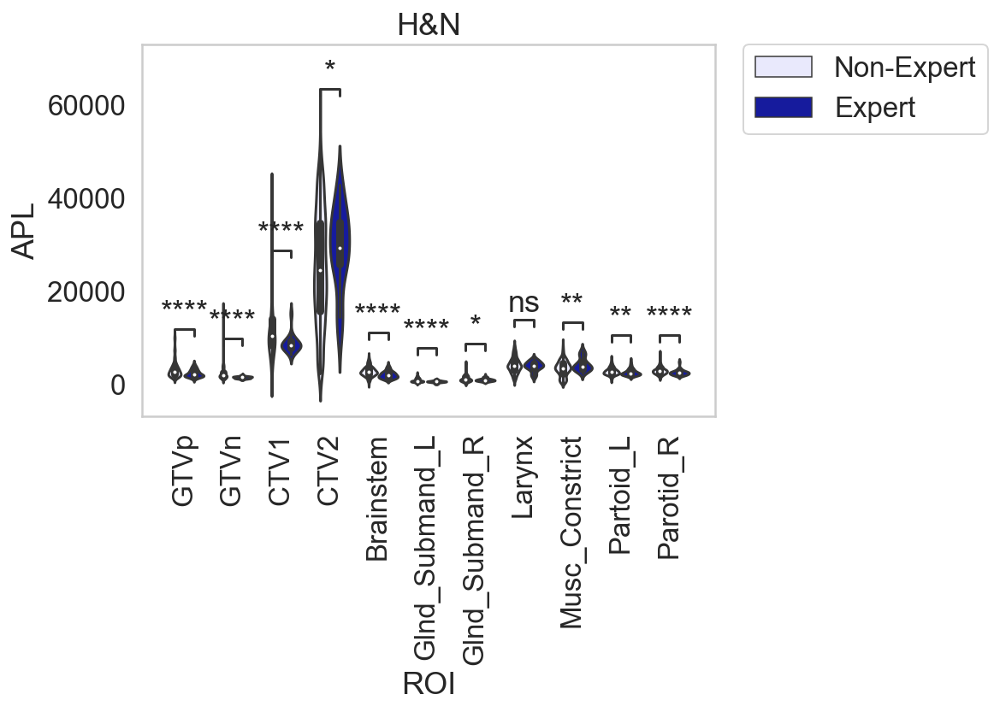

<Figure size 432x288 with 0 Axes>

In [17]:
x="ROI" 

y="SDSC_list"
y="DSC_list"

y_list = ["DSC_list", "SDSC_list", "HD95_list", "APL_list"]

for y in y_list:
    print(y)

    hue="Class"
    hue_order = ['Generalist', 'Self-ID Specialist', 'Expert']
    hue_order = ['Generalist', 'Expert']
    hue_order = ['Non-Expert', 'Expert']

    ROI_list = ['gtvp', 'gtvn', 'ctv1', 'ctv2',
                'brainstem', 'glnd_submand_l', 'glnd_submand_r',
                'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r'] # new layout

    ax = sns.violinplot(x=x, y=y, hue=hue, order=ROI_list,
                     data=df_pickle_explode,
                       hue_order = hue_order,
                       palette=hn_palette)


    class_list = ['Generalist', 'Expert']
    class_list = ['Non-Expert', 'Expert']

    pairs = [tuple((ROI, classes) for classes in class_list) for ROI in ROI_list]

    # all combos, in theory reduces down to code above in 2-class example
    combination_list = list(itertools.combinations(class_list, 2))
    pairs = [tuple((ROI, classes) for classes in subclass_list) for subclass_list in combination_list for ROI in ROI_list]


    annot = Annotator(ax, pairs, data=df_pickle_explode, x=x, y=y, hue=hue, hue_order=hue_order, order=ROI_list)

    annot.new_plot(ax, pairs, data=df_pickle_explode, x=x, y=y, hue=hue, hue_order=hue_order, order=ROI_list)
    annot.configure(test='Mann-Whitney', verbose=2)
    annot.apply_test()
    annot.annotate()
    
    # TG-263 names 
    labels = ['GTVp', 'GTVn', 'CTV1', 'CTV2', 'Brainstem', 'Glnd_Submand_L', 'Glnd_Submand_R', 'Larynx', 'Musc_Constrict', 'Partoid_L', 'Parotid_R']
    ax.set_xticklabels(labels)

    plt.xticks(rotation=90)
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    plt.ylabel(y.split('_')[0])
    plt.title('H&N')
    
    plt.figure()

Volume measurements here.

In [23]:
%%time 

in_path = os.path.join(base_path, "structures_nifti_stratified")

ROI_list = ['gtvp', 'gtvn', 'ctv1', 'ctv2',
            'brainstem', 'glnd_submand_l', 'glnd_submand_r',
            'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r'] # new layout

classes = ["Expert", "Non-Expert"] # for just getting Expert and Non-Expert 

df_vol = pd.DataFrame(columns=['ROI', 'Class', 'ID', 'Volume'])
counter = -1  

for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        print(class_)
        class_path = os.path.join(in_path, class_)
        
        IDs = os.listdir(class_path)
        for ID in IDs:
            #print(ID)
            ID_path = os.path.join(class_path, ID)
            structures = os.listdir(ID_path)
            for structure in structures:
                structure_path = os.path.join(ID_path, structure)
                if structure.split('.')[0] == ROI:
                    structure_volume = calculate_volume(structure_path)
                    
                    counter +=1
                    df_vol.loc[counter] = [ROI, class_, ID, structure_volume]
                    #print(df_vol)

gtvp
Expert
Non-Expert


KeyboardInterrupt: 

In [147]:
df_vol

,ROI,Class,ID,Volume
0,gtvp,Expert,RTSS_932__row0932,31.053543
1,gtvp,Expert,RTSS_935__row0935,40.617943
2,gtvp,Expert,RTSS_936__row0936,33.877373
3,gtvp,Expert,RTSS_938__row0938,21.214485
4,gtvp,Expert,RTSS_942__row0942,28.003693
...,...,...,...,...
724,parotid_r,Non-Expert,RTSS_916__row0916,33.837318
725,parotid_r,Non-Expert,RTSS_919__row0919,43.725014
726,parotid_r,Non-Expert,RTSS_948__row0948,43.682098
727,parotid_r,Non-Expert,RTSS_964__row0964,37.459373


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

parotid_l_Non-Expert vs. parotid_l_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:7.383e-03 U_stat=2.000e+02
parotid_r_Non-Expert vs. parotid_r_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:5.146e-02 U_stat=2.455e+02
musc_constrict_all_Non-Expert vs. musc_constrict_all_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:6.169e-02 U_stat=1.490e+02
gtvn_Non-Expert vs. gtvn_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:1.663e-01 U_stat=2.935e+02
gtvp_Non-Expert vs. gtvp_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:2.838e-01 U_stat=4.900e+02
ctv1_Non-Expert vs. ctv1_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:6.761e-01 U_stat=1.840e+02
ctv2_Non-Expert vs. ctv2_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:1.328e-01 U_stat=1.500e+02
brainstem_Non-Expert vs. brainstem_Expert: 

<Figure size 432x288 with 0 Axes>

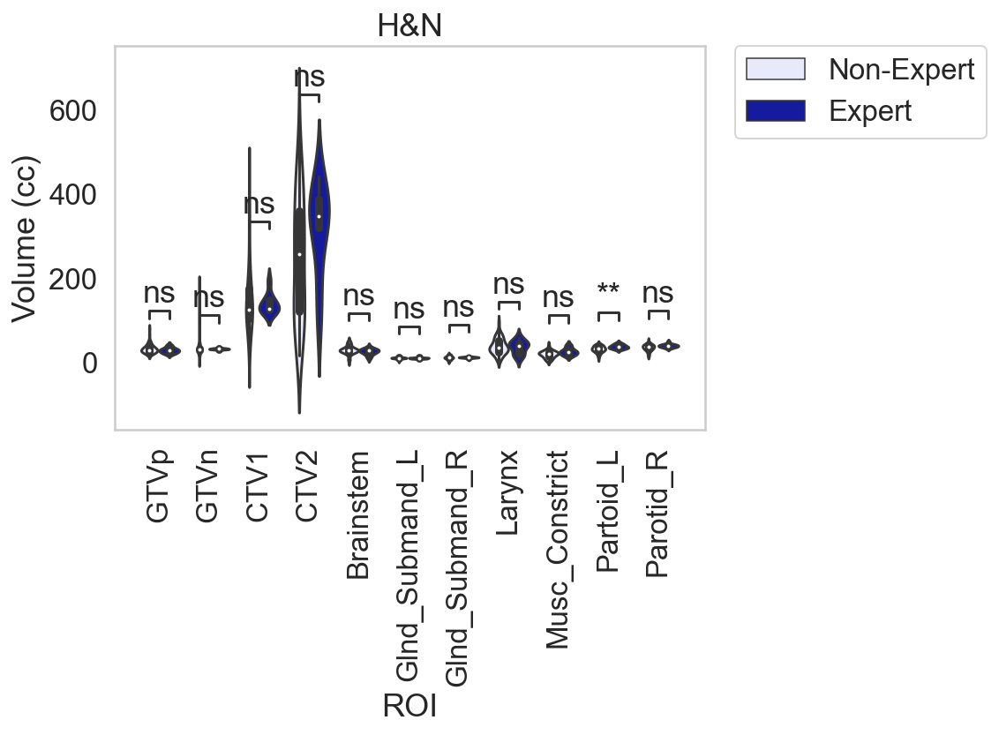

<Figure size 432x288 with 0 Axes>

In [148]:
x="ROI" 
y="Volume"
hue="Class"
hue_order = ['Non-Expert', 'Expert']
ROI_list = ['gtvp', 'gtvn', 'ctv1', 'ctv2',
            'brainstem', 'glnd_submand_l', 'glnd_submand_r',
            'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r'] # new layout

ax = sns.violinplot(x=x, y=y, hue=hue,
                 data=df_vol,
                   hue_order = hue_order,
                   palette=hn_palette,
                   order = ROI_list) # Dont forget to set order in the calls below if you use it here 

class_list = ['Non-Expert', 'Expert']

pairs = [tuple((ROI, classes) for classes in class_list) for ROI in ROI_list]

# all combos, in theory reduces down to code above in 2-class example
combination_list = list(itertools.combinations(class_list, 2))
pairs = [tuple((ROI, classes) for classes in subclass_list) for subclass_list in combination_list for ROI in ROI_list]

annot = Annotator(ax, pairs, data=df_vol, x=x, y=y, hue=hue, hue_order=hue_order, order = ROI_list)

annot.new_plot(ax, pairs, data=df_vol, x=x, y=y, hue=hue, hue_order=hue_order, order = ROI_list)
annot.configure(test='Mann-Whitney', verbose=2)
annot.apply_test()
annot.annotate()

# TG-263 names 
labels = ['GTVp', 'GTVn', 'CTV1', 'CTV2', 'Brainstem', 'Glnd_Submand_L', 'Glnd_Submand_R', 'Larynx', 'Musc_Constrict', 'Partoid_L', 'Parotid_R']
ax.set_xticklabels(labels)

plt.xticks(rotation=90)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.ylabel('Volume (cc)')
plt.title('H&N')

plt.figure()

### Direct comparisons of non-expert vs. expert STAPLE segmentations

In [24]:
df_pickle['DSC_median'] = df_pickle['DSC_list'].apply(lambda x: np.median(x))
df_pickle['HD95_median'] = df_pickle['HD95_list'].apply(lambda x: np.median(x))
df_pickle['APL_median'] = df_pickle['APL_list'].apply(lambda x: np.median(x))
df_pickle['SDSC_median'] = df_pickle['SDSC_list'].apply(lambda x: np.median(x))

In [25]:
df_pickle[df_pickle['Class'] == "Expert"] # just show expert answers which is what we care about

,ROI,Class,DSC_list,HD95_list,ASD_list,APL_list,SDSC_list,DSC_median,HD95_median,APL_median,SDSC_median
0,brainstem,Expert,"[0.8264629900033696, 0.8222373961534084, 0.805...","[6.0, 4.367320268554277, 4.8828125, 5.02120138...","[0.9786663890331492, 1.0693616322215465, 1.051...","[2452, 1946, 2770, 2705, 1675, 1775, 2863, 377...","[0.7684939036936593, 0.7178858621993329, 0.752...",0.814159,4.973261,1987.0,0.739582
2,ctv1,Expert,"[0.8300641883702057, 0.739841435357598, 0.8485...","[5.940197783494355, 16.870443901729622, 4.8828...","[1.5428489353736585, 2.916550787803317, 1.3649...","[7817, 14795, 7964, 10326, 8986, 7800, 8612, 8...","[0.6232945248990385, 0.5037119588188921, 0.663...",0.849424,4.979511,8524.0,0.649282
4,ctv2,Expert,"[0.7259246837868916, 0.2810317433487712, 0.784...","[16.801273043400798, 56.249818793110904, 14.13...","[2.795205054368956, 10.251558464068353, 2.4738...","[37308, 11402, 29244, 14570, 26778, 35579, 267...","[0.9377204942527175, 0.6054311886609233, 0.937...",0.702664,53.992827,29335.0,0.821454
6,glnd_submand_l,Expert,"[0.8071307822345166, 0.8231716147719044, 0.856...","[3.521046167445302, 2.9296875, 3.0, 2.18366013...","[0.6868462078110399, 0.610685428176905, 0.5379...","[703, 850, 969, 607, 636, 614, 771, 806, 728, ...","[0.5811332870035283, 0.5726723985056301, 0.625...",0.854225,3.000000,728.0,0.641484
8,glnd_submand_r,Expert,"[0.6168062373664452, 0.7867909331492349, 0.831...","[8.843149548962321, 7.716523749042133, 2.92968...","[1.8201410534272222, 5.455246678123761, 0.6547...","[928, 1162, 885, 767, 855, 1566, 1153, 888, 96...","[0.6237352605147666, 0.7665840347927116, 0.848...",0.796559,4.394531,1018.5,0.777912
10,gtvn,Expert,"[0.86882096069869, 0.8927323991078567, 0.87679...","[9.147880400415852, 6.582725529036206, 10.2392...","[0.9589353275341126, 0.7070431450088043, 0.951...","[1756, 1756, 1704, 1371, 1637, 1572, 1747, 127...","[0.5766731381762416, 0.6404415930466523, 0.587...",0.904381,2.183660,1624.0,0.632874
12,gtvp,Expert,"[0.790467446409325, 0.785635602555629, 0.68181...","[5.730781614243929, 5.859375, 10.1956118251079...","[1.3341279335417466, 1.2578728808918345, 2.331...","[4117, 3473, 2004, 2176, 2033, 2153, 3275, 254...","[0.6660612432266829, 0.7026567638596756, 0.528...",0.783744,6.385011,2189.0,0.677014
14,larynx,Expert,"[0.4122214379348593, 0.560980450530912, 0.4908...","[8.42548696316161, 7.8125, 10.739286540111731,...","[2.152699942609817, 1.908031798523496, 3.17218...","[1588, 4157, 4873, 3504, 5356, 4857, 5307, 535...","[0.5952938041845837, 0.707783168444674, 0.4511...",0.595693,9.285090,4130.0,0.641882
16,musc_constrict_all,Expert,"[0.49141697877652935, 0.5233042443474811, 0.57...","[12.6953125, 8.812749331579221, 7.735751929202...","[2.2649928947510634, 1.7295733465109058, 1.574...","[3223, 6682, 2754, 6290, 4057, 5041, 7000, 385...","[0.7066794612718491, 0.741800949272657, 0.7857...",0.570738,12.695312,3932.0,0.751138
18,parotid_l,Expert,"[0.8235447891251307, 0.8383301707779887, 0.776...","[4.305431820858681, 3.90625, 13.99714849587675...","[1.0045522332154384, 0.8433929966336104, 1.810...","[2379, 3117, 4795, 2925, 2190, 2269, 3559, 247...","[0.42288741202718855, 0.5050222799532981, 0.40...",0.854749,4.193217,2453.0,0.505591


In [26]:
# now can calculate DSC between STAPLE of novices and experts vs gold standard, see if they cross the thresholds 
# add in other metrics 

In [27]:
in_path = os.path.join(base_path, "structures_nifti_stratified_STAPLE")

In [28]:
%%time 

ROI_list = ['gtvp', 'gtvn', 'ctv1', 'ctv2',
            'brainstem', 'glnd_submand_l', 'glnd_submand_r',
            'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r'] # new layout
classes = ["Non-Expert", "Expert"]

df2 = pd.DataFrame(columns=['ROI', 'Class', 'DSC', 'HD95', 'APL', 'SDSC'])
counter = -1  

for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        file_list = []
        print(class_)
        class_path = os.path.join(in_path, class_)

        structures = os.listdir(class_path)
        for structure in structures:
            print(structure)
            structure_path = os.path.join(class_path, structure)
            if structure.split('STAPLE.')[0] == ROI:

                file_1 = sitk.ReadImage(structure_path)
                file_2 = sitk.ReadImage(os.path.join(in_path, 'Expert', structure))

                mask_1 = sitk.GetArrayFromImage(file_1)
                mask_2 = sitk.GetArrayFromImage(file_2)

                DSC = compute_dice_coefficient(mask_1, mask_2)  
                
                # adding other metrics
                
                spacing_mm = file_1.GetSpacing() # need spacing to calcualte distances
                
                mask_1_bool = mask_1.astype(bool) # need to convert to bool format to work 
                mask_2_bool = mask_2.astype(bool)

                surface_distances = compute_surface_distances(mask_1_bool, mask_2_bool, spacing_mm) # need this for all calculations
                HD95 = compute_robust_hausdorff(surface_distances, 95)

                ASD_truth = compute_average_surface_distance(surface_distances)[0] #  A tuple with two float values: 1. the average distance (in mm) from the ground truth surface to thepredicted surface, 2. the average distance from the predicted surface to the ground truth surface.
                ASD_pred = compute_average_surface_distance(surface_distances)[1]
                ASD = (ASD_truth + ASD_pred)/2

                APL = AddedPathLength(mask_1, mask_2)
                
                tolerance = np.median(df_pickle[(df_pickle["ROI"] == ROI) & (df_pickle["Class"] == "Expert")]["ASD_list"].values[0]) # get tolerance
                SDSC = compute_surface_dice_at_tolerance(surface_distances, tolerance)
                     
        counter +=1
        df2.loc[counter] = [ROI, class_, DSC, HD95, APL, SDSC]
        #print(df2)

gtvp
Non-Expert
brainstemSTAPLE.nii.gz
ctv1STAPLE.nii.gz
ctv2STAPLE.nii.gz
glnd_submand_lSTAPLE.nii.gz
glnd_submand_rSTAPLE.nii.gz
gtvnSTAPLE.nii.gz
gtvpSTAPLE.nii.gz
larynxSTAPLE.nii.gz
musc_constrict_allSTAPLE.nii.gz
parotid_lSTAPLE.nii.gz
parotid_rSTAPLE.nii.gz
Expert
brainstemSTAPLE.nii.gz
ctv1STAPLE.nii.gz
ctv2STAPLE.nii.gz
glnd_submand_lSTAPLE.nii.gz
glnd_submand_rSTAPLE.nii.gz
gtvnSTAPLE.nii.gz
gtvpSTAPLE.nii.gz
larynxSTAPLE.nii.gz
musc_constrict_allSTAPLE.nii.gz
parotid_lSTAPLE.nii.gz
parotid_rSTAPLE.nii.gz
gtvn
Non-Expert
brainstemSTAPLE.nii.gz
ctv1STAPLE.nii.gz
ctv2STAPLE.nii.gz
glnd_submand_lSTAPLE.nii.gz
glnd_submand_rSTAPLE.nii.gz
gtvnSTAPLE.nii.gz
gtvpSTAPLE.nii.gz
larynxSTAPLE.nii.gz
musc_constrict_allSTAPLE.nii.gz
parotid_lSTAPLE.nii.gz
parotid_rSTAPLE.nii.gz
Expert
brainstemSTAPLE.nii.gz
ctv1STAPLE.nii.gz
ctv2STAPLE.nii.gz
glnd_submand_lSTAPLE.nii.gz
glnd_submand_rSTAPLE.nii.gz
gtvnSTAPLE.nii.gz
gtvpSTAPLE.nii.gz
larynxSTAPLE.nii.gz
musc_constrict_allSTAPLE.nii.gz
paro

In [29]:
df2

,ROI,Class,DSC,HD95,APL,SDSC
0,gtvp,Non-Expert,0.803865,27.316042,2926,0.627222
1,gtvp,Expert,1.000000,0.000000,0,1.000000
2,gtvn,Non-Expert,0.956270,0.976562,929,0.829514
3,gtvn,Expert,1.000000,0.000000,0,1.000000
4,ctv1,Non-Expert,0.637141,31.321914,11228,0.218865
5,ctv1,Expert,1.000000,0.000000,0,1.000000
6,ctv2,Non-Expert,0.833663,10.627817,32378,0.966068
7,ctv2,Expert,1.000000,0.000000,0,1.000000
8,brainstem,Non-Expert,0.784403,6.956850,2705,0.601275
9,brainstem,Expert,1.000000,0.000000,0,1.000000


In [30]:
# next step is combining the information from the previous dataframes to make bar plots of  novice and specialist DSC compared to exprt with dashed line of expodert mean IOV 

In [31]:
ROI_list = ['gtvp', 'gtvn', 'ctv1', 'ctv2',
            'brainstem', 'glnd_submand_l', 'glnd_submand_r',
            'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r'] # new layout

In [32]:
line_dict_DSC = {ROI:df_pickle[(df_pickle['Class'] == "Expert") & (df_pickle['ROI'] == ROI)]['DSC_median'].values[0] for ROI in ROI_list}
line_dict_HD95 = {ROI:df_pickle[(df_pickle['Class'] == "Expert") & (df_pickle['ROI'] == ROI)]['HD95_median'].values[0] for ROI in ROI_list}
line_dict_APL = {ROI:df_pickle[(df_pickle['Class'] == "Expert") & (df_pickle['ROI'] == ROI)]['APL_median'].values[0] for ROI in ROI_list}
line_dict_SDSC = {ROI:df_pickle[(df_pickle['Class'] == "Expert") & (df_pickle['ROI'] == ROI)]['SDSC_median'].values[0] for ROI in ROI_list}
line_dict_list = [line_dict_DSC, line_dict_HD95, line_dict_APL, line_dict_SDSC]

In [33]:
line_dict_list

[{'gtvp': 0.7837435050549805,
  'gtvn': 0.9043813196737924,
  'ctv1': 0.8494243888653437,
  'ctv2': 0.7026643183859858,
  'brainstem': 0.8141588565779211,
  'glnd_submand_l': 0.8542252062645656,
  'glnd_submand_r': 0.7965593609563786,
  'larynx': 0.5956925237635646,
  'musc_constrict_all': 0.5707381067458399,
  'parotid_l': 0.8547487240607499,
  'parotid_r': 0.8665221918896016},
 {'gtvp': 6.385011478613899,
  'gtvn': 2.1836601342771385,
  'ctv1': 4.979511243742954,
  'ctv2': 53.99282667081543,
  'brainstem': 4.9732613010748015,
  'glnd_submand_l': 3.0,
  'glnd_submand_r': 4.39453125,
  'larynx': 9.285090262959109,
  'musc_constrict_all': 12.6953125,
  'parotid_l': 4.1932170045987665,
  'parotid_r': 3.088161777508183},
 {'gtvp': 2189.0,
  'gtvn': 1624.0,
  'ctv1': 8524.0,
  'ctv2': 29335.0,
  'brainstem': 1987.0,
  'glnd_submand_l': 728.0,
  'glnd_submand_r': 1018.5,
  'larynx': 4130.0,
  'musc_constrict_all': 3932.0,
  'parotid_l': 2453.0,
  'parotid_r': 2567.5},
 {'gtvp': 0.6770140029

In [34]:
# make dataframe for counts of each ROI per class

In [35]:
in_path = os.path.join(base_path, "structures_nifti_stratified")

In [36]:
%%time 
ROI_list = ['gtvp', 'gtvn', 'ctv1', 'ctv2',
            'brainstem', 'glnd_submand_l', 'glnd_submand_r',
            'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r'] # new layout

classes = [class_ for class_ in os.listdir(in_path)]
classes = ["Non-Expert", "Expert"]

df3 = pd.DataFrame(columns=['ROI', 'Class', 'N'])
counter = -1  

for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        file_list = []
        print(class_)
        class_path = os.path.join(in_path, class_)
        
        IDs = os.listdir(class_path)
        for ID in IDs:
            ID_path = os.path.join(class_path, ID)

            structures = os.listdir(ID_path)
            for structure in structures:
                structure_path = os.path.join(class_path, structure)
                if structure.split('.')[0] == ROI:
                    file_list.append(structure_path)
        
        n = len(file_list)
        counter +=1
        df3.loc[counter] = [ROI, class_, n]

gtvp
Non-Expert
Expert
gtvn
Non-Expert
Expert
ctv1
Non-Expert
Expert
ctv2
Non-Expert
Expert
brainstem
Non-Expert
Expert
glnd_submand_l
Non-Expert
Expert
glnd_submand_r
Non-Expert
Expert
larynx
Non-Expert
Expert
musc_constrict_all
Non-Expert
Expert
parotid_l
Non-Expert
Expert
parotid_r
Non-Expert
Expert
Wall time: 172 ms


In [37]:
df3

,ROI,Class,N
0,gtvp,Non-Expert,59
1,gtvp,Expert,14
2,gtvn,Non-Expert,60
3,gtvn,Expert,13
4,ctv1,Non-Expert,45
5,ctv1,Expert,9
6,ctv2,Non-Expert,49
7,ctv2,Expert,9
8,brainstem,Non-Expert,58
9,brainstem,Expert,13


DSC
HD95
APL
SDSC


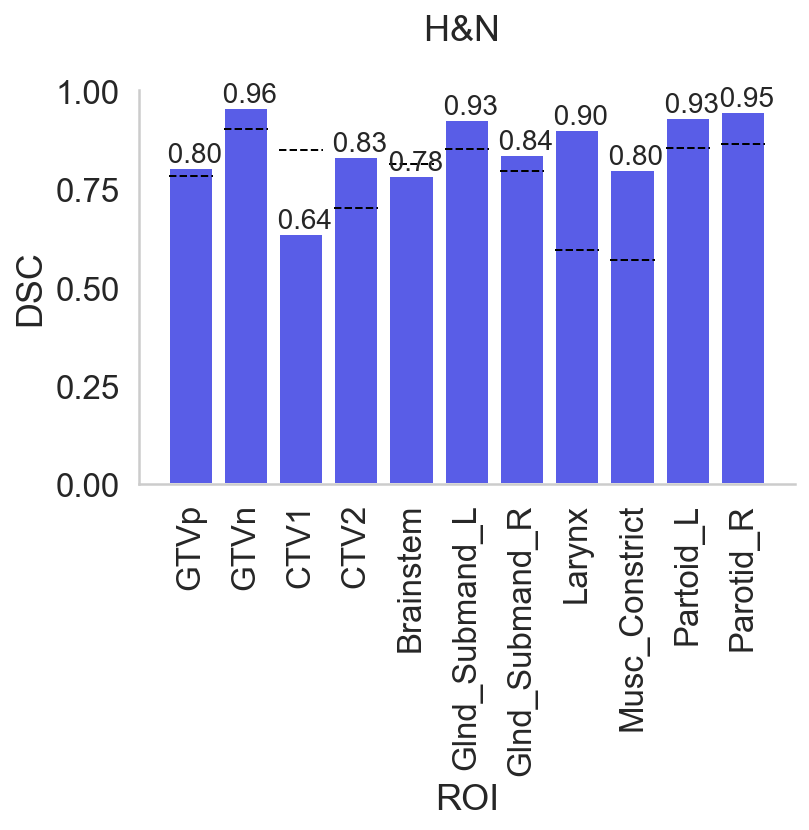

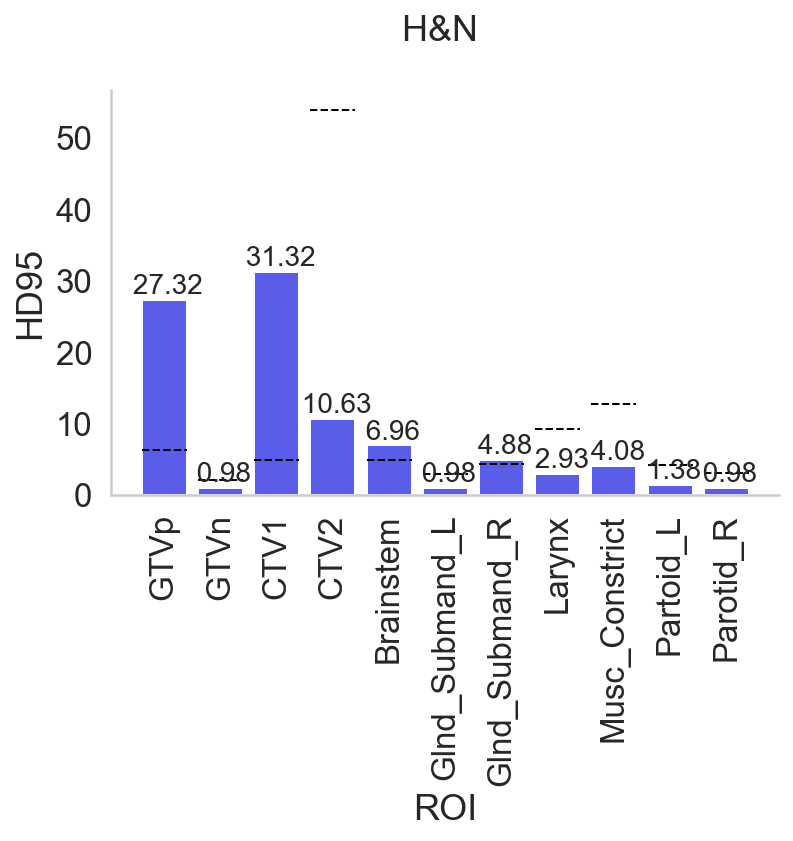

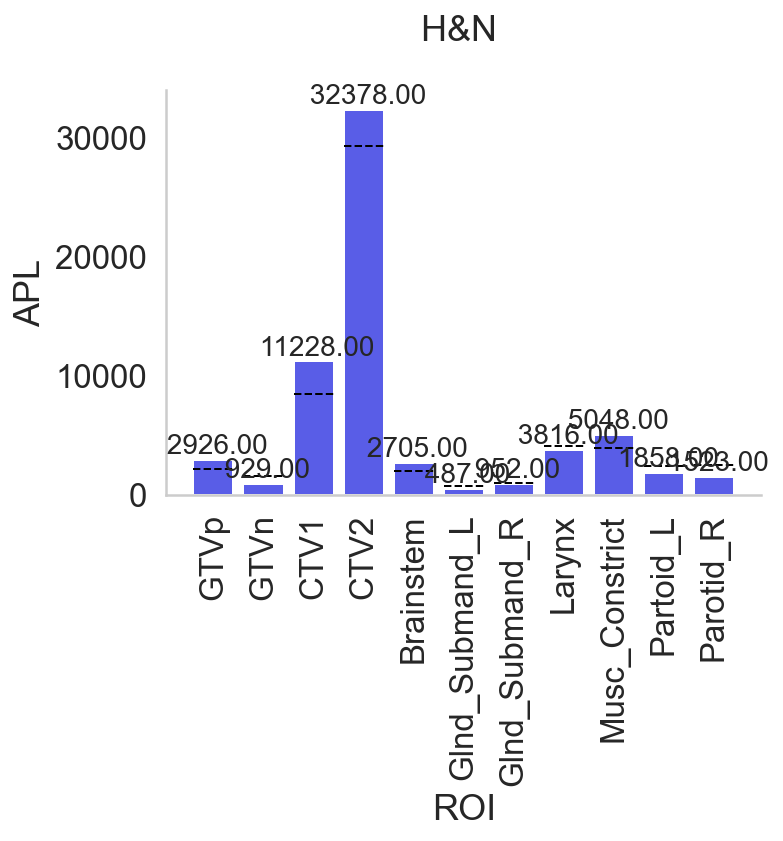

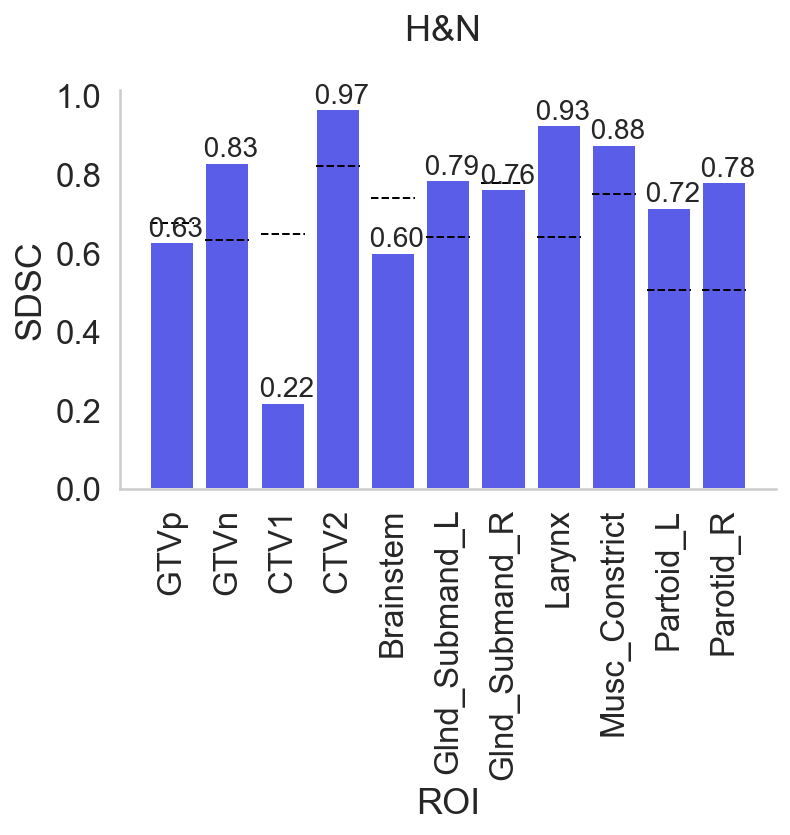

In [38]:
### Make box plots 

metric_list = ['DSC', 'HD95', 'APL', 'SDSC']

for metric, line_dict in zip(metric_list, line_dict_list): # line dict defined before 
    print(metric)
    
    if metric == "DSC" or metric == "SDSC":
        sharey=True
    else:
        sharey=False

    g = sns.catplot(x="ROI", y=metric, hue= "Class", hue_order =["Non-Expert"], sharex = False,
                    sharey=sharey,
                    data=df2, kind="bar", 
                    height=4, aspect=1.5,
                    palette = hn_palette_old,
                    )
    

    for ax in g.axes.ravel(): # https://stackoverflow.com/questions/41127841/how-to-annotate-bars-in-a-seaborn-facetgrid-works-in-factorplot
        for a, ROI in zip(ax.patches, ROI_list):         

            value = float((line_dict[ROI]))

            x_start = a.get_x()
            width = a.get_width()

            ax.plot([x_start, x_start+width], [value, value], '--', c='black', linewidth=1)
    
    plt.xticks(rotation=90)
    plt.title('H&N \n')
    g._legend.remove() # remove legend since just showing non-expert
    
    axes = g.axes.flatten()
    for ax in axes:
        for container in ax.containers:
            ax.bar_label(container, fontsize=14, labels=[f'{x: .2f}' for x in container.datavalues]) # https://stackoverflow.com/questions/70515542/adding-comma-to-bar-labels-in-matplotlib
    
    # TG-263 names 
    labels = ['GTVp', 'GTVn', 'CTV1', 'CTV2', 'Brainstem', 'Glnd_Submand_L', 'Glnd_Submand_R', 'Larynx', 'Musc_Constrict', 'Partoid_L', 'Parotid_R']
    ax.set_xticklabels(labels)

### Bootstrap experiments

In [251]:
%%time

ROI_list = ['brainstem', 'ctv1', 'ctv2', 'glnd_submand_l',
           'glnd_submand_r', 'gtvn', 'gtvp', 'larynx', 'musc_constrict_all',
           'parotid_l', 'parotid_r'] 

bootstrap = 10
#bootstrap = 2 # testing 

path = os.path.join(base_path, "structures_nifti_stratified", "Non-Expert")

expert_STAPLE_path = os.path.join(base_path, "structures_nifti_stratified_STAPLE", "Expert")

df4 = pd.DataFrame(columns=['ROI', 'N', 'DSC_list', 'HD95_list', 'APL_list', 'SDSC_list', 'ID_list'])

counter = -1  # for df 

counter2 = -1 # for random seed 

n_list = [2, 3, 4, 5, 6, 7, 8, 9, 10, 15, 20, 25]

for ROI in ROI_list:
    #print(ROI)
    expert_file_path = os.path.join(expert_STAPLE_path, ROI+'STAPLE.nii.gz')
    cases = [case for case in os.listdir(path) if ROI+'.nii.gz' in os.listdir(os.path.join(path, case))]
    for n in n_list:
        #print(n)
        DSC_list = []
        subcase_list = []
        for iteration in range(bootstrap):
            
            switch = True 
            
            counter2 +=1 
            
            while switch == True: # horrible practice but don't know what else to do
                
                print("ROI:", ROI, "; total staple:", n, "; boostrap iteration:", iteration, "; random counter:", counter2)
            
                random.seed(counter2)
                np.random.seed(counter2)

                #print(counter2)

                subcases = random.sample(cases, n)
                print(subcases)
                subcase_list.append(subcases)

                file_list = []
                for case in subcases:
                    case_path = os.path.join(path, case)
                    file_path = os.path.join(case_path, ROI+'.nii.gz')
                    file_list.append(file_path)

                segmentations = [sitk.ReadImage(file_name, sitk.sitkUInt8) for file_name in file_list]

                foregroundValue = 1
                threshold = 0.95
                #threshold = 0.90

                if n <= 4: 
                    #print('test')
                    p = multiprocessing.Process(target=sitk.STAPLE, name="Foo", args=(segmentations, foregroundValue,))
                    p.start()
                    p.join(60) # set at 60 sec for now.. 

                    # If thread is active
                    if p.is_alive():
                        print("STAPLE function is taking too long, killing it and getting new random samples")

                        # Terminate function 
                        p.terminate()
                        p.join()
                        counter2 +=1 
                        continue



                #print('test2')
                reference_segmentation_STAPLE_probabilities = sitk.STAPLE(segmentations, foregroundValue) 

                file_1 = reference_segmentation_STAPLE_probabilities > threshold
                file_2 = sitk.ReadImage(expert_file_path)

                mask_1 = sitk.GetArrayFromImage(file_1)
                mask_2 = sitk.GetArrayFromImage(file_2)

                DSC = compute_dice_coefficient(mask_1, mask_2)   
                DSC_list.append(DSC)
                
                # adding other metrics
                
                spacing_mm = file_1.GetSpacing() # need spacing to calcualte distances
                
                mask_1_bool = mask_1.astype(bool) # need to convert to bool format to work 
                mask_2_bool = mask_2.astype(bool)

                surface_distances = compute_surface_distances(mask_1_bool, mask_2_bool, spacing_mm) # need this for all calculations
                HD95 = compute_robust_hausdorff(surface_distances, 95)
                HD95_list.append(HD95)

                APL = AddedPathLength(mask_1, mask_2)
                APL_list.append(APL)
                
                tolerance = np.median(df_pickle[(df_pickle["ROI"] == ROI) & (df_pickle["Class"] == "Expert")]["ASD_list"].values[0]) # get tolerance
                SDSC = compute_surface_dice_at_tolerance(surface_distances, tolerance)
                SDSC_list.append(SDSC)
                
                counter +=1
                df4.loc[counter] = [ROI, n, DSC, HD95, APL, SDSC, subcases]

                switch = False

        print(np.mean(DSC_list))
        print(np.mean(HD95_list))
        print(np.mean(APL_list))
        print(np.mean(SDSC_list))

ROI: brainstem ; total staple: 2 ; boostrap iteration: 0 ; random counter: 0
['RTSS_919__row0919', 'RTSS_362__row0362']
ROI: brainstem ; total staple: 2 ; boostrap iteration: 1 ; random counter: 1
['RTSS_048__row0048', 'RTSS_630__row0630']
ROI: brainstem ; total staple: 2 ; boostrap iteration: 2 ; random counter: 2
['RTSS_948__row0948', 'RTSS_919__row0919']
ROI: brainstem ; total staple: 2 ; boostrap iteration: 3 ; random counter: 3
['RTSS_177__row0177', 'RTSS_631__row0631']
ROI: brainstem ; total staple: 2 ; boostrap iteration: 4 ; random counter: 4
['RTSS_177__row0177', 'RTSS_292__row0292']
ROI: brainstem ; total staple: 2 ; boostrap iteration: 5 ; random counter: 5
['RTSS_645__row0645', 'RTSS_182__row0182']
ROI: brainstem ; total staple: 2 ; boostrap iteration: 6 ; random counter: 6
['RTSS_886__row0886', 'RTSS_630__row0630']
ROI: brainstem ; total staple: 2 ; boostrap iteration: 7 ; random counter: 7
['RTSS_297__row0297', 'RTSS_059__row0059']
ROI: brainstem ; total staple: 2 ; boost

ROI: brainstem ; total staple: 6 ; boostrap iteration: 9 ; random counter: 49
['RTSS_027__row0027', 'RTSS_304__row0304', 'RTSS_386__row0386', 'RTSS_034__row0034', 'RTSS_297__row0297', 'RTSS_871__row0871']
0.8391411022308226
10.589905053198658
3050.912507339988
0.4216120391621473
ROI: brainstem ; total staple: 7 ; boostrap iteration: 0 ; random counter: 50
['RTSS_519__row0519', 'RTSS_919__row0919', 'RTSS_199__row0199', 'RTSS_344__row0344', 'RTSS_716__row0716', 'RTSS_177__row0177', 'RTSS_791__row0791']
ROI: brainstem ; total staple: 7 ; boostrap iteration: 1 ; random counter: 51
['RTSS_177__row0177', 'RTSS_916__row0916', 'RTSS_539__row0539', 'RTSS_603__row0603', 'RTSS_099__row0099', 'RTSS_973__row0973', 'RTSS_165__row0165']
ROI: brainstem ; total staple: 7 ; boostrap iteration: 2 ; random counter: 52
['RTSS_199__row0199', 'RTSS_018__row0018', 'RTSS_794__row0794', 'RTSS_539__row0539', 'RTSS_472__row0472', 'RTSS_344__row0344', 'RTSS_386__row0386']
ROI: brainstem ; total staple: 7 ; boostra

ROI: brainstem ; total staple: 10 ; boostrap iteration: 1 ; random counter: 81
['RTSS_539__row0539', 'RTSS_916__row0916', 'RTSS_420__row0420', 'RTSS_299__row0299', 'RTSS_603__row0603', 'RTSS_597__row0597', 'RTSS_362__row0362', 'RTSS_472__row0472', 'RTSS_011__row0011', 'RTSS_099__row0099']
ROI: brainstem ; total staple: 10 ; boostrap iteration: 2 ; random counter: 82
['RTSS_059__row0059', 'RTSS_885__row0885', 'RTSS_519__row0519', 'RTSS_539__row0539', 'RTSS_247__row0247', 'RTSS_910__row0910', 'RTSS_897__row0897', 'RTSS_128__row0128', 'RTSS_099__row0099', 'RTSS_770__row0770']
ROI: brainstem ; total staple: 10 ; boostrap iteration: 3 ; random counter: 83
['RTSS_519__row0519', 'RTSS_919__row0919', 'RTSS_964__row0964', 'RTSS_420__row0420', 'RTSS_031__row0031', 'RTSS_048__row0048', 'RTSS_362__row0362', 'RTSS_017__row0017', 'RTSS_018__row0018', 'RTSS_727__row0727']
ROI: brainstem ; total staple: 10 ; boostrap iteration: 4 ; random counter: 84
['RTSS_794__row0794', 'RTSS_247__row0247', 'RTSS_88

ROI: brainstem ; total staple: 20 ; boostrap iteration: 3 ; random counter: 103
['RTSS_792__row0792', 'RTSS_420__row0420', 'RTSS_794__row0794', 'RTSS_791__row0791', 'RTSS_809__row0809', 'RTSS_910__row0910', 'RTSS_161__row0161', 'RTSS_919__row0919', 'RTSS_027__row0027', 'RTSS_641__row0641', 'RTSS_916__row0916', 'RTSS_034__row0034', 'RTSS_727__row0727', 'RTSS_362__row0362', 'RTSS_964__row0964', 'RTSS_299__row0299', 'RTSS_948__row0948', 'RTSS_519__row0519', 'RTSS_031__row0031', 'RTSS_048__row0048']
ROI: brainstem ; total staple: 20 ; boostrap iteration: 4 ; random counter: 104
['RTSS_011__row0011', 'RTSS_948__row0948', 'RTSS_146__row0146', 'RTSS_794__row0794', 'RTSS_885__row0885', 'RTSS_165__row0165', 'RTSS_384__row0384', 'RTSS_299__row0299', 'RTSS_002__row0002', 'RTSS_792__row0792', 'RTSS_048__row0048', 'RTSS_973__row0973', 'RTSS_099__row0099', 'RTSS_032__row0032', 'RTSS_059__row0059', 'RTSS_034__row0034', 'RTSS_027__row0027', 'RTSS_886__row0886', 'RTSS_344__row0344', 'RTSS_018__row0018'

ROI: brainstem ; total staple: 25 ; boostrap iteration: 8 ; random counter: 118
['RTSS_792__row0792', 'RTSS_716__row0716', 'RTSS_128__row0128', 'RTSS_292__row0292', 'RTSS_032__row0032', 'RTSS_791__row0791', 'RTSS_344__row0344', 'RTSS_247__row0247', 'RTSS_885__row0885', 'RTSS_011__row0011', 'RTSS_919__row0919', 'RTSS_299__row0299', 'RTSS_871__row0871', 'RTSS_641__row0641', 'RTSS_519__row0519', 'RTSS_539__row0539', 'RTSS_910__row0910', 'RTSS_794__row0794', 'RTSS_630__row0630', 'RTSS_592__row0592', 'RTSS_059__row0059', 'RTSS_728__row0728', 'RTSS_002__row0002', 'RTSS_161__row0161', 'RTSS_048__row0048']
ROI: brainstem ; total staple: 25 ; boostrap iteration: 9 ; random counter: 119
['RTSS_247__row0247', 'RTSS_128__row0128', 'RTSS_809__row0809', 'RTSS_886__row0886', 'RTSS_597__row0597', 'RTSS_728__row0728', 'RTSS_871__row0871', 'RTSS_603__row0603', 'RTSS_897__row0897', 'RTSS_412__row0412', 'RTSS_032__row0032', 'RTSS_031__row0031', 'RTSS_885__row0885', 'RTSS_716__row0716', 'RTSS_177__row0177'

ROI: ctv1 ; total staple: 6 ; boostrap iteration: 3 ; random counter: 164
['RTSS_048__row0048', 'RTSS_344__row0344', 'RTSS_247__row0247', 'RTSS_630__row0630', 'RTSS_645__row0645', 'RTSS_885__row0885']
ROI: ctv1 ; total staple: 6 ; boostrap iteration: 4 ; random counter: 165
['RTSS_018__row0018', 'RTSS_032__row0032', 'RTSS_519__row0519', 'RTSS_034__row0034', 'RTSS_645__row0645', 'RTSS_186__row0186']
ROI: ctv1 ; total staple: 6 ; boostrap iteration: 5 ; random counter: 166
['RTSS_161__row0161', 'RTSS_910__row0910', 'RTSS_885__row0885', 'RTSS_472__row0472', 'RTSS_519__row0519', 'RTSS_002__row0002']
ROI: ctv1 ; total staple: 6 ; boostrap iteration: 6 ; random counter: 167
['RTSS_186__row0186', 'RTSS_046__row0046', 'RTSS_384__row0384', 'RTSS_519__row0519', 'RTSS_362__row0362', 'RTSS_949__row0949']
ROI: ctv1 ; total staple: 6 ; boostrap iteration: 7 ; random counter: 168
['RTSS_059__row0059', 'RTSS_791__row0791', 'RTSS_412__row0412', 'RTSS_418__row0418', 'RTSS_161__row0161', 'RTSS_186__row01

ROI: ctv1 ; total staple: 9 ; boostrap iteration: 8 ; random counter: 199
['RTSS_386__row0386', 'RTSS_451__row0451', 'RTSS_292__row0292', 'RTSS_344__row0344', 'RTSS_002__row0002', 'RTSS_641__row0641', 'RTSS_727__row0727', 'RTSS_964__row0964', 'RTSS_247__row0247']
ROI: ctv1 ; total staple: 9 ; boostrap iteration: 9 ; random counter: 200
['RTSS_031__row0031', 'RTSS_182__row0182', 'RTSS_018__row0018', 'RTSS_128__row0128', 'RTSS_886__row0886', 'RTSS_292__row0292', 'RTSS_002__row0002', 'RTSS_603__row0603', 'RTSS_148__row0148']
0.7816538829215808
10.784636254488294
3259.7593092282787
0.438000338362497
ROI: ctv1 ; total staple: 10 ; boostrap iteration: 0 ; random counter: 201
['RTSS_034__row0034', 'RTSS_362__row0362', 'RTSS_472__row0472', 'RTSS_002__row0002', 'RTSS_299__row0299', 'RTSS_949__row0949', 'RTSS_641__row0641', 'RTSS_292__row0292', 'RTSS_603__row0603', 'RTSS_885__row0885']
ROI: ctv1 ; total staple: 10 ; boostrap iteration: 1 ; random counter: 202
['RTSS_418__row0418', 'RTSS_916__row

ROI: ctv1 ; total staple: 20 ; boostrap iteration: 2 ; random counter: 223
['RTSS_384__row0384', 'RTSS_386__row0386', 'RTSS_603__row0603', 'RTSS_177__row0177', 'RTSS_451__row0451', 'RTSS_794__row0794', 'RTSS_727__row0727', 'RTSS_059__row0059', 'RTSS_886__row0886', 'RTSS_002__row0002', 'RTSS_964__row0964', 'RTSS_018__row0018', 'RTSS_871__row0871', 'RTSS_046__row0046', 'RTSS_161__row0161', 'RTSS_412__row0412', 'RTSS_641__row0641', 'RTSS_099__row0099', 'RTSS_916__row0916', 'RTSS_919__row0919']
ROI: ctv1 ; total staple: 20 ; boostrap iteration: 3 ; random counter: 224
['RTSS_034__row0034', 'RTSS_177__row0177', 'RTSS_630__row0630', 'RTSS_964__row0964', 'RTSS_794__row0794', 'RTSS_186__row0186', 'RTSS_048__row0048', 'RTSS_519__row0519', 'RTSS_791__row0791', 'RTSS_099__row0099', 'RTSS_018__row0018', 'RTSS_362__row0362', 'RTSS_247__row0247', 'RTSS_199__row0199', 'RTSS_032__row0032', 'RTSS_916__row0916', 'RTSS_472__row0472', 'RTSS_418__row0418', 'RTSS_182__row0182', 'RTSS_161__row0161']
ROI: ctv

ROI: ctv1 ; total staple: 25 ; boostrap iteration: 7 ; random counter: 238
['RTSS_412__row0412', 'RTSS_046__row0046', 'RTSS_519__row0519', 'RTSS_910__row0910', 'RTSS_034__row0034', 'RTSS_949__row0949', 'RTSS_128__row0128', 'RTSS_148__row0148', 'RTSS_059__row0059', 'RTSS_794__row0794', 'RTSS_031__row0031', 'RTSS_886__row0886', 'RTSS_871__row0871', 'RTSS_344__row0344', 'RTSS_885__row0885', 'RTSS_182__row0182', 'RTSS_002__row0002', 'RTSS_630__row0630', 'RTSS_641__row0641', 'RTSS_386__row0386', 'RTSS_099__row0099', 'RTSS_916__row0916', 'RTSS_866__row0866', 'RTSS_919__row0919', 'RTSS_032__row0032']
ROI: ctv1 ; total staple: 25 ; boostrap iteration: 8 ; random counter: 239
['RTSS_059__row0059', 'RTSS_177__row0177', 'RTSS_128__row0128', 'RTSS_472__row0472', 'RTSS_048__row0048', 'RTSS_519__row0519', 'RTSS_032__row0032', 'RTSS_412__row0412', 'RTSS_916__row0916', 'RTSS_002__row0002', 'RTSS_299__row0299', 'RTSS_247__row0247', 'RTSS_794__row0794', 'RTSS_919__row0919', 'RTSS_418__row0418', 'RTSS_29

ROI: ctv2 ; total staple: 5 ; boostrap iteration: 2 ; random counter: 281
['RTSS_017__row0017', 'RTSS_292__row0292', 'RTSS_186__row0186', 'RTSS_048__row0048', 'RTSS_519__row0519']
ROI: ctv2 ; total staple: 5 ; boostrap iteration: 3 ; random counter: 282
['RTSS_885__row0885', 'RTSS_018__row0018', 'RTSS_603__row0603', 'RTSS_916__row0916', 'RTSS_886__row0886']
ROI: ctv2 ; total staple: 5 ; boostrap iteration: 4 ; random counter: 283
['RTSS_919__row0919', 'RTSS_017__row0017', 'RTSS_059__row0059', 'RTSS_641__row0641', 'RTSS_186__row0186']
ROI: ctv2 ; total staple: 5 ; boostrap iteration: 5 ; random counter: 284
['RTSS_018__row0018', 'RTSS_199__row0199', 'RTSS_384__row0384', 'RTSS_046__row0046', 'RTSS_592__row0592']
ROI: ctv2 ; total staple: 5 ; boostrap iteration: 6 ; random counter: 285
['RTSS_792__row0792', 'RTSS_247__row0247', 'RTSS_386__row0386', 'RTSS_791__row0791', 'RTSS_592__row0592']
ROI: ctv2 ; total staple: 5 ; boostrap iteration: 7 ; random counter: 286
['RTSS_630__row0630', 'RTS

0.8080857808517727
12.69562988047947
4677.596535914417
0.4522309922540538
ROI: ctv2 ; total staple: 9 ; boostrap iteration: 0 ; random counter: 319
['RTSS_148__row0148', 'RTSS_018__row0018', 'RTSS_910__row0910', 'RTSS_645__row0645', 'RTSS_799__row0799', 'RTSS_794__row0794', 'RTSS_418__row0418', 'RTSS_919__row0919', 'RTSS_032__row0032']
ROI: ctv2 ; total staple: 9 ; boostrap iteration: 1 ; random counter: 320
['RTSS_519__row0519', 'RTSS_631__row0631', 'RTSS_866__row0866', 'RTSS_034__row0034', 'RTSS_964__row0964', 'RTSS_645__row0645', 'RTSS_299__row0299', 'RTSS_046__row0046', 'RTSS_451__row0451']
ROI: ctv2 ; total staple: 9 ; boostrap iteration: 2 ; random counter: 321
['RTSS_199__row0199', 'RTSS_418__row0418', 'RTSS_059__row0059', 'RTSS_384__row0384', 'RTSS_727__row0727', 'RTSS_519__row0519', 'RTSS_344__row0344', 'RTSS_182__row0182', 'RTSS_794__row0794']
ROI: ctv2 ; total staple: 9 ; boostrap iteration: 3 ; random counter: 322
['RTSS_916__row0916', 'RTSS_451__row0451', 'RTSS_099__row009

ROI: ctv2 ; total staple: 15 ; boostrap iteration: 7 ; random counter: 346
['RTSS_727__row0727', 'RTSS_161__row0161', 'RTSS_794__row0794', 'RTSS_641__row0641', 'RTSS_048__row0048', 'RTSS_964__row0964', 'RTSS_299__row0299', 'RTSS_916__row0916', 'RTSS_645__row0645', 'RTSS_886__row0886', 'RTSS_519__row0519', 'RTSS_603__row0603', 'RTSS_099__row0099', 'RTSS_046__row0046', 'RTSS_034__row0034']
ROI: ctv2 ; total staple: 15 ; boostrap iteration: 8 ; random counter: 347
['RTSS_362__row0362', 'RTSS_794__row0794', 'RTSS_603__row0603', 'RTSS_199__row0199', 'RTSS_630__row0630', 'RTSS_161__row0161', 'RTSS_182__row0182', 'RTSS_344__row0344', 'RTSS_186__row0186', 'RTSS_128__row0128', 'RTSS_472__row0472', 'RTSS_031__row0031', 'RTSS_018__row0018', 'RTSS_002__row0002', 'RTSS_949__row0949']
ROI: ctv2 ; total staple: 15 ; boostrap iteration: 9 ; random counter: 348
['RTSS_299__row0299', 'RTSS_148__row0148', 'RTSS_165__row0165', 'RTSS_182__row0182', 'RTSS_592__row0592', 'RTSS_384__row0384', 'RTSS_034__row00

ROI: ctv2 ; total staple: 25 ; boostrap iteration: 4 ; random counter: 363
['RTSS_128__row0128', 'RTSS_018__row0018', 'RTSS_645__row0645', 'RTSS_964__row0964', 'RTSS_292__row0292', 'RTSS_032__row0032', 'RTSS_034__row0034', 'RTSS_641__row0641', 'RTSS_451__row0451', 'RTSS_886__row0886', 'RTSS_866__row0866', 'RTSS_099__row0099', 'RTSS_182__row0182', 'RTSS_384__row0384', 'RTSS_165__row0165', 'RTSS_031__row0031', 'RTSS_048__row0048', 'RTSS_919__row0919', 'RTSS_186__row0186', 'RTSS_177__row0177', 'RTSS_799__row0799', 'RTSS_344__row0344', 'RTSS_472__row0472', 'RTSS_519__row0519', 'RTSS_603__row0603']
ROI: ctv2 ; total staple: 25 ; boostrap iteration: 5 ; random counter: 364
['RTSS_002__row0002', 'RTSS_034__row0034', 'RTSS_630__row0630', 'RTSS_964__row0964', 'RTSS_017__row0017', 'RTSS_148__row0148', 'RTSS_344__row0344', 'RTSS_177__row0177', 'RTSS_099__row0099', 'RTSS_641__row0641', 'RTSS_161__row0161', 'RTSS_886__row0886', 'RTSS_018__row0018', 'RTSS_199__row0199', 'RTSS_866__row0866', 'RTSS_04

ROI: glnd_submand_l ; total staple: 4 ; boostrap iteration: 6 ; random counter: 398
['RTSS_384__row0384', 'RTSS_412__row0412', 'RTSS_177__row0177', 'RTSS_645__row0645']
ROI: glnd_submand_l ; total staple: 4 ; boostrap iteration: 7 ; random counter: 399
['RTSS_017__row0017', 'RTSS_099__row0099', 'RTSS_794__row0794', 'RTSS_716__row0716']
STAPLE function is taking too long, killing it and getting new random samples
ROI: glnd_submand_l ; total staple: 4 ; boostrap iteration: 7 ; random counter: 400
['RTSS_247__row0247', 'RTSS_630__row0630', 'RTSS_182__row0182', 'RTSS_897__row0897']
ROI: glnd_submand_l ; total staple: 4 ; boostrap iteration: 8 ; random counter: 401
['RTSS_519__row0519', 'RTSS_034__row0034', 'RTSS_412__row0412', 'RTSS_916__row0916']
ROI: glnd_submand_l ; total staple: 4 ; boostrap iteration: 9 ; random counter: 402
['RTSS_916__row0916', 'RTSS_519__row0519', 'RTSS_034__row0034', 'RTSS_792__row0792']
0.9168020616675282
12.53548248791023
5274.518355359765
0.4673912210005299
ROI

ROI: glnd_submand_l ; total staple: 8 ; boostrap iteration: 3 ; random counter: 436
['RTSS_344__row0344', 'RTSS_472__row0472', 'RTSS_886__row0886', 'RTSS_384__row0384', 'RTSS_165__row0165', 'RTSS_128__row0128', 'RTSS_304__row0304', 'RTSS_177__row0177']
ROI: glnd_submand_l ; total staple: 8 ; boostrap iteration: 4 ; random counter: 437
['RTSS_597__row0597', 'RTSS_199__row0199', 'RTSS_034__row0034', 'RTSS_011__row0011', 'RTSS_048__row0048', 'RTSS_002__row0002', 'RTSS_641__row0641', 'RTSS_182__row0182']
ROI: glnd_submand_l ; total staple: 8 ; boostrap iteration: 5 ; random counter: 438
['RTSS_161__row0161', 'RTSS_630__row0630', 'RTSS_631__row0631', 'RTSS_592__row0592', 'RTSS_032__row0032', 'RTSS_866__row0866', 'RTSS_199__row0199', 'RTSS_603__row0603']
ROI: glnd_submand_l ; total staple: 8 ; boostrap iteration: 6 ; random counter: 439
['RTSS_384__row0384', 'RTSS_297__row0297', 'RTSS_247__row0247', 'RTSS_386__row0386', 'RTSS_186__row0186', 'RTSS_592__row0592', 'RTSS_412__row0412', 'RTSS_886

ROI: glnd_submand_l ; total staple: 15 ; boostrap iteration: 2 ; random counter: 465
['RTSS_146__row0146', 'RTSS_165__row0165', 'RTSS_018__row0018', 'RTSS_919__row0919', 'RTSS_728__row0728', 'RTSS_011__row0011', 'RTSS_128__row0128', 'RTSS_964__row0964', 'RTSS_630__row0630', 'RTSS_794__row0794', 'RTSS_916__row0916', 'RTSS_897__row0897', 'RTSS_384__row0384', 'RTSS_032__row0032', 'RTSS_297__row0297']
ROI: glnd_submand_l ; total staple: 15 ; boostrap iteration: 3 ; random counter: 466
['RTSS_018__row0018', 'RTSS_046__row0046', 'RTSS_199__row0199', 'RTSS_146__row0146', 'RTSS_910__row0910', 'RTSS_059__row0059', 'RTSS_048__row0048', 'RTSS_165__row0165', 'RTSS_592__row0592', 'RTSS_472__row0472', 'RTSS_794__row0794', 'RTSS_299__row0299', 'RTSS_897__row0897', 'RTSS_384__row0384', 'RTSS_866__row0866']
ROI: glnd_submand_l ; total staple: 15 ; boostrap iteration: 4 ; random counter: 467
['RTSS_182__row0182', 'RTSS_472__row0472', 'RTSS_384__row0384', 'RTSS_031__row0031', 'RTSS_011__row0011', 'RTSS_4

0.9337715405750698
12.122453357510981
5091.257183231277
0.4808226955486005
ROI: glnd_submand_l ; total staple: 25 ; boostrap iteration: 0 ; random counter: 483
['RTSS_597__row0597', 'RTSS_791__row0791', 'RTSS_910__row0910', 'RTSS_631__row0631', 'RTSS_292__row0292', 'RTSS_182__row0182', 'RTSS_032__row0032', 'RTSS_002__row0002', 'RTSS_017__row0017', 'RTSS_592__row0592', 'RTSS_645__row0645', 'RTSS_165__row0165', 'RTSS_299__row0299', 'RTSS_794__row0794', 'RTSS_964__row0964', 'RTSS_897__row0897', 'RTSS_046__row0046', 'RTSS_247__row0247', 'RTSS_866__row0866', 'RTSS_919__row0919', 'RTSS_727__row0727', 'RTSS_973__row0973', 'RTSS_048__row0048', 'RTSS_199__row0199', 'RTSS_948__row0948']
ROI: glnd_submand_l ; total staple: 25 ; boostrap iteration: 1 ; random counter: 484
['RTSS_631__row0631', 'RTSS_099__row0099', 'RTSS_418__row0418', 'RTSS_292__row0292', 'RTSS_017__row0017', 'RTSS_866__row0866', 'RTSS_034__row0034', 'RTSS_420__row0420', 'RTSS_177__row0177', 'RTSS_770__row0770', 'RTSS_046__row0046

ROI: glnd_submand_r ; total staple: 3 ; boostrap iteration: 3 ; random counter: 507
['RTSS_592__row0592', 'RTSS_770__row0770', 'RTSS_645__row0645']
ROI: glnd_submand_r ; total staple: 3 ; boostrap iteration: 4 ; random counter: 508
['RTSS_631__row0631', 'RTSS_964__row0964', 'RTSS_794__row0794']
ROI: glnd_submand_r ; total staple: 3 ; boostrap iteration: 5 ; random counter: 509
['RTSS_885__row0885', 'RTSS_910__row0910', 'RTSS_420__row0420']
ROI: glnd_submand_r ; total staple: 3 ; boostrap iteration: 6 ; random counter: 510
['RTSS_809__row0809', 'RTSS_973__row0973', 'RTSS_641__row0641']
ROI: glnd_submand_r ; total staple: 3 ; boostrap iteration: 7 ; random counter: 511
['RTSS_048__row0048', 'RTSS_519__row0519', 'RTSS_059__row0059']
ROI: glnd_submand_r ; total staple: 3 ; boostrap iteration: 8 ; random counter: 512
['RTSS_011__row0011', 'RTSS_472__row0472', 'RTSS_128__row0128']
ROI: glnd_submand_r ; total staple: 3 ; boostrap iteration: 9 ; random counter: 513
['RTSS_011__row0011', 'RTSS_

ROI: glnd_submand_r ; total staple: 7 ; boostrap iteration: 4 ; random counter: 549
['RTSS_792__row0792', 'RTSS_165__row0165', 'RTSS_592__row0592', 'RTSS_146__row0146', 'RTSS_866__row0866', 'RTSS_631__row0631', 'RTSS_597__row0597']
ROI: glnd_submand_r ; total staple: 7 ; boostrap iteration: 5 ; random counter: 550
['RTSS_592__row0592', 'RTSS_973__row0973', 'RTSS_177__row0177', 'RTSS_885__row0885', 'RTSS_384__row0384', 'RTSS_031__row0031', 'RTSS_186__row0186']
ROI: glnd_submand_r ; total staple: 7 ; boostrap iteration: 6 ; random counter: 551
['RTSS_603__row0603', 'RTSS_792__row0792', 'RTSS_794__row0794', 'RTSS_186__row0186', 'RTSS_002__row0002', 'RTSS_177__row0177', 'RTSS_910__row0910']
ROI: glnd_submand_r ; total staple: 7 ; boostrap iteration: 7 ; random counter: 552
['RTSS_011__row0011', 'RTSS_897__row0897', 'RTSS_034__row0034', 'RTSS_794__row0794', 'RTSS_603__row0603', 'RTSS_412__row0412', 'RTSS_866__row0866']
ROI: glnd_submand_r ; total staple: 7 ; boostrap iteration: 8 ; random c

ROI: glnd_submand_r ; total staple: 10 ; boostrap iteration: 5 ; random counter: 580
['RTSS_630__row0630', 'RTSS_973__row0973', 'RTSS_292__row0292', 'RTSS_046__row0046', 'RTSS_809__row0809', 'RTSS_792__row0792', 'RTSS_948__row0948', 'RTSS_886__row0886', 'RTSS_128__row0128', 'RTSS_451__row0451']
ROI: glnd_submand_r ; total staple: 10 ; boostrap iteration: 6 ; random counter: 581
['RTSS_885__row0885', 'RTSS_002__row0002', 'RTSS_161__row0161', 'RTSS_292__row0292', 'RTSS_297__row0297', 'RTSS_418__row0418', 'RTSS_964__row0964', 'RTSS_645__row0645', 'RTSS_420__row0420', 'RTSS_910__row0910']
ROI: glnd_submand_r ; total staple: 10 ; boostrap iteration: 7 ; random counter: 582
['RTSS_177__row0177', 'RTSS_885__row0885', 'RTSS_059__row0059', 'RTSS_182__row0182', 'RTSS_519__row0519', 'RTSS_161__row0161', 'RTSS_412__row0412', 'RTSS_031__row0031', 'RTSS_794__row0794', 'RTSS_630__row0630']
ROI: glnd_submand_r ; total staple: 10 ; boostrap iteration: 8 ; random counter: 583
['RTSS_631__row0631', 'RTSS

ROI: glnd_submand_r ; total staple: 20 ; boostrap iteration: 6 ; random counter: 601
['RTSS_165__row0165', 'RTSS_809__row0809', 'RTSS_645__row0645', 'RTSS_631__row0631', 'RTSS_886__row0886', 'RTSS_031__row0031', 'RTSS_048__row0048', 'RTSS_519__row0519', 'RTSS_412__row0412', 'RTSS_597__row0597', 'RTSS_002__row0002', 'RTSS_897__row0897', 'RTSS_344__row0344', 'RTSS_866__row0866', 'RTSS_630__row0630', 'RTSS_770__row0770', 'RTSS_177__row0177', 'RTSS_186__row0186', 'RTSS_592__row0592', 'RTSS_299__row0299']
ROI: glnd_submand_r ; total staple: 20 ; boostrap iteration: 7 ; random counter: 602
['RTSS_418__row0418', 'RTSS_161__row0161', 'RTSS_304__row0304', 'RTSS_630__row0630', 'RTSS_897__row0897', 'RTSS_297__row0297', 'RTSS_519__row0519', 'RTSS_727__row0727', 'RTSS_592__row0592', 'RTSS_412__row0412', 'RTSS_048__row0048', 'RTSS_631__row0631', 'RTSS_645__row0645', 'RTSS_031__row0031', 'RTSS_344__row0344', 'RTSS_472__row0472', 'RTSS_770__row0770', 'RTSS_177__row0177', 'RTSS_299__row0299', 'RTSS_186

0.8725143886545925
11.622503209843021
4853.298712827342
0.5000931800280616
ROI: gtvn ; total staple: 2 ; boostrap iteration: 0 ; random counter: 615
['RTSS_148__row0148', 'RTSS_299__row0299']
ROI: gtvn ; total staple: 2 ; boostrap iteration: 1 ; random counter: 616
['RTSS_011__row0011', 'RTSS_791__row0791']
ROI: gtvn ; total staple: 2 ; boostrap iteration: 2 ; random counter: 617
['RTSS_791__row0791', 'RTSS_418__row0418']
ROI: gtvn ; total staple: 2 ; boostrap iteration: 3 ; random counter: 618
['RTSS_386__row0386', 'RTSS_727__row0727']
ROI: gtvn ; total staple: 2 ; boostrap iteration: 4 ; random counter: 619
['RTSS_472__row0472', 'RTSS_949__row0949']
ROI: gtvn ; total staple: 2 ; boostrap iteration: 5 ; random counter: 620
['RTSS_148__row0148', 'RTSS_362__row0362']
ROI: gtvn ; total staple: 2 ; boostrap iteration: 6 ; random counter: 621
['RTSS_199__row0199', 'RTSS_641__row0641']
ROI: gtvn ; total staple: 2 ; boostrap iteration: 7 ; random counter: 622
['RTSS_182__row0182', 'RTSS_018_

0.9397980788634452
11.588946831068043
4787.02822405558
0.503246949826245
ROI: gtvn ; total staple: 7 ; boostrap iteration: 0 ; random counter: 665
['RTSS_519__row0519', 'RTSS_641__row0641', 'RTSS_148__row0148', 'RTSS_472__row0472', 'RTSS_384__row0384', 'RTSS_297__row0297', 'RTSS_919__row0919']
ROI: gtvn ; total staple: 7 ; boostrap iteration: 1 ; random counter: 666
['RTSS_386__row0386', 'RTSS_919__row0919', 'RTSS_299__row0299', 'RTSS_362__row0362', 'RTSS_182__row0182', 'RTSS_472__row0472', 'RTSS_002__row0002']
ROI: gtvn ; total staple: 7 ; boostrap iteration: 2 ; random counter: 667
['RTSS_032__row0032', 'RTSS_592__row0592', 'RTSS_362__row0362', 'RTSS_727__row0727', 'RTSS_344__row0344', 'RTSS_292__row0292', 'RTSS_186__row0186']
ROI: gtvn ; total staple: 7 ; boostrap iteration: 3 ; random counter: 668
['RTSS_386__row0386', 'RTSS_034__row0034', 'RTSS_011__row0011', 'RTSS_362__row0362', 'RTSS_059__row0059', 'RTSS_017__row0017', 'RTSS_099__row0099']
ROI: gtvn ; total staple: 7 ; boostrap 

ROI: gtvn ; total staple: 10 ; boostrap iteration: 3 ; random counter: 698
['RTSS_910__row0910', 'RTSS_866__row0866', 'RTSS_297__row0297', 'RTSS_418__row0418', 'RTSS_362__row0362', 'RTSS_384__row0384', 'RTSS_046__row0046', 'RTSS_539__row0539', 'RTSS_165__row0165', 'RTSS_886__row0886']
ROI: gtvn ; total staple: 10 ; boostrap iteration: 4 ; random counter: 699
['RTSS_297__row0297', 'RTSS_161__row0161', 'RTSS_866__row0866', 'RTSS_716__row0716', 'RTSS_018__row0018', 'RTSS_539__row0539', 'RTSS_027__row0027', 'RTSS_048__row0048', 'RTSS_011__row0011', 'RTSS_871__row0871']
ROI: gtvn ; total staple: 10 ; boostrap iteration: 5 ; random counter: 700
['RTSS_059__row0059', 'RTSS_919__row0919', 'RTSS_128__row0128', 'RTSS_384__row0384', 'RTSS_791__row0791', 'RTSS_146__row0146', 'RTSS_886__row0886', 'RTSS_519__row0519', 'RTSS_641__row0641', 'RTSS_866__row0866']
ROI: gtvn ; total staple: 10 ; boostrap iteration: 6 ; random counter: 701
['RTSS_797__row0797', 'RTSS_177__row0177', 'RTSS_451__row0451', 'RT

ROI: gtvn ; total staple: 20 ; boostrap iteration: 5 ; random counter: 720
['RTSS_797__row0797', 'RTSS_048__row0048', 'RTSS_002__row0002', 'RTSS_964__row0964', 'RTSS_128__row0128', 'RTSS_809__row0809', 'RTSS_384__row0384', 'RTSS_386__row0386', 'RTSS_031__row0031', 'RTSS_418__row0418', 'RTSS_017__row0017', 'RTSS_631__row0631', 'RTSS_886__row0886', 'RTSS_641__row0641', 'RTSS_362__row0362', 'RTSS_186__row0186', 'RTSS_791__row0791', 'RTSS_728__row0728', 'RTSS_292__row0292', 'RTSS_727__row0727']
ROI: gtvn ; total staple: 20 ; boostrap iteration: 6 ; random counter: 721
['RTSS_048__row0048', 'RTSS_794__row0794', 'RTSS_344__row0344', 'RTSS_099__row0099', 'RTSS_799__row0799', 'RTSS_792__row0792', 'RTSS_292__row0292', 'RTSS_418__row0418', 'RTSS_645__row0645', 'RTSS_919__row0919', 'RTSS_630__row0630', 'RTSS_386__row0386', 'RTSS_964__row0964', 'RTSS_886__row0886', 'RTSS_161__row0161', 'RTSS_186__row0186', 'RTSS_002__row0002', 'RTSS_128__row0128', 'RTSS_384__row0384', 'RTSS_716__row0716']
ROI: gtv

0.9579938741104247
11.804629984357819
4679.697008006742
0.5112522031497689
ROI: gtvp ; total staple: 2 ; boostrap iteration: 0 ; random counter: 735
['RTSS_384__row0384', 'RTSS_886__row0886']
ROI: gtvp ; total staple: 2 ; boostrap iteration: 1 ; random counter: 736
['RTSS_177__row0177', 'RTSS_031__row0031']
ROI: gtvp ; total staple: 2 ; boostrap iteration: 2 ; random counter: 737
['RTSS_002__row0002', 'RTSS_630__row0630']
ROI: gtvp ; total staple: 2 ; boostrap iteration: 3 ; random counter: 738
['RTSS_916__row0916', 'RTSS_099__row0099']
ROI: gtvp ; total staple: 2 ; boostrap iteration: 4 ; random counter: 739
['RTSS_146__row0146', 'RTSS_809__row0809']
ROI: gtvp ; total staple: 2 ; boostrap iteration: 5 ; random counter: 740
['RTSS_630__row0630', 'RTSS_871__row0871']
ROI: gtvp ; total staple: 2 ; boostrap iteration: 6 ; random counter: 741
['RTSS_161__row0161', 'RTSS_910__row0910']
ROI: gtvp ; total staple: 2 ; boostrap iteration: 7 ; random counter: 742
['RTSS_362__row0362', 'RTSS_199_

0.852236500494566
11.716175619974495
4649.470903838217
0.5145937881710363
ROI: gtvp ; total staple: 7 ; boostrap iteration: 0 ; random counter: 785
['RTSS_519__row0519', 'RTSS_034__row0034', 'RTSS_128__row0128', 'RTSS_344__row0344', 'RTSS_792__row0792', 'RTSS_017__row0017', 'RTSS_059__row0059']
ROI: gtvp ; total staple: 7 ; boostrap iteration: 1 ; random counter: 786
['RTSS_886__row0886', 'RTSS_299__row0299', 'RTSS_027__row0027', 'RTSS_794__row0794', 'RTSS_182__row0182', 'RTSS_727__row0727', 'RTSS_148__row0148']
ROI: gtvp ; total staple: 7 ; boostrap iteration: 2 ; random counter: 787
['RTSS_199__row0199', 'RTSS_451__row0451', 'RTSS_716__row0716', 'RTSS_472__row0472', 'RTSS_059__row0059', 'RTSS_299__row0299', 'RTSS_645__row0645']
ROI: gtvp ; total staple: 7 ; boostrap iteration: 3 ; random counter: 788
['RTSS_631__row0631', 'RTSS_451__row0451', 'RTSS_886__row0886', 'RTSS_002__row0002', 'RTSS_897__row0897', 'RTSS_297__row0297', 'RTSS_128__row0128']
ROI: gtvp ; total staple: 7 ; boostrap

ROI: gtvp ; total staple: 10 ; boostrap iteration: 3 ; random counter: 818
['RTSS_451__row0451', 'RTSS_592__row0592', 'RTSS_247__row0247', 'RTSS_885__row0885', 'RTSS_949__row0949', 'RTSS_472__row0472', 'RTSS_897__row0897', 'RTSS_871__row0871', 'RTSS_031__row0031', 'RTSS_916__row0916']
ROI: gtvp ; total staple: 10 ; boostrap iteration: 4 ; random counter: 819
['RTSS_299__row0299', 'RTSS_916__row0916', 'RTSS_099__row0099', 'RTSS_048__row0048', 'RTSS_186__row0186', 'RTSS_297__row0297', 'RTSS_919__row0919', 'RTSS_792__row0792', 'RTSS_949__row0949', 'RTSS_631__row0631']
ROI: gtvp ; total staple: 10 ; boostrap iteration: 5 ; random counter: 820
['RTSS_148__row0148', 'RTSS_292__row0292', 'RTSS_539__row0539', 'RTSS_472__row0472', 'RTSS_046__row0046', 'RTSS_146__row0146', 'RTSS_161__row0161', 'RTSS_866__row0866', 'RTSS_177__row0177', 'RTSS_630__row0630']
ROI: gtvp ; total staple: 10 ; boostrap iteration: 6 ; random counter: 821
['RTSS_630__row0630', 'RTSS_727__row0727', 'RTSS_472__row0472', 'RT

ROI: gtvp ; total staple: 20 ; boostrap iteration: 5 ; random counter: 840
['RTSS_148__row0148', 'RTSS_362__row0362', 'RTSS_418__row0418', 'RTSS_603__row0603', 'RTSS_916__row0916', 'RTSS_948__row0948', 'RTSS_910__row0910', 'RTSS_297__row0297', 'RTSS_161__row0161', 'RTSS_794__row0794', 'RTSS_034__row0034', 'RTSS_519__row0519', 'RTSS_304__row0304', 'RTSS_451__row0451', 'RTSS_182__row0182', 'RTSS_046__row0046', 'RTSS_017__row0017', 'RTSS_472__row0472', 'RTSS_031__row0031', 'RTSS_292__row0292']
ROI: gtvp ; total staple: 20 ; boostrap iteration: 6 ; random counter: 841
['RTSS_630__row0630', 'RTSS_728__row0728', 'RTSS_792__row0792', 'RTSS_641__row0641', 'RTSS_304__row0304', 'RTSS_148__row0148', 'RTSS_964__row0964', 'RTSS_910__row0910', 'RTSS_539__row0539', 'RTSS_916__row0916', 'RTSS_716__row0716', 'RTSS_791__row0791', 'RTSS_727__row0727', 'RTSS_866__row0866', 'RTSS_386__row0386', 'RTSS_362__row0362', 'RTSS_949__row0949', 'RTSS_885__row0885', 'RTSS_631__row0631', 'RTSS_919__row0919']
ROI: gtv

0.8329481251670758
11.835208064707148
4582.866827115925
0.522185574310304
ROI: larynx ; total staple: 2 ; boostrap iteration: 0 ; random counter: 855
['RTSS_182__row0182', 'RTSS_964__row0964']
ROI: larynx ; total staple: 2 ; boostrap iteration: 1 ; random counter: 856
['RTSS_161__row0161', 'RTSS_886__row0886']
ROI: larynx ; total staple: 2 ; boostrap iteration: 2 ; random counter: 857
['RTSS_519__row0519', 'RTSS_791__row0791']
ROI: larynx ; total staple: 2 ; boostrap iteration: 3 ; random counter: 858
['RTSS_597__row0597', 'RTSS_592__row0592']
ROI: larynx ; total staple: 2 ; boostrap iteration: 4 ; random counter: 859
['RTSS_631__row0631', 'RTSS_916__row0916']
ROI: larynx ; total staple: 2 ; boostrap iteration: 5 ; random counter: 860
['RTSS_048__row0048', 'RTSS_791__row0791']
ROI: larynx ; total staple: 2 ; boostrap iteration: 6 ; random counter: 861
['RTSS_948__row0948', 'RTSS_420__row0420']
ROI: larynx ; total staple: 2 ; boostrap iteration: 7 ; random counter: 862
['RTSS_631__row06

ROI: larynx ; total staple: 6 ; boostrap iteration: 8 ; random counter: 904
['RTSS_809__row0809', 'RTSS_645__row0645', 'RTSS_247__row0247', 'RTSS_592__row0592', 'RTSS_386__row0386', 'RTSS_964__row0964']
ROI: larynx ; total staple: 6 ; boostrap iteration: 9 ; random counter: 905
['RTSS_792__row0792', 'RTSS_344__row0344', 'RTSS_964__row0964', 'RTSS_919__row0919', 'RTSS_603__row0603', 'RTSS_519__row0519']
0.8282868790013987
11.766259885452776
4593.804561541487
0.5239075131762327
ROI: larynx ; total staple: 7 ; boostrap iteration: 0 ; random counter: 906
['RTSS_002__row0002', 'RTSS_199__row0199', 'RTSS_641__row0641', 'RTSS_897__row0897', 'RTSS_362__row0362', 'RTSS_027__row0027', 'RTSS_809__row0809']
ROI: larynx ; total staple: 7 ; boostrap iteration: 1 ; random counter: 907
['RTSS_794__row0794', 'RTSS_386__row0386', 'RTSS_018__row0018', 'RTSS_059__row0059', 'RTSS_247__row0247', 'RTSS_916__row0916', 'RTSS_519__row0519']
ROI: larynx ; total staple: 7 ; boostrap iteration: 2 ; random counter:

ROI: larynx ; total staple: 10 ; boostrap iteration: 1 ; random counter: 937
['RTSS_603__row0603', 'RTSS_048__row0048', 'RTSS_727__row0727', 'RTSS_031__row0031', 'RTSS_716__row0716', 'RTSS_412__row0412', 'RTSS_631__row0631', 'RTSS_165__row0165', 'RTSS_973__row0973', 'RTSS_910__row0910']
ROI: larynx ; total staple: 10 ; boostrap iteration: 2 ; random counter: 938
['RTSS_420__row0420', 'RTSS_539__row0539', 'RTSS_362__row0362', 'RTSS_792__row0792', 'RTSS_630__row0630', 'RTSS_727__row0727', 'RTSS_128__row0128', 'RTSS_871__row0871', 'RTSS_299__row0299', 'RTSS_885__row0885']
ROI: larynx ; total staple: 10 ; boostrap iteration: 3 ; random counter: 939
['RTSS_032__row0032', 'RTSS_059__row0059', 'RTSS_165__row0165', 'RTSS_948__row0948', 'RTSS_299__row0299', 'RTSS_973__row0973', 'RTSS_011__row0011', 'RTSS_791__row0791', 'RTSS_792__row0792', 'RTSS_866__row0866']
ROI: larynx ; total staple: 10 ; boostrap iteration: 4 ; random counter: 940
['RTSS_344__row0344', 'RTSS_199__row0199', 'RTSS_002__row00

ROI: larynx ; total staple: 20 ; boostrap iteration: 4 ; random counter: 960
['RTSS_384__row0384', 'RTSS_630__row0630', 'RTSS_128__row0128', 'RTSS_017__row0017', 'RTSS_247__row0247', 'RTSS_886__row0886', 'RTSS_597__row0597', 'RTSS_809__row0809', 'RTSS_973__row0973', 'RTSS_292__row0292', 'RTSS_519__row0519', 'RTSS_866__row0866', 'RTSS_964__row0964', 'RTSS_871__row0871', 'RTSS_344__row0344', 'RTSS_645__row0645', 'RTSS_027__row0027', 'RTSS_186__row0186', 'RTSS_099__row0099', 'RTSS_165__row0165']
ROI: larynx ; total staple: 20 ; boostrap iteration: 5 ; random counter: 961
['RTSS_728__row0728', 'RTSS_886__row0886', 'RTSS_597__row0597', 'RTSS_018__row0018', 'RTSS_046__row0046', 'RTSS_412__row0412', 'RTSS_603__row0603', 'RTSS_186__row0186', 'RTSS_048__row0048', 'RTSS_344__row0344', 'RTSS_384__row0384', 'RTSS_885__row0885', 'RTSS_292__row0292', 'RTSS_866__row0866', 'RTSS_519__row0519', 'RTSS_630__row0630', 'RTSS_418__row0418', 'RTSS_727__row0727', 'RTSS_631__row0631', 'RTSS_362__row0362']
ROI:

ROI: larynx ; total staple: 25 ; boostrap iteration: 9 ; random counter: 975
['RTSS_539__row0539', 'RTSS_794__row0794', 'RTSS_964__row0964', 'RTSS_018__row0018', 'RTSS_728__row0728', 'RTSS_641__row0641', 'RTSS_630__row0630', 'RTSS_792__row0792', 'RTSS_919__row0919', 'RTSS_292__row0292', 'RTSS_027__row0027', 'RTSS_186__row0186', 'RTSS_916__row0916', 'RTSS_897__row0897', 'RTSS_631__row0631', 'RTSS_885__row0885', 'RTSS_592__row0592', 'RTSS_948__row0948', 'RTSS_809__row0809', 'RTSS_297__row0297', 'RTSS_597__row0597', 'RTSS_199__row0199', 'RTSS_866__row0866', 'RTSS_910__row0910', 'RTSS_048__row0048']
0.9105358311863941
11.527498672802386
4558.688863375431
0.5341958966143449
ROI: musc_constrict_all ; total staple: 2 ; boostrap iteration: 0 ; random counter: 976
['RTSS_472__row0472', 'RTSS_182__row0182']
ROI: musc_constrict_all ; total staple: 2 ; boostrap iteration: 1 ; random counter: 977
['RTSS_948__row0948', 'RTSS_032__row0032']
ROI: musc_constrict_all ; total staple: 2 ; boostrap iterati

ROI: musc_constrict_all ; total staple: 6 ; boostrap iteration: 4 ; random counter: 1020
['RTSS_099__row0099', 'RTSS_018__row0018', 'RTSS_791__row0791', 'RTSS_631__row0631', 'RTSS_910__row0910', 'RTSS_165__row0165']
ROI: musc_constrict_all ; total staple: 6 ; boostrap iteration: 5 ; random counter: 1021
['RTSS_866__row0866', 'RTSS_809__row0809', 'RTSS_165__row0165', 'RTSS_897__row0897', 'RTSS_292__row0292', 'RTSS_297__row0297']
ROI: musc_constrict_all ; total staple: 6 ; boostrap iteration: 6 ; random counter: 1022
['RTSS_128__row0128', 'RTSS_641__row0641', 'RTSS_916__row0916', 'RTSS_603__row0603', 'RTSS_048__row0048', 'RTSS_631__row0631']
ROI: musc_constrict_all ; total staple: 6 ; boostrap iteration: 7 ; random counter: 1023
['RTSS_794__row0794', 'RTSS_727__row0727', 'RTSS_792__row0792', 'RTSS_128__row0128', 'RTSS_716__row0716', 'RTSS_412__row0412']
ROI: musc_constrict_all ; total staple: 6 ; boostrap iteration: 8 ; random counter: 1024
['RTSS_018__row0018', 'RTSS_792__row0792', 'RTS

ROI: musc_constrict_all ; total staple: 9 ; boostrap iteration: 7 ; random counter: 1053
['RTSS_592__row0592', 'RTSS_973__row0973', 'RTSS_603__row0603', 'RTSS_247__row0247', 'RTSS_964__row0964', 'RTSS_641__row0641', 'RTSS_418__row0418', 'RTSS_048__row0048', 'RTSS_809__row0809']
ROI: musc_constrict_all ; total staple: 9 ; boostrap iteration: 8 ; random counter: 1054
['RTSS_099__row0099', 'RTSS_866__row0866', 'RTSS_002__row0002', 'RTSS_916__row0916', 'RTSS_885__row0885', 'RTSS_292__row0292', 'RTSS_165__row0165', 'RTSS_418__row0418', 'RTSS_727__row0727']
ROI: musc_constrict_all ; total staple: 9 ; boostrap iteration: 9 ; random counter: 1055
['RTSS_048__row0048', 'RTSS_059__row0059', 'RTSS_592__row0592', 'RTSS_897__row0897', 'RTSS_199__row0199', 'RTSS_716__row0716', 'RTSS_727__row0727', 'RTSS_910__row0910', 'RTSS_885__row0885']
0.7481147262084491
11.593770551893394
4647.959524693651
0.5387584212026824
ROI: musc_constrict_all ; total staple: 10 ; boostrap iteration: 0 ; random counter: 105

ROI: musc_constrict_all ; total staple: 20 ; boostrap iteration: 1 ; random counter: 1077
['RTSS_032__row0032', 'RTSS_247__row0247', 'RTSS_472__row0472', 'RTSS_592__row0592', 'RTSS_727__row0727', 'RTSS_964__row0964', 'RTSS_603__row0603', 'RTSS_641__row0641', 'RTSS_794__row0794', 'RTSS_199__row0199', 'RTSS_630__row0630', 'RTSS_792__row0792', 'RTSS_182__row0182', 'RTSS_885__row0885', 'RTSS_031__row0031', 'RTSS_948__row0948', 'RTSS_919__row0919', 'RTSS_297__row0297', 'RTSS_412__row0412', 'RTSS_165__row0165']
ROI: musc_constrict_all ; total staple: 20 ; boostrap iteration: 2 ; random counter: 1078
['RTSS_059__row0059', 'RTSS_128__row0128', 'RTSS_727__row0727', 'RTSS_630__row0630', 'RTSS_344__row0344', 'RTSS_032__row0032', 'RTSS_297__row0297', 'RTSS_794__row0794', 'RTSS_046__row0046', 'RTSS_641__row0641', 'RTSS_412__row0412', 'RTSS_247__row0247', 'RTSS_973__row0973', 'RTSS_182__row0182', 'RTSS_919__row0919', 'RTSS_866__row0866', 'RTSS_146__row0146', 'RTSS_048__row0048', 'RTSS_910__row0910',

ROI: musc_constrict_all ; total staple: 25 ; boostrap iteration: 6 ; random counter: 1092
['RTSS_916__row0916', 'RTSS_809__row0809', 'RTSS_792__row0792', 'RTSS_297__row0297', 'RTSS_247__row0247', 'RTSS_146__row0146', 'RTSS_919__row0919', 'RTSS_412__row0412', 'RTSS_046__row0046', 'RTSS_641__row0641', 'RTSS_031__row0031', 'RTSS_897__row0897', 'RTSS_866__row0866', 'RTSS_199__row0199', 'RTSS_472__row0472', 'RTSS_048__row0048', 'RTSS_344__row0344', 'RTSS_018__row0018', 'RTSS_964__row0964', 'RTSS_716__row0716', 'RTSS_128__row0128', 'RTSS_161__row0161', 'RTSS_099__row0099', 'RTSS_631__row0631', 'RTSS_182__row0182']
ROI: musc_constrict_all ; total staple: 25 ; boostrap iteration: 7 ; random counter: 1093
['RTSS_472__row0472', 'RTSS_916__row0916', 'RTSS_631__row0631', 'RTSS_603__row0603', 'RTSS_161__row0161', 'RTSS_727__row0727', 'RTSS_002__row0002', 'RTSS_794__row0794', 'RTSS_866__row0866', 'RTSS_165__row0165', 'RTSS_048__row0048', 'RTSS_292__row0292', 'RTSS_885__row0885', 'RTSS_716__row0716',

ROI: parotid_l ; total staple: 5 ; boostrap iteration: 6 ; random counter: 1132
['RTSS_597__row0597', 'RTSS_866__row0866', 'RTSS_910__row0910', 'RTSS_128__row0128', 'RTSS_032__row0032']
ROI: parotid_l ; total staple: 5 ; boostrap iteration: 7 ; random counter: 1133
['RTSS_386__row0386', 'RTSS_418__row0418', 'RTSS_199__row0199', 'RTSS_165__row0165', 'RTSS_630__row0630']
ROI: parotid_l ; total staple: 5 ; boostrap iteration: 8 ; random counter: 1134
['RTSS_017__row0017', 'RTSS_630__row0630', 'RTSS_886__row0886', 'RTSS_182__row0182', 'RTSS_910__row0910']
ROI: parotid_l ; total staple: 5 ; boostrap iteration: 9 ; random counter: 1135
['RTSS_597__row0597', 'RTSS_420__row0420', 'RTSS_059__row0059', 'RTSS_161__row0161', 'RTSS_631__row0631']
0.879434373977044
11.546250727732339
4642.633609808871
0.5416822439932271
ROI: parotid_l ; total staple: 6 ; boostrap iteration: 0 ; random counter: 1136
['RTSS_017__row0017', 'RTSS_973__row0973', 'RTSS_247__row0247', 'RTSS_304__row0304', 'RTSS_297__row029

ROI: parotid_l ; total staple: 9 ; boostrap iteration: 2 ; random counter: 1168
['RTSS_641__row0641', 'RTSS_645__row0645', 'RTSS_919__row0919', 'RTSS_032__row0032', 'RTSS_603__row0603', 'RTSS_794__row0794', 'RTSS_973__row0973', 'RTSS_770__row0770', 'RTSS_728__row0728']
ROI: parotid_l ; total staple: 9 ; boostrap iteration: 3 ; random counter: 1169
['RTSS_916__row0916', 'RTSS_011__row0011', 'RTSS_539__row0539', 'RTSS_032__row0032', 'RTSS_304__row0304', 'RTSS_910__row0910', 'RTSS_791__row0791', 'RTSS_161__row0161', 'RTSS_597__row0597']
ROI: parotid_l ; total staple: 9 ; boostrap iteration: 4 ; random counter: 1170
['RTSS_017__row0017', 'RTSS_099__row0099', 'RTSS_048__row0048', 'RTSS_177__row0177', 'RTSS_412__row0412', 'RTSS_027__row0027', 'RTSS_362__row0362', 'RTSS_727__row0727', 'RTSS_728__row0728']
ROI: parotid_l ; total staple: 9 ; boostrap iteration: 5 ; random counter: 1171
['RTSS_794__row0794', 'RTSS_384__row0384', 'RTSS_386__row0386', 'RTSS_048__row0048', 'RTSS_871__row0871', 'RTS

ROI: parotid_l ; total staple: 15 ; boostrap iteration: 8 ; random counter: 1194
['RTSS_716__row0716', 'RTSS_297__row0297', 'RTSS_597__row0597', 'RTSS_046__row0046', 'RTSS_017__row0017', 'RTSS_182__row0182', 'RTSS_011__row0011', 'RTSS_048__row0048', 'RTSS_059__row0059', 'RTSS_199__row0199', 'RTSS_018__row0018', 'RTSS_128__row0128', 'RTSS_871__row0871', 'RTSS_919__row0919', 'RTSS_727__row0727']
ROI: parotid_l ; total staple: 15 ; boostrap iteration: 9 ; random counter: 1195
['RTSS_292__row0292', 'RTSS_472__row0472', 'RTSS_973__row0973', 'RTSS_048__row0048', 'RTSS_539__row0539', 'RTSS_031__row0031', 'RTSS_059__row0059', 'RTSS_519__row0519', 'RTSS_641__row0641', 'RTSS_420__row0420', 'RTSS_809__row0809', 'RTSS_002__row0002', 'RTSS_099__row0099', 'RTSS_919__row0919', 'RTSS_597__row0597']
0.9252800479426991
11.39050342029599
4590.452523826332
0.5442149892455559
ROI: parotid_l ; total staple: 20 ; boostrap iteration: 0 ; random counter: 1196
['RTSS_099__row0099', 'RTSS_186__row0186', 'RTSS_47

ROI: parotid_l ; total staple: 25 ; boostrap iteration: 4 ; random counter: 1210
['RTSS_027__row0027', 'RTSS_539__row0539', 'RTSS_472__row0472', 'RTSS_631__row0631', 'RTSS_018__row0018', 'RTSS_011__row0011', 'RTSS_412__row0412', 'RTSS_973__row0973', 'RTSS_866__row0866', 'RTSS_031__row0031', 'RTSS_128__row0128', 'RTSS_728__row0728', 'RTSS_344__row0344', 'RTSS_641__row0641', 'RTSS_794__row0794', 'RTSS_630__row0630', 'RTSS_919__row0919', 'RTSS_199__row0199', 'RTSS_299__row0299', 'RTSS_046__row0046', 'RTSS_292__row0292', 'RTSS_177__row0177', 'RTSS_165__row0165', 'RTSS_099__row0099', 'RTSS_886__row0886']
ROI: parotid_l ; total staple: 25 ; boostrap iteration: 5 ; random counter: 1211
['RTSS_247__row0247', 'RTSS_716__row0716', 'RTSS_519__row0519', 'RTSS_420__row0420', 'RTSS_631__row0631', 'RTSS_186__row0186', 'RTSS_297__row0297', 'RTSS_791__row0791', 'RTSS_032__row0032', 'RTSS_046__row0046', 'RTSS_603__row0603', 'RTSS_299__row0299', 'RTSS_871__row0871', 'RTSS_011__row0011', 'RTSS_304__row030

ROI: parotid_r ; total staple: 5 ; boostrap iteration: 1 ; random counter: 1247
['RTSS_871__row0871', 'RTSS_032__row0032', 'RTSS_031__row0031', 'RTSS_897__row0897', 'RTSS_299__row0299']
ROI: parotid_r ; total staple: 5 ; boostrap iteration: 2 ; random counter: 1248
['RTSS_630__row0630', 'RTSS_728__row0728', 'RTSS_539__row0539', 'RTSS_592__row0592', 'RTSS_182__row0182']
ROI: parotid_r ; total staple: 5 ; boostrap iteration: 3 ; random counter: 1249
['RTSS_539__row0539', 'RTSS_177__row0177', 'RTSS_728__row0728', 'RTSS_099__row0099', 'RTSS_128__row0128']
ROI: parotid_r ; total staple: 5 ; boostrap iteration: 4 ; random counter: 1250
['RTSS_059__row0059', 'RTSS_384__row0384', 'RTSS_716__row0716', 'RTSS_099__row0099', 'RTSS_199__row0199']
ROI: parotid_r ; total staple: 5 ; boostrap iteration: 5 ; random counter: 1251
['RTSS_791__row0791', 'RTSS_631__row0631', 'RTSS_916__row0916', 'RTSS_002__row0002', 'RTSS_297__row0297']
ROI: parotid_r ; total staple: 5 ; boostrap iteration: 6 ; random coun

ROI: parotid_r ; total staple: 8 ; boostrap iteration: 8 ; random counter: 1284
['RTSS_519__row0519', 'RTSS_641__row0641', 'RTSS_472__row0472', 'RTSS_059__row0059', 'RTSS_128__row0128', 'RTSS_011__row0011', 'RTSS_186__row0186', 'RTSS_809__row0809']
ROI: parotid_r ; total staple: 8 ; boostrap iteration: 9 ; random counter: 1285
['RTSS_186__row0186', 'RTSS_792__row0792', 'RTSS_384__row0384', 'RTSS_182__row0182', 'RTSS_099__row0099', 'RTSS_910__row0910', 'RTSS_603__row0603', 'RTSS_794__row0794']
0.9373891861415213
11.191315603029945
4527.215531987684
0.5458719130781967
ROI: parotid_r ; total staple: 9 ; boostrap iteration: 0 ; random counter: 1286
['RTSS_299__row0299', 'RTSS_002__row0002', 'RTSS_964__row0964', 'RTSS_597__row0597', 'RTSS_177__row0177', 'RTSS_728__row0728', 'RTSS_297__row0297', 'RTSS_199__row0199', 'RTSS_472__row0472']
ROI: parotid_r ; total staple: 9 ; boostrap iteration: 1 ; random counter: 1287
['RTSS_418__row0418', 'RTSS_027__row0027', 'RTSS_964__row0964', 'RTSS_182__ro

ROI: parotid_r ; total staple: 15 ; boostrap iteration: 5 ; random counter: 1311
['RTSS_059__row0059', 'RTSS_297__row0297', 'RTSS_964__row0964', 'RTSS_031__row0031', 'RTSS_871__row0871', 'RTSS_420__row0420', 'RTSS_897__row0897', 'RTSS_919__row0919', 'RTSS_161__row0161', 'RTSS_011__row0011', 'RTSS_247__row0247', 'RTSS_794__row0794', 'RTSS_048__row0048', 'RTSS_770__row0770', 'RTSS_362__row0362']
ROI: parotid_r ; total staple: 15 ; boostrap iteration: 6 ; random counter: 1312
['RTSS_603__row0603', 'RTSS_919__row0919', 'RTSS_539__row0539', 'RTSS_866__row0866', 'RTSS_597__row0597', 'RTSS_199__row0199', 'RTSS_885__row0885', 'RTSS_177__row0177', 'RTSS_948__row0948', 'RTSS_809__row0809', 'RTSS_727__row0727', 'RTSS_716__row0716', 'RTSS_128__row0128', 'RTSS_002__row0002', 'RTSS_964__row0964']
ROI: parotid_r ; total staple: 15 ; boostrap iteration: 7 ; random counter: 1313
['RTSS_964__row0964', 'RTSS_645__row0645', 'RTSS_412__row0412', 'RTSS_165__row0165', 'RTSS_728__row0728', 'RTSS_973__row0973'

ROI: parotid_r ; total staple: 25 ; boostrap iteration: 2 ; random counter: 1328
['RTSS_059__row0059', 'RTSS_716__row0716', 'RTSS_539__row0539', 'RTSS_418__row0418', 'RTSS_299__row0299', 'RTSS_420__row0420', 'RTSS_645__row0645', 'RTSS_809__row0809', 'RTSS_727__row0727', 'RTSS_292__row0292', 'RTSS_412__row0412', 'RTSS_182__row0182', 'RTSS_099__row0099', 'RTSS_247__row0247', 'RTSS_919__row0919', 'RTSS_384__row0384', 'RTSS_916__row0916', 'RTSS_885__row0885', 'RTSS_871__row0871', 'RTSS_344__row0344', 'RTSS_186__row0186', 'RTSS_386__row0386', 'RTSS_199__row0199', 'RTSS_002__row0002', 'RTSS_770__row0770']
ROI: parotid_r ; total staple: 25 ; boostrap iteration: 3 ; random counter: 1329
['RTSS_384__row0384', 'RTSS_519__row0519', 'RTSS_059__row0059', 'RTSS_641__row0641', 'RTSS_386__row0386', 'RTSS_910__row0910', 'RTSS_871__row0871', 'RTSS_592__row0592', 'RTSS_809__row0809', 'RTSS_031__row0031', 'RTSS_916__row0916', 'RTSS_297__row0297', 'RTSS_002__row0002', 'RTSS_897__row0897', 'RTSS_011__row001

In [253]:
df4

,ROI,N,DSC_list,HD95_list,APL_list,SDSC_list,ID_list
0,brainstem,2,0.878751,4.077915,2430,0.848696,"[RTSS_919__row0919, RTSS_362__row0362]"
1,brainstem,2,0.625732,6.835938,3309,0.436132,"[RTSS_048__row0048, RTSS_630__row0630]"
2,brainstem,2,0.869415,4.305432,2631,0.828544,"[RTSS_948__row0948, RTSS_919__row0919]"
3,brainstem,2,0.837318,2.929688,2819,0.736063,"[RTSS_177__row0177, RTSS_631__row0631]"
4,brainstem,2,0.829976,2.929688,2746,0.734673,"[RTSS_177__row0177, RTSS_292__row0292]"
...,...,...,...,...,...,...,...
13195,parotid_r,25,0.946847,0.976562,1470,0.779443,"[RTSS_418__row0418, RTSS_099__row0099, RTSS_71..."
13196,parotid_r,25,0.946754,0.976562,1448,0.782892,"[RTSS_809__row0809, RTSS_418__row0418, RTSS_96..."
13197,parotid_r,25,0.947416,0.976562,1502,0.783318,"[RTSS_973__row0973, RTSS_910__row0910, RTSS_04..."
13198,parotid_r,25,0.942158,1.381068,1595,0.748700,"[RTSS_871__row0871, RTSS_716__row0716, RTSS_41..."


In [165]:
pickle_path = os.path.join(base_path, "bootstrap100_H&N_expvsnonexp.pkl") # new generated here 100
#df4.to_pickle(pickle_path) # save if needed 

In [166]:
df4 = pd.read_pickle(pickle_path)

In [167]:
df4_new = df4.copy()

In [168]:
df4_new.replace([np.inf, -np.inf], np.nan, inplace=True)

In [169]:
df4_new

,ROI,N,DSC_list,HD95_list,APL_list,SDSC_list,ID_list
0,brainstem,2,0.878751,4.077915,2430,0.848696,"[RTSS_919__row0919, RTSS_362__row0362]"
1,brainstem,2,0.625732,6.835938,3309,0.436132,"[RTSS_048__row0048, RTSS_630__row0630]"
2,brainstem,2,0.869415,4.305432,2631,0.828544,"[RTSS_948__row0948, RTSS_919__row0919]"
3,brainstem,2,0.837318,2.929688,2819,0.736063,"[RTSS_177__row0177, RTSS_631__row0631]"
4,brainstem,2,0.829976,2.929688,2746,0.734673,"[RTSS_177__row0177, RTSS_292__row0292]"
...,...,...,...,...,...,...,...
13195,parotid_r,25,0.946847,0.976562,1470,0.779443,"[RTSS_418__row0418, RTSS_099__row0099, RTSS_71..."
13196,parotid_r,25,0.946754,0.976562,1448,0.782892,"[RTSS_809__row0809, RTSS_418__row0418, RTSS_96..."
13197,parotid_r,25,0.947416,0.976562,1502,0.783318,"[RTSS_973__row0973, RTSS_910__row0910, RTSS_04..."
13198,parotid_r,25,0.942158,1.381068,1595,0.748700,"[RTSS_871__row0871, RTSS_716__row0716, RTSS_41..."


In [170]:
df4_new['N'] = pd.to_numeric(df4_new['N'])
df4_new['DSC_list'] = pd.to_numeric(df4_new['DSC_list'])
df4_new['HD95_list'] = pd.to_numeric(df4_new['HD95_list'])
df4_new['APL_list'] = pd.to_numeric(df4_new['APL_list'])
df4_new['SDSC_list'] = pd.to_numeric(df4_new['SDSC_list'])

In [171]:
df4_new.dtypes

ROI           object
N              int64
DSC_list     float64
HD95_list    float64
APL_list       int32
SDSC_list    float64
ID_list       object
dtype: object

In [172]:
df4_new

,ROI,N,DSC_list,HD95_list,APL_list,SDSC_list,ID_list
0,brainstem,2,0.878751,4.077915,2430,0.848696,"[RTSS_919__row0919, RTSS_362__row0362]"
1,brainstem,2,0.625732,6.835938,3309,0.436132,"[RTSS_048__row0048, RTSS_630__row0630]"
2,brainstem,2,0.869415,4.305432,2631,0.828544,"[RTSS_948__row0948, RTSS_919__row0919]"
3,brainstem,2,0.837318,2.929688,2819,0.736063,"[RTSS_177__row0177, RTSS_631__row0631]"
4,brainstem,2,0.829976,2.929688,2746,0.734673,"[RTSS_177__row0177, RTSS_292__row0292]"
...,...,...,...,...,...,...,...
13195,parotid_r,25,0.946847,0.976562,1470,0.779443,"[RTSS_418__row0418, RTSS_099__row0099, RTSS_71..."
13196,parotid_r,25,0.946754,0.976562,1448,0.782892,"[RTSS_809__row0809, RTSS_418__row0418, RTSS_96..."
13197,parotid_r,25,0.947416,0.976562,1502,0.783318,"[RTSS_973__row0973, RTSS_910__row0910, RTSS_04..."
13198,parotid_r,25,0.942158,1.381068,1595,0.748700,"[RTSS_871__row0871, RTSS_716__row0716, RTSS_41..."


In [173]:
# get maximum DSC values for each ROI

df4_group = df4_new.groupby(['N', 'ROI']).median() # first get median DSC value across the Ns

idx = df4_group.groupby(['ROI'])['DSC_list'].transform(max) == df4_group['DSC_list'] # get the index with the max
df4_group[idx] # show the rows 

DSC_list  HD95_list  APL_list  SDSC_list
N  ROI                                                         
4  ctv1                0.859977   4.280269    8398.5   0.637591
5  brainstem           0.883841   2.929688    2037.5   0.861080
8  glnd_submand_r      0.889294   2.929688     801.0   0.879206
15 glnd_submand_l      0.940402   0.976562     389.0   0.847831
   gtvp                0.874030   9.903407    2180.5   0.819265
20 ctv2                0.850705   9.401498   30631.0   0.966328
   larynx              0.913727   2.183660    3033.0   0.959070
25 gtvn                0.956922   0.976562     927.0   0.834287
   musc_constrict_all  0.804147   5.730782    5064.0   0.906524
   parotid_l           0.928657   1.953125    1912.0   0.708025
   parotid_r           0.943470   1.381068    1570.5   0.760890

In [174]:
line_dict_maxSTAPLE_DSC = {ROI:df2[(df2['Class'] == "Non-Expert") & (df2['ROI'] == ROI)]['DSC'].values[0] for ROI in ROI_list}
line_dict_maxSTAPLE_HD95 = {ROI:df2[(df2['Class'] == "Non-Expert") & (df2['ROI'] == ROI)]['HD95'].values[0] for ROI in ROI_list}
line_dict_maxSTAPLE_APL = {ROI:df2[(df2['Class'] == "Non-Expert") & (df2['ROI'] == ROI)]['APL'].values[0] for ROI in ROI_list}
line_dict_maxSTAPLE_SDSC = {ROI:df2[(df2['Class'] == "Non-Expert") & (df2['ROI'] == ROI)]['SDSC'].values[0] for ROI in ROI_list}
line_dict_maxSTAPLE_list = [line_dict_maxSTAPLE_DSC, line_dict_maxSTAPLE_HD95, line_dict_maxSTAPLE_APL, line_dict_maxSTAPLE_SDSC]

In [175]:
line_dict_maxSTAPLE_list

[{'gtvp': 0.8038647342995169,
  'gtvn': 0.9562699755593157,
  'ctv1': 0.6371411192214111,
  'ctv2': 0.833663012088221,
  'brainstem': 0.7844029137413889,
  'glnd_submand_l': 0.9270532948841184,
  'glnd_submand_r': 0.8365902446530236,
  'larynx': 0.9005324158609953,
  'musc_constrict_all': 0.800695670231544,
  'parotid_l': 0.9324795921463903,
  'parotid_r': 0.9472694691695308},
 {'gtvp': 27.316041764781964,
  'gtvn': 0.9765625,
  'ctv1': 31.321914323593493,
  'ctv2': 10.627817296523366,
  'brainstem': 6.956850301198183,
  'glnd_submand_l': 0.9765625,
  'glnd_submand_r': 4.8828125,
  'larynx': 2.9296875,
  'musc_constrict_all': 4.077915463965628,
  'parotid_l': 1.3810679320049757,
  'parotid_r': 0.9765625},
 {'gtvp': 2926,
  'gtvn': 929,
  'ctv1': 11228,
  'ctv2': 32378,
  'brainstem': 2705,
  'glnd_submand_l': 487,
  'glnd_submand_r': 952,
  'larynx': 3816,
  'musc_constrict_all': 5048,
  'parotid_l': 1858,
  'parotid_r': 1523},
 {'gtvp': 0.6272215710594498,
  'gtvn': 0.8295140184849823

In [176]:
ROI_list = ['brainstem', 'ctv1', 'ctv2', 'glnd_submand_l',
           'glnd_submand_r', 'gtvn', 'gtvp', 'larynx', 'musc_constrict_all',
           'parotid_l', 'parotid_r'] 

In [177]:
ROI_list = ['gtvp', 'gtvn', 'ctv1', 'ctv2',
            'brainstem', 'glnd_submand_l', 'glnd_submand_r',
            'larynx', 'musc_constrict_all', 'parotid_l', 'parotid_r']

# new layout

In [178]:
hn_palette = ["#4147FF", "#0007D0"]
sns.set_palette(hn_palette) #trying to get lineplots to be correct color, works, have to apply for each case I think 

DSC_list
HD95_list
APL_list
SDSC_list


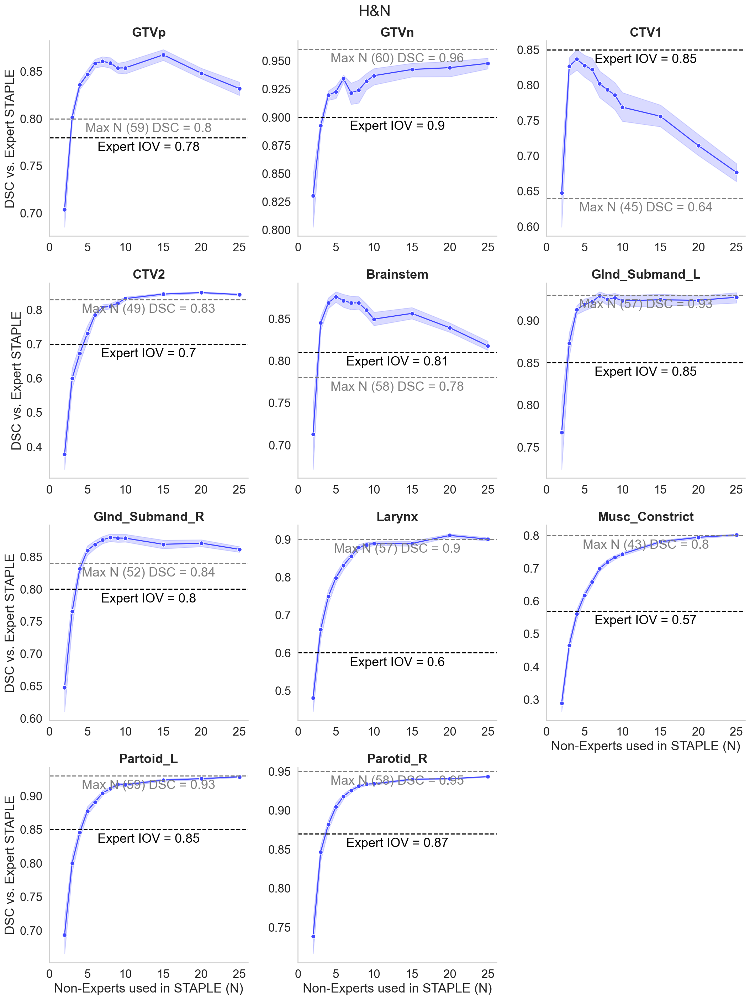

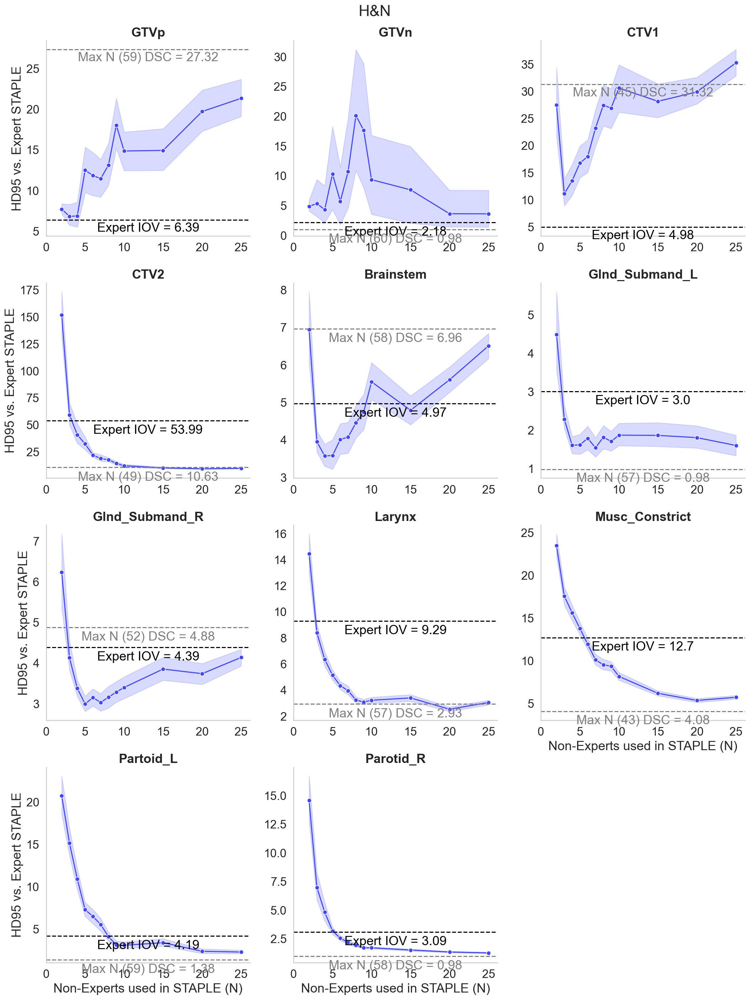

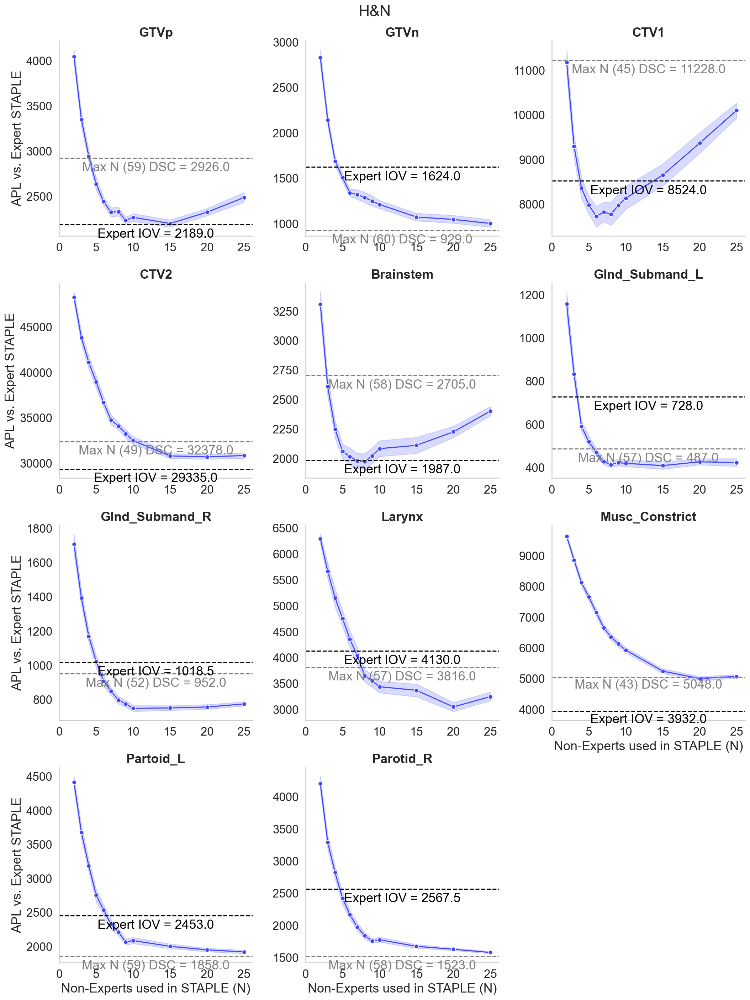

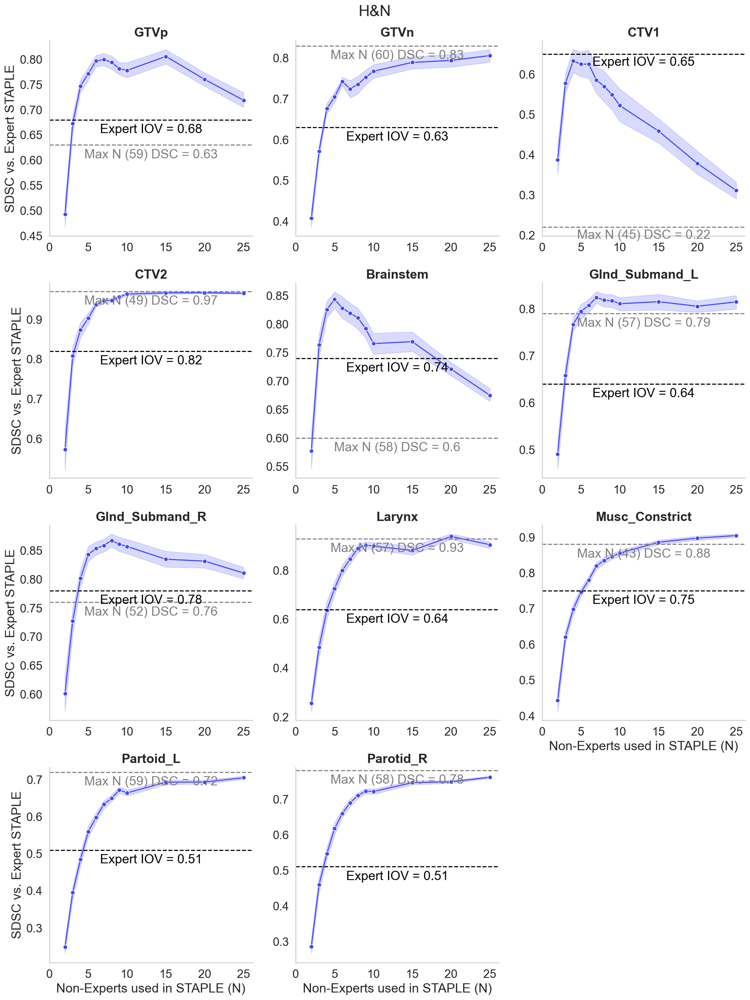

In [179]:
# TG-263 names 
ROI_dictionary = {ROI1: ROI2 for ROI1, ROI2 in zip(ROI_list, labels)}

metric_list = ["DSC_list", "HD95_list", "APL_list", "SDSC_list"]

for metric, line_dict, line_dict_maxSTAPLE in zip(metric_list, line_dict_list, line_dict_maxSTAPLE_list): # line dict defined before 
    print(metric)

    g = sns.relplot(
        data=df4_new, x="N", y=metric,
        col="ROI",
        kind="line",
        col_wrap = 3,
        facet_kws={'sharey': False, 'sharex': False},
        col_order = ROI_list, # only needed if in wrong order
        **{'marker': 'o', "err_style": 'band'}
    )

    g.set_axis_labels("Non-Experts used in STAPLE (N)", metric.split('_')[0]+" vs. Expert STAPLE")
    g.fig.suptitle('H&N')

    # flatten axes into a 1-d array
    axes = g.axes.flatten()

    # iterate through the axes
    
    for ROI, ax in zip(ROI_list, axes):

        ax.set_title(ROI_dictionary[ROI], fontdict={'fontweight':'bold'}) # TG-263 names 

        ax.set_xticks([0, 5, 10, 15, 20, 25])

        ymin, ymax = ax.get_ylim()

        xmin, xmax = ax.get_xlim()

        x_middle = (xmax-xmin)/2

        y_nudge = (ymax-ymin)/20

        value = float("{:.2f}".format(line_dict[ROI]))
        ax.axhline(value, ls='--', c='black')    
        ax.text(x_middle, value-y_nudge, "Expert IOV = " + str(value), c='black', horizontalalignment='center', verticalalignment='center')

        novice_n = df3[(df3['Class'] == "Non-Expert") & (df3['ROI'] == ROI)]['N'].values[0]

        value_maxSTAPLE = float("{:.2f}".format(line_dict_maxSTAPLE[ROI]))
        ax.axhline(value_maxSTAPLE, ls='--', c='gray')
        ax.text(x_middle, value_maxSTAPLE-y_nudge, "Max N (" + str(novice_n) +") DSC = " + str(value_maxSTAPLE), c='gray', horizontalalignment='center', verticalalignment='center')

        g.tight_layout()
        g.savefig('H&N_'+ metric.split('list')[0] + 'bootstrap.pdf')
        
    

Heatmap version here.

In [180]:
df4_reformated = df4_new.groupby(['ROI', 'N'], as_index=False).median()

In [181]:
df4_reformated 

,ROI,N,DSC_list,HD95_list,APL_list,SDSC_list
0,brainstem,2,0.776674,5.795078,3240.5,0.608645
1,brainstem,3,0.852644,3.521046,2618.0,0.780078
2,brainstem,4,0.874950,3.088162,2168.0,0.837858
3,brainstem,5,0.883841,2.929688,2037.5,0.861080
4,brainstem,6,0.878115,3.088162,1986.0,0.849486
...,...,...,...,...,...,...
127,parotid_r,9,0.933075,1.953125,1744.5,0.719052
128,parotid_r,10,0.935543,1.953125,1758.0,0.725823
129,parotid_r,15,0.940478,1.381068,1668.5,0.747593
130,parotid_r,20,0.940631,1.381068,1616.0,0.750370


In [182]:
for index, row in df4_reformated.iterrows():
    df4_reformated.loc[index, 'DSC_norm'] = row["DSC_list"]/ line_dict_list[0][row["ROI"]]
    df4_reformated.loc[index, 'SDSC_norm'] = row["SDSC_list"]/ line_dict_list[3][row["ROI"]]

In [183]:
df4_reformated

,ROI,N,DSC_list,HD95_list,APL_list,SDSC_list,DSC_norm,SDSC_norm
0,brainstem,2,0.776674,5.795078,3240.5,0.608645,0.953959,0.822958
1,brainstem,3,0.852644,3.521046,2618.0,0.780078,1.047270,1.054756
2,brainstem,4,0.874950,3.088162,2168.0,0.837858,1.074667,1.132880
3,brainstem,5,0.883841,2.929688,2037.5,0.861080,1.085588,1.164280
4,brainstem,6,0.878115,3.088162,1986.0,0.849486,1.078555,1.148603
...,...,...,...,...,...,...,...,...
127,parotid_r,9,0.933075,1.953125,1744.5,0.719052,1.076804,1.420035
128,parotid_r,10,0.935543,1.953125,1758.0,0.725823,1.079653,1.433407
129,parotid_r,15,0.940478,1.381068,1668.5,0.747593,1.085348,1.476399
130,parotid_r,20,0.940631,1.381068,1616.0,0.750370,1.085525,1.481884


In [184]:
# https://stackoverflow.com/questions/37790429/seaborn-heatmap-using-pandas-dataframe

# pivot the dataframe from long to wide form
result_DSC = df4_reformated.pivot(index='ROI', columns='N', values='DSC_norm')
result_SDSC = df4_reformated.pivot(index='ROI', columns='N', values='SDSC_norm')

In [185]:
result_DSC = result_DSC.reindex(index = ROI_list)
result_SDSC = result_SDSC.reindex(index = ROI_list)

In [186]:
result_DSC

N,2,3,4,5,6,7,8,9,10,15,20,25
ROI,,,,,,,,,,,,
gtvp,0.919501,1.029624,1.070977,1.085221,1.102614,1.105289,1.104926,1.094367,1.102142,1.115198,1.080229,1.060273
gtvn,0.940091,0.992267,1.022500,1.026500,1.037167,1.040218,1.040494,1.046031,1.047886,1.053850,1.054389,1.058096
ctv1,0.879680,0.997358,1.012423,1.012077,1.002707,0.953606,0.941053,0.928734,0.887194,0.873597,0.809402,0.774284
ctv2,0.503442,0.895545,1.025748,1.089141,1.136349,1.161140,1.166783,1.180011,1.188239,1.202608,1.210685,1.200982
brainstem,0.953959,1.047270,1.074667,1.085588,1.078555,1.075919,1.071177,1.058274,1.036150,1.054727,1.029204,0.999694
glnd_submand_l,0.979360,1.042027,1.078213,1.090051,1.094938,1.098528,1.098549,1.097837,1.097048,1.100883,1.093210,1.100866
glnd_submand_r,0.891451,0.983698,1.051167,1.088323,1.097565,1.106683,1.116419,1.111067,1.107483,1.094675,1.095204,1.077688
larynx,0.852135,1.092335,1.288270,1.348571,1.417868,1.451857,1.492729,1.496810,1.494858,1.501512,1.533891,1.517634
musc_constrict_all,0.551664,0.827078,1.004576,1.096167,1.159112,1.228190,1.263367,1.290163,1.306450,1.373957,1.393215,1.408960


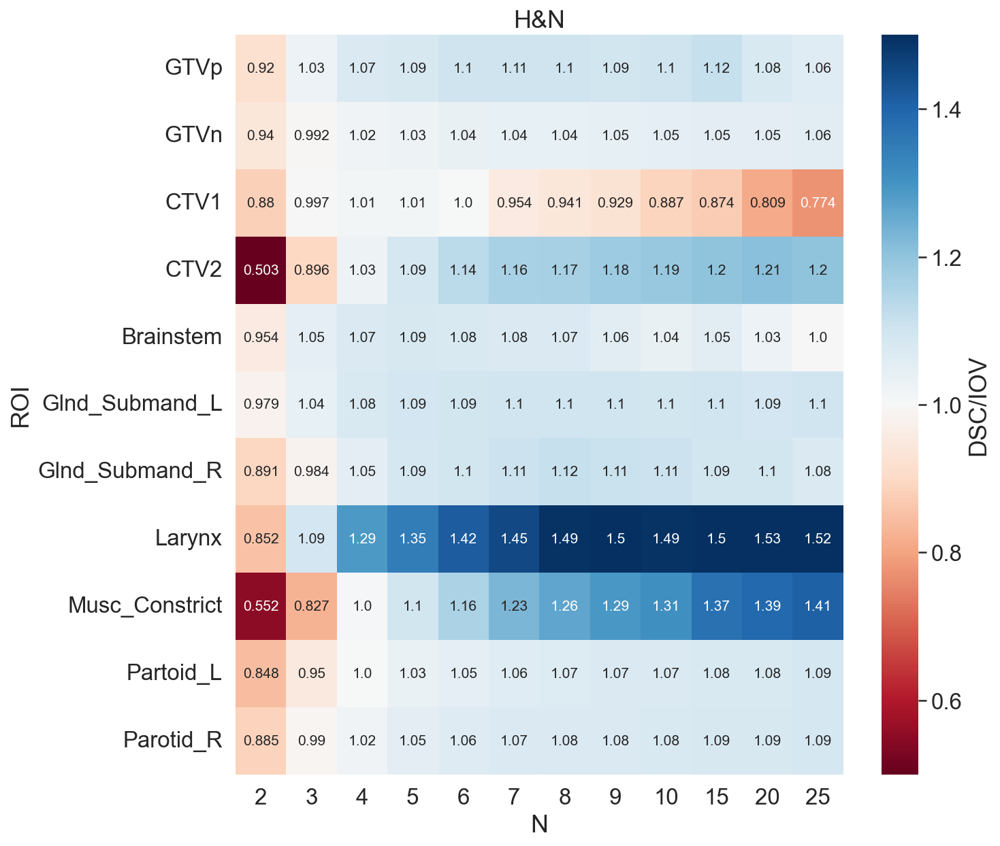

In [188]:
fig, ax = plt.subplots(figsize=(10,10))
ax = sns.heatmap(result_DSC, annot=True, fmt=".3", center=1, cmap="RdBu", 
                 vmin=0.5, vmax=1.5, 
                 cbar_kws={'label': 'DSC/IOV'},
                 annot_kws={"size": 35 / np.sqrt(len(result_DSC))})
plt.title('H&N')

# TG-263 names 
labels = ['GTVp', 'GTVn', 'CTV1', 'CTV2', 'Brainstem', 'Glnd_Submand_L', 'Glnd_Submand_R', 'Larynx', 'Musc_Constrict', 'Partoid_L', 'Parotid_R']
ax.set_yticklabels(labels)
    
plt.show()

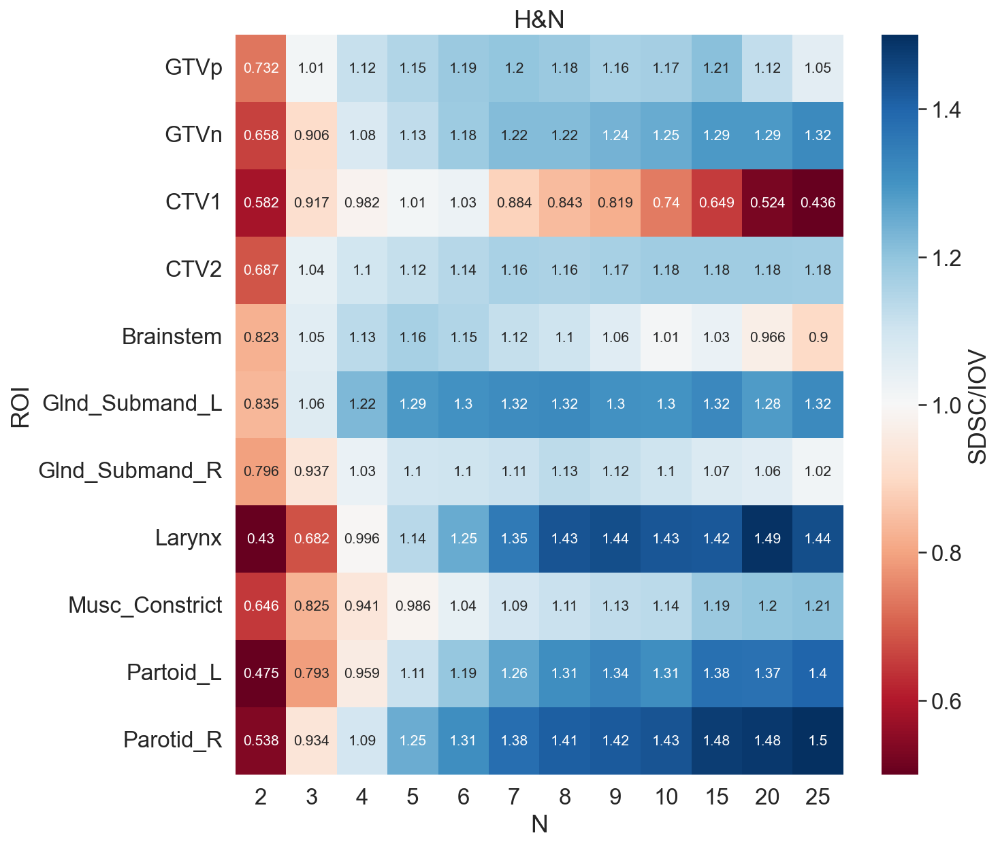

In [189]:
fig, ax = plt.subplots(figsize=(10,10))
ax = sns.heatmap(result_SDSC, annot=True, fmt=".3", center=1, cmap="RdBu", 
                 vmin=0.5, vmax=1.5, 
                 cbar_kws={'label': 'SDSC/IOV'},
                 annot_kws={"size": 35 / np.sqrt(len(result_DSC))})
plt.title('H&N')

# TG-263 names 
labels = ['GTVp', 'GTVn', 'CTV1', 'CTV2', 'Brainstem', 'Glnd_Submand_L', 'Glnd_Submand_R', 'Larynx', 'Musc_Constrict', 'Partoid_L', 'Parotid_R']
ax.set_yticklabels(labels)

plt.show()

## Part 4: GYN

### Image Processing 

In [33]:
# first make folders based on structure files and populate with copies of CT image 

In [190]:
base_path = "Case 4 (GYN)"

In [35]:
in_path = os.path.join(base_path, "GYN Structure Sets")
out_path = os.path.join(base_path, "Combined_structure_CT_DICOM")

if not os.path.isdir(out_path): # make directory if it does not exist 
    os.mkdir(out_path)

In [36]:
%%time 

structure_files = os.listdir(in_path)
for structure_file in structure_files:
    print(structure_file)
    
    structure_file_path = os.path.join(in_path, structure_file)
    
    output_folder = os.path.join(out_path, structure_file.split('.')[0])
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
        
    structure_file_path_out = os.path.join(output_folder, structure_file)
        
    shutil.copy(structure_file_path, structure_file_path_out)
    
    CT_path = os.path.join(base_path, "GYN CT")
    
    CT_files = os.listdir(CT_path)
    
    for CT_file in CT_files:
        CT_file_path = os.path.join(CT_path, CT_file)
        CT_file_path_out = os.path.join(output_folder, CT_file)
        
        shutil.copy(CT_file_path, CT_file_path_out)

RS_0017.dcm
RS_0018.dcm
RS_0027.dcm
RS_0031.dcm
RS_0032.dcm
RS_0034.dcm
RS_0048.dcm
RS_0128.dcm
RS_0129.dcm
RS_0146.dcm
RS_0182.dcm
RS_0186.dcm
RS_0267.dcm
RS_0272.dcm
RS_0292.dcm
RS_0297.dcm
RS_0304.dcm
RS_0336.dcm
RS_0362.dcm
RS_0451.dcm
RS_0472.dcm
RS_0571.dcm
RS_0586.dcm
RS_0603.dcm
RS_0613.dcm
RS_0630.dcm
RS_0634.dcm
RS_0641.dcm
RS_0645.dcm
RS_0710.dcm
RS_0716.dcm
RS_0765.dcm
RS_0767.dcm
RS_0770.dcm
RS_0799.dcm
RS_0804.dcm
RS_0866.dcm
RS_0871.dcm
RS_0873.dcm
RS_0885.dcm
RS_0933.dcm
RS_0964.dcm
RS_0978.dcm
RS_0985.dcm
RS_0997.dcm
RS_1010.dcm
RS_1023.dcm
RS_1028.dcm
RS_1039.dcm
RS_1048.dcm
Wall time: 52.1 s


In [37]:
# convert structures to nifti 

In [38]:
input_path =  os.path.join(base_path, "Combined_structure_CT_DICOM")
output_path = os.path.join(base_path, "structures_nifti")

if not os.path.isdir(output_path): # make directory if it does not exist 
    os.mkdir(output_path)

In [39]:
%%time
for folder in os.listdir(input_path):
    print(folder)
    folder_path = os.path.join(input_path, folder)
    print(folder_path)
    Dicom_reader = DicomReaderWriter(description='Examples', series_instances_dictionary = {}) # instantiate
    Dicom_reader.walk_through_folders(folder_path)
    all_rois = Dicom_reader.return_rois(print_rois=False)
    print(all_rois)
    
    output_path_folder = os.path.join(output_path, folder)
    if not os.path.isdir(output_path_folder): 
        os.mkdir(output_path_folder)
        
    for roi in all_rois:
        print(roi)
        Contour_Names = [roi] 
        Dicom_reader.set_contour_names_and_associations(Contour_Names=Contour_Names)
        try:
            Dicom_reader.get_images_and_mask()
            mask = Dicom_reader.mask # mask array
            mask_sitk_handle = Dicom_reader.annotation_handle # SimpleITK mask handle
            sitk.WriteImage(mask_sitk_handle, os.path.join(output_path_folder, roi+'.nii.gz'))
        except: 
            print("PROBLEM WITH", folder, roi)

Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0017
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0017
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0017


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.21s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0017
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small', 'ptv']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0017



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.56s/it]


ctvp_4500
gtvn
bowel_small
ptv


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0018
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0018
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0018


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.06s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0018
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0018



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.18s/it]


ctvp_4500
gtvn


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

bowel_small
PROBLEM WITH RS_0018 bowel_small
RS_0027
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0027
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0027


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.01s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0027
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0027



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.16s/it]


ctvp_4500
gtvn


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

bowel_small
PROBLEM WITH RS_0027 bowel_small
RS_0031
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0031
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0031


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.05s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0031
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0031



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.35s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0032
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0032
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0032


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.07s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0032
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0032



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.35s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0034
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0034
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0034


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.06s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0034
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0034



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.09s/it]


ctvp_4500
PROBLEM WITH RS_0034 ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0048
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0048
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0048


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.06s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0048
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0048



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.45s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0128
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0128
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0128


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.06s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0128
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0128



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.23s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0129
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0129
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0129


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.10s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0129
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0129



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.43s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0146
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0146
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0146


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.06s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0146
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0146



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.27s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0182
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0182
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0182


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.02s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0182
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0182



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.45s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0186
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0186
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0186


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.05s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0186
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0186



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.51s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0267
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0267
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0267


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.04s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0267
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0267



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.24s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0272
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0272
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0272


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.02it/s]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0272
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0272

PROBLEM WITH RS_0272 ctvn_4500
ctvp_4500
PROBLEM WITH RS_0272 ctvp_4500
gtvn
PROBLEM WITH RS_0272 gtvn
bowel_small



Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0292
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0292
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0292



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.04it/s]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0292
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0292



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.24s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0297
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0297
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0297


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.03it/s]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0297
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0297



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.98s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0304
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0304
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0304


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.05it/s]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0304
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0304



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.96s/it]


PROBLEM WITH RS_0304 ctvn_4500
ctvp_4500
PROBLEM WITH RS_0304 ctvp_4500
gtvn


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

bowel_small
PROBLEM WITH RS_0304 bowel_small
RS_0336
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0336
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0336


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.18s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0336
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bladder', 'ctv1', 'ctv2', 'ctvn_4500', 'ctvp_4500', 'gtvn', 'gtvn_meso1', 'gtvn_meso2', 'gtvn_meso3', 'ptv1', 'ptv2', 'ptv3', 'ptv_4500', 'ptvn_6000', 'rectum', 'sigmoid', 'bowel_small']
bladder
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0336



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.62s/it]


ctv1
ctv2
ctvn_4500
ctvp_4500
gtvn
gtvn_meso1
gtvn_meso2
gtvn_meso3
ptv1
ptv2
ptv3
ptv_4500
ptvn_6000
rectum
sigmoid
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0362
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0362
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0362


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.05s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0362
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0362



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.51s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0451
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0451
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0451


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.02s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0451
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0451



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.53s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0472
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0472
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0472


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.02s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0472
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctv1', 'ctv2', 'ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctv1
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0472



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.33s/it]


ctv2
ctvn_4500
ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0571
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0571
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0571


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.03s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0571
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0571



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.50s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0586
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0586
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0586


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.11s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0586
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bladder', 'bowel small', 'ctvn_4500', 'ctvp_4500', 'femural head left', 'femural head right', 'gtvn', 'ptv_4500', 'ptvn_4500', 'ptvn_5000', 'ptvp_4500', 'rectum', 'sigmoid']
bladder
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0586



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.34s/it]


bowel small
ctvn_4500
ctvp_4500
femural head left
femural head right
gtvn
ptv_4500
ptvn_4500
ptvn_5000
ptvp_4500
rectum
sigmoid


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0603
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0603
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0603


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.02s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0603
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0603



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.23s/it]


ctvp_4500
gtvn


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

bowel_small
PROBLEM WITH RS_0603 bowel_small
RS_0613
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0613
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0613


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.01s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0613
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0613



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.22s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0630
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0630
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0630


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.04s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0630
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0630



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.18s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0634
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0634
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0634


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.03s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0634
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0634



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.34s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0641
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0641
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0641


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.01it/s]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0641
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0641



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.25s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0645
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0645
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0645


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.06s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0645
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'ptvp', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0645



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.21s/it]


ctvp_4500
gtvn
ptvp
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0710
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0710
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0710


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.07s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0710
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvn_gtv', 'ctvp_4500', 'gtvn', 'sigmoid', 'vessels', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0710



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.44s/it]


ctvn_gtv
ctvp_4500
gtvn
sigmoid
vessels
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0716
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0716
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0716


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.14s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0716
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'ptvn_4500', 'ptvn_5400', 'ptvp_4500', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0716



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.33s/it]


ctvp_4500
gtvn
ptvn_4500
ptvn_5400
ptvp_4500
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0765
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0765
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0765


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.08it/s]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0765
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0765



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.96s/it]

PROBLEM WITH RS_0765 ctvn_4500
ctvp_4500



Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

gtvn
PROBLEM WITH RS_0765 gtvn
bowel_small
PROBLEM WITH RS_0765 bowel_small
RS_0767
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0767
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0767


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.03s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0767
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0767



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.02s/it]


PROBLEM WITH RS_0767 ctvn_4500
ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0770
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0770
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0770


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.04s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0770
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0770



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.29s/it]


ctvp_4500
gtvn


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

bowel_small
PROBLEM WITH RS_0770 bowel_small
RS_0799
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0799
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0799


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.03it/s]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0799
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0799



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.26s/it]


ctvp_4500
gtvn


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

bowel_small
PROBLEM WITH RS_0799 bowel_small
RS_0804
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0804
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0804


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.11s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0804
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0804



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.42s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0866
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0866
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0866


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.00s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0866
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0866



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.21s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0871
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0871
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0871


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.03it/s]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0871
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0871



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.14s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0873
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0873
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0873


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.04s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0873
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_45', 'ctvn_4500', 'ctvnodal_4500', 'ctvp_45', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_45
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0873



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.62s/it]


ctvn_4500
PROBLEM WITH RS_0873 ctvn_4500
ctvnodal_4500
ctvp_45
ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0885
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0885
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0885


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.07s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0885
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0885



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.56s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0933
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0933
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0933


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.02s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0933
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0933



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.87s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0964
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0964
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0964


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.03s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0964
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0964



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.21s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0978
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0978
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0978


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.13s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0978
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0978



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.71s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0985
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0985
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0985


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.16it/s]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0985
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0985



Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

ctvp_4500
PROBLEM WITH RS_0985 ctvp_4500
gtvn
PROBLEM WITH RS_0985 gtvn
bowel_small
PROBLEM WITH RS_0985 bowel_small
RS_0997
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0997
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0997


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.00it/s]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0997
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_0997



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.38s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_1010
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_1010
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_1010


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.08s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_1010
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'ptv 45g', 'ptv n55', 'ptv45', 'ptvn45', 'ctv-l', 'ctvn']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_1010



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.24s/it]


ctvp_4500
gtvn
ptv 45g
ptv n55
ptv45
ptvn45
ctv-l
ctvn


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_1023
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_1023
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_1023


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.03it/s]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_1023
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_1023



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.23s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_1028
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_1028
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_1028


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.02s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_1028
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_1028



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.18s/it]


ctvp_4500
gtvn
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_1039
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_1039
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_1039


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.16s/it]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_1039
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'vessels', 'vessels + 7', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_1039



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.42s/it]


ctvp_4500
gtvn
vessels
vessels + 7
bowel_small


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_1048
Case 4 (GYN)\Combined_structure_CT_DICOM\RS_1048
Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_1048


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.04it/s]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_1048
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']
ctvn_4500
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_1048



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.14s/it]


ctvp_4500
gtvn
bowel_small
PROBLEM WITH RS_1048 bowel_small
Wall time: 8min 1s


In [40]:
# convert CT to nifti

In [41]:
input_path = os.path.join(base_path, "Combined_structure_CT_DICOM")
output_path = os.path.join(base_path, "CT_nifti")

if not os.path.isdir(output_path): # make directory if it does not exist 
    os.mkdir(output_path)

In [42]:
Dicom_reader = DicomReaderWriter(description='Examples', series_instances_dictionary = {}) # instantiate
Dicom_reader.walk_through_folders(folder_path)
Dicom_reader.get_images()
dicom_sitk_handle = Dicom_reader.dicom_handle # SimpleITK image handle
sitk.WriteImage(dicom_sitk_handle, os.path.join(output_path, 'Image.nii.gz'))

Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

Loading from Case 4 (GYN)\Combined_structure_CT_DICOM\RS_1048


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.39it/s]

Compiling dictionaries together...
Index 0, description None at Case 4 (GYN)\Combined_structure_CT_DICOM\RS_1048
1 unique series IDs were found. Default is index 0, to change use set_index(index)
Loading images for None at 
 Case 4 (GYN)\Combined_structure_CT_DICOM\RS_1048



In [43]:
# now make folders based on excel stratifications 

In [44]:
# make 3 folders in structures_nifti_stratified named "Novice", "Expert"

stratified_path = os.path.join(base_path, "structures_nifti_stratified")
if not os.path.isdir(stratified_path): # make directory if it does not exist 
    os.mkdir(stratified_path)

observer_list = ["Expert", "Non-Expert"]

for observer in observer_list:
    observer_path = os.path.join(stratified_path, observer)
    if not os.path.isdir(observer_path): # make directory if it does not exist 
        os.mkdir(observer_path)

In [45]:
in_path = os.path.join(base_path, "structures_nifti")
out_path = os.path.join(base_path, "structures_nifti_stratified")

In [48]:
excel_df = pd.read_excel("C3RO Case Contour Key for Fuller Lab.xlsx", sheet_name=3)

In [49]:
excel_df

,C3RO ID,Group
0,17,Non-Expert
1,18,Non-Expert
2,27,Non-Expert
3,31,Non-Expert
4,32,Non-Expert
5,34,Non-Expert
6,48,Non-Expert
7,128,Non-Expert
8,129,Expert
9,146,Non-Expert


In [51]:
nonexpert_list = excel_df[excel_df['Group'] == "Non-Expert"]['C3RO ID'].tolist()
expert_list = excel_df[excel_df['Group'] == "Expert"]['C3RO ID'].tolist()

In [52]:
print(len(nonexpert_list), len(expert_list))

45 5


In [53]:
IDs = os.listdir(in_path)
for ID in IDs:
    ID_path = os.path.join(in_path, ID)
    print(ID_path)
    ID_real = int(ID.split('_')[1].lstrip('0')) # this changed for H&N
    print(ID_real)
    if ID_real in nonexpert_list:
        folder_name = "Non-Expert"
    elif ID_real in expert_list:
        folder_name = "Expert"
    ID_path_out = os.path.join(out_path, folder_name, ID)
    print(ID_path_out)
    
    if not os.path.exists(ID_path_out):
        shutil.copytree(ID_path, ID_path_out)

Case 4 (GYN)\structures_nifti\RS_0017
17
Case 4 (GYN)\structures_nifti_stratified\Non-Expert\RS_0017
Case 4 (GYN)\structures_nifti\RS_0018
18
Case 4 (GYN)\structures_nifti_stratified\Non-Expert\RS_0018
Case 4 (GYN)\structures_nifti\RS_0027
27
Case 4 (GYN)\structures_nifti_stratified\Non-Expert\RS_0027
Case 4 (GYN)\structures_nifti\RS_0031
31
Case 4 (GYN)\structures_nifti_stratified\Non-Expert\RS_0031
Case 4 (GYN)\structures_nifti\RS_0032
32
Case 4 (GYN)\structures_nifti_stratified\Non-Expert\RS_0032
Case 4 (GYN)\structures_nifti\RS_0034
34
Case 4 (GYN)\structures_nifti_stratified\Non-Expert\RS_0034
Case 4 (GYN)\structures_nifti\RS_0048
48
Case 4 (GYN)\structures_nifti_stratified\Non-Expert\RS_0048
Case 4 (GYN)\structures_nifti\RS_0128
128
Case 4 (GYN)\structures_nifti_stratified\Non-Expert\RS_0128
Case 4 (GYN)\structures_nifti\RS_0129
129
Case 4 (GYN)\structures_nifti_stratified\Expert\RS_0129
Case 4 (GYN)\structures_nifti\RS_0146
146
Case 4 (GYN)\structures_nifti_stratified\Non-Expert

In [56]:
in_path = os.path.join(base_path, "structures_nifti_stratified")

out_path = os.path.join(base_path, "structures_nifti_stratified_STAPLE")
if not os.path.isdir(out_path): # make directory if it does not exist 
    os.mkdir(out_path)

observer_list = ["Expert", "Non-Expert"]
for observer in observer_list:
    observer_path = os.path.join(out_path, observer)
    if not os.path.isdir(observer_path): # make directory if it does not exist 
        os.mkdir(observer_path)

In [57]:
%%time 

ROI_list = ['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']

classes = os.listdir(in_path)

for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        file_list = []
        print(class_)
        class_path = os.path.join(in_path, class_)
        
        output_folder = os.path.join(out_path, class_) # make subfolder if it does not exist 
        print(output_folder)
            
        IDs = os.listdir(class_path)
        for ID in IDs:
            #print(ID)
            ID_path = os.path.join(class_path, ID)
            structures = os.listdir(ID_path)
            for structure in structures:
                structure_path = os.path.join(ID_path, structure)
                if structure.split('.')[0] == ROI:
                    file_list.append(structure_path)
                    
        print(file_list)
        
        segmentations = [sitk.ReadImage(file_name, sitk.sitkUInt8) for file_name in file_list]
        
        foregroundValue = 1
        threshold = 0.95
        reference_segmentation_STAPLE_probabilities = sitk.STAPLE(segmentations, foregroundValue) 
        reference_segmentation_STAPLE = reference_segmentation_STAPLE_probabilities > threshold
        #print('test')
        
        output_file_path = os.path.join(output_folder, ROI+'STAPLE.nii.gz')
        print(output_file_path)
        
        sitk.WriteImage(reference_segmentation_STAPLE, output_file_path) # idk if this will work but worth a shot..           

ctvn_4500
Expert
Case 4 (GYN)\structures_nifti_stratified_STAPLE\Expert
['Case 4 (GYN)\\structures_nifti_stratified\\Expert\\RS_0129\\ctvn_4500.nii.gz', 'Case 4 (GYN)\\structures_nifti_stratified\\Expert\\RS_0997\\ctvn_4500.nii.gz', 'Case 4 (GYN)\\structures_nifti_stratified\\Expert\\RS_1028\\ctvn_4500.nii.gz', 'Case 4 (GYN)\\structures_nifti_stratified\\Expert\\RS_1039\\ctvn_4500.nii.gz', 'Case 4 (GYN)\\structures_nifti_stratified\\Expert\\RS_1048\\ctvn_4500.nii.gz']
Case 4 (GYN)\structures_nifti_stratified_STAPLE\Expert\ctvn_4500STAPLE.nii.gz
Non-Expert
Case 4 (GYN)\structures_nifti_stratified_STAPLE\Non-Expert
['Case 4 (GYN)\\structures_nifti_stratified\\Non-Expert\\RS_0017\\ctvn_4500.nii.gz', 'Case 4 (GYN)\\structures_nifti_stratified\\Non-Expert\\RS_0018\\ctvn_4500.nii.gz', 'Case 4 (GYN)\\structures_nifti_stratified\\Non-Expert\\RS_0027\\ctvn_4500.nii.gz', 'Case 4 (GYN)\\structures_nifti_stratified\\Non-Expert\\RS_0031\\ctvn_4500.nii.gz', 'Case 4 (GYN)\\structures_nifti_stratified

gtvn
Expert
Case 4 (GYN)\structures_nifti_stratified_STAPLE\Expert
['Case 4 (GYN)\\structures_nifti_stratified\\Expert\\RS_0129\\gtvn.nii.gz', 'Case 4 (GYN)\\structures_nifti_stratified\\Expert\\RS_0997\\gtvn.nii.gz', 'Case 4 (GYN)\\structures_nifti_stratified\\Expert\\RS_1028\\gtvn.nii.gz', 'Case 4 (GYN)\\structures_nifti_stratified\\Expert\\RS_1039\\gtvn.nii.gz', 'Case 4 (GYN)\\structures_nifti_stratified\\Expert\\RS_1048\\gtvn.nii.gz']
Case 4 (GYN)\structures_nifti_stratified_STAPLE\Expert\gtvnSTAPLE.nii.gz
Non-Expert
Case 4 (GYN)\structures_nifti_stratified_STAPLE\Non-Expert
['Case 4 (GYN)\\structures_nifti_stratified\\Non-Expert\\RS_0017\\gtvn.nii.gz', 'Case 4 (GYN)\\structures_nifti_stratified\\Non-Expert\\RS_0018\\gtvn.nii.gz', 'Case 4 (GYN)\\structures_nifti_stratified\\Non-Expert\\RS_0027\\gtvn.nii.gz', 'Case 4 (GYN)\\structures_nifti_stratified\\Non-Expert\\RS_0031\\gtvn.nii.gz', 'Case 4 (GYN)\\structures_nifti_stratified\\Non-Expert\\RS_0032\\gtvn.nii.gz', 'Case 4 (GYN)\\str

In [58]:
# calculate interobserver DSC for each category, updating for all metrics except SDSC which requires median of pairwise 95% HD

In [59]:
in_path = os.path.join(base_path, "structures_nifti_stratified")

In [60]:
%%time 

ROI_list = ['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']

classes = ["Expert", "Non-Expert"] # for just getting Expert and Non-Expert 

df = pd.DataFrame(columns=['ROI', 'Class', 'DSC_list', 'HD95_list', 'ASD_list', 'APL_list'])
counter = -1  

for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        file_list = []
        print(class_)
        class_path = os.path.join(in_path, class_)
        
        IDs = os.listdir(class_path)
        for ID in IDs:
            #print(ID)
            ID_path = os.path.join(class_path, ID)
            structures = os.listdir(ID_path)
            for structure in structures:
                structure_path = os.path.join(ID_path, structure)
                if structure.split('.')[0] == ROI:
                    file_list.append(structure_path)
        
        # trying extra metrics really quick
        
        DSC_list, HD95_list, ASD_list, APL_list = pairwise_main(file_list)
        print(DSC_list, len(DSC_list))
        print(HD95_list, len(HD95_list))
        print(ASD_list, len(ASD_list))
        print(APL_list, len(APL_list))
        
        counter +=1
        df.loc[counter] = [ROI, class_, DSC_list, HD95_list, ASD_list, APL_list]
        print(df)

ctvn_4500
Expert
[0.6815057313456334, 0.6928390221700419, 0.7196545699521758, 0.8256330717199819, 0.7567581552047281, 0.7005892381778482, 0.711357429640744, 0.6177769497989107, 0.7263819706487495, 0.7156774441878367] 10
[22.46092653274536, 25.45090804784357, 23.437488555908203, 5.03224281028629, 12.801538465382636, 13.810672576553994, 20.53104079697581, 24.287818174371868, 23.437488555908203, 22.46092653274536] 10
[3.3666357296700973, 3.187552605474417, 3.041987726648698, 1.3975502883846147, 2.0433814304819062, 2.9998568194262942, 2.9710807674981448, 4.209547499864685, 2.79504881620958, 3.180905866245325] 10
[49884, 37238, 54686, 42709, 34773, 59891, 46781, 64112, 49937, 48765] 10
         ROI   Class                                           DSC_list  \
0  ctvn_4500  Expert  [0.6815057313456334, 0.6928390221700419, 0.719...   

                                           HD95_list  \
0  [22.46092653274536, 25.45090804784357, 23.4374...   

                                            AS

[0.5665632729985473, 0.7979566155508301, 0.674002868521359, 0.6834433963948842, 0.675484832469134, 0.8264528635599623, 0.8174411960485158, 0.7670875791326721, 0.7934574752891782, 0.8353277225197654] 10
[45.46757040673179, 8.655315345268535, 29.806004113309285, 16.912572147528884, 52.571213373876155, 14.112593749158076, 25.172405116427715, 32.62887418412838, 18.295426435164053, 12.918053749297249] 10
[8.691911357206024, 2.4359671702435417, 5.469986211513023, 4.389009595521694, 6.903366672371571, 2.470042670282422, 3.1946432048147804, 4.437720018717423, 2.7457528477729074, 2.7295488546708695] 10
[17992, 25214, 20139, 22197, 28658, 17246, 18136, 14615, 16023, 18593] 10
         ROI       Class                                           DSC_list  \
0  ctvn_4500      Expert  [0.6815057313456334, 0.6928390221700419, 0.719...   
1  ctvn_4500  Non-Expert  [0.437672291054497, 0.43909080400224343, 0.417...   
2  ctvp_4500      Expert  [0.5665632729985473, 0.7979566155508301, 0.674...   

        

[0.7697160883280757, 0.8406914893617021, 0.776864630175221, 0.81632, 0.8470505945441827, 0.729452510989743, 0.7006020799124247, 0.795578481945468, 0.7789249924081385, 0.814868540344515] 10
[62.216907190373995, 2.6839659806122547, 3.08816026961669, 2.762134515310799, 62.02404960976551, 64.69559530585903, 63.68545517877711, 5.367931961224509, 3.725504943047482, 2.6839659806122547] 10
[4.069324176771129, 0.5557042183748362, 0.9322416584156543, 0.7139930437153582, 3.65624962101778, 4.6128832482679405, 4.609800068957736, 0.9161582863339146, 0.9238910301462697, 0.738614901878563] 10
[1397, 973, 794, 607, 881, 744, 934, 627, 685, 756] 10
         ROI       Class                                           DSC_list  \
0  ctvn_4500      Expert  [0.6815057313456334, 0.6928390221700419, 0.719...   
1  ctvn_4500  Non-Expert  [0.437672291054497, 0.43909080400224343, 0.417...   
2  ctvp_4500      Expert  [0.5665632729985473, 0.7979566155508301, 0.674...   
3  ctvp_4500  Non-Expert  [0.7328586099983938

[0.8084504026373981, 0.6524209000532382, 0.8722536872096094, 0.7728530619303187, 0.8591212713218311, 0.6915672410703619] 6
[24.414050579071045, 39.34483950887324, 9.18973435834138, 19.216557756666226, 17.578116416931152, 33.42573101104517] 6
[5.045059977449519, 10.037845929624002, 3.040845824379027, 5.020500923565827, 3.3765041229576935, 7.385056601876087] 6
[108267, 102658, 114684, 90551, 105180, 116716] 6
           ROI       Class                                           DSC_list  \
0    ctvn_4500      Expert  [0.6815057313456334, 0.6928390221700419, 0.719...   
1    ctvn_4500  Non-Expert  [0.437672291054497, 0.43909080400224343, 0.417...   
2    ctvp_4500      Expert  [0.5665632729985473, 0.7979566155508301, 0.674...   
3    ctvp_4500  Non-Expert  [0.7328586099983938, 0.8672345629680756, 0.804...   
4         gtvn      Expert  [0.7697160883280757, 0.8406914893617021, 0.776...   
5         gtvn  Non-Expert  [0.1381243891146664, 0.17768864377036853, 0.13...   
6  bowel_small      Ex

In [61]:
df

,ROI,Class,DSC_list,HD95_list,ASD_list,APL_list
0,ctvn_4500,Expert,"[0.6815057313456334, 0.6928390221700419, 0.719...","[22.46092653274536, 25.45090804784357, 23.4374...","[3.3666357296700973, 3.187552605474417, 3.0419...","[49884, 37238, 54686, 42709, 34773, 59891, 467..."
1,ctvn_4500,Non-Expert,"[0.437672291054497, 0.43909080400224343, 0.417...","[31.78496574756526, 26.765896289603855, 30.693...","[5.412301036263656, 4.4623145655969125, 5.3936...","[44470, 45897, 63219, 60687, 36893, 54675, 518..."
2,ctvp_4500,Expert,"[0.5665632729985473, 0.7979566155508301, 0.674...","[45.46757040673179, 8.655315345268535, 29.8060...","[8.691911357206024, 2.4359671702435417, 5.4699...","[17992, 25214, 20139, 22197, 28658, 17246, 181..."
3,ctvp_4500,Non-Expert,"[0.7328586099983938, 0.8672345629680756, 0.804...","[15.283424369746301, 13.644442168120307, 8.400...","[3.429315939586896, 1.713739425060099, 2.25979...","[26030, 14210, 15630, 21800, 9313, 9062, 12700..."
4,gtvn,Expert,"[0.7697160883280757, 0.8406914893617021, 0.776...","[62.216907190373995, 2.6839659806122547, 3.088...","[4.069324176771129, 0.5557042183748362, 0.9322...","[1397, 973, 794, 607, 881, 744, 934, 627, 685,..."
5,gtvn,Non-Expert,"[0.1381243891146664, 0.17768864377036853, 0.13...","[51.34933762574967, 43.89100406540597, 47.6217...","[11.840228477278966, 9.509871157559388, 10.689...","[907, 1089, 940, 969, 259, 929, 918, 1809, 517..."
6,bowel_small,Expert,"[0.8084504026373981, 0.6524209000532382, 0.872...","[24.414050579071045, 39.34483950887324, 9.1897...","[5.045059977449519, 10.037845929624002, 3.0408...","[108267, 102658, 114684, 90551, 105180, 116716]"
7,bowel_small,Non-Expert,"[0.4175701194773986, 0.326305132834666, 0.3498...","[20.07431513638519, 28.846683543912977, 25.755...","[6.062791259717345, 12.986256129089274, 7.0890...","[119352, 132356, 105826, 119597, 89493, 73897,..."


In [62]:
# add in SDSC 

In [63]:
%%time
ROI_list = ['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']

classes = ["Expert", "Non-Expert"] # for just getting Expert and Non-Expert 

counter = -1  

SDSC_master_list = []
for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        file_list = []
        print(class_)
        class_path = os.path.join(in_path, class_)
        
        IDs = os.listdir(class_path)
        for ID in IDs:
            #print(ID)
            ID_path = os.path.join(class_path, ID)
            structures = os.listdir(ID_path)
            for structure in structures:
                structure_path = os.path.join(ID_path, structure)
                if structure.split('.')[0] == ROI:
                    file_list.append(structure_path)
        
        # trying extra metrics really quick
        tolerance = np.median(df[(df["ROI"] == ROI) & (df["Class"] == "Expert")]["ASD_list"].values[0]) # get tolerance
        SDSC_list = pairwise_SDSC(file_list, tolerance)
        print(SDSC_list, len(SDSC_list))
        SDSC_master_list.append(SDSC_list)
        

ctvn_4500
Expert
[0.7227403484066203, 0.7370010559716664, 0.7695978557008507, 0.8696891222669634, 0.8387310608685523, 0.6824882125924209, 0.7614493549498953, 0.6411036613526876, 0.7901523378050787, 0.7327076906908555] 10
Non-Expert
[0.6118471193300665, 0.6171662249710183, 0.5229088866391699, 0.5142490188205867, 0.6008601041646261, 0.634435569127655, 0.5977732801321552, 0.6190365954013005, 0.5711688375570451, 0.5686182374010006, 0.5226122252218904, 0.14599441088475562, 0.3053822093644089, 0.6403689282851621, 0.5999716438420652, 0.6968412840281084, 0.6570403995705363, 0.5413702561185237, 0.620926096138488, 0.6721341737381794, 0.7038486512286336, 0.5809285407187115, 0.5884590984922551, 0.6807845557661466, 0.6910121044372596, 0.44534304495782767, 0.6392190665087398, 0.460787682658595, 0.4624721106593526, 0.533611505200165, 0.6106921273834007, 0.6467996911498429, 0.6395671674496254, 0.6323698346317749, 0.6401935454530912, 0.6469166871411061, 0.6266438050257056, 0.5426287653781795, 0.6819183

[0.3253555611107736, 0.7550412700162946, 0.5029025999766634, 0.5304888031104473, 0.6004015547493222, 0.7833835139670672, 0.7815358288468873, 0.7249655170772628, 0.778150526154438, 0.7772869091074328] 10
Non-Expert
[0.6493069989975407, 0.9119772324432797, 0.8078665175997751, 0.7588299301334159, 0.8348367438620934, 0.8106245951314363, 0.8805779745701887, 0.7901427958267383, 0.7689337010259755, 0.9030231249631979, 0.651610014902065, 0.8857980924995663, 0.882417376646426, 0.8956799879673589, 0.633468590436203, 0.8946062131501551, 0.48038413847592865, 0.8007668162101442, 0.6951800512795789, 0.799649039785564, 0.6729611783666477, 0.8265327438691231, 0.8104381971450884, 0.8868888372769622, 0.5609385448179212, 0.8685966347230824, 0.3177025628705837, 0.8767726863772483, 0.5286091074262431, 0.6924891319424774, 0.8755235976469968, 0.8171338986860858, 0.6990158482122377, 0.6438329932212665, 0.7668082527314681, 0.7390311299226487, 0.9419924281025229, 0.8707685703985529, 0.856020404317624, 0.8873821

[0.4088624178111727, 0.5843593755209581, 0.39329227185474985, 0.44994204220103057, 0.547649651114096, 0.36943190114418584, 0.20534314185526217, 0.4773873467750874, 0.38641965826390867, 0.4378325104619473] 10
Non-Expert
[0.04682051013423458, 0.08342903298119447, 0.05624161043360382, 0.07049617177765996, 0.0, 0.06676996734467347, 0.06029935459196883, 0.04640712708658171, 0.19143595197715763, 0.07303119873320765, 0.07732626147216114, 0.06872547174614099, 0.06931706091317814, 0.08409428609622045, 0.06426761349432379, 0.16876899324032366, 0.06726132287556143, 0.06967588778913465, 0.07592347603401724, 0.05474225794379394, 0.16041595070754786, 0.21287289104006982, 0.09183656020462912, 0.0640414848846173, 0.06884876664253689, 0.055843525014816625, 0.07107355544557938, 0.07339611987787989, 0.07687916780404061, 0.06734305866090336, 0.06439699173097291, 0.0568992551875768, 0.06574807824243446, 0.0762169150908815, 0.04112207240681367, 0.03634812780343395, 0.05798427118313877, 0.04430420634762565, 

[0.6884263579711324, 0.5158985195968194, 0.7951186075169523, 0.6978150065056029, 0.8171339504947738, 0.6608061714564352] 6
Non-Expert
[0.5685957147901355, 0.2102518643160865, 0.513061382015364, 0.3215068061036211, 0.46551129614353304, 0.6024550379261991, 0.2963301195006058, 0.44226698396979985, 0.4875470042422189, 0.04558307687367774, 0.48078968879255046, 0.4309721455086327, 0.20202443824790217, 0.6252657574076511, 0.34957725256492794, 0.3889263892220934, 0.6228175242424124, 0.6170986197000055, 0.12770685856277417, 0.4790577119786368, 0.17911070071798812, 0.38268150082306457, 0.6822649750545992, 0.3406543954721401, 0.18776225129554974, 0.4549092363744225, 0.23883334083834729, 0.45986815759281235, 0.2638024211544157, 0.7348805254351499, 0.20964390799368599, 0.24093195818905386, 0.20270470898984455, 0.42304234382017425, 0.6334796487928098, 0.6881092007053498, 0.6214493428276658, 0.6338873723911382, 0.571667711712342, 0.6558143893961265, 0.7290452185894994, 0.2997466159469363, 0.238909897

In [64]:
print(len(SDSC_master_list))

8


In [65]:
df['SDSC_list'] = SDSC_master_list

In [66]:
df

,ROI,Class,DSC_list,HD95_list,ASD_list,APL_list,SDSC_list
0,ctvn_4500,Expert,"[0.6815057313456334, 0.6928390221700419, 0.719...","[22.46092653274536, 25.45090804784357, 23.4374...","[3.3666357296700973, 3.187552605474417, 3.0419...","[49884, 37238, 54686, 42709, 34773, 59891, 467...","[0.7227403484066203, 0.7370010559716664, 0.769..."
1,ctvn_4500,Non-Expert,"[0.437672291054497, 0.43909080400224343, 0.417...","[31.78496574756526, 26.765896289603855, 30.693...","[5.412301036263656, 4.4623145655969125, 5.3936...","[44470, 45897, 63219, 60687, 36893, 54675, 518...","[0.6118471193300665, 0.6171662249710183, 0.522..."
2,ctvp_4500,Expert,"[0.5665632729985473, 0.7979566155508301, 0.674...","[45.46757040673179, 8.655315345268535, 29.8060...","[8.691911357206024, 2.4359671702435417, 5.4699...","[17992, 25214, 20139, 22197, 28658, 17246, 181...","[0.3253555611107736, 0.7550412700162946, 0.502..."
3,ctvp_4500,Non-Expert,"[0.7328586099983938, 0.8672345629680756, 0.804...","[15.283424369746301, 13.644442168120307, 8.400...","[3.429315939586896, 1.713739425060099, 2.25979...","[26030, 14210, 15630, 21800, 9313, 9062, 12700...","[0.6493069989975407, 0.9119772324432797, 0.807..."
4,gtvn,Expert,"[0.7697160883280757, 0.8406914893617021, 0.776...","[62.216907190373995, 2.6839659806122547, 3.088...","[4.069324176771129, 0.5557042183748362, 0.9322...","[1397, 973, 794, 607, 881, 744, 934, 627, 685,...","[0.4088624178111727, 0.5843593755209581, 0.393..."
5,gtvn,Non-Expert,"[0.1381243891146664, 0.17768864377036853, 0.13...","[51.34933762574967, 43.89100406540597, 47.6217...","[11.840228477278966, 9.509871157559388, 10.689...","[907, 1089, 940, 969, 259, 929, 918, 1809, 517...","[0.04682051013423458, 0.08342903298119447, 0.0..."
6,bowel_small,Expert,"[0.8084504026373981, 0.6524209000532382, 0.872...","[24.414050579071045, 39.34483950887324, 9.1897...","[5.045059977449519, 10.037845929624002, 3.0408...","[108267, 102658, 114684, 90551, 105180, 116716]","[0.6884263579711324, 0.5158985195968194, 0.795..."
7,bowel_small,Non-Expert,"[0.4175701194773986, 0.326305132834666, 0.3498...","[20.07431513638519, 28.846683543912977, 25.755...","[6.062791259717345, 12.986256129089274, 7.0890...","[119352, 132356, 105826, 119597, 89493, 73897,...","[0.5685957147901355, 0.2102518643160865, 0.513..."


In [191]:
pickle_path = os.path.join(base_path, 'df_full_GYN.pkl') # newest
#df.to_pickle(pickle_path)

In [192]:
df_pickle = pd.read_pickle(pickle_path)

In [193]:
df_pickle

,ROI,Class,DSC_list,HD95_list,ASD_list,APL_list,SDSC_list
0,ctvn_4500,Expert,"[0.6815057313456334, 0.6928390221700419, 0.719...","[22.46092653274536, 25.45090804784357, 23.4374...","[3.3666357296700973, 3.187552605474417, 3.0419...","[49884, 37238, 54686, 42709, 34773, 59891, 467...","[0.7227403484066203, 0.7370010559716664, 0.769..."
1,ctvn_4500,Non-Expert,"[0.437672291054497, 0.43909080400224343, 0.417...","[31.78496574756526, 26.765896289603855, 30.693...","[5.412301036263656, 4.4623145655969125, 5.3936...","[44470, 45897, 63219, 60687, 36893, 54675, 518...","[0.6118471193300665, 0.6171662249710183, 0.522..."
2,ctvp_4500,Expert,"[0.5665632729985473, 0.7979566155508301, 0.674...","[45.46757040673179, 8.655315345268535, 29.8060...","[8.691911357206024, 2.4359671702435417, 5.4699...","[17992, 25214, 20139, 22197, 28658, 17246, 181...","[0.3253555611107736, 0.7550412700162946, 0.502..."
3,ctvp_4500,Non-Expert,"[0.7328586099983938, 0.8672345629680756, 0.804...","[15.283424369746301, 13.644442168120307, 8.400...","[3.429315939586896, 1.713739425060099, 2.25979...","[26030, 14210, 15630, 21800, 9313, 9062, 12700...","[0.6493069989975407, 0.9119772324432797, 0.807..."
4,gtvn,Expert,"[0.7697160883280757, 0.8406914893617021, 0.776...","[62.216907190373995, 2.6839659806122547, 3.088...","[4.069324176771129, 0.5557042183748362, 0.9322...","[1397, 973, 794, 607, 881, 744, 934, 627, 685,...","[0.4088624178111727, 0.5843593755209581, 0.393..."
5,gtvn,Non-Expert,"[0.1381243891146664, 0.17768864377036853, 0.13...","[51.34933762574967, 43.89100406540597, 47.6217...","[11.840228477278966, 9.509871157559388, 10.689...","[907, 1089, 940, 969, 259, 929, 918, 1809, 517...","[0.04682051013423458, 0.08342903298119447, 0.0..."
6,bowel_small,Expert,"[0.8084504026373981, 0.6524209000532382, 0.872...","[24.414050579071045, 39.34483950887324, 9.1897...","[5.045059977449519, 10.037845929624002, 3.0408...","[108267, 102658, 114684, 90551, 105180, 116716]","[0.6884263579711324, 0.5158985195968194, 0.795..."
7,bowel_small,Non-Expert,"[0.4175701194773986, 0.326305132834666, 0.3498...","[20.07431513638519, 28.846683543912977, 25.755...","[6.062791259717345, 12.986256129089274, 7.0890...","[119352, 132356, 105826, 119597, 89493, 73897,...","[0.5685957147901355, 0.2102518643160865, 0.513..."


### Interobserver Variability Analysis

In [195]:
# FIRST NEED TO GENERATE EXPLODED DATAFRAME

df_pickle_explode = df_pickle.explode(['DSC_list', 'HD95_list', 'ASD_list', 'APL_list', 'SDSC_list'])

In [196]:
df_pickle_explode

,ROI,Class,DSC_list,HD95_list,ASD_list,APL_list,SDSC_list
0,ctvn_4500,Expert,0.681506,22.460927,3.366636,49884,0.72274
0,ctvn_4500,Expert,0.692839,25.450908,3.187553,37238,0.737001
0,ctvn_4500,Expert,0.719655,23.437489,3.041988,54686,0.769598
0,ctvn_4500,Expert,0.825633,5.032243,1.39755,42709,0.869689
0,ctvn_4500,Expert,0.756758,12.801538,2.043381,34773,0.838731
...,...,...,...,...,...,...,...
7,bowel_small,Non-Expert,0.904827,10.742182,2.719381,112292,0.837269
7,bowel_small,Non-Expert,0.513331,33.073352,10.429203,118163,0.412371
7,bowel_small,Non-Expert,0.896552,13.218424,2.869204,111076,0.817982
7,bowel_small,Non-Expert,0.573477,28.490295,7.967078,115098,0.528475


In [197]:
df_pickle_explode['DSC_list']=df_pickle_explode['DSC_list'].astype('float64') # need this for violinplot for some reason
df_pickle_explode['HD95_list']=df_pickle_explode['HD95_list'].astype('float64')
df_pickle_explode['ASD_list']=df_pickle_explode['ASD_list'].astype('float64')
df_pickle_explode['APL_list']=df_pickle_explode['APL_list'].astype('float64')
df_pickle_explode['SDSC_list']=df_pickle_explode['SDSC_list'].astype('float64')

In [198]:
df_pickle_explode.groupby(['Class', 'ROI']).median() # tolerance values 

DSC_list  HD95_list  ASD_list  APL_list  SDSC_list
Class      ROI                                                            
Expert     bowel_small  0.790652  21.815304  5.032780  106723.5   0.693121
           ctvn_4500    0.713517  22.460927  3.020922   49324.5   0.749225
           ctvp_4500    0.780273  21.733916  3.791826   18364.5   0.740003
           gtvn         0.787252   4.546718  0.928066     775.0   0.423347
Non-Expert bowel_small  0.560545  32.985973  8.374577  109141.0   0.512810
           ctvn_4500    0.651083  20.521911  3.578017   42624.5   0.675064
           ctvp_4500    0.764711  21.126088  3.627217   16320.0   0.719627
           gtvn         0.783677   8.051898  1.273629     873.0   0.456232

In [200]:
gyn_palette_old = ["#D341FF", "#A000D0"]
gyn_palette = ["#f3ccff", "#8900b3"]

DSC_list
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

ctvn_4500_Non-Expert vs. ctvn_4500_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:4.112e-03 U_stat=1.842e+03
gtvn_Non-Expert vs. gtvn_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:5.284e-01 U_stat=3.806e+03
ctvp_4500_Non-Expert vs. ctvp_4500_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:8.355e-01 U_stat=4.257e+03
bowel_small_Non-Expert vs. bowel_small_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:7.449e-03 U_stat=6.520e+02
SDSC_list
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

ctvn_4500_Non-Expert vs. ctvn_4500_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:3.600e-03 U_stat=1.812e+03
gtvn_Non-Expert vs. gtvn_Expert: Mann-Whitney-Wilcoxon 

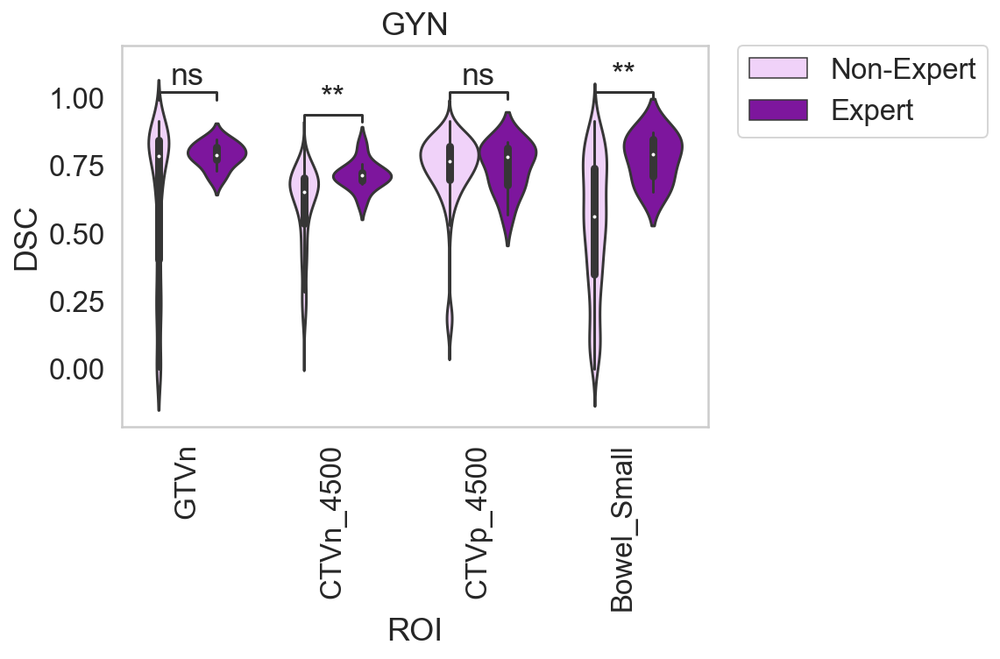

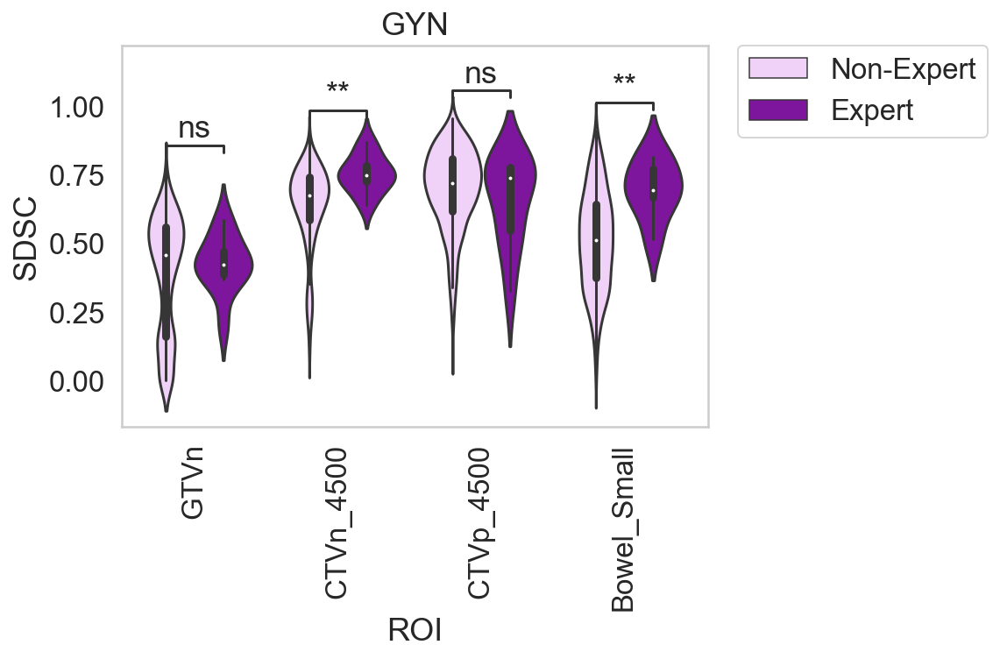

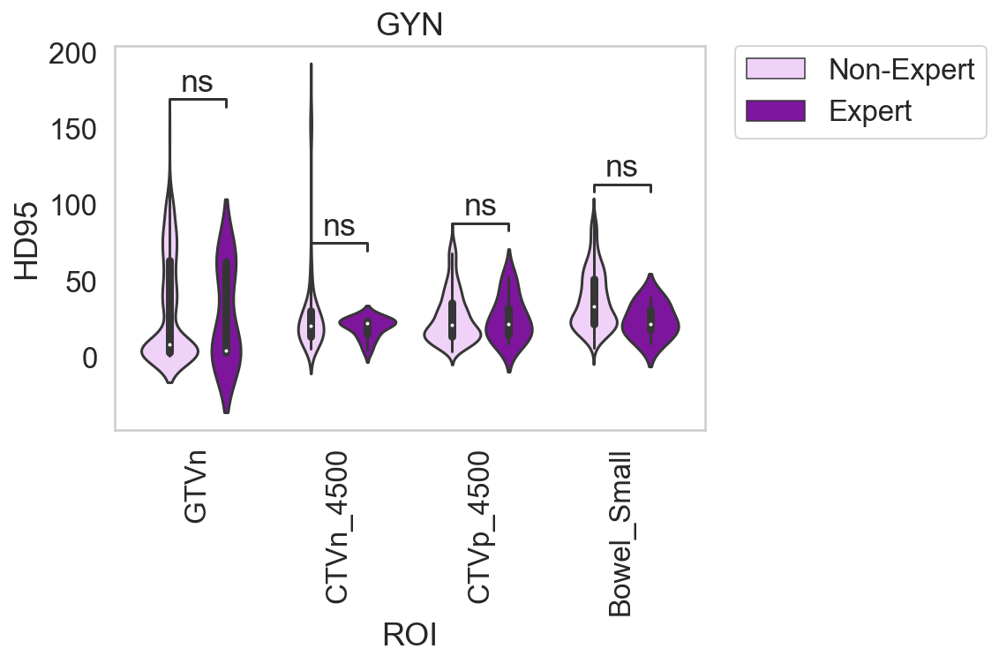

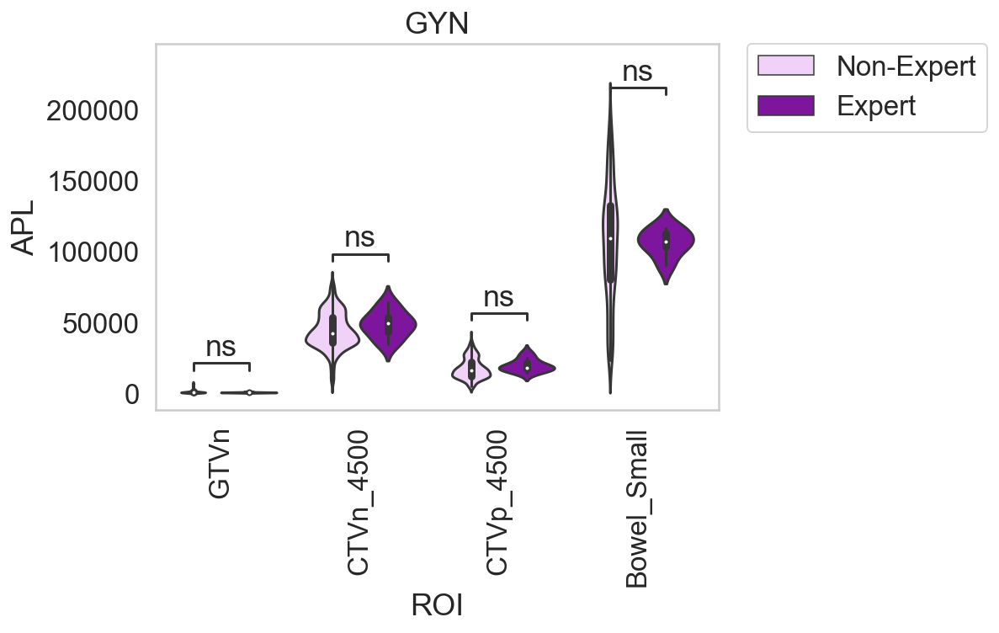

<Figure size 432x288 with 0 Axes>

In [201]:
x="ROI" 

y_list = ["DSC_list", "SDSC_list", "HD95_list", "APL_list"]

for y in y_list:
    print(y)

    hue="Class"
    hue_order = ['Generalist', 'Self-ID Specialist', 'Expert']
    hue_order = ['Generalist', 'Expert']
    hue_order = ['Non-Expert', 'Expert']

    ROI_list = ['gtvn', 'ctvn_4500', 'ctvp_4500', 'bowel_small']

    ax = sns.violinplot(x=x, y=y, hue=hue,
                     data=df_pickle_explode,
                       hue_order = hue_order,
                       palette=gyn_palette,
                       order = ROI_list) # Dont forget to set order in the calls below if you use it here 



    class_list = ['Generalist', 'Expert']
    class_list = ['Non-Expert', 'Expert']

    pairs = [tuple((ROI, classes) for classes in class_list) for ROI in ROI_list]

    # all combos, in theory reduces down to code above in 2-class example
    combination_list = list(itertools.combinations(class_list, 2))
    pairs = [tuple((ROI, classes) for classes in subclass_list) for subclass_list in combination_list for ROI in ROI_list]


    annot = Annotator(ax, pairs, data=df_pickle_explode, x=x, y=y, hue=hue, hue_order=hue_order, order = ROI_list)

    annot.new_plot(ax, pairs, data=df_pickle_explode, x=x, y=y, hue=hue, hue_order=hue_order, order = ROI_list)
    annot.configure(test='Mann-Whitney', verbose=2)
    annot.apply_test()
    annot.annotate()
    
    # TG-263 names 
    labels = ['GTVn', 'CTVn_4500', 'CTVp_4500', 'Bowel_Small']
    ax.set_xticklabels(labels)

    plt.xticks(rotation=90)
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    plt.ylabel(y.split('_')[0])
    plt.title('GYN')
    
    plt.figure()

Volume measurements here.

In [203]:
%%time 

in_path = os.path.join(base_path, "structures_nifti_stratified")

ROI_list = ['gtvn', 'ctvn_4500', 'ctvp_4500', 'bowel_small']

classes = ["Expert", "Non-Expert"] # for just getting Expert and Non-Expert 

df_vol = pd.DataFrame(columns=['ROI', 'Class', 'ID', 'Volume'])
counter = -1  

for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        print(class_)
        class_path = os.path.join(in_path, class_)
        
        IDs = os.listdir(class_path)
        for ID in IDs:
            #print(ID)
            ID_path = os.path.join(class_path, ID)
            structures = os.listdir(ID_path)
            for structure in structures:
                structure_path = os.path.join(ID_path, structure)
                if structure.split('.')[0] == ROI:
                    structure_volume = calculate_volume(structure_path)
                    
                    counter +=1
                    df_vol.loc[counter] = [ROI, class_, ID, structure_volume]
                    #print(df_vol)

gtvn
Expert
Non-Expert
ctvn_4500
Expert
Non-Expert
ctvp_4500
Expert
Non-Expert
bowel_small
Expert
Non-Expert
Wall time: 1min 12s


In [204]:
df_vol

,ROI,Class,ID,Volume
0,gtvn,Expert,RS_0129,8.563987
1,gtvn,Expert,RS_0997,11.086453
2,gtvn,Expert,RS_1028,9.365072
3,gtvn,Expert,RS_1039,6.811612
4,gtvn,Expert,RS_1048,6.337159
...,...,...,...,...
172,bowel_small,Non-Expert,RS_0885,1637.464316
173,bowel_small,Non-Expert,RS_0933,3307.932884
174,bowel_small,Non-Expert,RS_0964,2869.114391
175,bowel_small,Non-Expert,RS_0978,3370.033709


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

ctvn_4500_Non-Expert vs. ctvn_4500_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:5.129e-02 U_stat=4.600e+01
gtvn_Non-Expert vs. gtvn_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:7.761e-01 U_stat=1.140e+02
ctvp_4500_Non-Expert vs. ctvp_4500_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:1.859e-01 U_stat=6.400e+01
bowel_small_Non-Expert vs. bowel_small_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:9.177e-02 U_stat=3.300e+01


<Figure size 432x288 with 0 Axes>

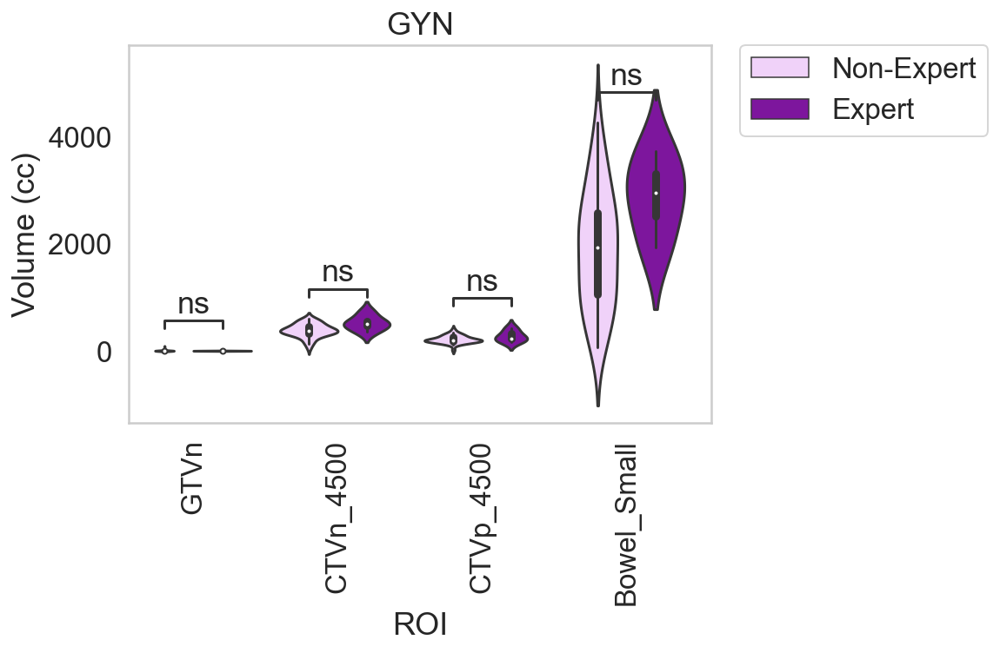

<Figure size 432x288 with 0 Axes>

In [205]:
x="ROI" 
y="Volume"
hue="Class"
hue_order = ['Non-Expert', 'Expert']
ROI_list = ['gtvn', 'ctvn_4500', 'ctvp_4500', 'bowel_small']

ax = sns.violinplot(x=x, y=y, hue=hue,
                 data=df_vol,
                   hue_order = hue_order,
                   palette=gyn_palette,
                   order = ROI_list) # Dont forget to set order in the calls below if you use it here 

class_list = ['Non-Expert', 'Expert']

pairs = [tuple((ROI, classes) for classes in class_list) for ROI in ROI_list]

# all combos, in theory reduces down to code above in 2-class example
combination_list = list(itertools.combinations(class_list, 2))
pairs = [tuple((ROI, classes) for classes in subclass_list) for subclass_list in combination_list for ROI in ROI_list]

annot = Annotator(ax, pairs, data=df_vol, x=x, y=y, hue=hue, hue_order=hue_order, order = ROI_list)

annot.new_plot(ax, pairs, data=df_vol, x=x, y=y, hue=hue, hue_order=hue_order, order = ROI_list)
annot.configure(test='Mann-Whitney', verbose=2)
annot.apply_test()
annot.annotate()

# TG-263 names 
labels = ['GTVn', 'CTVn_4500', 'CTVp_4500', 'Bowel_Small']
ax.set_xticklabels(labels)

plt.xticks(rotation=90)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.ylabel('Volume (cc)')
plt.title('GYN')

plt.figure()

### Direct comparisons of non-expert vs. expert STAPLE segmentations

In [206]:
df_pickle['DSC_median'] = df_pickle['DSC_list'].apply(lambda x: np.median(x))
df_pickle['HD95_median'] = df_pickle['HD95_list'].apply(lambda x: np.median(x))
df_pickle['APL_median'] = df_pickle['APL_list'].apply(lambda x: np.median(x))
df_pickle['SDSC_median'] = df_pickle['SDSC_list'].apply(lambda x: np.median(x))

In [207]:
df_pickle[df_pickle['Class'] == "Expert"] # just show expert answers which is what we care about

,ROI,Class,DSC_list,HD95_list,ASD_list,APL_list,SDSC_list,DSC_median,HD95_median,APL_median,SDSC_median
0,ctvn_4500,Expert,"[0.6815057313456334, 0.6928390221700419, 0.719...","[22.46092653274536, 25.45090804784357, 23.4374...","[3.3666357296700973, 3.187552605474417, 3.0419...","[49884, 37238, 54686, 42709, 34773, 59891, 467...","[0.7227403484066203, 0.7370010559716664, 0.769...",0.713517,22.460927,49324.5,0.749225
2,ctvp_4500,Expert,"[0.5665632729985473, 0.7979566155508301, 0.674...","[45.46757040673179, 8.655315345268535, 29.8060...","[8.691911357206024, 2.4359671702435417, 5.4699...","[17992, 25214, 20139, 22197, 28658, 17246, 181...","[0.3253555611107736, 0.7550412700162946, 0.502...",0.780273,21.733916,18364.5,0.740003
4,gtvn,Expert,"[0.7697160883280757, 0.8406914893617021, 0.776...","[62.216907190373995, 2.6839659806122547, 3.088...","[4.069324176771129, 0.5557042183748362, 0.9322...","[1397, 973, 794, 607, 881, 744, 934, 627, 685,...","[0.4088624178111727, 0.5843593755209581, 0.393...",0.787252,4.546718,775.0,0.423347
6,bowel_small,Expert,"[0.8084504026373981, 0.6524209000532382, 0.872...","[24.414050579071045, 39.34483950887324, 9.1897...","[5.045059977449519, 10.037845929624002, 3.0408...","[108267, 102658, 114684, 90551, 105180, 116716]","[0.6884263579711324, 0.5158985195968194, 0.795...",0.790652,21.815304,106723.5,0.693121


In [208]:
# now can calculate DSC between STAPLE of novices and experts vs gold standard, see if they cross the thresholds 
# add in other metrics 

In [209]:
in_path = os.path.join(base_path, "structures_nifti_stratified_STAPLE")

In [210]:
%%time 

ROI_list = ['gtvn', 'ctvn_4500', 'ctvp_4500', 'bowel_small']

classes = ["Non-Expert", "Expert"]

df2 = pd.DataFrame(columns=['ROI', 'Class', 'DSC', 'HD95', 'APL', 'SDSC'])
counter = -1  

for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        file_list = []
        print(class_)
        class_path = os.path.join(in_path, class_)

        structures = os.listdir(class_path)
        for structure in structures:
            print(structure)
            structure_path = os.path.join(class_path, structure)
            if structure.split('STAPLE.')[0] == ROI:

                file_1 = sitk.ReadImage(structure_path)
                file_2 = sitk.ReadImage(os.path.join(in_path, 'Expert', structure))

                mask_1 = sitk.GetArrayFromImage(file_1)
                mask_2 = sitk.GetArrayFromImage(file_2)

                DSC = compute_dice_coefficient(mask_1, mask_2)  
                
                # adding other metrics
                
                spacing_mm = file_1.GetSpacing() # need spacing to calcualte distances
                
                mask_1_bool = mask_1.astype(bool) # need to convert to bool format to work 
                mask_2_bool = mask_2.astype(bool)

                surface_distances = compute_surface_distances(mask_1_bool, mask_2_bool, spacing_mm) # need this for all calculations
                HD95 = compute_robust_hausdorff(surface_distances, 95)

                ASD_truth = compute_average_surface_distance(surface_distances)[0] #  A tuple with two float values: 1. the average distance (in mm) from the ground truth surface to thepredicted surface, 2. the average distance from the predicted surface to the ground truth surface.
                ASD_pred = compute_average_surface_distance(surface_distances)[1]
                ASD = (ASD_truth + ASD_pred)/2

                APL = AddedPathLength(mask_1, mask_2)
                
                tolerance = np.median(df_pickle[(df_pickle["ROI"] == ROI) & (df_pickle["Class"] == "Expert")]["ASD_list"].values[0]) # get tolerance
                SDSC = compute_surface_dice_at_tolerance(surface_distances, tolerance)
                     
        counter +=1
        df2.loc[counter] = [ROI, class_, DSC, HD95, APL, SDSC]
        #print(df2)

gtvn
Non-Expert
bowel_smallSTAPLE.nii.gz
ctvn_4500STAPLE.nii.gz
ctvp_4500STAPLE.nii.gz
gtvnSTAPLE.nii.gz
Expert
bowel_smallSTAPLE.nii.gz
ctvn_4500STAPLE.nii.gz
ctvp_4500STAPLE.nii.gz
gtvnSTAPLE.nii.gz
ctvn_4500
Non-Expert
bowel_smallSTAPLE.nii.gz
ctvn_4500STAPLE.nii.gz
ctvp_4500STAPLE.nii.gz
gtvnSTAPLE.nii.gz
Expert
bowel_smallSTAPLE.nii.gz
ctvn_4500STAPLE.nii.gz
ctvp_4500STAPLE.nii.gz
gtvnSTAPLE.nii.gz
ctvp_4500
Non-Expert
bowel_smallSTAPLE.nii.gz
ctvn_4500STAPLE.nii.gz
ctvp_4500STAPLE.nii.gz
gtvnSTAPLE.nii.gz
Expert
bowel_smallSTAPLE.nii.gz
ctvn_4500STAPLE.nii.gz
ctvp_4500STAPLE.nii.gz
gtvnSTAPLE.nii.gz
bowel_small
Non-Expert
bowel_smallSTAPLE.nii.gz
ctvn_4500STAPLE.nii.gz
ctvp_4500STAPLE.nii.gz
gtvnSTAPLE.nii.gz
Expert
bowel_smallSTAPLE.nii.gz
ctvn_4500STAPLE.nii.gz
ctvp_4500STAPLE.nii.gz
gtvnSTAPLE.nii.gz
Wall time: 58 s


In [211]:
df2

,ROI,Class,DSC,HD95,APL,SDSC
0,gtvn,Non-Expert,0.881113,2.856107,704,0.615057
1,gtvn,Expert,1.000000,0.000000,0,1.000000
2,ctvn_4500,Non-Expert,0.851418,5.094475,48464,0.864038
3,ctvn_4500,Expert,1.000000,0.000000,0,1.000000
4,ctvp_4500,Non-Expert,0.883854,7.109479,16538,0.881047
5,ctvp_4500,Expert,1.000000,0.000000,0,1.000000
6,bowel_small,Non-Expert,0.898707,17.237180,115218,0.843933
7,bowel_small,Expert,1.000000,0.000000,0,1.000000


In [212]:
# next step is combining the information from the previous dataframes to make bar plots of  novice and specialist DSC compared to exprt with dashed line of expodert mean IOV 

In [213]:
ROI_list = ['gtvn', 'ctvn_4500', 'ctvp_4500', 'bowel_small']

In [214]:
line_dict_DSC = {ROI:df_pickle[(df_pickle['Class'] == "Expert") & (df_pickle['ROI'] == ROI)]['DSC_median'].values[0] for ROI in ROI_list}
line_dict_HD95 = {ROI:df_pickle[(df_pickle['Class'] == "Expert") & (df_pickle['ROI'] == ROI)]['HD95_median'].values[0] for ROI in ROI_list}
line_dict_APL = {ROI:df_pickle[(df_pickle['Class'] == "Expert") & (df_pickle['ROI'] == ROI)]['APL_median'].values[0] for ROI in ROI_list}
line_dict_SDSC = {ROI:df_pickle[(df_pickle['Class'] == "Expert") & (df_pickle['ROI'] == ROI)]['SDSC_median'].values[0] for ROI in ROI_list}
line_dict_list = [line_dict_DSC, line_dict_HD95, line_dict_APL, line_dict_SDSC]

In [215]:
line_dict_list

[{'gtvn': 0.7872517371768033,
  'ctvn_4500': 0.7135174369142904,
  'ctvp_4500': 0.7802725272109252,
  'bowel_small': 0.7906517322838584},
 {'gtvn': 4.546718452135996,
  'ctvn_4500': 22.46092653274536,
  'ctvp_4500': 21.733915775795886,
  'bowel_small': 21.815304167868636},
 {'gtvn': 775.0,
  'ctvn_4500': 49324.5,
  'ctvp_4500': 18364.5,
  'bowel_small': 106723.5},
 {'gtvn': 0.42334746413656,
  'ctvn_4500': 0.7492252054607809,
  'ctvp_4500': 0.7400033935467787,
  'bowel_small': 0.6931206822383676}]

In [216]:
# make dataframe for counts of each ROI per class

In [217]:
in_path = os.path.join(base_path, "structures_nifti_stratified")

In [218]:
%%time 

ROI_list = ['gtvn', 'ctvn_4500', 'ctvp_4500', 'bowel_small']

classes = [class_ for class_ in os.listdir(in_path)]
classes = ["Non-Expert", "Expert"]

df3 = pd.DataFrame(columns=['ROI', 'Class', 'N'])
counter = -1  

for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        file_list = []
        print(class_)
        class_path = os.path.join(in_path, class_)
        
        IDs = os.listdir(class_path)
        for ID in IDs:
            ID_path = os.path.join(class_path, ID)

            structures = os.listdir(ID_path)
            for structure in structures:
                structure_path = os.path.join(class_path, structure)
                if structure.split('.')[0] == ROI:
                    file_list.append(structure_path)
        
        n = len(file_list)
        counter +=1
        df3.loc[counter] = [ROI, class_, n]

gtvn
Non-Expert
Expert
ctvn_4500
Non-Expert
Expert
ctvp_4500
Non-Expert
Expert
bowel_small
Non-Expert
Expert
Wall time: 34 ms


In [219]:
df3

,ROI,Class,N
0,gtvn,Non-Expert,42
1,gtvn,Expert,5
2,ctvn_4500,Non-Expert,40
3,ctvn_4500,Expert,5
4,ctvp_4500,Non-Expert,41
5,ctvp_4500,Expert,5
6,bowel_small,Non-Expert,35
7,bowel_small,Expert,4


DSC
HD95
APL
SDSC


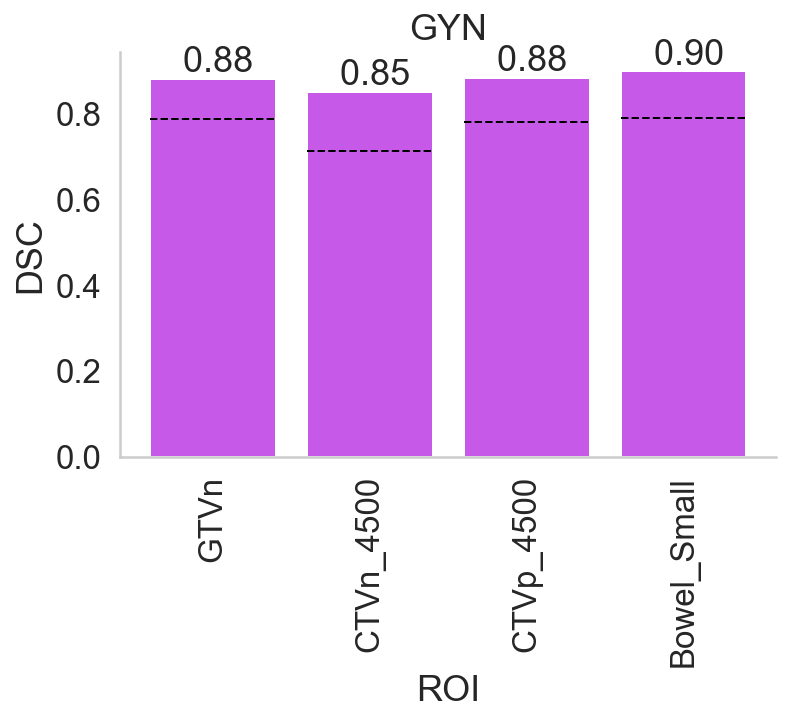

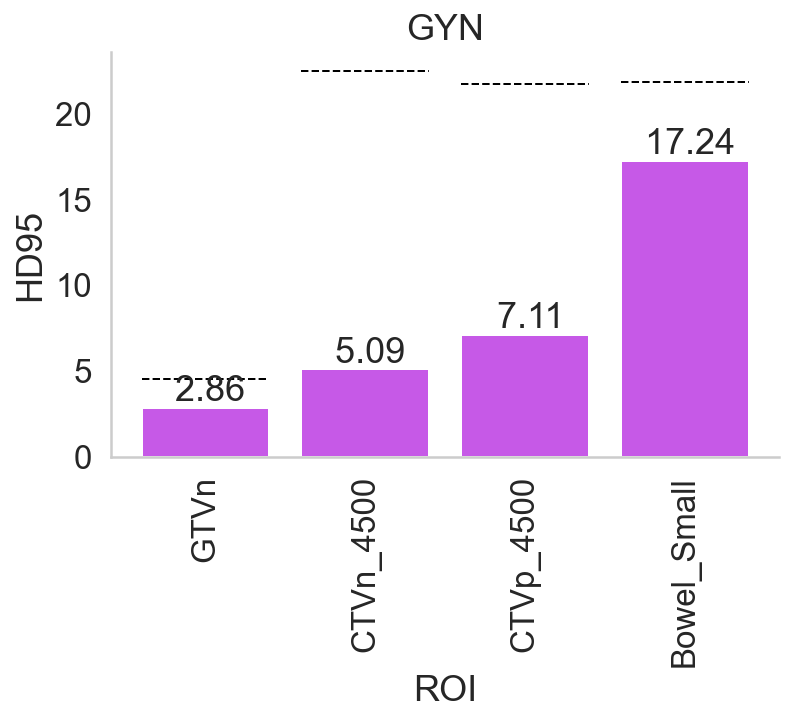

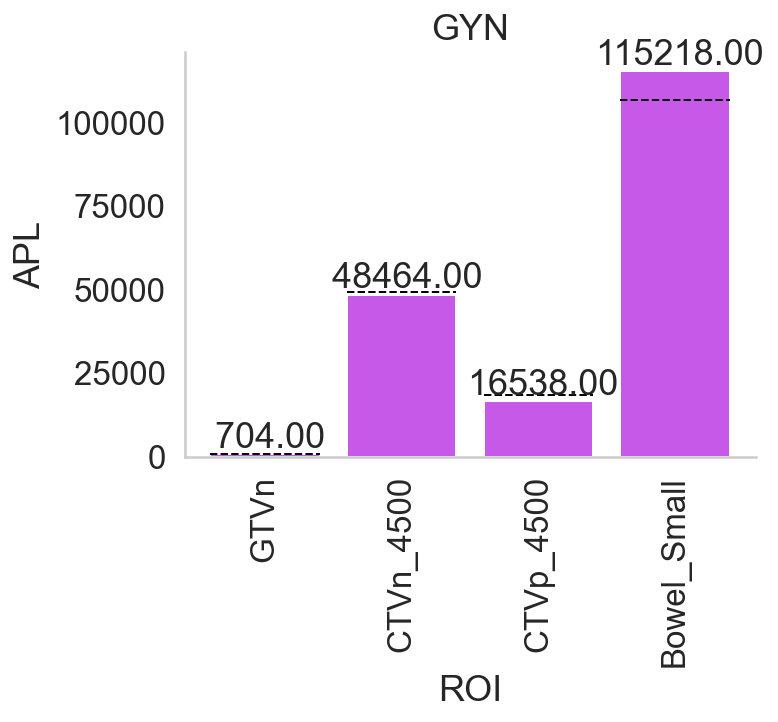

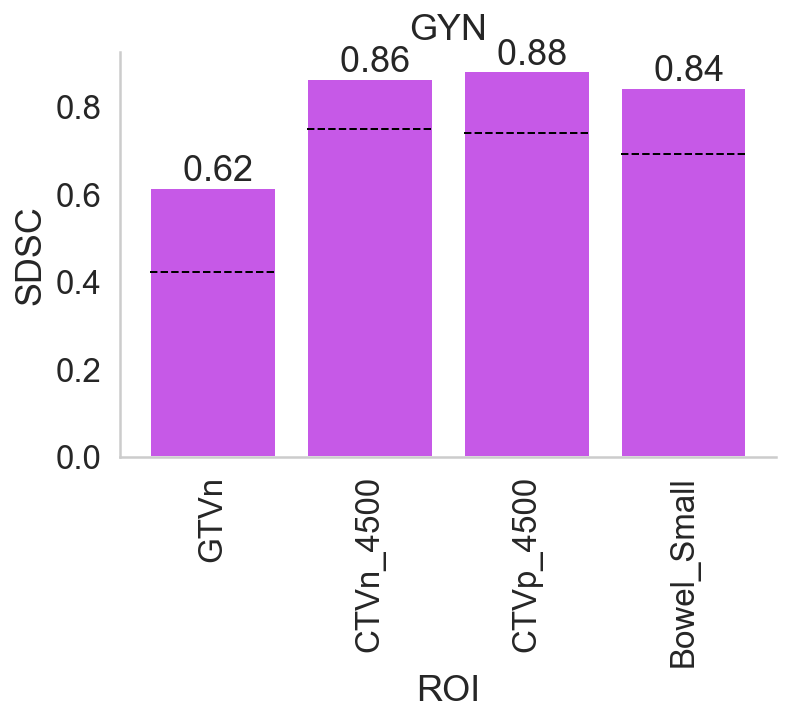

In [220]:
### Make box plots  

metric_list = ['DSC', 'HD95', 'APL', 'SDSC']

for metric, line_dict in zip(metric_list, line_dict_list): # line dict defined before 
    print(metric)
    
    if metric == "DSC" or metric == "SDSC":
        sharey=True
    else:
        sharey=False

    g = sns.catplot(x="ROI", y=metric, hue= "Class", hue_order =["Non-Expert"], sharex = False,
                    sharey=sharey,
                    data=df2, kind="bar", 
                    height=4, aspect=1.5,
                    palette=gyn_palette_old,
                    )
    

    for ax in g.axes.ravel(): # https://stackoverflow.com/questions/41127841/how-to-annotate-bars-in-a-seaborn-facetgrid-works-in-factorplot
        for a, ROI in zip(ax.patches, ROI_list):         

            value = float((line_dict[ROI]))

            x_start = a.get_x()
            width = a.get_width()

            ax.plot([x_start, x_start+width], [value, value], '--', c='black', linewidth=1)
    
    plt.xticks(rotation=90)
    plt.title('GYN')
    g._legend.remove() # remove legend since just showing non-expert
    
    
    axes = g.axes.flatten()
    for ax in axes:
        for container in ax.containers:
            ax.bar_label(container, labels=[f'{x: .2f}' for x in container.datavalues]) # https://stackoverflow.com/questions/70515542/adding-comma-to-bar-labels-in-matplotlib
        
    # TG-263 names 
    labels = ['GTVn', 'CTVn_4500', 'CTVp_4500', 'Bowel_Small']
    g.set_xticklabels(labels)    

### Bootstrap experiments

In [303]:
%%time

ROI_list = ['ctvn_4500', 'ctvp_4500', 'gtvn', 'bowel_small']

bootstrap = 100
#bootstrap = 2 # testing 

path = os.path.join(base_path, "structures_nifti_stratified", "Non-Expert")

expert_STAPLE_path = os.path.join(base_path, "structures_nifti_stratified_STAPLE", "Expert")

df4 = pd.DataFrame(columns=['ROI', 'N', 'DSC_list', 'HD95_list', 'APL_list', 'SDSC_list', 'ID_list'])

counter = -1  # for df 

counter2 = -1 # for random seed 

n_list = [2, 3, 4, 5, 6, 7, 8, 9, 10, 15, 20, 25]
#n_list = [2, 3] # testing 

for ROI in ROI_list:
    #print(ROI)
    expert_file_path = os.path.join(expert_STAPLE_path, ROI+'STAPLE.nii.gz')
    cases = [case for case in os.listdir(path) if ROI+'.nii.gz' in os.listdir(os.path.join(path, case))]
    for n in n_list:
        #print(n)
        DSC_list = []
        subcase_list = []
        for iteration in range(bootstrap):
            
            switch = True 
            
            counter2 +=1 
            
            while switch == True: # horrible practice but don't know what else to do
                
                print("ROI:", ROI, "; total staple:", n, "; boostrap iteration:", iteration, "; random counter:", counter2)
            
                random.seed(counter2)
                np.random.seed(counter2)

                #print(counter2)

                subcases = random.sample(cases, n)
                print(subcases)
                subcase_list.append(subcases)

                file_list = []
                for case in subcases:
                    case_path = os.path.join(path, case)
                    file_path = os.path.join(case_path, ROI+'.nii.gz')
                    file_list.append(file_path)

                segmentations = [sitk.ReadImage(file_name, sitk.sitkUInt8) for file_name in file_list]

                foregroundValue = 1
                threshold = 0.95
                #threshold = 0.90

                if n <= 4: 
                    #print('test')
                    p = multiprocessing.Process(target=sitk.STAPLE, name="Foo", args=(segmentations, foregroundValue,))
                    p.start()
                    p.join(60) # set at 60 sec for now.. 

                    # If thread is active
                    if p.is_alive():
                        print("STAPLE function is taking too long, killing it and getting new random samples")

                        # Terminate function 
                        p.terminate()
                        p.join()
                        counter2 +=1 
                        continue



                #print('test2')
                reference_segmentation_STAPLE_probabilities = sitk.STAPLE(segmentations, foregroundValue) 

                file_1 = reference_segmentation_STAPLE_probabilities > threshold
                file_2 = sitk.ReadImage(expert_file_path)

                mask_1 = sitk.GetArrayFromImage(file_1)
                mask_2 = sitk.GetArrayFromImage(file_2)

                DSC = compute_dice_coefficient(mask_1, mask_2)   
                DSC_list.append(DSC)
                
                # adding other metrics
                
                spacing_mm = file_1.GetSpacing() # need spacing to calcualte distances
                
                mask_1_bool = mask_1.astype(bool) # need to convert to bool format to work 
                mask_2_bool = mask_2.astype(bool)

                surface_distances = compute_surface_distances(mask_1_bool, mask_2_bool, spacing_mm) # need this for all calculations
                HD95 = compute_robust_hausdorff(surface_distances, 95)
                HD95_list.append(HD95)

                APL = AddedPathLength(mask_1, mask_2)
                APL_list.append(APL)
                
                tolerance = np.median(df_pickle[(df_pickle["ROI"] == ROI) & (df_pickle["Class"] == "Expert")]["ASD_list"].values[0]) # get tolerance
                SDSC = compute_surface_dice_at_tolerance(surface_distances, tolerance)
                SDSC_list.append(SDSC)
                
                counter +=1
                df4.loc[counter] = [ROI, n, DSC, HD95, APL, SDSC, subcases]

                switch = False
                
        print(np.mean(DSC_list))
        print(np.mean(HD95_list))
        print(np.mean(APL_list))
        print(np.mean(SDSC_list))

ROI: ctvn_4500 ; total staple: 2 ; boostrap iteration: 0 ; random counter: 0
['RS_0641', 'RS_0710']
ROI: ctvn_4500 ; total staple: 2 ; boostrap iteration: 1 ; random counter: 1
['RS_0146', 'RS_0978']
ROI: ctvn_4500 ; total staple: 2 ; boostrap iteration: 2 ; random counter: 2
['RS_0031', 'RS_0034']
ROI: ctvn_4500 ; total staple: 2 ; boostrap iteration: 3 ; random counter: 3
['RS_0362', 'RS_0985']
ROI: ctvn_4500 ; total staple: 2 ; boostrap iteration: 4 ; random counter: 4
['RS_0362', 'RS_0586']
ROI: ctvn_4500 ; total staple: 2 ; boostrap iteration: 5 ; random counter: 5
['RS_1023', 'RS_0451']
ROI: ctvn_4500 ; total staple: 2 ; boostrap iteration: 6 ; random counter: 6
['RS_0978', 'RS_0034']
ROI: ctvn_4500 ; total staple: 2 ; boostrap iteration: 7 ; random counter: 7
['RS_0603', 'RS_0182']
ROI: ctvn_4500 ; total staple: 2 ; boostrap iteration: 8 ; random counter: 8
['RS_0336', 'RS_0634']
ROI: ctvn_4500 ; total staple: 2 ; boostrap iteration: 9 ; random counter: 9
['RS_0799', 'RS_1023']


ROI: ctvn_4500 ; total staple: 2 ; boostrap iteration: 81 ; random counter: 81
['RS_0871', 'RS_0799']
ROI: ctvn_4500 ; total staple: 2 ; boostrap iteration: 82 ; random counter: 82
['RS_0182', 'RS_0866']
ROI: ctvn_4500 ; total staple: 2 ; boostrap iteration: 83 ; random counter: 83
['RS_0866', 'RS_0799']
ROI: ctvn_4500 ; total staple: 2 ; boostrap iteration: 84 ; random counter: 84
['RS_0571', 'RS_0027']
ROI: ctvn_4500 ; total staple: 2 ; boostrap iteration: 85 ; random counter: 85
['RS_0292', 'RS_1023']
ROI: ctvn_4500 ; total staple: 2 ; boostrap iteration: 86 ; random counter: 86
['RS_0018', 'RS_0964']
ROI: ctvn_4500 ; total staple: 2 ; boostrap iteration: 87 ; random counter: 87
['RS_0182', 'RS_0292']
ROI: ctvn_4500 ; total staple: 2 ; boostrap iteration: 88 ; random counter: 88
['RS_0645', 'RS_0292']
ROI: ctvn_4500 ; total staple: 2 ; boostrap iteration: 89 ; random counter: 89
['RS_0034', 'RS_1010']
ROI: ctvn_4500 ; total staple: 2 ; boostrap iteration: 90 ; random counter: 90
['R

STAPLE function is taking too long, killing it and getting new random samples
ROI: ctvn_4500 ; total staple: 3 ; boostrap iteration: 50 ; random counter: 153
['RS_0866', 'RS_0032', 'RS_0027']
ROI: ctvn_4500 ; total staple: 3 ; boostrap iteration: 51 ; random counter: 154
['RS_0297', 'RS_0641', 'RS_0866']
ROI: ctvn_4500 ; total staple: 3 ; boostrap iteration: 52 ; random counter: 155
['RS_0985', 'RS_0871', 'RS_0933']
ROI: ctvn_4500 ; total staple: 3 ; boostrap iteration: 53 ; random counter: 156
['RS_0866', 'RS_0710', 'RS_0362']
ROI: ctvn_4500 ; total staple: 3 ; boostrap iteration: 54 ; random counter: 157
['RS_1023', 'RS_0866', 'RS_0336']
ROI: ctvn_4500 ; total staple: 3 ; boostrap iteration: 55 ; random counter: 158
['RS_0336', 'RS_0048', 'RS_0031']
ROI: ctvn_4500 ; total staple: 3 ; boostrap iteration: 56 ; random counter: 159
['RS_0645', 'RS_0186', 'RS_0770']
ROI: ctvn_4500 ; total staple: 3 ; boostrap iteration: 57 ; random counter: 160
['RS_0128', 'RS_0871', 'RS_0613']
ROI: ctvn_

ROI: ctvn_4500 ; total staple: 4 ; boostrap iteration: 18 ; random counter: 222
['RS_0048', 'RS_0362', 'RS_0571', 'RS_0586']
ROI: ctvn_4500 ; total staple: 4 ; boostrap iteration: 19 ; random counter: 223
['RS_0613', 'RS_0630', 'RS_0770', 'RS_0292']
ROI: ctvn_4500 ; total staple: 4 ; boostrap iteration: 20 ; random counter: 224
['RS_0032', 'RS_0292', 'RS_0799', 'RS_0933']
ROI: ctvn_4500 ; total staple: 4 ; boostrap iteration: 21 ; random counter: 225
['RS_0362', 'RS_0267', 'RS_1010', 'RS_0146']
ROI: ctvn_4500 ; total staple: 4 ; boostrap iteration: 22 ; random counter: 226
['RS_0804', 'RS_0027', 'RS_0964', 'RS_0985']
ROI: ctvn_4500 ; total staple: 4 ; boostrap iteration: 23 ; random counter: 227
['RS_0645', 'RS_0634', 'RS_0034', 'RS_0770']
ROI: ctvn_4500 ; total staple: 4 ; boostrap iteration: 24 ; random counter: 228
['RS_0336', 'RS_0978', 'RS_0799', 'RS_1010']
ROI: ctvn_4500 ; total staple: 4 ; boostrap iteration: 25 ; random counter: 229
['RS_0885', 'RS_0146', 'RS_0336', 'RS_0933']


ROI: ctvn_4500 ; total staple: 4 ; boostrap iteration: 84 ; random counter: 288
['RS_0571', 'RS_0866', 'RS_0804', 'RS_0031']
ROI: ctvn_4500 ; total staple: 4 ; boostrap iteration: 85 ; random counter: 289
['RS_0472', 'RS_0267', 'RS_0034', 'RS_0770']
ROI: ctvn_4500 ; total staple: 4 ; boostrap iteration: 86 ; random counter: 290
['RS_0933', 'RS_0613', 'RS_0866', 'RS_0985']
ROI: ctvn_4500 ; total staple: 4 ; boostrap iteration: 87 ; random counter: 291
['RS_0804', 'RS_0871', 'RS_0034', 'RS_0641']
ROI: ctvn_4500 ; total staple: 4 ; boostrap iteration: 88 ; random counter: 292
['RS_0182', 'RS_0571', 'RS_0603', 'RS_0292']
ROI: ctvn_4500 ; total staple: 4 ; boostrap iteration: 89 ; random counter: 293
['RS_0804', 'RS_0128', 'RS_0336', 'RS_0871']
ROI: ctvn_4500 ; total staple: 4 ; boostrap iteration: 90 ; random counter: 294
['RS_0267', 'RS_0027', 'RS_0804', 'RS_0292']
ROI: ctvn_4500 ; total staple: 4 ; boostrap iteration: 91 ; random counter: 295
['RS_0571', 'RS_0804', 'RS_0603', 'RS_0985']


ROI: ctvn_4500 ; total staple: 5 ; boostrap iteration: 46 ; random counter: 350
['RS_0634', 'RS_0267', 'RS_0645', 'RS_0603', 'RS_0630']
ROI: ctvn_4500 ; total staple: 5 ; boostrap iteration: 47 ; random counter: 351
['RS_1023', 'RS_0978', 'RS_0630', 'RS_0603', 'RS_0472']
ROI: ctvn_4500 ; total staple: 5 ; boostrap iteration: 48 ; random counter: 352
['RS_0571', 'RS_0182', 'RS_0032', 'RS_0472', 'RS_0146']
ROI: ctvn_4500 ; total staple: 5 ; boostrap iteration: 49 ; random counter: 353
['RS_0048', 'RS_0034', 'RS_0641', 'RS_1010', 'RS_0866']
ROI: ctvn_4500 ; total staple: 5 ; boostrap iteration: 50 ; random counter: 354
['RS_0297', 'RS_0292', 'RS_0034', 'RS_0048', 'RS_0182']
ROI: ctvn_4500 ; total staple: 5 ; boostrap iteration: 51 ; random counter: 355
['RS_0186', 'RS_0128', 'RS_1023', 'RS_0641', 'RS_0613']
ROI: ctvn_4500 ; total staple: 5 ; boostrap iteration: 52 ; random counter: 356
['RS_0027', 'RS_0804', 'RS_0451', 'RS_0710', 'RS_0716']
ROI: ctvn_4500 ; total staple: 5 ; boostrap iter

ROI: ctvn_4500 ; total staple: 6 ; boostrap iteration: 6 ; random counter: 410
['RS_0182', 'RS_0586', 'RS_0018', 'RS_0613', 'RS_0034', 'RS_1010']
ROI: ctvn_4500 ; total staple: 6 ; boostrap iteration: 7 ; random counter: 411
['RS_0297', 'RS_0018', 'RS_0603', 'RS_0292', 'RS_0978', 'RS_0336']
ROI: ctvn_4500 ; total staple: 6 ; boostrap iteration: 8 ; random counter: 412
['RS_0571', 'RS_0031', 'RS_0048', 'RS_0292', 'RS_0128', 'RS_0586']
ROI: ctvn_4500 ; total staple: 6 ; boostrap iteration: 9 ; random counter: 413
['RS_0799', 'RS_0267', 'RS_0034', 'RS_0964', 'RS_0571', 'RS_1010']
ROI: ctvn_4500 ; total staple: 6 ; boostrap iteration: 10 ; random counter: 414
['RS_0716', 'RS_0630', 'RS_0336', 'RS_0472', 'RS_0571', 'RS_0032']
ROI: ctvn_4500 ; total staple: 6 ; boostrap iteration: 11 ; random counter: 415
['RS_0613', 'RS_0362', 'RS_0472', 'RS_0292', 'RS_0297', 'RS_0146']
ROI: ctvn_4500 ; total staple: 6 ; boostrap iteration: 12 ; random counter: 416
['RS_0451', 'RS_0017', 'RS_0871', 'RS_0571

ROI: ctvn_4500 ; total staple: 6 ; boostrap iteration: 62 ; random counter: 466
['RS_0031', 'RS_0128', 'RS_0571', 'RS_0292', 'RS_0182', 'RS_0146']
ROI: ctvn_4500 ; total staple: 6 ; boostrap iteration: 63 ; random counter: 467
['RS_0451', 'RS_0804', 'RS_0645', 'RS_0032', 'RS_0018', 'RS_0716']
ROI: ctvn_4500 ; total staple: 6 ; boostrap iteration: 64 ; random counter: 468
['RS_0297', 'RS_0641', 'RS_0031', 'RS_0034', 'RS_0267', 'RS_1010']
ROI: ctvn_4500 ; total staple: 6 ; boostrap iteration: 65 ; random counter: 469
['RS_0451', 'RS_0586', 'RS_1023', 'RS_0710', 'RS_0641', 'RS_0031']
ROI: ctvn_4500 ; total staple: 6 ; boostrap iteration: 66 ; random counter: 470
['RS_0027', 'RS_0630', 'RS_0267', 'RS_0146', 'RS_0885', 'RS_0804']
ROI: ctvn_4500 ; total staple: 6 ; boostrap iteration: 67 ; random counter: 471
['RS_0032', 'RS_0586', 'RS_0799', 'RS_0603', 'RS_0630', 'RS_0362']
ROI: ctvn_4500 ; total staple: 6 ; boostrap iteration: 68 ; random counter: 472
['RS_0182', 'RS_0292', 'RS_0799', 'RS_

ROI: ctvn_4500 ; total staple: 7 ; boostrap iteration: 17 ; random counter: 521
['RS_0048', 'RS_0017', 'RS_0586', 'RS_0451', 'RS_0710', 'RS_0267', 'RS_0630']
ROI: ctvn_4500 ; total staple: 7 ; boostrap iteration: 18 ; random counter: 522
['RS_0032', 'RS_0336', 'RS_0641', 'RS_0018', 'RS_0146', 'RS_0034', 'RS_0885']
ROI: ctvn_4500 ; total staple: 7 ; boostrap iteration: 19 ; random counter: 523
['RS_0571', 'RS_0885', 'RS_0641', 'RS_0186', 'RS_0804', 'RS_0978', 'RS_0017']
ROI: ctvn_4500 ; total staple: 7 ; boostrap iteration: 20 ; random counter: 524
['RS_0336', 'RS_0017', 'RS_0978', 'RS_0472', 'RS_0866', 'RS_0613', 'RS_0034']
ROI: ctvn_4500 ; total staple: 7 ; boostrap iteration: 21 ; random counter: 525
['RS_0933', 'RS_0128', 'RS_0804', 'RS_0186', 'RS_0267', 'RS_0048', 'RS_0182']
ROI: ctvn_4500 ; total staple: 7 ; boostrap iteration: 22 ; random counter: 526
['RS_0182', 'RS_0297', 'RS_0267', 'RS_0031', 'RS_0571', 'RS_0641', 'RS_0645']
ROI: ctvn_4500 ; total staple: 7 ; boostrap iteratio

ROI: ctvn_4500 ; total staple: 7 ; boostrap iteration: 69 ; random counter: 573
['RS_0451', 'RS_0336', 'RS_0032', 'RS_0645', 'RS_0964', 'RS_0871', 'RS_0799']
ROI: ctvn_4500 ; total staple: 7 ; boostrap iteration: 70 ; random counter: 574
['RS_0586', 'RS_0978', 'RS_0964', 'RS_0048', 'RS_1023', 'RS_0336', 'RS_0716']
ROI: ctvn_4500 ; total staple: 7 ; boostrap iteration: 71 ; random counter: 575
['RS_0586', 'RS_0027', 'RS_0641', 'RS_0128', 'RS_0710', 'RS_0866', 'RS_0716']
ROI: ctvn_4500 ; total staple: 7 ; boostrap iteration: 72 ; random counter: 576
['RS_0985', 'RS_0866', 'RS_0292', 'RS_0017', 'RS_0613', 'RS_0641', 'RS_0885']
ROI: ctvn_4500 ; total staple: 7 ; boostrap iteration: 73 ; random counter: 577
['RS_0645', 'RS_0630', 'RS_0034', 'RS_0613', 'RS_0799', 'RS_0710', 'RS_0048']
ROI: ctvn_4500 ; total staple: 7 ; boostrap iteration: 74 ; random counter: 578
['RS_0571', 'RS_0186', 'RS_0978', 'RS_0645', 'RS_0630', 'RS_0634', 'RS_0034']
ROI: ctvn_4500 ; total staple: 7 ; boostrap iteratio

ROI: ctvn_4500 ; total staple: 8 ; boostrap iteration: 20 ; random counter: 624
['RS_0292', 'RS_0027', 'RS_0362', 'RS_0297', 'RS_0571', 'RS_0472', 'RS_0613', 'RS_0586']
ROI: ctvn_4500 ; total staple: 8 ; boostrap iteration: 21 ; random counter: 625
['RS_0710', 'RS_0451', 'RS_0034', 'RS_1010', 'RS_0645', 'RS_0603', 'RS_0866', 'RS_0048']
ROI: ctvn_4500 ; total staple: 8 ; boostrap iteration: 22 ; random counter: 626
['RS_0634', 'RS_0128', 'RS_0336', 'RS_0018', 'RS_0146', 'RS_0603', 'RS_0871', 'RS_0641']
ROI: ctvn_4500 ; total staple: 8 ; boostrap iteration: 23 ; random counter: 627
['RS_0451', 'RS_0985', 'RS_0048', 'RS_0146', 'RS_0336', 'RS_0018', 'RS_0362', 'RS_0128']
ROI: ctvn_4500 ; total staple: 8 ; boostrap iteration: 24 ; random counter: 628
['RS_0645', 'RS_0034', 'RS_0964', 'RS_0985', 'RS_0128', 'RS_0799', 'RS_0182', 'RS_0146']
ROI: ctvn_4500 ; total staple: 8 ; boostrap iteration: 25 ; random counter: 629
['RS_0031', 'RS_0603', 'RS_0866', 'RS_0017', 'RS_0571', 'RS_0978', 'RS_0885

ROI: ctvn_4500 ; total staple: 8 ; boostrap iteration: 69 ; random counter: 673
['RS_0885', 'RS_0630', 'RS_0770', 'RS_0641', 'RS_0267', 'RS_0018', 'RS_0634', 'RS_1010']
ROI: ctvn_4500 ; total staple: 8 ; boostrap iteration: 70 ; random counter: 674
['RS_0645', 'RS_0034', 'RS_1010', 'RS_0182', 'RS_0267', 'RS_0571', 'RS_0613', 'RS_0032']
ROI: ctvn_4500 ; total staple: 8 ; boostrap iteration: 71 ; random counter: 675
['RS_0297', 'RS_0630', 'RS_0645', 'RS_0571', 'RS_0866', 'RS_0586', 'RS_0799', 'RS_0641']
ROI: ctvn_4500 ; total staple: 8 ; boostrap iteration: 72 ; random counter: 676
['RS_0018', 'RS_0804', 'RS_0964', 'RS_0985', 'RS_0710', 'RS_0603', 'RS_0645', 'RS_0472']
ROI: ctvn_4500 ; total staple: 8 ; boostrap iteration: 73 ; random counter: 677
['RS_0032', 'RS_1023', 'RS_0146', 'RS_0804', 'RS_0799', 'RS_0048', 'RS_0978', 'RS_0292']
ROI: ctvn_4500 ; total staple: 8 ; boostrap iteration: 74 ; random counter: 678
['RS_0128', 'RS_0603', 'RS_0017', 'RS_0613', 'RS_0985', 'RS_0186', 'RS_0804

ROI: ctvn_4500 ; total staple: 9 ; boostrap iteration: 17 ; random counter: 721
['RS_0182', 'RS_0710', 'RS_0267', 'RS_0630', 'RS_0804', 'RS_1010', 'RS_0799', 'RS_1023', 'RS_0978']
ROI: ctvn_4500 ; total staple: 9 ; boostrap iteration: 18 ; random counter: 722
['RS_1023', 'RS_0182', 'RS_0267', 'RS_0586', 'RS_0933', 'RS_0716', 'RS_0472', 'RS_1010', 'RS_0885']
ROI: ctvn_4500 ; total staple: 9 ; boostrap iteration: 19 ; random counter: 723
['RS_0933', 'RS_0267', 'RS_0297', 'RS_0472', 'RS_0292', 'RS_0451', 'RS_0978', 'RS_0182', 'RS_0799']
ROI: ctvn_4500 ; total staple: 9 ; boostrap iteration: 20 ; random counter: 724
['RS_0571', 'RS_0027', 'RS_0128', 'RS_1023', 'RS_0292', 'RS_0716', 'RS_0613', 'RS_0985', 'RS_0964']
ROI: ctvn_4500 ; total staple: 9 ; boostrap iteration: 21 ; random counter: 725
['RS_0034', 'RS_0866', 'RS_0031', 'RS_0017', 'RS_0964', 'RS_0933', 'RS_0603', 'RS_0146', 'RS_0297']
ROI: ctvn_4500 ; total staple: 9 ; boostrap iteration: 22 ; random counter: 726
['RS_0451', 'RS_0630

ROI: ctvn_4500 ; total staple: 9 ; boostrap iteration: 63 ; random counter: 767
['RS_0048', 'RS_1023', 'RS_0804', 'RS_0297', 'RS_0799', 'RS_0571', 'RS_0182', 'RS_0630', 'RS_0716']
ROI: ctvn_4500 ; total staple: 9 ; boostrap iteration: 64 ; random counter: 768
['RS_0034', 'RS_0451', 'RS_0799', 'RS_0571', 'RS_0336', 'RS_0866', 'RS_0182', 'RS_0017', 'RS_0292']
ROI: ctvn_4500 ; total staple: 9 ; boostrap iteration: 65 ; random counter: 769
['RS_0017', 'RS_0186', 'RS_0048', 'RS_0933', 'RS_0630', 'RS_1023', 'RS_0871', 'RS_1010', 'RS_0032']
ROI: ctvn_4500 ; total staple: 9 ; boostrap iteration: 66 ; random counter: 770
['RS_0641', 'RS_0267', 'RS_0770', 'RS_0146', 'RS_0027', 'RS_0613', 'RS_0964', 'RS_0297', 'RS_0645']
ROI: ctvn_4500 ; total staple: 9 ; boostrap iteration: 67 ; random counter: 771
['RS_0641', 'RS_0182', 'RS_0267', 'RS_0799', 'RS_1023', 'RS_0032', 'RS_0586', 'RS_0885', 'RS_1010']
ROI: ctvn_4500 ; total staple: 9 ; boostrap iteration: 68 ; random counter: 772
['RS_0048', 'RS_0964

ROI: ctvn_4500 ; total staple: 10 ; boostrap iteration: 8 ; random counter: 812
['RS_0027', 'RS_0645', 'RS_0571', 'RS_0630', 'RS_0985', 'RS_0297', 'RS_0292', 'RS_0336', 'RS_0710', 'RS_0048']
ROI: ctvn_4500 ; total staple: 10 ; boostrap iteration: 9 ; random counter: 813
['RS_0146', 'RS_0018', 'RS_0641', 'RS_0985', 'RS_0451', 'RS_0186', 'RS_1010', 'RS_0613', 'RS_0885', 'RS_0292']
ROI: ctvn_4500 ; total staple: 10 ; boostrap iteration: 10 ; random counter: 814
['RS_1010', 'RS_0146', 'RS_1023', 'RS_0362', 'RS_0017', 'RS_0613', 'RS_0186', 'RS_0710', 'RS_0267', 'RS_0451']
ROI: ctvn_4500 ; total staple: 10 ; boostrap iteration: 11 ; random counter: 815
['RS_0017', 'RS_0571', 'RS_0027', 'RS_0586', 'RS_0613', 'RS_0804', 'RS_0128', 'RS_0034', 'RS_0297', 'RS_0048']
ROI: ctvn_4500 ; total staple: 10 ; boostrap iteration: 12 ; random counter: 816
['RS_0186', 'RS_1010', 'RS_0048', 'RS_0710', 'RS_0804', 'RS_0034', 'RS_0031', 'RS_0586', 'RS_0634', 'RS_0985']
ROI: ctvn_4500 ; total staple: 10 ; boostr

ROI: ctvn_4500 ; total staple: 10 ; boostrap iteration: 51 ; random counter: 855
['RS_0362', 'RS_0451', 'RS_0186', 'RS_0964', 'RS_0128', 'RS_0048', 'RS_0472', 'RS_0799', 'RS_0292', 'RS_0641']
ROI: ctvn_4500 ; total staple: 10 ; boostrap iteration: 52 ; random counter: 856
['RS_0297', 'RS_0336', 'RS_0964', 'RS_0027', 'RS_0182', 'RS_0472', 'RS_0866', 'RS_0710', 'RS_0128', 'RS_0292']
ROI: ctvn_4500 ; total staple: 10 ; boostrap iteration: 53 ; random counter: 857
['RS_0804', 'RS_0716', 'RS_0297', 'RS_1023', 'RS_0799', 'RS_0362', 'RS_0964', 'RS_0336', 'RS_0571', 'RS_0472']
ROI: ctvn_4500 ; total staple: 10 ; boostrap iteration: 54 ; random counter: 858
['RS_0885', 'RS_0871', 'RS_0034', 'RS_0630', 'RS_0186', 'RS_0716', 'RS_0964', 'RS_0799', 'RS_0804', 'RS_0985']
ROI: ctvn_4500 ; total staple: 10 ; boostrap iteration: 55 ; random counter: 859
['RS_0978', 'RS_0336', 'RS_0128', 'RS_0034', 'RS_0031', 'RS_0804', 'RS_0146', 'RS_0799', 'RS_0048', 'RS_0641']
ROI: ctvn_4500 ; total staple: 10 ; boos

ROI: ctvn_4500 ; total staple: 10 ; boostrap iteration: 94 ; random counter: 898
['RS_0710', 'RS_0146', 'RS_0034', 'RS_0603', 'RS_0018', 'RS_0804', 'RS_0336', 'RS_0027', 'RS_0182', 'RS_0472']
ROI: ctvn_4500 ; total staple: 10 ; boostrap iteration: 95 ; random counter: 899
['RS_0146', 'RS_0032', 'RS_0978', 'RS_0362', 'RS_0613', 'RS_0034', 'RS_0571', 'RS_0645', 'RS_0451', 'RS_0336']
ROI: ctvn_4500 ; total staple: 10 ; boostrap iteration: 96 ; random counter: 900
['RS_1023', 'RS_0336', 'RS_0634', 'RS_0048', 'RS_0034', 'RS_0362', 'RS_0613', 'RS_0031', 'RS_0186', 'RS_1010']
ROI: ctvn_4500 ; total staple: 10 ; boostrap iteration: 97 ; random counter: 901
['RS_0716', 'RS_0571', 'RS_0128', 'RS_0182', 'RS_0641', 'RS_0866', 'RS_0472', 'RS_0603', 'RS_0933', 'RS_0292']
ROI: ctvn_4500 ; total staple: 10 ; boostrap iteration: 98 ; random counter: 902
['RS_0472', 'RS_0645', 'RS_0804', 'RS_0032', 'RS_0182', 'RS_0933', 'RS_0292', 'RS_0964', 'RS_0586', 'RS_0641']
ROI: ctvn_4500 ; total staple: 10 ; boos

ROI: ctvn_4500 ; total staple: 15 ; boostrap iteration: 29 ; random counter: 933
['RS_0885', 'RS_0978', 'RS_0267', 'RS_0964', 'RS_0871', 'RS_0018', 'RS_0032', 'RS_0292', 'RS_0146', 'RS_0186', 'RS_0985', 'RS_0027', 'RS_0613', 'RS_0933', 'RS_0472']
ROI: ctvn_4500 ; total staple: 15 ; boostrap iteration: 30 ; random counter: 934
['RS_0799', 'RS_0362', 'RS_0017', 'RS_0018', 'RS_0032', 'RS_0451', 'RS_0182', 'RS_0613', 'RS_0630', 'RS_0034', 'RS_0586', 'RS_0964', 'RS_0603', 'RS_0267', 'RS_0716']
ROI: ctvn_4500 ; total staple: 15 ; boostrap iteration: 31 ; random counter: 935
['RS_0799', 'RS_0641', 'RS_0031', 'RS_0613', 'RS_0267', 'RS_0871', 'RS_0571', 'RS_0804', 'RS_0710', 'RS_1023', 'RS_0336', 'RS_0292', 'RS_0885', 'RS_0866', 'RS_0645']
ROI: ctvn_4500 ; total staple: 15 ; boostrap iteration: 32 ; random counter: 936
['RS_0182', 'RS_0716', 'RS_0267', 'RS_0027', 'RS_0292', 'RS_0128', 'RS_0804', 'RS_0297', 'RS_0641', 'RS_0336', 'RS_0871', 'RS_0603', 'RS_0985', 'RS_1010', 'RS_0645']
ROI: ctvn_45

ROI: ctvn_4500 ; total staple: 15 ; boostrap iteration: 63 ; random counter: 967
['RS_0885', 'RS_0128', 'RS_0297', 'RS_0716', 'RS_0964', 'RS_0032', 'RS_1023', 'RS_0027', 'RS_0018', 'RS_0292', 'RS_0031', 'RS_0182', 'RS_0933', 'RS_0571', 'RS_0472']
ROI: ctvn_4500 ; total staple: 15 ; boostrap iteration: 64 ; random counter: 968
['RS_0048', 'RS_0571', 'RS_0978', 'RS_0031', 'RS_0297', 'RS_0710', 'RS_1010', 'RS_0885', 'RS_0146', 'RS_0017', 'RS_0186', 'RS_0451', 'RS_0964', 'RS_0985', 'RS_0866']
ROI: ctvn_4500 ; total staple: 15 ; boostrap iteration: 65 ; random counter: 969
['RS_0641', 'RS_0964', 'RS_0034', 'RS_0571', 'RS_0985', 'RS_0645', 'RS_0027', 'RS_0362', 'RS_0710', 'RS_0716', 'RS_0292', 'RS_0978', 'RS_0451', 'RS_0866', 'RS_0586']
ROI: ctvn_4500 ; total staple: 15 ; boostrap iteration: 66 ; random counter: 970
['RS_0571', 'RS_0128', 'RS_0048', 'RS_0964', 'RS_0146', 'RS_0292', 'RS_0018', 'RS_0603', 'RS_0027', 'RS_0799', 'RS_0770', 'RS_0871', 'RS_0710', 'RS_0641', 'RS_0985']
ROI: ctvn_45

ROI: ctvn_4500 ; total staple: 15 ; boostrap iteration: 97 ; random counter: 1001
['RS_0031', 'RS_0292', 'RS_0034', 'RS_0964', 'RS_0641', 'RS_0186', 'RS_0710', 'RS_0634', 'RS_0645', 'RS_0978', 'RS_0571', 'RS_0048', 'RS_0586', 'RS_0018', 'RS_0017']
ROI: ctvn_4500 ; total staple: 15 ; boostrap iteration: 98 ; random counter: 1002
['RS_0885', 'RS_1010', 'RS_0710', 'RS_0336', 'RS_0182', 'RS_0146', 'RS_0472', 'RS_0804', 'RS_0933', 'RS_0603', 'RS_0571', 'RS_0586', 'RS_0027', 'RS_0630', 'RS_0297']
ROI: ctvn_4500 ; total staple: 15 ; boostrap iteration: 99 ; random counter: 1003
['RS_0866', 'RS_0964', 'RS_0634', 'RS_0336', 'RS_0799', 'RS_0770', 'RS_1010', 'RS_0645', 'RS_0018', 'RS_0630', 'RS_0186', 'RS_0027', 'RS_0362', 'RS_0451', 'RS_0978']
0.8296042571016216
13.147411949596766
16591.753586710296
0.6044400184965169
ROI: ctvn_4500 ; total staple: 20 ; boostrap iteration: 0 ; random counter: 1004
['RS_0710', 'RS_0048', 'RS_0933', 'RS_0871', 'RS_0292', 'RS_0297', 'RS_0613', 'RS_0031', 'RS_0182',

ROI: ctvn_4500 ; total staple: 20 ; boostrap iteration: 25 ; random counter: 1029
['RS_1010', 'RS_0586', 'RS_0885', 'RS_0186', 'RS_0933', 'RS_0871', 'RS_0716', 'RS_0451', 'RS_0641', 'RS_0267', 'RS_0710', 'RS_0031', 'RS_0146', 'RS_0804', 'RS_0985', 'RS_0297', 'RS_0613', 'RS_0472', 'RS_0362', 'RS_0978']
ROI: ctvn_4500 ; total staple: 20 ; boostrap iteration: 26 ; random counter: 1030
['RS_0031', 'RS_0716', 'RS_0186', 'RS_0292', 'RS_0770', 'RS_0871', 'RS_0645', 'RS_0032', 'RS_0964', 'RS_0613', 'RS_0933', 'RS_0885', 'RS_0048', 'RS_0017', 'RS_0571', 'RS_0799', 'RS_0034', 'RS_0710', 'RS_0182', 'RS_0267']
ROI: ctvn_4500 ; total staple: 20 ; boostrap iteration: 27 ; random counter: 1031
['RS_0978', 'RS_0964', 'RS_0027', 'RS_0985', 'RS_0603', 'RS_1010', 'RS_1023', 'RS_0634', 'RS_0472', 'RS_0336', 'RS_0645', 'RS_0292', 'RS_0804', 'RS_0186', 'RS_0018', 'RS_0362', 'RS_0034', 'RS_0017', 'RS_0871', 'RS_0048']
ROI: ctvn_4500 ; total staple: 20 ; boostrap iteration: 28 ; random counter: 1032
['RS_0641

ROI: ctvn_4500 ; total staple: 20 ; boostrap iteration: 53 ; random counter: 1057
['RS_0964', 'RS_1023', 'RS_0186', 'RS_0710', 'RS_0630', 'RS_0336', 'RS_0933', 'RS_0716', 'RS_0451', 'RS_0017', 'RS_0267', 'RS_0362', 'RS_0031', 'RS_0297', 'RS_0603', 'RS_0885', 'RS_0472', 'RS_0586', 'RS_0985', 'RS_0018']
ROI: ctvn_4500 ; total staple: 20 ; boostrap iteration: 54 ; random counter: 1058
['RS_0586', 'RS_0978', 'RS_0146', 'RS_0292', 'RS_0048', 'RS_0866', 'RS_0182', 'RS_1010', 'RS_0027', 'RS_0933', 'RS_0031', 'RS_0799', 'RS_0362', 'RS_0804', 'RS_0710', 'RS_0451', 'RS_0641', 'RS_0645', 'RS_0336', 'RS_0964']
ROI: ctvn_4500 ; total staple: 20 ; boostrap iteration: 55 ; random counter: 1059
['RS_0027', 'RS_0048', 'RS_1010', 'RS_0362', 'RS_0017', 'RS_0710', 'RS_0451', 'RS_0985', 'RS_0031', 'RS_0472', 'RS_0964', 'RS_0571', 'RS_0885', 'RS_0630', 'RS_0871', 'RS_0128', 'RS_0292', 'RS_0634', 'RS_0146', 'RS_0645']
ROI: ctvn_4500 ; total staple: 20 ; boostrap iteration: 56 ; random counter: 1060
['RS_0362

ROI: ctvn_4500 ; total staple: 20 ; boostrap iteration: 81 ; random counter: 1085
['RS_1010', 'RS_0933', 'RS_0586', 'RS_0978', 'RS_0128', 'RS_0048', 'RS_0613', 'RS_0182', 'RS_0032', 'RS_0027', 'RS_0018', 'RS_0017', 'RS_0186', 'RS_0297', 'RS_0292', 'RS_0336', 'RS_0885', 'RS_0964', 'RS_0034', 'RS_0031']
ROI: ctvn_4500 ; total staple: 20 ; boostrap iteration: 82 ; random counter: 1086
['RS_0985', 'RS_0641', 'RS_0603', 'RS_0866', 'RS_0267', 'RS_0630', 'RS_0292', 'RS_0586', 'RS_0804', 'RS_0472', 'RS_0634', 'RS_1023', 'RS_0799', 'RS_0336', 'RS_0128', 'RS_0964', 'RS_0031', 'RS_0018', 'RS_0297', 'RS_0048']
ROI: ctvn_4500 ; total staple: 20 ; boostrap iteration: 83 ; random counter: 1087
['RS_0292', 'RS_0018', 'RS_0586', 'RS_0641', 'RS_1023', 'RS_0603', 'RS_0964', 'RS_1010', 'RS_0472', 'RS_0048', 'RS_0336', 'RS_0362', 'RS_0034', 'RS_0804', 'RS_0716', 'RS_0630', 'RS_0297', 'RS_0634', 'RS_0032', 'RS_0885']
ROI: ctvn_4500 ; total staple: 20 ; boostrap iteration: 84 ; random counter: 1088
['RS_0933

ROI: ctvn_4500 ; total staple: 25 ; boostrap iteration: 7 ; random counter: 1111
['RS_0297', 'RS_0292', 'RS_0630', 'RS_0182', 'RS_0634', 'RS_0770', 'RS_0034', 'RS_0871', 'RS_0267', 'RS_0027', 'RS_0933', 'RS_0586', 'RS_0186', 'RS_0613', 'RS_0710', 'RS_0031', 'RS_0336', 'RS_0032', 'RS_0603', 'RS_0571', 'RS_0885', 'RS_0146', 'RS_0018', 'RS_0866', 'RS_0362']
ROI: ctvn_4500 ; total staple: 25 ; boostrap iteration: 8 ; random counter: 1112
['RS_0571', 'RS_0032', 'RS_0451', 'RS_0885', 'RS_0027', 'RS_0716', 'RS_1010', 'RS_0613', 'RS_0186', 'RS_0267', 'RS_0985', 'RS_0031', 'RS_0710', 'RS_0634', 'RS_0871', 'RS_0964', 'RS_0978', 'RS_0018', 'RS_0048', 'RS_0017', 'RS_0292', 'RS_0645', 'RS_0182', 'RS_0336', 'RS_0146']
ROI: ctvn_4500 ; total staple: 25 ; boostrap iteration: 9 ; random counter: 1113
['RS_0018', 'RS_0031', 'RS_0297', 'RS_0032', 'RS_0128', 'RS_1023', 'RS_0186', 'RS_0964', 'RS_1010', 'RS_0613', 'RS_0571', 'RS_0770', 'RS_0451', 'RS_0027', 'RS_0586', 'RS_0641', 'RS_0985', 'RS_0804', 'RS_06

ROI: ctvn_4500 ; total staple: 25 ; boostrap iteration: 30 ; random counter: 1134
['RS_0027', 'RS_0978', 'RS_0362', 'RS_0634', 'RS_0186', 'RS_0267', 'RS_0630', 'RS_0032', 'RS_0297', 'RS_0571', 'RS_0799', 'RS_0770', 'RS_0645', 'RS_0336', 'RS_0128', 'RS_1023', 'RS_0472', 'RS_0603', 'RS_0871', 'RS_0804', 'RS_1010', 'RS_0292', 'RS_0034', 'RS_0048', 'RS_0031']
ROI: ctvn_4500 ; total staple: 25 ; boostrap iteration: 31 ; random counter: 1135
['RS_0933', 'RS_0799', 'RS_0182', 'RS_0292', 'RS_1023', 'RS_0978', 'RS_0472', 'RS_0804', 'RS_0603', 'RS_0451', 'RS_0017', 'RS_0336', 'RS_0034', 'RS_0362', 'RS_0885', 'RS_0645', 'RS_0964', 'RS_0871', 'RS_0716', 'RS_0866', 'RS_0630', 'RS_1010', 'RS_0186', 'RS_0146', 'RS_0297']
ROI: ctvn_4500 ; total staple: 25 ; boostrap iteration: 32 ; random counter: 1136
['RS_0027', 'RS_1023', 'RS_0571', 'RS_0630', 'RS_0603', 'RS_0964', 'RS_0933', 'RS_0048', 'RS_0128', 'RS_0586', 'RS_0034', 'RS_0641', 'RS_0362', 'RS_0451', 'RS_0018', 'RS_0267', 'RS_0634', 'RS_0613', 'RS

ROI: ctvn_4500 ; total staple: 25 ; boostrap iteration: 53 ; random counter: 1157
['RS_0978', 'RS_0641', 'RS_0297', 'RS_0034', 'RS_0866', 'RS_0128', 'RS_0032', 'RS_0964', 'RS_0186', 'RS_1010', 'RS_0182', 'RS_0804', 'RS_1023', 'RS_0716', 'RS_0267', 'RS_0885', 'RS_0451', 'RS_0770', 'RS_0603', 'RS_0017', 'RS_0018', 'RS_0634', 'RS_0933', 'RS_0031', 'RS_0985']
ROI: ctvn_4500 ; total staple: 25 ; boostrap iteration: 54 ; random counter: 1158
['RS_0571', 'RS_0032', 'RS_1010', 'RS_0710', 'RS_0472', 'RS_0630', 'RS_0292', 'RS_0866', 'RS_1023', 'RS_0964', 'RS_0186', 'RS_0799', 'RS_0017', 'RS_0031', 'RS_0586', 'RS_0641', 'RS_0267', 'RS_0297', 'RS_0128', 'RS_0985', 'RS_0027', 'RS_0933', 'RS_0182', 'RS_0978', 'RS_0634']
ROI: ctvn_4500 ; total staple: 25 ; boostrap iteration: 55 ; random counter: 1159
['RS_0292', 'RS_0645', 'RS_0866', 'RS_0297', 'RS_0613', 'RS_0018', 'RS_0871', 'RS_0031', 'RS_0182', 'RS_0017', 'RS_0034', 'RS_0032', 'RS_0885', 'RS_0451', 'RS_0964', 'RS_0362', 'RS_0472', 'RS_0770', 'RS

ROI: ctvn_4500 ; total staple: 25 ; boostrap iteration: 76 ; random counter: 1180
['RS_0641', 'RS_0645', 'RS_1010', 'RS_0472', 'RS_0630', 'RS_0770', 'RS_0871', 'RS_0128', 'RS_0297', 'RS_0613', 'RS_0603', 'RS_0186', 'RS_0182', 'RS_0978', 'RS_0451', 'RS_0710', 'RS_0985', 'RS_0267', 'RS_0031', 'RS_0027', 'RS_0804', 'RS_0032', 'RS_0292', 'RS_0885', 'RS_0964']
ROI: ctvn_4500 ; total staple: 25 ; boostrap iteration: 77 ; random counter: 1181
['RS_0634', 'RS_0034', 'RS_1023', 'RS_0336', 'RS_0613', 'RS_0027', 'RS_0871', 'RS_0933', 'RS_0885', 'RS_0186', 'RS_0630', 'RS_0451', 'RS_0146', 'RS_0645', 'RS_0472', 'RS_0716', 'RS_0964', 'RS_0128', 'RS_1010', 'RS_0978', 'RS_0017', 'RS_0018', 'RS_0032', 'RS_0297', 'RS_0182']
ROI: ctvn_4500 ; total staple: 25 ; boostrap iteration: 78 ; random counter: 1182
['RS_0362', 'RS_0031', 'RS_0048', 'RS_0451', 'RS_0871', 'RS_0645', 'RS_0586', 'RS_0885', 'RS_0336', 'RS_0978', 'RS_0032', 'RS_0027', 'RS_0630', 'RS_0146', 'RS_0964', 'RS_1010', 'RS_0641', 'RS_0613', 'RS

ROI: ctvn_4500 ; total staple: 25 ; boostrap iteration: 99 ; random counter: 1203
['RS_0297', 'RS_0634', 'RS_0267', 'RS_0451', 'RS_0630', 'RS_0804', 'RS_0710', 'RS_0586', 'RS_1023', 'RS_0362', 'RS_0472', 'RS_0146', 'RS_0032', 'RS_0799', 'RS_0048', 'RS_0292', 'RS_0128', 'RS_0933', 'RS_0645', 'RS_0978', 'RS_0034', 'RS_0031', 'RS_0770', 'RS_1010', 'RS_0964']
0.8437303060698644
12.90611875863177
18052.891445003595
0.6164012034815899
ROI: ctvp_4500 ; total staple: 2 ; boostrap iteration: 0 ; random counter: 1204
['RS_0645', 'RS_0873']
ROI: ctvp_4500 ; total staple: 2 ; boostrap iteration: 1 ; random counter: 1205
['RS_0716', 'RS_0710']
ROI: ctvp_4500 ; total staple: 2 ; boostrap iteration: 2 ; random counter: 1206
['RS_0630', 'RS_0804']
ROI: ctvp_4500 ; total staple: 2 ; boostrap iteration: 3 ; random counter: 1207
['RS_1023', 'RS_0018']
ROI: ctvp_4500 ; total staple: 2 ; boostrap iteration: 4 ; random counter: 1208
['RS_0018', 'RS_0032']
ROI: ctvp_4500 ; total staple: 2 ; boostrap iteratio

ROI: ctvp_4500 ; total staple: 2 ; boostrap iteration: 75 ; random counter: 1279
['RS_0804', 'RS_1010']
ROI: ctvp_4500 ; total staple: 2 ; boostrap iteration: 76 ; random counter: 1280
['RS_0641', 'RS_0630']
ROI: ctvp_4500 ; total staple: 2 ; boostrap iteration: 77 ; random counter: 1281
['RS_0362', 'RS_0267']
ROI: ctvp_4500 ; total staple: 2 ; boostrap iteration: 78 ; random counter: 1282
['RS_0031', 'RS_0186']
ROI: ctvp_4500 ; total staple: 2 ; boostrap iteration: 79 ; random counter: 1283
['RS_0613', 'RS_0017']
ROI: ctvp_4500 ; total staple: 2 ; boostrap iteration: 80 ; random counter: 1284
['RS_0804', 'RS_0978']
ROI: ctvp_4500 ; total staple: 2 ; boostrap iteration: 81 ; random counter: 1285
['RS_0472', 'RS_0710']
ROI: ctvp_4500 ; total staple: 2 ; boostrap iteration: 82 ; random counter: 1286
['RS_0630', 'RS_0017']
ROI: ctvp_4500 ; total staple: 2 ; boostrap iteration: 83 ; random counter: 1287
['RS_0767', 'RS_0032']
ROI: ctvp_4500 ; total staple: 2 ; boostrap iteration: 84 ; rand

ROI: ctvp_4500 ; total staple: 3 ; boostrap iteration: 49 ; random counter: 1353
['RS_0336', 'RS_0978', 'RS_0799']
ROI: ctvp_4500 ; total staple: 3 ; boostrap iteration: 50 ; random counter: 1354
['RS_0873', 'RS_0146', 'RS_0336']
ROI: ctvp_4500 ; total staple: 3 ; boostrap iteration: 51 ; random counter: 1355
['RS_0641', 'RS_0186', 'RS_0362']
ROI: ctvp_4500 ; total staple: 3 ; boostrap iteration: 52 ; random counter: 1356
['RS_0451', 'RS_0017', 'RS_0871']
ROI: ctvp_4500 ; total staple: 3 ; boostrap iteration: 53 ; random counter: 1357
['RS_0933', 'RS_0765', 'RS_0710']
ROI: ctvp_4500 ; total staple: 3 ; boostrap iteration: 54 ; random counter: 1358
['RS_0017', 'RS_0048', 'RS_0770']
ROI: ctvp_4500 ; total staple: 3 ; boostrap iteration: 55 ; random counter: 1359
['RS_0799', 'RS_0451', 'RS_0128']
ROI: ctvp_4500 ; total staple: 3 ; boostrap iteration: 56 ; random counter: 1360
['RS_1023', 'RS_0336', 'RS_0770']
ROI: ctvp_4500 ; total staple: 3 ; boostrap iteration: 57 ; random counter: 1361

ROI: ctvp_4500 ; total staple: 4 ; boostrap iteration: 18 ; random counter: 1422
['RS_0336', 'RS_0799', 'RS_0767', 'RS_0770']
ROI: ctvp_4500 ; total staple: 4 ; boostrap iteration: 19 ; random counter: 1423
['RS_0767', 'RS_0804', 'RS_0027', 'RS_0873']
ROI: ctvp_4500 ; total staple: 4 ; boostrap iteration: 20 ; random counter: 1424
['RS_0031', 'RS_0804', 'RS_0866', 'RS_0472']
ROI: ctvp_4500 ; total staple: 4 ; boostrap iteration: 21 ; random counter: 1425
['RS_0613', 'RS_0017', 'RS_0645', 'RS_0292']
ROI: ctvp_4500 ; total staple: 4 ; boostrap iteration: 22 ; random counter: 1426
['RS_0048', 'RS_1023', 'RS_0866', 'RS_0336']
ROI: ctvp_4500 ; total staple: 4 ; boostrap iteration: 23 ; random counter: 1427
['RS_0017', 'RS_0362', 'RS_0645', 'RS_0885']
ROI: ctvp_4500 ; total staple: 4 ; boostrap iteration: 24 ; random counter: 1428
['RS_0871', 'RS_0866', 'RS_0267', 'RS_0472']
ROI: ctvp_4500 ; total staple: 4 ; boostrap iteration: 25 ; random counter: 1429
['RS_0146', 'RS_0866', 'RS_0451', 'RS

ROI: ctvp_4500 ; total staple: 4 ; boostrap iteration: 84 ; random counter: 1488
['RS_0571', 'RS_1023', 'RS_0186', 'RS_0182']
ROI: ctvp_4500 ; total staple: 4 ; boostrap iteration: 85 ; random counter: 1489
['RS_0765', 'RS_0770', 'RS_0017', 'RS_0630']
ROI: ctvp_4500 ; total staple: 4 ; boostrap iteration: 86 ; random counter: 1490
['RS_0871', 'RS_0765', 'RS_0146', 'RS_1023']
ROI: ctvp_4500 ; total staple: 4 ; boostrap iteration: 87 ; random counter: 1491
['RS_0362', 'RS_0017', 'RS_0871', 'RS_0603']
ROI: ctvp_4500 ; total staple: 4 ; boostrap iteration: 88 ; random counter: 1492
['RS_1010', 'RS_0182', 'RS_0710', 'RS_0885']
ROI: ctvp_4500 ; total staple: 4 ; boostrap iteration: 89 ; random counter: 1493
['RS_0336', 'RS_0362', 'RS_0710', 'RS_0292']
ROI: ctvp_4500 ; total staple: 4 ; boostrap iteration: 90 ; random counter: 1494
['RS_0292', 'RS_0027', 'RS_0603', 'RS_0297']
ROI: ctvp_4500 ; total staple: 4 ; boostrap iteration: 91 ; random counter: 1495
['RS_0765', 'RS_0871', 'RS_0362', 'RS

ROI: ctvp_4500 ; total staple: 5 ; boostrap iteration: 45 ; random counter: 1549
['RS_0866', 'RS_0292', 'RS_0146', 'RS_0873', 'RS_0018']
ROI: ctvp_4500 ; total staple: 5 ; boostrap iteration: 46 ; random counter: 1550
['RS_0978', 'RS_0032', 'RS_1023', 'RS_0031', 'RS_0586']
ROI: ctvp_4500 ; total staple: 5 ; boostrap iteration: 47 ; random counter: 1551
['RS_0885', 'RS_0186', 'RS_0871', 'RS_0710', 'RS_0146']
ROI: ctvp_4500 ; total staple: 5 ; boostrap iteration: 48 ; random counter: 1552
['RS_0267', 'RS_0710', 'RS_0017', 'RS_0472', 'RS_0933']
ROI: ctvp_4500 ; total staple: 5 ; boostrap iteration: 49 ; random counter: 1553
['RS_1010', 'RS_0603', 'RS_0885', 'RS_0048', 'RS_0297']
ROI: ctvp_4500 ; total staple: 5 ; boostrap iteration: 50 ; random counter: 1554
['RS_0716', 'RS_0032', 'RS_0048', 'RS_0964', 'RS_0182']
ROI: ctvp_4500 ; total staple: 5 ; boostrap iteration: 51 ; random counter: 1555
['RS_0634', 'RS_0027', 'RS_1023', 'RS_0885', 'RS_0186']
ROI: ctvp_4500 ; total staple: 5 ; boostr

ROI: ctvp_4500 ; total staple: 6 ; boostrap iteration: 4 ; random counter: 1608
['RS_0292', 'RS_0978', 'RS_0641', 'RS_0885', 'RS_1010', 'RS_1023']
ROI: ctvp_4500 ; total staple: 6 ; boostrap iteration: 5 ; random counter: 1609
['RS_0765', 'RS_0451', 'RS_0048', 'RS_0292', 'RS_0873', 'RS_0804']
ROI: ctvp_4500 ; total staple: 6 ; boostrap iteration: 6 ; random counter: 1610
['RS_0586', 'RS_0710', 'RS_0182', 'RS_0630', 'RS_0873', 'RS_0031']
ROI: ctvp_4500 ; total staple: 6 ; boostrap iteration: 7 ; random counter: 1611
['RS_0586', 'RS_0933', 'RS_1010', 'RS_0571', 'RS_0964', 'RS_0146']
ROI: ctvp_4500 ; total staple: 6 ; boostrap iteration: 8 ; random counter: 1612
['RS_0186', 'RS_0770', 'RS_0267', 'RS_0873', 'RS_0765', 'RS_0018']
ROI: ctvp_4500 ; total staple: 6 ; boostrap iteration: 9 ; random counter: 1613
['RS_0630', 'RS_0032', 'RS_0645', 'RS_0267', 'RS_0641', 'RS_0933']
ROI: ctvp_4500 ; total staple: 6 ; boostrap iteration: 10 ; random counter: 1614
['RS_0297', 'RS_0182', 'RS_0451', 'RS

ROI: ctvp_4500 ; total staple: 6 ; boostrap iteration: 60 ; random counter: 1664
['RS_0710', 'RS_0586', 'RS_0017', 'RS_0866', 'RS_0362', 'RS_0603']
ROI: ctvp_4500 ; total staple: 6 ; boostrap iteration: 61 ; random counter: 1665
['RS_0873', 'RS_0767', 'RS_0031', 'RS_0048', 'RS_0571', 'RS_0018']
ROI: ctvp_4500 ; total staple: 6 ; boostrap iteration: 62 ; random counter: 1666
['RS_0885', 'RS_0873', 'RS_0362', 'RS_0018', 'RS_1010', 'RS_0641']
ROI: ctvp_4500 ; total staple: 6 ; boostrap iteration: 63 ; random counter: 1667
['RS_0804', 'RS_0586', 'RS_0645', 'RS_0871', 'RS_0472', 'RS_0048']
ROI: ctvp_4500 ; total staple: 6 ; boostrap iteration: 64 ; random counter: 1668
['RS_0964', 'RS_0933', 'RS_0128', 'RS_1023', 'RS_0297', 'RS_0018']
ROI: ctvp_4500 ; total staple: 6 ; boostrap iteration: 65 ; random counter: 1669
['RS_0362', 'RS_0964', 'RS_0182', 'RS_0978', 'RS_0267', 'RS_0767']
ROI: ctvp_4500 ; total staple: 6 ; boostrap iteration: 66 ; random counter: 1670
['RS_0716', 'RS_1023', 'RS_0873

ROI: ctvp_4500 ; total staple: 7 ; boostrap iteration: 14 ; random counter: 1718
['RS_0716', 'RS_0873', 'RS_0292', 'RS_0032', 'RS_0586', 'RS_0297', 'RS_0472']
ROI: ctvp_4500 ; total staple: 7 ; boostrap iteration: 15 ; random counter: 1719
['RS_0866', 'RS_0710', 'RS_0018', 'RS_1023', 'RS_0634', 'RS_0362', 'RS_0871']
ROI: ctvp_4500 ; total staple: 7 ; boostrap iteration: 16 ; random counter: 1720
['RS_0603', 'RS_0770', 'RS_0964', 'RS_0630', 'RS_0885', 'RS_0767', 'RS_0182']
ROI: ctvp_4500 ; total staple: 7 ; boostrap iteration: 17 ; random counter: 1721
['RS_0182', 'RS_0710', 'RS_0765', 'RS_0186', 'RS_0336', 'RS_0641', 'RS_0017']
ROI: ctvp_4500 ; total staple: 7 ; boostrap iteration: 18 ; random counter: 1722
['RS_0799', 'RS_0710', 'RS_0885', 'RS_0603', 'RS_0586', 'RS_0336', 'RS_0765']
ROI: ctvp_4500 ; total staple: 7 ; boostrap iteration: 19 ; random counter: 1723
['RS_0571', 'RS_0336', 'RS_0186', 'RS_0048', 'RS_0634', 'RS_0586', 'RS_0027']
ROI: ctvp_4500 ; total staple: 7 ; boostrap it

ROI: ctvp_4500 ; total staple: 7 ; boostrap iteration: 66 ; random counter: 1770
['RS_0630', 'RS_0765', 'RS_0964', 'RS_0267', 'RS_1010', 'RS_0885', 'RS_0978']
ROI: ctvp_4500 ; total staple: 7 ; boostrap iteration: 67 ; random counter: 1771
['RS_0267', 'RS_0048', 'RS_0603', 'RS_0336', 'RS_0613', 'RS_0630', 'RS_0017']
ROI: ctvp_4500 ; total staple: 7 ; boostrap iteration: 68 ; random counter: 1772
['RS_0297', 'RS_0645', 'RS_0871', 'RS_1023', 'RS_0027', 'RS_0710', 'RS_0472']
ROI: ctvp_4500 ; total staple: 7 ; boostrap iteration: 69 ; random counter: 1773
['RS_0716', 'RS_0336', 'RS_0603', 'RS_0767', 'RS_0031', 'RS_0146', 'RS_0641']
ROI: ctvp_4500 ; total staple: 7 ; boostrap iteration: 70 ; random counter: 1774
['RS_0630', 'RS_0885', 'RS_0716', 'RS_0182', 'RS_0871', 'RS_0978', 'RS_0336']
ROI: ctvp_4500 ; total staple: 7 ; boostrap iteration: 71 ; random counter: 1775
['RS_0645', 'RS_0128', 'RS_0031', 'RS_1023', 'RS_0767', 'RS_0634', 'RS_0182']
ROI: ctvp_4500 ; total staple: 7 ; boostrap it

ROI: ctvp_4500 ; total staple: 8 ; boostrap iteration: 17 ; random counter: 1821
['RS_0634', 'RS_0933', 'RS_0871', 'RS_0641', 'RS_0292', 'RS_0978', 'RS_0716', 'RS_0873']
ROI: ctvp_4500 ; total staple: 8 ; boostrap iteration: 18 ; random counter: 1822
['RS_0933', 'RS_0641', 'RS_0873', 'RS_0451', 'RS_0048', 'RS_0871', 'RS_0297', 'RS_1010']
ROI: ctvp_4500 ; total staple: 8 ; boostrap iteration: 19 ; random counter: 1823
['RS_0571', 'RS_0630', 'RS_0017', 'RS_0297', 'RS_0634', 'RS_0032', 'RS_0451', 'RS_0182']
ROI: ctvp_4500 ; total staple: 8 ; boostrap iteration: 20 ; random counter: 1824
['RS_0362', 'RS_0018', 'RS_0716', 'RS_0866', 'RS_0027', 'RS_0933', 'RS_0871', 'RS_0613']
ROI: ctvp_4500 ; total staple: 8 ; boostrap iteration: 21 ; random counter: 1825
['RS_0018', 'RS_0933', 'RS_0586', 'RS_0267', 'RS_0032', 'RS_0048', 'RS_0716', 'RS_0472']
ROI: ctvp_4500 ; total staple: 8 ; boostrap iteration: 22 ; random counter: 1826
['RS_0186', 'RS_0799', 'RS_0933', 'RS_0804', 'RS_0586', 'RS_0873', 'R

ROI: ctvp_4500 ; total staple: 8 ; boostrap iteration: 66 ; random counter: 1870
['RS_0630', 'RS_0146', 'RS_0362', 'RS_0571', 'RS_0297', 'RS_0767', 'RS_0048', 'RS_0873']
ROI: ctvp_4500 ; total staple: 8 ; boostrap iteration: 67 ; random counter: 1871
['RS_0799', 'RS_0032', 'RS_0146', 'RS_0866', 'RS_0182', 'RS_0017', 'RS_0710', 'RS_0765']
ROI: ctvp_4500 ; total staple: 8 ; boostrap iteration: 68 ; random counter: 1872
['RS_0571', 'RS_0603', 'RS_0586', 'RS_0799', 'RS_1010', 'RS_0873', 'RS_0630', 'RS_0031']
ROI: ctvp_4500 ; total staple: 8 ; boostrap iteration: 69 ; random counter: 1873
['RS_0978', 'RS_0017', 'RS_0031', 'RS_1010', 'RS_0770', 'RS_0716', 'RS_0297', 'RS_0630']
ROI: ctvp_4500 ; total staple: 8 ; boostrap iteration: 70 ; random counter: 1874
['RS_1010', 'RS_0641', 'RS_0032', 'RS_0634', 'RS_0182', 'RS_0336', 'RS_0933', 'RS_0804']
ROI: ctvp_4500 ; total staple: 8 ; boostrap iteration: 71 ; random counter: 1875
['RS_0451', 'RS_0586', 'RS_0603', 'RS_0634', 'RS_0362', 'RS_0128', 'R

ROI: ctvp_4500 ; total staple: 9 ; boostrap iteration: 13 ; random counter: 1917
['RS_0362', 'RS_0032', 'RS_0186', 'RS_0267', 'RS_0018', 'RS_0871', 'RS_0978', 'RS_0146', 'RS_0128']
ROI: ctvp_4500 ; total staple: 9 ; boostrap iteration: 14 ; random counter: 1918
['RS_0032', 'RS_0964', 'RS_0297', 'RS_0866', 'RS_0571', 'RS_0336', 'RS_0613', 'RS_0267', 'RS_0873']
ROI: ctvp_4500 ; total staple: 9 ; boostrap iteration: 15 ; random counter: 1919
['RS_0630', 'RS_0128', 'RS_0716', 'RS_1010', 'RS_0804', 'RS_0292', 'RS_0186', 'RS_0571', 'RS_0933']
ROI: ctvp_4500 ; total staple: 9 ; boostrap iteration: 16 ; random counter: 1920
['RS_0804', 'RS_0451', 'RS_0630', 'RS_0603', 'RS_0641', 'RS_0866', 'RS_0871', 'RS_0297', 'RS_0645']
ROI: ctvp_4500 ; total staple: 9 ; boostrap iteration: 17 ; random counter: 1921
['RS_1010', 'RS_0017', 'RS_0770', 'RS_0267', 'RS_0767', 'RS_1023', 'RS_0292', 'RS_0978', 'RS_0027']
ROI: ctvp_4500 ; total staple: 9 ; boostrap iteration: 18 ; random counter: 1922
['RS_0027', 'R

ROI: ctvp_4500 ; total staple: 9 ; boostrap iteration: 59 ; random counter: 1963
['RS_0871', 'RS_0292', 'RS_0586', 'RS_0885', 'RS_0297', 'RS_0645', 'RS_0048', 'RS_0017', 'RS_0613']
ROI: ctvp_4500 ; total staple: 9 ; boostrap iteration: 60 ; random counter: 1964
['RS_1023', 'RS_0297', 'RS_0978', 'RS_0292', 'RS_0186', 'RS_0018', 'RS_0767', 'RS_0128', 'RS_0182']
ROI: ctvp_4500 ; total staple: 9 ; boostrap iteration: 61 ; random counter: 1965
['RS_1023', 'RS_0630', 'RS_0634', 'RS_0933', 'RS_0873', 'RS_0292', 'RS_0032', 'RS_0871', 'RS_0641']
ROI: ctvp_4500 ; total staple: 9 ; boostrap iteration: 62 ; random counter: 1966
['RS_0027', 'RS_0799', 'RS_0933', 'RS_1023', 'RS_0336', 'RS_0018', 'RS_0641', 'RS_0716', 'RS_0292']
ROI: ctvp_4500 ; total staple: 9 ; boostrap iteration: 63 ; random counter: 1967
['RS_0933', 'RS_0613', 'RS_0017', 'RS_0186', 'RS_0634', 'RS_0451', 'RS_0128', 'RS_0710', 'RS_0032']
ROI: ctvp_4500 ; total staple: 9 ; boostrap iteration: 64 ; random counter: 1968
['RS_0186', 'R

ROI: ctvp_4500 ; total staple: 10 ; boostrap iteration: 4 ; random counter: 2008
['RS_0186', 'RS_0873', 'RS_0645', 'RS_0146', 'RS_0031', 'RS_0710', 'RS_0978', 'RS_0641', 'RS_1023', 'RS_0630']
ROI: ctvp_4500 ; total staple: 10 ; boostrap iteration: 5 ; random counter: 2009
['RS_0571', 'RS_1010', 'RS_0267', 'RS_0716', 'RS_0031', 'RS_0630', 'RS_0292', 'RS_1023', 'RS_0146', 'RS_0186']
ROI: ctvp_4500 ; total staple: 10 ; boostrap iteration: 6 ; random counter: 2010
['RS_0182', 'RS_0804', 'RS_0770', 'RS_0362', 'RS_0873', 'RS_0767', 'RS_0885', 'RS_0472', 'RS_0336', 'RS_0297']
ROI: ctvp_4500 ; total staple: 10 ; boostrap iteration: 7 ; random counter: 2011
['RS_0871', 'RS_0873', 'RS_0451', 'RS_0603', 'RS_0267', 'RS_0586', 'RS_0031', 'RS_0641', 'RS_0018', 'RS_0885']
ROI: ctvp_4500 ; total staple: 10 ; boostrap iteration: 8 ; random counter: 2012
['RS_0128', 'RS_0799', 'RS_0641', 'RS_0297', 'RS_0630', 'RS_0017', 'RS_0866', 'RS_0603', 'RS_0613', 'RS_1010']
ROI: ctvp_4500 ; total staple: 10 ; boos

ROI: ctvp_4500 ; total staple: 10 ; boostrap iteration: 47 ; random counter: 2051
['RS_0336', 'RS_0765', 'RS_0873', 'RS_0770', 'RS_0630', 'RS_0048', 'RS_0146', 'RS_0292', 'RS_1010', 'RS_0186']
ROI: ctvp_4500 ; total staple: 10 ; boostrap iteration: 48 ; random counter: 2052
['RS_0630', 'RS_0866', 'RS_0710', 'RS_0873', 'RS_0018', 'RS_0362', 'RS_0032', 'RS_0645', 'RS_0128', 'RS_0182']
ROI: ctvp_4500 ; total staple: 10 ; boostrap iteration: 49 ; random counter: 2053
['RS_0586', 'RS_0933', 'RS_0472', 'RS_0027', 'RS_0182', 'RS_0297', 'RS_0804', 'RS_0146', 'RS_0978', 'RS_0799']
ROI: ctvp_4500 ; total staple: 10 ; boostrap iteration: 50 ; random counter: 2054
['RS_0336', 'RS_0873', 'RS_0146', 'RS_0634', 'RS_0603', 'RS_0885', 'RS_0362', 'RS_1023', 'RS_0641', 'RS_0267']
ROI: ctvp_4500 ; total staple: 10 ; boostrap iteration: 51 ; random counter: 2055
['RS_0267', 'RS_0571', 'RS_0292', 'RS_0767', 'RS_0128', 'RS_0032', 'RS_1023', 'RS_0182', 'RS_0630', 'RS_0799']
ROI: ctvp_4500 ; total staple: 10 ;

ROI: ctvp_4500 ; total staple: 10 ; boostrap iteration: 90 ; random counter: 2094
['RS_0031', 'RS_0603', 'RS_0017', 'RS_0710', 'RS_0292', 'RS_0641', 'RS_0048', 'RS_0634', 'RS_1010', 'RS_0799']
ROI: ctvp_4500 ; total staple: 10 ; boostrap iteration: 91 ; random counter: 2095
['RS_0885', 'RS_0571', 'RS_0804', 'RS_0292', 'RS_0336', 'RS_0146', 'RS_0634', 'RS_0613', 'RS_0603', 'RS_0799']
ROI: ctvp_4500 ; total staple: 10 ; boostrap iteration: 92 ; random counter: 2096
['RS_0018', 'RS_0128', 'RS_0586', 'RS_0603', 'RS_0873', 'RS_0765', 'RS_0866', 'RS_0297', 'RS_0451', 'RS_0613']
ROI: ctvp_4500 ; total staple: 10 ; boostrap iteration: 93 ; random counter: 2097
['RS_0048', 'RS_0978', 'RS_0645', 'RS_1023', 'RS_0571', 'RS_0362', 'RS_0641', 'RS_0336', 'RS_0292', 'RS_0799']
ROI: ctvp_4500 ; total staple: 10 ; boostrap iteration: 94 ; random counter: 2098
['RS_0451', 'RS_0978', 'RS_0964', 'RS_0885', 'RS_0146', 'RS_0933', 'RS_1023', 'RS_0645', 'RS_0336', 'RS_0634']
ROI: ctvp_4500 ; total staple: 10 ;

ROI: ctvp_4500 ; total staple: 15 ; boostrap iteration: 25 ; random counter: 2129
['RS_0186', 'RS_0799', 'RS_0586', 'RS_0978', 'RS_0182', 'RS_0018', 'RS_0048', 'RS_0716', 'RS_0362', 'RS_0451', 'RS_0770', 'RS_0885', 'RS_0027', 'RS_0017', 'RS_0710']
ROI: ctvp_4500 ; total staple: 15 ; boostrap iteration: 26 ; random counter: 2130
['RS_0362', 'RS_0586', 'RS_0017', 'RS_0765', 'RS_0770', 'RS_0634', 'RS_0978', 'RS_1010', 'RS_0641', 'RS_0186', 'RS_0128', 'RS_0182', 'RS_0603', 'RS_0630', 'RS_0018']
ROI: ctvp_4500 ; total staple: 15 ; boostrap iteration: 27 ; random counter: 2131
['RS_1023', 'RS_0710', 'RS_0634', 'RS_0336', 'RS_0292', 'RS_0645', 'RS_0716', 'RS_0630', 'RS_0885', 'RS_0871', 'RS_0873', 'RS_0603', 'RS_1010', 'RS_0472', 'RS_0799']
ROI: ctvp_4500 ; total staple: 15 ; boostrap iteration: 28 ; random counter: 2132
['RS_0767', 'RS_0146', 'RS_0186', 'RS_1023', 'RS_0873', 'RS_0048', 'RS_0472', 'RS_0978', 'RS_0871', 'RS_0027', 'RS_0267', 'RS_0645', 'RS_0292', 'RS_0765', 'RS_0182']
ROI: ctv

ROI: ctvp_4500 ; total staple: 15 ; boostrap iteration: 59 ; random counter: 2163
['RS_0871', 'RS_0767', 'RS_0603', 'RS_0716', 'RS_0292', 'RS_0297', 'RS_0765', 'RS_0641', 'RS_0645', 'RS_0885', 'RS_1010', 'RS_0933', 'RS_0186', 'RS_0146', 'RS_0031']
ROI: ctvp_4500 ; total staple: 15 ; boostrap iteration: 60 ; random counter: 2164
['RS_0603', 'RS_0885', 'RS_0186', 'RS_0336', 'RS_0018', 'RS_0964', 'RS_0871', 'RS_0297', 'RS_0866', 'RS_0292', 'RS_0645', 'RS_0362', 'RS_0048', 'RS_0451', 'RS_0146']
ROI: ctvp_4500 ; total staple: 15 ; boostrap iteration: 61 ; random counter: 2165
['RS_0804', 'RS_0964', 'RS_0767', 'RS_0885', 'RS_0292', 'RS_0571', 'RS_0267', 'RS_0017', 'RS_0031', 'RS_0871', 'RS_0603', 'RS_0128', 'RS_0451', 'RS_1023', 'RS_0297']
ROI: ctvp_4500 ; total staple: 15 ; boostrap iteration: 62 ; random counter: 2166
['RS_0182', 'RS_0885', 'RS_0146', 'RS_0933', 'RS_0267', 'RS_0873', 'RS_0634', 'RS_0645', 'RS_0767', 'RS_0336', 'RS_0032', 'RS_1010', 'RS_0866', 'RS_0641', 'RS_0128']
ROI: ctv

ROI: ctvp_4500 ; total staple: 15 ; boostrap iteration: 93 ; random counter: 2197
['RS_0048', 'RS_0018', 'RS_0641', 'RS_0634', 'RS_0182', 'RS_0964', 'RS_0603', 'RS_0472', 'RS_0451', 'RS_0031', 'RS_0799', 'RS_0186', 'RS_0978', 'RS_0933', 'RS_0613']
ROI: ctvp_4500 ; total staple: 15 ; boostrap iteration: 94 ; random counter: 2198
['RS_0018', 'RS_0032', 'RS_0031', 'RS_0186', 'RS_0292', 'RS_1010', 'RS_0964', 'RS_0641', 'RS_0873', 'RS_0048', 'RS_0765', 'RS_0297', 'RS_0603', 'RS_0586', 'RS_0267']
ROI: ctvp_4500 ; total staple: 15 ; boostrap iteration: 95 ; random counter: 2199
['RS_0866', 'RS_0146', 'RS_0032', 'RS_0297', 'RS_0641', 'RS_0128', 'RS_0964', 'RS_0362', 'RS_0571', 'RS_1010', 'RS_0017', 'RS_0182', 'RS_0613', 'RS_0799', 'RS_0027']
ROI: ctvp_4500 ; total staple: 15 ; boostrap iteration: 96 ; random counter: 2200
['RS_0630', 'RS_0146', 'RS_0645', 'RS_0873', 'RS_0866', 'RS_0799', 'RS_0451', 'RS_0362', 'RS_0048', 'RS_1023', 'RS_0336', 'RS_0031', 'RS_0182', 'RS_0641', 'RS_0027']
ROI: ctv

ROI: ctvp_4500 ; total staple: 20 ; boostrap iteration: 22 ; random counter: 2226
['RS_0048', 'RS_0871', 'RS_1023', 'RS_0634', 'RS_0571', 'RS_0613', 'RS_0933', 'RS_0451', 'RS_0964', 'RS_0645', 'RS_0799', 'RS_0146', 'RS_0978', 'RS_0362', 'RS_0710', 'RS_0804', 'RS_0767', 'RS_0641', 'RS_0336', 'RS_0182']
ROI: ctvp_4500 ; total staple: 20 ; boostrap iteration: 23 ; random counter: 2227
['RS_0571', 'RS_0641', 'RS_0634', 'RS_0018', 'RS_0472', 'RS_0182', 'RS_0603', 'RS_0146', 'RS_0873', 'RS_0292', 'RS_0362', 'RS_0017', 'RS_0032', 'RS_0048', 'RS_0799', 'RS_0630', 'RS_0866', 'RS_0586', 'RS_0765', 'RS_0267']
ROI: ctvp_4500 ; total staple: 20 ; boostrap iteration: 24 ; random counter: 2228
['RS_0586', 'RS_0571', 'RS_0603', 'RS_0018', 'RS_0770', 'RS_0634', 'RS_0871', 'RS_0866', 'RS_0451', 'RS_0182', 'RS_0267', 'RS_0873', 'RS_0767', 'RS_0964', 'RS_0630', 'RS_0146', 'RS_0885', 'RS_0017', 'RS_0128', 'RS_0645']
ROI: ctvp_4500 ; total staple: 20 ; boostrap iteration: 25 ; random counter: 2229
['RS_0767

ROI: ctvp_4500 ; total staple: 20 ; boostrap iteration: 50 ; random counter: 2254
['RS_0292', 'RS_0871', 'RS_0018', 'RS_0027', 'RS_0186', 'RS_0297', 'RS_0571', 'RS_0767', 'RS_0146', 'RS_1023', 'RS_0630', 'RS_0048', 'RS_0804', 'RS_0885', 'RS_0603', 'RS_0641', 'RS_0710', 'RS_0978', 'RS_0472', 'RS_0336']
ROI: ctvp_4500 ; total staple: 20 ; boostrap iteration: 51 ; random counter: 2255
['RS_0978', 'RS_0017', 'RS_0182', 'RS_0710', 'RS_0613', 'RS_0128', 'RS_0964', 'RS_0765', 'RS_1010', 'RS_0586', 'RS_0634', 'RS_0292', 'RS_0472', 'RS_0048', 'RS_0571', 'RS_0799', 'RS_0767', 'RS_0032', 'RS_0027', 'RS_0866']
ROI: ctvp_4500 ; total staple: 20 ; boostrap iteration: 52 ; random counter: 2256
['RS_0146', 'RS_1010', 'RS_0933', 'RS_0571', 'RS_0267', 'RS_0362', 'RS_0292', 'RS_0634', 'RS_0027', 'RS_0186', 'RS_0641', 'RS_0716', 'RS_0710', 'RS_0032', 'RS_0799', 'RS_0770', 'RS_0873', 'RS_0048', 'RS_0451', 'RS_0804']
ROI: ctvp_4500 ; total staple: 20 ; boostrap iteration: 53 ; random counter: 2257
['RS_0027

ROI: ctvp_4500 ; total staple: 20 ; boostrap iteration: 78 ; random counter: 2282
['RS_0267', 'RS_0031', 'RS_0978', 'RS_0716', 'RS_0146', 'RS_0804', 'RS_0032', 'RS_0027', 'RS_0710', 'RS_0586', 'RS_0017', 'RS_0186', 'RS_0613', 'RS_0634', 'RS_0933', 'RS_1010', 'RS_0645', 'RS_0292', 'RS_0018', 'RS_1023']
ROI: ctvp_4500 ; total staple: 20 ; boostrap iteration: 79 ; random counter: 2283
['RS_0032', 'RS_0770', 'RS_0641', 'RS_0146', 'RS_0613', 'RS_0362', 'RS_0017', 'RS_1023', 'RS_1010', 'RS_0297', 'RS_0031', 'RS_0804', 'RS_0767', 'RS_0710', 'RS_0866', 'RS_0472', 'RS_0885', 'RS_0267', 'RS_0048', 'RS_0871']
ROI: ctvp_4500 ; total staple: 20 ; boostrap iteration: 80 ; random counter: 2284
['RS_0634', 'RS_0630', 'RS_0799', 'RS_0765', 'RS_0336', 'RS_0017', 'RS_0128', 'RS_0873', 'RS_0031', 'RS_0027', 'RS_0770', 'RS_0767', 'RS_0710', 'RS_0871', 'RS_0645', 'RS_0603', 'RS_0964', 'RS_1023', 'RS_0182', 'RS_1010']
ROI: ctvp_4500 ; total staple: 20 ; boostrap iteration: 81 ; random counter: 2285
['RS_0603

ROI: ctvp_4500 ; total staple: 25 ; boostrap iteration: 5 ; random counter: 2309
['RS_0964', 'RS_0571', 'RS_0641', 'RS_0472', 'RS_0871', 'RS_0292', 'RS_0362', 'RS_0645', 'RS_0716', 'RS_1010', 'RS_0770', 'RS_0603', 'RS_1023', 'RS_0613', 'RS_0146', 'RS_0933', 'RS_0267', 'RS_0297', 'RS_0799', 'RS_0032', 'RS_0885', 'RS_0027', 'RS_0128', 'RS_0634', 'RS_0048']
ROI: ctvp_4500 ; total staple: 25 ; boostrap iteration: 6 ; random counter: 2310
['RS_0603', 'RS_0978', 'RS_0866', 'RS_0885', 'RS_0716', 'RS_0645', 'RS_0182', 'RS_0018', 'RS_0871', 'RS_0630', 'RS_0146', 'RS_0297', 'RS_0267', 'RS_0710', 'RS_0770', 'RS_0964', 'RS_0451', 'RS_0641', 'RS_1010', 'RS_0571', 'RS_0873', 'RS_0186', 'RS_0634', 'RS_0336', 'RS_0292']
ROI: ctvp_4500 ; total staple: 25 ; boostrap iteration: 7 ; random counter: 2311
['RS_0186', 'RS_0710', 'RS_0586', 'RS_0873', 'RS_0613', 'RS_0017', 'RS_0267', 'RS_0964', 'RS_0630', 'RS_0048', 'RS_0765', 'RS_0770', 'RS_0027', 'RS_1010', 'RS_0871', 'RS_0146', 'RS_0866', 'RS_0018', 'RS_01

ROI: ctvp_4500 ; total staple: 25 ; boostrap iteration: 28 ; random counter: 2332
['RS_0267', 'RS_0767', 'RS_0873', 'RS_0586', 'RS_0336', 'RS_0716', 'RS_0472', 'RS_0451', 'RS_0933', 'RS_0630', 'RS_0571', 'RS_0292', 'RS_0645', 'RS_0146', 'RS_0128', 'RS_0027', 'RS_0866', 'RS_0885', 'RS_0048', 'RS_0710', 'RS_0186', 'RS_0799', 'RS_0017', 'RS_0978', 'RS_0804']
ROI: ctvp_4500 ; total staple: 25 ; boostrap iteration: 29 ; random counter: 2333
['RS_0027', 'RS_0472', 'RS_0873', 'RS_0182', 'RS_0885', 'RS_0586', 'RS_0571', 'RS_0799', 'RS_0362', 'RS_0634', 'RS_1023', 'RS_0767', 'RS_0978', 'RS_0630', 'RS_0603', 'RS_0451', 'RS_0770', 'RS_1010', 'RS_0964', 'RS_0018', 'RS_0716', 'RS_0866', 'RS_0613', 'RS_0032', 'RS_0336']
ROI: ctvp_4500 ; total staple: 25 ; boostrap iteration: 30 ; random counter: 2334
['RS_0978', 'RS_0613', 'RS_0645', 'RS_1023', 'RS_0634', 'RS_0146', 'RS_0031', 'RS_0799', 'RS_0018', 'RS_0267', 'RS_0716', 'RS_0871', 'RS_0571', 'RS_0586', 'RS_0032', 'RS_0292', 'RS_0362', 'RS_0866', 'RS

ROI: ctvp_4500 ; total staple: 25 ; boostrap iteration: 51 ; random counter: 2355
['RS_0586', 'RS_0018', 'RS_0472', 'RS_0964', 'RS_0873', 'RS_0027', 'RS_0032', 'RS_0767', 'RS_0716', 'RS_0336', 'RS_0571', 'RS_0634', 'RS_0866', 'RS_0765', 'RS_0146', 'RS_0182', 'RS_0978', 'RS_0031', 'RS_0603', 'RS_0641', 'RS_0804', 'RS_0770', 'RS_0267', 'RS_0885', 'RS_0871']
ROI: ctvp_4500 ; total staple: 25 ; boostrap iteration: 52 ; random counter: 2356
['RS_0645', 'RS_0873', 'RS_0765', 'RS_0336', 'RS_0603', 'RS_0451', 'RS_0182', 'RS_0146', 'RS_0770', 'RS_0799', 'RS_0297', 'RS_0128', 'RS_0472', 'RS_0031', 'RS_0871', 'RS_0292', 'RS_0885', 'RS_0017', 'RS_0362', 'RS_0866', 'RS_0186', 'RS_0641', 'RS_0634', 'RS_1023', 'RS_0032']
ROI: ctvp_4500 ; total staple: 25 ; boostrap iteration: 53 ; random counter: 2357
['RS_0630', 'RS_0336', 'RS_0267', 'RS_1023', 'RS_0978', 'RS_0472', 'RS_0571', 'RS_0018', 'RS_0641', 'RS_0182', 'RS_0048', 'RS_0603', 'RS_0362', 'RS_0586', 'RS_0716', 'RS_0804', 'RS_0770', 'RS_0933', 'RS

ROI: ctvp_4500 ; total staple: 25 ; boostrap iteration: 74 ; random counter: 2378
['RS_0146', 'RS_0613', 'RS_0645', 'RS_0128', 'RS_0799', 'RS_0933', 'RS_0267', 'RS_0866', 'RS_0770', 'RS_0804', 'RS_0032', 'RS_0571', 'RS_0186', 'RS_0048', 'RS_0362', 'RS_0451', 'RS_0885', 'RS_0603', 'RS_1010', 'RS_1023', 'RS_0767', 'RS_0031', 'RS_0716', 'RS_0336', 'RS_0710']
ROI: ctvp_4500 ; total staple: 25 ; boostrap iteration: 75 ; random counter: 2379
['RS_0297', 'RS_0267', 'RS_0630', 'RS_0018', 'RS_0933', 'RS_0645', 'RS_1023', 'RS_0292', 'RS_1010', 'RS_0871', 'RS_0451', 'RS_0613', 'RS_0767', 'RS_0472', 'RS_0964', 'RS_0017', 'RS_0634', 'RS_0978', 'RS_0770', 'RS_0571', 'RS_0031', 'RS_0027', 'RS_0336', 'RS_0032', 'RS_0362']
ROI: ctvp_4500 ; total staple: 25 ; boostrap iteration: 76 ; random counter: 2380
['RS_0716', 'RS_0297', 'RS_0362', 'RS_0048', 'RS_0873', 'RS_0645', 'RS_0267', 'RS_0017', 'RS_0182', 'RS_0767', 'RS_0933', 'RS_0978', 'RS_0641', 'RS_0571', 'RS_0031', 'RS_0027', 'RS_0885', 'RS_0603', 'RS

ROI: ctvp_4500 ; total staple: 25 ; boostrap iteration: 97 ; random counter: 2401
['RS_0031', 'RS_0336', 'RS_1010', 'RS_0716', 'RS_0765', 'RS_0804', 'RS_0586', 'RS_0873', 'RS_0186', 'RS_0710', 'RS_1023', 'RS_0964', 'RS_0032', 'RS_0146', 'RS_0182', 'RS_0603', 'RS_0634', 'RS_0866', 'RS_0362', 'RS_0645', 'RS_0451', 'RS_0613', 'RS_0018', 'RS_0017', 'RS_0292']
ROI: ctvp_4500 ; total staple: 25 ; boostrap iteration: 98 ; random counter: 2402
['RS_0032', 'RS_0571', 'RS_0804', 'RS_0630', 'RS_0603', 'RS_0799', 'RS_0933', 'RS_0885', 'RS_0964', 'RS_0873', 'RS_0871', 'RS_0586', 'RS_0770', 'RS_0031', 'RS_0182', 'RS_0128', 'RS_0017', 'RS_0146', 'RS_0765', 'RS_0710', 'RS_1010', 'RS_0451', 'RS_0297', 'RS_0767', 'RS_0292']
ROI: ctvp_4500 ; total staple: 25 ; boostrap iteration: 99 ; random counter: 2403
['RS_0048', 'RS_0804', 'RS_0128', 'RS_0186', 'RS_0978', 'RS_0336', 'RS_0362', 'RS_0292', 'RS_1023', 'RS_0472', 'RS_0933', 'RS_0451', 'RS_0765', 'RS_0964', 'RS_0885', 'RS_0873', 'RS_0603', 'RS_0641', 'RS

ROI: gtvn ; total staple: 2 ; boostrap iteration: 63 ; random counter: 2472
['RS_0641', 'RS_1023']
ROI: gtvn ; total staple: 2 ; boostrap iteration: 64 ; random counter: 2473
['RS_0630', 'RS_0304']
ROI: gtvn ; total staple: 2 ; boostrap iteration: 65 ; random counter: 2474
['RS_0710', 'RS_0641']
ROI: gtvn ; total staple: 2 ; boostrap iteration: 66 ; random counter: 2475
['RS_0027', 'RS_0297']
ROI: gtvn ; total staple: 2 ; boostrap iteration: 67 ; random counter: 2476
['RS_0292', 'RS_0304']
ROI: gtvn ; total staple: 2 ; boostrap iteration: 68 ; random counter: 2477
['RS_0304', 'RS_0710']
ROI: gtvn ; total staple: 2 ; boostrap iteration: 69 ; random counter: 2478
['RS_0292', 'RS_0613']
ROI: gtvn ; total staple: 2 ; boostrap iteration: 70 ; random counter: 2479
['RS_0641', 'RS_0336']
ROI: gtvn ; total staple: 2 ; boostrap iteration: 71 ; random counter: 2480
['RS_1010', 'RS_0034']
STAPLE function is taking too long, killing it and getting new random samples
ROI: gtvn ; total staple: 2 ; b

ROI: gtvn ; total staple: 3 ; boostrap iteration: 33 ; random counter: 2547
['RS_0586', 'RS_0603', 'RS_0871']
ROI: gtvn ; total staple: 3 ; boostrap iteration: 34 ; random counter: 2548
['RS_0451', 'RS_0128', 'RS_0767']
STAPLE function is taking too long, killing it and getting new random samples
ROI: gtvn ; total staple: 3 ; boostrap iteration: 34 ; random counter: 2549
['RS_0964', 'RS_0267', 'RS_0128']
ROI: gtvn ; total staple: 3 ; boostrap iteration: 35 ; random counter: 2550
['RS_0267', 'RS_0871', 'RS_0978']
ROI: gtvn ; total staple: 3 ; boostrap iteration: 36 ; random counter: 2551
['RS_0933', 'RS_0978', 'RS_0186']
ROI: gtvn ; total staple: 3 ; boostrap iteration: 37 ; random counter: 2552
['RS_0031', 'RS_0630', 'RS_0964']
ROI: gtvn ; total staple: 3 ; boostrap iteration: 38 ; random counter: 2553
['RS_0146', 'RS_0304', 'RS_0297']
ROI: gtvn ; total staple: 3 ; boostrap iteration: 39 ; random counter: 2554
['RS_0586', 'RS_0186', 'RS_1010']
ROI: gtvn ; total staple: 3 ; boostrap ite

ROI: gtvn ; total staple: 3 ; boostrap iteration: 87 ; random counter: 2613
['RS_0451', 'RS_0634', 'RS_0336']
ROI: gtvn ; total staple: 3 ; boostrap iteration: 88 ; random counter: 2614
['RS_0146', 'RS_0716', 'RS_0304']
ROI: gtvn ; total staple: 3 ; boostrap iteration: 89 ; random counter: 2615
['RS_0873', 'RS_0571', 'RS_0641']
ROI: gtvn ; total staple: 3 ; boostrap iteration: 90 ; random counter: 2616
['RS_0767', 'RS_1023', 'RS_0018']
ROI: gtvn ; total staple: 3 ; boostrap iteration: 91 ; random counter: 2617
['RS_0032', 'RS_0292', 'RS_0182']
STAPLE function is taking too long, killing it and getting new random samples
ROI: gtvn ; total staple: 3 ; boostrap iteration: 91 ; random counter: 2618
['RS_0770', 'RS_1010', 'RS_0336']
ROI: gtvn ; total staple: 3 ; boostrap iteration: 92 ; random counter: 2619
['RS_0873', 'RS_0770', 'RS_0710']
ROI: gtvn ; total staple: 3 ; boostrap iteration: 93 ; random counter: 2620
['RS_0799', 'RS_0128', 'RS_1023']
ROI: gtvn ; total staple: 3 ; boostrap ite

ROI: gtvn ; total staple: 4 ; boostrap iteration: 48 ; random counter: 2679
['RS_0873', 'RS_0885', 'RS_0630', 'RS_0472']
ROI: gtvn ; total staple: 4 ; boostrap iteration: 49 ; random counter: 2680
['RS_0866', 'RS_0716', 'RS_0630', 'RS_0978']
ROI: gtvn ; total staple: 4 ; boostrap iteration: 50 ; random counter: 2681
['RS_0031', 'RS_0032', 'RS_0770', 'RS_0885']
ROI: gtvn ; total staple: 4 ; boostrap iteration: 51 ; random counter: 2682
['RS_0031', 'RS_0630', 'RS_0799', 'RS_1010']
ROI: gtvn ; total staple: 4 ; boostrap iteration: 52 ; random counter: 2683
['RS_0885', 'RS_0978', 'RS_0716', 'RS_0267']
ROI: gtvn ; total staple: 4 ; boostrap iteration: 53 ; random counter: 2684
['RS_0586', 'RS_0804', 'RS_0978', 'RS_0267']
ROI: gtvn ; total staple: 4 ; boostrap iteration: 54 ; random counter: 2685
['RS_0304', 'RS_0767', 'RS_0336', 'RS_0048']
ROI: gtvn ; total staple: 4 ; boostrap iteration: 55 ; random counter: 2686
['RS_0304', 'RS_0866', 'RS_0603', 'RS_0873']
ROI: gtvn ; total staple: 4 ; bo

ROI: gtvn ; total staple: 5 ; boostrap iteration: 13 ; random counter: 2745
['RS_0770', 'RS_0586', 'RS_0267', 'RS_0964', 'RS_0034']
ROI: gtvn ; total staple: 5 ; boostrap iteration: 14 ; random counter: 2746
['RS_0146', 'RS_0571', 'RS_0770', 'RS_0630', 'RS_0871']
ROI: gtvn ; total staple: 5 ; boostrap iteration: 15 ; random counter: 2747
['RS_0336', 'RS_0267', 'RS_0472', 'RS_0634', 'RS_0032']
ROI: gtvn ; total staple: 5 ; boostrap iteration: 16 ; random counter: 2748
['RS_0472', 'RS_0017', 'RS_0571', 'RS_0182', 'RS_0034']
ROI: gtvn ; total staple: 5 ; boostrap iteration: 17 ; random counter: 2749
['RS_0146', 'RS_0710', 'RS_0645', 'RS_0964', 'RS_0031']
ROI: gtvn ; total staple: 5 ; boostrap iteration: 18 ; random counter: 2750
['RS_0182', 'RS_0866', 'RS_0613', 'RS_0048', 'RS_0885']
ROI: gtvn ; total staple: 5 ; boostrap iteration: 19 ; random counter: 2751
['RS_0128', 'RS_0017', 'RS_1023', 'RS_0873', 'RS_0186']
ROI: gtvn ; total staple: 5 ; boostrap iteration: 20 ; random counter: 2752


ROI: gtvn ; total staple: 5 ; boostrap iteration: 76 ; random counter: 2808
['RS_0182', 'RS_0017', 'RS_0034', 'RS_0032', 'RS_0613']
ROI: gtvn ; total staple: 5 ; boostrap iteration: 77 ; random counter: 2809
['RS_0128', 'RS_1010', 'RS_1023', 'RS_0451', 'RS_0641']
ROI: gtvn ; total staple: 5 ; boostrap iteration: 78 ; random counter: 2810
['RS_0634', 'RS_0182', 'RS_0017', 'RS_0885', 'RS_0866']
ROI: gtvn ; total staple: 5 ; boostrap iteration: 79 ; random counter: 2811
['RS_0018', 'RS_0630', 'RS_0304', 'RS_0292', 'RS_0027']
ROI: gtvn ; total staple: 5 ; boostrap iteration: 80 ; random counter: 2812
['RS_1023', 'RS_0128', 'RS_0048', 'RS_0710', 'RS_0767']
ROI: gtvn ; total staple: 5 ; boostrap iteration: 81 ; random counter: 2813
['RS_0885', 'RS_0964', 'RS_0032', 'RS_0048', 'RS_0767']
ROI: gtvn ; total staple: 5 ; boostrap iteration: 82 ; random counter: 2814
['RS_0873', 'RS_0716', 'RS_0885', 'RS_0613', 'RS_0017']
ROI: gtvn ; total staple: 5 ; boostrap iteration: 83 ; random counter: 2815


ROI: gtvn ; total staple: 6 ; boostrap iteration: 35 ; random counter: 2867
['RS_0027', 'RS_0292', 'RS_0297', 'RS_0586', 'RS_0933', 'RS_0866']
ROI: gtvn ; total staple: 6 ; boostrap iteration: 36 ; random counter: 2868
['RS_0770', 'RS_0034', 'RS_0146', 'RS_0603', 'RS_0186', 'RS_0017']
ROI: gtvn ; total staple: 6 ; boostrap iteration: 37 ; random counter: 2869
['RS_0799', 'RS_0186', 'RS_0885', 'RS_0871', 'RS_0336', 'RS_0032']
ROI: gtvn ; total staple: 6 ; boostrap iteration: 38 ; random counter: 2870
['RS_0645', 'RS_0873', 'RS_0336', 'RS_1023', 'RS_0710', 'RS_0304']
ROI: gtvn ; total staple: 6 ; boostrap iteration: 39 ; random counter: 2871
['RS_1023', 'RS_0031', 'RS_0873', 'RS_0128', 'RS_0641', 'RS_0710']
ROI: gtvn ; total staple: 6 ; boostrap iteration: 40 ; random counter: 2872
['RS_0017', 'RS_0146', 'RS_0933', 'RS_0710', 'RS_0964', 'RS_0451']
ROI: gtvn ; total staple: 6 ; boostrap iteration: 41 ; random counter: 2873
['RS_1023', 'RS_0571', 'RS_0716', 'RS_0031', 'RS_0885', 'RS_0978']

ROI: gtvn ; total staple: 6 ; boostrap iteration: 93 ; random counter: 2925
['RS_1010', 'RS_0362', 'RS_0716', 'RS_0804', 'RS_0586', 'RS_0027']
ROI: gtvn ; total staple: 6 ; boostrap iteration: 94 ; random counter: 2926
['RS_0710', 'RS_0978', 'RS_0362', 'RS_0027', 'RS_0472', 'RS_0770']
ROI: gtvn ; total staple: 6 ; boostrap iteration: 95 ; random counter: 2927
['RS_0933', 'RS_0027', 'RS_0297', 'RS_1010', 'RS_0603', 'RS_0017']
ROI: gtvn ; total staple: 6 ; boostrap iteration: 96 ; random counter: 2928
['RS_0613', 'RS_0885', 'RS_0978', 'RS_0182', 'RS_0866', 'RS_0027']
ROI: gtvn ; total staple: 6 ; boostrap iteration: 97 ; random counter: 2929
['RS_0451', 'RS_0018', 'RS_1023', 'RS_0304', 'RS_0034', 'RS_0297']
ROI: gtvn ; total staple: 6 ; boostrap iteration: 98 ; random counter: 2930
['RS_0770', 'RS_0634', 'RS_0804', 'RS_0031', 'RS_0873', 'RS_1010']
ROI: gtvn ; total staple: 6 ; boostrap iteration: 99 ; random counter: 2931
['RS_0603', 'RS_0866', 'RS_0641', 'RS_0182', 'RS_1010', 'RS_0710']

ROI: gtvn ; total staple: 7 ; boostrap iteration: 47 ; random counter: 2979
['RS_0182', 'RS_0871', 'RS_0634', 'RS_0767', 'RS_0630', 'RS_0799', 'RS_0873']
ROI: gtvn ; total staple: 7 ; boostrap iteration: 48 ; random counter: 2980
['RS_0866', 'RS_0146', 'RS_0964', 'RS_0292', 'RS_0032', 'RS_1010', 'RS_0027']
ROI: gtvn ; total staple: 7 ; boostrap iteration: 49 ; random counter: 2981
['RS_1023', 'RS_0964', 'RS_0182', 'RS_0034', 'RS_0146', 'RS_0017', 'RS_0978']
ROI: gtvn ; total staple: 7 ; boostrap iteration: 50 ; random counter: 2982
['RS_0804', 'RS_0586', 'RS_0186', 'RS_0034', 'RS_0641', 'RS_0871', 'RS_0770']
ROI: gtvn ; total staple: 7 ; boostrap iteration: 51 ; random counter: 2983
['RS_0613', 'RS_0871', 'RS_0630', 'RS_0472', 'RS_0634', 'RS_0716', 'RS_0451']
ROI: gtvn ; total staple: 7 ; boostrap iteration: 52 ; random counter: 2984
['RS_0048', 'RS_0866', 'RS_0128', 'RS_0297', 'RS_0613', 'RS_1023', 'RS_0871']
ROI: gtvn ; total staple: 7 ; boostrap iteration: 53 ; random counter: 2985


ROI: gtvn ; total staple: 8 ; boostrap iteration: 1 ; random counter: 3033
['RS_0933', 'RS_0645', 'RS_0128', 'RS_0032', 'RS_0710', 'RS_0603', 'RS_0472', 'RS_0027']
ROI: gtvn ; total staple: 8 ; boostrap iteration: 2 ; random counter: 3034
['RS_0933', 'RS_0603', 'RS_0472', 'RS_0027', 'RS_1010', 'RS_0586', 'RS_0267', 'RS_0964']
ROI: gtvn ; total staple: 8 ; boostrap iteration: 3 ; random counter: 3035
['RS_0866', 'RS_0603', 'RS_0472', 'RS_0032', 'RS_0710', 'RS_0645', 'RS_0017', 'RS_0267']
ROI: gtvn ; total staple: 8 ; boostrap iteration: 4 ; random counter: 3036
['RS_1010', 'RS_0472', 'RS_0048', 'RS_0034', 'RS_0804', 'RS_0267', 'RS_0186', 'RS_0146']
ROI: gtvn ; total staple: 8 ; boostrap iteration: 5 ; random counter: 3037
['RS_1010', 'RS_0641', 'RS_0034', 'RS_0128', 'RS_0292', 'RS_0472', 'RS_0297', 'RS_0933']
ROI: gtvn ; total staple: 8 ; boostrap iteration: 6 ; random counter: 3038
['RS_0182', 'RS_0034', 'RS_0804', 'RS_0027', 'RS_0586', 'RS_0873', 'RS_0146', 'RS_0451']
ROI: gtvn ; tota

ROI: gtvn ; total staple: 8 ; boostrap iteration: 51 ; random counter: 3083
['RS_0641', 'RS_0866', 'RS_0770', 'RS_0362', 'RS_0128', 'RS_0603', 'RS_1010', 'RS_0031']
ROI: gtvn ; total staple: 8 ; boostrap iteration: 52 ; random counter: 3084
['RS_0871', 'RS_0873', 'RS_0146', 'RS_0186', 'RS_0128', 'RS_0336', 'RS_0645', 'RS_0866']
ROI: gtvn ; total staple: 8 ; boostrap iteration: 53 ; random counter: 3085
['RS_0017', 'RS_0034', 'RS_0146', 'RS_0018', 'RS_0048', 'RS_0933', 'RS_0128', 'RS_0032']
ROI: gtvn ; total staple: 8 ; boostrap iteration: 54 ; random counter: 3086
['RS_0267', 'RS_0048', 'RS_0630', 'RS_0871', 'RS_1023', 'RS_0866', 'RS_0804', 'RS_0182']
ROI: gtvn ; total staple: 8 ; boostrap iteration: 55 ; random counter: 3087
['RS_0933', 'RS_0027', 'RS_0146', 'RS_0304', 'RS_0634', 'RS_0866', 'RS_0034', 'RS_0964']
ROI: gtvn ; total staple: 8 ; boostrap iteration: 56 ; random counter: 3088
['RS_0799', 'RS_0451', 'RS_0034', 'RS_0871', 'RS_0641', 'RS_0186', 'RS_0571', 'RS_0933']
ROI: gtvn 

ROI: gtvn ; total staple: 9 ; boostrap iteration: 1 ; random counter: 3133
['RS_0018', 'RS_0630', 'RS_0603', 'RS_0267', 'RS_0645', 'RS_0571', 'RS_0186', 'RS_0767', 'RS_0297']
ROI: gtvn ; total staple: 9 ; boostrap iteration: 2 ; random counter: 3134
['RS_0048', 'RS_0027', 'RS_0978', 'RS_0630', 'RS_0292', 'RS_0634', 'RS_0871', 'RS_0032', 'RS_0031']
ROI: gtvn ; total staple: 9 ; boostrap iteration: 3 ; random counter: 3135
['RS_0645', 'RS_0885', 'RS_0871', 'RS_1010', 'RS_0767', 'RS_0641', 'RS_0804', 'RS_0634', 'RS_0586']
ROI: gtvn ; total staple: 9 ; boostrap iteration: 4 ; random counter: 3136
['RS_0048', 'RS_0710', 'RS_0770', 'RS_0866', 'RS_0146', 'RS_0472', 'RS_0292', 'RS_1023', 'RS_0571']
ROI: gtvn ; total staple: 9 ; boostrap iteration: 5 ; random counter: 3137
['RS_1023', 'RS_1010', 'RS_0267', 'RS_0336', 'RS_0362', 'RS_0964', 'RS_0873', 'RS_0871', 'RS_0586']
ROI: gtvn ; total staple: 9 ; boostrap iteration: 6 ; random counter: 3138
['RS_0182', 'RS_0804', 'RS_0645', 'RS_0362', 'RS_0

ROI: gtvn ; total staple: 9 ; boostrap iteration: 48 ; random counter: 3180
['RS_0710', 'RS_1023', 'RS_0031', 'RS_0027', 'RS_0451', 'RS_0034', 'RS_0630', 'RS_0978', 'RS_0571']
ROI: gtvn ; total staple: 9 ; boostrap iteration: 49 ; random counter: 3181
['RS_0885', 'RS_0018', 'RS_0267', 'RS_0630', 'RS_0146', 'RS_0292', 'RS_0603', 'RS_0634', 'RS_0716']
ROI: gtvn ; total staple: 9 ; boostrap iteration: 50 ; random counter: 3182
['RS_0451', 'RS_0267', 'RS_0964', 'RS_0586', 'RS_0978', 'RS_0871', 'RS_0182', 'RS_1023', 'RS_0634']
ROI: gtvn ; total staple: 9 ; boostrap iteration: 51 ; random counter: 3183
['RS_0182', 'RS_0336', 'RS_0017', 'RS_0645', 'RS_0804', 'RS_0710', 'RS_0630', 'RS_0799', 'RS_0871']
ROI: gtvn ; total staple: 9 ; boostrap iteration: 52 ; random counter: 3184
['RS_0716', 'RS_0362', 'RS_0873', 'RS_0018', 'RS_0032', 'RS_0933', 'RS_0034', 'RS_0451', 'RS_0866']
ROI: gtvn ; total staple: 9 ; boostrap iteration: 53 ; random counter: 3185
['RS_0034', 'RS_0799', 'RS_0871', 'RS_0710',

ROI: gtvn ; total staple: 9 ; boostrap iteration: 95 ; random counter: 3227
['RS_0586', 'RS_0613', 'RS_0031', 'RS_0451', 'RS_0034', 'RS_0027', 'RS_0182', 'RS_0804', 'RS_0978']
ROI: gtvn ; total staple: 9 ; boostrap iteration: 96 ; random counter: 3228
['RS_0304', 'RS_0292', 'RS_0964', 'RS_0716', 'RS_0146', 'RS_0799', 'RS_0032', 'RS_0613', 'RS_0267']
ROI: gtvn ; total staple: 9 ; boostrap iteration: 97 ; random counter: 3229
['RS_0645', 'RS_0634', 'RS_0128', 'RS_0586', 'RS_0571', 'RS_0146', 'RS_0451', 'RS_0031', 'RS_0027']
ROI: gtvn ; total staple: 9 ; boostrap iteration: 98 ; random counter: 3230
['RS_0804', 'RS_0767', 'RS_0866', 'RS_0018', 'RS_0770', 'RS_0645', 'RS_1023', 'RS_0128', 'RS_0182']
ROI: gtvn ; total staple: 9 ; boostrap iteration: 99 ; random counter: 3231
['RS_0770', 'RS_0964', 'RS_0297', 'RS_0017', 'RS_0031', 'RS_0586', 'RS_0182', 'RS_0804', 'RS_1023']
0.8187322710264094
inf
16482.920784059614
0.6495805112173771
ROI: gtvn ; total staple: 10 ; boostrap iteration: 0 ; rand

ROI: gtvn ; total staple: 10 ; boostrap iteration: 39 ; random counter: 3271
['RS_0770', 'RS_0451', 'RS_0186', 'RS_0710', 'RS_0304', 'RS_0885', 'RS_0873', 'RS_0645', 'RS_0297', 'RS_0182']
ROI: gtvn ; total staple: 10 ; boostrap iteration: 40 ; random counter: 3272
['RS_0641', 'RS_0866', 'RS_0267', 'RS_0292', 'RS_0799', 'RS_0603', 'RS_0571', 'RS_0146', 'RS_0018', 'RS_0031']
ROI: gtvn ; total staple: 10 ; boostrap iteration: 41 ; random counter: 3273
['RS_0799', 'RS_0603', 'RS_0186', 'RS_0767', 'RS_0871', 'RS_0362', 'RS_0964', 'RS_0034', 'RS_0866', 'RS_0297']
ROI: gtvn ; total staple: 10 ; boostrap iteration: 42 ; random counter: 3274
['RS_0362', 'RS_0146', 'RS_0292', 'RS_0031', 'RS_0767', 'RS_0885', 'RS_0871', 'RS_0978', 'RS_0630', 'RS_0128']
ROI: gtvn ; total staple: 10 ; boostrap iteration: 43 ; random counter: 3275
['RS_0018', 'RS_0804', 'RS_0292', 'RS_0613', 'RS_0630', 'RS_0336', 'RS_0716', 'RS_0146', 'RS_0034', 'RS_0866']
ROI: gtvn ; total staple: 10 ; boostrap iteration: 44 ; rand

ROI: gtvn ; total staple: 10 ; boostrap iteration: 83 ; random counter: 3315
['RS_0304', 'RS_0710', 'RS_0630', 'RS_0182', 'RS_0770', 'RS_0128', 'RS_0804', 'RS_0716', 'RS_0634', 'RS_0885']
ROI: gtvn ; total staple: 10 ; boostrap iteration: 84 ; random counter: 3316
['RS_0034', 'RS_0297', 'RS_0716', 'RS_0885', 'RS_0048', 'RS_0586', 'RS_0018', 'RS_0866', 'RS_0933', 'RS_0767']
ROI: gtvn ; total staple: 10 ; boostrap iteration: 85 ; random counter: 3317
['RS_0964', 'RS_0885', 'RS_0292', 'RS_0634', 'RS_0304', 'RS_0034', 'RS_0336', 'RS_0128', 'RS_0603', 'RS_0613']
ROI: gtvn ; total staple: 10 ; boostrap iteration: 86 ; random counter: 3318
['RS_0603', 'RS_0362', 'RS_0630', 'RS_0031', 'RS_0048', 'RS_0146', 'RS_0472', 'RS_0128', 'RS_0186', 'RS_0267']
ROI: gtvn ; total staple: 10 ; boostrap iteration: 87 ; random counter: 3319
['RS_0871', 'RS_0978', 'RS_0866', 'RS_0336', 'RS_0603', 'RS_0018', 'RS_0804', 'RS_0613', 'RS_0146', 'RS_0017']
ROI: gtvn ; total staple: 10 ; boostrap iteration: 88 ; rand

ROI: gtvn ; total staple: 15 ; boostrap iteration: 21 ; random counter: 3353
['RS_0146', 'RS_0866', 'RS_0297', 'RS_0304', 'RS_0613', 'RS_0885', 'RS_0292', 'RS_0182', 'RS_0770', 'RS_0978', 'RS_0034', 'RS_0267', 'RS_0767', 'RS_0451', 'RS_0336']
ROI: gtvn ; total staple: 15 ; boostrap iteration: 22 ; random counter: 3354
['RS_0128', 'RS_1023', 'RS_0182', 'RS_0031', 'RS_0292', 'RS_0634', 'RS_0603', 'RS_0710', 'RS_0472', 'RS_0336', 'RS_0641', 'RS_0034', 'RS_0630', 'RS_1010', 'RS_0804']
ROI: gtvn ; total staple: 15 ; boostrap iteration: 23 ; random counter: 3355
['RS_0866', 'RS_0586', 'RS_0292', 'RS_0304', 'RS_0032', 'RS_0362', 'RS_0267', 'RS_0297', 'RS_0933', 'RS_0873', 'RS_0182', 'RS_0186', 'RS_0630', 'RS_0603', 'RS_0804']
ROI: gtvn ; total staple: 15 ; boostrap iteration: 24 ; random counter: 3356
['RS_0978', 'RS_0767', 'RS_0613', 'RS_0032', 'RS_0292', 'RS_0645', 'RS_0933', 'RS_0146', 'RS_0710', 'RS_0336', 'RS_0362', 'RS_1010', 'RS_1023', 'RS_0017', 'RS_0267']
ROI: gtvn ; total staple: 15

ROI: gtvn ; total staple: 15 ; boostrap iteration: 55 ; random counter: 3387
['RS_0186', 'RS_0885', 'RS_0866', 'RS_0767', 'RS_0871', 'RS_0048', 'RS_0146', 'RS_0770', 'RS_0017', 'RS_0128', 'RS_0978', 'RS_0031', 'RS_1010', 'RS_0873', 'RS_0645']
ROI: gtvn ; total staple: 15 ; boostrap iteration: 56 ; random counter: 3388
['RS_0297', 'RS_0362', 'RS_0885', 'RS_0336', 'RS_0571', 'RS_1010', 'RS_0034', 'RS_0710', 'RS_0267', 'RS_0027', 'RS_0767', 'RS_0613', 'RS_0630', 'RS_0186', 'RS_0146']
ROI: gtvn ; total staple: 15 ; boostrap iteration: 57 ; random counter: 3389
['RS_0964', 'RS_0804', 'RS_0871', 'RS_0146', 'RS_0885', 'RS_0048', 'RS_0978', 'RS_0128', 'RS_0034', 'RS_0767', 'RS_0710', 'RS_0603', 'RS_0336', 'RS_1023', 'RS_0571']
ROI: gtvn ; total staple: 15 ; boostrap iteration: 58 ; random counter: 3390
['RS_0451', 'RS_0634', 'RS_0017', 'RS_0871', 'RS_0304', 'RS_0292', 'RS_0804', 'RS_0027', 'RS_0716', 'RS_0586', 'RS_0128', 'RS_0613', 'RS_0873', 'RS_0032', 'RS_1010']
ROI: gtvn ; total staple: 15

ROI: gtvn ; total staple: 15 ; boostrap iteration: 89 ; random counter: 3421
['RS_0767', 'RS_0603', 'RS_0641', 'RS_1010', 'RS_0362', 'RS_0613', 'RS_0645', 'RS_0571', 'RS_0267', 'RS_0586', 'RS_0017', 'RS_0128', 'RS_0472', 'RS_0770', 'RS_0027']
ROI: gtvn ; total staple: 15 ; boostrap iteration: 90 ; random counter: 3422
['RS_0472', 'RS_0304', 'RS_0128', 'RS_0336', 'RS_0885', 'RS_0292', 'RS_0031', 'RS_0586', 'RS_0871', 'RS_0451', 'RS_0603', 'RS_0770', 'RS_0716', 'RS_0866', 'RS_0767']
ROI: gtvn ; total staple: 15 ; boostrap iteration: 91 ; random counter: 3423
['RS_0297', 'RS_1010', 'RS_0871', 'RS_0292', 'RS_1023', 'RS_0799', 'RS_0451', 'RS_0362', 'RS_0571', 'RS_0048', 'RS_0304', 'RS_0017', 'RS_0613', 'RS_0630', 'RS_0710']
ROI: gtvn ; total staple: 15 ; boostrap iteration: 92 ; random counter: 3424
['RS_0630', 'RS_0146', 'RS_0770', 'RS_0933', 'RS_0267', 'RS_0866', 'RS_0336', 'RS_0182', 'RS_0472', 'RS_0297', 'RS_0873', 'RS_0804', 'RS_0586', 'RS_0885', 'RS_0634']
ROI: gtvn ; total staple: 15

ROI: gtvn ; total staple: 20 ; boostrap iteration: 19 ; random counter: 3451
['RS_0017', 'RS_1023', 'RS_0641', 'RS_0873', 'RS_0770', 'RS_0978', 'RS_0613', 'RS_0186', 'RS_0634', 'RS_0032', 'RS_0027', 'RS_0292', 'RS_0451', 'RS_0031', 'RS_0871', 'RS_0571', 'RS_0128', 'RS_0933', 'RS_0804', 'RS_0710']
ROI: gtvn ; total staple: 20 ; boostrap iteration: 20 ; random counter: 3452
['RS_0767', 'RS_0362', 'RS_0336', 'RS_0048', 'RS_1023', 'RS_0146', 'RS_0586', 'RS_0871', 'RS_0630', 'RS_0634', 'RS_0571', 'RS_0710', 'RS_0182', 'RS_0613', 'RS_0032', 'RS_0472', 'RS_0018', 'RS_0297', 'RS_0267', 'RS_0804']
ROI: gtvn ; total staple: 20 ; boostrap iteration: 21 ; random counter: 3453
['RS_0297', 'RS_0336', 'RS_0571', 'RS_0146', 'RS_0362', 'RS_0017', 'RS_0027', 'RS_0804', 'RS_0634', 'RS_0048', 'RS_0034', 'RS_0630', 'RS_0866', 'RS_0128', 'RS_0964', 'RS_0873', 'RS_0641', 'RS_0710', 'RS_0799', 'RS_0451']
ROI: gtvn ; total staple: 20 ; boostrap iteration: 22 ; random counter: 3454
['RS_0933', 'RS_0034', 'RS_07

ROI: gtvn ; total staple: 20 ; boostrap iteration: 47 ; random counter: 3479
['RS_0304', 'RS_0804', 'RS_1010', 'RS_0048', 'RS_0799', 'RS_0292', 'RS_0297', 'RS_0186', 'RS_0645', 'RS_0032', 'RS_0770', 'RS_0267', 'RS_0451', 'RS_0031', 'RS_0362', 'RS_0630', 'RS_0641', 'RS_0710', 'RS_0472', 'RS_0018']
ROI: gtvn ; total staple: 20 ; boostrap iteration: 48 ; random counter: 3480
['RS_0885', 'RS_0710', 'RS_0182', 'RS_0027', 'RS_0128', 'RS_0032', 'RS_0292', 'RS_0571', 'RS_0613', 'RS_0804', 'RS_1010', 'RS_0716', 'RS_0304', 'RS_0451', 'RS_1023', 'RS_0034', 'RS_0871', 'RS_0472', 'RS_0031', 'RS_0799']
ROI: gtvn ; total staple: 20 ; boostrap iteration: 49 ; random counter: 3481
['RS_0885', 'RS_0630', 'RS_0799', 'RS_0641', 'RS_0634', 'RS_0716', 'RS_0978', 'RS_0871', 'RS_0586', 'RS_0451', 'RS_0362', 'RS_0297', 'RS_0964', 'RS_0767', 'RS_0048', 'RS_0027', 'RS_0146', 'RS_0032', 'RS_0017', 'RS_0770']
ROI: gtvn ; total staple: 20 ; boostrap iteration: 50 ; random counter: 3482
['RS_0586', 'RS_0866', 'RS_08

ROI: gtvn ; total staple: 20 ; boostrap iteration: 75 ; random counter: 3507
['RS_0186', 'RS_1023', 'RS_0182', 'RS_0634', 'RS_0885', 'RS_0048', 'RS_0027', 'RS_0336', 'RS_0933', 'RS_0799', 'RS_0645', 'RS_0767', 'RS_0641', 'RS_0630', 'RS_0978', 'RS_0018', 'RS_0297', 'RS_0304', 'RS_0128', 'RS_0603']
ROI: gtvn ; total staple: 20 ; boostrap iteration: 76 ; random counter: 3508
['RS_0571', 'RS_0634', 'RS_0603', 'RS_0933', 'RS_0871', 'RS_0472', 'RS_0873', 'RS_0799', 'RS_0267', 'RS_0710', 'RS_0362', 'RS_0716', 'RS_0182', 'RS_0645', 'RS_0804', 'RS_0128', 'RS_1023', 'RS_0641', 'RS_0034', 'RS_0336']
ROI: gtvn ; total staple: 20 ; boostrap iteration: 77 ; random counter: 3509
['RS_1010', 'RS_0292', 'RS_1023', 'RS_0472', 'RS_0362', 'RS_0304', 'RS_0031', 'RS_0586', 'RS_0866', 'RS_0032', 'RS_0267', 'RS_0767', 'RS_0451', 'RS_0978', 'RS_0297', 'RS_0873', 'RS_0048', 'RS_0964', 'RS_0634', 'RS_0613']
ROI: gtvn ; total staple: 20 ; boostrap iteration: 78 ; random counter: 3510
['RS_0770', 'RS_0472', 'RS_08

ROI: gtvn ; total staple: 25 ; boostrap iteration: 2 ; random counter: 3534
['RS_0634', 'RS_0770', 'RS_0645', 'RS_0304', 'RS_0472', 'RS_0630', 'RS_0767', 'RS_0027', 'RS_0716', 'RS_0641', 'RS_0034', 'RS_0885', 'RS_0146', 'RS_0451', 'RS_0336', 'RS_0613', 'RS_1023', 'RS_0710', 'RS_0933', 'RS_0804', 'RS_0603', 'RS_0964', 'RS_0799', 'RS_0297', 'RS_0018']
ROI: gtvn ; total staple: 25 ; boostrap iteration: 3 ; random counter: 3535
['RS_0034', 'RS_0799', 'RS_0586', 'RS_0630', 'RS_0018', 'RS_1023', 'RS_0128', 'RS_0297', 'RS_0182', 'RS_0032', 'RS_0767', 'RS_0336', 'RS_0933', 'RS_0871', 'RS_0866', 'RS_0873', 'RS_0031', 'RS_0770', 'RS_1010', 'RS_0292', 'RS_0267', 'RS_0645', 'RS_0613', 'RS_0885', 'RS_0603']
ROI: gtvn ; total staple: 25 ; boostrap iteration: 4 ; random counter: 3536
['RS_0603', 'RS_0634', 'RS_0032', 'RS_0933', 'RS_0885', 'RS_0873', 'RS_0336', 'RS_0871', 'RS_0034', 'RS_0017', 'RS_0472', 'RS_1010', 'RS_0964', 'RS_0799', 'RS_0978', 'RS_0304', 'RS_0182', 'RS_0866', 'RS_0710', 'RS_0297',

ROI: gtvn ; total staple: 25 ; boostrap iteration: 26 ; random counter: 3558
['RS_0641', 'RS_0613', 'RS_0031', 'RS_0336', 'RS_0634', 'RS_0964', 'RS_0146', 'RS_0885', 'RS_0645', 'RS_0571', 'RS_0048', 'RS_0799', 'RS_0630', 'RS_0267', 'RS_0018', 'RS_0186', 'RS_0871', 'RS_0032', 'RS_0034', 'RS_1023', 'RS_0128', 'RS_0297', 'RS_0472', 'RS_0451', 'RS_0027']
ROI: gtvn ; total staple: 25 ; boostrap iteration: 27 ; random counter: 3559
['RS_0292', 'RS_0710', 'RS_0645', 'RS_0603', 'RS_0767', 'RS_1010', 'RS_0716', 'RS_0933', 'RS_0866', 'RS_0182', 'RS_0031', 'RS_0032', 'RS_0770', 'RS_0297', 'RS_0964', 'RS_0048', 'RS_0472', 'RS_0613', 'RS_0871', 'RS_0267', 'RS_0978', 'RS_0630', 'RS_0017', 'RS_0885', 'RS_0586']
ROI: gtvn ; total staple: 25 ; boostrap iteration: 28 ; random counter: 3560
['RS_0716', 'RS_0804', 'RS_0297', 'RS_0645', 'RS_1023', 'RS_0571', 'RS_0048', 'RS_0017', 'RS_0710', 'RS_0472', 'RS_0451', 'RS_0336', 'RS_0027', 'RS_0128', 'RS_1010', 'RS_0770', 'RS_0634', 'RS_0964', 'RS_0146', 'RS_018

ROI: gtvn ; total staple: 25 ; boostrap iteration: 50 ; random counter: 3582
['RS_0018', 'RS_1010', 'RS_0933', 'RS_0304', 'RS_0027', 'RS_0799', 'RS_0182', 'RS_0964', 'RS_0292', 'RS_0645', 'RS_0048', 'RS_0146', 'RS_0978', 'RS_0451', 'RS_0017', 'RS_0186', 'RS_0267', 'RS_0634', 'RS_0767', 'RS_0871', 'RS_0770', 'RS_0571', 'RS_0873', 'RS_0336', 'RS_0034']
ROI: gtvn ; total staple: 25 ; boostrap iteration: 51 ; random counter: 3583
['RS_0586', 'RS_0964', 'RS_0362', 'RS_1010', 'RS_0031', 'RS_0710', 'RS_0146', 'RS_0770', 'RS_0933', 'RS_0451', 'RS_0032', 'RS_0034', 'RS_0027', 'RS_0634', 'RS_0186', 'RS_0472', 'RS_0866', 'RS_0716', 'RS_0018', 'RS_0767', 'RS_0613', 'RS_0645', 'RS_0336', 'RS_0292', 'RS_0297']
ROI: gtvn ; total staple: 25 ; boostrap iteration: 52 ; random counter: 3584
['RS_0716', 'RS_0292', 'RS_0017', 'RS_0871', 'RS_0770', 'RS_0451', 'RS_0885', 'RS_0297', 'RS_0182', 'RS_0031', 'RS_0866', 'RS_0630', 'RS_0978', 'RS_0799', 'RS_0304', 'RS_0603', 'RS_0336', 'RS_0586', 'RS_1023', 'RS_001

ROI: gtvn ; total staple: 25 ; boostrap iteration: 74 ; random counter: 3606
['RS_0804', 'RS_0027', 'RS_0630', 'RS_0267', 'RS_0964', 'RS_0770', 'RS_0978', 'RS_0571', 'RS_0641', 'RS_0603', 'RS_0128', 'RS_0336', 'RS_0716', 'RS_0586', 'RS_0182', 'RS_0362', 'RS_0186', 'RS_0304', 'RS_0451', 'RS_0885', 'RS_0645', 'RS_0634', 'RS_1010', 'RS_1023', 'RS_0292']
ROI: gtvn ; total staple: 25 ; boostrap iteration: 75 ; random counter: 3607
['RS_0336', 'RS_1023', 'RS_0182', 'RS_0873', 'RS_0799', 'RS_0472', 'RS_0964', 'RS_0613', 'RS_0297', 'RS_0027', 'RS_0804', 'RS_0571', 'RS_0048', 'RS_0031', 'RS_0885', 'RS_0146', 'RS_1010', 'RS_0362', 'RS_0034', 'RS_0017', 'RS_0767', 'RS_0128', 'RS_0630', 'RS_0871', 'RS_0267']
ROI: gtvn ; total staple: 25 ; boostrap iteration: 76 ; random counter: 3608
['RS_0641', 'RS_0267', 'RS_0630', 'RS_0032', 'RS_0027', 'RS_0186', 'RS_0603', 'RS_0336', 'RS_0645', 'RS_0451', 'RS_0710', 'RS_0571', 'RS_0182', 'RS_0362', 'RS_0292', 'RS_0804', 'RS_1010', 'RS_0048', 'RS_0866', 'RS_029

ROI: gtvn ; total staple: 25 ; boostrap iteration: 98 ; random counter: 3630
['RS_0799', 'RS_0304', 'RS_0933', 'RS_0630', 'RS_0873', 'RS_0292', 'RS_0964', 'RS_1023', 'RS_0571', 'RS_0613', 'RS_0634', 'RS_0804', 'RS_0586', 'RS_0031', 'RS_0034', 'RS_0770', 'RS_0716', 'RS_0710', 'RS_0048', 'RS_0267', 'RS_0866', 'RS_0472', 'RS_0641', 'RS_0032', 'RS_1010']
ROI: gtvn ; total staple: 25 ; boostrap iteration: 99 ; random counter: 3631
['RS_0292', 'RS_0032', 'RS_0586', 'RS_0128', 'RS_0710', 'RS_1010', 'RS_0933', 'RS_0571', 'RS_0451', 'RS_0767', 'RS_1023', 'RS_0885', 'RS_0018', 'RS_0804', 'RS_0964', 'RS_0297', 'RS_0472', 'RS_0716', 'RS_0017', 'RS_0362', 'RS_0304', 'RS_0641', 'RS_0034', 'RS_0613', 'RS_0186']
0.8067063291664469
inf
15522.458086109844
0.6436566566148191
ROI: bowel_small ; total staple: 2 ; boostrap iteration: 0 ; random counter: 3632
['RS_0613', 'RS_0873']
ROI: bowel_small ; total staple: 2 ; boostrap iteration: 1 ; random counter: 3633
['RS_0571', 'RS_0034']
ROI: bowel_small ; tota

ROI: bowel_small ; total staple: 2 ; boostrap iteration: 71 ; random counter: 3703
['RS_0128', 'RS_0767']
ROI: bowel_small ; total staple: 2 ; boostrap iteration: 72 ; random counter: 3704
['RS_0871', 'RS_0336']
ROI: bowel_small ; total staple: 2 ; boostrap iteration: 73 ; random counter: 3705
['RS_0146', 'RS_0451']
ROI: bowel_small ; total staple: 2 ; boostrap iteration: 74 ; random counter: 3706
['RS_0873', 'RS_0048']
ROI: bowel_small ; total staple: 2 ; boostrap iteration: 75 ; random counter: 3707
['RS_0472', 'RS_0767']
ROI: bowel_small ; total staple: 2 ; boostrap iteration: 76 ; random counter: 3708
['RS_0933', 'RS_0297']
ROI: bowel_small ; total staple: 2 ; boostrap iteration: 77 ; random counter: 3709
['RS_0964', 'RS_0710']
ROI: bowel_small ; total staple: 2 ; boostrap iteration: 78 ; random counter: 3710
['RS_0031', 'RS_0613']
ROI: bowel_small ; total staple: 2 ; boostrap iteration: 79 ; random counter: 3711
['RS_0031', 'RS_0613']
ROI: bowel_small ; total staple: 2 ; boostrap 

ROI: bowel_small ; total staple: 3 ; boostrap iteration: 37 ; random counter: 3773
['RS_0710', 'RS_0336', 'RS_0978']
ROI: bowel_small ; total staple: 3 ; boostrap iteration: 38 ; random counter: 3774
['RS_0716', 'RS_0571', 'RS_0292']
ROI: bowel_small ; total staple: 3 ; boostrap iteration: 39 ; random counter: 3775
['RS_0031', 'RS_0645', 'RS_0267']
ROI: bowel_small ; total staple: 3 ; boostrap iteration: 40 ; random counter: 3776
['RS_0804', 'RS_0641', 'RS_0978']
ROI: bowel_small ; total staple: 3 ; boostrap iteration: 41 ; random counter: 3777
['RS_0336', 'RS_0630', 'RS_0297']
ROI: bowel_small ; total staple: 3 ; boostrap iteration: 42 ; random counter: 3778
['RS_0866', 'RS_0034', 'RS_0267']
ROI: bowel_small ; total staple: 3 ; boostrap iteration: 43 ; random counter: 3779
['RS_0362', 'RS_0885', 'RS_0710']
ROI: bowel_small ; total staple: 3 ; boostrap iteration: 44 ; random counter: 3780
['RS_0128', 'RS_0866', 'RS_0451']
ROI: bowel_small ; total staple: 3 ; boostrap iteration: 45 ; ra

ROI: bowel_small ; total staple: 3 ; boostrap iteration: 94 ; random counter: 3838
['RS_0292', 'RS_0128', 'RS_0866']
ROI: bowel_small ; total staple: 3 ; boostrap iteration: 95 ; random counter: 3839
['RS_0267', 'RS_0182', 'RS_0710']
ROI: bowel_small ; total staple: 3 ; boostrap iteration: 96 ; random counter: 3840
['RS_0272', 'RS_0128', 'RS_0630']
STAPLE function is taking too long, killing it and getting new random samples
ROI: bowel_small ; total staple: 3 ; boostrap iteration: 96 ; random counter: 3841
['RS_0048', 'RS_0964', 'RS_0336']
ROI: bowel_small ; total staple: 3 ; boostrap iteration: 97 ; random counter: 3842
['RS_0272', 'RS_0186', 'RS_0128']
ROI: bowel_small ; total staple: 3 ; boostrap iteration: 98 ; random counter: 3843
['RS_0767', 'RS_0964', 'RS_0716']
ROI: bowel_small ; total staple: 3 ; boostrap iteration: 99 ; random counter: 3844
['RS_0871', 'RS_0272', 'RS_0034']
0.705539519207448
inf
19016.57655396427
0.6404070082934833
ROI: bowel_small ; total staple: 4 ; boostra

ROI: bowel_small ; total staple: 4 ; boostrap iteration: 56 ; random counter: 3902
['RS_0885', 'RS_0871', 'RS_0571', 'RS_0031']
ROI: bowel_small ; total staple: 4 ; boostrap iteration: 57 ; random counter: 3903
['RS_0978', 'RS_0630', 'RS_0885', 'RS_0031']
ROI: bowel_small ; total staple: 4 ; boostrap iteration: 58 ; random counter: 3904
['RS_0885', 'RS_0267', 'RS_0613', 'RS_0866']
ROI: bowel_small ; total staple: 4 ; boostrap iteration: 59 ; random counter: 3905
['RS_0634', 'RS_0645', 'RS_0866', 'RS_0804']
ROI: bowel_small ; total staple: 4 ; boostrap iteration: 60 ; random counter: 3906
['RS_0871', 'RS_0048', 'RS_0873', 'RS_0630']
ROI: bowel_small ; total staple: 4 ; boostrap iteration: 61 ; random counter: 3907
['RS_0716', 'RS_0292', 'RS_0645', 'RS_0128']
ROI: bowel_small ; total staple: 4 ; boostrap iteration: 62 ; random counter: 3908
['RS_0128', 'RS_0641', 'RS_0048', 'RS_0267']
ROI: bowel_small ; total staple: 4 ; boostrap iteration: 63 ; random counter: 3909
['RS_0017', 'RS_0292'

ROI: bowel_small ; total staple: 5 ; boostrap iteration: 19 ; random counter: 3965
['RS_0267', 'RS_0182', 'RS_0048', 'RS_0186', 'RS_0017']
ROI: bowel_small ; total staple: 5 ; boostrap iteration: 20 ; random counter: 3966
['RS_0034', 'RS_0978', 'RS_0873', 'RS_0710', 'RS_0767']
ROI: bowel_small ; total staple: 5 ; boostrap iteration: 21 ; random counter: 3967
['RS_0645', 'RS_0032', 'RS_0272', 'RS_0034', 'RS_0146']
ROI: bowel_small ; total staple: 5 ; boostrap iteration: 22 ; random counter: 3968
['RS_0767', 'RS_0885', 'RS_0451', 'RS_0292', 'RS_0933']
ROI: bowel_small ; total staple: 5 ; boostrap iteration: 23 ; random counter: 3969
['RS_0866', 'RS_0710', 'RS_0451', 'RS_0032', 'RS_0472']
ROI: bowel_small ; total staple: 5 ; boostrap iteration: 24 ; random counter: 3970
['RS_0146', 'RS_0866', 'RS_0645', 'RS_0804', 'RS_0292']
ROI: bowel_small ; total staple: 5 ; boostrap iteration: 25 ; random counter: 3971
['RS_0641', 'RS_0630', 'RS_0866', 'RS_0034', 'RS_0031']
ROI: bowel_small ; total st

ROI: bowel_small ; total staple: 5 ; boostrap iteration: 78 ; random counter: 4024
['RS_0645', 'RS_0032', 'RS_0716', 'RS_0613', 'RS_0146']
ROI: bowel_small ; total staple: 5 ; boostrap iteration: 79 ; random counter: 4025
['RS_0186', 'RS_0630', 'RS_0933', 'RS_1023', 'RS_0873']
ROI: bowel_small ; total staple: 5 ; boostrap iteration: 80 ; random counter: 4026
['RS_0032', 'RS_0716', 'RS_0634', 'RS_0186', 'RS_0292']
ROI: bowel_small ; total staple: 5 ; boostrap iteration: 81 ; random counter: 4027
['RS_0031', 'RS_0267', 'RS_0866', 'RS_0336', 'RS_0034']
ROI: bowel_small ; total staple: 5 ; boostrap iteration: 82 ; random counter: 4028
['RS_0571', 'RS_0885', 'RS_0767', 'RS_0873', 'RS_0017']
ROI: bowel_small ; total staple: 5 ; boostrap iteration: 83 ; random counter: 4029
['RS_0804', 'RS_0964', 'RS_0710', 'RS_0362', 'RS_0871']
ROI: bowel_small ; total staple: 5 ; boostrap iteration: 84 ; random counter: 4030
['RS_0933', 'RS_0978', 'RS_0048', 'RS_0186', 'RS_0336']
ROI: bowel_small ; total st

ROI: bowel_small ; total staple: 6 ; boostrap iteration: 34 ; random counter: 4080
['RS_0933', 'RS_0767', 'RS_1023', 'RS_0710', 'RS_0885', 'RS_0182']
ROI: bowel_small ; total staple: 6 ; boostrap iteration: 35 ; random counter: 4081
['RS_0630', 'RS_0634', 'RS_0031', 'RS_1023', 'RS_0641', 'RS_0571']
ROI: bowel_small ; total staple: 6 ; boostrap iteration: 36 ; random counter: 4082
['RS_0272', 'RS_0146', 'RS_0641', 'RS_0034', 'RS_0048', 'RS_0336']
ROI: bowel_small ; total staple: 6 ; boostrap iteration: 37 ; random counter: 4083
['RS_0964', 'RS_0716', 'RS_0292', 'RS_0267', 'RS_0767', 'RS_0297']
ROI: bowel_small ; total staple: 6 ; boostrap iteration: 38 ; random counter: 4084
['RS_0451', 'RS_0186', 'RS_0297', 'RS_0873', 'RS_0978', 'RS_0964']
ROI: bowel_small ; total staple: 6 ; boostrap iteration: 39 ; random counter: 4085
['RS_0866', 'RS_0267', 'RS_0873', 'RS_0871', 'RS_0630', 'RS_0017']
ROI: bowel_small ; total staple: 6 ; boostrap iteration: 40 ; random counter: 4086
['RS_0146', 'RS_0

ROI: bowel_small ; total staple: 6 ; boostrap iteration: 89 ; random counter: 4135
['RS_0571', 'RS_0032', 'RS_0871', 'RS_0634', 'RS_0641', 'RS_0128']
ROI: bowel_small ; total staple: 6 ; boostrap iteration: 90 ; random counter: 4136
['RS_0017', 'RS_0964', 'RS_0297', 'RS_0978', 'RS_0362', 'RS_0630']
ROI: bowel_small ; total staple: 6 ; boostrap iteration: 91 ; random counter: 4137
['RS_0032', 'RS_0634', 'RS_0472', 'RS_0645', 'RS_0336', 'RS_0767']
ROI: bowel_small ; total staple: 6 ; boostrap iteration: 92 ; random counter: 4138
['RS_1023', 'RS_0292', 'RS_0146', 'RS_0472', 'RS_0034', 'RS_0336']
ROI: bowel_small ; total staple: 6 ; boostrap iteration: 93 ; random counter: 4139
['RS_0034', 'RS_0472', 'RS_0032', 'RS_0871', 'RS_0933', 'RS_0804']
ROI: bowel_small ; total staple: 6 ; boostrap iteration: 94 ; random counter: 4140
['RS_0128', 'RS_0885', 'RS_0871', 'RS_0032', 'RS_0292', 'RS_0362']
ROI: bowel_small ; total staple: 6 ; boostrap iteration: 95 ; random counter: 4141
['RS_0272', 'RS_0

ROI: bowel_small ; total staple: 7 ; boostrap iteration: 41 ; random counter: 4187
['RS_0048', 'RS_0767', 'RS_0297', 'RS_0336', 'RS_0362', 'RS_0128', 'RS_0978']
ROI: bowel_small ; total staple: 7 ; boostrap iteration: 42 ; random counter: 4188
['RS_0885', 'RS_0017', 'RS_0362', 'RS_0034', 'RS_0128', 'RS_0866', 'RS_0267']
ROI: bowel_small ; total staple: 7 ; boostrap iteration: 43 ; random counter: 4189
['RS_0964', 'RS_0933', 'RS_0885', 'RS_0032', 'RS_0871', 'RS_0128', 'RS_0362']
ROI: bowel_small ; total staple: 7 ; boostrap iteration: 44 ; random counter: 4190
['RS_0978', 'RS_0804', 'RS_0964', 'RS_0297', 'RS_0146', 'RS_0128', 'RS_0933']
ROI: bowel_small ; total staple: 7 ; boostrap iteration: 45 ; random counter: 4191
['RS_0031', 'RS_0146', 'RS_0032', 'RS_0645', 'RS_0267', 'RS_0571', 'RS_0336']
ROI: bowel_small ; total staple: 7 ; boostrap iteration: 46 ; random counter: 4192
['RS_0634', 'RS_0451', 'RS_0804', 'RS_0336', 'RS_0048', 'RS_0032', 'RS_0885']
ROI: bowel_small ; total staple: 7

ROI: bowel_small ; total staple: 7 ; boostrap iteration: 92 ; random counter: 4238
['RS_0472', 'RS_0964', 'RS_0571', 'RS_0451', 'RS_0873', 'RS_0978', 'RS_0146']
ROI: bowel_small ; total staple: 7 ; boostrap iteration: 93 ; random counter: 4239
['RS_0451', 'RS_0362', 'RS_0634', 'RS_0048', 'RS_0146', 'RS_0272', 'RS_0031']
ROI: bowel_small ; total staple: 7 ; boostrap iteration: 94 ; random counter: 4240
['RS_0034', 'RS_0710', 'RS_0716', 'RS_0964', 'RS_0804', 'RS_0641', 'RS_0571']
ROI: bowel_small ; total staple: 7 ; boostrap iteration: 95 ; random counter: 4241
['RS_0272', 'RS_0630', 'RS_0964', 'RS_0336', 'RS_0885', 'RS_0866', 'RS_0933']
ROI: bowel_small ; total staple: 7 ; boostrap iteration: 96 ; random counter: 4242
['RS_0804', 'RS_0186', 'RS_0031', 'RS_0716', 'RS_0297', 'RS_0272', 'RS_0978']
ROI: bowel_small ; total staple: 7 ; boostrap iteration: 97 ; random counter: 4243
['RS_0978', 'RS_0871', 'RS_0017', 'RS_0964', 'RS_0292', 'RS_0451', 'RS_0034']
ROI: bowel_small ; total staple: 7

ROI: bowel_small ; total staple: 8 ; boostrap iteration: 40 ; random counter: 4286
['RS_0362', 'RS_0048', 'RS_0034', 'RS_0297', 'RS_0146', 'RS_0866', 'RS_0451', 'RS_0032']
ROI: bowel_small ; total staple: 8 ; boostrap iteration: 41 ; random counter: 4287
['RS_0873', 'RS_0634', 'RS_0710', 'RS_0871', 'RS_0645', 'RS_0146', 'RS_0267', 'RS_0451']
ROI: bowel_small ; total staple: 8 ; boostrap iteration: 42 ; random counter: 4288
['RS_0292', 'RS_0272', 'RS_0336', 'RS_0451', 'RS_0964', 'RS_0032', 'RS_0146', 'RS_0186']
ROI: bowel_small ; total staple: 8 ; boostrap iteration: 43 ; random counter: 4289
['RS_0933', 'RS_0630', 'RS_0885', 'RS_1023', 'RS_0472', 'RS_0182', 'RS_0128', 'RS_0978']
ROI: bowel_small ; total staple: 8 ; boostrap iteration: 44 ; random counter: 4290
['RS_0182', 'RS_0034', 'RS_0048', 'RS_0186', 'RS_0634', 'RS_0272', 'RS_0804', 'RS_0472']
ROI: bowel_small ; total staple: 8 ; boostrap iteration: 45 ; random counter: 4291
['RS_0933', 'RS_0767', 'RS_0017', 'RS_0630', 'RS_0031', '

ROI: bowel_small ; total staple: 8 ; boostrap iteration: 88 ; random counter: 4334
['RS_0031', 'RS_0292', 'RS_0871', 'RS_0630', 'RS_0645', 'RS_0034', 'RS_0933', 'RS_0964']
ROI: bowel_small ; total staple: 8 ; boostrap iteration: 89 ; random counter: 4335
['RS_0978', 'RS_0873', 'RS_0017', 'RS_0933', 'RS_0128', 'RS_0634', 'RS_0767', 'RS_0451']
ROI: bowel_small ; total staple: 8 ; boostrap iteration: 90 ; random counter: 4336
['RS_0630', 'RS_0451', 'RS_0297', 'RS_0034', 'RS_0871', 'RS_0964', 'RS_0031', 'RS_0978']
ROI: bowel_small ; total staple: 8 ; boostrap iteration: 91 ; random counter: 4337
['RS_0048', 'RS_1023', 'RS_0186', 'RS_0873', 'RS_0451', 'RS_0146', 'RS_0032', 'RS_0710']
ROI: bowel_small ; total staple: 8 ; boostrap iteration: 92 ; random counter: 4338
['RS_0767', 'RS_0964', 'RS_0297', 'RS_0634', 'RS_0048', 'RS_0146', 'RS_0630', 'RS_0866']
ROI: bowel_small ; total staple: 8 ; boostrap iteration: 93 ; random counter: 4339
['RS_0716', 'RS_0866', 'RS_0292', 'RS_1023', 'RS_0034', '

ROI: bowel_small ; total staple: 9 ; boostrap iteration: 34 ; random counter: 4380
['RS_0978', 'RS_1023', 'RS_0885', 'RS_0645', 'RS_0048', 'RS_0873', 'RS_0128', 'RS_0634', 'RS_0472']
ROI: bowel_small ; total staple: 9 ; boostrap iteration: 35 ; random counter: 4381
['RS_0866', 'RS_0272', 'RS_0017', 'RS_0267', 'RS_0186', 'RS_0767', 'RS_0182', 'RS_0634', 'RS_0032']
ROI: bowel_small ; total staple: 9 ; boostrap iteration: 36 ; random counter: 4382
['RS_0978', 'RS_0716', 'RS_0267', 'RS_0933', 'RS_0767', 'RS_0613', 'RS_0866', 'RS_0336', 'RS_0128']
ROI: bowel_small ; total staple: 9 ; boostrap iteration: 37 ; random counter: 4383
['RS_0641', 'RS_0451', 'RS_0472', 'RS_0186', 'RS_1023', 'RS_0964', 'RS_0767', 'RS_0630', 'RS_0804']
ROI: bowel_small ; total staple: 9 ; boostrap iteration: 38 ; random counter: 4384
['RS_0182', 'RS_0645', 'RS_0613', 'RS_0866', 'RS_0716', 'RS_0634', 'RS_0978', 'RS_0630', 'RS_0472']
ROI: bowel_small ; total staple: 9 ; boostrap iteration: 39 ; random counter: 4385
['

ROI: bowel_small ; total staple: 9 ; boostrap iteration: 79 ; random counter: 4425
['RS_0451', 'RS_0716', 'RS_0128', 'RS_0710', 'RS_0933', 'RS_0032', 'RS_0804', 'RS_0964', 'RS_0866']
ROI: bowel_small ; total staple: 9 ; boostrap iteration: 80 ; random counter: 4426
['RS_0032', 'RS_0933', 'RS_0885', 'RS_0866', 'RS_0146', 'RS_0964', 'RS_0472', 'RS_0978', 'RS_0362']
ROI: bowel_small ; total staple: 9 ; boostrap iteration: 81 ; random counter: 4427
['RS_0710', 'RS_0362', 'RS_0767', 'RS_0613', 'RS_0571', 'RS_0866', 'RS_0034', 'RS_0017', 'RS_0186']
ROI: bowel_small ; total staple: 9 ; boostrap iteration: 82 ; random counter: 4428
['RS_0613', 'RS_0034', 'RS_0641', 'RS_0031', 'RS_0186', 'RS_0767', 'RS_0292', 'RS_0267', 'RS_0362']
ROI: bowel_small ; total staple: 9 ; boostrap iteration: 83 ; random counter: 4429
['RS_0186', 'RS_0336', 'RS_0362', 'RS_0182', 'RS_0866', 'RS_0297', 'RS_0146', 'RS_0885', 'RS_0272']
ROI: bowel_small ; total staple: 9 ; boostrap iteration: 84 ; random counter: 4430
['

ROI: bowel_small ; total staple: 10 ; boostrap iteration: 23 ; random counter: 4469
['RS_0933', 'RS_0767', 'RS_0292', 'RS_0186', 'RS_0451', 'RS_0716', 'RS_0031', 'RS_0634', 'RS_0472', 'RS_0182']
ROI: bowel_small ; total staple: 10 ; boostrap iteration: 24 ; random counter: 4470
['RS_0472', 'RS_0182', 'RS_0451', 'RS_0034', 'RS_0272', 'RS_0630', 'RS_0871', 'RS_0128', 'RS_0804', 'RS_0964']
ROI: bowel_small ; total staple: 10 ; boostrap iteration: 25 ; random counter: 4471
['RS_0767', 'RS_0146', 'RS_0128', 'RS_0267', 'RS_0472', 'RS_0630', 'RS_0710', 'RS_0873', 'RS_0048', 'RS_0362']
ROI: bowel_small ; total staple: 10 ; boostrap iteration: 26 ; random counter: 4472
['RS_0964', 'RS_0634', 'RS_0017', 'RS_1023', 'RS_0032', 'RS_0336', 'RS_0630', 'RS_0182', 'RS_0034', 'RS_0613']
ROI: bowel_small ; total staple: 10 ; boostrap iteration: 27 ; random counter: 4473
['RS_0472', 'RS_0630', 'RS_0031', 'RS_0613', 'RS_0873', 'RS_0871', 'RS_0146', 'RS_0804', 'RS_0297', 'RS_0267']
ROI: bowel_small ; total 

ROI: bowel_small ; total staple: 10 ; boostrap iteration: 66 ; random counter: 4512
['RS_0630', 'RS_0613', 'RS_0978', 'RS_0272', 'RS_0641', 'RS_0873', 'RS_0716', 'RS_0866', 'RS_0032', 'RS_0710']
ROI: bowel_small ; total staple: 10 ; boostrap iteration: 67 ; random counter: 4513
['RS_0186', 'RS_0613', 'RS_0866', 'RS_0292', 'RS_1023', 'RS_0032', 'RS_0641', 'RS_0716', 'RS_0645', 'RS_0451']
ROI: bowel_small ; total staple: 10 ; boostrap iteration: 68 ; random counter: 4514
['RS_0964', 'RS_0451', 'RS_0716', 'RS_0613', 'RS_0034', 'RS_0128', 'RS_0031', 'RS_0146', 'RS_0362', 'RS_0336']
ROI: bowel_small ; total staple: 10 ; boostrap iteration: 69 ; random counter: 4515
['RS_0267', 'RS_0128', 'RS_0146', 'RS_0641', 'RS_0767', 'RS_0292', 'RS_0645', 'RS_0034', 'RS_0362', 'RS_0716']
ROI: bowel_small ; total staple: 10 ; boostrap iteration: 70 ; random counter: 4516
['RS_0186', 'RS_0034', 'RS_0885', 'RS_0634', 'RS_0182', 'RS_0292', 'RS_0978', 'RS_0804', 'RS_0641', 'RS_0933']
ROI: bowel_small ; total 

ROI: bowel_small ; total staple: 15 ; boostrap iteration: 7 ; random counter: 4553
['RS_0267', 'RS_0186', 'RS_0034', 'RS_0128', 'RS_0272', 'RS_0292', 'RS_0866', 'RS_0630', 'RS_0804', 'RS_0885', 'RS_0336', 'RS_0182', 'RS_0613', 'RS_0767', 'RS_0634']
ROI: bowel_small ; total staple: 15 ; boostrap iteration: 8 ; random counter: 4554
['RS_0571', 'RS_0182', 'RS_0267', 'RS_0767', 'RS_0630', 'RS_0710', 'RS_0634', 'RS_0641', 'RS_0866', 'RS_0362', 'RS_0292', 'RS_0034', 'RS_1023', 'RS_0716', 'RS_0032']
ROI: bowel_small ; total staple: 15 ; boostrap iteration: 9 ; random counter: 4555
['RS_0630', 'RS_0885', 'RS_0641', 'RS_0032', 'RS_0451', 'RS_0297', 'RS_0645', 'RS_0710', 'RS_0866', 'RS_0186', 'RS_0048', 'RS_0613', 'RS_0472', 'RS_0034', 'RS_0146']
ROI: bowel_small ; total staple: 15 ; boostrap iteration: 10 ; random counter: 4556
['RS_0292', 'RS_0297', 'RS_1023', 'RS_0630', 'RS_0710', 'RS_0634', 'RS_0472', 'RS_0804', 'RS_0182', 'RS_0032', 'RS_0871', 'RS_0336', 'RS_0964', 'RS_0272', 'RS_0128']
ROI

ROI: bowel_small ; total staple: 15 ; boostrap iteration: 40 ; random counter: 4586
['RS_0710', 'RS_0866', 'RS_0630', 'RS_0871', 'RS_0292', 'RS_0716', 'RS_0267', 'RS_0873', 'RS_0933', 'RS_0472', 'RS_0964', 'RS_0182', 'RS_0297', 'RS_0031', 'RS_0451']
ROI: bowel_small ; total staple: 15 ; boostrap iteration: 41 ; random counter: 4587
['RS_0272', 'RS_0871', 'RS_0292', 'RS_0034', 'RS_0630', 'RS_0128', 'RS_0804', 'RS_0634', 'RS_0362', 'RS_0885', 'RS_0182', 'RS_0146', 'RS_0017', 'RS_0866', 'RS_0978']
ROI: bowel_small ; total staple: 15 ; boostrap iteration: 42 ; random counter: 4588
['RS_0964', 'RS_0710', 'RS_0146', 'RS_0645', 'RS_0634', 'RS_0978', 'RS_0630', 'RS_0613', 'RS_0767', 'RS_0128', 'RS_1023', 'RS_0034', 'RS_0885', 'RS_0716', 'RS_0873']
ROI: bowel_small ; total staple: 15 ; boostrap iteration: 43 ; random counter: 4589
['RS_0034', 'RS_0336', 'RS_0645', 'RS_0630', 'RS_0885', 'RS_0641', 'RS_0267', 'RS_0978', 'RS_0146', 'RS_0933', 'RS_0032', 'RS_0297', 'RS_0362', 'RS_0710', 'RS_0634']


ROI: bowel_small ; total staple: 15 ; boostrap iteration: 73 ; random counter: 4619
['RS_0613', 'RS_0716', 'RS_0292', 'RS_0186', 'RS_0182', 'RS_0767', 'RS_0472', 'RS_0641', 'RS_0866', 'RS_0871', 'RS_0146', 'RS_1023', 'RS_0128', 'RS_0272', 'RS_0031']
ROI: bowel_small ; total staple: 15 ; boostrap iteration: 74 ; random counter: 4620
['RS_0292', 'RS_0866', 'RS_0048', 'RS_0272', 'RS_0978', 'RS_0182', 'RS_0804', 'RS_0336', 'RS_0641', 'RS_0630', 'RS_0645', 'RS_0472', 'RS_0297', 'RS_0613', 'RS_0362']
ROI: bowel_small ; total staple: 15 ; boostrap iteration: 75 ; random counter: 4621
['RS_0297', 'RS_1023', 'RS_0978', 'RS_0017', 'RS_0866', 'RS_0292', 'RS_0716', 'RS_0634', 'RS_0267', 'RS_0871', 'RS_0767', 'RS_0630', 'RS_0571', 'RS_0048', 'RS_0128']
ROI: bowel_small ; total staple: 15 ; boostrap iteration: 76 ; random counter: 4622
['RS_0128', 'RS_0873', 'RS_0978', 'RS_0571', 'RS_0641', 'RS_0613', 'RS_0472', 'RS_0804', 'RS_0182', 'RS_0716', 'RS_0048', 'RS_0336', 'RS_0933', 'RS_0871', 'RS_0146']


ROI: bowel_small ; total staple: 20 ; boostrap iteration: 5 ; random counter: 4651
['RS_0451', 'RS_0978', 'RS_0885', 'RS_0362', 'RS_0710', 'RS_0767', 'RS_0031', 'RS_0267', 'RS_0866', 'RS_0716', 'RS_0017', 'RS_0032', 'RS_0964', 'RS_0472', 'RS_0186', 'RS_0613', 'RS_0048', 'RS_0645', 'RS_0272', 'RS_0128']
ROI: bowel_small ; total staple: 20 ; boostrap iteration: 6 ; random counter: 4652
['RS_0451', 'RS_0272', 'RS_0128', 'RS_0866', 'RS_0571', 'RS_0034', 'RS_0804', 'RS_0048', 'RS_0032', 'RS_0645', 'RS_0182', 'RS_0871', 'RS_0933', 'RS_0472', 'RS_0873', 'RS_0267', 'RS_0292', 'RS_0978', 'RS_0186', 'RS_0716']
ROI: bowel_small ; total staple: 20 ; boostrap iteration: 7 ; random counter: 4653
['RS_0451', 'RS_0767', 'RS_0128', 'RS_0804', 'RS_0182', 'RS_0267', 'RS_0571', 'RS_0630', 'RS_0885', 'RS_0866', 'RS_0048', 'RS_0613', 'RS_0634', 'RS_0933', 'RS_0186', 'RS_0032', 'RS_0292', 'RS_0297', 'RS_0710', 'RS_0017']
ROI: bowel_small ; total staple: 20 ; boostrap iteration: 8 ; random counter: 4654
['RS_

ROI: bowel_small ; total staple: 20 ; boostrap iteration: 32 ; random counter: 4678
['RS_0472', 'RS_0933', 'RS_0630', 'RS_0032', 'RS_0451', 'RS_0885', 'RS_0641', 'RS_0873', 'RS_0964', 'RS_0272', 'RS_0634', 'RS_0267', 'RS_0297', 'RS_0186', 'RS_0017', 'RS_0871', 'RS_0571', 'RS_1023', 'RS_0710', 'RS_0034']
ROI: bowel_small ; total staple: 20 ; boostrap iteration: 33 ; random counter: 4679
['RS_0634', 'RS_0292', 'RS_0933', 'RS_1023', 'RS_0630', 'RS_0297', 'RS_0885', 'RS_0978', 'RS_0873', 'RS_0128', 'RS_0767', 'RS_0645', 'RS_0048', 'RS_0613', 'RS_0034', 'RS_0472', 'RS_0571', 'RS_0336', 'RS_0964', 'RS_0182']
ROI: bowel_small ; total staple: 20 ; boostrap iteration: 34 ; random counter: 4680
['RS_0634', 'RS_0032', 'RS_0267', 'RS_0017', 'RS_0186', 'RS_0804', 'RS_0292', 'RS_0034', 'RS_0866', 'RS_0964', 'RS_0710', 'RS_0182', 'RS_0933', 'RS_0146', 'RS_0871', 'RS_0645', 'RS_0641', 'RS_0297', 'RS_0048', 'RS_0472']
ROI: bowel_small ; total staple: 20 ; boostrap iteration: 35 ; random counter: 4681
[

ROI: bowel_small ; total staple: 20 ; boostrap iteration: 59 ; random counter: 4705
['RS_0571', 'RS_0933', 'RS_0031', 'RS_0272', 'RS_0032', 'RS_0964', 'RS_0641', 'RS_1023', 'RS_0017', 'RS_0645', 'RS_0336', 'RS_0472', 'RS_0048', 'RS_0034', 'RS_0885', 'RS_0804', 'RS_0128', 'RS_0866', 'RS_0634', 'RS_0710']
ROI: bowel_small ; total staple: 20 ; boostrap iteration: 60 ; random counter: 4706
['RS_0804', 'RS_0297', 'RS_0645', 'RS_0034', 'RS_0871', 'RS_0710', 'RS_0767', 'RS_0873', 'RS_0978', 'RS_1023', 'RS_0472', 'RS_0866', 'RS_0933', 'RS_0048', 'RS_0964', 'RS_0032', 'RS_0613', 'RS_0641', 'RS_0128', 'RS_0634']
ROI: bowel_small ; total staple: 20 ; boostrap iteration: 61 ; random counter: 4707
['RS_0032', 'RS_0451', 'RS_0978', 'RS_1023', 'RS_0182', 'RS_0017', 'RS_0630', 'RS_0034', 'RS_0571', 'RS_0297', 'RS_0362', 'RS_0866', 'RS_0146', 'RS_0716', 'RS_0873', 'RS_0641', 'RS_0128', 'RS_0645', 'RS_0804', 'RS_0267']
ROI: bowel_small ; total staple: 20 ; boostrap iteration: 62 ; random counter: 4708
[

ROI: bowel_small ; total staple: 20 ; boostrap iteration: 86 ; random counter: 4732
['RS_0182', 'RS_0885', 'RS_0048', 'RS_0472', 'RS_0933', 'RS_0297', 'RS_0871', 'RS_0630', 'RS_0710', 'RS_0128', 'RS_0873', 'RS_0451', 'RS_0146', 'RS_0964', 'RS_0186', 'RS_0716', 'RS_0267', 'RS_1023', 'RS_0866', 'RS_0804']
ROI: bowel_small ; total staple: 20 ; boostrap iteration: 87 ; random counter: 4733
['RS_0031', 'RS_0182', 'RS_0641', 'RS_0267', 'RS_0866', 'RS_0032', 'RS_1023', 'RS_0297', 'RS_0873', 'RS_0292', 'RS_0451', 'RS_0128', 'RS_0710', 'RS_0871', 'RS_0634', 'RS_0146', 'RS_0186', 'RS_0336', 'RS_0472', 'RS_0034']
ROI: bowel_small ; total staple: 20 ; boostrap iteration: 88 ; random counter: 4734
['RS_0873', 'RS_0866', 'RS_0964', 'RS_0146', 'RS_0048', 'RS_0978', 'RS_0645', 'RS_0031', 'RS_0128', 'RS_0034', 'RS_0451', 'RS_0871', 'RS_0710', 'RS_0297', 'RS_0017', 'RS_1023', 'RS_0885', 'RS_0571', 'RS_0472', 'RS_0362']
ROI: bowel_small ; total staple: 20 ; boostrap iteration: 89 ; random counter: 4735
[

ROI: bowel_small ; total staple: 25 ; boostrap iteration: 11 ; random counter: 4757
['RS_0336', 'RS_0048', 'RS_0866', 'RS_0017', 'RS_1023', 'RS_0297', 'RS_0933', 'RS_0804', 'RS_0634', 'RS_0641', 'RS_0964', 'RS_0031', 'RS_0767', 'RS_0451', 'RS_0034', 'RS_0716', 'RS_0272', 'RS_0571', 'RS_0613', 'RS_0032', 'RS_0472', 'RS_0182', 'RS_0128', 'RS_0186', 'RS_0267']
ROI: bowel_small ; total staple: 25 ; boostrap iteration: 12 ; random counter: 4758
['RS_1023', 'RS_0472', 'RS_0866', 'RS_0804', 'RS_0767', 'RS_0128', 'RS_0641', 'RS_0267', 'RS_0034', 'RS_0017', 'RS_0885', 'RS_0451', 'RS_0978', 'RS_0031', 'RS_0048', 'RS_0634', 'RS_0146', 'RS_0933', 'RS_0645', 'RS_0297', 'RS_0571', 'RS_0362', 'RS_0871', 'RS_0182', 'RS_0613']
ROI: bowel_small ; total staple: 25 ; boostrap iteration: 13 ; random counter: 4759
['RS_0182', 'RS_0933', 'RS_0630', 'RS_0048', 'RS_0634', 'RS_0571', 'RS_0472', 'RS_0964', 'RS_0272', 'RS_0146', 'RS_0767', 'RS_0645', 'RS_0292', 'RS_0297', 'RS_0031', 'RS_0804', 'RS_0034', 'RS_0128

ROI: bowel_small ; total staple: 25 ; boostrap iteration: 34 ; random counter: 4780
['RS_0873', 'RS_0336', 'RS_0641', 'RS_0613', 'RS_0630', 'RS_0128', 'RS_0978', 'RS_0146', 'RS_0292', 'RS_0634', 'RS_0804', 'RS_0472', 'RS_0186', 'RS_0871', 'RS_0710', 'RS_0885', 'RS_0767', 'RS_0032', 'RS_0362', 'RS_0716', 'RS_0645', 'RS_0267', 'RS_0272', 'RS_0964', 'RS_0933']
ROI: bowel_small ; total staple: 25 ; boostrap iteration: 35 ; random counter: 4781
['RS_0451', 'RS_0866', 'RS_0634', 'RS_0873', 'RS_0267', 'RS_0297', 'RS_0146', 'RS_0641', 'RS_0186', 'RS_0964', 'RS_0933', 'RS_0182', 'RS_0630', 'RS_0034', 'RS_0767', 'RS_0017', 'RS_0362', 'RS_0885', 'RS_1023', 'RS_0048', 'RS_0871', 'RS_0472', 'RS_0710', 'RS_0613', 'RS_0716']
ROI: bowel_small ; total staple: 25 ; boostrap iteration: 36 ; random counter: 4782
['RS_0472', 'RS_0767', 'RS_0710', 'RS_0032', 'RS_0451', 'RS_0571', 'RS_0716', 'RS_0336', 'RS_0362', 'RS_0034', 'RS_0873', 'RS_0978', 'RS_0641', 'RS_0804', 'RS_0630', 'RS_0866', 'RS_0964', 'RS_0146

ROI: bowel_small ; total staple: 25 ; boostrap iteration: 57 ; random counter: 4803
['RS_0871', 'RS_0472', 'RS_0804', 'RS_0267', 'RS_0186', 'RS_0964', 'RS_0933', 'RS_0034', 'RS_0017', 'RS_0182', 'RS_0032', 'RS_0031', 'RS_1023', 'RS_0885', 'RS_0641', 'RS_0630', 'RS_0978', 'RS_0146', 'RS_0716', 'RS_0613', 'RS_0571', 'RS_0767', 'RS_0645', 'RS_0710', 'RS_0297']
ROI: bowel_small ; total staple: 25 ; boostrap iteration: 58 ; random counter: 4804
['RS_0128', 'RS_0767', 'RS_0272', 'RS_0032', 'RS_0710', 'RS_0871', 'RS_0804', 'RS_0451', 'RS_0613', 'RS_1023', 'RS_0630', 'RS_0873', 'RS_0267', 'RS_0716', 'RS_0362', 'RS_0933', 'RS_0645', 'RS_0978', 'RS_0885', 'RS_0186', 'RS_0634', 'RS_0472', 'RS_0017', 'RS_0048', 'RS_0964']
ROI: bowel_small ; total staple: 25 ; boostrap iteration: 59 ; random counter: 4805
['RS_0182', 'RS_0634', 'RS_0032', 'RS_0885', 'RS_0630', 'RS_0146', 'RS_0472', 'RS_0873', 'RS_0297', 'RS_0710', 'RS_0613', 'RS_0645', 'RS_0767', 'RS_0964', 'RS_0978', 'RS_0034', 'RS_0186', 'RS_0641

ROI: bowel_small ; total staple: 25 ; boostrap iteration: 80 ; random counter: 4826
['RS_0641', 'RS_0336', 'RS_0362', 'RS_0978', 'RS_1023', 'RS_0964', 'RS_0613', 'RS_0048', 'RS_0297', 'RS_0128', 'RS_0472', 'RS_0634', 'RS_0034', 'RS_0267', 'RS_0804', 'RS_0186', 'RS_0146', 'RS_0710', 'RS_0873', 'RS_0767', 'RS_0272', 'RS_0182', 'RS_0933', 'RS_0871', 'RS_0885']
ROI: bowel_small ; total staple: 25 ; boostrap iteration: 81 ; random counter: 4827
['RS_0017', 'RS_0362', 'RS_0336', 'RS_0146', 'RS_0451', 'RS_0866', 'RS_0933', 'RS_0964', 'RS_0641', 'RS_0472', 'RS_0034', 'RS_0182', 'RS_0032', 'RS_0767', 'RS_0645', 'RS_1023', 'RS_0978', 'RS_0186', 'RS_0634', 'RS_0571', 'RS_0031', 'RS_0804', 'RS_0885', 'RS_0048', 'RS_0716']
ROI: bowel_small ; total staple: 25 ; boostrap iteration: 82 ; random counter: 4828
['RS_0873', 'RS_0645', 'RS_0186', 'RS_0571', 'RS_0871', 'RS_0267', 'RS_0272', 'RS_0885', 'RS_0031', 'RS_0048', 'RS_0634', 'RS_0146', 'RS_1023', 'RS_0032', 'RS_0182', 'RS_0933', 'RS_0017', 'RS_0866

In [304]:
df4

,ROI,N,DSC_list,HD95_list,APL_list,SDSC_list,ID_list
0,ctvn_4500,2,0.578041,32.285678,66883,0.569905,"[RS_0641, RS_0710]"
1,ctvn_4500,2,0.481188,30.524398,71184,0.426592,"[RS_0146, RS_0978]"
2,ctvn_4500,2,0.565495,43.552915,63080,0.594204,"[RS_0031, RS_0034]"
3,ctvn_4500,2,0.508422,46.885149,67267,0.522887,"[RS_0362, RS_0985]"
4,ctvn_4500,2,0.599873,34.053636,65688,0.611118,"[RS_0362, RS_0586]"
...,...,...,...,...,...,...,...
4795,bowel_small,25,0.888562,18.554678,115538,0.821663,"[RS_0048, RS_0767, RS_0885, RS_0128, RS_0032, ..."
4796,bowel_small,25,0.903585,14.648430,115502,0.863916,"[RS_0034, RS_0866, RS_0272, RS_0871, RS_0630, ..."
4797,bowel_small,25,0.907297,17.578116,111237,0.876848,"[RS_0034, RS_0571, RS_0017, RS_0645, RS_0186, ..."
4798,bowel_small,25,0.906279,14.965879,111942,0.862701,"[RS_0451, RS_0630, RS_0272, RS_0182, RS_0933, ..."


In [222]:
pickle_path = os.path.join(base_path, "bootstrap100_GYN.pkl") # new generated here 100
#df4.to_pickle(pickle_path) # save if needed 

In [223]:
df4 = pd.read_pickle(pickle_path)

In [224]:
df4_new = df4.copy()

In [225]:
df4_new.replace([np.inf, -np.inf], np.nan, inplace=True)

In [226]:
df4_new

,ROI,N,DSC_list,HD95_list,APL_list,SDSC_list,ID_list
0,ctvn_4500,2,0.578041,32.285678,66883,0.569905,"[RS_0641, RS_0710]"
1,ctvn_4500,2,0.481188,30.524398,71184,0.426592,"[RS_0146, RS_0978]"
2,ctvn_4500,2,0.565495,43.552915,63080,0.594204,"[RS_0031, RS_0034]"
3,ctvn_4500,2,0.508422,46.885149,67267,0.522887,"[RS_0362, RS_0985]"
4,ctvn_4500,2,0.599873,34.053636,65688,0.611118,"[RS_0362, RS_0586]"
...,...,...,...,...,...,...,...
4795,bowel_small,25,0.888562,18.554678,115538,0.821663,"[RS_0048, RS_0767, RS_0885, RS_0128, RS_0032, ..."
4796,bowel_small,25,0.903585,14.648430,115502,0.863916,"[RS_0034, RS_0866, RS_0272, RS_0871, RS_0630, ..."
4797,bowel_small,25,0.907297,17.578116,111237,0.876848,"[RS_0034, RS_0571, RS_0017, RS_0645, RS_0186, ..."
4798,bowel_small,25,0.906279,14.965879,111942,0.862701,"[RS_0451, RS_0630, RS_0272, RS_0182, RS_0933, ..."


In [227]:
df4_new['N'] = pd.to_numeric(df4_new['N'])
df4_new['DSC_list'] = pd.to_numeric(df4_new['DSC_list'])
df4_new['HD95_list'] = pd.to_numeric(df4_new['HD95_list'])
df4_new['APL_list'] = pd.to_numeric(df4_new['APL_list'])
df4_new['SDSC_list'] = pd.to_numeric(df4_new['SDSC_list'])

In [228]:
df4_new.dtypes

ROI           object
N              int64
DSC_list     float64
HD95_list    float64
APL_list       int32
SDSC_list    float64
ID_list       object
dtype: object

In [229]:
df4_new

,ROI,N,DSC_list,HD95_list,APL_list,SDSC_list,ID_list
0,ctvn_4500,2,0.578041,32.285678,66883,0.569905,"[RS_0641, RS_0710]"
1,ctvn_4500,2,0.481188,30.524398,71184,0.426592,"[RS_0146, RS_0978]"
2,ctvn_4500,2,0.565495,43.552915,63080,0.594204,"[RS_0031, RS_0034]"
3,ctvn_4500,2,0.508422,46.885149,67267,0.522887,"[RS_0362, RS_0985]"
4,ctvn_4500,2,0.599873,34.053636,65688,0.611118,"[RS_0362, RS_0586]"
...,...,...,...,...,...,...,...
4795,bowel_small,25,0.888562,18.554678,115538,0.821663,"[RS_0048, RS_0767, RS_0885, RS_0128, RS_0032, ..."
4796,bowel_small,25,0.903585,14.648430,115502,0.863916,"[RS_0034, RS_0866, RS_0272, RS_0871, RS_0630, ..."
4797,bowel_small,25,0.907297,17.578116,111237,0.876848,"[RS_0034, RS_0571, RS_0017, RS_0645, RS_0186, ..."
4798,bowel_small,25,0.906279,14.965879,111942,0.862701,"[RS_0451, RS_0630, RS_0272, RS_0182, RS_0933, ..."


In [230]:
# get maximum DSC values for each ROI

df4_group = df4_new.groupby(['N', 'ROI']).median() # first get median DSC value across the Ns

idx = df4_group.groupby(['ROI'])['DSC_list'].transform(max) == df4_group['DSC_list'] # get the index with the max
df4_group[idx] # show the rows 

DSC_list  HD95_list  APL_list  SDSC_list
N  ROI                                                  
6  gtvn         0.900754   1.953124     630.0   0.700513
25 bowel_small  0.893819  17.679978  114417.0   0.830650
   ctvn_4500    0.848493   6.218914   47137.0   0.858615
   ctvp_4500    0.881818   7.549939   17128.0   0.885575

In [231]:
line_dict_maxSTAPLE_DSC = {ROI:df2[(df2['Class'] == "Non-Expert") & (df2['ROI'] == ROI)]['DSC'].values[0] for ROI in ROI_list}
line_dict_maxSTAPLE_HD95 = {ROI:df2[(df2['Class'] == "Non-Expert") & (df2['ROI'] == ROI)]['HD95'].values[0] for ROI in ROI_list}
line_dict_maxSTAPLE_APL = {ROI:df2[(df2['Class'] == "Non-Expert") & (df2['ROI'] == ROI)]['APL'].values[0] for ROI in ROI_list}
line_dict_maxSTAPLE_SDSC = {ROI:df2[(df2['Class'] == "Non-Expert") & (df2['ROI'] == ROI)]['SDSC'].values[0] for ROI in ROI_list}
line_dict_maxSTAPLE_list = [line_dict_maxSTAPLE_DSC, line_dict_maxSTAPLE_HD95, line_dict_maxSTAPLE_APL, line_dict_maxSTAPLE_SDSC]

In [232]:
line_dict_maxSTAPLE_list

[{'gtvn': 0.8811127055966442,
  'ctvn_4500': 0.8514180686125353,
  'ctvp_4500': 0.8838537136422531,
  'bowel_small': 0.8987065100512462},
 {'gtvn': 2.8561069255487976,
  'ctvn_4500': 5.0944747899154335,
  'ctvp_4500': 7.109478842323595,
  'bowel_small': 17.23718023490473},
 {'gtvn': 704, 'ctvn_4500': 48464, 'ctvp_4500': 16538, 'bowel_small': 115218},
 {'gtvn': 0.615056743530305,
  'ctvn_4500': 0.8640379620780342,
  'ctvp_4500': 0.8810471913338432,
  'bowel_small': 0.8439334301971678}]

In [233]:
ROI_list = ['gtvn', 'ctvn_4500', 'ctvp_4500', 'bowel_small']
# new layout

In [234]:
gyn_palette = ["#D341FF", "#A000D0"]
sns.set_palette(gyn_palette) #trying to get lineplots to be correct color, works, have to apply for each case I think 

DSC_list
HD95_list
APL_list
SDSC_list


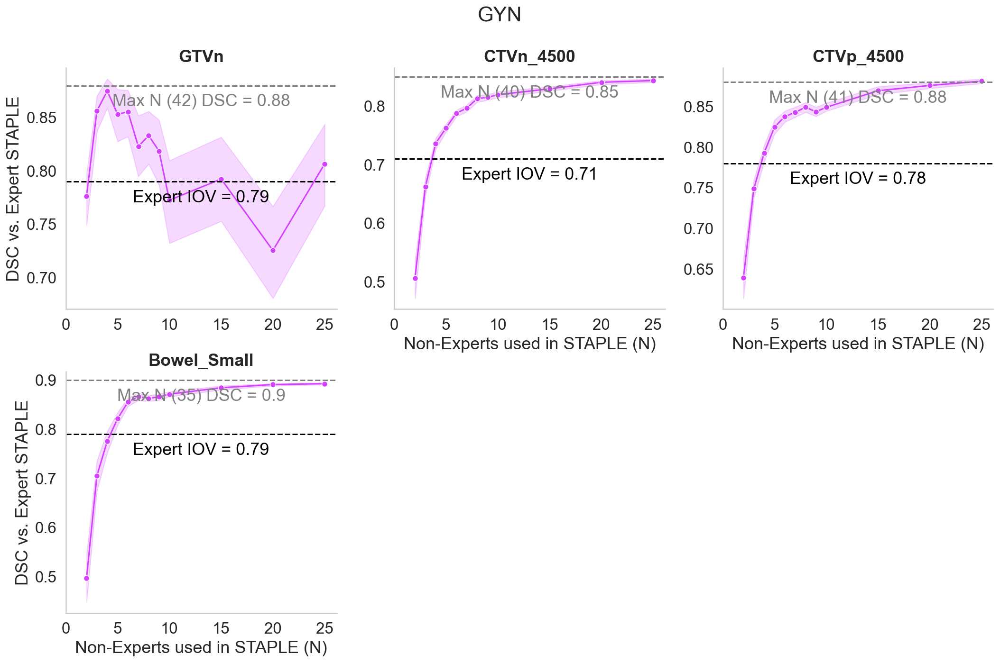

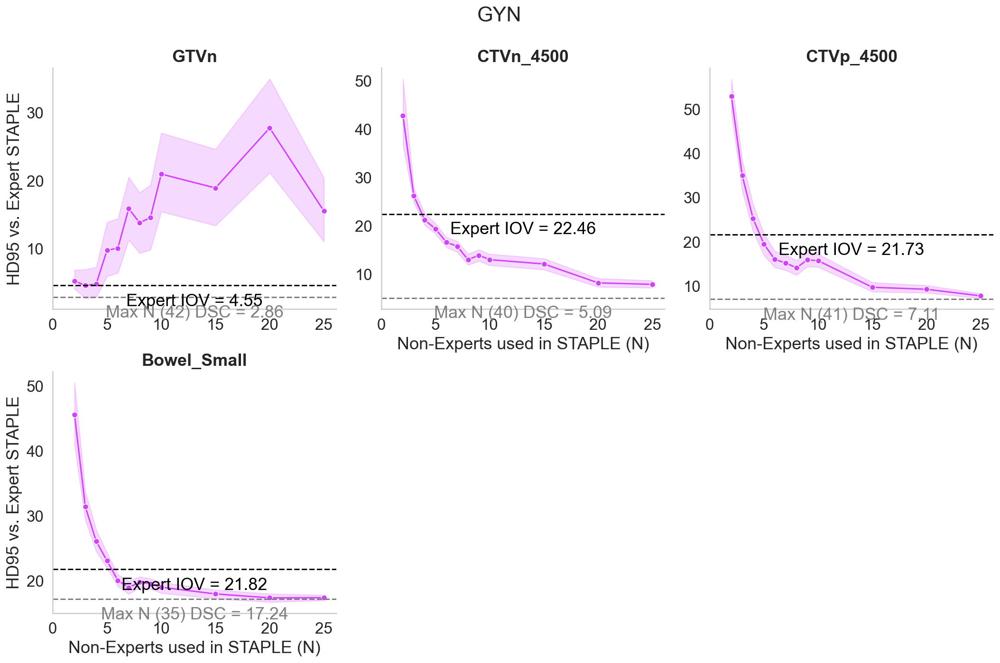

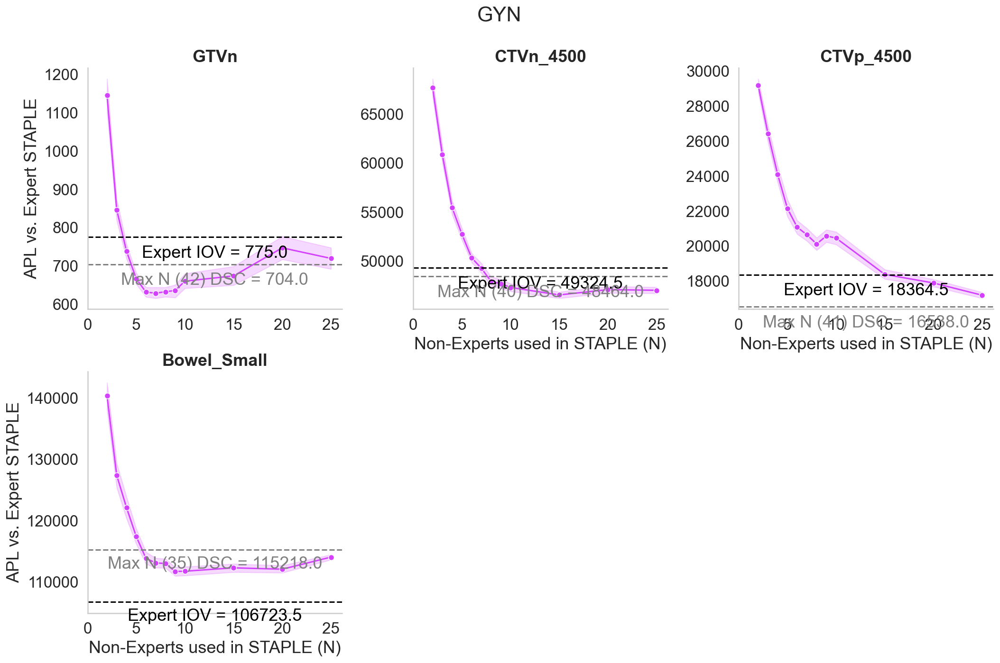

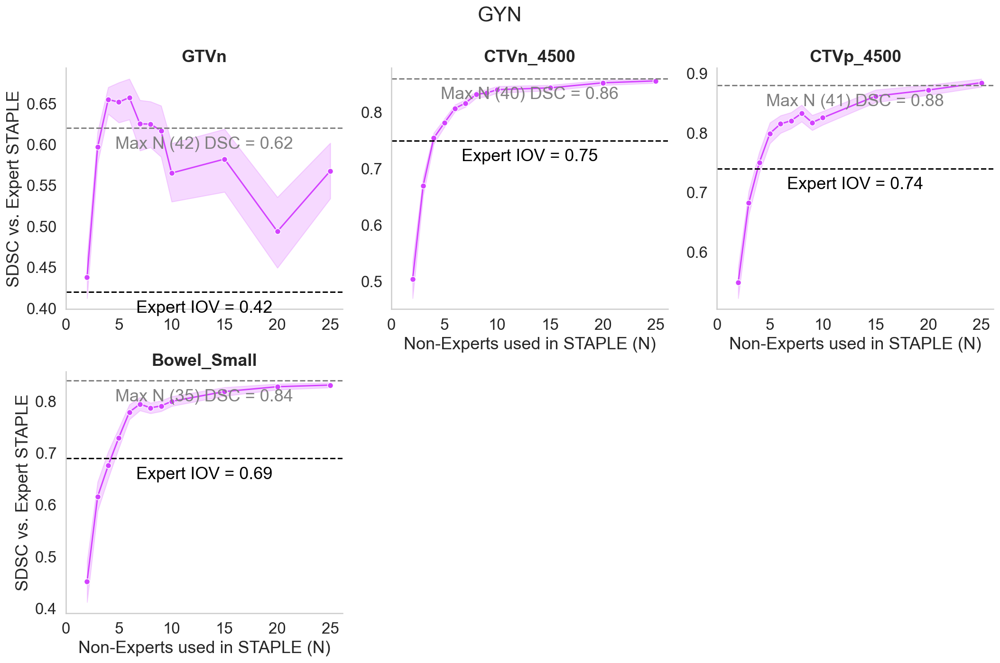

In [235]:
# TG-263 names 
ROI_dictionary = {ROI1: ROI2 for ROI1, ROI2 in zip(ROI_list, labels)}

metric_list = ["DSC_list", "HD95_list", "APL_list", "SDSC_list"]

for metric, line_dict, line_dict_maxSTAPLE in zip(metric_list, line_dict_list, line_dict_maxSTAPLE_list): # line dict defined before 
    print(metric)

    g = sns.relplot(
        data=df4_new, x="N", y=metric,
        col="ROI",
        kind="line",
        col_wrap = 3,
        facet_kws={'sharey': False, 'sharex': False},
        col_order = ROI_list, # only needed if in wrong order
        **{'marker': 'o', "err_style": 'band'}
    )

    g.set_axis_labels("Non-Experts used in STAPLE (N)", metric.split('_')[0]+" vs. Expert STAPLE")
    g.fig.suptitle('GYN')

    # flatten axes into a 1-d array
    axes = g.axes.flatten()

    # iterate through the axes
    
    for ROI, ax in zip(ROI_list, axes):

        ax.set_title(ROI_dictionary[ROI], fontdict={'fontweight':'bold'}) # TG-263 names 

        ax.set_xticks([0, 5, 10, 15, 20, 25])

        ymin, ymax = ax.get_ylim()

        xmin, xmax = ax.get_xlim()

        x_middle = (xmax-xmin)/2

        y_nudge = (ymax-ymin)/15

        value = float("{:.2f}".format(line_dict[ROI]))
        ax.axhline(value, ls='--', c='black')    
        ax.text(x_middle, value-y_nudge, "Expert IOV = " + str(value), c='black', horizontalalignment='center', verticalalignment='center')

        novice_n = df3[(df3['Class'] == "Non-Expert") & (df3['ROI'] == ROI)]['N'].values[0]

        value_maxSTAPLE = float("{:.2f}".format(line_dict_maxSTAPLE[ROI]))
        ax.axhline(value_maxSTAPLE, ls='--', c='gray')
        ax.text(x_middle, value_maxSTAPLE-y_nudge, "Max N (" + str(novice_n) +") DSC = " + str(value_maxSTAPLE), c='gray', horizontalalignment='center', verticalalignment='center')
    


        g.tight_layout()
        g.savefig('gyn_'+ metric.split('list')[0] + 'bootstrap.pdf')
        

Heatmap version here.

In [236]:
df4_reformated = df4_new.groupby(['ROI', 'N'], as_index=False).median()

In [237]:
df4_reformated 

,ROI,N,DSC_list,HD95_list,APL_list,SDSC_list
0,bowel_small,2,0.505565,38.135966,141928.0,0.435464
1,bowel_small,3,0.743033,27.343737,126408.5,0.627235
2,bowel_small,4,0.806672,24.057617,120249.0,0.704980
3,bowel_small,5,0.832891,22.503306,116639.5,0.739470
4,bowel_small,6,0.862181,20.974050,114304.5,0.779023
5,bowel_small,7,0.876392,20.235288,113104.5,0.800844
6,bowel_small,8,0.867680,20.507802,112606.5,0.786437
7,bowel_small,9,0.869335,20.507802,111840.5,0.798663
8,bowel_small,10,0.875715,20.507802,111499.5,0.803149
9,bowel_small,15,0.887862,18.554678,111870.5,0.819082


In [238]:
for index, row in df4_reformated.iterrows():
    df4_reformated.loc[index, 'DSC_norm'] = row["DSC_list"]/ line_dict_list[0][row["ROI"]]
    df4_reformated.loc[index, 'SDSC_norm'] = row["SDSC_list"]/ line_dict_list[3][row["ROI"]]

In [239]:
df4_reformated

,ROI,N,DSC_list,HD95_list,APL_list,SDSC_list,DSC_norm,SDSC_norm
0,bowel_small,2,0.505565,38.135966,141928.0,0.435464,0.639428,0.628265
1,bowel_small,3,0.743033,27.343737,126408.5,0.627235,0.939773,0.904943
2,bowel_small,4,0.806672,24.057617,120249.0,0.704980,1.020262,1.017110
3,bowel_small,5,0.832891,22.503306,116639.5,0.739470,1.053423,1.066871
4,bowel_small,6,0.862181,20.974050,114304.5,0.779023,1.090468,1.123936
5,bowel_small,7,0.876392,20.235288,113104.5,0.800844,1.108442,1.155417
6,bowel_small,8,0.867680,20.507802,112606.5,0.786437,1.097424,1.134632
7,bowel_small,9,0.869335,20.507802,111840.5,0.798663,1.099517,1.152272
8,bowel_small,10,0.875715,20.507802,111499.5,0.803149,1.107586,1.158743
9,bowel_small,15,0.887862,18.554678,111870.5,0.819082,1.122950,1.181731


In [240]:
# https://stackoverflow.com/questions/37790429/seaborn-heatmap-using-pandas-dataframe

# pivot the dataframe from long to wide form
result_DSC = df4_reformated.pivot(index='ROI', columns='N', values='DSC_norm')
result_SDSC = df4_reformated.pivot(index='ROI', columns='N', values='SDSC_norm')

In [241]:
result_DSC = result_DSC.reindex(index = ROI_list)
result_SDSC = result_SDSC.reindex(index = ROI_list)

In [242]:
result_DSC

N,2,3,4,5,6,7,8,9,10,15,20,25
ROI,,,,,,,,,,,,
gtvn,1.034297,1.114589,1.135058,1.141311,1.144175,1.140561,1.137333,1.140081,1.129055,1.132885,1.112902,1.127144
ctvn_4500,0.771341,0.931500,1.038134,1.077113,1.106509,1.113156,1.142039,1.133749,1.140951,1.162496,1.183932,1.189170
ctvp_4500,0.830078,0.958068,1.026963,1.067953,1.081949,1.080405,1.089415,1.081784,1.084736,1.110842,1.123521,1.130142
bowel_small,0.639428,0.939773,1.020262,1.053423,1.090468,1.108442,1.097424,1.099517,1.107586,1.122950,1.127111,1.130484


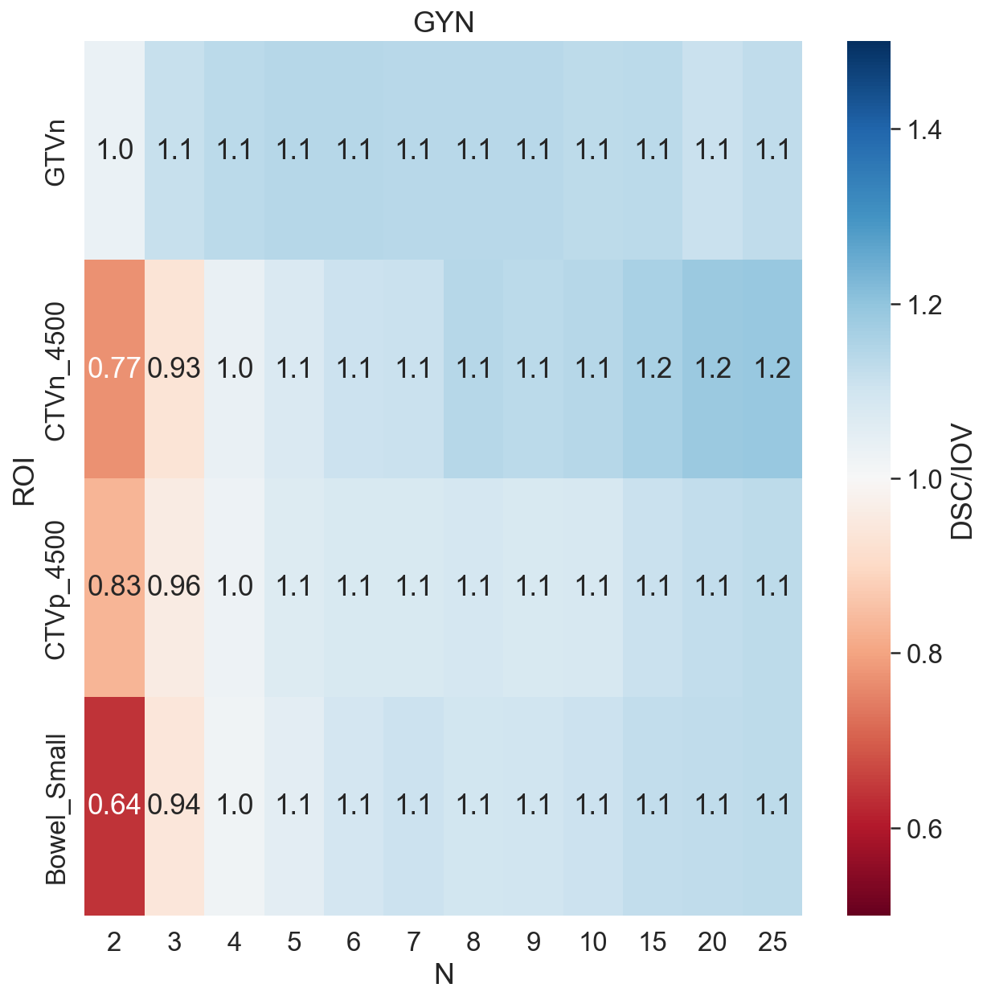

In [243]:
fig, ax = plt.subplots(figsize=(10,10))
ax = sns.heatmap(result_DSC, annot=True, fmt=".2", center=1, cmap="RdBu", 
                 vmin=0.5, vmax=1.5, 
                 cbar_kws={'label': 'DSC/IOV'},
                 annot_kws={"size": 35 / np.sqrt(len(result_DSC))})
plt.title('GYN')

# TG-263 names 
labels = ['GTVn', 'CTVn_4500', 'CTVp_4500', 'Bowel_Small']
ax.set_yticklabels(labels) 

plt.show()

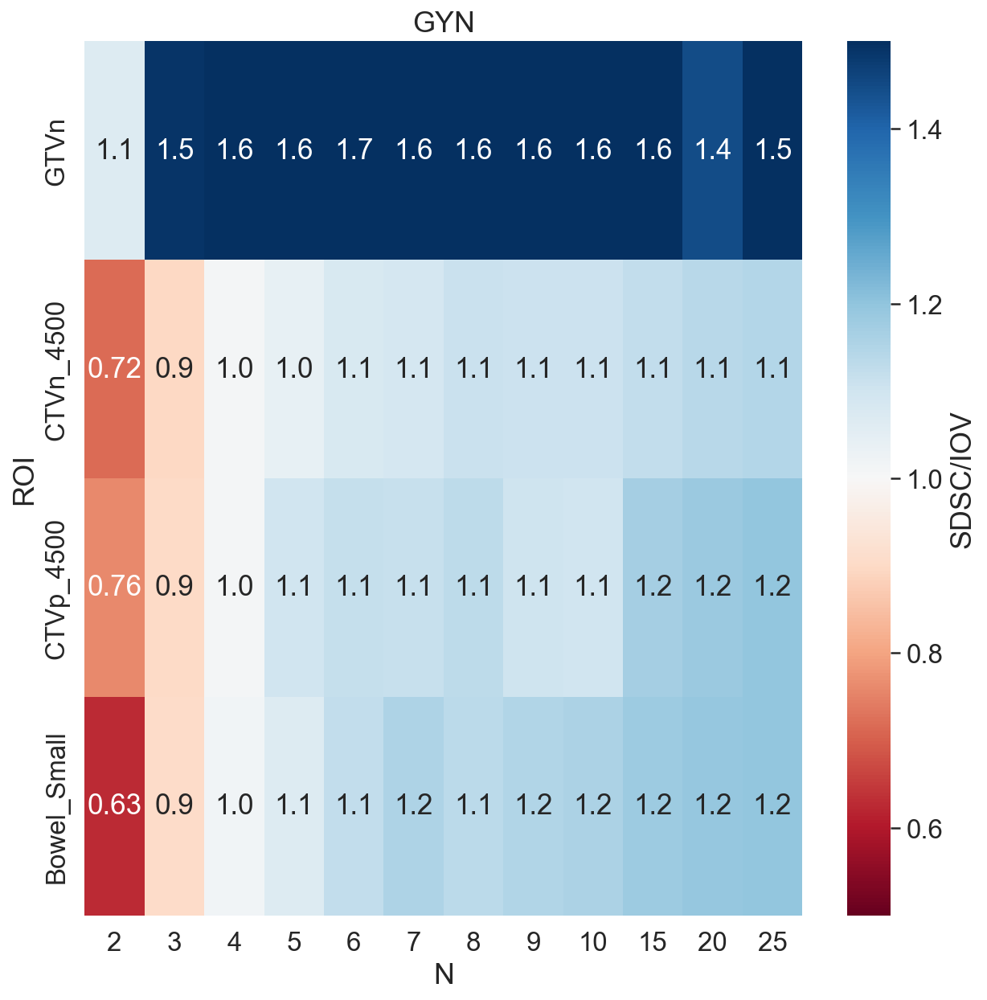

In [244]:
fig, ax = plt.subplots(figsize=(10,10))
ax = sns.heatmap(result_SDSC, annot=True, fmt=".2", center=1, cmap="RdBu", 
                 vmin=0.5, vmax=1.5, 
                 cbar_kws={'label': 'SDSC/IOV'},
                 annot_kws={"size": 35 / np.sqrt(len(result_DSC))})
plt.title('GYN')

# TG-263 names 
labels = ['GTVn', 'CTVn_4500', 'CTVp_4500', 'Bowel_Small']
ax.set_yticklabels(labels) 

plt.show()

## Part 5: GI

### Image Processing

In [5]:
# first make folders based on structure files and populate with copies of CT image 

In [245]:
base_path = "Case 5 (GI)"

In [288]:
in_path = os.path.join(base_path, "GI Structure Sets")
out_path = os.path.join(base_path, "Combined_structure_CT_DICOM")

if not os.path.isdir(out_path): # make directory if it does not exist 
    os.mkdir(out_path)

In [289]:
%%time 

structure_files = os.listdir(in_path)
for structure_file in structure_files:
    print(structure_file)
    
    structure_file_path = os.path.join(in_path, structure_file)
    
    output_folder = os.path.join(out_path, structure_file.split('.')[0])
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
        
    structure_file_path_out = os.path.join(output_folder, structure_file)
        
    shutil.copy(structure_file_path, structure_file_path_out)
    
    CT_path = os.path.join(base_path, "GI CT")
    
    CT_files = os.listdir(CT_path)
    
    for CT_file in CT_files:
        CT_file_path = os.path.join(CT_path, CT_file)
        CT_file_path_out = os.path.join(output_folder, CT_file)
        
        shutil.copy(CT_file_path, CT_file_path_out)

RS_0018.dcm
RS_0031.dcm
RS_0034.dcm
RS_0128.dcm
RS_0140.dcm
RS_0146.dcm
RS_0182.dcm
RS_0199.dcm
RS_0267.dcm
RS_0292.dcm
RS_0362.dcm
RS_0612.dcm
RS_0630.dcm
RS_0645.dcm
RS_0716.dcm
RS_0799.dcm
RS_0885.dcm
RS_0910.dcm
RS_0964.dcm
RS_0972.dcm
RS_0985.dcm
RS_1051.dcm
RS_1056.dcm
RS_1057.dcm
RS_1060.dcm
RS_1073.dcm
RS_1081.dcm
RS_1098.dcm
RS_1103.dcm
RS_232.dcm
Wall time: 31.9 s


In [290]:
# convert structures to nifti 

In [291]:
input_path =  os.path.join(base_path, "Combined_structure_CT_DICOM")
output_path = os.path.join(base_path, "structures_nifti")

if not os.path.isdir(output_path): # make directory if it does not exist 
    os.mkdir(output_path)

In [292]:
%%time
for folder in os.listdir(input_path):
    print(folder)
    folder_path = os.path.join(input_path, folder)
    print(folder_path)
    Dicom_reader = DicomReaderWriter(description='Examples', series_instances_dictionary = {}) # instantiate
    Dicom_reader.walk_through_folders(folder_path)
    all_rois = Dicom_reader.return_rois(print_rois=False)
    print(all_rois)
    
    output_path_folder = os.path.join(output_path, folder)
    if not os.path.isdir(output_path_folder): 
        os.mkdir(output_path_folder)
        
    for roi in all_rois:
        print(roi)
        Contour_Names = [roi] 
        Dicom_reader.set_contour_names_and_associations(Contour_Names=Contour_Names)
        try:
            Dicom_reader.get_images_and_mask()
            mask = Dicom_reader.mask # mask array
            mask_sitk_handle = Dicom_reader.annotation_handle # SimpleITK mask handle
            sitk.WriteImage(mask_sitk_handle, os.path.join(output_path_folder, roi+'.nii.gz'))
        except: 
            print("PROBLEM WITH", folder, roi)

Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0018
Case 5 (GI)\Combined_structure_CT_DICOM\RS_0018
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_0018


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.15s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_0018
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_0018



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.14s/it]


PROBLEM WITH RS_0018 bowel bag
ctv_45gy
ctv_54gy


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0031
Case 5 (GI)\Combined_structure_CT_DICOM\RS_0031
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_0031


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.17s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_0031
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_0031



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.47s/it]


ctv_45gy
ctv_54gy


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0034
Case 5 (GI)\Combined_structure_CT_DICOM\RS_0034
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_0034


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.17s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_0034
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_0034



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.30s/it]


ctv_45gy
ctv_54gy


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0128
Case 5 (GI)\Combined_structure_CT_DICOM\RS_0128
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_0128


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.24s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_0128
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_0128



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.53s/it]


ctv_45gy
ctv_54gy


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0140
Case 5 (GI)\Combined_structure_CT_DICOM\RS_0140
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_0140


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.15s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_0140
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy', 'gtv']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_0140



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.39s/it]


ctv_45gy
ctv_54gy
gtv


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0146
Case 5 (GI)\Combined_structure_CT_DICOM\RS_0146
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_0146


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.11s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_0146
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_0146



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.36s/it]


ctv_45gy
ctv_54gy


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0182
Case 5 (GI)\Combined_structure_CT_DICOM\RS_0182
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_0182


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.05s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_0182
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_0182



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.28s/it]


ctv_45gy
ctv_54gy


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0199
Case 5 (GI)\Combined_structure_CT_DICOM\RS_0199
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_0199


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.07s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_0199
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_0199



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.08s/it]


ctv_45gy
ctv_54gy


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0267
Case 5 (GI)\Combined_structure_CT_DICOM\RS_0267
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_0267


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.08s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_0267
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy', 'gtv', 'gtv ln illiac l']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_0267



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.32s/it]


ctv_45gy
ctv_54gy
gtv
gtv ln illiac l


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0292
Case 5 (GI)\Combined_structure_CT_DICOM\RS_0292
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_0292


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.06s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_0292
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_0292



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.96s/it]

ctv_45gy


ctv_54gy


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0362
Case 5 (GI)\Combined_structure_CT_DICOM\RS_0362
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_0362


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.08s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_0362
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_0362



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.36s/it]


ctv_45gy
ctv_54gy


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0612
Case 5 (GI)\Combined_structure_CT_DICOM\RS_0612
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_0612


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.05s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_0612
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_0612



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.44s/it]


ctv_45gy
ctv_54gy


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0630
Case 5 (GI)\Combined_structure_CT_DICOM\RS_0630
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_0630


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.07s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_0630
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_0630



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.17s/it]


ctv_45gy
ctv_54gy


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0645
Case 5 (GI)\Combined_structure_CT_DICOM\RS_0645
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_0645


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.04s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_0645
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv54', 'ctv_45gy', 'ctv_54gy']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_0645



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.24s/it]


ctv54
ctv_45gy
ctv_54gy


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0716
Case 5 (GI)\Combined_structure_CT_DICOM\RS_0716
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_0716


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.04s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_0716
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_0716



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.16s/it]


ctv_45gy
ctv_54gy


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0799
Case 5 (GI)\Combined_structure_CT_DICOM\RS_0799
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_0799


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.05s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_0799
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54', 'gtv']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_0799

PROBLEM WITH RS_0799 bowel bag
ctv_45gy


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.27s/it]


ctv_54
gtv


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0885
Case 5 (GI)\Combined_structure_CT_DICOM\RS_0885
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_0885


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.07s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_0885
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy', 'gtv']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_0885



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.20s/it]


ctv_45gy
ctv_54gy
gtv


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0910
Case 5 (GI)\Combined_structure_CT_DICOM\RS_0910
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_0910


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.04s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_0910
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_0910



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.30s/it]


ctv_45gy
ctv_54gy


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0964
Case 5 (GI)\Combined_structure_CT_DICOM\RS_0964
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_0964


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.03s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_0964
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_0964



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.11s/it]


ctv_45gy
ctv_54gy


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_0972
Case 5 (GI)\Combined_structure_CT_DICOM\RS_0972
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_0972


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.00s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_0972
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_0972



Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

ctv_45gy
PROBLEM WITH RS_0972 ctv_45gy
ctv_54gy
PROBLEM WITH RS_0972 ctv_54gy
RS_0985
Case 5 (GI)\Combined_structure_CT_DICOM\RS_0985
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_0985


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.01s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_0985
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_0985



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.17s/it]


ctv_45gy


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

ctv_54gy
PROBLEM WITH RS_0985 ctv_54gy
RS_1051
Case 5 (GI)\Combined_structure_CT_DICOM\RS_1051
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_1051


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.05s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_1051
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_1051



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.09s/it]


ctv_45gy
ctv_54gy


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_1056
Case 5 (GI)\Combined_structure_CT_DICOM\RS_1056
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_1056


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.01s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_1056
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_1056



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.14s/it]

ctv_45gy


ctv_54gy


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_1057
Case 5 (GI)\Combined_structure_CT_DICOM\RS_1057
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_1057


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.04s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_1057
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy', 'gtvp']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_1057



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.14s/it]


ctv_45gy
ctv_54gy
gtvp


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_1060
Case 5 (GI)\Combined_structure_CT_DICOM\RS_1060
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_1060


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.02s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_1060
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_1060



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.25s/it]


ctv_45gy
ctv_54gy


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_1073
Case 5 (GI)\Combined_structure_CT_DICOM\RS_1073
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_1073


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.00it/s]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_1073
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_1073



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.26s/it]


ctv_45gy
ctv_54gy


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_1081
Case 5 (GI)\Combined_structure_CT_DICOM\RS_1081
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_1081


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.04s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_1081
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_1081



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.14s/it]


ctv_45gy
ctv_54gy


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_1098
Case 5 (GI)\Combined_structure_CT_DICOM\RS_1098
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_1098


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.01s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_1098
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy', 'gtv_pet']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_1098

PROBLEM WITH RS_1098 bowel bag
ctv_45gy


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.33s/it]


ctv_54gy
gtv_pet


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_1103
Case 5 (GI)\Combined_structure_CT_DICOM\RS_1103
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_1103


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.03s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_1103
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_1103



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.28s/it]


ctv_45gy
ctv_54gy


Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

RS_232
Case 5 (GI)\Combined_structure_CT_DICOM\RS_232
Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_232


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.02s/it]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_232
1 unique series IDs were found. Default is index 0, to change use set_index(index)
['bowel bag', 'ctv_45gy', 'ctv_54gy']
bowel bag
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_232



Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.23s/it]


ctv_45gy
ctv_54gy
Wall time: 3min 29s


In [293]:
# convert CT to nifti

In [294]:
input_path = os.path.join(base_path, "Combined_structure_CT_DICOM")
output_path = os.path.join(base_path, "CT_nifti")

if not os.path.isdir(output_path): # make directory if it does not exist 
    os.mkdir(output_path)

In [295]:
Dicom_reader = DicomReaderWriter(description='Examples', series_instances_dictionary = {}) # instantiate
Dicom_reader.walk_through_folders(folder_path)
Dicom_reader.get_images()
dicom_sitk_handle = Dicom_reader.dicom_handle # SimpleITK image handle
sitk.WriteImage(dicom_sitk_handle, os.path.join(output_path, 'Image.nii.gz'))

Loading through DICOM files:   0%|                                                               | 0/1 [00:00<?, ?it/s]

Loading from Case 5 (GI)\Combined_structure_CT_DICOM\RS_232


Loading through DICOM files: 100%|███████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.30it/s]

Compiling dictionaries together...
Index 0, description None at Case 5 (GI)\Combined_structure_CT_DICOM\RS_232
1 unique series IDs were found. Default is index 0, to change use set_index(index)
Loading images for None at 
 Case 5 (GI)\Combined_structure_CT_DICOM\RS_232



In [296]:
# now make folders based on excel stratifications 

In [297]:
# make 3 folders in structures_nifti_stratified named "Novice", "Expert"

stratified_path = os.path.join(base_path, "structures_nifti_stratified")
if not os.path.isdir(stratified_path): # make directory if it does not exist 
    os.mkdir(stratified_path)

observer_list = ["Expert", "Non-Expert"]

for observer in observer_list:
    observer_path = os.path.join(stratified_path, observer)
    if not os.path.isdir(observer_path): # make directory if it does not exist 
        os.mkdir(observer_path)

In [298]:
in_path = os.path.join(base_path, "structures_nifti")
out_path = os.path.join(base_path, "structures_nifti_stratified")

In [299]:
excel_df = pd.read_excel("C3RO Case Contour Key for Fuller Lab.xlsx", sheet_name=4)

In [300]:
excel_df

,C3RO ID,Group,Notes
0,18.0,Non-expert,NaN
1,31.0,Non-expert,NaN
2,34.0,Non-expert,NaN
3,128.0,Non-expert,NaN
4,140.0,Non-expert,NaN
5,146.0,Non-expert,NaN
6,182.0,Non-expert,NaN
7,199.0,Non-expert,NaN
8,232.0,Non-expert,NaN
9,267.0,Non-expert,NaN


In [301]:
nonexpert_list = excel_df[excel_df['Group'] == "Non-expert"]['C3RO ID'].tolist()
expert_list = excel_df[excel_df['Group'] == "Expert"]['C3RO ID'].tolist()

In [302]:
print(len(nonexpert_list), len(expert_list))

26 4


In [303]:
IDs = os.listdir(in_path)
for ID in IDs:
    ID_path = os.path.join(in_path, ID)
    print(ID_path)
    ID_real = int(ID.split('_')[1].lstrip('0')) # this changed for H&N
    print(ID_real)
    if ID_real in nonexpert_list:
        folder_name = "Non-Expert"
    elif ID_real in expert_list:
        folder_name = "Expert"
    ID_path_out = os.path.join(out_path, folder_name, ID)
    print(ID_path_out)
    
    if not os.path.exists(ID_path_out):
        shutil.copytree(ID_path, ID_path_out)

Case 5 (GI)\structures_nifti\RS_0018
18
Case 5 (GI)\structures_nifti_stratified\Non-Expert\RS_0018
Case 5 (GI)\structures_nifti\RS_0031
31
Case 5 (GI)\structures_nifti_stratified\Non-Expert\RS_0031
Case 5 (GI)\structures_nifti\RS_0034
34
Case 5 (GI)\structures_nifti_stratified\Non-Expert\RS_0034
Case 5 (GI)\structures_nifti\RS_0128
128
Case 5 (GI)\structures_nifti_stratified\Non-Expert\RS_0128
Case 5 (GI)\structures_nifti\RS_0140
140
Case 5 (GI)\structures_nifti_stratified\Non-Expert\RS_0140
Case 5 (GI)\structures_nifti\RS_0146
146
Case 5 (GI)\structures_nifti_stratified\Non-Expert\RS_0146
Case 5 (GI)\structures_nifti\RS_0182
182
Case 5 (GI)\structures_nifti_stratified\Non-Expert\RS_0182
Case 5 (GI)\structures_nifti\RS_0199
199
Case 5 (GI)\structures_nifti_stratified\Non-Expert\RS_0199
Case 5 (GI)\structures_nifti\RS_0267
267
Case 5 (GI)\structures_nifti_stratified\Non-Expert\RS_0267
Case 5 (GI)\structures_nifti\RS_0292
292
Case 5 (GI)\structures_nifti_stratified\Non-Expert\RS_0292
Cas

In [306]:
in_path = os.path.join(base_path, "structures_nifti_stratified")

out_path = os.path.join(base_path, "structures_nifti_stratified_STAPLE")
if not os.path.isdir(out_path): # make directory if it does not exist 
    os.mkdir(out_path)

observer_list = ["Expert", "Non-Expert"]
for observer in observer_list:
    observer_path = os.path.join(out_path, observer)
    if not os.path.isdir(observer_path): # make directory if it does not exist 
        os.mkdir(observer_path)

In [307]:
%%time 

ROI_list = ['ctv_45gy', 'ctv_54gy', 'bowel bag']

classes = os.listdir(in_path)

for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        file_list = []
        print(class_)
        class_path = os.path.join(in_path, class_)
        
        output_folder = os.path.join(out_path, class_) # make subfolder if it does not exist 
        print(output_folder)
            
        IDs = os.listdir(class_path)
        for ID in IDs:
            #print(ID)
            ID_path = os.path.join(class_path, ID)
            structures = os.listdir(ID_path)
            for structure in structures:
                structure_path = os.path.join(ID_path, structure)
                if structure.split('.')[0] == ROI:
                    file_list.append(structure_path)
                    
        print(file_list)
        
        segmentations = [sitk.ReadImage(file_name, sitk.sitkUInt8) for file_name in file_list]
        
        foregroundValue = 1
        threshold = 0.95
        reference_segmentation_STAPLE_probabilities = sitk.STAPLE(segmentations, foregroundValue) 
        reference_segmentation_STAPLE = reference_segmentation_STAPLE_probabilities > threshold
        #print('test')
        
        output_file_path = os.path.join(output_folder, ROI+'STAPLE.nii.gz')
        print(output_file_path)
        
        sitk.WriteImage(reference_segmentation_STAPLE, output_file_path) # idk if this will work but worth a shot..           

ctv_45gy
Expert
Case 5 (GI)\structures_nifti_stratified_STAPLE\Expert
['Case 5 (GI)\\structures_nifti_stratified\\Expert\\RS_1056\\ctv_45gy.nii.gz', 'Case 5 (GI)\\structures_nifti_stratified\\Expert\\RS_1057\\ctv_45gy.nii.gz', 'Case 5 (GI)\\structures_nifti_stratified\\Expert\\RS_1060\\ctv_45gy.nii.gz', 'Case 5 (GI)\\structures_nifti_stratified\\Expert\\RS_1103\\ctv_45gy.nii.gz']
Case 5 (GI)\structures_nifti_stratified_STAPLE\Expert\ctv_45gySTAPLE.nii.gz
Non-Expert
Case 5 (GI)\structures_nifti_stratified_STAPLE\Non-Expert
['Case 5 (GI)\\structures_nifti_stratified\\Non-Expert\\RS_0018\\ctv_45gy.nii.gz', 'Case 5 (GI)\\structures_nifti_stratified\\Non-Expert\\RS_0031\\ctv_45gy.nii.gz', 'Case 5 (GI)\\structures_nifti_stratified\\Non-Expert\\RS_0034\\ctv_45gy.nii.gz', 'Case 5 (GI)\\structures_nifti_stratified\\Non-Expert\\RS_0128\\ctv_45gy.nii.gz', 'Case 5 (GI)\\structures_nifti_stratified\\Non-Expert\\RS_0140\\ctv_45gy.nii.gz', 'Case 5 (GI)\\structures_nifti_stratified\\Non-Expert\\RS_014

In [308]:
# calculate interobserver DSC for each category, updating for all metrics except SDSC which requires median of pairwise 95% HD

In [309]:
in_path = os.path.join(base_path, "structures_nifti_stratified")

In [310]:
%%time 

ROI_list = ['ctv_45gy', 'ctv_54gy', 'bowel bag']

classes = ["Expert", "Non-Expert"] # for just getting Expert and Non-Expert 

df = pd.DataFrame(columns=['ROI', 'Class', 'DSC_list', 'HD95_list', 'ASD_list', 'APL_list'])
counter = -1  

for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        file_list = []
        print(class_)
        class_path = os.path.join(in_path, class_)
        
        IDs = os.listdir(class_path)
        for ID in IDs:
            #print(ID)
            ID_path = os.path.join(class_path, ID)
            structures = os.listdir(ID_path)
            for structure in structures:
                structure_path = os.path.join(ID_path, structure)
                if structure.split('.')[0] == ROI:
                    file_list.append(structure_path)
        
        # trying extra metrics really quick
        
        DSC_list, HD95_list, ASD_list, APL_list = pairwise_main(file_list)
        print(DSC_list, len(DSC_list))
        print(HD95_list, len(HD95_list))
        print(ASD_list, len(ASD_list))
        print(APL_list, len(APL_list))
        
        counter +=1
        df.loc[counter] = [ROI, class_, DSC_list, HD95_list, ASD_list, APL_list]
        print(df)

ctv_45gy
Expert


Loading through DICOM files: 100%|██████████████████████████████████████████████████████| 1/1 [12:58<00:00, 778.84s/it]


[0.7654899433779677, 0.8334680361207345, 0.7661911463994887, 0.7371351295779326, 0.7263376797069669, 0.7533748104593795] 6
[25.390612602233887, 11.5076016220954, 18.554678440093994, 27.34373664855957, 28.387567884478898, 15.083176898102915] 6
[3.851085464303038, 2.5884047480683927, 4.182106166324058, 4.316284027417634, 4.4970678885931115, 4.006270676216882] 6
[78994, 76309, 108939, 74920, 103620, 109400] 6
        ROI   Class                                           DSC_list  \
0  ctv_45gy  Expert  [0.7654899433779677, 0.8334680361207345, 0.766...   

                                           HD95_list  \
0  [25.390612602233887, 11.5076016220954, 18.5546...   

                                            ASD_list  \
0  [3.851085464303038, 2.5884047480683927, 4.1821...   

                                        APL_list  
0  [78994, 76309, 108939, 74920, 103620, 109400]  
Non-Expert
[0.5920965960179833, 0.6975548209859572, 0.7624170359194143, 0.6620893540252277, 0.5495363245053121, 0

[0.6775887943971985, 0.7390471995391861, 0.5117010560519902, 0.7675432428631698, 0.5113276258153158, 0.5645399749800978] 6
[16.5213522485847, 10.0, 108.62065036781522, 10.873765218656033, 121.72120026796362, 114.54488561699976] 6
[4.035786382267716, 2.8186102776077453, 26.55910602083984, 2.6656766382849093, 28.65676468659983, 26.39522869345398] 6
[10720, 12970, 29882, 12411, 29915, 29215] 6
        ROI       Class                                           DSC_list  \
0  ctv_45gy      Expert  [0.7654899433779677, 0.8334680361207345, 0.766...   
1  ctv_45gy  Non-Expert  [0.5920965960179833, 0.6975548209859572, 0.762...   
2  ctv_54gy      Expert  [0.6775887943971985, 0.7390471995391861, 0.511...   

                                           HD95_list  \
0  [25.390612602233887, 11.5076016220954, 18.5546...   
1  [28.387567884478898, 32.55854865496484, 13.218...   
2  [16.5213522485847, 10.0, 108.62065036781522, 1...   

                                            ASD_list  \
0  [3.851085

[0.85531109509414, 0.7025302425051183, 0.607932289041843, 0.6333912900338481, 0.6385676057934446, 0.6063259869938541] 6
[9.119982263695366, 31.679777996038883, 46.05844613180567, 29.80057740213991, 44.96429223703932, 23.87804386557584] 6
[2.4337094565812984, 4.687946421312175, 7.8890741305168115, 6.315096512837212, 8.08952174150457, 5.941711567729605] 6
[61991, 42161, 47717, 45770, 49551, 45924] 6
         ROI       Class                                           DSC_list  \
0   ctv_45gy      Expert  [0.7654899433779677, 0.8334680361207345, 0.766...   
1   ctv_45gy  Non-Expert  [0.5920965960179833, 0.6975548209859572, 0.762...   
2   ctv_54gy      Expert  [0.6775887943971985, 0.7390471995391861, 0.511...   
3   ctv_54gy  Non-Expert  [0.5213603654971816, 0.8102195216394126, 0.784...   
4  bowel bag      Expert  [0.85531109509414, 0.7025302425051183, 0.60793...   

                                           HD95_list  \
0  [25.390612602233887, 11.5076016220954, 18.5546...   
1  [28.38756

In [311]:
df

,ROI,Class,DSC_list,HD95_list,ASD_list,APL_list
0,ctv_45gy,Expert,"[0.7654899433779677, 0.8334680361207345, 0.766...","[25.390612602233887, 11.5076016220954, 18.5546...","[3.851085464303038, 2.5884047480683927, 4.1821...","[78994, 76309, 108939, 74920, 103620, 109400]"
1,ctv_45gy,Non-Expert,"[0.5920965960179833, 0.6975548209859572, 0.762...","[28.387567884478898, 32.55854865496484, 13.218...","[6.4481822228965875, 4.979588413351189, 2.9480...","[117859, 87020, 64484, 73392, 43318, 96887, 83..."
2,ctv_54gy,Expert,"[0.6775887943971985, 0.7390471995391861, 0.511...","[16.5213522485847, 10.0, 108.62065036781522, 1...","[4.035786382267716, 2.8186102776077453, 26.559...","[10720, 12970, 29882, 12411, 29915, 29215]"
3,ctv_54gy,Non-Expert,"[0.5213603654971816, 0.8102195216394126, 0.784...","[38.142303100431945, 10.047570521528272, 20.02...","[8.757019417716535, 2.399921680026938, 3.55209...","[43940, 10909, 10311, 19329, 4434, 3543, 16725..."
4,bowel bag,Expert,"[0.85531109509414, 0.7025302425051183, 0.60793...","[9.119982263695366, 31.679777996038883, 46.058...","[2.4337094565812984, 4.687946421312175, 7.8890...","[61991, 42161, 47717, 45770, 49551, 45924]"
5,bowel bag,Non-Expert,"[0.4320449305030745, 0.5912061199452611, 0.360...","[70.31246566772461, 60.44320895806176, 59.8514...","[16.915554030212625, 11.302076505782097, 10.71...","[152681, 69357, 195449, 48155, 64369, 63815, 5..."


In [312]:
# add in SDSC 

In [313]:
%%time
ROI_list = ['ctv_45gy', 'ctv_54gy', 'bowel bag']

classes = ["Expert", "Non-Expert"] # for just getting Expert and Non-Expert 

counter = -1  

SDSC_master_list = []
for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        file_list = []
        print(class_)
        class_path = os.path.join(in_path, class_)
        
        IDs = os.listdir(class_path)
        for ID in IDs:
            #print(ID)
            ID_path = os.path.join(class_path, ID)
            structures = os.listdir(ID_path)
            for structure in structures:
                structure_path = os.path.join(ID_path, structure)
                if structure.split('.')[0] == ROI:
                    file_list.append(structure_path)
        
        # trying extra metrics really quick
        tolerance = np.median(df[(df["ROI"] == ROI) & (df["Class"] == "Expert")]["ASD_list"].values[0]) # get tolerance
        SDSC_list = pairwise_SDSC(file_list, tolerance)
        print(SDSC_list, len(SDSC_list))
        SDSC_master_list.append(SDSC_list)
        

ctv_45gy
Expert
[0.7590277829373188, 0.8139109209873636, 0.6410110050058816, 0.7146832892202535, 0.6944690015620936, 0.662475134339714] 6
Non-Expert
[0.5573686051138654, 0.7335816547052181, 0.7733223758028633, 0.6369704712948691, 0.5927183167639757, 0.5835932673733244, 0.7649684275283575, 0.6782457906205244, 0.23132400377717377, 0.6717758772047752, 0.5139025470519578, 0.7421376868698581, 0.596070988004451, 0.7283217000906197, 0.8046973530624031, 0.7159444097603438, 0.722016254602757, 0.8324735733865176, 0.7812282400722675, 0.6984906211463583, 0.7328912219119821, 0.6534753868632871, 0.6817319235036534, 0.7896959468235948, 0.7126682802134998, 0.590375309839238, 0.5865132736858291, 0.3910463107528922, 0.5548820357767679, 0.6467669356997915, 0.6195492194802763, 0.0641150480981798, 0.6966154982906095, 0.3430914478469543, 0.71477318000876, 0.6486249669208385, 0.6345553947987124, 0.6646348590301532, 0.5498608345060734, 0.6631657473002699, 0.6218454245660211, 0.6090589943160525, 0.573790277533

[0.9277819912012063, 0.6992632587069221, 0.584014195937134, 0.6014513627200073, 0.6387954706971446, 0.6548929291188608] 6
Non-Expert
[0.4261792393181133, 0.528968096264509, 0.5599784449913163, 0.6876157981222337, 0.6817065978181852, 0.6755937146630691, 0.4444423866764086, 0.2517409078257142, 0.7192671276999297, 0.8433679968019259, 0.868751763713478, 0.5998358501729003, 0.793264310587177, 0.5733580167035656, 0.474889011531391, 0.4829578551312284, 0.8142505632460951, 0.5037090994824835, 0.7311887070392873, 0.6796053084341566, 0.4726399563742883, 0.8343256601001053, 0.5848690734934271, 0.41743702625302925, 0.4670183503074689, 0.4603322317704144, 0.5489628755583299, 0.49539372793589626, 0.2333832299326957, 0.5756962099712263, 0.467048432426483, 0.4066159262104815, 0.5013944328597388, 0.5543734167894395, 0.7664582620418403, 0.4331651052284396, 0.5444059397729032, 0.5815525079368449, 0.5381024993871577, 0.43186358836893185, 0.3531617534207468, 0.3992808198250661, 0.506477146360734, 0.5357546

In [314]:
print(len(SDSC_master_list))

6


In [315]:
df['SDSC_list'] = SDSC_master_list

In [316]:
df

,ROI,Class,DSC_list,HD95_list,ASD_list,APL_list,SDSC_list
0,ctv_45gy,Expert,"[0.7654899433779677, 0.8334680361207345, 0.766...","[25.390612602233887, 11.5076016220954, 18.5546...","[3.851085464303038, 2.5884047480683927, 4.1821...","[78994, 76309, 108939, 74920, 103620, 109400]","[0.7590277829373188, 0.8139109209873636, 0.641..."
1,ctv_45gy,Non-Expert,"[0.5920965960179833, 0.6975548209859572, 0.762...","[28.387567884478898, 32.55854865496484, 13.218...","[6.4481822228965875, 4.979588413351189, 2.9480...","[117859, 87020, 64484, 73392, 43318, 96887, 83...","[0.5573686051138654, 0.7335816547052181, 0.773..."
2,ctv_54gy,Expert,"[0.6775887943971985, 0.7390471995391861, 0.511...","[16.5213522485847, 10.0, 108.62065036781522, 1...","[4.035786382267716, 2.8186102776077453, 26.559...","[10720, 12970, 29882, 12411, 29915, 29215]","[0.9647268896498082, 0.995469026540721, 0.5838..."
3,ctv_54gy,Non-Expert,"[0.5213603654971816, 0.8102195216394126, 0.784...","[38.142303100431945, 10.047570521528272, 20.02...","[8.757019417716535, 2.399921680026938, 3.55209...","[43940, 10909, 10311, 19329, 4434, 3543, 16725...","[0.7512146991772566, 0.9902861927413164, 0.953..."
4,bowel bag,Expert,"[0.85531109509414, 0.7025302425051183, 0.60793...","[9.119982263695366, 31.679777996038883, 46.058...","[2.4337094565812984, 4.687946421312175, 7.8890...","[61991, 42161, 47717, 45770, 49551, 45924]","[0.9277819912012063, 0.6992632587069221, 0.584..."
5,bowel bag,Non-Expert,"[0.4320449305030745, 0.5912061199452611, 0.360...","[70.31246566772461, 60.44320895806176, 59.8514...","[16.915554030212625, 11.302076505782097, 10.71...","[152681, 69357, 195449, 48155, 64369, 63815, 5...","[0.4261792393181133, 0.528968096264509, 0.5599..."


In [246]:
pickle_path = os.path.join(base_path, 'df_full_GI.pkl') # newest
#df.to_pickle(pickle_path)

In [247]:
df_pickle = pd.read_pickle(pickle_path)

In [248]:
df_pickle

,ROI,Class,DSC_list,HD95_list,ASD_list,APL_list,SDSC_list
0,ctv_45gy,Expert,"[0.7654899433779677, 0.8334680361207345, 0.766...","[25.390612602233887, 11.5076016220954, 18.5546...","[3.851085464303038, 2.5884047480683927, 4.1821...","[78994, 76309, 108939, 74920, 103620, 109400]","[0.7590277829373188, 0.8139109209873636, 0.641..."
1,ctv_45gy,Non-Expert,"[0.5920965960179833, 0.6975548209859572, 0.762...","[28.387567884478898, 32.55854865496484, 13.218...","[6.4481822228965875, 4.979588413351189, 2.9480...","[117859, 87020, 64484, 73392, 43318, 96887, 83...","[0.5573686051138654, 0.7335816547052181, 0.773..."
2,ctv_54gy,Expert,"[0.6775887943971985, 0.7390471995391861, 0.511...","[16.5213522485847, 10.0, 108.62065036781522, 1...","[4.035786382267716, 2.8186102776077453, 26.559...","[10720, 12970, 29882, 12411, 29915, 29215]","[0.9647268896498082, 0.995469026540721, 0.5838..."
3,ctv_54gy,Non-Expert,"[0.5213603654971816, 0.8102195216394126, 0.784...","[38.142303100431945, 10.047570521528272, 20.02...","[8.757019417716535, 2.399921680026938, 3.55209...","[43940, 10909, 10311, 19329, 4434, 3543, 16725...","[0.7512146991772566, 0.9902861927413164, 0.953..."
4,bowel bag,Expert,"[0.85531109509414, 0.7025302425051183, 0.60793...","[9.119982263695366, 31.679777996038883, 46.058...","[2.4337094565812984, 4.687946421312175, 7.8890...","[61991, 42161, 47717, 45770, 49551, 45924]","[0.9277819912012063, 0.6992632587069221, 0.584..."
5,bowel bag,Non-Expert,"[0.4320449305030745, 0.5912061199452611, 0.360...","[70.31246566772461, 60.44320895806176, 59.8514...","[16.915554030212625, 11.302076505782097, 10.71...","[152681, 69357, 195449, 48155, 64369, 63815, 5...","[0.4261792393181133, 0.528968096264509, 0.5599..."


### Interobserver Variability Analysis¶

In [250]:
# FIRST NEED TO GENERATE EXPLODED DATAFRAME

df_pickle_explode = df_pickle.explode(['DSC_list', 'HD95_list', 'ASD_list', 'APL_list', 'SDSC_list'])

In [251]:
df_pickle_explode

,ROI,Class,DSC_list,HD95_list,ASD_list,APL_list,SDSC_list
0,ctv_45gy,Expert,0.76549,25.390613,3.851085,78994,0.759028
0,ctv_45gy,Expert,0.833468,11.507602,2.588405,76309,0.813911
0,ctv_45gy,Expert,0.766191,18.554678,4.182106,108939,0.641011
0,ctv_45gy,Expert,0.737135,27.343737,4.316284,74920,0.714683
0,ctv_45gy,Expert,0.726338,28.387568,4.497068,103620,0.694469
...,...,...,...,...,...,...,...
5,bowel bag,Non-Expert,0.695693,48.490084,7.674954,34391,0.690836
5,bowel bag,Non-Expert,0.688764,16.858074,4.847785,88879,0.695855
5,bowel bag,Non-Expert,0.594103,62.785872,10.93278,36124,0.665133
5,bowel bag,Non-Expert,0.598142,23.212614,7.303582,98375,0.57883


In [252]:
df_pickle_explode['DSC_list']=df_pickle_explode['DSC_list'].astype('float64') # need this for violinplot for some reason
df_pickle_explode['HD95_list']=df_pickle_explode['HD95_list'].astype('float64')
df_pickle_explode['ASD_list']=df_pickle_explode['ASD_list'].astype('float64')
df_pickle_explode['APL_list']=df_pickle_explode['APL_list'].astype('float64')
df_pickle_explode['SDSC_list']=df_pickle_explode['SDSC_list'].astype('float64')

In [253]:
df_pickle_explode.groupby(['Class', 'ROI']).median() # tolerance values 

DSC_list  HD95_list   ASD_list  APL_list  SDSC_list
Class      ROI                                                           
Expert     bowel bag  0.635979  30.740178   6.128404   46820.5   0.646844
           ctv_45gy   0.759432  21.972646   4.094188   91307.0   0.704576
           ctv_54gy   0.621064  62.571001  15.215508   21092.5   0.782480
Non-Expert bowel bag  0.586971  35.156233   7.674954   68694.0   0.597989
           ctv_45gy   0.640025  22.460927   4.748170   82387.0   0.655520
           ctv_54gy   0.479234  24.963164   6.834471   10852.0   0.864101

In [255]:
gi_palette_old = ["#03d13f", "#A000D0"]
gi_palette = ["#bcfecf", "#028a29"]

DSC_list
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

ctv_54gy_Non-Expert vs. ctv_54gy_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:4.059e-02 U_stat=3.910e+02
ctv_45gy_Non-Expert vs. ctv_45gy_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:9.493e-05 U_stat=1.620e+02
bowel bag_Non-Expert vs. bowel bag_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:1.860e-01 U_stat=5.160e+02
SDSC_list
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

ctv_54gy_Non-Expert vs. ctv_54gy_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:9.494e-01 U_stat=7.470e+02
ctv_45gy_Non-Expert vs. ctv_45gy_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:9.262e-02 U_stat=5.380e+02
bowel bag_Non-Expert vs. bowel bag_Expert: Mann-Whitney-W

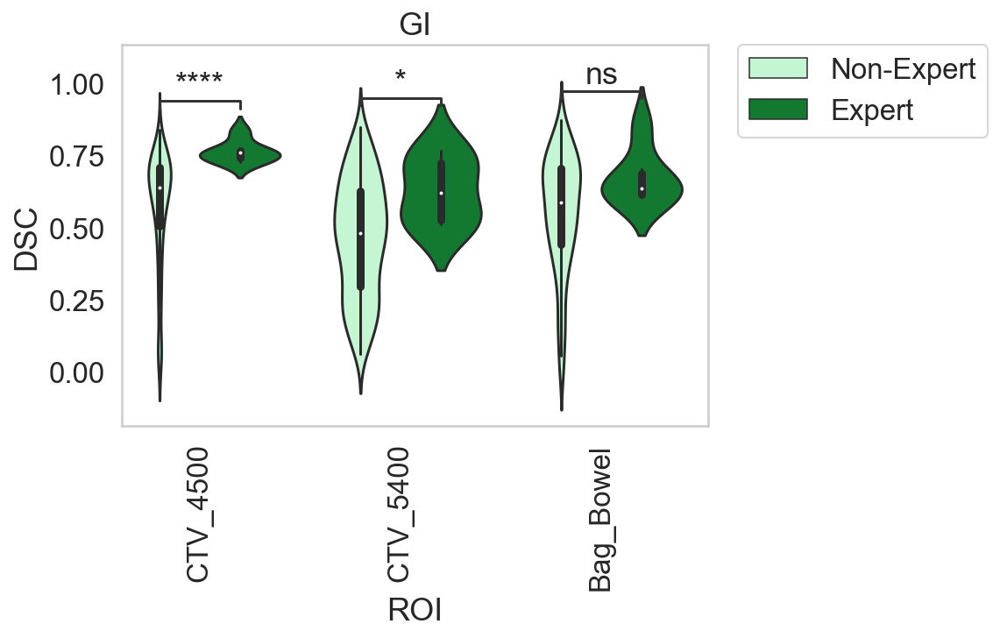

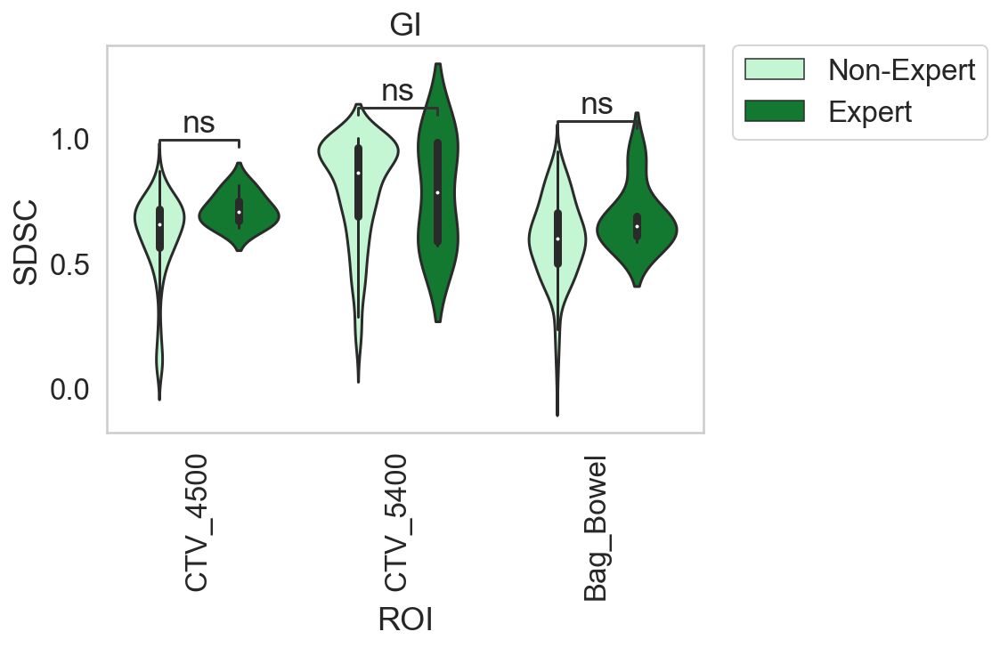

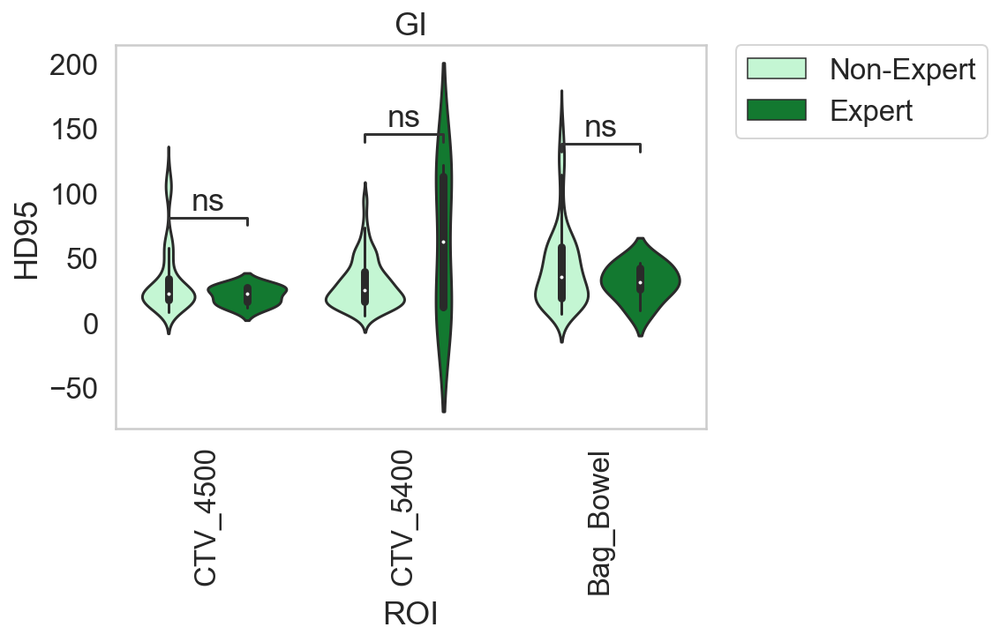

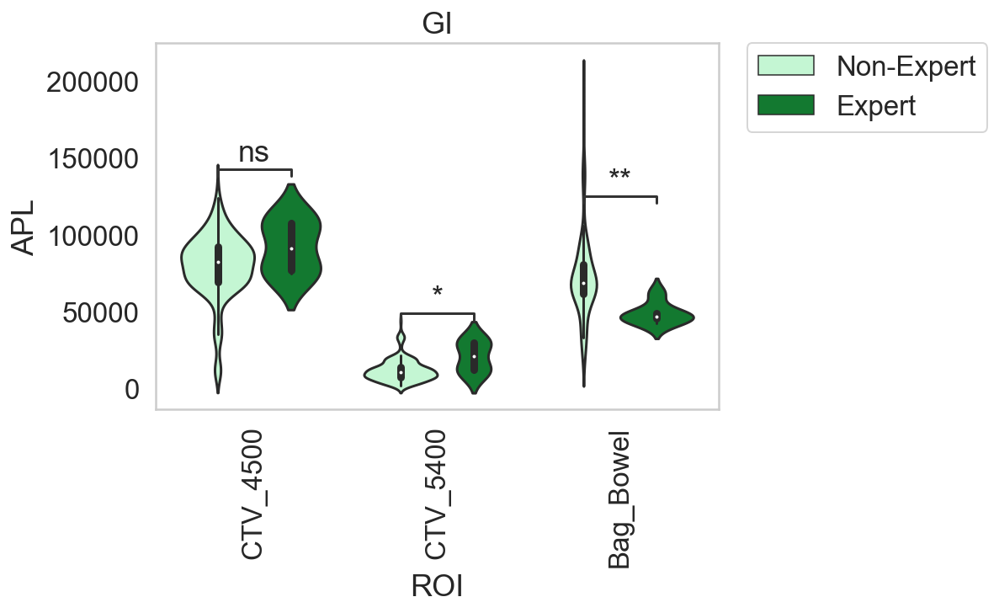

<Figure size 432x288 with 0 Axes>

In [256]:
x="ROI" 

y="SDSC_list"

y_list = ["DSC_list", "SDSC_list", "HD95_list", "APL_list"]

for y in y_list:
    print(y)

    hue="Class"
    hue_order = ['Generalist', 'Self-ID Specialist', 'Expert']
    hue_order = ['Generalist', 'Expert']
    hue_order = ['Non-Expert', 'Expert']

    ROI_list = ['ctv_45gy', 'ctv_54gy', 'bowel bag']

    ax = sns.violinplot(x=x, y=y, hue=hue,
                     data=df_pickle_explode,
                       hue_order = hue_order,
                       palette=gi_palette,
                       order = ROI_list) # Dont forget to set order in the calls below if you use it here 



    class_list = ['Generalist', 'Expert']
    class_list = ['Non-Expert', 'Expert']

    pairs = [tuple((ROI, classes) for classes in class_list) for ROI in ROI_list]

    # all combos, in theory reduces down to code above in 2-class example
    combination_list = list(itertools.combinations(class_list, 2))
    pairs = [tuple((ROI, classes) for classes in subclass_list) for subclass_list in combination_list for ROI in ROI_list]


    annot = Annotator(ax, pairs, data=df_pickle_explode, x=x, y=y, hue=hue, hue_order=hue_order, order = ROI_list)

    annot.new_plot(ax, pairs, data=df_pickle_explode, x=x, y=y, hue=hue, hue_order=hue_order, order = ROI_list)
    annot.configure(test='Mann-Whitney', verbose=2)
    annot.apply_test()
    annot.annotate()
    
    # TG-263 names 
    labels = ['CTV_4500', 'CTV_5400', 'Bag_Bowel']
    ax.set_xticklabels(labels)

    plt.xticks(rotation=90)
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    plt.ylabel(y.split('_')[0])
    plt.title('GI')
    
    plt.figure()

Volume measurements here.

In [258]:
%%time 

in_path = os.path.join(base_path, "structures_nifti_stratified")

ROI_list = ['ctv_45gy', 'ctv_54gy', 'bowel bag']

classes = ["Expert", "Non-Expert"] # for just getting Expert and Non-Expert 

df_vol = pd.DataFrame(columns=['ROI', 'Class', 'ID', 'Volume'])
counter = -1  

for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        print(class_)
        class_path = os.path.join(in_path, class_)
        
        IDs = os.listdir(class_path)
        for ID in IDs:
            #print(ID)
            ID_path = os.path.join(class_path, ID)
            structures = os.listdir(ID_path)
            for structure in structures:
                structure_path = os.path.join(ID_path, structure)
                if structure.split('.')[0] == ROI:
                    structure_volume = calculate_volume(structure_path)
                    
                    counter +=1
                    df_vol.loc[counter] = [ROI, class_, ID, structure_volume]
                    #print(df_vol)

ctv_45gy
Expert
Non-Expert
ctv_54gy
Expert
Non-Expert
bowel bag
Expert
Non-Expert
Wall time: 34.6 s


In [259]:
df_vol

,ROI,Class,ID,Volume
0,ctv_45gy,Expert,RS_1056,1087.082729
1,ctv_45gy,Expert,RS_1057,1014.477192
2,ctv_45gy,Expert,RS_1060,1095.866061
3,ctv_45gy,Expert,RS_1103,1680.892217
4,ctv_45gy,Non-Expert,RS_0018,930.854343
...,...,...,...,...
78,bowel bag,Non-Expert,RS_0985,1181.615602
79,bowel bag,Non-Expert,RS_1051,991.550885
80,bowel bag,Non-Expert,RS_1073,1010.791245
81,bowel bag,Non-Expert,RS_1081,586.358915


p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

ctv_54gy_Non-Expert vs. ctv_54gy_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:6.217e-01 U_stat=3.800e+01
ctv_45gy_Non-Expert vs. ctv_45gy_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:2.806e-01 U_stat=3.200e+01
bowel bag_Non-Expert vs. bowel bag_Expert: Mann-Whitney-Wilcoxon test two-sided, P_val:3.715e-01 U_stat=6.000e+01


<Figure size 432x288 with 0 Axes>

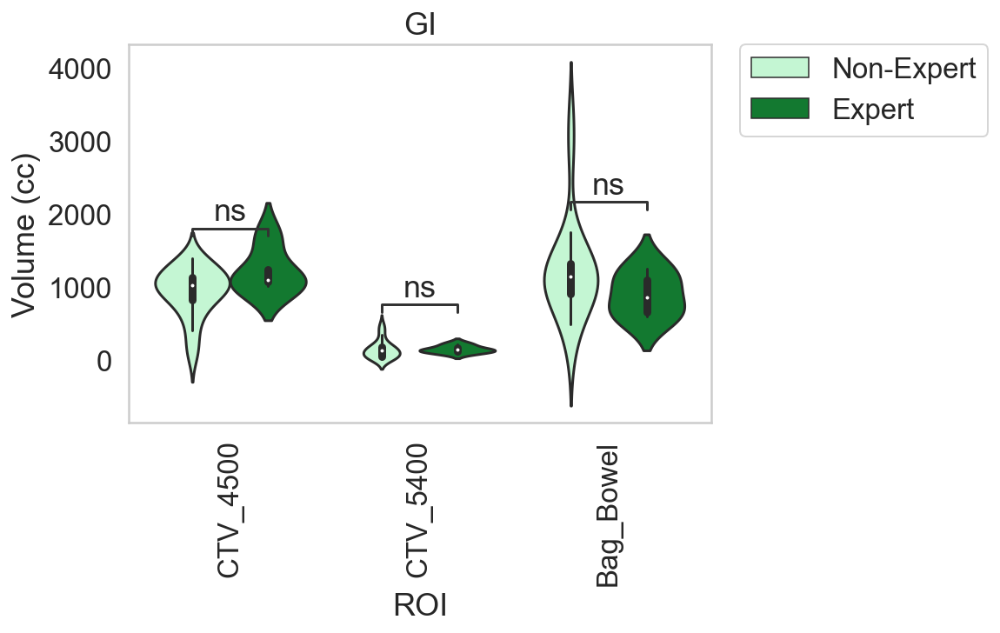

<Figure size 432x288 with 0 Axes>

In [260]:
x="ROI" 
y="Volume"
hue="Class"
hue_order = ['Non-Expert', 'Expert']
ROI_list = ['ctv_45gy', 'ctv_54gy', 'bowel bag']

ax = sns.violinplot(x=x, y=y, hue=hue,
                 data=df_vol,
                   hue_order = hue_order,
                   palette=gi_palette,
                   order = ROI_list) # Dont forget to set order in the calls below if you use it here 

class_list = ['Non-Expert', 'Expert']

pairs = [tuple((ROI, classes) for classes in class_list) for ROI in ROI_list]

# all combos, in theory reduces down to code above in 2-class example
combination_list = list(itertools.combinations(class_list, 2))
pairs = [tuple((ROI, classes) for classes in subclass_list) for subclass_list in combination_list for ROI in ROI_list]

annot = Annotator(ax, pairs, data=df_vol, x=x, y=y, hue=hue, hue_order=hue_order, order = ROI_list)

annot.new_plot(ax, pairs, data=df_vol, x=x, y=y, hue=hue, hue_order=hue_order, order = ROI_list)
annot.configure(test='Mann-Whitney', verbose=2)
annot.apply_test()
annot.annotate()

# TG-263 names 
labels = ['CTV_4500', 'CTV_5400', 'Bag_Bowel']
ax.set_xticklabels(labels)

plt.xticks(rotation=90)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.ylabel('Volume (cc)')
plt.title('GI')

plt.figure()

### Direct comparisons of non-expert vs. expert STAPLE segmentations

In [261]:
df_pickle['DSC_median'] = df_pickle['DSC_list'].apply(lambda x: np.median(x))
df_pickle['HD95_median'] = df_pickle['HD95_list'].apply(lambda x: np.median(x))
df_pickle['APL_median'] = df_pickle['APL_list'].apply(lambda x: np.median(x))
df_pickle['SDSC_median'] = df_pickle['SDSC_list'].apply(lambda x: np.median(x))

In [262]:
df_pickle[df_pickle['Class'] == "Expert"] # just show expert answers which is what we care about

,ROI,Class,DSC_list,HD95_list,ASD_list,APL_list,SDSC_list,DSC_median,HD95_median,APL_median,SDSC_median
0,ctv_45gy,Expert,"[0.7654899433779677, 0.8334680361207345, 0.766...","[25.390612602233887, 11.5076016220954, 18.5546...","[3.851085464303038, 2.5884047480683927, 4.1821...","[78994, 76309, 108939, 74920, 103620, 109400]","[0.7590277829373188, 0.8139109209873636, 0.641...",0.759432,21.972646,91307.0,0.704576
2,ctv_54gy,Expert,"[0.6775887943971985, 0.7390471995391861, 0.511...","[16.5213522485847, 10.0, 108.62065036781522, 1...","[4.035786382267716, 2.8186102776077453, 26.559...","[10720, 12970, 29882, 12411, 29915, 29215]","[0.9647268896498082, 0.995469026540721, 0.5838...",0.621064,62.571001,21092.5,0.782480
4,bowel bag,Expert,"[0.85531109509414, 0.7025302425051183, 0.60793...","[9.119982263695366, 31.679777996038883, 46.058...","[2.4337094565812984, 4.687946421312175, 7.8890...","[61991, 42161, 47717, 45770, 49551, 45924]","[0.9277819912012063, 0.6992632587069221, 0.584...",0.635979,30.740178,46820.5,0.646844


In [263]:
# now can calculate DSC between STAPLE of novices and experts vs gold standard, see if they cross the thresholds 
# add in other metrics 

In [264]:
in_path = os.path.join(base_path, "structures_nifti_stratified_STAPLE")

In [265]:
%%time 

ROI_list = ['ctv_45gy', 'ctv_54gy', 'bowel bag']

classes = ["Non-Expert", "Expert"]

df2 = pd.DataFrame(columns=['ROI', 'Class', 'DSC', 'HD95', 'APL', 'SDSC'])
counter = -1  

for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        file_list = []
        print(class_)
        class_path = os.path.join(in_path, class_)

        structures = os.listdir(class_path)
        for structure in structures:
            print(structure)
            structure_path = os.path.join(class_path, structure)
            if structure.split('STAPLE.')[0] == ROI:

                file_1 = sitk.ReadImage(structure_path)
                file_2 = sitk.ReadImage(os.path.join(in_path, 'Expert', structure))

                mask_1 = sitk.GetArrayFromImage(file_1)
                mask_2 = sitk.GetArrayFromImage(file_2)

                DSC = compute_dice_coefficient(mask_1, mask_2)  
                
                # adding other metrics
                
                spacing_mm = file_1.GetSpacing() # need spacing to calcualte distances
                
                mask_1_bool = mask_1.astype(bool) # need to convert to bool format to work 
                mask_2_bool = mask_2.astype(bool)

                surface_distances = compute_surface_distances(mask_1_bool, mask_2_bool, spacing_mm) # need this for all calculations
                HD95 = compute_robust_hausdorff(surface_distances, 95)

                ASD_truth = compute_average_surface_distance(surface_distances)[0] #  A tuple with two float values: 1. the average distance (in mm) from the ground truth surface to thepredicted surface, 2. the average distance from the predicted surface to the ground truth surface.
                ASD_pred = compute_average_surface_distance(surface_distances)[1]
                ASD = (ASD_truth + ASD_pred)/2

                APL = AddedPathLength(mask_1, mask_2)
                
                tolerance = np.median(df_pickle[(df_pickle["ROI"] == ROI) & (df_pickle["Class"] == "Expert")]["ASD_list"].values[0]) # get tolerance
                SDSC = compute_surface_dice_at_tolerance(surface_distances, tolerance)
                     
        counter +=1
        df2.loc[counter] = [ROI, class_, DSC, HD95, APL, SDSC]
        #print(df2)

ctv_45gy
Non-Expert
bowel bagSTAPLE.nii.gz
ctv_45gySTAPLE.nii.gz
ctv_54gySTAPLE.nii.gz
Expert
bowel bagSTAPLE.nii.gz
ctv_45gySTAPLE.nii.gz
ctv_54gySTAPLE.nii.gz
ctv_54gy
Non-Expert
bowel bagSTAPLE.nii.gz
ctv_45gySTAPLE.nii.gz
ctv_54gySTAPLE.nii.gz
Expert
bowel bagSTAPLE.nii.gz
ctv_45gySTAPLE.nii.gz
ctv_54gySTAPLE.nii.gz
bowel bag
Non-Expert
bowel bagSTAPLE.nii.gz
ctv_45gySTAPLE.nii.gz
ctv_54gySTAPLE.nii.gz
Expert
bowel bagSTAPLE.nii.gz
ctv_45gySTAPLE.nii.gz
ctv_54gySTAPLE.nii.gz
Wall time: 40.6 s


In [266]:
df2

,ROI,Class,DSC,HD95,APL,SDSC
0,ctv_45gy,Non-Expert,0.862876,10.562341,71818,0.820059
1,ctv_45gy,Expert,1.000000,0.000000,0,1.000000
2,ctv_54gy,Non-Expert,0.581006,21.483975,13982,0.900583
3,ctv_54gy,Expert,1.000000,0.000000,0,1.000000
4,bowel bag,Non-Expert,0.741302,16.788735,65980,0.624615
5,bowel bag,Expert,1.000000,0.000000,0,1.000000


In [267]:
# next step is combining the information from the previous dataframes to make bar plots of  novice and specialist DSC compared to exprt with dashed line of expodert mean IOV 

In [268]:
ROI_list = ['ctv_45gy', 'ctv_54gy', 'bowel bag']

In [269]:
line_dict_DSC = {ROI:df_pickle[(df_pickle['Class'] == "Expert") & (df_pickle['ROI'] == ROI)]['DSC_median'].values[0] for ROI in ROI_list}
line_dict_HD95 = {ROI:df_pickle[(df_pickle['Class'] == "Expert") & (df_pickle['ROI'] == ROI)]['HD95_median'].values[0] for ROI in ROI_list}
line_dict_APL = {ROI:df_pickle[(df_pickle['Class'] == "Expert") & (df_pickle['ROI'] == ROI)]['APL_median'].values[0] for ROI in ROI_list}
line_dict_SDSC = {ROI:df_pickle[(df_pickle['Class'] == "Expert") & (df_pickle['ROI'] == ROI)]['SDSC_median'].values[0] for ROI in ROI_list}
line_dict_list = [line_dict_DSC, line_dict_HD95, line_dict_APL, line_dict_SDSC]

In [270]:
line_dict_list

[{'ctv_45gy': 0.7594323769186736,
  'ctv_54gy': 0.6210643846886481,
  'bowel bag': 0.6359794479136464},
 {'ctv_45gy': 21.97264552116394,
  'ctv_54gy': 62.57100130819996,
  'bowel bag': 30.740177699089397},
 {'ctv_45gy': 91307.0, 'ctv_54gy': 21092.5, 'bowel bag': 46820.5},
 {'ctv_45gy': 0.7045761453911735,
  'ctv_54gy': 0.7824800432022845,
  'bowel bag': 0.6468441999080027}]

In [271]:
# make dataframe for counts of each ROI per class

In [272]:
in_path = os.path.join(base_path, "structures_nifti_stratified")

In [273]:
%%time 

ROI_list = ['ctv_45gy', 'ctv_54gy', 'bowel bag']

classes = [class_ for class_ in os.listdir(in_path)]
classes = ["Non-Expert", "Expert"]

df3 = pd.DataFrame(columns=['ROI', 'Class', 'N'])
counter = -1  

for ROI in ROI_list:
    print(ROI)
    for class_ in classes:
        file_list = []
        print(class_)
        class_path = os.path.join(in_path, class_)
        
        IDs = os.listdir(class_path)
        for ID in IDs:
            ID_path = os.path.join(class_path, ID)

            structures = os.listdir(ID_path)
            for structure in structures:
                structure_path = os.path.join(class_path, structure)
                if structure.split('.')[0] == ROI:
                    file_list.append(structure_path)
        
        n = len(file_list)
        counter +=1
        df3.loc[counter] = [ROI, class_, n]

ctv_45gy
Non-Expert
Expert
ctv_54gy
Non-Expert
Expert
bowel bag
Non-Expert
Expert
Wall time: 20 ms


In [274]:
df3

,ROI,Class,N
0,ctv_45gy,Non-Expert,25
1,ctv_45gy,Expert,4
2,ctv_54gy,Non-Expert,23
3,ctv_54gy,Expert,4
4,bowel bag,Non-Expert,23
5,bowel bag,Expert,4


DSC
HD95
APL
SDSC


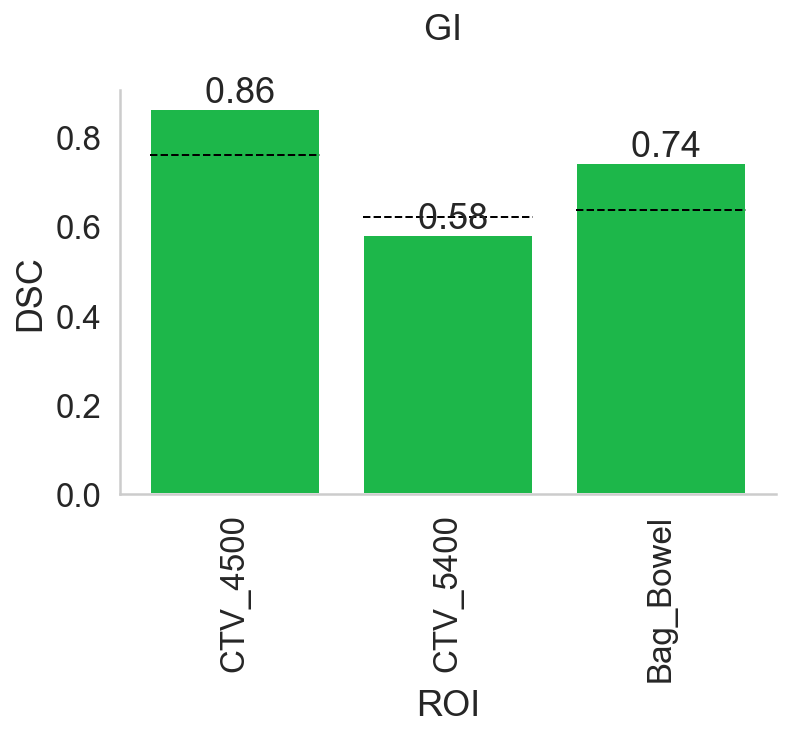

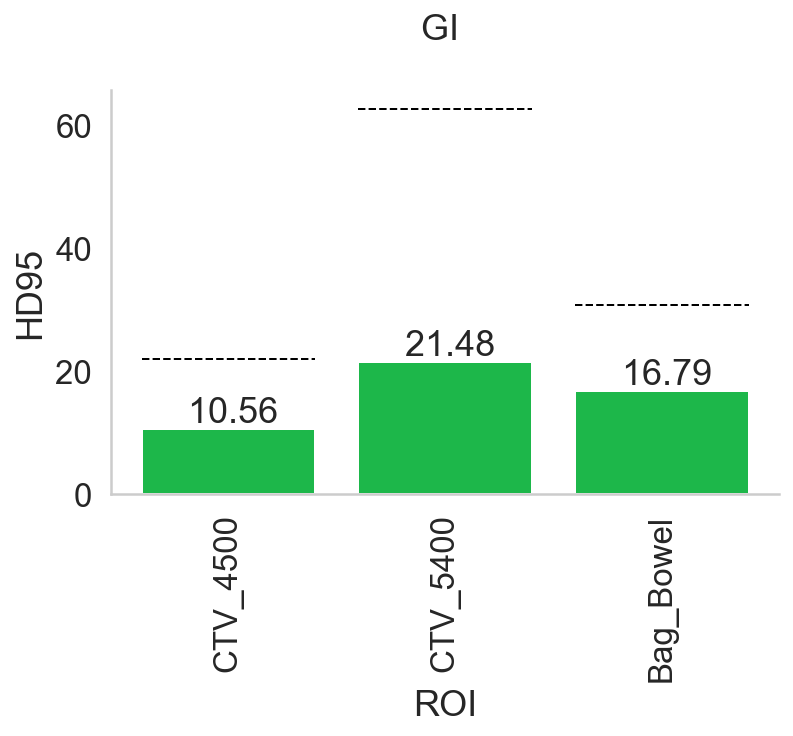

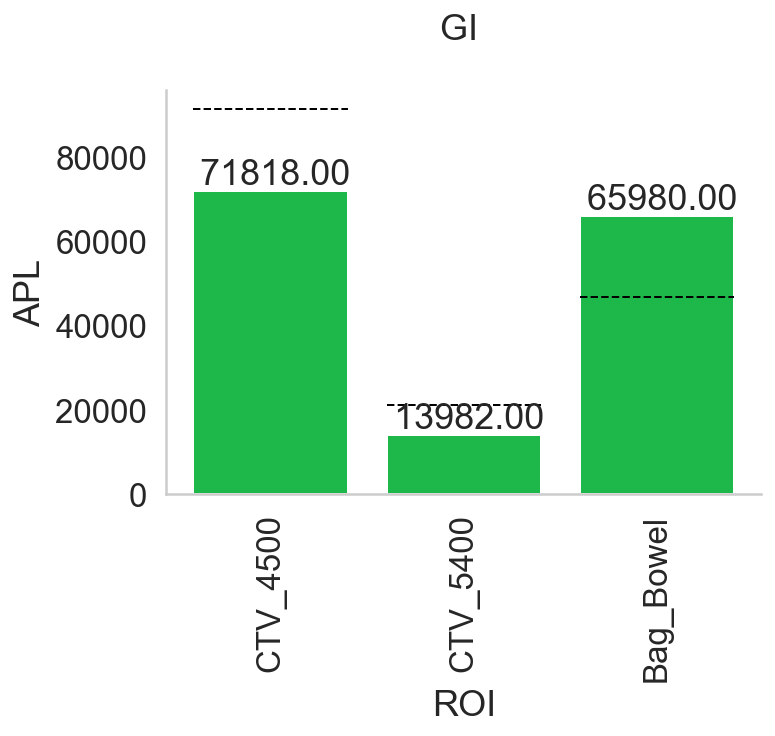

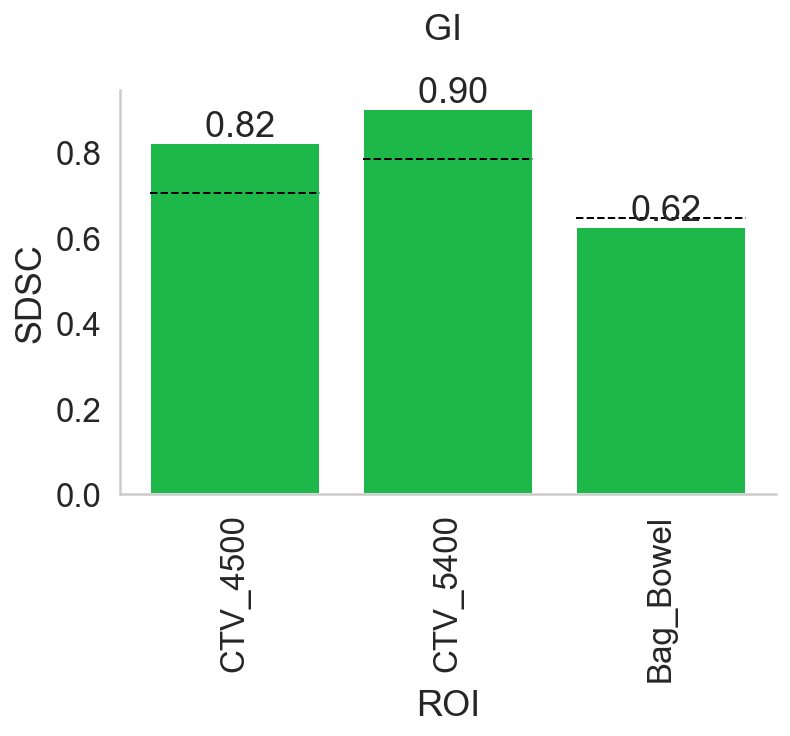

In [300]:
### Make box plots 

metric_list = ['DSC', 'HD95', 'APL', 'SDSC']

for metric, line_dict in zip(metric_list, line_dict_list): # line dict defined before 
    print(metric)
    
    if metric == "DSC" or metric == "SDSC":
        sharey=True
    else:
        sharey=False

    g = sns.catplot(x="ROI", y=metric, hue= "Class", hue_order =["Non-Expert"], sharex = False,
                    sharey=sharey,
                    data=df2, kind="bar", 
                    height=4, aspect=1.5,
                    palette=gi_palette_old,
                    )
    

    for ax in g.axes.ravel(): # https://stackoverflow.com/questions/41127841/how-to-annotate-bars-in-a-seaborn-facetgrid-works-in-factorplot
        for a, ROI in zip(ax.patches, ROI_list):         

            value = float((line_dict[ROI]))

            x_start = a.get_x()
            width = a.get_width()

            ax.plot([x_start, x_start+width], [value, value], '--', c='black', linewidth=1)
    
    plt.xticks(rotation=90)
    plt.title('GI \n')
    g._legend.remove() # remove legend since just showing non-expert
    
    
    axes = g.axes.flatten()
    for ax in axes:
        for container in ax.containers:
            ax.bar_label(container, labels=[f'{x: .2f}' for x in container.datavalues]) # https://stackoverflow.com/questions/70515542/adding-comma-to-bar-labels-in-matplotlib

    # TG-263 names 
    labels = ['CTV_4500', 'CTV_5400', 'Bag_Bowel']
    g.set_xticklabels(labels)

### Bootstrap experiments

In [349]:
%%time

ROI_list = ['ctv_45gy', 'ctv_54gy', 'bowel bag']

bootstrap = 100
#bootstrap = 2 # testing 

path = os.path.join(base_path, "structures_nifti_stratified", "Non-Expert")

expert_STAPLE_path = os.path.join(base_path, "structures_nifti_stratified_STAPLE", "Expert")

df4 = pd.DataFrame(columns=['ROI', 'N', 'DSC_list', 'HD95_list', 'APL_list', 'SDSC_list', 'ID_list'])

counter = -1  # for df 

counter2 = -1 # for random seed 

n_list = [2, 3, 4, 5, 6, 7, 8, 9, 10, 15, 20]
#n_list = [2, 3] # testing 

for ROI in ROI_list:
    #print(ROI)
    expert_file_path = os.path.join(expert_STAPLE_path, ROI+'STAPLE.nii.gz')
    cases = [case for case in os.listdir(path) if ROI+'.nii.gz' in os.listdir(os.path.join(path, case))]
    for n in n_list:
        #print(n)
        DSC_list = []
        subcase_list = []
        for iteration in range(bootstrap):
            
            switch = True 
            
            counter2 +=1 
            
            while switch == True: # horrible practice but don't know what else to do
                
                print("ROI:", ROI, "; total staple:", n, "; boostrap iteration:", iteration, "; random counter:", counter2)
            
                random.seed(counter2)
                np.random.seed(counter2)

                #print(counter2)

                subcases = random.sample(cases, n)
                print(subcases)
                subcase_list.append(subcases)

                file_list = []
                for case in subcases:
                    case_path = os.path.join(path, case)
                    file_path = os.path.join(case_path, ROI+'.nii.gz')
                    file_list.append(file_path)

                segmentations = [sitk.ReadImage(file_name, sitk.sitkUInt8) for file_name in file_list]

                foregroundValue = 1
                threshold = 0.95
                #threshold = 0.90

                if n <= 4: 
                    #print('test')
                    p = multiprocessing.Process(target=sitk.STAPLE, name="Foo", args=(segmentations, foregroundValue,))
                    p.start()
                    p.join(60) # set at 60 sec for now.. 

                    # If thread is active
                    if p.is_alive():
                        print("STAPLE function is taking too long, killing it and getting new random samples")

                        # Terminate function 
                        p.terminate()
                        p.join()
                        counter2 +=1 
                        continue



                #print('test2')
                reference_segmentation_STAPLE_probabilities = sitk.STAPLE(segmentations, foregroundValue) 

                file_1 = reference_segmentation_STAPLE_probabilities > threshold
                file_2 = sitk.ReadImage(expert_file_path)

                mask_1 = sitk.GetArrayFromImage(file_1)
                mask_2 = sitk.GetArrayFromImage(file_2)

                DSC = compute_dice_coefficient(mask_1, mask_2)   
                DSC_list.append(DSC)
                
                # adding other metrics
                
                spacing_mm = file_1.GetSpacing() # need spacing to calcualte distances
                
                mask_1_bool = mask_1.astype(bool) # need to convert to bool format to work 
                mask_2_bool = mask_2.astype(bool)

                surface_distances = compute_surface_distances(mask_1_bool, mask_2_bool, spacing_mm) # need this for all calculations
                HD95 = compute_robust_hausdorff(surface_distances, 95)
                HD95_list.append(HD95)

                APL = AddedPathLength(mask_1, mask_2)
                APL_list.append(APL)
                
                tolerance = np.median(df_pickle[(df_pickle["ROI"] == ROI) & (df_pickle["Class"] == "Expert")]["ASD_list"].values[0]) # get tolerance
                SDSC = compute_surface_dice_at_tolerance(surface_distances, tolerance)
                SDSC_list.append(SDSC)
                
                counter +=1
                df4.loc[counter] = [ROI, n, DSC, HD95, APL, SDSC, subcases]

                switch = False

        print(np.mean(DSC_list))
        print(np.mean(HD95_list))
        print(np.mean(APL_list))
        print(np.mean(SDSC_list))

ROI: ctv_45gy ; total staple: 2 ; boostrap iteration: 0 ; random counter: 0
['RS_0630', 'RS_232']
ROI: ctv_45gy ; total staple: 2 ; boostrap iteration: 1 ; random counter: 1
['RS_0140', 'RS_0964']
ROI: ctv_45gy ; total staple: 2 ; boostrap iteration: 2 ; random counter: 2
['RS_0031', 'RS_0034']
ROI: ctv_45gy ; total staple: 2 ; boostrap iteration: 3 ; random counter: 3
['RS_0199', 'RS_0964']
ROI: ctv_45gy ; total staple: 2 ; boostrap iteration: 4 ; random counter: 4
['RS_0199', 'RS_0292']
ROI: ctv_45gy ; total staple: 2 ; boostrap iteration: 5 ; random counter: 5
['RS_0985', 'RS_0267']
ROI: ctv_45gy ; total staple: 2 ; boostrap iteration: 6 ; random counter: 6
['RS_0964', 'RS_0034']
ROI: ctv_45gy ; total staple: 2 ; boostrap iteration: 7 ; random counter: 7
['RS_0362', 'RS_0140']
ROI: ctv_45gy ; total staple: 2 ; boostrap iteration: 8 ; random counter: 8
['RS_0199', 'RS_0612']
ROI: ctv_45gy ; total staple: 2 ; boostrap iteration: 9 ; random counter: 9
['RS_0716', 'RS_0985']
ROI: ctv_45

ROI: ctv_45gy ; total staple: 2 ; boostrap iteration: 82 ; random counter: 82
['RS_0140', 'RS_232']
ROI: ctv_45gy ; total staple: 2 ; boostrap iteration: 83 ; random counter: 83
['RS_0799', 'RS_0716']
ROI: ctv_45gy ; total staple: 2 ; boostrap iteration: 84 ; random counter: 84
['RS_1098', 'RS_0292']
ROI: ctv_45gy ; total staple: 2 ; boostrap iteration: 85 ; random counter: 85
['RS_0182', 'RS_1081']
ROI: ctv_45gy ; total staple: 2 ; boostrap iteration: 86 ; random counter: 86
['RS_232', 'RS_0018']
ROI: ctv_45gy ; total staple: 2 ; boostrap iteration: 87 ; random counter: 87
['RS_0140', 'RS_1098']
ROI: ctv_45gy ; total staple: 2 ; boostrap iteration: 88 ; random counter: 88
['RS_0630', 'RS_0182']
ROI: ctv_45gy ; total staple: 2 ; boostrap iteration: 89 ; random counter: 89
['RS_0034', 'RS_232']
ROI: ctv_45gy ; total staple: 2 ; boostrap iteration: 90 ; random counter: 90
['RS_0182', 'RS_1081']
ROI: ctv_45gy ; total staple: 2 ; boostrap iteration: 91 ; random counter: 91
['RS_0034', 'RS_

ROI: ctv_45gy ; total staple: 3 ; boostrap iteration: 48 ; random counter: 153
['RS_0799', 'RS_0034', 'RS_0031']
ROI: ctv_45gy ; total staple: 3 ; boostrap iteration: 49 ; random counter: 154
['RS_0182', 'RS_0630', 'RS_0799']
ROI: ctv_45gy ; total staple: 3 ; boostrap iteration: 50 ; random counter: 155
['RS_0964', 'RS_0885', 'RS_0910']
ROI: ctv_45gy ; total staple: 3 ; boostrap iteration: 51 ; random counter: 156
['RS_0799', 'RS_0645', 'RS_1098']
ROI: ctv_45gy ; total staple: 3 ; boostrap iteration: 52 ; random counter: 157
['RS_0985', 'RS_0799', 'RS_0199']
ROI: ctv_45gy ; total staple: 3 ; boostrap iteration: 53 ; random counter: 158
['RS_1073', 'RS_0199', 'RS_0128']
ROI: ctv_45gy ; total staple: 3 ; boostrap iteration: 54 ; random counter: 159
['RS_0630', 'RS_0146', 'RS_1073']
ROI: ctv_45gy ; total staple: 3 ; boostrap iteration: 55 ; random counter: 160
['RS_0128', 'RS_0885', 'RS_0362']
ROI: ctv_45gy ; total staple: 3 ; boostrap iteration: 56 ; random counter: 161
['RS_0885', 'RS_0

ROI: ctv_45gy ; total staple: 4 ; boostrap iteration: 14 ; random counter: 222
['RS_232', 'RS_0128', 'RS_0199', 'RS_0292']
ROI: ctv_45gy ; total staple: 4 ; boostrap iteration: 15 ; random counter: 223
['RS_0362', 'RS_0612', 'RS_0716', 'RS_0182']
ROI: ctv_45gy ; total staple: 4 ; boostrap iteration: 16 ; random counter: 224
['RS_0034', 'RS_0182', 'RS_0716', 'RS_0910']
ROI: ctv_45gy ; total staple: 4 ; boostrap iteration: 17 ; random counter: 225
['RS_1081', 'RS_0199', 'RS_0146', 'RS_1098']
ROI: ctv_45gy ; total staple: 4 ; boostrap iteration: 18 ; random counter: 226
['RS_0799', 'RS_0031', 'RS_1051', 'RS_0910']
ROI: ctv_45gy ; total staple: 4 ; boostrap iteration: 19 ; random counter: 227
['RS_0630', 'RS_1073', 'RS_0612', 'RS_0034']
ROI: ctv_45gy ; total staple: 4 ; boostrap iteration: 20 ; random counter: 228
['RS_232', 'RS_1081', 'RS_1073', 'RS_0199']
ROI: ctv_45gy ; total staple: 4 ; boostrap iteration: 21 ; random counter: 229
['RS_0885', 'RS_0140', 'RS_0199', 'RS_0910']
ROI: ctv_4

ROI: ctv_45gy ; total staple: 4 ; boostrap iteration: 81 ; random counter: 289
['RS_232', 'RS_0267', 'RS_1073', 'RS_0146']
ROI: ctv_45gy ; total staple: 4 ; boostrap iteration: 82 ; random counter: 290
['RS_0910', 'RS_0362', 'RS_0799', 'RS_0964']
ROI: ctv_45gy ; total staple: 4 ; boostrap iteration: 83 ; random counter: 291
['RS_1073', 'RS_0799', 'RS_1098', 'RS_1051']
ROI: ctv_45gy ; total staple: 4 ; boostrap iteration: 84 ; random counter: 292
['RS_232', 'RS_0140', 'RS_0292', 'RS_1073']
ROI: ctv_45gy ; total staple: 4 ; boostrap iteration: 85 ; random counter: 293
['RS_0799', 'RS_0128', 'RS_0199', 'RS_0885']
ROI: ctv_45gy ; total staple: 4 ; boostrap iteration: 86 ; random counter: 294
['RS_0146', 'RS_0031', 'RS_0799', 'RS_0182']
ROI: ctv_45gy ; total staple: 4 ; boostrap iteration: 87 ; random counter: 295
['RS_0292', 'RS_1081', 'RS_0799', 'RS_0362']
ROI: ctv_45gy ; total staple: 4 ; boostrap iteration: 88 ; random counter: 296
['RS_0034', 'RS_0267', 'RS_0612', 'RS_0885']
ROI: ctv_4

ROI: ctv_45gy ; total staple: 5 ; boostrap iteration: 43 ; random counter: 351
['RS_0985', 'RS_0964', 'RS_0612', 'RS_0362', 'RS_1098']
ROI: ctv_45gy ; total staple: 5 ; boostrap iteration: 44 ; random counter: 352
['RS_0292', 'RS_0140', 'RS_1098', 'RS_0034', 'RS_1073']
ROI: ctv_45gy ; total staple: 5 ; boostrap iteration: 45 ; random counter: 353
['RS_0128', 'RS_0034', 'RS_0630', 'RS_1098', 'RS_0985']
ROI: ctv_45gy ; total staple: 5 ; boostrap iteration: 46 ; random counter: 354
['RS_0182', 'RS_0034', 'RS_1073', 'RS_0128', 'RS_232']
ROI: ctv_45gy ; total staple: 5 ; boostrap iteration: 47 ; random counter: 355
['RS_0146', 'RS_0128', 'RS_0985', 'RS_0630', 'RS_0362']
ROI: ctv_45gy ; total staple: 5 ; boostrap iteration: 48 ; random counter: 356
['RS_1051', 'RS_0031', 'RS_0799', 'RS_0267', 'RS_0645']
ROI: ctv_45gy ; total staple: 5 ; boostrap iteration: 49 ; random counter: 357
['RS_0146', 'RS_0612', 'RS_1081', 'RS_0034', 'RS_0199']
ROI: ctv_45gy ; total staple: 5 ; boostrap iteration: 50

ROI: ctv_45gy ; total staple: 6 ; boostrap iteration: 4 ; random counter: 412
['RS_0292', 'RS_1081', 'RS_0031', 'RS_0128', 'RS_0182', 'RS_1073']
ROI: ctv_45gy ; total staple: 6 ; boostrap iteration: 5 ; random counter: 413
['RS_232', 'RS_1051', 'RS_0716', 'RS_0146', 'RS_0034', 'RS_0910']
ROI: ctv_45gy ; total staple: 6 ; boostrap iteration: 6 ; random counter: 414
['RS_0645', 'RS_0612', 'RS_0985', 'RS_0199', 'RS_1081', 'RS_0267']
ROI: ctv_45gy ; total staple: 6 ; boostrap iteration: 7 ; random counter: 415
['RS_232', 'RS_0362', 'RS_0199', 'RS_0267', 'RS_0182', 'RS_1051']
ROI: ctv_45gy ; total staple: 6 ; boostrap iteration: 8 ; random counter: 416
['RS_0267', 'RS_0018', 'RS_0885', 'RS_0964', 'RS_0985', 'RS_1073']
ROI: ctv_45gy ; total staple: 6 ; boostrap iteration: 9 ; random counter: 417
['RS_0985', 'RS_1098', 'RS_0034', 'RS_0031', 'RS_0630', 'RS_0292']
ROI: ctv_45gy ; total staple: 6 ; boostrap iteration: 10 ; random counter: 418
['RS_0362', 'RS_0612', 'RS_0128', 'RS_0292', 'RS_0140

ROI: ctv_45gy ; total staple: 6 ; boostrap iteration: 61 ; random counter: 469
['RS_0267', 'RS_0292', 'RS_1073', 'RS_232', 'RS_0645', 'RS_0630']
ROI: ctv_45gy ; total staple: 6 ; boostrap iteration: 62 ; random counter: 470
['RS_0031', 'RS_1098', 'RS_0612', 'RS_0146', 'RS_0140', 'RS_0885']
ROI: ctv_45gy ; total staple: 6 ; boostrap iteration: 63 ; random counter: 471
['RS_1073', 'RS_0034', 'RS_1051', 'RS_0292', 'RS_0716', 'RS_0362']
ROI: ctv_45gy ; total staple: 6 ; boostrap iteration: 64 ; random counter: 472
['RS_0140', 'RS_0182', 'RS_1051', 'RS_0716', 'RS_0031', 'RS_0146']
ROI: ctv_45gy ; total staple: 6 ; boostrap iteration: 65 ; random counter: 473
['RS_0362', 'RS_232', 'RS_0031', 'RS_0018', 'RS_0612', 'RS_0128']
ROI: ctv_45gy ; total staple: 6 ; boostrap iteration: 66 ; random counter: 474
['RS_0034', 'RS_0031', 'RS_0645', 'RS_0140', 'RS_0292', 'RS_0612']
ROI: ctv_45gy ; total staple: 6 ; boostrap iteration: 67 ; random counter: 475
['RS_0034', 'RS_0018', 'RS_1051', 'RS_0910', 'R

ROI: ctv_45gy ; total staple: 7 ; boostrap iteration: 16 ; random counter: 524
['RS_0199', 'RS_0018', 'RS_0964', 'RS_0267', 'RS_0799', 'RS_0362', 'RS_0034']
ROI: ctv_45gy ; total staple: 7 ; boostrap iteration: 17 ; random counter: 525
['RS_0910', 'RS_0128', 'RS_0799', 'RS_0146', 'RS_1073', 'RS_0985', 'RS_1098']
ROI: ctv_45gy ; total staple: 7 ; boostrap iteration: 18 ; random counter: 526
['RS_0140', 'RS_0182', 'RS_0146', 'RS_0031', 'RS_0292', 'RS_0630', 'RS_0985']
ROI: ctv_45gy ; total staple: 7 ; boostrap iteration: 19 ; random counter: 527
['RS_0645', 'RS_0362', 'RS_1073', 'RS_1081', 'RS_0146', 'RS_1098', 'RS_0199']
ROI: ctv_45gy ; total staple: 7 ; boostrap iteration: 20 ; random counter: 528
['RS_0031', 'RS_0964', 'RS_0292', 'RS_0128', 'RS_0799', 'RS_1051', 'RS_1098']
ROI: ctv_45gy ; total staple: 7 ; boostrap iteration: 21 ; random counter: 529
['RS_1051', 'RS_0140', 'RS_0199', 'RS_1073', 'RS_0716', 'RS_0182', 'RS_0645']
ROI: ctv_45gy ; total staple: 7 ; boostrap iteration: 22 ;

ROI: ctv_45gy ; total staple: 7 ; boostrap iteration: 69 ; random counter: 577
['RS_0630', 'RS_0612', 'RS_1081', 'RS_0034', 'RS_0362', 'RS_0716', 'RS_0645']
ROI: ctv_45gy ; total staple: 7 ; boostrap iteration: 70 ; random counter: 578
['RS_232', 'RS_0292', 'RS_0146', 'RS_1073', 'RS_0964', 'RS_0630', 'RS_0612']
ROI: ctv_45gy ; total staple: 7 ; boostrap iteration: 71 ; random counter: 579
['RS_0362', 'RS_0630', 'RS_0799', 'RS_0140', 'RS_1051', 'RS_232', 'RS_0031']
ROI: ctv_45gy ; total staple: 7 ; boostrap iteration: 72 ; random counter: 580
['RS_0885', 'RS_232', 'RS_0292', 'RS_0034', 'RS_1051', 'RS_1081', 'RS_0140']
ROI: ctv_45gy ; total staple: 7 ; boostrap iteration: 73 ; random counter: 581
['RS_1081', 'RS_0018', 'RS_0146', 'RS_0292', 'RS_1073', 'RS_0630', 'RS_1098']
ROI: ctv_45gy ; total staple: 7 ; boostrap iteration: 74 ; random counter: 582
['RS_0182', 'RS_1081', 'RS_0128', 'RS_0199', 'RS_0716', 'RS_0146', 'RS_0630']
ROI: ctv_45gy ; total staple: 7 ; boostrap iteration: 75 ; ra

ROI: ctv_45gy ; total staple: 8 ; boostrap iteration: 20 ; random counter: 628
['RS_0630', 'RS_0034', 'RS_0910', 'RS_1081', 'RS_0128', 'RS_0716', 'RS_0140', 'RS_0964']
ROI: ctv_45gy ; total staple: 8 ; boostrap iteration: 21 ; random counter: 629
['RS_0031', 'RS_0362', 'RS_0799', 'RS_0964', 'RS_0018', 'RS_0985', 'RS_0292', 'RS_1051']
ROI: ctv_45gy ; total staple: 8 ; boostrap iteration: 22 ; random counter: 630
['RS_0716', 'RS_0140', 'RS_0885', 'RS_0034', 'RS_0985', 'RS_0612', 'RS_0182', 'RS_0267']
ROI: ctv_45gy ; total staple: 8 ; boostrap iteration: 23 ; random counter: 631
['RS_0292', 'RS_0362', 'RS_0182', 'RS_0146', 'RS_0985', 'RS_0140', 'RS_1081', 'RS_0885']
ROI: ctv_45gy ; total staple: 8 ; boostrap iteration: 24 ; random counter: 632
['RS_0612', 'RS_0199', 'RS_0910', 'RS_0031', 'RS_0018', 'RS_0292', 'RS_0034', 'RS_0182']
ROI: ctv_45gy ; total staple: 8 ; boostrap iteration: 25 ; random counter: 633
['RS_0031', 'RS_0612', 'RS_232', 'RS_1098', 'RS_0018', 'RS_0034', 'RS_1051', 'RS_

ROI: ctv_45gy ; total staple: 8 ; boostrap iteration: 69 ; random counter: 677
['RS_1051', 'RS_0034', 'RS_232', 'RS_1098', 'RS_0140', 'RS_0799', 'RS_0964', 'RS_0716']
ROI: ctv_45gy ; total staple: 8 ; boostrap iteration: 70 ; random counter: 678
['RS_0128', 'RS_0362', 'RS_0018', 'RS_1098', 'RS_1081', 'RS_0146', 'RS_0799', 'RS_0031']
ROI: ctv_45gy ; total staple: 8 ; boostrap iteration: 71 ; random counter: 679
['RS_1051', 'RS_0985', 'RS_0910', 'RS_0630', 'RS_0612', 'RS_0034', 'RS_0885', 'RS_0128']
ROI: ctv_45gy ; total staple: 8 ; boostrap iteration: 72 ; random counter: 680
['RS_0985', 'RS_0799', 'RS_0964', 'RS_0140', 'RS_0885', 'RS_0910', 'RS_0612', 'RS_1081']
ROI: ctv_45gy ; total staple: 8 ; boostrap iteration: 73 ; random counter: 681
['RS_0645', 'RS_1081', 'RS_0362', 'RS_0128', 'RS_0716', 'RS_0630', 'RS_0031', 'RS_0799']
ROI: ctv_45gy ; total staple: 8 ; boostrap iteration: 74 ; random counter: 682
['RS_0885', 'RS_0199', 'RS_0182', 'RS_0964', 'RS_0031', 'RS_0630', 'RS_1073', 'RS_

ROI: ctv_45gy ; total staple: 9 ; boostrap iteration: 17 ; random counter: 725
['RS_0034', 'RS_0799', 'RS_0031', 'RS_0018', 'RS_0910', 'RS_1051', 'RS_0362', 'RS_0985', 'RS_0140']
ROI: ctv_45gy ; total staple: 9 ; boostrap iteration: 18 ; random counter: 726
['RS_0267', 'RS_0612', 'RS_0645', 'RS_0034', 'RS_0630', 'RS_0140', 'RS_1073', 'RS_0799', 'RS_0031']
ROI: ctv_45gy ; total staple: 9 ; boostrap iteration: 19 ; random counter: 727
['RS_0885', 'RS_0146', 'RS_232', 'RS_0031', 'RS_0799', 'RS_1098', 'RS_1081', 'RS_0034', 'RS_0292']
ROI: ctv_45gy ; total staple: 9 ; boostrap iteration: 20 ; random counter: 728
['RS_0031', 'RS_0716', 'RS_0985', 'RS_0910', 'RS_1051', 'RS_0128', 'RS_0018', 'RS_0612', 'RS_0362']
ROI: ctv_45gy ; total staple: 9 ; boostrap iteration: 21 ; random counter: 729
['RS_1081', 'RS_0362', 'RS_0292', 'RS_0964', 'RS_0128', 'RS_1073', 'RS_0199', 'RS_0612', 'RS_0146']
ROI: ctv_45gy ; total staple: 9 ; boostrap iteration: 22 ; random counter: 730
['RS_0292', 'RS_0128', 'RS_

ROI: ctv_45gy ; total staple: 9 ; boostrap iteration: 63 ; random counter: 771
['RS_0630', 'RS_0140', 'RS_0146', 'RS_0716', 'RS_232', 'RS_0034', 'RS_0292', 'RS_0964', 'RS_1098']
ROI: ctv_45gy ; total staple: 9 ; boostrap iteration: 64 ; random counter: 772
['RS_0128', 'RS_0910', 'RS_0362', 'RS_1073', 'RS_0031', 'RS_0182', 'RS_0140', 'RS_1081', 'RS_0799']
ROI: ctv_45gy ; total staple: 9 ; boostrap iteration: 65 ; random counter: 773
['RS_0146', 'RS_0799', 'RS_1073', 'RS_0612', 'RS_0362', 'RS_0910', 'RS_1098', 'RS_0716', 'RS_232']
ROI: ctv_45gy ; total staple: 9 ; boostrap iteration: 66 ; random counter: 774
['RS_0292', 'RS_0018', 'RS_0128', 'RS_0964', 'RS_0799', 'RS_0716', 'RS_0146', 'RS_0199', 'RS_0267']
ROI: ctv_45gy ; total staple: 9 ; boostrap iteration: 67 ; random counter: 775
['RS_0799', 'RS_0018', 'RS_0146', 'RS_1051', 'RS_0645', 'RS_1073', 'RS_1098', 'RS_0964', 'RS_0140']
ROI: ctv_45gy ; total staple: 9 ; boostrap iteration: 68 ; random counter: 776
['RS_0716', 'RS_0985', 'RS_1

ROI: ctv_45gy ; total staple: 10 ; boostrap iteration: 8 ; random counter: 816
['RS_0146', 'RS_0985', 'RS_0128', 'RS_0645', 'RS_0799', 'RS_0034', 'RS_0031', 'RS_0292', 'RS_0612', 'RS_0182']
ROI: ctv_45gy ; total staple: 10 ; boostrap iteration: 9 ; random counter: 817
['RS_0140', 'RS_0985', 'RS_0362', 'RS_0612', 'RS_0182', 'RS_0267', 'RS_0964', 'RS_0292', 'RS_1098', 'RS_0716']
ROI: ctv_45gy ; total staple: 10 ; boostrap iteration: 10 ; random counter: 818
['RS_0799', 'RS_0910', 'RS_0362', 'RS_1098', 'RS_232', 'RS_0034', 'RS_1073', 'RS_0716', 'RS_0031', 'RS_0630']
ROI: ctv_45gy ; total staple: 10 ; boostrap iteration: 11 ; random counter: 819
['RS_0612', 'RS_0146', 'RS_0140', 'RS_0292', 'RS_232', 'RS_1081', 'RS_1073', 'RS_0267', 'RS_0362', 'RS_0964']
ROI: ctv_45gy ; total staple: 10 ; boostrap iteration: 12 ; random counter: 820
['RS_0182', 'RS_0362', 'RS_0885', 'RS_0799', 'RS_0128', 'RS_232', 'RS_0199', 'RS_0267', 'RS_0031', 'RS_1051']
ROI: ctv_45gy ; total staple: 10 ; boostrap iterat

ROI: ctv_45gy ; total staple: 10 ; boostrap iteration: 52 ; random counter: 860
['RS_0140', 'RS_232', 'RS_1073', 'RS_0034', 'RS_1081', 'RS_0910', 'RS_0612', 'RS_0885', 'RS_0292', 'RS_0799']
ROI: ctv_45gy ; total staple: 10 ; boostrap iteration: 53 ; random counter: 861
['RS_0716', 'RS_232', 'RS_1073', 'RS_0031', 'RS_0018', 'RS_0140', 'RS_0985', 'RS_1098', 'RS_1081', 'RS_0034']
ROI: ctv_45gy ; total staple: 10 ; boostrap iteration: 54 ; random counter: 862
['RS_0964', 'RS_1098', 'RS_0182', 'RS_1051', 'RS_0885', 'RS_0034', 'RS_0140', 'RS_232', 'RS_1073', 'RS_0985']
ROI: ctv_45gy ; total staple: 10 ; boostrap iteration: 55 ; random counter: 863
['RS_0964', 'RS_0267', 'RS_0910', 'RS_0645', 'RS_1051', 'RS_232', 'RS_0292', 'RS_0034', 'RS_0199', 'RS_0182']
ROI: ctv_45gy ; total staple: 10 ; boostrap iteration: 56 ; random counter: 864
['RS_0292', 'RS_0799', 'RS_0018', 'RS_0612', 'RS_0182', 'RS_0140', 'RS_0034', 'RS_1081', 'RS_0985', 'RS_1073']
ROI: ctv_45gy ; total staple: 10 ; boostrap itera

ROI: ctv_45gy ; total staple: 10 ; boostrap iteration: 95 ; random counter: 903
['RS_0031', 'RS_1073', 'RS_1051', 'RS_0034', 'RS_0292', 'RS_0716', 'RS_0146', 'RS_0910', 'RS_0182', 'RS_0885']
ROI: ctv_45gy ; total staple: 10 ; boostrap iteration: 96 ; random counter: 904
['RS_1081', 'RS_0985', 'RS_0292', 'RS_0885', 'RS_0630', 'RS_1098', 'RS_0031', 'RS_0645', 'RS_0799', 'RS_0964']
ROI: ctv_45gy ; total staple: 10 ; boostrap iteration: 97 ; random counter: 905
['RS_1073', 'RS_0612', 'RS_1098', 'RS_0910', 'RS_0799', 'RS_0985', 'RS_0018', 'RS_0140', 'RS_0630', 'RS_232']
ROI: ctv_45gy ; total staple: 10 ; boostrap iteration: 98 ; random counter: 906
['RS_0018', 'RS_0267', 'RS_0964', 'RS_0612', 'RS_0034', 'RS_1098', 'RS_0292', 'RS_0630', 'RS_0362', 'RS_0799']
ROI: ctv_45gy ; total staple: 10 ; boostrap iteration: 99 ; random counter: 907
['RS_1081', 'RS_0630', 'RS_0031', 'RS_0140', 'RS_0292', 'RS_1051', 'RS_0799', 'RS_0146', 'RS_0910', 'RS_0182']
0.8732417827159726
22.42326955049869
74338.225

ROI: ctv_45gy ; total staple: 15 ; boostrap iteration: 30 ; random counter: 938
['RS_0716', 'RS_0799', 'RS_0612', 'RS_1073', 'RS_0910', 'RS_0146', 'RS_0362', 'RS_0964', 'RS_232', 'RS_0128', 'RS_0031', 'RS_0267', 'RS_0630', 'RS_0034', 'RS_0985']
ROI: ctv_45gy ; total staple: 15 ; boostrap iteration: 31 ; random counter: 939
['RS_0128', 'RS_0140', 'RS_0199', 'RS_1081', 'RS_0362', 'RS_232', 'RS_0018', 'RS_1051', 'RS_0034', 'RS_0267', 'RS_0630', 'RS_0799', 'RS_0910', 'RS_0716', 'RS_0292']
ROI: ctv_45gy ; total staple: 15 ; boostrap iteration: 32 ; random counter: 940
['RS_0612', 'RS_0267', 'RS_0018', 'RS_0128', 'RS_0292', 'RS_0985', 'RS_0964', 'RS_0031', 'RS_0910', 'RS_1073', 'RS_1051', 'RS_0199', 'RS_0885', 'RS_0362', 'RS_1081']
ROI: ctv_45gy ; total staple: 15 ; boostrap iteration: 33 ; random counter: 941
['RS_0612', 'RS_0885', 'RS_0910', 'RS_0630', 'RS_0645', 'RS_0985', 'RS_0362', 'RS_0031', 'RS_0964', 'RS_1098', 'RS_0128', 'RS_0292', 'RS_0199', 'RS_1081', 'RS_0799']
ROI: ctv_45gy ; to

ROI: ctv_45gy ; total staple: 15 ; boostrap iteration: 64 ; random counter: 972
['RS_1098', 'RS_0128', 'RS_0910', 'RS_0645', 'RS_0182', 'RS_0630', 'RS_1073', 'RS_0267', 'RS_0199', 'RS_0362', 'RS_0292', 'RS_1051', 'RS_0031', 'RS_0985', 'RS_0885']
ROI: ctv_45gy ; total staple: 15 ; boostrap iteration: 65 ; random counter: 973
['RS_0140', 'RS_0985', 'RS_0031', 'RS_0645', 'RS_0267', 'RS_1051', 'RS_0964', 'RS_0128', 'RS_0716', 'RS_0885', 'RS_1081', 'RS_0799', 'RS_0146', 'RS_0018', 'RS_0362']
ROI: ctv_45gy ; total staple: 15 ; boostrap iteration: 66 ; random counter: 974
['RS_0362', 'RS_0885', 'RS_0985', 'RS_1081', 'RS_0964', 'RS_0018', 'RS_0630', 'RS_0799', 'RS_1051', 'RS_0199', 'RS_0140', 'RS_0612', 'RS_0146', 'RS_0716', 'RS_0031']
ROI: ctv_45gy ; total staple: 15 ; boostrap iteration: 67 ; random counter: 975
['RS_0799', 'RS_1081', 'RS_1098', 'RS_0031', 'RS_1051', 'RS_0964', 'RS_0910', 'RS_1073', 'RS_0292', 'RS_0034', 'RS_0140', 'RS_0362', 'RS_0267', 'RS_0885', 'RS_0018']
ROI: ctv_45gy ; 

ROI: ctv_45gy ; total staple: 15 ; boostrap iteration: 98 ; random counter: 1006
['RS_0612', 'RS_0031', 'RS_0199', 'RS_0716', 'RS_0018', 'RS_0182', 'RS_0964', 'RS_0362', 'RS_1051', 'RS_0985', 'RS_1073', 'RS_0267', 'RS_0630', 'RS_0140', 'RS_0910']
ROI: ctv_45gy ; total staple: 15 ; boostrap iteration: 99 ; random counter: 1007
['RS_0031', 'RS_0985', 'RS_0146', 'RS_0292', 'RS_1081', 'RS_0199', 'RS_0885', 'RS_232', 'RS_0182', 'RS_0910', 'RS_1098', 'RS_1073', 'RS_0140', 'RS_0612', 'RS_0645']
0.8736931890968053
21.414343037852973
73893.94014365523
0.7652389956422412
ROI: ctv_45gy ; total staple: 20 ; boostrap iteration: 0 ; random counter: 1008
['RS_0885', 'RS_0716', 'RS_0362', 'RS_0034', 'RS_0128', 'RS_0031', 'RS_0140', 'RS_1051', 'RS_0612', 'RS_0018', 'RS_0267', 'RS_0630', 'RS_0146', 'RS_0964', 'RS_0910', 'RS_0199', 'RS_1073', 'RS_0799', 'RS_0985', 'RS_0182']
ROI: ctv_45gy ; total staple: 20 ; boostrap iteration: 1 ; random counter: 1009
['RS_0146', 'RS_0018', 'RS_0799', 'RS_0034', 'RS_08

ROI: ctv_45gy ; total staple: 20 ; boostrap iteration: 26 ; random counter: 1034
['RS_0031', 'RS_1051', 'RS_0034', 'RS_1081', 'RS_0128', 'RS_0630', 'RS_1073', 'RS_0199', 'RS_0985', 'RS_0910', 'RS_0964', 'RS_0146', 'RS_0645', 'RS_0018', 'RS_0716', 'RS_0612', 'RS_0140', 'RS_0799', 'RS_0885', 'RS_232']
ROI: ctv_45gy ; total staple: 20 ; boostrap iteration: 27 ; random counter: 1035
['RS_232', 'RS_1051', 'RS_0716', 'RS_0140', 'RS_0267', 'RS_0146', 'RS_0034', 'RS_0031', 'RS_0630', 'RS_0018', 'RS_1098', 'RS_0612', 'RS_0128', 'RS_1073', 'RS_0885', 'RS_0799', 'RS_0985', 'RS_0182', 'RS_0964', 'RS_0645']
ROI: ctv_45gy ; total staple: 20 ; boostrap iteration: 28 ; random counter: 1036
['RS_0645', 'RS_1081', 'RS_1073', 'RS_0034', 'RS_1098', 'RS_0031', 'RS_1051', 'RS_0612', 'RS_0716', 'RS_0140', 'RS_0018', 'RS_0146', 'RS_232', 'RS_0292', 'RS_0985', 'RS_0910', 'RS_0267', 'RS_0799', 'RS_0182', 'RS_0128']
ROI: ctv_45gy ; total staple: 20 ; boostrap iteration: 29 ; random counter: 1037
['RS_0034', 'RS_

ROI: ctv_45gy ; total staple: 20 ; boostrap iteration: 54 ; random counter: 1062
['RS_0128', 'RS_0199', 'RS_0612', 'RS_0885', 'RS_0034', 'RS_0031', 'RS_0910', 'RS_0716', 'RS_1051', 'RS_0985', 'RS_0645', 'RS_0267', 'RS_0799', 'RS_0630', 'RS_0182', 'RS_0146', 'RS_0964', 'RS_0292', 'RS_232', 'RS_0140']
ROI: ctv_45gy ; total staple: 20 ; boostrap iteration: 55 ; random counter: 1063
['RS_0182', 'RS_0140', 'RS_0910', 'RS_0630', 'RS_1081', 'RS_0985', 'RS_0964', 'RS_0199', 'RS_0612', 'RS_1073', 'RS_0146', 'RS_0362', 'RS_0292', 'RS_0885', 'RS_232', 'RS_0716', 'RS_0031', 'RS_0018', 'RS_1051', 'RS_0267']
ROI: ctv_45gy ; total staple: 20 ; boostrap iteration: 56 ; random counter: 1064
['RS_0199', 'RS_0985', 'RS_0031', 'RS_0612', 'RS_0910', 'RS_0182', 'RS_0799', 'RS_0034', 'RS_0140', 'RS_0885', 'RS_1081', 'RS_1073', 'RS_0964', 'RS_0146', 'RS_232', 'RS_0645', 'RS_1051', 'RS_1098', 'RS_0292', 'RS_0018']
ROI: ctv_45gy ; total staple: 20 ; boostrap iteration: 57 ; random counter: 1065
['RS_1081', 'RS_

ROI: ctv_45gy ; total staple: 20 ; boostrap iteration: 82 ; random counter: 1090
['RS_0716', 'RS_0140', 'RS_0630', 'RS_0612', 'RS_0199', 'RS_0034', 'RS_0985', 'RS_0799', 'RS_0031', 'RS_1073', 'RS_1098', 'RS_0362', 'RS_232', 'RS_0910', 'RS_0292', 'RS_0885', 'RS_1051', 'RS_0146', 'RS_0267', 'RS_0645']
ROI: ctv_45gy ; total staple: 20 ; boostrap iteration: 83 ; random counter: 1091
['RS_0612', 'RS_0031', 'RS_1073', 'RS_0267', 'RS_1098', 'RS_232', 'RS_0964', 'RS_0182', 'RS_0199', 'RS_0362', 'RS_1081', 'RS_0716', 'RS_0645', 'RS_0799', 'RS_0140', 'RS_1051', 'RS_0885', 'RS_0985', 'RS_0292', 'RS_0018']
ROI: ctv_45gy ; total staple: 20 ; boostrap iteration: 84 ; random counter: 1092
['RS_0985', 'RS_0885', 'RS_0799', 'RS_0267', 'RS_0199', 'RS_0140', 'RS_1073', 'RS_0292', 'RS_0034', 'RS_0645', 'RS_0716', 'RS_1081', 'RS_0018', 'RS_232', 'RS_0182', 'RS_1098', 'RS_0964', 'RS_0630', 'RS_1051', 'RS_0031']
ROI: ctv_45gy ; total staple: 20 ; boostrap iteration: 85 ; random counter: 1093
['RS_0362', 'RS_

ROI: ctv_54gy ; total staple: 2 ; boostrap iteration: 27 ; random counter: 1135
['RS_0964', 'RS_0716']
ROI: ctv_54gy ; total staple: 2 ; boostrap iteration: 28 ; random counter: 1136
['RS_0031', 'RS_0292']
ROI: ctv_54gy ; total staple: 2 ; boostrap iteration: 29 ; random counter: 1137
['RS_0630', 'RS_1051']
ROI: ctv_54gy ; total staple: 2 ; boostrap iteration: 30 ; random counter: 1138
['RS_0292', 'RS_0964']
ROI: ctv_54gy ; total staple: 2 ; boostrap iteration: 31 ; random counter: 1139
['RS_0128', 'RS_0885']
ROI: ctv_54gy ; total staple: 2 ; boostrap iteration: 32 ; random counter: 1140
['RS_0612', 'RS_0140']
ROI: ctv_54gy ; total staple: 2 ; boostrap iteration: 33 ; random counter: 1141
['RS_0630', 'RS_0140']
ROI: ctv_54gy ; total staple: 2 ; boostrap iteration: 34 ; random counter: 1142
['RS_0034', 'RS_0182']
ROI: ctv_54gy ; total staple: 2 ; boostrap iteration: 35 ; random counter: 1143
['RS_1098', 'RS_1081']
ROI: ctv_54gy ; total staple: 2 ; boostrap iteration: 36 ; random counter

ROI: ctv_54gy ; total staple: 3 ; boostrap iteration: 6 ; random counter: 1214
['RS_0267', 'RS_1081', 'RS_0128']
ROI: ctv_54gy ; total staple: 3 ; boostrap iteration: 7 ; random counter: 1215
['RS_0716', 'RS_1098', 'RS_0910']
ROI: ctv_54gy ; total staple: 3 ; boostrap iteration: 8 ; random counter: 1216
['RS_0964', 'RS_0128', 'RS_0031']
ROI: ctv_54gy ; total staple: 3 ; boostrap iteration: 9 ; random counter: 1217
['RS_0031', 'RS_0910', 'RS_0146']
STAPLE function is taking too long, killing it and getting new random samples
ROI: ctv_54gy ; total staple: 3 ; boostrap iteration: 9 ; random counter: 1218
['RS_0964', 'RS_0140', 'RS_0128']
ROI: ctv_54gy ; total staple: 3 ; boostrap iteration: 10 ; random counter: 1219
['RS_0910', 'RS_0630', 'RS_0182']
ROI: ctv_54gy ; total staple: 3 ; boostrap iteration: 11 ; random counter: 1220
['RS_0267', 'RS_1081', 'RS_0292']
ROI: ctv_54gy ; total staple: 3 ; boostrap iteration: 12 ; random counter: 1221
['RS_0031', 'RS_0645', 'RS_0267']
STAPLE function

ROI: ctv_54gy ; total staple: 3 ; boostrap iteration: 57 ; random counter: 1278
['RS_0031', 'RS_1081', 'RS_0128']
ROI: ctv_54gy ; total staple: 3 ; boostrap iteration: 58 ; random counter: 1279
['RS_0885', 'RS_1073', 'RS_0612']
ROI: ctv_54gy ; total staple: 3 ; boostrap iteration: 59 ; random counter: 1280
['RS_0612', 'RS_0362', 'RS_0716']
STAPLE function is taking too long, killing it and getting new random samples
ROI: ctv_54gy ; total staple: 3 ; boostrap iteration: 59 ; random counter: 1281
['RS_0199', 'RS_0146', 'RS_1098']
STAPLE function is taking too long, killing it and getting new random samples
ROI: ctv_54gy ; total staple: 3 ; boostrap iteration: 59 ; random counter: 1282
['RS_0031', 'RS_0140', 'RS_0182']
STAPLE function is taking too long, killing it and getting new random samples
ROI: ctv_54gy ; total staple: 3 ; boostrap iteration: 59 ; random counter: 1283
['RS_0362', 'RS_0018', 'RS_0630']
ROI: ctv_54gy ; total staple: 3 ; boostrap iteration: 60 ; random counter: 1284
['

ROI: ctv_54gy ; total staple: 4 ; boostrap iteration: 8 ; random counter: 1341
['RS_0716', 'RS_0612', 'RS_1051', 'RS_0292']
ROI: ctv_54gy ; total staple: 4 ; boostrap iteration: 9 ; random counter: 1342
['RS_0034', 'RS_0612', 'RS_0910', 'RS_0645']
ROI: ctv_54gy ; total staple: 4 ; boostrap iteration: 10 ; random counter: 1343
['RS_0362', 'RS_0612', 'RS_0182', 'RS_0199']
ROI: ctv_54gy ; total staple: 4 ; boostrap iteration: 11 ; random counter: 1344
['RS_0645', 'RS_0885', 'RS_0630', 'RS_0199']
ROI: ctv_54gy ; total staple: 4 ; boostrap iteration: 12 ; random counter: 1345
['RS_0128', 'RS_1081', 'RS_0716', 'RS_0910']
ROI: ctv_54gy ; total staple: 4 ; boostrap iteration: 13 ; random counter: 1346
['RS_0292', 'RS_232', 'RS_1098', 'RS_0140']
ROI: ctv_54gy ; total staple: 4 ; boostrap iteration: 14 ; random counter: 1347
['RS_0885', 'RS_0964', 'RS_0199', 'RS_0031']
ROI: ctv_54gy ; total staple: 4 ; boostrap iteration: 15 ; random counter: 1348
['RS_0630', 'RS_0140', 'RS_0182', 'RS_0716']
ROI

ROI: ctv_54gy ; total staple: 4 ; boostrap iteration: 73 ; random counter: 1407
['RS_0034', 'RS_232', 'RS_0716', 'RS_0128']
ROI: ctv_54gy ; total staple: 4 ; boostrap iteration: 74 ; random counter: 1408
['RS_0885', 'RS_0267', 'RS_0128', 'RS_0362']
ROI: ctv_54gy ; total staple: 4 ; boostrap iteration: 75 ; random counter: 1409
['RS_0031', 'RS_0910', 'RS_1098', 'RS_0964']
ROI: ctv_54gy ; total staple: 4 ; boostrap iteration: 76 ; random counter: 1410
['RS_0292', 'RS_0612', 'RS_0630', 'RS_0964']
ROI: ctv_54gy ; total staple: 4 ; boostrap iteration: 77 ; random counter: 1411
['RS_0128', 'RS_1081', 'RS_0018', 'RS_0716']
ROI: ctv_54gy ; total staple: 4 ; boostrap iteration: 78 ; random counter: 1412
['RS_0885', 'RS_0018', 'RS_1081', 'RS_0292']
ROI: ctv_54gy ; total staple: 4 ; boostrap iteration: 79 ; random counter: 1413
['RS_0716', 'RS_0885', 'RS_0128', 'RS_1081']
ROI: ctv_54gy ; total staple: 4 ; boostrap iteration: 80 ; random counter: 1414
['RS_0140', 'RS_1098', 'RS_0182', 'RS_0034']
R

ROI: ctv_54gy ; total staple: 5 ; boostrap iteration: 34 ; random counter: 1469
['RS_0031', 'RS_0146', 'RS_0885', 'RS_0267', 'RS_0128']
ROI: ctv_54gy ; total staple: 5 ; boostrap iteration: 35 ; random counter: 1470
['RS_1081', 'RS_0630', 'RS_0140', 'RS_232', 'RS_1098']
ROI: ctv_54gy ; total staple: 5 ; boostrap iteration: 36 ; random counter: 1471
['RS_0140', 'RS_0199', 'RS_0362', 'RS_0128', 'RS_0031']
ROI: ctv_54gy ; total staple: 5 ; boostrap iteration: 37 ; random counter: 1472
['RS_0199', 'RS_0128', 'RS_1051', 'RS_232', 'RS_0910']
ROI: ctv_54gy ; total staple: 5 ; boostrap iteration: 38 ; random counter: 1473
['RS_0128', 'RS_1081', 'RS_232', 'RS_0964', 'RS_0034']
ROI: ctv_54gy ; total staple: 5 ; boostrap iteration: 39 ; random counter: 1474
['RS_0031', 'RS_0716', 'RS_0910', 'RS_0645', 'RS_0292']
ROI: ctv_54gy ; total staple: 5 ; boostrap iteration: 40 ; random counter: 1475
['RS_0128', 'RS_1073', 'RS_0146', 'RS_0630', 'RS_1051']
ROI: ctv_54gy ; total staple: 5 ; boostrap iteratio

ROI: ctv_54gy ; total staple: 5 ; boostrap iteration: 95 ; random counter: 1530
['RS_0031', 'RS_0716', 'RS_0267', 'RS_0128', 'RS_0362']
ROI: ctv_54gy ; total staple: 5 ; boostrap iteration: 96 ; random counter: 1531
['RS_232', 'RS_0031', 'RS_0182', 'RS_0716', 'RS_1081']
ROI: ctv_54gy ; total staple: 5 ; boostrap iteration: 97 ; random counter: 1532
['RS_0146', 'RS_0292', 'RS_0964', 'RS_0034', 'RS_1081']
ROI: ctv_54gy ; total staple: 5 ; boostrap iteration: 98 ; random counter: 1533
['RS_1073', 'RS_232', 'RS_0182', 'RS_0140', 'RS_0128']
ROI: ctv_54gy ; total staple: 5 ; boostrap iteration: 99 ; random counter: 1534
['RS_0612', 'RS_1073', 'RS_0140', 'RS_0630', 'RS_1051']
0.7471751488927663
19.30750859356524
59845.274386765544
0.8089410184387763
ROI: ctv_54gy ; total staple: 6 ; boostrap iteration: 0 ; random counter: 1535
['RS_0292', 'RS_0964', 'RS_0031', 'RS_0199', 'RS_0146', 'RS_0612']
ROI: ctv_54gy ; total staple: 6 ; boostrap iteration: 1 ; random counter: 1536
['RS_0128', 'RS_0612',

ROI: ctv_54gy ; total staple: 6 ; boostrap iteration: 51 ; random counter: 1586
['RS_0612', 'RS_0140', 'RS_0034', 'RS_232', 'RS_0630', 'RS_1098']
ROI: ctv_54gy ; total staple: 6 ; boostrap iteration: 52 ; random counter: 1587
['RS_0034', 'RS_0146', 'RS_1051', 'RS_0031', 'RS_1098', 'RS_232']
ROI: ctv_54gy ; total staple: 6 ; boostrap iteration: 53 ; random counter: 1588
['RS_1073', 'RS_0140', 'RS_0034', 'RS_0199', 'RS_0267', 'RS_232']
ROI: ctv_54gy ; total staple: 6 ; boostrap iteration: 54 ; random counter: 1589
['RS_0031', 'RS_1073', 'RS_0146', 'RS_0716', 'RS_0362', 'RS_0128']
ROI: ctv_54gy ; total staple: 6 ; boostrap iteration: 55 ; random counter: 1590
['RS_0031', 'RS_0612', 'RS_0630', 'RS_0267', 'RS_0018', 'RS_0128']
ROI: ctv_54gy ; total staple: 6 ; boostrap iteration: 56 ; random counter: 1591
['RS_0964', 'RS_0146', 'RS_0140', 'RS_0716', 'RS_232', 'RS_0031']
ROI: ctv_54gy ; total staple: 6 ; boostrap iteration: 57 ; random counter: 1592
['RS_0612', 'RS_0182', 'RS_0199', 'RS_0018

ROI: ctv_54gy ; total staple: 7 ; boostrap iteration: 6 ; random counter: 1641
['RS_0612', 'RS_0630', 'RS_0716', 'RS_0018', 'RS_1081', 'RS_1051', 'RS_0910']
ROI: ctv_54gy ; total staple: 7 ; boostrap iteration: 7 ; random counter: 1642
['RS_0630', 'RS_0199', 'RS_0140', 'RS_0645', 'RS_0031', 'RS_0885', 'RS_0964']
ROI: ctv_54gy ; total staple: 7 ; boostrap iteration: 8 ; random counter: 1643
['RS_0362', 'RS_0716', 'RS_0031', 'RS_0034', 'RS_1051', 'RS_0630', 'RS_1081']
ROI: ctv_54gy ; total staple: 7 ; boostrap iteration: 9 ; random counter: 1644
['RS_0716', 'RS_1081', 'RS_0018', 'RS_0031', 'RS_1098', 'RS_1051', 'RS_0182']
ROI: ctv_54gy ; total staple: 7 ; boostrap iteration: 10 ; random counter: 1645
['RS_232', 'RS_0267', 'RS_0910', 'RS_0362', 'RS_0292', 'RS_0645', 'RS_1081']
ROI: ctv_54gy ; total staple: 7 ; boostrap iteration: 11 ; random counter: 1646
['RS_0645', 'RS_0292', 'RS_0716', 'RS_0885', 'RS_0267', 'RS_0140', 'RS_0612']
ROI: ctv_54gy ; total staple: 7 ; boostrap iteration: 12 

ROI: ctv_54gy ; total staple: 7 ; boostrap iteration: 59 ; random counter: 1694
['RS_1081', 'RS_0031', 'RS_0140', 'RS_0182', 'RS_0612', 'RS_0146', 'RS_0128']
ROI: ctv_54gy ; total staple: 7 ; boostrap iteration: 60 ; random counter: 1695
['RS_0034', 'RS_1073', 'RS_0885', 'RS_1098', 'RS_232', 'RS_0031', 'RS_0964']
ROI: ctv_54gy ; total staple: 7 ; boostrap iteration: 61 ; random counter: 1696
['RS_0018', 'RS_1098', 'RS_0182', 'RS_0630', 'RS_1081', 'RS_232', 'RS_0199']
ROI: ctv_54gy ; total staple: 7 ; boostrap iteration: 62 ; random counter: 1697
['RS_232', 'RS_0612', 'RS_0885', 'RS_0031', 'RS_0964', 'RS_0182', 'RS_0034']
ROI: ctv_54gy ; total staple: 7 ; boostrap iteration: 63 ; random counter: 1698
['RS_0645', 'RS_0146', 'RS_0182', 'RS_0034', 'RS_232', 'RS_0128', 'RS_0267']
ROI: ctv_54gy ; total staple: 7 ; boostrap iteration: 64 ; random counter: 1699
['RS_0292', 'RS_0630', 'RS_0199', 'RS_0645', 'RS_0267', 'RS_0128', 'RS_1098']
ROI: ctv_54gy ; total staple: 7 ; boostrap iteration: 65

ROI: ctv_54gy ; total staple: 8 ; boostrap iteration: 10 ; random counter: 1745
['RS_0292', 'RS_0612', 'RS_232', 'RS_0199', 'RS_0964', 'RS_0645', 'RS_1051', 'RS_0630']
ROI: ctv_54gy ; total staple: 8 ; boostrap iteration: 11 ; random counter: 1746
['RS_0199', 'RS_0182', 'RS_0630', 'RS_1098', 'RS_1081', 'RS_232', 'RS_0964', 'RS_0910']
ROI: ctv_54gy ; total staple: 8 ; boostrap iteration: 12 ; random counter: 1747
['RS_0716', 'RS_0612', 'RS_0885', 'RS_0140', 'RS_1098', 'RS_1073', 'RS_0182', 'RS_0292']
ROI: ctv_54gy ; total staple: 8 ; boostrap iteration: 13 ; random counter: 1748
['RS_1051', 'RS_0630', 'RS_0885', 'RS_0128', 'RS_1073', 'RS_0199', 'RS_0034', 'RS_0292']
ROI: ctv_54gy ; total staple: 8 ; boostrap iteration: 14 ; random counter: 1749
['RS_0199', 'RS_0910', 'RS_0645', 'RS_0630', 'RS_0031', 'RS_0267', 'RS_0362', 'RS_0964']
ROI: ctv_54gy ; total staple: 8 ; boostrap iteration: 15 ; random counter: 1750
['RS_0612', 'RS_0292', 'RS_0031', 'RS_0267', 'RS_0964', 'RS_0182', 'RS_0910',

ROI: ctv_54gy ; total staple: 8 ; boostrap iteration: 59 ; random counter: 1794
['RS_0362', 'RS_0630', 'RS_0199', 'RS_0031', 'RS_0267', 'RS_0885', 'RS_0018', 'RS_1051']
ROI: ctv_54gy ; total staple: 8 ; boostrap iteration: 60 ; random counter: 1795
['RS_0128', 'RS_232', 'RS_0034', 'RS_0716', 'RS_1081', 'RS_0140', 'RS_0146', 'RS_0199']
ROI: ctv_54gy ; total staple: 8 ; boostrap iteration: 61 ; random counter: 1796
['RS_0885', 'RS_0018', 'RS_0716', 'RS_232', 'RS_0128', 'RS_0267', 'RS_0182', 'RS_0362']
ROI: ctv_54gy ; total staple: 8 ; boostrap iteration: 62 ; random counter: 1797
['RS_0292', 'RS_0362', 'RS_0034', 'RS_0146', 'RS_0018', 'RS_0630', 'RS_0140', 'RS_0182']
ROI: ctv_54gy ; total staple: 8 ; boostrap iteration: 63 ; random counter: 1798
['RS_0885', 'RS_1073', 'RS_0018', 'RS_0034', 'RS_0140', 'RS_0292', 'RS_1098', 'RS_0716']
ROI: ctv_54gy ; total staple: 8 ; boostrap iteration: 64 ; random counter: 1799
['RS_0199', 'RS_0140', 'RS_0018', 'RS_0362', 'RS_0885', 'RS_1098', 'RS_0612',

ROI: ctv_54gy ; total staple: 9 ; boostrap iteration: 7 ; random counter: 1842
['RS_0146', 'RS_0140', 'RS_0910', 'RS_1098', 'RS_0885', 'RS_0645', 'RS_0031', 'RS_0362', 'RS_0716']
ROI: ctv_54gy ; total staple: 9 ; boostrap iteration: 8 ; random counter: 1843
['RS_0630', 'RS_0199', 'RS_0182', 'RS_1073', 'RS_0964', 'RS_0267', 'RS_0292', 'RS_0128', 'RS_0140']
ROI: ctv_54gy ; total staple: 9 ; boostrap iteration: 9 ; random counter: 1844
['RS_0910', 'RS_0128', 'RS_0630', 'RS_1081', 'RS_0885', 'RS_0964', 'RS_0716', 'RS_0146', 'RS_0182']
ROI: ctv_54gy ; total staple: 9 ; boostrap iteration: 10 ; random counter: 1845
['RS_0034', 'RS_1051', 'RS_0630', 'RS_1081', 'RS_0182', 'RS_1098', 'RS_232', 'RS_0362', 'RS_0716']
ROI: ctv_54gy ; total staple: 9 ; boostrap iteration: 11 ; random counter: 1846
['RS_0885', 'RS_0645', 'RS_1098', 'RS_0910', 'RS_0612', 'RS_0140', 'RS_1081', 'RS_0128', 'RS_0267']
ROI: ctv_54gy ; total staple: 9 ; boostrap iteration: 12 ; random counter: 1847
['RS_0031', 'RS_0885', '

ROI: ctv_54gy ; total staple: 9 ; boostrap iteration: 53 ; random counter: 1888
['RS_1073', 'RS_0885', 'RS_0018', 'RS_0146', 'RS_0612', 'RS_0199', 'RS_0140', 'RS_0645', 'RS_0128']
ROI: ctv_54gy ; total staple: 9 ; boostrap iteration: 54 ; random counter: 1889
['RS_0292', 'RS_1051', 'RS_0182', 'RS_0018', 'RS_0964', 'RS_0034', 'RS_0645', 'RS_0362', 'RS_1073']
ROI: ctv_54gy ; total staple: 9 ; boostrap iteration: 55 ; random counter: 1890
['RS_0630', 'RS_0910', 'RS_0146', 'RS_0362', 'RS_0199', 'RS_0267', 'RS_0128', 'RS_0716', 'RS_0182']
ROI: ctv_54gy ; total staple: 9 ; boostrap iteration: 56 ; random counter: 1891
['RS_232', 'RS_0018', 'RS_1098', 'RS_1073', 'RS_0140', 'RS_0910', 'RS_0885', 'RS_0292', 'RS_0716']
ROI: ctv_54gy ; total staple: 9 ; boostrap iteration: 57 ; random counter: 1892
['RS_1081', 'RS_0292', 'RS_0034', 'RS_0645', 'RS_0885', 'RS_0267', 'RS_1051', 'RS_0031', 'RS_0630']
ROI: ctv_54gy ; total staple: 9 ; boostrap iteration: 58 ; random counter: 1893
['RS_0630', 'RS_0964'

ROI: ctv_54gy ; total staple: 9 ; boostrap iteration: 99 ; random counter: 1934
['RS_0267', 'RS_0140', 'RS_0645', 'RS_0031', 'RS_232', 'RS_0612', 'RS_1073', 'RS_0199', 'RS_0182']
0.6850397175499267
18.496799656271094
50995.89921040409
0.836058690798736
ROI: ctv_54gy ; total staple: 10 ; boostrap iteration: 0 ; random counter: 1935
['RS_0140', 'RS_1081', 'RS_0910', 'RS_0018', 'RS_0362', 'RS_0630', 'RS_0964', 'RS_0182', 'RS_1098', 'RS_1051']
ROI: ctv_54gy ; total staple: 10 ; boostrap iteration: 1 ; random counter: 1936
['RS_0612', 'RS_0910', 'RS_0964', 'RS_1081', 'RS_0199', 'RS_232', 'RS_0018', 'RS_0034', 'RS_1073', 'RS_0031']
ROI: ctv_54gy ; total staple: 10 ; boostrap iteration: 2 ; random counter: 1937
['RS_1051', 'RS_0140', 'RS_1081', 'RS_0645', 'RS_0964', 'RS_0630', 'RS_0128', 'RS_0031', 'RS_0146', 'RS_0199']
ROI: ctv_54gy ; total staple: 10 ; boostrap iteration: 3 ; random counter: 1938
['RS_0910', 'RS_1081', 'RS_1098', 'RS_0292', 'RS_1051', 'RS_0034', 'RS_0267', 'RS_0645', 'RS_01

ROI: ctv_54gy ; total staple: 10 ; boostrap iteration: 42 ; random counter: 1977
['RS_0716', 'RS_0199', 'RS_0964', 'RS_232', 'RS_1051', 'RS_0885', 'RS_0140', 'RS_0267', 'RS_1073', 'RS_0362']
ROI: ctv_54gy ; total staple: 10 ; boostrap iteration: 43 ; random counter: 1978
['RS_0034', 'RS_0630', 'RS_0292', 'RS_0018', 'RS_0612', 'RS_0199', 'RS_0645', 'RS_0031', 'RS_0146', 'RS_0267']
ROI: ctv_54gy ; total staple: 10 ; boostrap iteration: 44 ; random counter: 1979
['RS_0034', 'RS_0910', 'RS_0140', 'RS_0018', 'RS_232', 'RS_0612', 'RS_0031', 'RS_1098', 'RS_1081', 'RS_0128']
ROI: ctv_54gy ; total staple: 10 ; boostrap iteration: 45 ; random counter: 1980
['RS_0018', 'RS_0630', 'RS_0910', 'RS_0645', 'RS_0034', 'RS_0140', 'RS_1073', 'RS_0128', 'RS_0267', 'RS_0716']
ROI: ctv_54gy ; total staple: 10 ; boostrap iteration: 46 ; random counter: 1981
['RS_0146', 'RS_0128', 'RS_0964', 'RS_0140', 'RS_1073', 'RS_0612', 'RS_1051', 'RS_0292', 'RS_0645', 'RS_0182']
ROI: ctv_54gy ; total staple: 10 ; boostra

ROI: ctv_54gy ; total staple: 10 ; boostrap iteration: 85 ; random counter: 2020
['RS_1073', 'RS_232', 'RS_0146', 'RS_0716', 'RS_1098', 'RS_0885', 'RS_0612', 'RS_0645', 'RS_0267', 'RS_0034']
ROI: ctv_54gy ; total staple: 10 ; boostrap iteration: 86 ; random counter: 2021
['RS_0630', 'RS_1081', 'RS_0964', 'RS_0267', 'RS_0199', 'RS_0031', 'RS_0716', 'RS_0885', 'RS_0292', 'RS_1098']
ROI: ctv_54gy ; total staple: 10 ; boostrap iteration: 87 ; random counter: 2022
['RS_0964', 'RS_0292', 'RS_0716', 'RS_232', 'RS_1098', 'RS_0031', 'RS_0910', 'RS_0645', 'RS_0362', 'RS_1081']
ROI: ctv_54gy ; total staple: 10 ; boostrap iteration: 88 ; random counter: 2023
['RS_0630', 'RS_0716', 'RS_232', 'RS_0362', 'RS_1051', 'RS_1073', 'RS_0128', 'RS_0910', 'RS_0964', 'RS_0140']
ROI: ctv_54gy ; total staple: 10 ; boostrap iteration: 89 ; random counter: 2024
['RS_0885', 'RS_0146', 'RS_1051', 'RS_0292', 'RS_0182', 'RS_0645', 'RS_0267', 'RS_0199', 'RS_0362', 'RS_0964']
ROI: ctv_54gy ; total staple: 10 ; boostrap

ROI: ctv_54gy ; total staple: 15 ; boostrap iteration: 22 ; random counter: 2057
['RS_232', 'RS_0716', 'RS_0267', 'RS_1073', 'RS_0031', 'RS_0140', 'RS_0128', 'RS_0630', 'RS_0885', 'RS_0362', 'RS_0034', 'RS_0018', 'RS_0964', 'RS_0146', 'RS_0645']
ROI: ctv_54gy ; total staple: 15 ; boostrap iteration: 23 ; random counter: 2058
['RS_0140', 'RS_0031', 'RS_0128', 'RS_0645', 'RS_0182', 'RS_0362', 'RS_232', 'RS_1051', 'RS_0292', 'RS_0199', 'RS_0910', 'RS_0716', 'RS_0885', 'RS_1073', 'RS_1081']
ROI: ctv_54gy ; total staple: 15 ; boostrap iteration: 24 ; random counter: 2059
['RS_0645', 'RS_0034', 'RS_0716', 'RS_232', 'RS_0267', 'RS_1081', 'RS_0182', 'RS_0140', 'RS_0199', 'RS_1073', 'RS_0964', 'RS_0292', 'RS_0362', 'RS_0031', 'RS_1098']
ROI: ctv_54gy ; total staple: 15 ; boostrap iteration: 25 ; random counter: 2060
['RS_1051', 'RS_0292', 'RS_0612', 'RS_0034', 'RS_0885', 'RS_0018', 'RS_0964', 'RS_0910', 'RS_0362', 'RS_0182', 'RS_0267', 'RS_0716', 'RS_0199', 'RS_0031', 'RS_0645']
ROI: ctv_54gy ;

ROI: ctv_54gy ; total staple: 15 ; boostrap iteration: 56 ; random counter: 2091
['RS_0292', 'RS_0630', 'RS_0034', 'RS_0140', 'RS_1081', 'RS_0612', 'RS_0885', 'RS_0146', 'RS_1051', 'RS_1073', 'RS_0964', 'RS_0267', 'RS_0645', 'RS_232', 'RS_0716']
ROI: ctv_54gy ; total staple: 15 ; boostrap iteration: 57 ; random counter: 2092
['RS_1098', 'RS_1081', 'RS_0645', 'RS_0630', 'RS_0182', 'RS_0612', 'RS_0910', 'RS_0362', 'RS_0128', 'RS_1051', 'RS_0031', 'RS_232', 'RS_0267', 'RS_1073', 'RS_0885']
ROI: ctv_54gy ; total staple: 15 ; boostrap iteration: 58 ; random counter: 2093
['RS_0645', 'RS_0964', 'RS_0612', 'RS_0018', 'RS_0140', 'RS_0630', 'RS_0182', 'RS_0362', 'RS_0034', 'RS_232', 'RS_0910', 'RS_0716', 'RS_0267', 'RS_0885', 'RS_0199']
ROI: ctv_54gy ; total staple: 15 ; boostrap iteration: 59 ; random counter: 2094
['RS_0031', 'RS_0292', 'RS_0018', 'RS_0630', 'RS_0146', 'RS_0612', 'RS_0034', 'RS_0964', 'RS_1073', 'RS_0716', 'RS_0140', 'RS_0199', 'RS_0128', 'RS_1051', 'RS_0910']
ROI: ctv_54gy ;

ROI: ctv_54gy ; total staple: 15 ; boostrap iteration: 90 ; random counter: 2125
['RS_0362', 'RS_1073', 'RS_1051', 'RS_0031', 'RS_0885', 'RS_0199', 'RS_0182', 'RS_0146', 'RS_0267', 'RS_0018', 'RS_232', 'RS_0034', 'RS_1081', 'RS_0964', 'RS_0612']
ROI: ctv_54gy ; total staple: 15 ; boostrap iteration: 91 ; random counter: 2126
['RS_0199', 'RS_0128', 'RS_0910', 'RS_0267', 'RS_0630', 'RS_1081', 'RS_1098', 'RS_1073', 'RS_232', 'RS_0034', 'RS_0292', 'RS_0885', 'RS_1051', 'RS_0031', 'RS_0182']
ROI: ctv_54gy ; total staple: 15 ; boostrap iteration: 92 ; random counter: 2127
['RS_0128', 'RS_1051', 'RS_1098', 'RS_0362', 'RS_0146', 'RS_0910', 'RS_0964', 'RS_0034', 'RS_0199', 'RS_232', 'RS_0645', 'RS_1081', 'RS_0031', 'RS_1073', 'RS_0292']
ROI: ctv_54gy ; total staple: 15 ; boostrap iteration: 93 ; random counter: 2128
['RS_0128', 'RS_0182', 'RS_0630', 'RS_0199', 'RS_0362', 'RS_0034', 'RS_0964', 'RS_0885', 'RS_1081', 'RS_0267', 'RS_0910', 'RS_1051', 'RS_0612', 'RS_0018', 'RS_0292']
ROI: ctv_54gy ;

ROI: ctv_54gy ; total staple: 20 ; boostrap iteration: 19 ; random counter: 2154
['RS_232', 'RS_0716', 'RS_0885', 'RS_0140', 'RS_0031', 'RS_0645', 'RS_1098', 'RS_0128', 'RS_0964', 'RS_0267', 'RS_0199', 'RS_0292', 'RS_1081', 'RS_0630', 'RS_0612', 'RS_0034', 'RS_1073', 'RS_0018', 'RS_0362', 'RS_0182']
ROI: ctv_54gy ; total staple: 20 ; boostrap iteration: 20 ; random counter: 2155
['RS_0018', 'RS_0199', 'RS_0645', 'RS_1073', 'RS_1098', 'RS_0716', 'RS_0146', 'RS_1051', 'RS_0630', 'RS_0267', 'RS_0612', 'RS_1081', 'RS_232', 'RS_0140', 'RS_0182', 'RS_0964', 'RS_0910', 'RS_0292', 'RS_0128', 'RS_0031']
ROI: ctv_54gy ; total staple: 20 ; boostrap iteration: 21 ; random counter: 2156
['RS_1081', 'RS_0645', 'RS_0182', 'RS_0630', 'RS_0910', 'RS_0128', 'RS_0199', 'RS_0018', 'RS_0716', 'RS_1051', 'RS_1098', 'RS_0362', 'RS_0964', 'RS_0292', 'RS_0267', 'RS_0140', 'RS_1073', 'RS_0034', 'RS_232', 'RS_0885']
ROI: ctv_54gy ; total staple: 20 ; boostrap iteration: 22 ; random counter: 2157
['RS_0612', 'RS_

ROI: ctv_54gy ; total staple: 20 ; boostrap iteration: 47 ; random counter: 2182
['RS_0267', 'RS_0910', 'RS_0612', 'RS_0716', 'RS_0645', 'RS_0031', 'RS_232', 'RS_0630', 'RS_0292', 'RS_1098', 'RS_0128', 'RS_0199', 'RS_0140', 'RS_0964', 'RS_0182', 'RS_1081', 'RS_1073', 'RS_0885', 'RS_1051', 'RS_0034']
ROI: ctv_54gy ; total staple: 20 ; boostrap iteration: 48 ; random counter: 2183
['RS_0910', 'RS_0885', 'RS_0128', 'RS_0182', 'RS_0031', 'RS_0267', 'RS_0018', 'RS_232', 'RS_0612', 'RS_0362', 'RS_0630', 'RS_0716', 'RS_0645', 'RS_0292', 'RS_1098', 'RS_0140', 'RS_1081', 'RS_0146', 'RS_1051', 'RS_1073']
ROI: ctv_54gy ; total staple: 20 ; boostrap iteration: 49 ; random counter: 2184
['RS_0031', 'RS_0182', 'RS_0034', 'RS_0716', 'RS_1081', 'RS_0910', 'RS_0018', 'RS_0267', 'RS_0128', 'RS_0140', 'RS_0199', 'RS_0146', 'RS_1098', 'RS_1051', 'RS_0362', 'RS_0964', 'RS_232', 'RS_1073', 'RS_0645', 'RS_0612']
ROI: ctv_54gy ; total staple: 20 ; boostrap iteration: 50 ; random counter: 2185
['RS_0267', 'RS_

ROI: ctv_54gy ; total staple: 20 ; boostrap iteration: 75 ; random counter: 2210
['RS_0128', 'RS_0612', 'RS_0630', 'RS_0292', 'RS_1098', 'RS_232', 'RS_1051', 'RS_0146', 'RS_0199', 'RS_0362', 'RS_0267', 'RS_1073', 'RS_0964', 'RS_0716', 'RS_0031', 'RS_0885', 'RS_0645', 'RS_1081', 'RS_0182', 'RS_0034']
ROI: ctv_54gy ; total staple: 20 ; boostrap iteration: 76 ; random counter: 2211
['RS_0910', 'RS_0018', 'RS_0612', 'RS_0182', 'RS_0716', 'RS_1081', 'RS_0362', 'RS_0146', 'RS_0199', 'RS_0034', 'RS_1051', 'RS_0645', 'RS_0630', 'RS_0031', 'RS_232', 'RS_0267', 'RS_0128', 'RS_0885', 'RS_1073', 'RS_1098']
ROI: ctv_54gy ; total staple: 20 ; boostrap iteration: 77 ; random counter: 2212
['RS_0910', 'RS_0182', 'RS_1098', 'RS_0645', 'RS_0612', 'RS_0034', 'RS_1073', 'RS_0267', 'RS_1081', 'RS_0885', 'RS_0018', 'RS_1051', 'RS_0031', 'RS_0292', 'RS_0199', 'RS_0964', 'RS_0140', 'RS_0716', 'RS_0630', 'RS_0128']
ROI: ctv_54gy ; total staple: 20 ; boostrap iteration: 78 ; random counter: 2213
['RS_0292', 'RS

ROI: bowel bag ; total staple: 2 ; boostrap iteration: 6 ; random counter: 2241
['RS_1051', 'RS_0910']
ROI: bowel bag ; total staple: 2 ; boostrap iteration: 7 ; random counter: 2242
['RS_0964', 'RS_0985']
ROI: bowel bag ; total staple: 2 ; boostrap iteration: 8 ; random counter: 2243
['RS_0885', 'RS_0034']
ROI: bowel bag ; total staple: 2 ; boostrap iteration: 9 ; random counter: 2244
['RS_0972', 'RS_0128']
ROI: bowel bag ; total staple: 2 ; boostrap iteration: 10 ; random counter: 2245
['RS_0146', 'RS_0716']
ROI: bowel bag ; total staple: 2 ; boostrap iteration: 11 ; random counter: 2246
['RS_1081', 'RS_1073']
ROI: bowel bag ; total staple: 2 ; boostrap iteration: 12 ; random counter: 2247
['RS_1051', 'RS_0031']
ROI: bowel bag ; total staple: 2 ; boostrap iteration: 13 ; random counter: 2248
['RS_0362', 'RS_0031']
ROI: bowel bag ; total staple: 2 ; boostrap iteration: 14 ; random counter: 2249
['RS_0612', 'RS_232']
ROI: bowel bag ; total staple: 2 ; boostrap iteration: 15 ; random co

ROI: bowel bag ; total staple: 2 ; boostrap iteration: 85 ; random counter: 2320
['RS_0910', 'RS_0716']
ROI: bowel bag ; total staple: 2 ; boostrap iteration: 86 ; random counter: 2321
['RS_0630', 'RS_0292']
ROI: bowel bag ; total staple: 2 ; boostrap iteration: 87 ; random counter: 2322
['RS_1081', 'RS_0128']
ROI: bowel bag ; total staple: 2 ; boostrap iteration: 88 ; random counter: 2323
['RS_1081', 'RS_0645']
ROI: bowel bag ; total staple: 2 ; boostrap iteration: 89 ; random counter: 2324
['RS_0972', 'RS_0645']
ROI: bowel bag ; total staple: 2 ; boostrap iteration: 90 ; random counter: 2325
['RS_0964', 'RS_0885']
ROI: bowel bag ; total staple: 2 ; boostrap iteration: 91 ; random counter: 2326
['RS_0716', 'RS_0964']
ROI: bowel bag ; total staple: 2 ; boostrap iteration: 92 ; random counter: 2327
['RS_0199', 'RS_0128']
ROI: bowel bag ; total staple: 2 ; boostrap iteration: 93 ; random counter: 2328
['RS_0199', 'RS_0972']
ROI: bowel bag ; total staple: 2 ; boostrap iteration: 94 ; rand

ROI: bowel bag ; total staple: 3 ; boostrap iteration: 53 ; random counter: 2391
['RS_0267', 'RS_0140', 'RS_0362']
ROI: bowel bag ; total staple: 3 ; boostrap iteration: 54 ; random counter: 2392
['RS_0362', 'RS_0885', 'RS_0910']
ROI: bowel bag ; total staple: 3 ; boostrap iteration: 55 ; random counter: 2393
['RS_0034', 'RS_0199', 'RS_0612']
ROI: bowel bag ; total staple: 3 ; boostrap iteration: 56 ; random counter: 2394
['RS_0885', 'RS_0612', 'RS_0645']
ROI: bowel bag ; total staple: 3 ; boostrap iteration: 57 ; random counter: 2395
['RS_232', 'RS_0964', 'RS_1073']
STAPLE function is taking too long, killing it and getting new random samples
ROI: bowel bag ; total staple: 3 ; boostrap iteration: 57 ; random counter: 2396
['RS_0964', 'RS_0146', 'RS_0199']
ROI: bowel bag ; total staple: 3 ; boostrap iteration: 58 ; random counter: 2397
['RS_0128', 'RS_232', 'RS_0910']
ROI: bowel bag ; total staple: 3 ; boostrap iteration: 59 ; random counter: 2398
['RS_0985', 'RS_0362', 'RS_0267']
ROI:

ROI: bowel bag ; total staple: 4 ; boostrap iteration: 13 ; random counter: 2457
['RS_0034', 'RS_232', 'RS_1051', 'RS_1073']
ROI: bowel bag ; total staple: 4 ; boostrap iteration: 14 ; random counter: 2458
['RS_1073', 'RS_0182', 'RS_0972', 'RS_0128']
ROI: bowel bag ; total staple: 4 ; boostrap iteration: 15 ; random counter: 2459
['RS_0630', 'RS_0182', 'RS_1073', 'RS_0146']
ROI: bowel bag ; total staple: 4 ; boostrap iteration: 16 ; random counter: 2460
['RS_0128', 'RS_0645', 'RS_0182', 'RS_0972']
ROI: bowel bag ; total staple: 4 ; boostrap iteration: 17 ; random counter: 2461
['RS_0034', 'RS_0612', 'RS_232', 'RS_0182']
ROI: bowel bag ; total staple: 4 ; boostrap iteration: 18 ; random counter: 2462
['RS_0146', 'RS_0034', 'RS_0362', 'RS_232']
ROI: bowel bag ; total staple: 4 ; boostrap iteration: 19 ; random counter: 2463
['RS_0140', 'RS_0612', 'RS_0267', 'RS_0885']
ROI: bowel bag ; total staple: 4 ; boostrap iteration: 20 ; random counter: 2464
['RS_0985', 'RS_0910', 'RS_232', 'RS_064

ROI: bowel bag ; total staple: 4 ; boostrap iteration: 74 ; random counter: 2521
['RS_0292', 'RS_0267', 'RS_232', 'RS_0031']
ROI: bowel bag ; total staple: 4 ; boostrap iteration: 75 ; random counter: 2522
['RS_0612', 'RS_0031', 'RS_0716', 'RS_1073']
ROI: bowel bag ; total staple: 4 ; boostrap iteration: 76 ; random counter: 2523
['RS_0140', 'RS_0362', 'RS_0964', 'RS_1073']
ROI: bowel bag ; total staple: 4 ; boostrap iteration: 77 ; random counter: 2524
['RS_1073', 'RS_0128', 'RS_0146', 'RS_1081']
ROI: bowel bag ; total staple: 4 ; boostrap iteration: 78 ; random counter: 2525
['RS_0362', 'RS_0182', 'RS_0885', 'RS_0972']
ROI: bowel bag ; total staple: 4 ; boostrap iteration: 79 ; random counter: 2526
['RS_0267', 'RS_0645', 'RS_0910', 'RS_0128']
ROI: bowel bag ; total staple: 4 ; boostrap iteration: 80 ; random counter: 2527
['RS_1073', 'RS_0146', 'RS_0630', 'RS_0362']
ROI: bowel bag ; total staple: 4 ; boostrap iteration: 81 ; random counter: 2528
['RS_0292', 'RS_0612', 'RS_0182', 'RS_

ROI: bowel bag ; total staple: 5 ; boostrap iteration: 35 ; random counter: 2583
['RS_0612', 'RS_0885', 'RS_0630', 'RS_1073', 'RS_232']
ROI: bowel bag ; total staple: 5 ; boostrap iteration: 36 ; random counter: 2584
['RS_0362', 'RS_0716', 'RS_232', 'RS_0034', 'RS_0630']
ROI: bowel bag ; total staple: 5 ; boostrap iteration: 37 ; random counter: 2585
['RS_0140', 'RS_0182', 'RS_0612', 'RS_1081', 'RS_0128']
ROI: bowel bag ; total staple: 5 ; boostrap iteration: 38 ; random counter: 2586
['RS_0362', 'RS_0910', 'RS_0182', 'RS_1073', 'RS_0128']
ROI: bowel bag ; total staple: 5 ; boostrap iteration: 39 ; random counter: 2587
['RS_0292', 'RS_0716', 'RS_0182', 'RS_0267', 'RS_1051']
ROI: bowel bag ; total staple: 5 ; boostrap iteration: 40 ; random counter: 2588
['RS_0985', 'RS_0146', 'RS_0964', 'RS_0128', 'RS_1081']
ROI: bowel bag ; total staple: 5 ; boostrap iteration: 41 ; random counter: 2589
['RS_0140', 'RS_0985', 'RS_1073', 'RS_0292', 'RS_0034']
ROI: bowel bag ; total staple: 5 ; boostrap

ROI: bowel bag ; total staple: 5 ; boostrap iteration: 95 ; random counter: 2643
['RS_0199', 'RS_0140', 'RS_0630', 'RS_0362', 'RS_0146']
ROI: bowel bag ; total staple: 5 ; boostrap iteration: 96 ; random counter: 2644
['RS_0031', 'RS_0885', 'RS_232', 'RS_0182', 'RS_0199']
ROI: bowel bag ; total staple: 5 ; boostrap iteration: 97 ; random counter: 2645
['RS_0972', 'RS_0199', 'RS_0362', 'RS_0645', 'RS_0034']
ROI: bowel bag ; total staple: 5 ; boostrap iteration: 98 ; random counter: 2646
['RS_0031', 'RS_0964', 'RS_0140', 'RS_0612', 'RS_0182']
ROI: bowel bag ; total staple: 5 ; boostrap iteration: 99 ; random counter: 2647
['RS_0630', 'RS_232', 'RS_0199', 'RS_0128', 'RS_0267']
0.8180023224046289
19.124235911736395
47597.99894847529
0.839202479936519
ROI: bowel bag ; total staple: 6 ; boostrap iteration: 0 ; random counter: 2648
['RS_0630', 'RS_0885', 'RS_0146', 'RS_0031', 'RS_1081', 'RS_232']
ROI: bowel bag ; total staple: 6 ; boostrap iteration: 1 ; random counter: 2649
['RS_0146', 'RS_0

ROI: bowel bag ; total staple: 6 ; boostrap iteration: 51 ; random counter: 2699
['RS_0964', 'RS_0716', 'RS_0267', 'RS_1051', 'RS_0031', 'RS_0985']
ROI: bowel bag ; total staple: 6 ; boostrap iteration: 52 ; random counter: 2700
['RS_0267', 'RS_1081', 'RS_0885', 'RS_0182', 'RS_0031', 'RS_0630']
ROI: bowel bag ; total staple: 6 ; boostrap iteration: 53 ; random counter: 2701
['RS_0910', 'RS_1073', 'RS_0199', 'RS_0885', 'RS_0645', 'RS_0362']
ROI: bowel bag ; total staple: 6 ; boostrap iteration: 54 ; random counter: 2702
['RS_0182', 'RS_0716', 'RS_0885', 'RS_0630', 'RS_0910', 'RS_0140']
ROI: bowel bag ; total staple: 6 ; boostrap iteration: 55 ; random counter: 2703
['RS_0716', 'RS_0645', 'RS_0885', 'RS_0199', 'RS_0034', 'RS_0910']
ROI: bowel bag ; total staple: 6 ; boostrap iteration: 56 ; random counter: 2704
['RS_0985', 'RS_0972', 'RS_0140', 'RS_0612', 'RS_232', 'RS_0716']
ROI: bowel bag ; total staple: 6 ; boostrap iteration: 57 ; random counter: 2705
['RS_0182', 'RS_0885', 'RS_0267'

ROI: bowel bag ; total staple: 7 ; boostrap iteration: 6 ; random counter: 2754
['RS_0985', 'RS_0612', 'RS_0885', 'RS_0034', 'RS_0199', 'RS_0146', 'RS_0972']
ROI: bowel bag ; total staple: 7 ; boostrap iteration: 7 ; random counter: 2755
['RS_0885', 'RS_0964', 'RS_1051', 'RS_0985', 'RS_0630', 'RS_0362', 'RS_0716']
ROI: bowel bag ; total staple: 7 ; boostrap iteration: 8 ; random counter: 2756
['RS_0910', 'RS_0034', 'RS_0964', 'RS_0630', 'RS_0885', 'RS_0985', 'RS_0612']
ROI: bowel bag ; total staple: 7 ; boostrap iteration: 9 ; random counter: 2757
['RS_0630', 'RS_232', 'RS_0612', 'RS_0985', 'RS_0885', 'RS_0146', 'RS_0267']
ROI: bowel bag ; total staple: 7 ; boostrap iteration: 10 ; random counter: 2758
['RS_0362', 'RS_1081', 'RS_0885', 'RS_1051', 'RS_0146', 'RS_0645', 'RS_0140']
ROI: bowel bag ; total staple: 7 ; boostrap iteration: 11 ; random counter: 2759
['RS_0199', 'RS_0267', 'RS_0362', 'RS_1081', 'RS_0972', 'RS_1073', 'RS_0630']
ROI: bowel bag ; total staple: 7 ; boostrap iterati

ROI: bowel bag ; total staple: 7 ; boostrap iteration: 58 ; random counter: 2806
['RS_1051', 'RS_1073', 'RS_0034', 'RS_0031', 'RS_0612', 'RS_0972', 'RS_232']
ROI: bowel bag ; total staple: 7 ; boostrap iteration: 59 ; random counter: 2807
['RS_0972', 'RS_0031', 'RS_0985', 'RS_0630', 'RS_0034', 'RS_0292', 'RS_1081']
ROI: bowel bag ; total staple: 7 ; boostrap iteration: 60 ; random counter: 2808
['RS_0146', 'RS_0031', 'RS_0128', 'RS_1073', 'RS_1081', 'RS_0630', 'RS_0645']
ROI: bowel bag ; total staple: 7 ; boostrap iteration: 61 ; random counter: 2809
['RS_1081', 'RS_232', 'RS_0140', 'RS_0292', 'RS_0645', 'RS_0146', 'RS_0362']
ROI: bowel bag ; total staple: 7 ; boostrap iteration: 62 ; random counter: 2810
['RS_0645', 'RS_0146', 'RS_0031', 'RS_0985', 'RS_0964', 'RS_0885', 'RS_232']
ROI: bowel bag ; total staple: 7 ; boostrap iteration: 63 ; random counter: 2811
['RS_0031', 'RS_0630', 'RS_0267', 'RS_0199', 'RS_0034', 'RS_0645', 'RS_0910']
ROI: bowel bag ; total staple: 7 ; boostrap itera

ROI: bowel bag ; total staple: 8 ; boostrap iteration: 9 ; random counter: 2857
['RS_0140', 'RS_0612', 'RS_0292', 'RS_0128', 'RS_0031', 'RS_232', 'RS_0716', 'RS_1073']
ROI: bowel bag ; total staple: 8 ; boostrap iteration: 10 ; random counter: 2858
['RS_1051', 'RS_0267', 'RS_232', 'RS_0182', 'RS_0612', 'RS_0031', 'RS_0362', 'RS_0146']
ROI: bowel bag ; total staple: 8 ; boostrap iteration: 11 ; random counter: 2859
['RS_0910', 'RS_0716', 'RS_0034', 'RS_0985', 'RS_0645', 'RS_0972', 'RS_0140', 'RS_232']
ROI: bowel bag ; total staple: 8 ; boostrap iteration: 12 ; random counter: 2860
['RS_1081', 'RS_0140', 'RS_0031', 'RS_0034', 'RS_1073', 'RS_0985', 'RS_0630', 'RS_0964']
ROI: bowel bag ; total staple: 8 ; boostrap iteration: 13 ; random counter: 2861
['RS_0612', 'RS_0985', 'RS_0146', 'RS_0885', 'RS_1051', 'RS_232', 'RS_1073', 'RS_0140']
ROI: bowel bag ; total staple: 8 ; boostrap iteration: 14 ; random counter: 2862
['RS_1081', 'RS_0199', 'RS_0716', 'RS_0362', 'RS_0182', 'RS_0630', 'RS_098

ROI: bowel bag ; total staple: 8 ; boostrap iteration: 58 ; random counter: 2906
['RS_0140', 'RS_0362', 'RS_0985', 'RS_0630', 'RS_1051', 'RS_0146', 'RS_0031', 'RS_0267']
ROI: bowel bag ; total staple: 8 ; boostrap iteration: 59 ; random counter: 2907
['RS_0972', 'RS_0267', 'RS_0034', 'RS_0199', 'RS_0146', 'RS_0630', 'RS_0885', 'RS_0985']
ROI: bowel bag ; total staple: 8 ; boostrap iteration: 60 ; random counter: 2908
['RS_232', 'RS_0645', 'RS_0630', 'RS_0034', 'RS_0972', 'RS_0031', 'RS_0716', 'RS_0182']
ROI: bowel bag ; total staple: 8 ; boostrap iteration: 61 ; random counter: 2909
['RS_0267', 'RS_1051', 'RS_0716', 'RS_0985', 'RS_232', 'RS_0140', 'RS_0910', 'RS_1073']
ROI: bowel bag ; total staple: 8 ; boostrap iteration: 62 ; random counter: 2910
['RS_0031', 'RS_0362', 'RS_0267', 'RS_232', 'RS_0146', 'RS_0630', 'RS_0140', 'RS_0985']
ROI: bowel bag ; total staple: 8 ; boostrap iteration: 63 ; random counter: 2911
['RS_0910', 'RS_1081', 'RS_0716', 'RS_0292', 'RS_0128', 'RS_0985', 'RS_2

ROI: bowel bag ; total staple: 9 ; boostrap iteration: 6 ; random counter: 2954
['RS_1051', 'RS_0128', 'RS_0972', 'RS_0630', 'RS_0199', 'RS_0362', 'RS_0146', 'RS_0716', 'RS_0034']
ROI: bowel bag ; total staple: 9 ; boostrap iteration: 7 ; random counter: 2955
['RS_1073', 'RS_0034', 'RS_232', 'RS_0292', 'RS_0964', 'RS_0630', 'RS_0267', 'RS_0972', 'RS_0140']
ROI: bowel bag ; total staple: 9 ; boostrap iteration: 8 ; random counter: 2956
['RS_0985', 'RS_0034', 'RS_0267', 'RS_0140', 'RS_0199', 'RS_0612', 'RS_0964', 'RS_0146', 'RS_0292']
ROI: bowel bag ; total staple: 9 ; boostrap iteration: 9 ; random counter: 2957
['RS_0031', 'RS_0630', 'RS_0182', 'RS_0128', 'RS_0972', 'RS_0612', 'RS_0146', 'RS_0292', 'RS_0645']
ROI: bowel bag ; total staple: 9 ; boostrap iteration: 10 ; random counter: 2958
['RS_0630', 'RS_0140', 'RS_0645', 'RS_0267', 'RS_0985', 'RS_0885', 'RS_0128', 'RS_0612', 'RS_0146']
ROI: bowel bag ; total staple: 9 ; boostrap iteration: 11 ; random counter: 2959
['RS_0612', 'RS_003

ROI: bowel bag ; total staple: 9 ; boostrap iteration: 52 ; random counter: 3000
['RS_1073', 'RS_0146', 'RS_0362', 'RS_0128', 'RS_0292', 'RS_232', 'RS_1081', 'RS_0885', 'RS_0964']
ROI: bowel bag ; total staple: 9 ; boostrap iteration: 53 ; random counter: 3001
['RS_0362', 'RS_0885', 'RS_0146', 'RS_0630', 'RS_0267', 'RS_232', 'RS_1051', 'RS_0612', 'RS_0985']
ROI: bowel bag ; total staple: 9 ; boostrap iteration: 54 ; random counter: 3002
['RS_0199', 'RS_1073', 'RS_0645', 'RS_0031', 'RS_0034', 'RS_1081', 'RS_0885', 'RS_0985', 'RS_0972']
ROI: bowel bag ; total staple: 9 ; boostrap iteration: 55 ; random counter: 3003
['RS_0972', 'RS_0885', 'RS_0267', 'RS_0292', 'RS_0985', 'RS_0034', 'RS_232', 'RS_0630', 'RS_1081']
ROI: bowel bag ; total staple: 9 ; boostrap iteration: 56 ; random counter: 3004
['RS_0910', 'RS_232', 'RS_0199', 'RS_0128', 'RS_0031', 'RS_1051', 'RS_0034', 'RS_0630', 'RS_0985']
ROI: bowel bag ; total staple: 9 ; boostrap iteration: 57 ; random counter: 3005
['RS_0034', 'RS_06

ROI: bowel bag ; total staple: 9 ; boostrap iteration: 98 ; random counter: 3046
['RS_0031', 'RS_0630', 'RS_0140', 'RS_0146', 'RS_1051', 'RS_0972', 'RS_0199', 'RS_0182', 'RS_0292']
ROI: bowel bag ; total staple: 9 ; boostrap iteration: 99 ; random counter: 3047
['RS_0630', 'RS_1073', 'RS_0985', 'RS_0716', 'RS_0362', 'RS_0964', 'RS_0140', 'RS_0972', 'RS_1081']
0.782972449618729
18.952137352569423
48523.10943744236
0.8317190186815191
ROI: bowel bag ; total staple: 10 ; boostrap iteration: 0 ; random counter: 3048
['RS_0182', 'RS_0267', 'RS_0645', 'RS_0146', 'RS_0972', 'RS_1073', 'RS_0199', 'RS_0362', 'RS_0034', 'RS_1051']
ROI: bowel bag ; total staple: 10 ; boostrap iteration: 1 ; random counter: 3049
['RS_0885', 'RS_0964', 'RS_1073', 'RS_1081', 'RS_0612', 'RS_0267', 'RS_0630', 'RS_0199', 'RS_0128', 'RS_0140']
ROI: bowel bag ; total staple: 10 ; boostrap iteration: 2 ; random counter: 3050
['RS_0964', 'RS_0362', 'RS_1051', 'RS_0645', 'RS_0267', 'RS_0128', 'RS_0612', 'RS_0182', 'RS_1081',

ROI: bowel bag ; total staple: 10 ; boostrap iteration: 41 ; random counter: 3089
['RS_0182', 'RS_0910', 'RS_232', 'RS_0140', 'RS_0034', 'RS_0267', 'RS_0885', 'RS_0292', 'RS_0199', 'RS_0612']
ROI: bowel bag ; total staple: 10 ; boostrap iteration: 42 ; random counter: 3090
['RS_0716', 'RS_0146', 'RS_0645', 'RS_0985', 'RS_0972', 'RS_1081', 'RS_1073', 'RS_0034', 'RS_0885', 'RS_0140']
ROI: bowel bag ; total staple: 10 ; boostrap iteration: 43 ; random counter: 3091
['RS_0146', 'RS_0031', 'RS_0716', 'RS_0362', 'RS_1073', 'RS_0910', 'RS_0128', 'RS_1081', 'RS_0292', 'RS_0140']
ROI: bowel bag ; total staple: 10 ; boostrap iteration: 44 ; random counter: 3092
['RS_0034', 'RS_0146', 'RS_0182', 'RS_0645', 'RS_0910', 'RS_0140', 'RS_0031', 'RS_232', 'RS_0630', 'RS_0885']
ROI: bowel bag ; total staple: 10 ; boostrap iteration: 45 ; random counter: 3093
['RS_0985', 'RS_0716', 'RS_0031', 'RS_0182', 'RS_232', 'RS_0885', 'RS_0267', 'RS_1051', 'RS_0140', 'RS_0199']
ROI: bowel bag ; total staple: 10 ; bo

ROI: bowel bag ; total staple: 10 ; boostrap iteration: 84 ; random counter: 3132
['RS_0645', 'RS_0199', 'RS_1081', 'RS_0612', 'RS_0910', 'RS_0267', 'RS_0630', 'RS_1073', 'RS_0985', 'RS_0031']
ROI: bowel bag ; total staple: 10 ; boostrap iteration: 85 ; random counter: 3133
['RS_0031', 'RS_0630', 'RS_0612', 'RS_0182', 'RS_0716', 'RS_0362', 'RS_1051', 'RS_0885', 'RS_0985', 'RS_0140']
ROI: bowel bag ; total staple: 10 ; boostrap iteration: 86 ; random counter: 3134
['RS_0140', 'RS_0034', 'RS_1051', 'RS_0630', 'RS_0199', 'RS_0645', 'RS_0128', 'RS_1081', 'RS_0146', 'RS_0716']
ROI: bowel bag ; total staple: 10 ; boostrap iteration: 87 ; random counter: 3135
['RS_0716', 'RS_0985', 'RS_0972', 'RS_1081', 'RS_0885', 'RS_0645', 'RS_0964', 'RS_1073', 'RS_0182', 'RS_232']
ROI: bowel bag ; total staple: 10 ; boostrap iteration: 88 ; random counter: 3136
['RS_0140', 'RS_0716', 'RS_0910', 'RS_0964', 'RS_0146', 'RS_0362', 'RS_0199', 'RS_232', 'RS_0645', 'RS_0985']
ROI: bowel bag ; total staple: 10 ; b

ROI: bowel bag ; total staple: 15 ; boostrap iteration: 21 ; random counter: 3169
['RS_0972', 'RS_0716', 'RS_0128', 'RS_0031', 'RS_232', 'RS_0985', 'RS_1051', 'RS_0292', 'RS_0267', 'RS_0140', 'RS_0182', 'RS_0645', 'RS_1081', 'RS_0612', 'RS_0630']
ROI: bowel bag ; total staple: 15 ; boostrap iteration: 22 ; random counter: 3170
['RS_0716', 'RS_0362', 'RS_0964', 'RS_0630', 'RS_1051', 'RS_0128', 'RS_0034', 'RS_0199', 'RS_0292', 'RS_0031', 'RS_0885', 'RS_0182', 'RS_0267', 'RS_1073', 'RS_0612']
ROI: bowel bag ; total staple: 15 ; boostrap iteration: 23 ; random counter: 3171
['RS_0716', 'RS_0034', 'RS_0612', 'RS_1051', 'RS_0362', 'RS_0972', 'RS_0645', 'RS_0910', 'RS_0182', 'RS_0128', 'RS_0292', 'RS_0885', 'RS_0985', 'RS_0964', 'RS_0031']
ROI: bowel bag ; total staple: 15 ; boostrap iteration: 24 ; random counter: 3172
['RS_0292', 'RS_0140', 'RS_0910', 'RS_0645', 'RS_0199', 'RS_0716', 'RS_0034', 'RS_0972', 'RS_0612', 'RS_1051', 'RS_1073', 'RS_0128', 'RS_1081', 'RS_0964', 'RS_0885']
ROI: bowe

ROI: bowel bag ; total staple: 15 ; boostrap iteration: 55 ; random counter: 3203
['RS_0964', 'RS_0199', 'RS_1051', 'RS_232', 'RS_0140', 'RS_0362', 'RS_0267', 'RS_0985', 'RS_0885', 'RS_1073', 'RS_0292', 'RS_0645', 'RS_0972', 'RS_0182', 'RS_0612']
ROI: bowel bag ; total staple: 15 ; boostrap iteration: 56 ; random counter: 3204
['RS_0140', 'RS_0034', 'RS_0716', 'RS_0292', 'RS_0612', 'RS_1081', 'RS_0362', 'RS_0985', 'RS_0199', 'RS_0031', 'RS_0146', 'RS_1051', 'RS_0128', 'RS_0972', 'RS_0910']
ROI: bowel bag ; total staple: 15 ; boostrap iteration: 57 ; random counter: 3205
['RS_0645', 'RS_0292', 'RS_0362', 'RS_0630', 'RS_232', 'RS_0910', 'RS_0031', 'RS_0140', 'RS_0885', 'RS_0985', 'RS_0972', 'RS_0964', 'RS_0182', 'RS_1073', 'RS_1051']
ROI: bowel bag ; total staple: 15 ; boostrap iteration: 58 ; random counter: 3206
['RS_0964', 'RS_0182', 'RS_0140', 'RS_0146', 'RS_0199', 'RS_0128', 'RS_0645', 'RS_1081', 'RS_0716', 'RS_0630', 'RS_0612', 'RS_0292', 'RS_232', 'RS_1051', 'RS_0267']
ROI: bowel 

ROI: bowel bag ; total staple: 15 ; boostrap iteration: 89 ; random counter: 3237
['RS_0199', 'RS_0292', 'RS_232', 'RS_0362', 'RS_0140', 'RS_1081', 'RS_0146', 'RS_0985', 'RS_0972', 'RS_0910', 'RS_0964', 'RS_0034', 'RS_0885', 'RS_0031', 'RS_0128']
ROI: bowel bag ; total staple: 15 ; boostrap iteration: 90 ; random counter: 3238
['RS_0716', 'RS_0910', 'RS_0146', 'RS_0031', 'RS_0292', 'RS_0612', 'RS_0199', 'RS_1073', 'RS_0972', 'RS_0128', 'RS_1051', 'RS_1081', 'RS_0182', 'RS_0267', 'RS_0630']
ROI: bowel bag ; total staple: 15 ; boostrap iteration: 91 ; random counter: 3239
['RS_0985', 'RS_1081', 'RS_0645', 'RS_0140', 'RS_0972', 'RS_0031', 'RS_0128', 'RS_0292', 'RS_1051', 'RS_0267', 'RS_0612', 'RS_0034', 'RS_0885', 'RS_0630', 'RS_0182']
ROI: bowel bag ; total staple: 15 ; boostrap iteration: 92 ; random counter: 3240
['RS_0885', 'RS_0267', 'RS_0292', 'RS_0964', 'RS_0645', 'RS_0034', 'RS_0612', 'RS_0140', 'RS_0031', 'RS_0182', 'RS_1073', 'RS_0362', 'RS_0128', 'RS_0972', 'RS_0199']
ROI: bowe

ROI: bowel bag ; total staple: 20 ; boostrap iteration: 18 ; random counter: 3266
['RS_0645', 'RS_0267', 'RS_0034', 'RS_0964', 'RS_0972', 'RS_0146', 'RS_0128', 'RS_232', 'RS_0362', 'RS_0716', 'RS_0910', 'RS_0199', 'RS_0140', 'RS_0985', 'RS_1051', 'RS_0612', 'RS_0630', 'RS_0182', 'RS_1073', 'RS_0292']
ROI: bowel bag ; total staple: 20 ; boostrap iteration: 19 ; random counter: 3267
['RS_232', 'RS_0972', 'RS_0267', 'RS_0140', 'RS_0128', 'RS_0716', 'RS_0612', 'RS_0292', 'RS_1073', 'RS_0182', 'RS_0199', 'RS_0964', 'RS_0645', 'RS_0034', 'RS_0031', 'RS_0146', 'RS_0985', 'RS_1051', 'RS_0885', 'RS_1081']
ROI: bowel bag ; total staple: 20 ; boostrap iteration: 20 ; random counter: 3268
['RS_0292', 'RS_0140', 'RS_0645', 'RS_0716', 'RS_0267', 'RS_0630', 'RS_0031', 'RS_0182', 'RS_1073', 'RS_0612', 'RS_232', 'RS_0034', 'RS_0964', 'RS_1051', 'RS_0972', 'RS_0199', 'RS_0910', 'RS_0146', 'RS_0885', 'RS_0128']
ROI: bowel bag ; total staple: 20 ; boostrap iteration: 21 ; random counter: 3269
['RS_0292', 

ROI: bowel bag ; total staple: 20 ; boostrap iteration: 46 ; random counter: 3294
['RS_0128', 'RS_0630', 'RS_0972', 'RS_0199', 'RS_0031', 'RS_0267', 'RS_0645', 'RS_0362', 'RS_0964', 'RS_1081', 'RS_0885', 'RS_1073', 'RS_0292', 'RS_0146', 'RS_0612', 'RS_1051', 'RS_0716', 'RS_232', 'RS_0034', 'RS_0140']
ROI: bowel bag ; total staple: 20 ; boostrap iteration: 47 ; random counter: 3295
['RS_0910', 'RS_0034', 'RS_0972', 'RS_0645', 'RS_0031', 'RS_0612', 'RS_0630', 'RS_0182', 'RS_0716', 'RS_1081', 'RS_0146', 'RS_0267', 'RS_1051', 'RS_0885', 'RS_0128', 'RS_0140', 'RS_232', 'RS_0292', 'RS_1073', 'RS_0985']
ROI: bowel bag ; total staple: 20 ; boostrap iteration: 48 ; random counter: 3296
['RS_0292', 'RS_0128', 'RS_1051', 'RS_1081', 'RS_0031', 'RS_0630', 'RS_0362', 'RS_0972', 'RS_0985', 'RS_0910', 'RS_0199', 'RS_232', 'RS_0267', 'RS_0964', 'RS_0034', 'RS_0645', 'RS_1073', 'RS_0716', 'RS_0182', 'RS_0612']
ROI: bowel bag ; total staple: 20 ; boostrap iteration: 49 ; random counter: 3297
['RS_0645', 

ROI: bowel bag ; total staple: 20 ; boostrap iteration: 74 ; random counter: 3322
['RS_0199', 'RS_0034', 'RS_0645', 'RS_0716', 'RS_0292', 'RS_0612', 'RS_232', 'RS_0630', 'RS_0362', 'RS_1081', 'RS_0140', 'RS_0910', 'RS_0985', 'RS_0146', 'RS_0182', 'RS_0885', 'RS_1051', 'RS_0128', 'RS_0972', 'RS_0964']
ROI: bowel bag ; total staple: 20 ; boostrap iteration: 75 ; random counter: 3323
['RS_232', 'RS_0034', 'RS_0972', 'RS_0199', 'RS_0128', 'RS_0146', 'RS_1081', 'RS_1073', 'RS_0031', 'RS_0267', 'RS_0910', 'RS_0885', 'RS_0645', 'RS_0292', 'RS_0612', 'RS_0964', 'RS_0985', 'RS_0362', 'RS_0716', 'RS_1051']
ROI: bowel bag ; total staple: 20 ; boostrap iteration: 76 ; random counter: 3324
['RS_232', 'RS_1073', 'RS_0716', 'RS_0645', 'RS_0964', 'RS_0362', 'RS_0031', 'RS_0292', 'RS_1081', 'RS_0885', 'RS_0612', 'RS_0910', 'RS_0630', 'RS_0267', 'RS_0128', 'RS_0985', 'RS_0140', 'RS_0034', 'RS_0972', 'RS_0182']
ROI: bowel bag ; total staple: 20 ; boostrap iteration: 77 ; random counter: 3325
['RS_0034', 

In [350]:
df4

,ROI,N,DSC_list,HD95_list,APL_list,SDSC_list,ID_list
0,ctv_45gy,2,0.730140,12.695306,87134,0.684346,"[RS_0630, RS_232]"
1,ctv_45gy,2,0.640805,27.824995,92792,0.571524,"[RS_0140, RS_0964]"
2,ctv_45gy,2,0.781467,10.497638,78062,0.790042,"[RS_0031, RS_0034]"
3,ctv_45gy,2,0.648307,23.437489,95244,0.628537,"[RS_0199, RS_0964]"
4,ctv_45gy,2,0.041212,223.141337,109218,0.066082,"[RS_0199, RS_0292]"
...,...,...,...,...,...,...,...
3295,bowel bag,20,0.750102,16.601554,64842,0.648007,"[RS_0140, RS_1081, RS_0267, RS_0910, RS_1073, ..."
3296,bowel bag,20,0.736407,16.630252,66122,0.604611,"[RS_1073, RS_0630, RS_0964, RS_1051, RS_0885, ..."
3297,bowel bag,20,0.746370,16.405499,65455,0.637640,"[RS_0972, RS_0645, RS_0985, RS_0612, RS_0199, ..."
3298,bowel bag,20,0.755715,16.164978,64201,0.644410,"[RS_0630, RS_0128, RS_0034, RS_0716, RS_0985, ..."


In [277]:
pickle_path = os.path.join(base_path, "bootstrap100_GI.pkl") # new generated here 100
#df4.to_pickle(pickle_path) # save if needed 

In [278]:
df4 = pd.read_pickle(pickle_path)

In [279]:
df4_new = df4.copy()

In [280]:
df4_new.replace([np.inf, -np.inf], np.nan, inplace=True)

In [281]:
df4_new

,ROI,N,DSC_list,HD95_list,APL_list,SDSC_list,ID_list
0,ctv_45gy,2,0.730140,12.695306,87134,0.684346,"[RS_0630, RS_232]"
1,ctv_45gy,2,0.640805,27.824995,92792,0.571524,"[RS_0140, RS_0964]"
2,ctv_45gy,2,0.781467,10.497638,78062,0.790042,"[RS_0031, RS_0034]"
3,ctv_45gy,2,0.648307,23.437489,95244,0.628537,"[RS_0199, RS_0964]"
4,ctv_45gy,2,0.041212,223.141337,109218,0.066082,"[RS_0199, RS_0292]"
...,...,...,...,...,...,...,...
3295,bowel bag,20,0.750102,16.601554,64842,0.648007,"[RS_0140, RS_1081, RS_0267, RS_0910, RS_1073, ..."
3296,bowel bag,20,0.736407,16.630252,66122,0.604611,"[RS_1073, RS_0630, RS_0964, RS_1051, RS_0885, ..."
3297,bowel bag,20,0.746370,16.405499,65455,0.637640,"[RS_0972, RS_0645, RS_0985, RS_0612, RS_0199, ..."
3298,bowel bag,20,0.755715,16.164978,64201,0.644410,"[RS_0630, RS_0128, RS_0034, RS_0716, RS_0985, ..."


In [282]:
df4_new['N'] = pd.to_numeric(df4_new['N'])
df4_new['DSC_list'] = pd.to_numeric(df4_new['DSC_list'])
df4_new['HD95_list'] = pd.to_numeric(df4_new['HD95_list'])
df4_new['APL_list'] = pd.to_numeric(df4_new['APL_list'])
df4_new['SDSC_list'] = pd.to_numeric(df4_new['SDSC_list'])

In [283]:
df4_new.dtypes

ROI           object
N              int64
DSC_list     float64
HD95_list    float64
APL_list       int32
SDSC_list    float64
ID_list       object
dtype: object

In [284]:
df4_new

,ROI,N,DSC_list,HD95_list,APL_list,SDSC_list,ID_list
0,ctv_45gy,2,0.730140,12.695306,87134,0.684346,"[RS_0630, RS_232]"
1,ctv_45gy,2,0.640805,27.824995,92792,0.571524,"[RS_0140, RS_0964]"
2,ctv_45gy,2,0.781467,10.497638,78062,0.790042,"[RS_0031, RS_0034]"
3,ctv_45gy,2,0.648307,23.437489,95244,0.628537,"[RS_0199, RS_0964]"
4,ctv_45gy,2,0.041212,223.141337,109218,0.066082,"[RS_0199, RS_0292]"
...,...,...,...,...,...,...,...
3295,bowel bag,20,0.750102,16.601554,64842,0.648007,"[RS_0140, RS_1081, RS_0267, RS_0910, RS_1073, ..."
3296,bowel bag,20,0.736407,16.630252,66122,0.604611,"[RS_1073, RS_0630, RS_0964, RS_1051, RS_0885, ..."
3297,bowel bag,20,0.746370,16.405499,65455,0.637640,"[RS_0972, RS_0645, RS_0985, RS_0612, RS_0199, ..."
3298,bowel bag,20,0.755715,16.164978,64201,0.644410,"[RS_0630, RS_0128, RS_0034, RS_0716, RS_0985, ..."


In [285]:
# get maximum DSC values for each ROI

df4_group = df4_new.groupby(['N', 'ROI']).median() # first get median DSC value across the Ns

idx = df4_group.groupby(['ROI'])['DSC_list'].transform(max) == df4_group['DSC_list'] # get the index with the max
df4_group[idx] # show the rows 

DSC_list  HD95_list  APL_list  SDSC_list
N  ROI                                                
4  bowel bag  0.846292  10.742182   53507.0   0.881888
   ctv_54gy   0.781966   9.192232   11924.5   0.997344
10 ctv_45gy   0.873980   9.258256   68882.0   0.865023

In [286]:
line_dict_maxSTAPLE_DSC = {ROI:df2[(df2['Class'] == "Non-Expert") & (df2['ROI'] == ROI)]['DSC'].values[0] for ROI in ROI_list}
line_dict_maxSTAPLE_HD95 = {ROI:df2[(df2['Class'] == "Non-Expert") & (df2['ROI'] == ROI)]['HD95'].values[0] for ROI in ROI_list}
line_dict_maxSTAPLE_APL = {ROI:df2[(df2['Class'] == "Non-Expert") & (df2['ROI'] == ROI)]['APL'].values[0] for ROI in ROI_list}
line_dict_maxSTAPLE_SDSC = {ROI:df2[(df2['Class'] == "Non-Expert") & (df2['ROI'] == ROI)]['SDSC'].values[0] for ROI in ROI_list}
line_dict_maxSTAPLE_list = [line_dict_maxSTAPLE_DSC, line_dict_maxSTAPLE_HD95, line_dict_maxSTAPLE_APL, line_dict_maxSTAPLE_SDSC]

In [287]:
line_dict_maxSTAPLE_list

[{'ctv_45gy': 0.8628755273563914,
  'ctv_54gy': 0.5810055865921788,
  'bowel bag': 0.7413021513531064},
 {'ctv_45gy': 10.56234142294531,
  'ctv_54gy': 21.483975159654666,
  'bowel bag': 16.788734564857705},
 {'ctv_45gy': 71818, 'ctv_54gy': 13982, 'bowel bag': 65980},
 {'ctv_45gy': 0.8200591414791809,
  'ctv_54gy': 0.9005825887154042,
  'bowel bag': 0.6246148381670333}]

In [288]:
ROI_list = ['ctv_45gy', 'ctv_54gy', 'bowel bag']
# new layout

In [289]:
gi_palette = ["#03d13f", "#A000D0"]
sns.set_palette(gi_palette) #trying to get lineplots to be correct color, works, have to apply for each case I think 

DSC_list
HD95_list
APL_list
SDSC_list


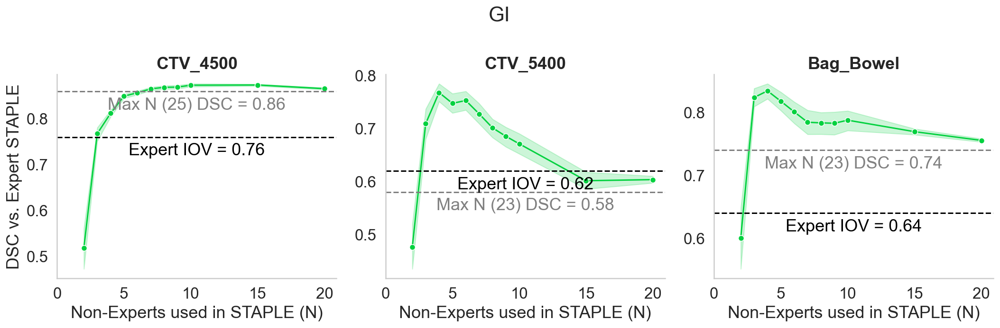

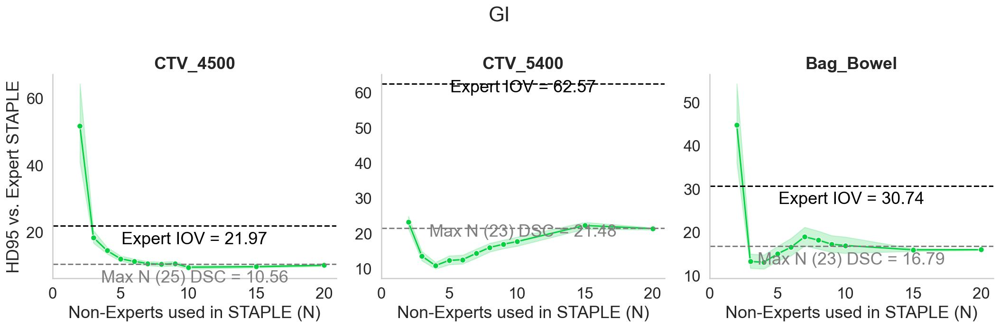

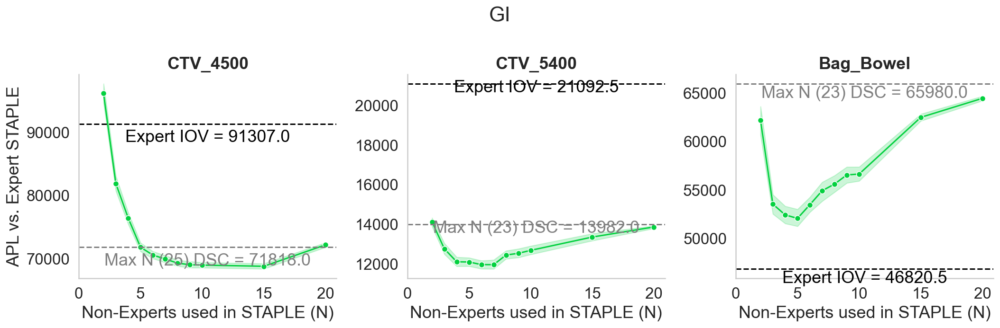

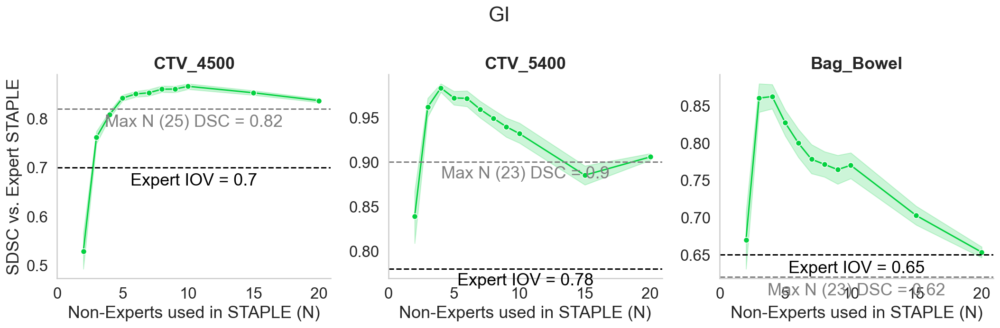

In [290]:
# TG-263 names 
ROI_dictionary = {ROI1: ROI2 for ROI1, ROI2 in zip(ROI_list, labels)}

metric_list = ["DSC_list", "HD95_list", "APL_list", "SDSC_list"]

for metric, line_dict, line_dict_maxSTAPLE in zip(metric_list, line_dict_list, line_dict_maxSTAPLE_list): # line dict defined before 
    print(metric)

    g = sns.relplot(
        data=df4_new, x="N", y=metric,
        col="ROI",
        kind="line",
        col_wrap = 3,
        facet_kws={'sharey': False, 'sharex': False},
        col_order = ROI_list, # only needed if in wrong order
        **{'marker': 'o', "err_style": 'band'}
    )

    g.set_axis_labels("Non-Experts used in STAPLE (N)", metric.split('_')[0]+" vs. Expert STAPLE")
    g.fig.suptitle('GI')

    # flatten axes into a 1-d array
    axes = g.axes.flatten()

    # iterate through the axes
    
    for ROI, ax in zip(ROI_list, axes):

        ax.set_title(ROI_dictionary[ROI], fontdict={'fontweight':'bold'}) # TG-263 names 

        ax.set_xticks([0, 5, 10, 15, 20])

        ymin, ymax = ax.get_ylim()

        xmin, xmax = ax.get_xlim()

        x_middle = (xmax-xmin)/2

        y_nudge = (ymax-ymin)/15

        value = float("{:.2f}".format(line_dict[ROI]))
        ax.axhline(value, ls='--', c='black')    
        ax.text(x_middle, value-y_nudge, "Expert IOV = " + str(value), c='black', horizontalalignment='center', verticalalignment='center')

        novice_n = df3[(df3['Class'] == "Non-Expert") & (df3['ROI'] == ROI)]['N'].values[0]

        value_maxSTAPLE = float("{:.2f}".format(line_dict_maxSTAPLE[ROI]))
        ax.axhline(value_maxSTAPLE, ls='--', c='gray')
        ax.text(x_middle, value_maxSTAPLE-y_nudge, "Max N (" + str(novice_n) +") DSC = " + str(value_maxSTAPLE), c='gray', horizontalalignment='center', verticalalignment='center')
    


        g.tight_layout()
        g.savefig('gi_'+ metric.split('list')[0] + 'bootstrap.pdf')
        

Heatmap version here.

In [291]:
df4_reformated = df4_new.groupby(['ROI', 'N'], as_index=False).median()

In [292]:
df4_reformated 

,ROI,N,DSC_list,HD95_list,APL_list,SDSC_list
0,bowel bag,2,0.688234,35.342572,61738.5,0.673755
1,bowel bag,3,0.828366,9.289695,54872.0,0.875973
2,bowel bag,4,0.846292,10.742182,53507.0,0.881888
3,bowel bag,5,0.822350,12.939119,52926.0,0.814994
4,bowel bag,6,0.820740,14.465865,53507.5,0.805277
5,bowel bag,7,0.807366,16.200500,55210.0,0.789831
6,bowel bag,8,0.808100,15.582258,55290.0,0.787234
7,bowel bag,9,0.801862,14.583034,56621.0,0.774575
8,bowel bag,10,0.805524,14.589837,56615.0,0.768083
9,bowel bag,15,0.771668,15.860503,62848.5,0.695964


In [293]:
for index, row in df4_reformated.iterrows():
    df4_reformated.loc[index, 'DSC_norm'] = row["DSC_list"]/ line_dict_list[0][row["ROI"]]
    df4_reformated.loc[index, 'SDSC_norm'] = row["SDSC_list"]/ line_dict_list[3][row["ROI"]]

In [294]:
df4_reformated

,ROI,N,DSC_list,HD95_list,APL_list,SDSC_list,DSC_norm,SDSC_norm
0,bowel bag,2,0.688234,35.342572,61738.5,0.673755,1.082164,1.041603
1,bowel bag,3,0.828366,9.289695,54872.0,0.875973,1.302504,1.354225
2,bowel bag,4,0.846292,10.742182,53507.0,0.881888,1.330691,1.363370
3,bowel bag,5,0.822350,12.939119,52926.0,0.814994,1.293044,1.259954
4,bowel bag,6,0.820740,14.465865,53507.5,0.805277,1.290513,1.244932
5,bowel bag,7,0.807366,16.200500,55210.0,0.789831,1.269485,1.221053
6,bowel bag,8,0.808100,15.582258,55290.0,0.787234,1.270638,1.217038
7,bowel bag,9,0.801862,14.583034,56621.0,0.774575,1.260830,1.197468
8,bowel bag,10,0.805524,14.589837,56615.0,0.768083,1.266588,1.187432
9,bowel bag,15,0.771668,15.860503,62848.5,0.695964,1.213353,1.075937


In [295]:
# https://stackoverflow.com/questions/37790429/seaborn-heatmap-using-pandas-dataframe

# pivot the dataframe from long to wide form
result_DSC = df4_reformated.pivot(index='ROI', columns='N', values='DSC_norm')
result_SDSC = df4_reformated.pivot(index='ROI', columns='N', values='SDSC_norm')

In [296]:
result_DSC = result_DSC.reindex(index = ROI_list)
result_SDSC = result_SDSC.reindex(index = ROI_list)

In [297]:
result_DSC

N,2,3,4,5,6,7,8,9,10,15,20
ROI,,,,,,,,,,,
ctv_45gy,0.789691,1.036269,1.075191,1.122243,1.131726,1.136270,1.143921,1.143567,1.150834,1.149211,1.139142
ctv_54gy,0.809459,1.177673,1.259074,1.230864,1.243855,1.180233,1.130192,1.125487,1.089436,0.936815,0.937108
bowel bag,1.082164,1.302504,1.330691,1.293044,1.290513,1.269485,1.270638,1.260830,1.266588,1.213353,1.186025


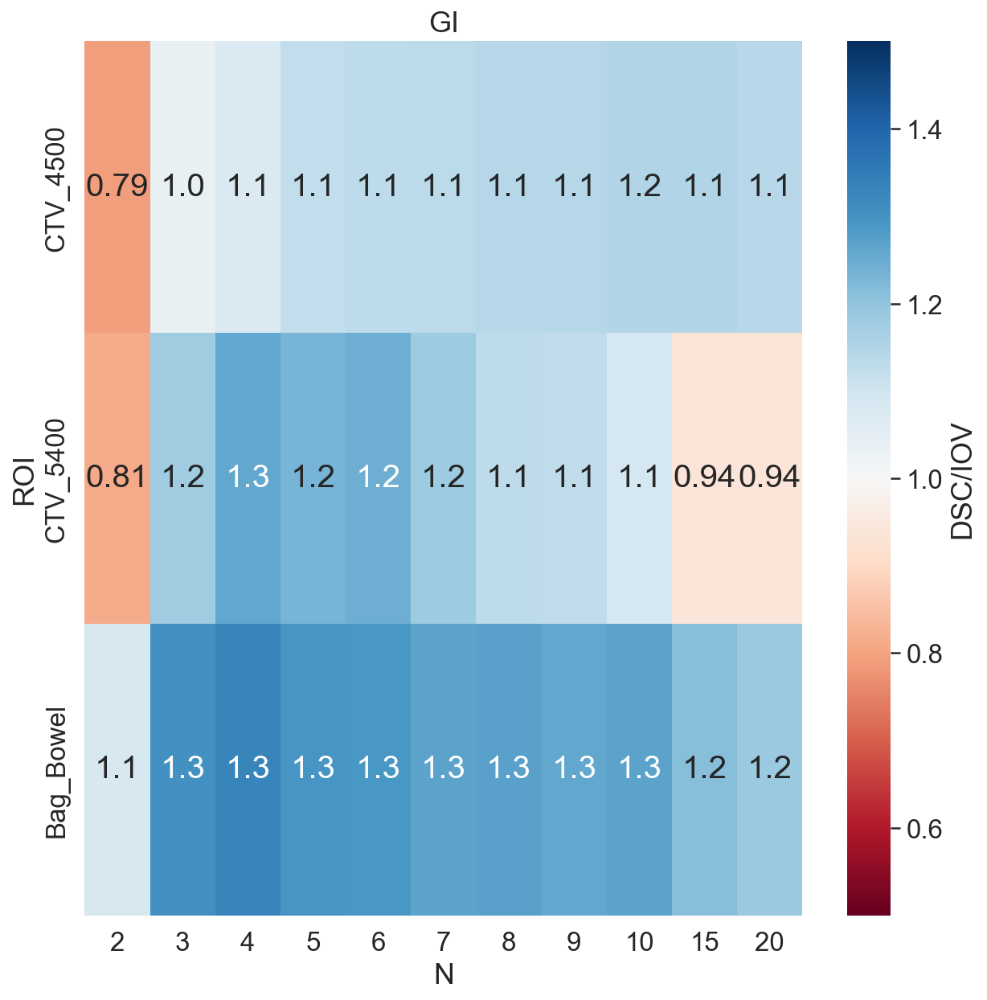

In [298]:
fig, ax = plt.subplots(figsize=(10,10))
ax = sns.heatmap(result_DSC, annot=True, fmt=".2", center=1, cmap="RdBu", 
                 vmin=0.5, vmax=1.5, 
                 cbar_kws={'label': 'DSC/IOV'},
                 annot_kws={"size": 35 / np.sqrt(len(result_DSC))})
plt.title('GI')

# TG-263 names 
labels = ['CTV_4500', 'CTV_5400', 'Bag_Bowel']
ax.set_yticklabels(labels)
    
plt.show()

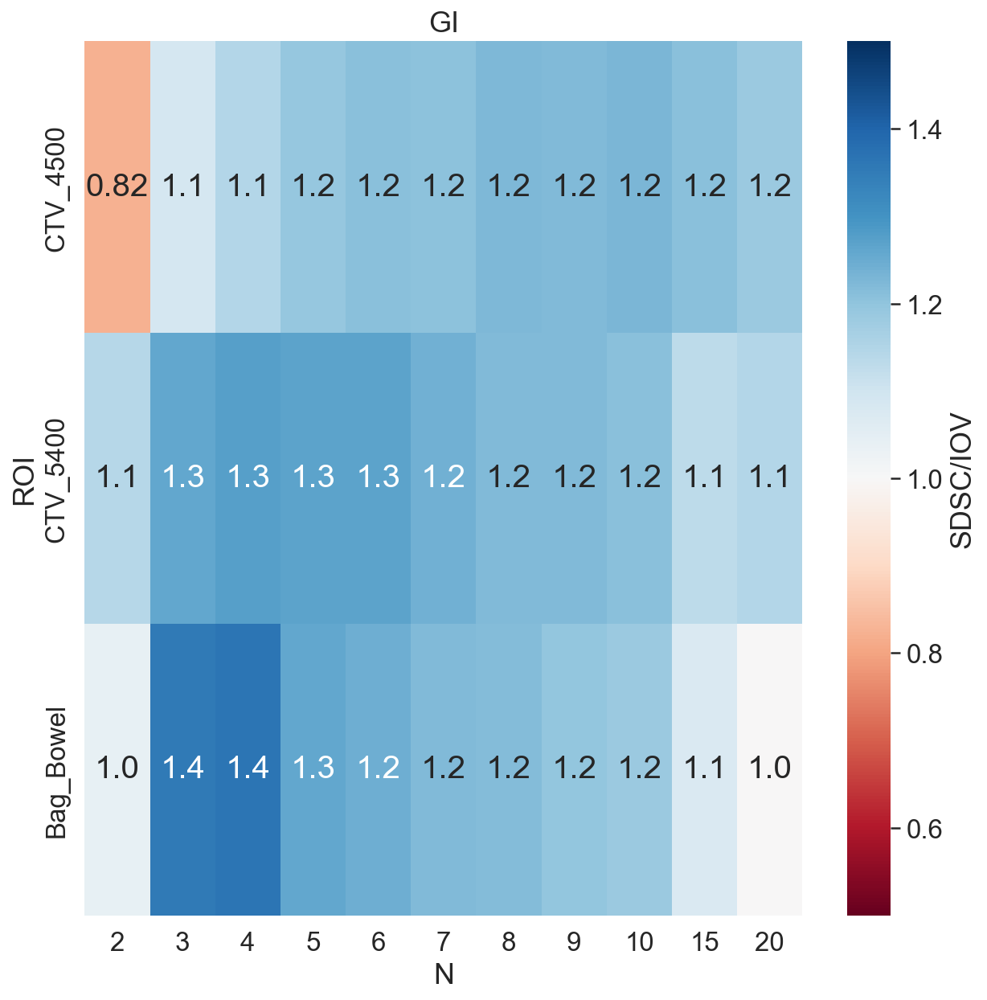

In [299]:
fig, ax = plt.subplots(figsize=(10,10))
ax = sns.heatmap(result_SDSC, annot=True, fmt=".2", center=1, cmap="RdBu", 
                 vmin=0.5, vmax=1.5, 
                 cbar_kws={'label': 'SDSC/IOV'},
                 annot_kws={"size": 35 / np.sqrt(len(result_DSC))})
plt.title('GI')

# TG-263 names 
labels = ['CTV_4500', 'CTV_5400', 'Bag_Bowel']
ax.set_yticklabels(labels)

plt.show()